In [2]:
from matplotlib import pyplot as plt
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.layers import LSTM, Dense, Activation

In [3]:
bit=pd.read_csv('Btcoin.csv')
gold=pd.read_csv('Gold.csv')

In [5]:
gold_data=pd.DataFrame(gold['Value'])
gold_data['Value'][0]=gold_data['Value'][1]
for i in range(len(gold_data['Value']-1)):
    if(gold_data['Value'][i]==0):
        gold_data['Value'][i]=gold_data['Value'][i-1]

In [134]:
bit_data=pd.DataFrame(bit['Value'])
bit_data.index=bit['Date']
bit_data

,Value
Date,
2016-09-11,621.65
2016-09-12,609.67
2016-09-13,610.92
2016-09-14,608.82
2016-09-15,610.38
...,...
2021-09-06,51769.06
2021-09-07,52677.40
2021-09-08,46809.17


Epoch 1/100
1/1 [==============================] - 4s 4s/step - loss: 0.0156 - val_loss: 0.0029
Epoch 2/100
1/1 [==============================] - 0s 34ms/step - loss: 0.0090 - val_loss: 9.0913e-04
Epoch 3/100
1/1 [==============================] - 0s 36ms/step - loss: 0.0056 - val_loss: 8.3380e-05
Epoch 4/100
1/1 [==============================] - 0s 36ms/step - loss: 0.0037 - val_loss: 5.5401e-05
Epoch 5/100
1/1 [==============================] - 0s 35ms/step - loss: 0.0028 - val_loss: 2.9587e-04
Epoch 6/100
1/1 [==============================] - 0s 32ms/step - loss: 0.0025 - val_loss: 4.2324e-04
Epoch 7/100
1/1 [==============================] - 0s 35ms/step - loss: 0.0024 - val_loss: 4.3809e-04
Epoch 8/100
1/1 [==============================] - 0s 37ms/step - loss: 0.0023 - val_loss: 4.2450e-04
Epoch 9/100
1/1 [==============================] - 0s 34ms/step - loss: 0.0022 - val_loss: 4.0671e-04
Epoch 10/100
1/1 [==============================] - 0s 35ms/step - loss: 0.0022 - val_lo

1/1 [==============================] - 0s 28ms/step - loss: 4.2792e-04 - val_loss: 2.9143e-04
Epoch 79/100
1/1 [==============================] - 0s 28ms/step - loss: 4.5808e-04 - val_loss: 1.1953e-04
Epoch 80/100
1/1 [==============================] - 0s 27ms/step - loss: 3.8065e-04 - val_loss: 2.1095e-04
Epoch 81/100
1/1 [==============================] - 0s 28ms/step - loss: 3.7692e-04 - val_loss: 7.7230e-05
Epoch 82/100
1/1 [==============================] - 0s 30ms/step - loss: 3.2299e-04 - val_loss: 1.6309e-04
Epoch 83/100
1/1 [==============================] - 0s 32ms/step - loss: 3.2425e-04 - val_loss: 5.9689e-05
Epoch 84/100
1/1 [==============================] - 0s 30ms/step - loss: 3.0045e-04 - val_loss: 1.5863e-04
Epoch 85/100
1/1 [==============================] - 0s 30ms/step - loss: 3.1553e-04 - val_loss: 6.4253e-05
Epoch 86/100
1/1 [==============================] - 0s 27ms/step - loss: 3.0934e-04 - val_loss: 1.8574e-04
Epoch 87/100
1/1 [==============================] 

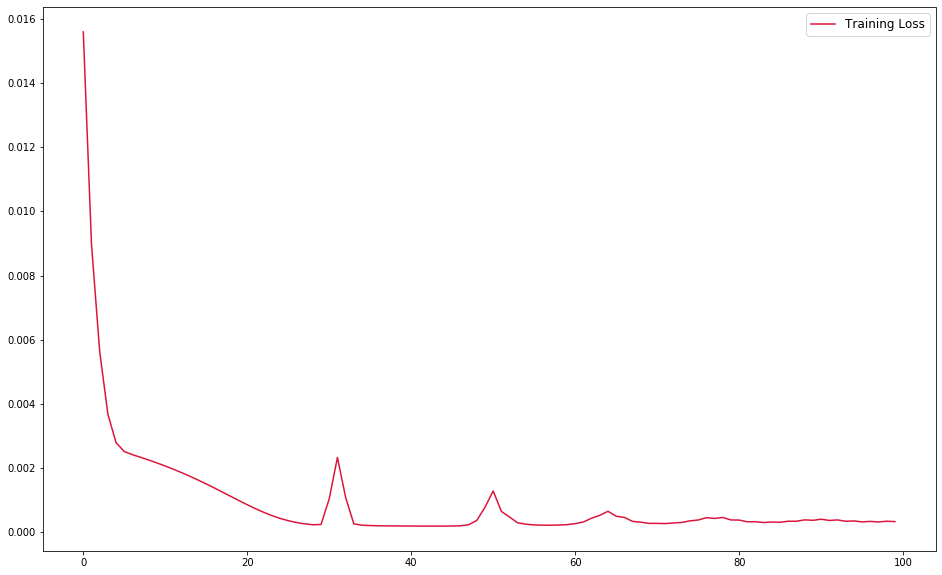

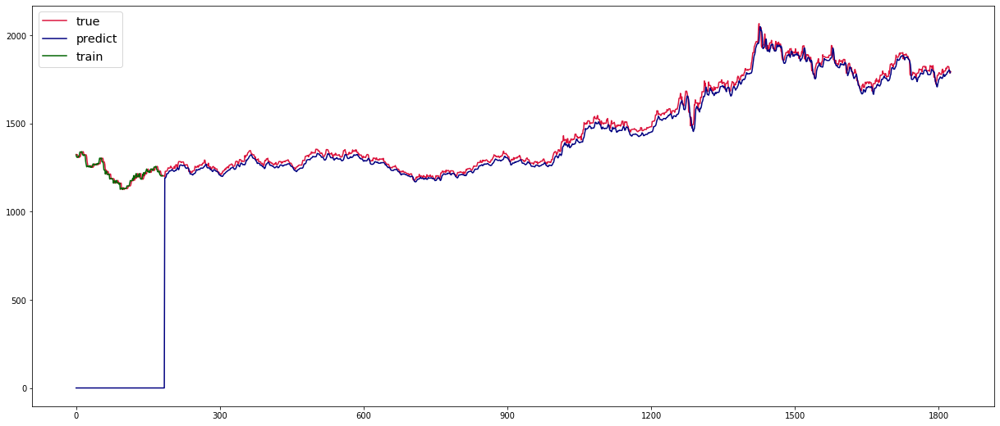

In [262]:
import matplotlib.ticker as ticker
def load_data(df,sequence_length=10, split=0.8):     
    data_all = np.array(df).astype(float)
    scaler = MinMaxScaler()
    data_all = scaler.fit_transform(data_all)
    data = []
    for i in range(len(data_all) - sequence_length - 1):
        data.append(data_all[i: i + sequence_length + 1])
    reshaped_data = np.array(data).astype('float64')
    x = reshaped_data[:, :-1]
    y = reshaped_data[:, -1]
    split_boundary = int(reshaped_data.shape[0] * split)
    train_x = x[: split_boundary]
    test_x = x[split_boundary:]
    train_y = y[: split_boundary]
    test_y = y[split_boundary:]
 
    return train_x, train_y, test_x, test_y, scaler

def get_data(df,sequence_length=10,split=40):     
    data_all = np.array(df).astype(float)
    scaler = MinMaxScaler()
    data_all = scaler.fit_transform(data_all)
    data = []
    for i in range(len(data_all) - sequence_length - 1):
        data.append(data_all[i: i + sequence_length + 1])
    reshaped_data = np.array(data).astype('float64')
    x = reshaped_data[:, :-1]
    y = reshaped_data[:, -1]
    split_boundary = split
    train_x = x[: split_boundary]
    test_x = x[split_boundary:]
    train_y = y[: split_boundary]
    test_y = y[split_boundary:]
    return train_x, train_y, test_x, test_y, scaler
 
def build_model():
    # input_dim是输入的train_x的最后一个维度，train_x的维度为(n_samples, time_steps, input_dim)
    model = Sequential()
    model.add(LSTM(50, input_dim=1,return_sequences=True))
    print(model.layers)
    model.add(LSTM(100,return_sequences=False))
    model.add(Dense(1))
    model.add(Activation('linear'))
    model.compile(loss='mse', optimizer='rmsprop')
    return model

def train_model(train_x, train_y, test_x, test_y):
    model = build_model()
    try:
        history=model.fit(train_x, train_y, batch_size=256,epochs=100, validation_split=0.01)
        predict = model.predict(test_x)
        predict = np.reshape(predict, (predict.size,))
    except KeyboardInterrupt:
        print(predict)
        print(test_y)
    fig1 = plt.figure(figsize=(16,10))
    plt.plot(history.history['loss'], label='Training Loss',color='crimson')
    plt.legend(['Training Loss'],fontsize='large')
    plt.show()
    return predict, test_y
 
if __name__ == '__main__':
    data=gold_data
    train_x, train_y,test_x,test_y,scaler=load_data(data, sequence_length=3, split=0.1)
    train_x = np.reshape(train_x, (train_x.shape[0], train_x.shape[1], 1))
    test_x = np.reshape(test_x, (test_x.shape[0], test_x.shape[1], 1))
    predict_y, test_y = train_model(train_x, train_y, test_x, test_y)
    predict_y = scaler.inverse_transform([[i] for i in predict_y])
    test_y = scaler.inverse_transform(test_y)
    fig2 = plt.figure(figsize=(21,9))
    plt.plot(data['Value'],'crimson')
    plt.plot(np.append(np.zeros(3+len(train_y)),predict_y),'navy')
    plt.plot(scaler.inverse_transform(train_y),'darkgreen')
    plt.gca().xaxis.set_major_locator(ticker.MultipleLocator(300))
    plt.legend(['true','predict','train'],loc='upper left',fontsize='x-large')
    plt.show()

In [225]:
trades=[[1000,0,0]]
trans_time=14 #换仓周期
a1=0.01 #黄金交易费
a2=0.02 #比特币交易费
time=[]
for day in range(50,1800,trans_time):      
    position=trades[-1] #今日仓位
    Wt=position[0]+position[1]+position[2]#今日资产总额
    #gold_train=gold_data[0:day-1]
    #gold_test=gold_data[day:]
    #bit_train=bit_data[0:day-1]
    #bit_test=bit_data[day:]
    print(position)
    #gold_predict
    train_x, train_y,test_x,test_y,scaler=get_data(gold_data, sequence_length=3, split=day)
    train_x = np.reshape(train_x, (train_x.shape[0], train_x.shape[1], 1))
    test_x = np.reshape(test_x, (test_x.shape[0], test_x.shape[1], 1))
    predict_y, test_y = train_model(train_x, train_y, test_x, test_y)
    predict_y = scaler.inverse_transform([[i] for i in predict_y])
    test_y = scaler.inverse_transform(test_y)
    gold_predict=predict_y[trans_time]
    
    train_x, train_y,test_x,test_y,scaler=get_data(bit_data, sequence_length=3, split=day)
    train_x = np.reshape(train_x, (train_x.shape[0], train_x.shape[1], 1))
    test_x = np.reshape(test_x, (test_x.shape[0], test_x.shape[1], 1))
    predict_y, test_y = train_model(train_x, train_y, test_x, test_y)
    predict_y = scaler.inverse_transform([[i] for i in predict_y])
    test_y = scaler.inverse_transform(test_y)
    bit_predict=predict_y[trans_time]
    
    gold_pred_increase=(gold_predict-gold_data['Value'][day-1])/gold_data['Value'][day-1] #黄金预测涨幅
    bit_pred_increase=(bit_predict-bit_data['Value'][day-1])/bit_data['Value'][day-1] #比特币预测涨幅
    
    gold_increase=(gold_data['Value'][day-1+trans_time]-gold_data['Value'][day-1])/gold_data['Value'][day-1]#黄金实际涨幅
    bit_increase=(bit_data['Value'][day-1+trans_time]-bit_data['Value'][day-1])/bit_data['Value'][day-1]#比特币实际涨幅
    
    if(gold_pred_increase<-a1 and bit_pred_increase<-a2):
        position=[position[0]+position[1]*(1-a1)+position[2]*(1-a2),0,0]
    elif bit_pred_increase-a2>gold_pred_increase-a1 and bit_pred_increase-a2>0:
        position=[0,0,position[0]*(1-a2)+position[1]*(1-a1)*(1-a2)+position[2]]
    elif bit_pred_increase-a2<gold_pred_increase-a1 and gold_pred_increase>a1:
        position=[0,position[0]*(1-a1)+position[1]+position[2]*(1-a1)*(1-a2),0]
    else:position=position

        
    asset=[position[0],position[1]*(1+gold_increase),position[2]*(1+bit_increase)]
    trades.append(asset)
    time.append(day)
    print('day:',day,'position:',asset,gold_predict,bit_predict,gold_pred_increase,gold_increase)
print(trades)


[1000, 0, 0]
Epoch 1/100
1/1 [==============================] - 4s 4s/step - loss: 0.0310 - val_loss: 0.0230
Epoch 2/100
1/1 [==============================] - 0s 28ms/step - loss: 0.0190 - val_loss: 0.0147
Epoch 3/100
1/1 [==============================] - 0s 23ms/step - loss: 0.0115 - val_loss: 0.0084
Epoch 4/100
1/1 [==============================] - 0s 25ms/step - loss: 0.0061 - val_loss: 0.0040
Epoch 5/100
1/1 [==============================] - 0s 25ms/step - loss: 0.0027 - val_loss: 0.0017
Epoch 6/100
1/1 [==============================] - 0s 25ms/step - loss: 0.0011 - val_loss: 7.0836e-04
Epoch 7/100
1/1 [==============================] - 0s 26ms/step - loss: 6.6968e-04 - val_loss: 4.4123e-04
Epoch 8/100
1/1 [==============================] - 0s 25ms/step - loss: 6.1537e-04 - val_loss: 3.8817e-04
Epoch 9/100
1/1 [==============================] - 0s 26ms/step - loss: 6.1023e-04 - val_loss: 3.8202e-04
Epoch 10/100
1/1 [==============================] - 0s 28ms/step - loss: 6.0736

Epoch 78/100
1/1 [==============================] - 0s 23ms/step - loss: 3.9878e-04 - val_loss: 0.0012
Epoch 79/100
1/1 [==============================] - 0s 25ms/step - loss: 3.9694e-04 - val_loss: 2.4508e-04
Epoch 80/100
1/1 [==============================] - 0s 23ms/step - loss: 3.7805e-04 - val_loss: 0.0013
Epoch 81/100
1/1 [==============================] - 0s 25ms/step - loss: 3.9572e-04 - val_loss: 2.1402e-04
Epoch 82/100
1/1 [==============================] - 0s 24ms/step - loss: 3.9802e-04 - val_loss: 0.0014
Epoch 83/100
1/1 [==============================] - 0s 24ms/step - loss: 4.4403e-04 - val_loss: 1.4953e-04
Epoch 84/100
1/1 [==============================] - 0s 24ms/step - loss: 4.5802e-04 - val_loss: 0.0017
Epoch 85/100
1/1 [==============================] - 0s 28ms/step - loss: 5.3240e-04 - val_loss: 1.0842e-04
Epoch 86/100
1/1 [==============================] - 0s 26ms/step - loss: 5.1261e-04 - val_loss: 0.0018
Epoch 87/100
1/1 [==============================] - 0s 26

1/1 [==============================] - 0s 216ms/step - loss: 6.1818e-04 - val_loss: 0.0014
Epoch 31/100
1/1 [==============================] - 0s 100ms/step - loss: 6.0961e-04 - val_loss: 0.0014
Epoch 32/100
1/1 [==============================] - 0s 192ms/step - loss: 6.0064e-04 - val_loss: 0.0014
Epoch 33/100
1/1 [==============================] - 0s 175ms/step - loss: 5.9128e-04 - val_loss: 0.0013
Epoch 34/100
1/1 [==============================] - 0s 249ms/step - loss: 5.8150e-04 - val_loss: 0.0013
Epoch 35/100
1/1 [==============================] - 0s 207ms/step - loss: 5.7129e-04 - val_loss: 0.0012
Epoch 36/100
1/1 [==============================] - 0s 121ms/step - loss: 5.6065e-04 - val_loss: 0.0012
Epoch 37/100
1/1 [==============================] - 0s 105ms/step - loss: 5.4957e-04 - val_loss: 0.0012
Epoch 38/100
1/1 [==============================] - 0s 79ms/step - loss: 5.3805e-04 - val_loss: 0.0011
Epoch 39/100
1/1 [==============================] - 0s 31ms/step - loss: 5.261

1/1 [==============================] - 0s 23ms/step - loss: 2.4534e-05 - val_loss: 1.6583e-05
Epoch 84/100
1/1 [==============================] - 0s 23ms/step - loss: 2.6585e-05 - val_loss: 2.3264e-05
Epoch 85/100
1/1 [==============================] - 0s 24ms/step - loss: 1.4771e-05 - val_loss: 1.9791e-06
Epoch 86/100
1/1 [==============================] - 0s 25ms/step - loss: 6.4303e-06 - val_loss: 7.3629e-06
Epoch 87/100
1/1 [==============================] - 0s 27ms/step - loss: 3.2567e-06 - val_loss: 3.2644e-09
Epoch 88/100
1/1 [==============================] - 0s 24ms/step - loss: 1.6510e-06 - val_loss: 3.3791e-06
Epoch 89/100
1/1 [==============================] - 0s 23ms/step - loss: 1.0906e-06 - val_loss: 1.5649e-07
Epoch 90/100
1/1 [==============================] - 0s 24ms/step - loss: 8.6377e-07 - val_loss: 2.6077e-06
Epoch 91/100
1/1 [==============================] - 0s 25ms/step - loss: 7.8322e-07 - val_loss: 2.1918e-07
Epoch 92/100
1/1 [==============================] 

1/1 [==============================] - 0s 24ms/step - loss: 6.6819e-07 - val_loss: 1.4811e-06
Epoch 37/100
1/1 [==============================] - 0s 122ms/step - loss: 6.7124e-07 - val_loss: 2.3585e-06
Epoch 38/100
1/1 [==============================] - 0s 197ms/step - loss: 7.3457e-07 - val_loss: 6.3853e-09
Epoch 39/100
1/1 [==============================] - 0s 31ms/step - loss: 2.0979e-06 - val_loss: 4.6374e-05
Epoch 40/100
1/1 [==============================] - 0s 29ms/step - loss: 3.1285e-05 - val_loss: 1.5802e-04
Epoch 41/100
1/1 [==============================] - 0s 27ms/step - loss: 1.9237e-04 - val_loss: 7.5091e-05
Epoch 42/100
1/1 [==============================] - 0s 27ms/step - loss: 5.5222e-05 - val_loss: 9.3597e-07
Epoch 43/100
1/1 [==============================] - 0s 24ms/step - loss: 5.7207e-06 - val_loss: 4.3184e-06
Epoch 44/100
1/1 [==============================] - 0s 25ms/step - loss: 1.3091e-06 - val_loss: 9.3678e-07
Epoch 45/100
1/1 [==============================

Epoch 89/100
1/1 [==============================] - 0s 32ms/step - loss: 3.9188e-04 - val_loss: 5.7883e-05
Epoch 90/100
1/1 [==============================] - 0s 27ms/step - loss: 3.8582e-04 - val_loss: 1.5546e-04
Epoch 91/100
1/1 [==============================] - 0s 34ms/step - loss: 4.3697e-04 - val_loss: 7.2366e-05
Epoch 92/100
1/1 [==============================] - 0s 32ms/step - loss: 4.1728e-04 - val_loss: 1.6614e-04
Epoch 93/100
1/1 [==============================] - 0s 31ms/step - loss: 4.6316e-04 - val_loss: 7.5491e-05
Epoch 94/100
1/1 [==============================] - 0s 36ms/step - loss: 4.1683e-04 - val_loss: 1.5054e-04
Epoch 95/100
1/1 [==============================] - 0s 141ms/step - loss: 4.4383e-04 - val_loss: 6.5605e-05
Epoch 96/100
1/1 [==============================] - 0s 34ms/step - loss: 3.9051e-04 - val_loss: 1.3034e-04
Epoch 97/100
1/1 [==============================] - 0s 30ms/step - loss: 4.0837e-04 - val_loss: 5.4879e-05
Epoch 98/100
1/1 [==================

Epoch 65/100
1/1 [==============================] - 0s 26ms/step - loss: 3.9215e-05 - val_loss: 2.6832e-06
Epoch 66/100
1/1 [==============================] - 0s 25ms/step - loss: 1.1019e-05 - val_loss: 9.4342e-06
Epoch 67/100
1/1 [==============================] - 0s 26ms/step - loss: 3.2550e-06 - val_loss: 5.5931e-07
Epoch 68/100
1/1 [==============================] - 0s 25ms/step - loss: 1.5338e-06 - val_loss: 4.0025e-06
Epoch 69/100
1/1 [==============================] - 0s 24ms/step - loss: 1.1204e-06 - val_loss: 1.5157e-06
Epoch 70/100
1/1 [==============================] - 0s 25ms/step - loss: 1.0013e-06 - val_loss: 3.1325e-06
Epoch 71/100
1/1 [==============================] - 0s 24ms/step - loss: 9.6011e-07 - val_loss: 1.7994e-06
Epoch 72/100
1/1 [==============================] - 0s 25ms/step - loss: 9.4462e-07 - val_loss: 2.9701e-06
Epoch 73/100
1/1 [==============================] - 0s 29ms/step - loss: 9.4023e-07 - val_loss: 1.8000e-06
Epoch 74/100
1/1 [===================

1/1 [==============================] - 0s 27ms/step - loss: 1.9923e-04 - val_loss: 6.5691e-06
Epoch 42/100
1/1 [==============================] - 0s 26ms/step - loss: 1.9863e-04 - val_loss: 1.3528e-05
Epoch 43/100
1/1 [==============================] - 0s 26ms/step - loss: 1.9838e-04 - val_loss: 8.5792e-06
Epoch 44/100
1/1 [==============================] - 0s 25ms/step - loss: 1.9856e-04 - val_loss: 2.2940e-05
Epoch 45/100
1/1 [==============================] - 0s 24ms/step - loss: 1.9973e-04 - val_loss: 6.1870e-06
Epoch 46/100
1/1 [==============================] - 0s 25ms/step - loss: 2.0375e-04 - val_loss: 5.2536e-05
Epoch 47/100
1/1 [==============================] - 0s 24ms/step - loss: 2.1852e-04 - val_loss: 8.6206e-06
Epoch 48/100
1/1 [==============================] - 0s 26ms/step - loss: 2.7439e-04 - val_loss: 2.5681e-04
Epoch 49/100
1/1 [==============================] - 0s 25ms/step - loss: 4.9875e-04 - val_loss: 2.7815e-04
Epoch 50/100
1/1 [==============================] 

1/1 [==============================] - 0s 29ms/step - loss: 9.7447e-06 - val_loss: 5.4782e-05
Epoch 94/100
1/1 [==============================] - 0s 26ms/step - loss: 1.5112e-05 - val_loss: 9.9362e-09
Epoch 95/100
1/1 [==============================] - 0s 26ms/step - loss: 1.6008e-05 - val_loss: 4.9078e-05
Epoch 96/100
1/1 [==============================] - 0s 24ms/step - loss: 1.2328e-05 - val_loss: 1.6013e-06
Epoch 97/100
1/1 [==============================] - 0s 25ms/step - loss: 7.3916e-06 - val_loss: 3.0994e-05
Epoch 98/100
1/1 [==============================] - 0s 24ms/step - loss: 4.9116e-06 - val_loss: 5.1722e-06
Epoch 99/100
1/1 [==============================] - 0s 25ms/step - loss: 3.5390e-06 - val_loss: 2.3830e-05
Epoch 100/100
1/1 [==============================] - 0s 24ms/step - loss: 2.8389e-06 - val_loss: 7.2726e-06
day: 106 position: [0, 1019.2079908857138, 0.0] [1168.4852674] [760.4206467] [0.03282385] 0.039333539576612016
[0, 1019.2079908857138, 0.0]
Epoch 1/100
1/1 

1/1 [==============================] - 0s 26ms/step - loss: 2.9582e-04 - val_loss: 4.9225e-05
Epoch 70/100
1/1 [==============================] - 0s 28ms/step - loss: 2.8626e-04 - val_loss: 3.2895e-04
Epoch 71/100
1/1 [==============================] - 0s 27ms/step - loss: 3.0814e-04 - val_loss: 5.0684e-05
Epoch 72/100
1/1 [==============================] - 0s 28ms/step - loss: 3.1902e-04 - val_loss: 4.0852e-04
Epoch 73/100
1/1 [==============================] - 0s 26ms/step - loss: 3.7109e-04 - val_loss: 6.2648e-05
Epoch 74/100
1/1 [==============================] - 0s 27ms/step - loss: 3.9158e-04 - val_loss: 5.0545e-04
Epoch 75/100
1/1 [==============================] - 0s 27ms/step - loss: 4.6613e-04 - val_loss: 7.8056e-05
Epoch 76/100
1/1 [==============================] - 0s 26ms/step - loss: 4.4193e-04 - val_loss: 5.0639e-04
Epoch 77/100
1/1 [==============================] - 0s 27ms/step - loss: 4.8153e-04 - val_loss: 6.9858e-05
Epoch 78/100
1/1 [==============================] 

1/1 [==============================] - 0s 30ms/step - loss: 0.0010 - val_loss: 2.3736e-04
Epoch 21/100
1/1 [==============================] - 0s 27ms/step - loss: 8.4192e-04 - val_loss: 2.1820e-04
Epoch 22/100
1/1 [==============================] - 0s 29ms/step - loss: 6.9759e-04 - val_loss: 2.0323e-04
Epoch 23/100
1/1 [==============================] - 0s 30ms/step - loss: 5.7064e-04 - val_loss: 1.9263e-04
Epoch 24/100
1/1 [==============================] - 0s 29ms/step - loss: 4.6367e-04 - val_loss: 1.8624e-04
Epoch 25/100
1/1 [==============================] - 0s 33ms/step - loss: 3.7788e-04 - val_loss: 1.8356e-04
Epoch 26/100
1/1 [==============================] - 0s 27ms/step - loss: 3.1289e-04 - val_loss: 1.8382e-04
Epoch 27/100
1/1 [==============================] - 0s 30ms/step - loss: 2.6673e-04 - val_loss: 1.8605e-04
Epoch 28/100
1/1 [==============================] - 0s 28ms/step - loss: 2.3621e-04 - val_loss: 1.8968e-04
Epoch 29/100
1/1 [==============================] - 0s

Epoch 97/100
1/1 [==============================] - 0s 29ms/step - loss: 3.7049e-04 - val_loss: 2.7142e-04
Epoch 98/100
1/1 [==============================] - 0s 33ms/step - loss: 3.5265e-04 - val_loss: 4.2044e-04
Epoch 99/100
1/1 [==============================] - 0s 34ms/step - loss: 3.8191e-04 - val_loss: 2.7517e-04
Epoch 100/100
1/1 [==============================] - 0s 33ms/step - loss: 3.5717e-04 - val_loss: 4.1955e-04
Epoch 1/100
1/1 [==============================] - 6s 6s/step - loss: 9.3341e-06 - val_loss: 5.2692e-04
Epoch 2/100
1/1 [==============================] - 0s 28ms/step - loss: 6.5584e-04 - val_loss: 2.5069e-05
Epoch 3/100
1/1 [==============================] - 0s 27ms/step - loss: 9.3344e-06 - val_loss: 7.3518e-06
Epoch 4/100
1/1 [==============================] - 0s 28ms/step - loss: 3.5595e-06 - val_loss: 6.7802e-06
Epoch 5/100
1/1 [==============================] - 0s 28ms/step - loss: 3.5464e-06 - val_loss: 6.7788e-06
Epoch 6/100
1/1 [==========================

1/1 [==============================] - 0s 26ms/step - loss: 3.4920e-06 - val_loss: 8.1189e-06
Epoch 74/100
1/1 [==============================] - 0s 27ms/step - loss: 3.5197e-06 - val_loss: 4.5954e-06
Epoch 75/100
1/1 [==============================] - 0s 26ms/step - loss: 3.5971e-06 - val_loss: 1.0132e-05
Epoch 76/100
1/1 [==============================] - 0s 25ms/step - loss: 3.8217e-06 - val_loss: 2.2611e-06
Epoch 77/100
1/1 [==============================] - 0s 25ms/step - loss: 4.5193e-06 - val_loss: 1.9458e-05
Epoch 78/100
1/1 [==============================] - 0s 25ms/step - loss: 6.8961e-06 - val_loss: 6.8979e-07
Epoch 79/100
1/1 [==============================] - 0s 27ms/step - loss: 1.4551e-05 - val_loss: 6.1176e-05
Epoch 80/100
1/1 [==============================] - 0s 136ms/step - loss: 3.1211e-05 - val_loss: 8.9640e-06
Epoch 81/100
1/1 [==============================] - 0s 289ms/step - loss: 3.4268e-05 - val_loss: 4.5849e-05
Epoch 82/100
1/1 [==============================

Epoch 49/100
1/1 [==============================] - 0s 31ms/step - loss: 7.7317e-04 - val_loss: 3.1523e-05
Epoch 50/100
1/1 [==============================] - 0s 33ms/step - loss: 4.8417e-04 - val_loss: 0.0012
Epoch 51/100
1/1 [==============================] - 0s 31ms/step - loss: 4.1731e-04 - val_loss: 1.2759e-04
Epoch 52/100
1/1 [==============================] - 0s 31ms/step - loss: 3.0405e-04 - val_loss: 8.5899e-04
Epoch 53/100
1/1 [==============================] - 0s 29ms/step - loss: 2.8032e-04 - val_loss: 1.9366e-04
Epoch 54/100
1/1 [==============================] - 0s 30ms/step - loss: 2.5497e-04 - val_loss: 7.8592e-04
Epoch 55/100
1/1 [==============================] - 0s 30ms/step - loss: 2.5466e-04 - val_loss: 1.9852e-04
Epoch 56/100
1/1 [==============================] - 0s 132ms/step - loss: 2.5310e-04 - val_loss: 8.4649e-04
Epoch 57/100
1/1 [==============================] - 0s 176ms/step - loss: 2.7026e-04 - val_loss: 1.4934e-04
Epoch 58/100
1/1 [=====================

Epoch 26/100
1/1 [==============================] - 0s 29ms/step - loss: 4.2436e-06 - val_loss: 2.0680e-05
Epoch 27/100
1/1 [==============================] - 0s 32ms/step - loss: 4.2358e-06 - val_loss: 2.0640e-05
Epoch 28/100
1/1 [==============================] - 0s 30ms/step - loss: 4.2276e-06 - val_loss: 2.0598e-05
Epoch 29/100
1/1 [==============================] - 0s 29ms/step - loss: 4.2191e-06 - val_loss: 2.0554e-05
Epoch 30/100
1/1 [==============================] - 0s 29ms/step - loss: 4.2103e-06 - val_loss: 2.0510e-05
Epoch 31/100
1/1 [==============================] - 0s 31ms/step - loss: 4.2011e-06 - val_loss: 2.0458e-05
Epoch 32/100
1/1 [==============================] - 0s 30ms/step - loss: 4.1916e-06 - val_loss: 2.0427e-05
Epoch 33/100
1/1 [==============================] - 0s 29ms/step - loss: 4.1817e-06 - val_loss: 2.0311e-05
Epoch 34/100
1/1 [==============================] - 0s 29ms/step - loss: 4.1715e-06 - val_loss: 2.0523e-05
Epoch 35/100
1/1 [===================

Epoch 1/100
1/1 [==============================] - 6s 6s/step - loss: 0.0139 - val_loss: 0.0054
Epoch 2/100
1/1 [==============================] - 0s 37ms/step - loss: 0.0072 - val_loss: 0.0020
Epoch 3/100
1/1 [==============================] - 0s 94ms/step - loss: 0.0041 - val_loss: 4.5093e-04
Epoch 4/100
1/1 [==============================] - 0s 28ms/step - loss: 0.0027 - val_loss: 5.9587e-05
Epoch 5/100
1/1 [==============================] - 0s 28ms/step - loss: 0.0023 - val_loss: 1.6485e-05
Epoch 6/100
1/1 [==============================] - 0s 29ms/step - loss: 0.0022 - val_loss: 1.3596e-05
Epoch 7/100
1/1 [==============================] - 0s 29ms/step - loss: 0.0021 - val_loss: 1.2359e-05
Epoch 8/100
1/1 [==============================] - 0s 29ms/step - loss: 0.0020 - val_loss: 1.1201e-05
Epoch 9/100
1/1 [==============================] - 0s 32ms/step - loss: 0.0019 - val_loss: 1.0203e-05
Epoch 10/100
1/1 [==============================] - 0s 30ms/step - loss: 0.0018 - val_loss: 

1/1 [==============================] - 0s 27ms/step - loss: 4.8186e-06 - val_loss: 2.4800e-05
Epoch 55/100
1/1 [==============================] - 0s 29ms/step - loss: 4.8202e-06 - val_loss: 2.9440e-05
Epoch 56/100
1/1 [==============================] - 0s 28ms/step - loss: 4.8667e-06 - val_loss: 2.0481e-05
Epoch 57/100
1/1 [==============================] - 0s 30ms/step - loss: 5.1206e-06 - val_loss: 4.1289e-05
Epoch 58/100
1/1 [==============================] - 0s 33ms/step - loss: 6.4576e-06 - val_loss: 4.4134e-06
Epoch 59/100
1/1 [==============================] - 0s 30ms/step - loss: 1.3771e-05 - val_loss: 1.3325e-04
Epoch 60/100
1/1 [==============================] - 0s 36ms/step - loss: 4.5895e-05 - val_loss: 1.0078e-05
Epoch 61/100
1/1 [==============================] - 0s 32ms/step - loss: 7.4217e-05 - val_loss: 1.2832e-04
Epoch 62/100
1/1 [==============================] - 0s 31ms/step - loss: 4.2093e-05 - val_loss: 5.9943e-06
Epoch 63/100
1/1 [==============================] 

Epoch 5/100
1/1 [==============================] - 0s 37ms/step - loss: 7.8964e-06 - val_loss: 3.9714e-05
Epoch 6/100
1/1 [==============================] - 0s 36ms/step - loss: 7.8860e-06 - val_loss: 3.9647e-05
Epoch 7/100
1/1 [==============================] - 0s 32ms/step - loss: 7.8752e-06 - val_loss: 3.9578e-05
Epoch 8/100
1/1 [==============================] - 0s 30ms/step - loss: 7.8638e-06 - val_loss: 3.9506e-05
Epoch 9/100
1/1 [==============================] - 0s 31ms/step - loss: 7.8519e-06 - val_loss: 3.9430e-05
Epoch 10/100
1/1 [==============================] - 0s 30ms/step - loss: 7.8393e-06 - val_loss: 3.9350e-05
Epoch 11/100
1/1 [==============================] - 0s 29ms/step - loss: 7.8262e-06 - val_loss: 3.9266e-05
Epoch 12/100
1/1 [==============================] - 0s 30ms/step - loss: 7.8124e-06 - val_loss: 3.9179e-05
Epoch 13/100
1/1 [==============================] - 0s 28ms/step - loss: 7.7980e-06 - val_loss: 3.9087e-05
Epoch 14/100
1/1 [========================

Epoch 57/100
1/1 [==============================] - 0s 38ms/step - loss: 2.1478e-04 - val_loss: 1.5265e-04
Epoch 58/100
1/1 [==============================] - 0s 37ms/step - loss: 2.1513e-04 - val_loss: 5.3818e-04
Epoch 59/100
1/1 [==============================] - 0s 37ms/step - loss: 2.2431e-04 - val_loss: 1.0666e-04
Epoch 60/100
1/1 [==============================] - 0s 33ms/step - loss: 2.4038e-04 - val_loss: 7.2799e-04
Epoch 61/100
1/1 [==============================] - 0s 31ms/step - loss: 2.8338e-04 - val_loss: 2.6932e-05
Epoch 62/100
1/1 [==============================] - 0s 32ms/step - loss: 3.5143e-04 - val_loss: 0.0012
Epoch 63/100
1/1 [==============================] - 0s 29ms/step - loss: 5.0196e-04 - val_loss: 1.4058e-05
Epoch 64/100
1/1 [==============================] - 0s 29ms/step - loss: 5.7154e-04 - val_loss: 0.0015
Epoch 65/100
1/1 [==============================] - 0s 29ms/step - loss: 6.6665e-04 - val_loss: 8.2060e-06
Epoch 66/100
1/1 [===========================

1/1 [==============================] - 0s 33ms/step - loss: 0.0020 - val_loss: 3.3444e-04
Epoch 9/100
1/1 [==============================] - 0s 40ms/step - loss: 0.0019 - val_loss: 3.2388e-04
Epoch 10/100
1/1 [==============================] - 0s 44ms/step - loss: 0.0018 - val_loss: 3.1362e-04
Epoch 11/100
1/1 [==============================] - 0s 33ms/step - loss: 0.0018 - val_loss: 3.0341e-04
Epoch 12/100
1/1 [==============================] - 0s 35ms/step - loss: 0.0017 - val_loss: 2.9327e-04
Epoch 13/100
1/1 [==============================] - 0s 35ms/step - loss: 0.0016 - val_loss: 2.8315e-04
Epoch 14/100
1/1 [==============================] - 0s 33ms/step - loss: 0.0015 - val_loss: 2.7303e-04
Epoch 15/100
1/1 [==============================] - 0s 31ms/step - loss: 0.0014 - val_loss: 2.6288e-04
Epoch 16/100
1/1 [==============================] - 0s 30ms/step - loss: 0.0013 - val_loss: 2.5265e-04
Epoch 17/100
1/1 [==============================] - 0s 30ms/step - loss: 0.0012 - val_l

Epoch 85/100
1/1 [==============================] - 0s 32ms/step - loss: 3.0005e-04 - val_loss: 4.3273e-04
Epoch 86/100
1/1 [==============================] - 0s 32ms/step - loss: 3.2868e-04 - val_loss: 6.4744e-05
Epoch 87/100
1/1 [==============================] - 0s 32ms/step - loss: 3.2120e-04 - val_loss: 4.7282e-04
Epoch 88/100
1/1 [==============================] - 0s 34ms/step - loss: 3.5248e-04 - val_loss: 6.9579e-05
Epoch 89/100
1/1 [==============================] - 0s 36ms/step - loss: 3.3213e-04 - val_loss: 4.7701e-04
Epoch 90/100
1/1 [==============================] - 0s 32ms/step - loss: 3.5483e-04 - val_loss: 6.5350e-05
Epoch 91/100
1/1 [==============================] - 0s 32ms/step - loss: 3.2301e-04 - val_loss: 4.4693e-04
Epoch 92/100
1/1 [==============================] - 0s 32ms/step - loss: 3.3672e-04 - val_loss: 5.8568e-05
Epoch 93/100
1/1 [==============================] - 0s 33ms/step - loss: 3.0654e-04 - val_loss: 4.1634e-04
Epoch 94/100
1/1 [===================

1/1 [==============================] - 0s 31ms/step - loss: 7.3188e-05 - val_loss: 2.9247e-07
Epoch 62/100
1/1 [==============================] - 0s 31ms/step - loss: 2.7623e-05 - val_loss: 3.8335e-05
Epoch 63/100
1/1 [==============================] - 0s 33ms/step - loss: 1.3782e-05 - val_loss: 8.8073e-06
Epoch 64/100
1/1 [==============================] - 0s 32ms/step - loss: 1.0059e-05 - val_loss: 2.1024e-05
Epoch 65/100
1/1 [==============================] - 0s 32ms/step - loss: 9.2834e-06 - val_loss: 1.3047e-05
Epoch 66/100
1/1 [==============================] - 0s 29ms/step - loss: 9.0383e-06 - val_loss: 1.8134e-05
Epoch 67/100
1/1 [==============================] - 0s 32ms/step - loss: 8.9319e-06 - val_loss: 1.3978e-05
Epoch 68/100
1/1 [==============================] - 0s 31ms/step - loss: 8.8650e-06 - val_loss: 1.7482e-05
Epoch 69/100
1/1 [==============================] - 0s 31ms/step - loss: 8.8140e-06 - val_loss: 1.3838e-05
Epoch 70/100
1/1 [==============================] 

Epoch 13/100
1/1 [==============================] - 0s 31ms/step - loss: 9.9709e-06 - val_loss: 2.4497e-05
Epoch 14/100
1/1 [==============================] - 0s 33ms/step - loss: 9.9465e-06 - val_loss: 2.4434e-05
Epoch 15/100
1/1 [==============================] - 0s 35ms/step - loss: 9.9208e-06 - val_loss: 2.4367e-05
Epoch 16/100
1/1 [==============================] - 0s 38ms/step - loss: 9.8939e-06 - val_loss: 2.4297e-05
Epoch 17/100
1/1 [==============================] - 0s 33ms/step - loss: 9.8656e-06 - val_loss: 2.4224e-05
Epoch 18/100
1/1 [==============================] - 0s 43ms/step - loss: 9.8359e-06 - val_loss: 2.4147e-05
Epoch 19/100
1/1 [==============================] - 0s 36ms/step - loss: 9.8047e-06 - val_loss: 2.4066e-05
Epoch 20/100
1/1 [==============================] - 0s 36ms/step - loss: 9.7720e-06 - val_loss: 2.3981e-05
Epoch 21/100
1/1 [==============================] - 0s 36ms/step - loss: 9.7377e-06 - val_loss: 2.3892e-05
Epoch 22/100
1/1 [===================

1/1 [==============================] - 0s 29ms/step - loss: 3.5920e-04 - val_loss: 3.6174e-04
Epoch 65/100
1/1 [==============================] - 0s 29ms/step - loss: 2.9940e-04 - val_loss: 7.8665e-05
Epoch 66/100
1/1 [==============================] - 0s 28ms/step - loss: 2.9805e-04 - val_loss: 3.2027e-04
Epoch 67/100
1/1 [==============================] - 0s 29ms/step - loss: 2.7410e-04 - val_loss: 7.1436e-05
Epoch 68/100
1/1 [==============================] - 0s 30ms/step - loss: 2.8662e-04 - val_loss: 3.3810e-04
Epoch 69/100
1/1 [==============================] - 0s 32ms/step - loss: 2.8162e-04 - val_loss: 8.5319e-05
Epoch 70/100
1/1 [==============================] - 0s 30ms/step - loss: 3.1145e-04 - val_loss: 4.0145e-04
Epoch 71/100
1/1 [==============================] - 0s 32ms/step - loss: 3.1597e-04 - val_loss: 1.1925e-04
Epoch 72/100
1/1 [==============================] - 0s 30ms/step - loss: 3.6318e-04 - val_loss: 4.6850e-04
Epoch 73/100
1/1 [==============================] 

1/1 [==============================] - 0s 36ms/step - loss: 0.0013 - val_loss: 2.0022e-04
Epoch 16/100
1/1 [==============================] - 0s 29ms/step - loss: 0.0012 - val_loss: 2.0244e-04
Epoch 17/100
1/1 [==============================] - 0s 34ms/step - loss: 0.0011 - val_loss: 2.0507e-04
Epoch 18/100
1/1 [==============================] - 0s 32ms/step - loss: 0.0011 - val_loss: 2.0812e-04
Epoch 19/100
1/1 [==============================] - 0s 33ms/step - loss: 9.6544e-04 - val_loss: 2.1160e-04
Epoch 20/100
1/1 [==============================] - 0s 34ms/step - loss: 8.7664e-04 - val_loss: 2.1550e-04
Epoch 21/100
1/1 [==============================] - 0s 34ms/step - loss: 7.8760e-04 - val_loss: 2.1979e-04
Epoch 22/100
1/1 [==============================] - 0s 34ms/step - loss: 6.9968e-04 - val_loss: 2.2440e-04
Epoch 23/100
1/1 [==============================] - 0s 37ms/step - loss: 6.1452e-04 - val_loss: 2.2931e-04
Epoch 24/100
1/1 [==============================] - 0s 36ms/step -

1/1 [==============================] - 0s 33ms/step - loss: 3.3758e-04 - val_loss: 1.2952e-04
Epoch 93/100
1/1 [==============================] - 0s 40ms/step - loss: 3.2008e-04 - val_loss: 7.4155e-04
Epoch 94/100
1/1 [==============================] - 0s 36ms/step - loss: 3.5008e-04 - val_loss: 1.2984e-04
Epoch 95/100
1/1 [==============================] - 0s 38ms/step - loss: 3.3198e-04 - val_loss: 7.6594e-04
Epoch 96/100
1/1 [==============================] - 0s 34ms/step - loss: 3.6375e-04 - val_loss: 1.3020e-04
Epoch 97/100
1/1 [==============================] - 0s 34ms/step - loss: 3.3815e-04 - val_loss: 7.6815e-04
Epoch 98/100
1/1 [==============================] - 0s 36ms/step - loss: 3.6544e-04 - val_loss: 1.2992e-04
Epoch 99/100
1/1 [==============================] - 0s 34ms/step - loss: 3.3320e-04 - val_loss: 7.4916e-04
Epoch 100/100
1/1 [==============================] - 0s 31ms/step - loss: 3.5509e-04 - val_loss: 1.2954e-04
Epoch 1/100
1/1 [==============================] 

Epoch 68/100
1/1 [==============================] - 0s 36ms/step - loss: 4.2161e-05 - val_loss: 3.4898e-04
Epoch 69/100
1/1 [==============================] - 0s 37ms/step - loss: 7.1042e-05 - val_loss: 2.9677e-05
Epoch 70/100
1/1 [==============================] - 0s 36ms/step - loss: 4.7895e-05 - val_loss: 2.2815e-04
Epoch 71/100
1/1 [==============================] - 0s 35ms/step - loss: 2.7763e-05 - val_loss: 8.9768e-05
Epoch 72/100
1/1 [==============================] - 0s 35ms/step - loss: 1.7796e-05 - val_loss: 1.5555e-04
Epoch 73/100
1/1 [==============================] - 0s 33ms/step - loss: 1.5444e-05 - val_loss: 1.0921e-04
Epoch 74/100
1/1 [==============================] - 0s 32ms/step - loss: 1.4534e-05 - val_loss: 1.3838e-04
Epoch 75/100
1/1 [==============================] - 0s 34ms/step - loss: 1.4121e-05 - val_loss: 1.1016e-04
Epoch 76/100
1/1 [==============================] - 0s 32ms/step - loss: 1.3846e-05 - val_loss: 1.3318e-04
Epoch 77/100
1/1 [===================

2/2 [==============================] - 0s 20ms/step - loss: 6.7442e-05 - val_loss: 1.0296e-04
Epoch 21/100
2/2 [==============================] - 0s 20ms/step - loss: 1.0105e-04 - val_loss: 3.5500e-04
Epoch 22/100
2/2 [==============================] - 0s 22ms/step - loss: 2.9645e-05 - val_loss: 4.1255e-04
Epoch 23/100
2/2 [==============================] - 0s 19ms/step - loss: 3.2034e-05 - val_loss: 2.5989e-04
Epoch 24/100
2/2 [==============================] - 0s 20ms/step - loss: 3.4997e-05 - val_loss: 5.5834e-04
Epoch 25/100
2/2 [==============================] - 0s 19ms/step - loss: 5.5508e-05 - val_loss: 2.1767e-04
Epoch 26/100
2/2 [==============================] - 0s 18ms/step - loss: 4.2169e-05 - val_loss: 2.9691e-04
Epoch 27/100
2/2 [==============================] - 0s 18ms/step - loss: 2.9909e-05 - val_loss: 1.9241e-04
Epoch 28/100
2/2 [==============================] - 0s 18ms/step - loss: 4.7363e-05 - val_loss: 1.2962e-04
Epoch 29/100
2/2 [==============================] 

2/2 [==============================] - 0s 20ms/step - loss: 2.2858e-04 - val_loss: 3.6451e-04
Epoch 72/100
2/2 [==============================] - 0s 20ms/step - loss: 3.2566e-04 - val_loss: 8.5752e-04
Epoch 73/100
2/2 [==============================] - 0s 22ms/step - loss: 6.5083e-04 - val_loss: 9.7755e-04
Epoch 74/100
2/2 [==============================] - 0s 19ms/step - loss: 6.9360e-04 - val_loss: 2.2344e-04
Epoch 75/100
2/2 [==============================] - 0s 20ms/step - loss: 2.3736e-04 - val_loss: 3.0816e-04
Epoch 76/100
2/2 [==============================] - 0s 19ms/step - loss: 2.7126e-04 - val_loss: 8.6838e-05
Epoch 77/100
2/2 [==============================] - 0s 19ms/step - loss: 1.7870e-04 - val_loss: 6.5039e-05
Epoch 78/100
2/2 [==============================] - 0s 19ms/step - loss: 2.8334e-04 - val_loss: 5.8656e-04
Epoch 79/100
2/2 [==============================] - 0s 18ms/step - loss: 8.9229e-04 - val_loss: 1.9376e-04
Epoch 80/100
2/2 [==============================] 

2/2 [==============================] - 0s 20ms/step - loss: 3.2969e-04 - val_loss: 7.6327e-04
Epoch 23/100
2/2 [==============================] - 0s 22ms/step - loss: 7.3215e-04 - val_loss: 1.3526e-04
Epoch 24/100
2/2 [==============================] - 0s 20ms/step - loss: 2.7186e-04 - val_loss: 1.0206e-04
Epoch 25/100
2/2 [==============================] - 0s 19ms/step - loss: 2.4514e-04 - val_loss: 2.9314e-04
Epoch 26/100
2/2 [==============================] - 0s 21ms/step - loss: 3.7148e-04 - val_loss: 5.5433e-04
Epoch 27/100
2/2 [==============================] - 0s 24ms/step - loss: 5.5495e-04 - val_loss: 5.3235e-04
Epoch 28/100
2/2 [==============================] - 0s 23ms/step - loss: 4.4553e-04 - val_loss: 9.8006e-06
Epoch 29/100
2/2 [==============================] - 0s 20ms/step - loss: 1.9117e-04 - val_loss: 1.1240e-05
Epoch 30/100
2/2 [==============================] - 0s 21ms/step - loss: 2.0014e-04 - val_loss: 3.5529e-05
Epoch 31/100
2/2 [==============================] 

2/2 [==============================] - 0s 21ms/step - loss: 2.4098e-05 - val_loss: 1.2928e-06
Epoch 75/100
2/2 [==============================] - 0s 22ms/step - loss: 1.3812e-05 - val_loss: 1.3299e-06
Epoch 76/100
2/2 [==============================] - 0s 20ms/step - loss: 9.1116e-06 - val_loss: 2.4299e-06
Epoch 77/100
2/2 [==============================] - 0s 20ms/step - loss: 1.1533e-05 - val_loss: 7.8182e-06
Epoch 78/100
2/2 [==============================] - 0s 21ms/step - loss: 2.1493e-05 - val_loss: 1.6399e-05
Epoch 79/100
2/2 [==============================] - 0s 21ms/step - loss: 3.9441e-05 - val_loss: 2.4613e-06
Epoch 80/100
2/2 [==============================] - 0s 21ms/step - loss: 2.3278e-05 - val_loss: 4.1142e-06
Epoch 81/100
2/2 [==============================] - 0s 21ms/step - loss: 1.9855e-05 - val_loss: 5.4081e-06
Epoch 82/100
2/2 [==============================] - 0s 20ms/step - loss: 2.0230e-05 - val_loss: 6.3680e-06
Epoch 83/100
2/2 [==============================] 

2/2 [==============================] - 0s 24ms/step - loss: 3.7701e-05 - val_loss: 7.6539e-05
Epoch 26/100
2/2 [==============================] - 0s 21ms/step - loss: 2.6399e-05 - val_loss: 7.0491e-05
Epoch 27/100
2/2 [==============================] - 0s 23ms/step - loss: 2.3367e-05 - val_loss: 1.5709e-04
Epoch 28/100
2/2 [==============================] - 0s 22ms/step - loss: 6.5821e-05 - val_loss: 4.0679e-04
Epoch 29/100
2/2 [==============================] - 0s 21ms/step - loss: 1.7631e-04 - val_loss: 1.7603e-04
Epoch 30/100
2/2 [==============================] - 0s 29ms/step - loss: 4.7443e-05 - val_loss: 5.7919e-05
Epoch 31/100
2/2 [==============================] - 0s 22ms/step - loss: 2.0279e-05 - val_loss: 5.5813e-05
Epoch 32/100
2/2 [==============================] - 0s 23ms/step - loss: 1.7751e-05 - val_loss: 4.5886e-05
Epoch 33/100
2/2 [==============================] - 0s 21ms/step - loss: 1.4147e-05 - val_loss: 1.7279e-05
Epoch 34/100
2/2 [==============================] 

Epoch 1/100
2/2 [==============================] - 4s 764ms/step - loss: 0.0147 - val_loss: 0.0051
Epoch 2/100
2/2 [==============================] - 0s 22ms/step - loss: 0.0046 - val_loss: 6.4647e-04
Epoch 3/100
2/2 [==============================] - 0s 23ms/step - loss: 0.0017 - val_loss: 1.7103e-04
Epoch 4/100
2/2 [==============================] - 0s 22ms/step - loss: 0.0015 - val_loss: 1.4269e-04
Epoch 5/100
2/2 [==============================] - 0s 22ms/step - loss: 0.0014 - val_loss: 9.1478e-05
Epoch 6/100
2/2 [==============================] - 0s 22ms/step - loss: 0.0013 - val_loss: 1.0810e-04
Epoch 7/100
2/2 [==============================] - 0s 22ms/step - loss: 0.0012 - val_loss: 9.0742e-05
Epoch 8/100
2/2 [==============================] - 0s 22ms/step - loss: 0.0012 - val_loss: 1.2819e-05
Epoch 9/100
2/2 [==============================] - 0s 22ms/step - loss: 0.0011 - val_loss: 2.5541e-05
Epoch 10/100
2/2 [==============================] - 0s 21ms/step - loss: 0.0010 - val

2/2 [==============================] - 0s 22ms/step - loss: 4.3653e-05 - val_loss: 2.0863e-05
Epoch 54/100
2/2 [==============================] - 0s 56ms/step - loss: 4.0458e-05 - val_loss: 1.5594e-05
Epoch 55/100
2/2 [==============================] - 0s 26ms/step - loss: 3.0335e-05 - val_loss: 1.3375e-05
Epoch 56/100
2/2 [==============================] - 0s 24ms/step - loss: 2.3381e-05 - val_loss: 1.5391e-05
Epoch 57/100
2/2 [==============================] - 0s 23ms/step - loss: 2.0851e-05 - val_loss: 1.1170e-05
Epoch 58/100
2/2 [==============================] - 0s 21ms/step - loss: 1.7501e-05 - val_loss: 1.4253e-05
Epoch 59/100
2/2 [==============================] - 0s 21ms/step - loss: 2.2080e-05 - val_loss: 2.0129e-05
Epoch 60/100
2/2 [==============================] - 0s 25ms/step - loss: 3.1603e-05 - val_loss: 1.6239e-05
Epoch 61/100
2/2 [==============================] - 0s 21ms/step - loss: 3.2285e-05 - val_loss: 2.6173e-05
Epoch 62/100
2/2 [==============================] 

2/2 [==============================] - 0s 25ms/step - loss: 1.1205e-04 - val_loss: 7.9821e-04
Epoch 5/100
2/2 [==============================] - 0s 21ms/step - loss: 1.0451e-04 - val_loss: 6.8547e-04
Epoch 6/100
2/2 [==============================] - 0s 22ms/step - loss: 1.0023e-04 - val_loss: 5.8904e-04
Epoch 7/100
2/2 [==============================] - 0s 24ms/step - loss: 9.6122e-05 - val_loss: 5.5047e-04
Epoch 8/100
2/2 [==============================] - 0s 24ms/step - loss: 1.0301e-04 - val_loss: 1.6767e-04
Epoch 9/100
2/2 [==============================] - 0s 22ms/step - loss: 2.0544e-04 - val_loss: 4.3346e-04
Epoch 10/100
2/2 [==============================] - 0s 23ms/step - loss: 9.6329e-05 - val_loss: 4.5289e-04
Epoch 11/100
2/2 [==============================] - 0s 24ms/step - loss: 7.8211e-05 - val_loss: 5.3616e-04
Epoch 12/100
2/2 [==============================] - 0s 24ms/step - loss: 6.7277e-05 - val_loss: 6.4361e-04
Epoch 13/100
2/2 [==============================] - 0s 

Epoch 81/100
2/2 [==============================] - 0s 24ms/step - loss: 3.2984e-05 - val_loss: 1.5333e-04
Epoch 82/100
2/2 [==============================] - 0s 22ms/step - loss: 3.7566e-05 - val_loss: 1.3771e-04
Epoch 83/100
2/2 [==============================] - 0s 22ms/step - loss: 2.7435e-05 - val_loss: 1.2747e-04
Epoch 84/100
2/2 [==============================] - 0s 24ms/step - loss: 2.4217e-05 - val_loss: 1.0588e-04
Epoch 85/100
2/2 [==============================] - 0s 23ms/step - loss: 2.0253e-05 - val_loss: 1.0756e-04
Epoch 86/100
2/2 [==============================] - 0s 23ms/step - loss: 2.3444e-05 - val_loss: 1.2261e-04
Epoch 87/100
2/2 [==============================] - 0s 32ms/step - loss: 2.6073e-05 - val_loss: 1.1944e-04
Epoch 88/100
2/2 [==============================] - 0s 24ms/step - loss: 2.8112e-05 - val_loss: 1.2556e-04
Epoch 89/100
2/2 [==============================] - 0s 28ms/step - loss: 3.0399e-05 - val_loss: 1.1496e-04
Epoch 90/100
2/2 [===================

2/2 [==============================] - 0s 23ms/step - loss: 2.0141e-05 - val_loss: 6.0967e-05
Epoch 33/100
2/2 [==============================] - 0s 21ms/step - loss: 2.4227e-05 - val_loss: 1.3881e-04
Epoch 34/100
2/2 [==============================] - 0s 21ms/step - loss: 6.8566e-05 - val_loss: 2.2560e-04
Epoch 35/100
2/2 [==============================] - 0s 23ms/step - loss: 7.9195e-05 - val_loss: 1.4137e-04
Epoch 36/100
2/2 [==============================] - 0s 21ms/step - loss: 3.1380e-05 - val_loss: 6.0881e-05
Epoch 37/100
2/2 [==============================] - 0s 23ms/step - loss: 1.2819e-05 - val_loss: 3.4019e-05
Epoch 38/100
2/2 [==============================] - 0s 22ms/step - loss: 9.4719e-06 - val_loss: 2.4854e-05
Epoch 39/100
2/2 [==============================] - 0s 22ms/step - loss: 1.4434e-05 - val_loss: 8.4945e-05
Epoch 40/100
2/2 [==============================] - 0s 22ms/step - loss: 6.8993e-05 - val_loss: 2.5229e-04
Epoch 41/100
2/2 [==============================] 

2/2 [==============================] - 0s 27ms/step - loss: 5.1563e-04 - val_loss: 0.0024
Epoch 86/100
2/2 [==============================] - 0s 26ms/step - loss: 7.4155e-04 - val_loss: 9.0379e-04
Epoch 87/100
2/2 [==============================] - 0s 23ms/step - loss: 2.5581e-04 - val_loss: 5.9782e-04
Epoch 88/100
2/2 [==============================] - 0s 24ms/step - loss: 1.9460e-04 - val_loss: 5.3758e-04
Epoch 89/100
2/2 [==============================] - 0s 23ms/step - loss: 1.9112e-04 - val_loss: 6.2825e-04
Epoch 90/100
2/2 [==============================] - 0s 23ms/step - loss: 2.4420e-04 - val_loss: 0.0012
Epoch 91/100
2/2 [==============================] - 0s 24ms/step - loss: 4.0839e-04 - val_loss: 0.0012
Epoch 92/100
2/2 [==============================] - 0s 26ms/step - loss: 3.8774e-04 - val_loss: 9.7952e-04
Epoch 93/100
2/2 [==============================] - 0s 29ms/step - loss: 2.9138e-04 - val_loss: 6.3687e-04
Epoch 94/100
2/2 [==============================] - 0s 26ms/st

Epoch 37/100
2/2 [==============================] - 0s 23ms/step - loss: 2.7959e-04 - val_loss: 5.7349e-05
Epoch 38/100
2/2 [==============================] - 0s 25ms/step - loss: 2.1808e-04 - val_loss: 5.0184e-05
Epoch 39/100
2/2 [==============================] - 0s 24ms/step - loss: 2.0421e-04 - val_loss: 2.9641e-05
Epoch 40/100
2/2 [==============================] - 0s 22ms/step - loss: 2.1056e-04 - val_loss: 1.4458e-04
Epoch 41/100
2/2 [==============================] - 0s 25ms/step - loss: 3.5667e-04 - val_loss: 4.2661e-04
Epoch 42/100
2/2 [==============================] - 0s 22ms/step - loss: 5.6131e-04 - val_loss: 4.2531e-04
Epoch 43/100
2/2 [==============================] - 0s 24ms/step - loss: 4.6865e-04 - val_loss: 1.3528e-04
Epoch 44/100
2/2 [==============================] - 0s 24ms/step - loss: 2.6950e-04 - val_loss: 5.2719e-05
Epoch 45/100
2/2 [==============================] - 0s 23ms/step - loss: 2.0682e-04 - val_loss: 3.4356e-05
Epoch 46/100
2/2 [===================

2/2 [==============================] - 0s 24ms/step - loss: 3.6673e-05 - val_loss: 1.6741e-04
Epoch 90/100
2/2 [==============================] - 0s 25ms/step - loss: 4.9848e-05 - val_loss: 1.4503e-04
Epoch 91/100
2/2 [==============================] - 0s 25ms/step - loss: 4.0064e-05 - val_loss: 1.1998e-04
Epoch 92/100
2/2 [==============================] - 0s 25ms/step - loss: 2.5569e-05 - val_loss: 7.2691e-05
Epoch 93/100
2/2 [==============================] - 0s 23ms/step - loss: 1.6763e-05 - val_loss: 8.5272e-05
Epoch 94/100
2/2 [==============================] - 0s 22ms/step - loss: 2.3867e-05 - val_loss: 1.2371e-04
Epoch 95/100
2/2 [==============================] - 0s 22ms/step - loss: 3.5205e-05 - val_loss: 1.2968e-04
Epoch 96/100
2/2 [==============================] - 0s 23ms/step - loss: 3.8385e-05 - val_loss: 1.2955e-04
Epoch 97/100
2/2 [==============================] - 0s 22ms/step - loss: 3.6851e-05 - val_loss: 1.1119e-04
Epoch 98/100
2/2 [==============================] 

2/2 [==============================] - 0s 27ms/step - loss: 3.7947e-05 - val_loss: 1.3566e-04
Epoch 41/100
2/2 [==============================] - 0s 26ms/step - loss: 5.8934e-05 - val_loss: 1.8191e-04
Epoch 42/100
2/2 [==============================] - 0s 27ms/step - loss: 7.9188e-05 - val_loss: 1.9051e-04
Epoch 43/100
2/2 [==============================] - 0s 26ms/step - loss: 6.3117e-05 - val_loss: 1.1317e-04
Epoch 44/100
2/2 [==============================] - 0s 26ms/step - loss: 2.9839e-05 - val_loss: 8.1045e-05
Epoch 45/100
2/2 [==============================] - 0s 24ms/step - loss: 2.8566e-05 - val_loss: 9.7530e-05
Epoch 46/100
2/2 [==============================] - 0s 24ms/step - loss: 4.7747e-05 - val_loss: 1.4866e-04
Epoch 47/100
2/2 [==============================] - 0s 24ms/step - loss: 6.9896e-05 - val_loss: 1.5308e-04
Epoch 48/100
2/2 [==============================] - 0s 24ms/step - loss: 5.7373e-05 - val_loss: 1.0045e-04
Epoch 49/100
2/2 [==============================] 

2/2 [==============================] - 0s 26ms/step - loss: 1.8230e-04 - val_loss: 2.1162e-04
Epoch 92/100
2/2 [==============================] - 0s 25ms/step - loss: 1.7093e-04 - val_loss: 2.4784e-04
Epoch 93/100
2/2 [==============================] - 0s 27ms/step - loss: 1.8830e-04 - val_loss: 3.7713e-04
Epoch 94/100
2/2 [==============================] - 0s 26ms/step - loss: 2.7956e-04 - val_loss: 7.5507e-04
Epoch 95/100
2/2 [==============================] - 0s 28ms/step - loss: 5.3162e-04 - val_loss: 5.8777e-04
Epoch 96/100
2/2 [==============================] - 0s 26ms/step - loss: 3.9553e-04 - val_loss: 4.0582e-04
Epoch 97/100
2/2 [==============================] - 0s 26ms/step - loss: 2.7072e-04 - val_loss: 3.2680e-04
Epoch 98/100
2/2 [==============================] - 0s 26ms/step - loss: 2.2396e-04 - val_loss: 2.9614e-04
Epoch 99/100
2/2 [==============================] - 0s 25ms/step - loss: 2.3751e-04 - val_loss: 4.5328e-04
Epoch 100/100
2/2 [==============================]

2/2 [==============================] - 0s 25ms/step - loss: 3.4408e-04 - val_loss: 5.3737e-04
Epoch 43/100
2/2 [==============================] - 0s 25ms/step - loss: 5.3444e-04 - val_loss: 6.1425e-04
Epoch 44/100
2/2 [==============================] - 0s 25ms/step - loss: 5.0079e-04 - val_loss: 3.3761e-04
Epoch 45/100
2/2 [==============================] - 0s 26ms/step - loss: 2.9663e-04 - val_loss: 1.7714e-04
Epoch 46/100
2/2 [==============================] - 0s 27ms/step - loss: 2.0453e-04 - val_loss: 1.2117e-04
Epoch 47/100
2/2 [==============================] - 0s 24ms/step - loss: 2.0710e-04 - val_loss: 2.7708e-04
Epoch 48/100
2/2 [==============================] - 0s 24ms/step - loss: 3.2171e-04 - val_loss: 5.1825e-04
Epoch 49/100
2/2 [==============================] - 0s 23ms/step - loss: 4.2549e-04 - val_loss: 4.1562e-04
Epoch 50/100
2/2 [==============================] - 0s 23ms/step - loss: 3.4033e-04 - val_loss: 2.5914e-04
Epoch 51/100
2/2 [==============================] 

2/2 [==============================] - 0s 26ms/step - loss: 2.7479e-05 - val_loss: 1.4516e-04
Epoch 95/100
2/2 [==============================] - 0s 24ms/step - loss: 3.2875e-05 - val_loss: 1.3664e-04
Epoch 96/100
2/2 [==============================] - 0s 25ms/step - loss: 3.7949e-05 - val_loss: 1.5520e-04
Epoch 97/100
2/2 [==============================] - 0s 26ms/step - loss: 4.4742e-05 - val_loss: 1.6568e-04
Epoch 98/100
2/2 [==============================] - 0s 26ms/step - loss: 4.1445e-05 - val_loss: 1.7275e-04
Epoch 99/100
2/2 [==============================] - 0s 25ms/step - loss: 3.8646e-05 - val_loss: 1.5009e-04
Epoch 100/100
2/2 [==============================] - 0s 25ms/step - loss: 4.7659e-05 - val_loss: 1.3599e-04
day: 414 position: [0, 0.0, 2340.342307645576] [1269.20739599] [6247.62997253] [0.00217726] 0.01409451616723906
[0, 0.0, 2340.342307645576]
Epoch 1/100
2/2 [==============================] - 4s 680ms/step - loss: 0.0159 - val_loss: 0.0087
Epoch 2/100
2/2 [=======

2/2 [==============================] - 0s 28ms/step - loss: 7.3431e-05 - val_loss: 2.6683e-04
Epoch 46/100
2/2 [==============================] - 0s 27ms/step - loss: 5.9216e-05 - val_loss: 2.4504e-04
Epoch 47/100
2/2 [==============================] - 0s 27ms/step - loss: 5.6052e-05 - val_loss: 2.4986e-04
Epoch 48/100
2/2 [==============================] - 0s 27ms/step - loss: 6.3768e-05 - val_loss: 2.5042e-04
Epoch 49/100
2/2 [==============================] - 0s 29ms/step - loss: 7.2849e-05 - val_loss: 2.7545e-04
Epoch 50/100
2/2 [==============================] - 0s 27ms/step - loss: 7.1414e-05 - val_loss: 2.3617e-04
Epoch 51/100
2/2 [==============================] - 0s 26ms/step - loss: 5.8994e-05 - val_loss: 2.3117e-04
Epoch 52/100
2/2 [==============================] - 0s 27ms/step - loss: 6.1455e-05 - val_loss: 2.3374e-04
Epoch 53/100
2/2 [==============================] - 0s 28ms/step - loss: 6.4013e-05 - val_loss: 2.5318e-04
Epoch 54/100
2/2 [==============================] 

2/2 [==============================] - 0s 29ms/step - loss: 2.6219e-04 - val_loss: 9.6739e-05
Epoch 97/100
2/2 [==============================] - 0s 28ms/step - loss: 2.6926e-04 - val_loss: 1.3675e-04
Epoch 98/100
2/2 [==============================] - 0s 25ms/step - loss: 2.9583e-04 - val_loss: 1.3363e-04
Epoch 99/100
2/2 [==============================] - 0s 27ms/step - loss: 2.7501e-04 - val_loss: 1.1360e-04
Epoch 100/100
2/2 [==============================] - 0s 24ms/step - loss: 2.3844e-04 - val_loss: 7.6380e-05
Epoch 1/100
2/2 [==============================] - 4s 670ms/step - loss: 0.0014 - val_loss: 0.0121
Epoch 2/100
2/2 [==============================] - 0s 32ms/step - loss: 7.6379e-04 - val_loss: 0.0091
Epoch 3/100
2/2 [==============================] - 0s 33ms/step - loss: 6.7977e-04 - val_loss: 0.0087
Epoch 4/100
2/2 [==============================] - 0s 31ms/step - loss: 5.9409e-04 - val_loss: 0.0060
Epoch 5/100
2/2 [==============================] - 0s 29ms/step - loss: 

2/2 [==============================] - 0s 30ms/step - loss: 3.2492e-04 - val_loss: 4.5742e-04
Epoch 48/100
2/2 [==============================] - 0s 32ms/step - loss: 3.6922e-04 - val_loss: 2.6881e-04
Epoch 49/100
2/2 [==============================] - 0s 29ms/step - loss: 2.2907e-04 - val_loss: 1.6465e-04
Epoch 50/100
2/2 [==============================] - 0s 28ms/step - loss: 2.3049e-04 - val_loss: 3.4902e-04
Epoch 51/100
2/2 [==============================] - 0s 29ms/step - loss: 3.1392e-04 - val_loss: 3.4536e-04
Epoch 52/100
2/2 [==============================] - 0s 26ms/step - loss: 3.3059e-04 - val_loss: 3.7347e-04
Epoch 53/100
2/2 [==============================] - 0s 29ms/step - loss: 3.5147e-04 - val_loss: 3.5044e-04
Epoch 54/100
2/2 [==============================] - 0s 30ms/step - loss: 2.7754e-04 - val_loss: 2.0760e-04
Epoch 55/100
2/2 [==============================] - 0s 31ms/step - loss: 2.7600e-04 - val_loss: 3.9431e-04
Epoch 56/100
2/2 [==============================] 

Epoch 24/100
2/2 [==============================] - 0s 29ms/step - loss: 9.5623e-05 - val_loss: 0.0013
Epoch 25/100
2/2 [==============================] - 0s 26ms/step - loss: 1.2118e-04 - val_loss: 0.0011
Epoch 26/100
2/2 [==============================] - 0s 28ms/step - loss: 1.1139e-04 - val_loss: 9.0208e-04
Epoch 27/100
2/2 [==============================] - 0s 29ms/step - loss: 9.8521e-05 - val_loss: 0.0010
Epoch 28/100
2/2 [==============================] - 0s 29ms/step - loss: 1.3416e-04 - val_loss: 0.0012
Epoch 29/100
2/2 [==============================] - 0s 27ms/step - loss: 1.5002e-04 - val_loss: 0.0011
Epoch 30/100
2/2 [==============================] - 0s 29ms/step - loss: 1.1435e-04 - val_loss: 9.2607e-04
Epoch 31/100
2/2 [==============================] - 0s 31ms/step - loss: 8.9975e-05 - val_loss: 0.0011
Epoch 32/100
2/2 [==============================] - 0s 28ms/step - loss: 1.0249e-04 - val_loss: 0.0011
Epoch 33/100
2/2 [==============================] - 0s 28ms/step 

2/2 [==============================] - 4s 819ms/step - loss: 0.0159 - val_loss: 0.0067
Epoch 2/100
2/2 [==============================] - 0s 33ms/step - loss: 0.0049 - val_loss: 0.0012
Epoch 3/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0017 - val_loss: 2.2069e-04
Epoch 4/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0014 - val_loss: 1.4234e-04
Epoch 5/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0013 - val_loss: 1.3044e-04
Epoch 6/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0013 - val_loss: 1.2914e-04
Epoch 7/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0012 - val_loss: 1.3559e-04
Epoch 8/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0011 - val_loss: 1.8073e-04
Epoch 9/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0010 - val_loss: 1.7811e-04
Epoch 10/100
2/2 [==============================] - 0s 30ms/step - loss: 9.7824e-04 - val_loss: 3.533

Epoch 55/100
2/2 [==============================] - 0s 29ms/step - loss: 1.9490e-04 - val_loss: 5.4669e-04
Epoch 56/100
2/2 [==============================] - 0s 30ms/step - loss: 1.2961e-04 - val_loss: 5.5723e-04
Epoch 57/100
2/2 [==============================] - 0s 27ms/step - loss: 1.1415e-04 - val_loss: 5.3673e-04
Epoch 58/100
2/2 [==============================] - 0s 29ms/step - loss: 1.4510e-04 - val_loss: 5.4416e-04
Epoch 59/100
2/2 [==============================] - 0s 29ms/step - loss: 1.4675e-04 - val_loss: 5.3559e-04
Epoch 60/100
2/2 [==============================] - 0s 29ms/step - loss: 1.2047e-04 - val_loss: 5.7086e-04
Epoch 61/100
2/2 [==============================] - 0s 28ms/step - loss: 1.1172e-04 - val_loss: 5.4024e-04
Epoch 62/100
2/2 [==============================] - 0s 29ms/step - loss: 1.5130e-04 - val_loss: 5.5599e-04
Epoch 63/100
2/2 [==============================] - 0s 30ms/step - loss: 1.7730e-04 - val_loss: 5.9116e-04
Epoch 64/100
2/2 [===================

Epoch 31/100
2/2 [==============================] - 0s 30ms/step - loss: 4.4588e-04 - val_loss: 7.6197e-04
Epoch 32/100
2/2 [==============================] - 0s 30ms/step - loss: 3.9237e-04 - val_loss: 5.3790e-04
Epoch 33/100
2/2 [==============================] - 0s 29ms/step - loss: 3.4826e-04 - val_loss: 5.5134e-04
Epoch 34/100
2/2 [==============================] - 0s 33ms/step - loss: 3.1912e-04 - val_loss: 4.3471e-04
Epoch 35/100
2/2 [==============================] - 0s 32ms/step - loss: 3.1324e-04 - val_loss: 5.3836e-04
Epoch 36/100
2/2 [==============================] - 0s 30ms/step - loss: 3.2598e-04 - val_loss: 4.5778e-04
Epoch 37/100
2/2 [==============================] - 0s 31ms/step - loss: 3.4461e-04 - val_loss: 6.0139e-04
Epoch 38/100
2/2 [==============================] - 0s 30ms/step - loss: 4.0598e-04 - val_loss: 5.8571e-04
Epoch 39/100
2/2 [==============================] - 0s 34ms/step - loss: 3.2680e-04 - val_loss: 3.2207e-04
Epoch 40/100
2/2 [===================

2/2 [==============================] - 0s 31ms/step - loss: 1.2851e-04 - val_loss: 0.0017
Epoch 87/100
2/2 [==============================] - 0s 33ms/step - loss: 1.8692e-04 - val_loss: 0.0017
Epoch 88/100
2/2 [==============================] - 0s 31ms/step - loss: 1.9532e-04 - val_loss: 0.0014
Epoch 89/100
2/2 [==============================] - 0s 31ms/step - loss: 2.1115e-04 - val_loss: 0.0017
Epoch 90/100
2/2 [==============================] - 0s 31ms/step - loss: 1.3711e-04 - val_loss: 9.7162e-04
Epoch 91/100
2/2 [==============================] - 0s 30ms/step - loss: 7.6806e-05 - val_loss: 9.8006e-04
Epoch 92/100
2/2 [==============================] - 0s 30ms/step - loss: 7.1897e-05 - val_loss: 0.0013
Epoch 93/100
2/2 [==============================] - 0s 31ms/step - loss: 9.2751e-05 - val_loss: 0.0016
Epoch 94/100
2/2 [==============================] - 0s 28ms/step - loss: 1.3275e-04 - val_loss: 0.0016
Epoch 95/100
2/2 [==============================] - 0s 31ms/step - loss: 1.889

2/2 [==============================] - 0s 28ms/step - loss: 1.2370e-04 - val_loss: 2.7821e-04
Epoch 39/100
2/2 [==============================] - 0s 30ms/step - loss: 1.7773e-04 - val_loss: 5.1376e-04
Epoch 40/100
2/2 [==============================] - 0s 28ms/step - loss: 2.5039e-04 - val_loss: 4.1168e-04
Epoch 41/100
2/2 [==============================] - 0s 27ms/step - loss: 2.4982e-04 - val_loss: 3.3313e-04
Epoch 42/100
2/2 [==============================] - 0s 29ms/step - loss: 1.8992e-04 - val_loss: 3.5184e-04
Epoch 43/100
2/2 [==============================] - 0s 31ms/step - loss: 1.6677e-04 - val_loss: 3.3222e-04
Epoch 44/100
2/2 [==============================] - 0s 29ms/step - loss: 1.5140e-04 - val_loss: 2.5660e-04
Epoch 45/100
2/2 [==============================] - 0s 30ms/step - loss: 1.4905e-04 - val_loss: 2.8886e-04
Epoch 46/100
2/2 [==============================] - 0s 31ms/step - loss: 1.9188e-04 - val_loss: 4.5639e-04
Epoch 47/100
2/2 [==============================] 

2/2 [==============================] - 0s 32ms/step - loss: 2.1223e-04 - val_loss: 2.3943e-04
Epoch 90/100
2/2 [==============================] - 0s 30ms/step - loss: 2.1914e-04 - val_loss: 3.2655e-04
Epoch 91/100
2/2 [==============================] - 0s 30ms/step - loss: 3.1415e-04 - val_loss: 6.0812e-04
Epoch 92/100
2/2 [==============================] - 0s 31ms/step - loss: 4.0908e-04 - val_loss: 4.2426e-04
Epoch 93/100
2/2 [==============================] - 0s 31ms/step - loss: 3.4828e-04 - val_loss: 4.0092e-04
Epoch 94/100
2/2 [==============================] - 0s 30ms/step - loss: 2.9315e-04 - val_loss: 2.7535e-04
Epoch 95/100
2/2 [==============================] - 0s 32ms/step - loss: 2.1493e-04 - val_loss: 1.9843e-04
Epoch 96/100
2/2 [==============================] - 0s 31ms/step - loss: 1.8586e-04 - val_loss: 2.1666e-04
Epoch 97/100
2/2 [==============================] - 0s 30ms/step - loss: 2.3822e-04 - val_loss: 4.9363e-04
Epoch 98/100
2/2 [==============================] 

Epoch 41/100
3/3 [==============================] - 0s 17ms/step - loss: 1.8046e-04 - val_loss: 1.9422e-04
Epoch 42/100
3/3 [==============================] - 0s 17ms/step - loss: 1.4936e-04 - val_loss: 0.0015
Epoch 43/100
3/3 [==============================] - 0s 17ms/step - loss: 0.0010 - val_loss: 3.7705e-04
Epoch 44/100
3/3 [==============================] - 0s 17ms/step - loss: 2.0358e-04 - val_loss: 3.6416e-04
Epoch 45/100
3/3 [==============================] - 0s 15ms/step - loss: 2.2939e-04 - val_loss: 8.8847e-04
Epoch 46/100
3/3 [==============================] - 0s 17ms/step - loss: 5.3131e-04 - val_loss: 1.7926e-04
Epoch 47/100
3/3 [==============================] - 0s 14ms/step - loss: 1.5742e-04 - val_loss: 2.7481e-04
Epoch 48/100
3/3 [==============================] - 0s 17ms/step - loss: 2.1870e-04 - val_loss: 1.7043e-04
Epoch 49/100
3/3 [==============================] - 0s 16ms/step - loss: 1.3659e-04 - val_loss: 1.7354e-04
Epoch 50/100
3/3 [===========================

Epoch 18/100
3/3 [==============================] - 0s 19ms/step - loss: 8.8680e-04 - val_loss: 4.1753e-04
Epoch 19/100
3/3 [==============================] - 0s 18ms/step - loss: 1.0748e-04 - val_loss: 9.9268e-05
Epoch 20/100
3/3 [==============================] - 0s 18ms/step - loss: 1.2293e-04 - val_loss: 7.6953e-05
Epoch 21/100
3/3 [==============================] - 0s 16ms/step - loss: 1.3056e-04 - val_loss: 7.7529e-05
Epoch 22/100
3/3 [==============================] - 0s 16ms/step - loss: 1.4510e-04 - val_loss: 4.2419e-04
Epoch 23/100
3/3 [==============================] - 0s 16ms/step - loss: 1.7311e-04 - val_loss: 5.6673e-05
Epoch 24/100
3/3 [==============================] - 0s 16ms/step - loss: 3.7034e-04 - val_loss: 0.0025
Epoch 25/100
3/3 [==============================] - 0s 16ms/step - loss: 3.8468e-04 - val_loss: 6.9097e-04
Epoch 26/100
3/3 [==============================] - 0s 16ms/step - loss: 1.1882e-04 - val_loss: 2.4121e-04
Epoch 27/100
3/3 [=======================

Epoch 95/100
3/3 [==============================] - 0s 15ms/step - loss: 1.0679e-04 - val_loss: 1.9836e-04
Epoch 96/100
3/3 [==============================] - 0s 17ms/step - loss: 8.6522e-05 - val_loss: 1.5066e-04
Epoch 97/100
3/3 [==============================] - 0s 18ms/step - loss: 3.5501e-04 - val_loss: 4.3543e-04
Epoch 98/100
3/3 [==============================] - 0s 18ms/step - loss: 1.0877e-04 - val_loss: 0.0013
Epoch 99/100
3/3 [==============================] - 0s 18ms/step - loss: 2.5436e-04 - val_loss: 7.8006e-05
Epoch 100/100
3/3 [==============================] - 0s 17ms/step - loss: 2.1816e-04 - val_loss: 1.1748e-04
day: 526 position: [0, 0.0, 4679.693217364658] [1326.07290654] [11278.67711046] [-0.01924938] -0.02203978995636414
[0, 0.0, 4679.693217364658]
Epoch 1/100
3/3 [==============================] - 4s 331ms/step - loss: 0.0182 - val_loss: 0.0134
Epoch 2/100
3/3 [==============================] - 0s 18ms/step - loss: 0.0040 - val_loss: 0.0033
Epoch 3/100
3/3 [====

3/3 [==============================] - 0s 17ms/step - loss: 2.5285e-04 - val_loss: 5.4920e-04
Epoch 47/100
3/3 [==============================] - 0s 16ms/step - loss: 1.9970e-04 - val_loss: 3.2623e-04
Epoch 48/100
3/3 [==============================] - 0s 16ms/step - loss: 1.9910e-04 - val_loss: 2.2841e-04
Epoch 49/100
3/3 [==============================] - 0s 17ms/step - loss: 1.5868e-04 - val_loss: 2.1850e-04
Epoch 50/100
3/3 [==============================] - 0s 16ms/step - loss: 1.3525e-04 - val_loss: 4.9556e-04
Epoch 51/100
3/3 [==============================] - 0s 17ms/step - loss: 3.2008e-04 - val_loss: 1.2645e-04
Epoch 52/100
3/3 [==============================] - 0s 16ms/step - loss: 1.1640e-04 - val_loss: 1.3368e-04
Epoch 53/100
3/3 [==============================] - 0s 17ms/step - loss: 9.4183e-05 - val_loss: 1.4577e-04
Epoch 54/100
3/3 [==============================] - 0s 16ms/step - loss: 9.1043e-05 - val_loss: 0.0012
Epoch 55/100
3/3 [==============================] - 0s

Epoch 98/100
3/3 [==============================] - 0s 18ms/step - loss: 2.1937e-04 - val_loss: 1.8284e-04
Epoch 99/100
3/3 [==============================] - 0s 18ms/step - loss: 2.3472e-04 - val_loss: 4.5652e-04
Epoch 100/100
3/3 [==============================] - 0s 18ms/step - loss: 4.4689e-04 - val_loss: 2.2225e-04
Epoch 1/100
3/3 [==============================] - 4s 441ms/step - loss: 0.0067 - val_loss: 0.0036
Epoch 2/100
3/3 [==============================] - 0s 19ms/step - loss: 0.0038 - val_loss: 0.0039
Epoch 3/100
3/3 [==============================] - 0s 18ms/step - loss: 0.0030 - val_loss: 9.4886e-04
Epoch 4/100
3/3 [==============================] - 0s 17ms/step - loss: 0.0023 - val_loss: 0.0011
Epoch 5/100
3/3 [==============================] - 0s 18ms/step - loss: 0.0013 - val_loss: 7.6479e-04
Epoch 6/100
3/3 [==============================] - 0s 23ms/step - loss: 8.6024e-04 - val_loss: 9.5057e-05
Epoch 7/100
3/3 [==============================] - 0s 22ms/step - loss: 4

3/3 [==============================] - 0s 18ms/step - loss: 2.6703e-04 - val_loss: 4.8859e-04
Epoch 50/100
3/3 [==============================] - 0s 18ms/step - loss: 3.1537e-04 - val_loss: 1.2675e-04
Epoch 51/100
3/3 [==============================] - 0s 17ms/step - loss: 2.4133e-04 - val_loss: 5.7153e-04
Epoch 52/100
3/3 [==============================] - 0s 19ms/step - loss: 4.1631e-04 - val_loss: 2.0855e-04
Epoch 53/100
3/3 [==============================] - 0s 21ms/step - loss: 3.1506e-04 - val_loss: 3.9200e-04
Epoch 54/100
3/3 [==============================] - 0s 17ms/step - loss: 2.7072e-04 - val_loss: 1.8996e-04
Epoch 55/100
3/3 [==============================] - 0s 19ms/step - loss: 3.4784e-04 - val_loss: 7.1650e-04
Epoch 56/100
3/3 [==============================] - 0s 19ms/step - loss: 3.8705e-04 - val_loss: 7.0907e-05
Epoch 57/100
3/3 [==============================] - 0s 21ms/step - loss: 1.4672e-04 - val_loss: 2.9907e-04
Epoch 58/100
3/3 [==============================] 

Epoch 1/100
3/3 [==============================] - 4s 380ms/step - loss: 0.0192 - val_loss: 0.0188
Epoch 2/100
3/3 [==============================] - 0s 24ms/step - loss: 0.0046 - val_loss: 0.0047
Epoch 3/100
3/3 [==============================] - 0s 22ms/step - loss: 0.0018 - val_loss: 0.0035
Epoch 4/100
3/3 [==============================] - 0s 22ms/step - loss: 0.0017 - val_loss: 0.0039
Epoch 5/100
3/3 [==============================] - 0s 19ms/step - loss: 0.0016 - val_loss: 0.0031
Epoch 6/100
3/3 [==============================] - 0s 17ms/step - loss: 0.0014 - val_loss: 0.0033
Epoch 7/100
3/3 [==============================] - 0s 19ms/step - loss: 0.0013 - val_loss: 0.0029
Epoch 8/100
3/3 [==============================] - 0s 19ms/step - loss: 0.0011 - val_loss: 0.0024
Epoch 9/100
3/3 [==============================] - 0s 17ms/step - loss: 9.6182e-04 - val_loss: 0.0037
Epoch 10/100
3/3 [==============================] - 0s 19ms/step - loss: 0.0012 - val_loss: 1.4480e-04
Epoch 11/1

Epoch 78/100
3/3 [==============================] - 0s 17ms/step - loss: 4.1844e-04 - val_loss: 1.1472e-04
Epoch 79/100
3/3 [==============================] - 0s 17ms/step - loss: 2.8251e-04 - val_loss: 3.0990e-04
Epoch 80/100
3/3 [==============================] - 0s 18ms/step - loss: 1.9842e-04 - val_loss: 1.8819e-05
Epoch 81/100
3/3 [==============================] - 0s 17ms/step - loss: 1.3968e-04 - val_loss: 5.5832e-05
Epoch 82/100
3/3 [==============================] - 0s 17ms/step - loss: 1.4573e-04 - val_loss: 1.5046e-04
Epoch 83/100
3/3 [==============================] - 0s 17ms/step - loss: 5.3282e-04 - val_loss: 0.0011
Epoch 84/100
3/3 [==============================] - 0s 16ms/step - loss: 4.6614e-04 - val_loss: 3.6807e-05
Epoch 85/100
3/3 [==============================] - 0s 16ms/step - loss: 1.8264e-04 - val_loss: 9.9863e-05
Epoch 86/100
3/3 [==============================] - 0s 16ms/step - loss: 1.7836e-04 - val_loss: 1.5767e-04
Epoch 87/100
3/3 [=======================

3/3 [==============================] - 0s 19ms/step - loss: 4.1360e-04 - val_loss: 2.5923e-04
Epoch 30/100
3/3 [==============================] - 0s 18ms/step - loss: 3.1598e-04 - val_loss: 1.9198e-04
Epoch 31/100
3/3 [==============================] - 0s 18ms/step - loss: 2.0985e-04 - val_loss: 1.7673e-04
Epoch 32/100
3/3 [==============================] - 0s 18ms/step - loss: 3.6164e-04 - val_loss: 7.0187e-04
Epoch 33/100
3/3 [==============================] - 0s 20ms/step - loss: 5.2150e-04 - val_loss: 2.3832e-04
Epoch 34/100
3/3 [==============================] - 0s 20ms/step - loss: 3.1266e-04 - val_loss: 3.2514e-04
Epoch 35/100
3/3 [==============================] - 0s 17ms/step - loss: 2.6604e-04 - val_loss: 1.7323e-04
Epoch 36/100
3/3 [==============================] - 0s 24ms/step - loss: 3.9262e-04 - val_loss: 5.0062e-04
Epoch 37/100
3/3 [==============================] - 0s 21ms/step - loss: 3.0166e-04 - val_loss: 1.6776e-04
Epoch 38/100
3/3 [==============================] 

Epoch 82/100
3/3 [==============================] - 0s 17ms/step - loss: 2.2830e-04 - val_loss: 1.4818e-04
Epoch 83/100
3/3 [==============================] - 0s 18ms/step - loss: 1.8032e-04 - val_loss: 1.2122e-04
Epoch 84/100
3/3 [==============================] - 0s 21ms/step - loss: 1.2680e-04 - val_loss: 9.6247e-05
Epoch 85/100
3/3 [==============================] - 0s 19ms/step - loss: 1.4785e-04 - val_loss: 3.6109e-04
Epoch 86/100
3/3 [==============================] - 0s 19ms/step - loss: 2.6556e-04 - val_loss: 8.1593e-05
Epoch 87/100
3/3 [==============================] - 0s 21ms/step - loss: 1.4789e-04 - val_loss: 6.2794e-05
Epoch 88/100
3/3 [==============================] - 0s 19ms/step - loss: 1.5753e-04 - val_loss: 9.6395e-05
Epoch 89/100
3/3 [==============================] - 0s 18ms/step - loss: 1.4608e-04 - val_loss: 1.3127e-04
Epoch 90/100
3/3 [==============================] - 0s 19ms/step - loss: 1.6300e-04 - val_loss: 4.6236e-04
Epoch 91/100
3/3 [===================

3/3 [==============================] - 0s 20ms/step - loss: 1.2049e-04 - val_loss: 5.7786e-04
Epoch 34/100
3/3 [==============================] - 0s 19ms/step - loss: 5.8190e-04 - val_loss: 1.8189e-04
Epoch 35/100
3/3 [==============================] - 0s 20ms/step - loss: 2.0291e-04 - val_loss: 2.8815e-04
Epoch 36/100
3/3 [==============================] - 0s 22ms/step - loss: 1.9063e-04 - val_loss: 3.5195e-04
Epoch 37/100
3/3 [==============================] - 0s 21ms/step - loss: 2.9169e-04 - val_loss: 2.2646e-04
Epoch 38/100
3/3 [==============================] - 0s 20ms/step - loss: 2.0947e-04 - val_loss: 1.4754e-04
Epoch 39/100
3/3 [==============================] - 0s 19ms/step - loss: 2.2081e-04 - val_loss: 1.2845e-04
Epoch 40/100
3/3 [==============================] - 0s 20ms/step - loss: 1.2400e-04 - val_loss: 3.1987e-05
Epoch 41/100
3/3 [==============================] - 0s 21ms/step - loss: 9.5496e-05 - val_loss: 1.2686e-04
Epoch 42/100
3/3 [==============================] 

3/3 [==============================] - 0s 18ms/step - loss: 0.0011 - val_loss: 8.3742e-04
Epoch 9/100
3/3 [==============================] - 0s 20ms/step - loss: 9.6508e-04 - val_loss: 5.1825e-05
Epoch 10/100
3/3 [==============================] - 0s 24ms/step - loss: 0.0011 - val_loss: 0.0010
Epoch 11/100
3/3 [==============================] - 0s 21ms/step - loss: 8.1064e-04 - val_loss: 7.2035e-05
Epoch 12/100
3/3 [==============================] - 0s 19ms/step - loss: 5.9492e-04 - val_loss: 7.7109e-04
Epoch 13/100
3/3 [==============================] - 0s 18ms/step - loss: 6.9327e-04 - val_loss: 6.4364e-05
Epoch 14/100
3/3 [==============================] - 0s 20ms/step - loss: 5.2321e-04 - val_loss: 4.2003e-04
Epoch 15/100
3/3 [==============================] - 0s 36ms/step - loss: 4.4957e-04 - val_loss: 2.3194e-04
Epoch 16/100
3/3 [==============================] - 0s 22ms/step - loss: 7.2222e-04 - val_loss: 7.9993e-04
Epoch 17/100
3/3 [==============================] - 0s 19ms/ste

3/3 [==============================] - 0s 17ms/step - loss: 1.4436e-04 - val_loss: 1.7366e-04
Epoch 61/100
3/3 [==============================] - 0s 17ms/step - loss: 2.1045e-04 - val_loss: 1.2253e-04
Epoch 62/100
3/3 [==============================] - 0s 17ms/step - loss: 2.1761e-04 - val_loss: 2.2812e-04
Epoch 63/100
3/3 [==============================] - 0s 16ms/step - loss: 2.0873e-04 - val_loss: 7.5553e-05
Epoch 64/100
3/3 [==============================] - 0s 17ms/step - loss: 2.0995e-04 - val_loss: 1.3706e-04
Epoch 65/100
3/3 [==============================] - 0s 17ms/step - loss: 1.5414e-04 - val_loss: 2.6720e-05
Epoch 66/100
3/3 [==============================] - 0s 16ms/step - loss: 1.2479e-04 - val_loss: 8.2755e-05
Epoch 67/100
3/3 [==============================] - 0s 17ms/step - loss: 1.4168e-04 - val_loss: 6.5814e-05
Epoch 68/100
3/3 [==============================] - 0s 16ms/step - loss: 2.3078e-04 - val_loss: 2.7293e-04
Epoch 69/100
3/3 [==============================] 

3/3 [==============================] - 0s 17ms/step - loss: 2.3517e-04 - val_loss: 2.0384e-04
Epoch 12/100
3/3 [==============================] - 0s 17ms/step - loss: 2.2656e-04 - val_loss: 1.6855e-04
Epoch 13/100
3/3 [==============================] - 0s 17ms/step - loss: 2.8880e-04 - val_loss: 2.6229e-04
Epoch 14/100
3/3 [==============================] - 0s 18ms/step - loss: 2.0635e-04 - val_loss: 6.2390e-05
Epoch 15/100
3/3 [==============================] - 0s 17ms/step - loss: 1.9456e-04 - val_loss: 3.4153e-04
Epoch 16/100
3/3 [==============================] - 0s 18ms/step - loss: 2.7668e-04 - val_loss: 1.0121e-04
Epoch 17/100
3/3 [==============================] - 0s 18ms/step - loss: 2.0175e-04 - val_loss: 2.5459e-04
Epoch 18/100
3/3 [==============================] - 0s 18ms/step - loss: 1.9438e-04 - val_loss: 1.8233e-04
Epoch 19/100
3/3 [==============================] - 0s 18ms/step - loss: 2.8475e-04 - val_loss: 1.9069e-04
Epoch 20/100
3/3 [==============================] 

3/3 [==============================] - 0s 20ms/step - loss: 2.4892e-04 - val_loss: 1.1263e-04
Epoch 63/100
3/3 [==============================] - 0s 19ms/step - loss: 3.8172e-04 - val_loss: 5.0197e-04
Epoch 64/100
3/3 [==============================] - 0s 22ms/step - loss: 3.2107e-04 - val_loss: 9.3998e-05
Epoch 65/100
3/3 [==============================] - 0s 19ms/step - loss: 3.0985e-04 - val_loss: 3.6960e-04
Epoch 66/100
3/3 [==============================] - 0s 21ms/step - loss: 2.9506e-04 - val_loss: 7.2836e-05
Epoch 67/100
3/3 [==============================] - 0s 19ms/step - loss: 1.9739e-04 - val_loss: 1.6234e-04
Epoch 68/100
3/3 [==============================] - 0s 20ms/step - loss: 2.1910e-04 - val_loss: 1.3397e-04
Epoch 69/100
3/3 [==============================] - 0s 19ms/step - loss: 4.3972e-04 - val_loss: 3.7143e-04
Epoch 70/100
3/3 [==============================] - 0s 22ms/step - loss: 3.0882e-04 - val_loss: 9.5743e-05
Epoch 71/100
3/3 [==============================] 

3/3 [==============================] - 0s 19ms/step - loss: 5.7287e-04 - val_loss: 6.2974e-05
Epoch 14/100
3/3 [==============================] - 0s 19ms/step - loss: 4.4318e-04 - val_loss: 1.7297e-04
Epoch 15/100
3/3 [==============================] - 0s 19ms/step - loss: 4.9437e-04 - val_loss: 4.7046e-04
Epoch 16/100
3/3 [==============================] - 0s 19ms/step - loss: 9.2641e-04 - val_loss: 3.7079e-04
Epoch 17/100
3/3 [==============================] - 0s 18ms/step - loss: 4.6622e-04 - val_loss: 3.8285e-05
Epoch 18/100
3/3 [==============================] - 0s 18ms/step - loss: 3.0737e-04 - val_loss: 2.4396e-04
Epoch 19/100
3/3 [==============================] - 0s 18ms/step - loss: 4.6882e-04 - val_loss: 2.5930e-04
Epoch 20/100
3/3 [==============================] - 0s 22ms/step - loss: 5.1769e-04 - val_loss: 1.7893e-04
Epoch 21/100
3/3 [==============================] - 0s 21ms/step - loss: 2.9018e-04 - val_loss: 1.9274e-04
Epoch 22/100
3/3 [==============================] 

3/3 [==============================] - 0s 21ms/step - loss: 2.6937e-04 - val_loss: 1.3195e-04
Epoch 66/100
3/3 [==============================] - 0s 19ms/step - loss: 1.6140e-04 - val_loss: 7.3993e-05
Epoch 67/100
3/3 [==============================] - 0s 22ms/step - loss: 1.5949e-04 - val_loss: 1.1864e-04
Epoch 68/100
3/3 [==============================] - 0s 24ms/step - loss: 1.8314e-04 - val_loss: 9.2485e-05
Epoch 69/100
3/3 [==============================] - 0s 20ms/step - loss: 1.2318e-04 - val_loss: 1.1264e-05
Epoch 70/100
3/3 [==============================] - 0s 19ms/step - loss: 8.6697e-05 - val_loss: 2.8682e-05
Epoch 71/100
3/3 [==============================] - 0s 21ms/step - loss: 1.0487e-04 - val_loss: 2.6705e-04
Epoch 72/100
3/3 [==============================] - 0s 21ms/step - loss: 3.5233e-04 - val_loss: 1.1776e-04
Epoch 73/100
3/3 [==============================] - 0s 21ms/step - loss: 1.8364e-04 - val_loss: 4.1121e-05
Epoch 74/100
3/3 [==============================] 

3/3 [==============================] - 0s 19ms/step - loss: 2.0410e-04 - val_loss: 1.7192e-05
Epoch 17/100
3/3 [==============================] - 0s 20ms/step - loss: 1.6276e-04 - val_loss: 3.3326e-04
Epoch 18/100
3/3 [==============================] - 0s 20ms/step - loss: 2.2039e-04 - val_loss: 6.8053e-05
Epoch 19/100
3/3 [==============================] - 0s 20ms/step - loss: 2.8322e-04 - val_loss: 3.9672e-04
Epoch 20/100
3/3 [==============================] - 0s 19ms/step - loss: 2.3734e-04 - val_loss: 5.9010e-05
Epoch 21/100
3/3 [==============================] - 0s 20ms/step - loss: 2.0521e-04 - val_loss: 2.1013e-04
Epoch 22/100
3/3 [==============================] - 0s 20ms/step - loss: 1.4618e-04 - val_loss: 4.0984e-05
Epoch 23/100
3/3 [==============================] - 0s 20ms/step - loss: 2.6883e-04 - val_loss: 5.7238e-04
Epoch 24/100
3/3 [==============================] - 0s 19ms/step - loss: 2.7590e-04 - val_loss: 1.7648e-05
Epoch 25/100
3/3 [==============================] 

3/3 [==============================] - 0s 20ms/step - loss: 4.5095e-04 - val_loss: 5.4543e-05
Epoch 68/100
3/3 [==============================] - 0s 20ms/step - loss: 3.3791e-04 - val_loss: 2.4727e-04
Epoch 69/100
3/3 [==============================] - 0s 20ms/step - loss: 2.4548e-04 - val_loss: 1.6607e-05
Epoch 70/100
3/3 [==============================] - 0s 20ms/step - loss: 2.4102e-04 - val_loss: 2.6621e-04
Epoch 71/100
3/3 [==============================] - 0s 20ms/step - loss: 2.8471e-04 - val_loss: 8.0758e-05
Epoch 72/100
3/3 [==============================] - 0s 20ms/step - loss: 4.1991e-04 - val_loss: 2.8727e-04
Epoch 73/100
3/3 [==============================] - 0s 20ms/step - loss: 2.3745e-04 - val_loss: 8.6440e-06
Epoch 74/100
3/3 [==============================] - 0s 20ms/step - loss: 2.2102e-04 - val_loss: 2.5399e-04
Epoch 75/100
3/3 [==============================] - 0s 20ms/step - loss: 3.0943e-04 - val_loss: 1.2981e-04
Epoch 76/100
3/3 [==============================] 

3/3 [==============================] - 0s 23ms/step - loss: 5.9167e-04 - val_loss: 0.0011
Epoch 19/100
3/3 [==============================] - 0s 22ms/step - loss: 2.7340e-04 - val_loss: 3.2189e-04
Epoch 20/100
3/3 [==============================] - 0s 21ms/step - loss: 2.3850e-04 - val_loss: 6.7730e-04
Epoch 21/100
3/3 [==============================] - 0s 21ms/step - loss: 2.6939e-04 - val_loss: 1.3955e-04
Epoch 22/100
3/3 [==============================] - 0s 22ms/step - loss: 6.5220e-04 - val_loss: 9.9614e-04
Epoch 23/100
3/3 [==============================] - 0s 21ms/step - loss: 3.9382e-04 - val_loss: 2.1394e-04
Epoch 24/100
3/3 [==============================] - 0s 21ms/step - loss: 2.0754e-04 - val_loss: 5.0086e-04
Epoch 25/100
3/3 [==============================] - 0s 24ms/step - loss: 2.0678e-04 - val_loss: 1.6022e-04
Epoch 26/100
3/3 [==============================] - 0s 21ms/step - loss: 3.2189e-04 - val_loss: 8.1992e-04
Epoch 27/100
3/3 [==============================] - 0s

3/3 [==============================] - 0s 19ms/step - loss: 1.6402e-04 - val_loss: 9.8633e-05
Epoch 71/100
3/3 [==============================] - 0s 19ms/step - loss: 1.8650e-04 - val_loss: 4.1021e-05
Epoch 72/100
3/3 [==============================] - 0s 19ms/step - loss: 1.2858e-04 - val_loss: 7.0829e-05
Epoch 73/100
3/3 [==============================] - 0s 20ms/step - loss: 1.3301e-04 - val_loss: 6.0786e-05
Epoch 74/100
3/3 [==============================] - 0s 20ms/step - loss: 2.0722e-04 - val_loss: 2.3878e-04
Epoch 75/100
3/3 [==============================] - 0s 20ms/step - loss: 1.5593e-04 - val_loss: 1.8862e-05
Epoch 76/100
3/3 [==============================] - 0s 20ms/step - loss: 1.2605e-04 - val_loss: 1.8433e-04
Epoch 77/100
3/3 [==============================] - 0s 19ms/step - loss: 1.9842e-04 - val_loss: 1.1224e-04
Epoch 78/100
3/3 [==============================] - 0s 19ms/step - loss: 2.1032e-04 - val_loss: 1.4786e-04
Epoch 79/100
3/3 [==============================] 

3/3 [==============================] - 0s 21ms/step - loss: 2.4203e-04 - val_loss: 3.2282e-04
Epoch 22/100
3/3 [==============================] - 0s 22ms/step - loss: 4.2927e-04 - val_loss: 2.8587e-04
Epoch 23/100
3/3 [==============================] - 0s 21ms/step - loss: 1.6120e-04 - val_loss: 2.7507e-05
Epoch 24/100
3/3 [==============================] - 0s 22ms/step - loss: 1.2335e-04 - val_loss: 1.3096e-04
Epoch 25/100
3/3 [==============================] - 0s 22ms/step - loss: 1.9712e-04 - val_loss: 1.4557e-04
Epoch 26/100
3/3 [==============================] - 0s 21ms/step - loss: 2.8927e-04 - val_loss: 3.1652e-04
Epoch 27/100
3/3 [==============================] - 0s 22ms/step - loss: 1.9981e-04 - val_loss: 4.2758e-05
Epoch 28/100
3/3 [==============================] - 0s 21ms/step - loss: 1.4569e-04 - val_loss: 7.8795e-05
Epoch 29/100
3/3 [==============================] - 0s 21ms/step - loss: 1.5032e-04 - val_loss: 1.6013e-04
Epoch 30/100
3/3 [==============================] 

3/3 [==============================] - 0s 22ms/step - loss: 2.5862e-04 - val_loss: 1.1927e-04
Epoch 73/100
3/3 [==============================] - 0s 22ms/step - loss: 2.3768e-04 - val_loss: 1.6258e-04
Epoch 74/100
3/3 [==============================] - 0s 22ms/step - loss: 3.5998e-04 - val_loss: 1.5160e-04
Epoch 75/100
3/3 [==============================] - 0s 21ms/step - loss: 2.7411e-04 - val_loss: 9.4723e-05
Epoch 76/100
3/3 [==============================] - 0s 20ms/step - loss: 2.0822e-04 - val_loss: 7.5835e-05
Epoch 77/100
3/3 [==============================] - 0s 20ms/step - loss: 2.3028e-04 - val_loss: 1.9876e-04
Epoch 78/100
3/3 [==============================] - 0s 20ms/step - loss: 4.0356e-04 - val_loss: 1.6009e-04
Epoch 79/100
3/3 [==============================] - 0s 20ms/step - loss: 3.1085e-04 - val_loss: 1.0815e-04
Epoch 80/100
3/3 [==============================] - 0s 20ms/step - loss: 2.1921e-04 - val_loss: 7.8154e-05
Epoch 81/100
3/3 [==============================] 

3/3 [==============================] - 0s 25ms/step - loss: 3.2226e-04 - val_loss: 7.5846e-04
Epoch 24/100
3/3 [==============================] - 0s 25ms/step - loss: 6.2827e-04 - val_loss: 1.7117e-04
Epoch 25/100
3/3 [==============================] - 0s 23ms/step - loss: 3.9604e-04 - val_loss: 3.3111e-04
Epoch 26/100
3/3 [==============================] - 0s 22ms/step - loss: 2.2347e-04 - val_loss: 1.0484e-04
Epoch 27/100
3/3 [==============================] - 0s 22ms/step - loss: 2.4563e-04 - val_loss: 3.7247e-04
Epoch 28/100
3/3 [==============================] - 0s 23ms/step - loss: 3.7402e-04 - val_loss: 2.3902e-04
Epoch 29/100
3/3 [==============================] - 0s 25ms/step - loss: 4.7074e-04 - val_loss: 4.4120e-04
Epoch 30/100
3/3 [==============================] - 0s 21ms/step - loss: 3.0241e-04 - val_loss: 1.0892e-04
Epoch 31/100
3/3 [==============================] - 0s 26ms/step - loss: 2.3132e-04 - val_loss: 2.6031e-04
Epoch 32/100
3/3 [==============================] 

3/3 [==============================] - 0s 22ms/step - loss: 9.4169e-05 - val_loss: 2.0770e-05
Epoch 76/100
3/3 [==============================] - 0s 22ms/step - loss: 9.6107e-05 - val_loss: 6.1611e-05
Epoch 77/100
3/3 [==============================] - 0s 21ms/step - loss: 1.5983e-04 - val_loss: 1.8808e-04
Epoch 78/100
3/3 [==============================] - 0s 23ms/step - loss: 2.4848e-04 - val_loss: 1.8030e-04
Epoch 79/100
3/3 [==============================] - 0s 22ms/step - loss: 1.8372e-04 - val_loss: 3.4526e-05
Epoch 80/100
3/3 [==============================] - 0s 23ms/step - loss: 1.0239e-04 - val_loss: 6.1472e-05
Epoch 81/100
3/3 [==============================] - 0s 22ms/step - loss: 9.5379e-05 - val_loss: 3.6249e-05
Epoch 82/100
3/3 [==============================] - 0s 24ms/step - loss: 1.8540e-04 - val_loss: 3.1705e-04
Epoch 83/100
3/3 [==============================] - 0s 23ms/step - loss: 3.0218e-04 - val_loss: 6.7138e-05
Epoch 84/100
3/3 [==============================] 

3/3 [==============================] - 0s 28ms/step - loss: 1.7948e-04 - val_loss: 2.1415e-04
Epoch 27/100
3/3 [==============================] - 0s 26ms/step - loss: 3.3119e-04 - val_loss: 2.0341e-04
Epoch 28/100
3/3 [==============================] - 0s 27ms/step - loss: 2.0193e-04 - val_loss: 1.2372e-04
Epoch 29/100
3/3 [==============================] - 0s 27ms/step - loss: 1.5610e-04 - val_loss: 6.4492e-05
Epoch 30/100
3/3 [==============================] - 0s 23ms/step - loss: 1.4801e-04 - val_loss: 1.7742e-04
Epoch 31/100
3/3 [==============================] - 0s 21ms/step - loss: 2.5324e-04 - val_loss: 2.1513e-04
Epoch 32/100
3/3 [==============================] - 0s 26ms/step - loss: 2.7237e-04 - val_loss: 2.1816e-04
Epoch 33/100
3/3 [==============================] - 0s 23ms/step - loss: 1.9954e-04 - val_loss: 5.5821e-05
Epoch 34/100
3/3 [==============================] - 0s 24ms/step - loss: 1.3098e-04 - val_loss: 1.1748e-04
Epoch 35/100
3/3 [==============================] 

Epoch 1/100
4/4 [==============================] - 4s 332ms/step - loss: 0.0151 - val_loss: 3.5060e-04
Epoch 2/100
4/4 [==============================] - 0s 21ms/step - loss: 0.0019 - val_loss: 1.4038e-04
Epoch 3/100
4/4 [==============================] - 0s 17ms/step - loss: 0.0019 - val_loss: 0.0046
Epoch 4/100
4/4 [==============================] - 0s 16ms/step - loss: 0.0022 - val_loss: 0.0031
Epoch 5/100
4/4 [==============================] - 0s 17ms/step - loss: 0.0018 - val_loss: 0.0012
Epoch 6/100
4/4 [==============================] - 0s 19ms/step - loss: 0.0014 - val_loss: 0.0018
Epoch 7/100
4/4 [==============================] - 0s 20ms/step - loss: 0.0013 - val_loss: 8.3515e-05
Epoch 8/100
4/4 [==============================] - 0s 22ms/step - loss: 0.0012 - val_loss: 5.3788e-05
Epoch 9/100
4/4 [==============================] - 0s 19ms/step - loss: 0.0012 - val_loss: 0.0016
Epoch 10/100
4/4 [==============================] - 0s 17ms/step - loss: 9.8515e-04 - val_loss: 6.227

4/4 [==============================] - 0s 19ms/step - loss: 1.0663e-04 - val_loss: 2.7960e-05
Epoch 55/100
4/4 [==============================] - 0s 17ms/step - loss: 1.1509e-04 - val_loss: 1.3544e-04
Epoch 56/100
4/4 [==============================] - 0s 16ms/step - loss: 4.1665e-04 - val_loss: 7.8811e-05
Epoch 57/100
4/4 [==============================] - 0s 17ms/step - loss: 1.3929e-04 - val_loss: 2.1129e-04
Epoch 58/100
4/4 [==============================] - 0s 33ms/step - loss: 2.3048e-04 - val_loss: 5.7573e-04
Epoch 59/100
4/4 [==============================] - 0s 17ms/step - loss: 3.2523e-04 - val_loss: 5.8597e-05
Epoch 60/100
4/4 [==============================] - 0s 15ms/step - loss: 9.3015e-05 - val_loss: 8.3055e-06
Epoch 61/100
4/4 [==============================] - 0s 16ms/step - loss: 1.0912e-04 - val_loss: 2.8898e-04
Epoch 62/100
4/4 [==============================] - 0s 17ms/step - loss: 3.3455e-04 - val_loss: 7.6096e-05
Epoch 63/100
4/4 [==============================] 

4/4 [==============================] - 0s 18ms/step - loss: 7.0334e-04 - val_loss: 4.7594e-04
Epoch 6/100
4/4 [==============================] - 0s 17ms/step - loss: 5.4850e-04 - val_loss: 2.5927e-04
Epoch 7/100
4/4 [==============================] - 0s 18ms/step - loss: 3.0657e-04 - val_loss: 4.5910e-04
Epoch 8/100
4/4 [==============================] - 0s 17ms/step - loss: 2.9382e-04 - val_loss: 1.1467e-04
Epoch 9/100
4/4 [==============================] - 0s 20ms/step - loss: 2.0500e-04 - val_loss: 1.3953e-04
Epoch 10/100
4/4 [==============================] - 0s 23ms/step - loss: 2.2343e-04 - val_loss: 1.0910e-04
Epoch 11/100
4/4 [==============================] - 0s 21ms/step - loss: 1.9226e-04 - val_loss: 2.8996e-05
Epoch 12/100
4/4 [==============================] - 0s 20ms/step - loss: 9.7140e-05 - val_loss: 9.8667e-05
Epoch 13/100
4/4 [==============================] - 0s 20ms/step - loss: 3.6927e-04 - val_loss: 3.1371e-04
Epoch 14/100
4/4 [==============================] - 0s

4/4 [==============================] - 0s 17ms/step - loss: 2.6039e-04 - val_loss: 3.3922e-05
Epoch 57/100
4/4 [==============================] - 0s 17ms/step - loss: 1.8508e-04 - val_loss: 2.0255e-04
Epoch 58/100
4/4 [==============================] - 0s 17ms/step - loss: 3.8980e-04 - val_loss: 1.2121e-04
Epoch 59/100
4/4 [==============================] - 0s 17ms/step - loss: 2.9948e-04 - val_loss: 1.8646e-05
Epoch 60/100
4/4 [==============================] - 0s 16ms/step - loss: 1.4025e-04 - val_loss: 3.7715e-05
Epoch 61/100
4/4 [==============================] - 0s 16ms/step - loss: 2.8812e-04 - val_loss: 4.1828e-04
Epoch 62/100
4/4 [==============================] - 0s 18ms/step - loss: 4.5837e-04 - val_loss: 5.8004e-05
Epoch 63/100
4/4 [==============================] - 0s 19ms/step - loss: 1.9111e-04 - val_loss: 1.7089e-05
Epoch 64/100
4/4 [==============================] - 0s 17ms/step - loss: 1.1681e-04 - val_loss: 1.7170e-05
Epoch 65/100
4/4 [==============================] 

Epoch 7/100
4/4 [==============================] - 0s 17ms/step - loss: 8.6031e-04 - val_loss: 7.4857e-05
Epoch 8/100
4/4 [==============================] - 0s 17ms/step - loss: 6.6159e-04 - val_loss: 1.7472e-04
Epoch 9/100
4/4 [==============================] - 0s 17ms/step - loss: 6.8342e-04 - val_loss: 1.1123e-04
Epoch 10/100
4/4 [==============================] - 0s 17ms/step - loss: 3.9786e-04 - val_loss: 1.1436e-04
Epoch 11/100
4/4 [==============================] - 0s 19ms/step - loss: 5.0869e-04 - val_loss: 2.8014e-04
Epoch 12/100
4/4 [==============================] - 0s 17ms/step - loss: 3.5966e-04 - val_loss: 9.4365e-05
Epoch 13/100
4/4 [==============================] - 0s 19ms/step - loss: 2.8418e-04 - val_loss: 6.7328e-04
Epoch 14/100
4/4 [==============================] - 0s 19ms/step - loss: 5.6331e-04 - val_loss: 2.1716e-04
Epoch 15/100
4/4 [==============================] - 0s 18ms/step - loss: 2.1201e-04 - val_loss: 2.1271e-04
Epoch 16/100
4/4 [======================

4/4 [==============================] - 0s 22ms/step - loss: 1.9761e-04 - val_loss: 4.6012e-05
Epoch 60/100
4/4 [==============================] - 0s 17ms/step - loss: 1.5995e-04 - val_loss: 1.4827e-05
Epoch 61/100
4/4 [==============================] - 0s 21ms/step - loss: 9.4240e-05 - val_loss: 9.8344e-06
Epoch 62/100
4/4 [==============================] - 0s 19ms/step - loss: 8.0005e-05 - val_loss: 6.8089e-05
Epoch 63/100
4/4 [==============================] - 0s 29ms/step - loss: 3.0450e-04 - val_loss: 6.0242e-05
Epoch 64/100
4/4 [==============================] - 0s 21ms/step - loss: 1.3188e-04 - val_loss: 8.5231e-06
Epoch 65/100
4/4 [==============================] - 0s 17ms/step - loss: 7.9173e-05 - val_loss: 2.2115e-05
Epoch 66/100
4/4 [==============================] - 0s 18ms/step - loss: 1.4319e-04 - val_loss: 8.4927e-05
Epoch 67/100
4/4 [==============================] - 0s 21ms/step - loss: 2.8286e-04 - val_loss: 2.2387e-05
Epoch 68/100
4/4 [==============================] 

Epoch 34/100
4/4 [==============================] - 0s 25ms/step - loss: 2.5348e-04 - val_loss: 3.4562e-04
Epoch 35/100
4/4 [==============================] - 0s 22ms/step - loss: 2.5324e-04 - val_loss: 4.1488e-04
Epoch 36/100
4/4 [==============================] - 0s 18ms/step - loss: 4.0461e-04 - val_loss: 5.1860e-04
Epoch 37/100
4/4 [==============================] - 0s 19ms/step - loss: 2.4815e-04 - val_loss: 2.0630e-04
Epoch 38/100
4/4 [==============================] - 0s 18ms/step - loss: 1.8776e-04 - val_loss: 2.3582e-04
Epoch 39/100
4/4 [==============================] - 0s 19ms/step - loss: 2.3973e-04 - val_loss: 6.1036e-04
Epoch 40/100
4/4 [==============================] - 0s 18ms/step - loss: 5.1575e-04 - val_loss: 4.0883e-04
Epoch 41/100
4/4 [==============================] - 0s 20ms/step - loss: 2.4008e-04 - val_loss: 2.4301e-04
Epoch 42/100
4/4 [==============================] - 0s 20ms/step - loss: 2.1296e-04 - val_loss: 5.2203e-04
Epoch 43/100
4/4 [===================

4/4 [==============================] - 0s 27ms/step - loss: 1.4431e-04 - val_loss: 1.8865e-05
Epoch 87/100
4/4 [==============================] - 0s 20ms/step - loss: 1.0429e-04 - val_loss: 1.0421e-04
Epoch 88/100
4/4 [==============================] - 0s 18ms/step - loss: 1.8706e-04 - val_loss: 2.9696e-05
Epoch 89/100
4/4 [==============================] - 0s 18ms/step - loss: 8.9948e-05 - val_loss: 2.5335e-05
Epoch 90/100
4/4 [==============================] - 0s 17ms/step - loss: 7.1378e-05 - val_loss: 1.5892e-05
Epoch 91/100
4/4 [==============================] - 0s 17ms/step - loss: 1.1789e-04 - val_loss: 2.0718e-04
Epoch 92/100
4/4 [==============================] - 0s 17ms/step - loss: 2.6491e-04 - val_loss: 4.1529e-05
Epoch 93/100
4/4 [==============================] - 0s 19ms/step - loss: 1.0660e-04 - val_loss: 1.3666e-05
Epoch 94/100
4/4 [==============================] - 0s 18ms/step - loss: 6.3270e-05 - val_loss: 1.6058e-05
Epoch 95/100
4/4 [==============================] 

4/4 [==============================] - 0s 18ms/step - loss: 2.5998e-04 - val_loss: 1.2318e-04
Epoch 62/100
4/4 [==============================] - 0s 20ms/step - loss: 2.4892e-04 - val_loss: 1.2060e-04
Epoch 63/100
4/4 [==============================] - 0s 18ms/step - loss: 2.5689e-04 - val_loss: 1.0113e-04
Epoch 64/100
4/4 [==============================] - 0s 18ms/step - loss: 2.7407e-04 - val_loss: 9.6597e-05
Epoch 65/100
4/4 [==============================] - 0s 18ms/step - loss: 2.2609e-04 - val_loss: 8.1665e-05
Epoch 66/100
4/4 [==============================] - 0s 22ms/step - loss: 2.1204e-04 - val_loss: 1.0173e-04
Epoch 67/100
4/4 [==============================] - 0s 20ms/step - loss: 2.8493e-04 - val_loss: 1.7836e-04
Epoch 68/100
4/4 [==============================] - 0s 18ms/step - loss: 2.6793e-04 - val_loss: 1.1191e-04
Epoch 69/100
4/4 [==============================] - 0s 17ms/step - loss: 2.6790e-04 - val_loss: 5.4185e-05
Epoch 70/100
4/4 [==============================] 

4/4 [==============================] - 0s 19ms/step - loss: 7.0243e-04 - val_loss: 6.6152e-05
Epoch 13/100
4/4 [==============================] - 0s 20ms/step - loss: 2.2721e-04 - val_loss: 5.4901e-05
Epoch 14/100
4/4 [==============================] - 0s 18ms/step - loss: 2.7735e-04 - val_loss: 7.0744e-04
Epoch 15/100
4/4 [==============================] - 0s 18ms/step - loss: 6.8284e-04 - val_loss: 3.1331e-05
Epoch 16/100
4/4 [==============================] - 0s 18ms/step - loss: 1.6518e-04 - val_loss: 6.7574e-05
Epoch 17/100
4/4 [==============================] - 0s 18ms/step - loss: 2.3392e-04 - val_loss: 3.2099e-04
Epoch 18/100
4/4 [==============================] - 0s 19ms/step - loss: 5.0797e-04 - val_loss: 2.8667e-04
Epoch 19/100
4/4 [==============================] - 0s 20ms/step - loss: 3.4644e-04 - val_loss: 1.6660e-04
Epoch 20/100
4/4 [==============================] - 0s 20ms/step - loss: 2.0408e-04 - val_loss: 1.6443e-04
Epoch 21/100
4/4 [==============================] 

4/4 [==============================] - 0s 21ms/step - loss: 9.6228e-05 - val_loss: 7.4209e-05
Epoch 65/100
4/4 [==============================] - 0s 18ms/step - loss: 1.5471e-04 - val_loss: 1.1680e-04
Epoch 66/100
4/4 [==============================] - 0s 18ms/step - loss: 1.6484e-04 - val_loss: 6.8815e-05
Epoch 67/100
4/4 [==============================] - 0s 18ms/step - loss: 1.4718e-04 - val_loss: 9.9380e-05
Epoch 68/100
4/4 [==============================] - 0s 19ms/step - loss: 1.5618e-04 - val_loss: 7.0406e-05
Epoch 69/100
4/4 [==============================] - 0s 19ms/step - loss: 1.7617e-04 - val_loss: 6.6710e-05
Epoch 70/100
4/4 [==============================] - 0s 18ms/step - loss: 1.1378e-04 - val_loss: 1.1909e-04
Epoch 71/100
4/4 [==============================] - 0s 17ms/step - loss: 2.0370e-04 - val_loss: 4.8548e-05
Epoch 72/100
4/4 [==============================] - 0s 19ms/step - loss: 9.0191e-05 - val_loss: 7.4670e-06
Epoch 73/100
4/4 [==============================] 

4/4 [==============================] - 0s 23ms/step - loss: 1.4082e-04 - val_loss: 5.2652e-05
Epoch 16/100
4/4 [==============================] - 0s 18ms/step - loss: 1.9412e-04 - val_loss: 2.5227e-04
Epoch 17/100
4/4 [==============================] - 0s 23ms/step - loss: 3.1163e-04 - val_loss: 3.5537e-05
Epoch 18/100
4/4 [==============================] - 0s 24ms/step - loss: 1.2292e-04 - val_loss: 1.0044e-04
Epoch 19/100
4/4 [==============================] - 0s 20ms/step - loss: 1.8257e-04 - val_loss: 1.0800e-04
Epoch 20/100
4/4 [==============================] - 0s 25ms/step - loss: 1.7545e-04 - val_loss: 1.0131e-04
Epoch 21/100
4/4 [==============================] - 0s 25ms/step - loss: 2.5750e-04 - val_loss: 1.3871e-04
Epoch 22/100
4/4 [==============================] - 0s 26ms/step - loss: 1.2595e-04 - val_loss: 1.2473e-05
Epoch 23/100
4/4 [==============================] - 0s 23ms/step - loss: 9.4279e-05 - val_loss: 1.7657e-04
Epoch 24/100
4/4 [==============================] 

4/4 [==============================] - 0s 20ms/step - loss: 4.7119e-04 - val_loss: 5.5045e-04
Epoch 67/100
4/4 [==============================] - 0s 21ms/step - loss: 1.7065e-04 - val_loss: 2.6120e-04
Epoch 68/100
4/4 [==============================] - 0s 22ms/step - loss: 1.6418e-04 - val_loss: 7.7254e-04
Epoch 69/100
4/4 [==============================] - 0s 22ms/step - loss: 3.8255e-04 - val_loss: 6.4463e-04
Epoch 70/100
4/4 [==============================] - 0s 20ms/step - loss: 2.1691e-04 - val_loss: 4.9474e-04
Epoch 71/100
4/4 [==============================] - 0s 20ms/step - loss: 1.8273e-04 - val_loss: 3.8070e-04
Epoch 72/100
4/4 [==============================] - 0s 20ms/step - loss: 2.3056e-04 - val_loss: 8.5897e-04
Epoch 73/100
4/4 [==============================] - 0s 20ms/step - loss: 3.1798e-04 - val_loss: 4.2484e-04
Epoch 74/100
4/4 [==============================] - 0s 20ms/step - loss: 1.6350e-04 - val_loss: 4.9071e-04
Epoch 75/100
4/4 [==============================] 

4/4 [==============================] - 0s 20ms/step - loss: 2.9100e-04 - val_loss: 6.5173e-04
Epoch 18/100
4/4 [==============================] - 0s 21ms/step - loss: 3.8331e-04 - val_loss: 6.0732e-04
Epoch 19/100
4/4 [==============================] - 0s 22ms/step - loss: 3.0776e-04 - val_loss: 8.2932e-04
Epoch 20/100
4/4 [==============================] - 0s 23ms/step - loss: 4.5101e-04 - val_loss: 5.9231e-04
Epoch 21/100
4/4 [==============================] - 0s 20ms/step - loss: 2.6097e-04 - val_loss: 4.5180e-04
Epoch 22/100
4/4 [==============================] - 0s 21ms/step - loss: 2.5979e-04 - val_loss: 7.9132e-04
Epoch 23/100
4/4 [==============================] - 0s 22ms/step - loss: 4.0069e-04 - val_loss: 5.7288e-04
Epoch 24/100
4/4 [==============================] - 0s 26ms/step - loss: 2.9029e-04 - val_loss: 5.8429e-04
Epoch 25/100
4/4 [==============================] - 0s 25ms/step - loss: 2.8933e-04 - val_loss: 6.3642e-04
Epoch 26/100
4/4 [==============================] 

4/4 [==============================] - 0s 20ms/step - loss: 1.1892e-04 - val_loss: 5.6392e-05
Epoch 70/100
4/4 [==============================] - 0s 19ms/step - loss: 1.3741e-04 - val_loss: 7.0616e-05
Epoch 71/100
4/4 [==============================] - 0s 21ms/step - loss: 9.5478e-05 - val_loss: 4.6408e-05
Epoch 72/100
4/4 [==============================] - 0s 31ms/step - loss: 1.3692e-04 - val_loss: 1.5426e-04
Epoch 73/100
4/4 [==============================] - 0s 21ms/step - loss: 2.2387e-04 - val_loss: 6.5290e-05
Epoch 74/100
4/4 [==============================] - 0s 20ms/step - loss: 7.7140e-05 - val_loss: 1.2803e-05
Epoch 75/100
4/4 [==============================] - 0s 19ms/step - loss: 7.1516e-05 - val_loss: 9.5053e-05
Epoch 76/100
4/4 [==============================] - 0s 19ms/step - loss: 2.3721e-04 - val_loss: 1.8859e-04
Epoch 77/100
4/4 [==============================] - 0s 19ms/step - loss: 1.5694e-04 - val_loss: 2.1507e-05
Epoch 78/100
4/4 [==============================] 

4/4 [==============================] - 0s 19ms/step - loss: 2.2972e-04 - val_loss: 5.0519e-04
Epoch 45/100
4/4 [==============================] - 0s 20ms/step - loss: 3.9624e-04 - val_loss: 3.1693e-04
Epoch 46/100
4/4 [==============================] - 0s 20ms/step - loss: 2.3527e-04 - val_loss: 2.6586e-04
Epoch 47/100
4/4 [==============================] - 0s 20ms/step - loss: 2.1002e-04 - val_loss: 2.7743e-04
Epoch 48/100
4/4 [==============================] - 0s 21ms/step - loss: 3.3863e-04 - val_loss: 6.7953e-04
Epoch 49/100
4/4 [==============================] - 0s 21ms/step - loss: 3.2800e-04 - val_loss: 2.2058e-04
Epoch 50/100
4/4 [==============================] - 0s 21ms/step - loss: 1.8410e-04 - val_loss: 2.5780e-04
Epoch 51/100
4/4 [==============================] - 0s 20ms/step - loss: 2.5171e-04 - val_loss: 3.7550e-04
Epoch 52/100
4/4 [==============================] - 0s 20ms/step - loss: 3.1157e-04 - val_loss: 4.4556e-04
Epoch 53/100
4/4 [==============================] 

4/4 [==============================] - 0s 21ms/step - loss: 2.7421e-04 - val_loss: 1.0597e-04
Epoch 21/100
4/4 [==============================] - 0s 20ms/step - loss: 1.8159e-04 - val_loss: 1.0344e-04
Epoch 22/100
4/4 [==============================] - 0s 20ms/step - loss: 1.9292e-04 - val_loss: 1.4237e-04
Epoch 23/100
4/4 [==============================] - 0s 19ms/step - loss: 2.1566e-04 - val_loss: 1.0384e-04
Epoch 24/100
4/4 [==============================] - 0s 18ms/step - loss: 1.2174e-04 - val_loss: 4.4745e-05
Epoch 25/100
4/4 [==============================] - 0s 17ms/step - loss: 1.6355e-04 - val_loss: 1.8572e-04
Epoch 26/100
4/4 [==============================] - 0s 19ms/step - loss: 2.5266e-04 - val_loss: 1.7336e-04
Epoch 27/100
4/4 [==============================] - 0s 20ms/step - loss: 1.8723e-04 - val_loss: 6.0416e-05
Epoch 28/100
4/4 [==============================] - 0s 20ms/step - loss: 1.5318e-04 - val_loss: 1.3369e-04
Epoch 29/100
4/4 [==============================] 

4/4 [==============================] - 0s 19ms/step - loss: 1.2029e-04 - val_loss: 7.8445e-05
Epoch 72/100
4/4 [==============================] - 0s 19ms/step - loss: 1.5803e-04 - val_loss: 3.6495e-04
Epoch 73/100
4/4 [==============================] - 0s 19ms/step - loss: 4.5065e-04 - val_loss: 1.1862e-04
Epoch 74/100
4/4 [==============================] - 0s 18ms/step - loss: 1.6933e-04 - val_loss: 8.7789e-05
Epoch 75/100
4/4 [==============================] - 0s 18ms/step - loss: 2.0723e-04 - val_loss: 2.4089e-04
Epoch 76/100
4/4 [==============================] - 0s 19ms/step - loss: 3.2041e-04 - val_loss: 1.9054e-04
Epoch 77/100
4/4 [==============================] - 0s 18ms/step - loss: 2.5779e-04 - val_loss: 1.4739e-04
Epoch 78/100
4/4 [==============================] - 0s 18ms/step - loss: 2.1213e-04 - val_loss: 1.3109e-04
Epoch 79/100
4/4 [==============================] - 0s 18ms/step - loss: 1.8998e-04 - val_loss: 2.0974e-04
Epoch 80/100
4/4 [==============================] 

4/4 [==============================] - 0s 19ms/step - loss: 3.3536e-04 - val_loss: 1.9596e-04
Epoch 23/100
4/4 [==============================] - 0s 19ms/step - loss: 2.1349e-04 - val_loss: 3.6540e-04
Epoch 24/100
4/4 [==============================] - 0s 21ms/step - loss: 3.7100e-04 - val_loss: 3.6521e-04
Epoch 25/100
4/4 [==============================] - 0s 19ms/step - loss: 3.1680e-04 - val_loss: 4.3111e-04
Epoch 26/100
4/4 [==============================] - 0s 20ms/step - loss: 3.2968e-04 - val_loss: 2.7881e-04
Epoch 27/100
4/4 [==============================] - 0s 19ms/step - loss: 2.5198e-04 - val_loss: 3.4478e-04
Epoch 28/100
4/4 [==============================] - 0s 20ms/step - loss: 3.0615e-04 - val_loss: 3.4670e-04
Epoch 29/100
4/4 [==============================] - 0s 20ms/step - loss: 3.4219e-04 - val_loss: 3.2509e-04
Epoch 30/100
4/4 [==============================] - 0s 19ms/step - loss: 2.9823e-04 - val_loss: 3.0594e-04
Epoch 31/100
4/4 [==============================] 

4/4 [==============================] - 0s 20ms/step - loss: 1.1540e-04 - val_loss: 2.0543e-05
Epoch 75/100
4/4 [==============================] - 0s 20ms/step - loss: 9.5359e-05 - val_loss: 1.1035e-04
Epoch 76/100
4/4 [==============================] - 0s 20ms/step - loss: 1.8383e-04 - val_loss: 7.0319e-05
Epoch 77/100
4/4 [==============================] - 0s 21ms/step - loss: 1.3231e-04 - val_loss: 4.8324e-05
Epoch 78/100
4/4 [==============================] - 0s 25ms/step - loss: 1.2176e-04 - val_loss: 7.8463e-05
Epoch 79/100
4/4 [==============================] - 0s 25ms/step - loss: 1.2657e-04 - val_loss: 4.9013e-05
Epoch 80/100
4/4 [==============================] - 0s 23ms/step - loss: 1.1123e-04 - val_loss: 7.4852e-05
Epoch 81/100
4/4 [==============================] - 0s 21ms/step - loss: 1.2676e-04 - val_loss: 8.5244e-05
Epoch 82/100
4/4 [==============================] - 0s 21ms/step - loss: 1.7164e-04 - val_loss: 2.7955e-05
Epoch 83/100
4/4 [==============================] 

4/4 [==============================] - 0s 20ms/step - loss: 2.7080e-04 - val_loss: 2.5140e-04
Epoch 50/100
4/4 [==============================] - 0s 19ms/step - loss: 2.4047e-04 - val_loss: 1.7177e-04
Epoch 51/100
4/4 [==============================] - 0s 20ms/step - loss: 2.3423e-04 - val_loss: 3.9217e-04
Epoch 52/100
4/4 [==============================] - 0s 19ms/step - loss: 3.8843e-04 - val_loss: 3.8705e-04
Epoch 53/100
4/4 [==============================] - 0s 19ms/step - loss: 2.5726e-04 - val_loss: 2.2540e-04
Epoch 54/100
4/4 [==============================] - 0s 20ms/step - loss: 2.5940e-04 - val_loss: 2.8186e-04
Epoch 55/100
4/4 [==============================] - 0s 19ms/step - loss: 2.8870e-04 - val_loss: 3.0791e-04
Epoch 56/100
4/4 [==============================] - 0s 21ms/step - loss: 2.4747e-04 - val_loss: 2.8905e-04
Epoch 57/100
4/4 [==============================] - 0s 19ms/step - loss: 2.4674e-04 - val_loss: 2.9201e-04
Epoch 58/100
4/4 [==============================] 

4/4 [==============================] - 0s 19ms/step - loss: 3.6043e-04 - val_loss: 1.9739e-04
Epoch 26/100
4/4 [==============================] - 0s 23ms/step - loss: 1.5674e-04 - val_loss: 2.0807e-05
Epoch 27/100
4/4 [==============================] - 0s 25ms/step - loss: 7.2796e-05 - val_loss: 4.7757e-05
Epoch 28/100
4/4 [==============================] - 0s 23ms/step - loss: 1.5831e-04 - val_loss: 3.4983e-04
Epoch 29/100
4/4 [==============================] - 0s 23ms/step - loss: 2.3700e-04 - val_loss: 8.9007e-05
Epoch 30/100
4/4 [==============================] - 0s 23ms/step - loss: 1.2062e-04 - val_loss: 9.0303e-05
Epoch 31/100
4/4 [==============================] - 0s 20ms/step - loss: 1.4478e-04 - val_loss: 1.4456e-04
Epoch 32/100
4/4 [==============================] - 0s 20ms/step - loss: 1.8050e-04 - val_loss: 1.5780e-04
Epoch 33/100
4/4 [==============================] - 0s 20ms/step - loss: 1.8287e-04 - val_loss: 8.4516e-05
Epoch 34/100
4/4 [==============================] 

Epoch 1/100
4/4 [==============================] - 4s 231ms/step - loss: 0.0137 - val_loss: 0.0029
Epoch 2/100
4/4 [==============================] - 0s 23ms/step - loss: 0.0019 - val_loss: 3.5753e-04
Epoch 3/100
4/4 [==============================] - 0s 20ms/step - loss: 0.0014 - val_loss: 3.7467e-04
Epoch 4/100
4/4 [==============================] - 0s 20ms/step - loss: 0.0013 - val_loss: 2.3706e-04
Epoch 5/100
4/4 [==============================] - 0s 20ms/step - loss: 0.0012 - val_loss: 1.4581e-04
Epoch 6/100
4/4 [==============================] - 0s 20ms/step - loss: 9.8564e-04 - val_loss: 9.4110e-05
Epoch 7/100
4/4 [==============================] - 0s 20ms/step - loss: 8.0216e-04 - val_loss: 2.4131e-05
Epoch 8/100
4/4 [==============================] - 0s 19ms/step - loss: 8.4848e-04 - val_loss: 1.4374e-04
Epoch 9/100
4/4 [==============================] - 0s 20ms/step - loss: 8.2987e-04 - val_loss: 2.2057e-05
Epoch 10/100
4/4 [==============================] - 0s 25ms/step - lo

4/4 [==============================] - 0s 20ms/step - loss: 8.4654e-05 - val_loss: 1.6805e-04
Epoch 54/100
4/4 [==============================] - 0s 21ms/step - loss: 3.6154e-04 - val_loss: 4.8146e-05
Epoch 55/100
4/4 [==============================] - 0s 20ms/step - loss: 7.5155e-05 - val_loss: 6.4317e-05
Epoch 56/100
4/4 [==============================] - 0s 20ms/step - loss: 1.0268e-04 - val_loss: 8.7899e-05
Epoch 57/100
4/4 [==============================] - 0s 21ms/step - loss: 2.4087e-04 - val_loss: 3.7771e-05
Epoch 58/100
4/4 [==============================] - 0s 20ms/step - loss: 8.5567e-05 - val_loss: 5.7385e-05
Epoch 59/100
4/4 [==============================] - 0s 19ms/step - loss: 9.6559e-05 - val_loss: 4.6636e-05
Epoch 60/100
4/4 [==============================] - 0s 21ms/step - loss: 2.4407e-04 - val_loss: 5.4936e-05
Epoch 61/100
4/4 [==============================] - 0s 20ms/step - loss: 1.3642e-04 - val_loss: 3.7023e-05
Epoch 62/100
4/4 [==============================] 

4/4 [==============================] - 0s 23ms/step - loss: 3.8904e-04 - val_loss: 2.5907e-04
Epoch 29/100
4/4 [==============================] - 0s 22ms/step - loss: 2.4457e-04 - val_loss: 1.2868e-04
Epoch 30/100
4/4 [==============================] - 0s 21ms/step - loss: 1.9218e-04 - val_loss: 3.1543e-04
Epoch 31/100
4/4 [==============================] - ETA: 0s - loss: 3.9578e-0 - 0s 21ms/step - loss: 5.3725e-04 - val_loss: 3.7898e-04
Epoch 32/100
4/4 [==============================] - 0s 21ms/step - loss: 2.8521e-04 - val_loss: 1.4595e-04
Epoch 33/100
4/4 [==============================] - 0s 21ms/step - loss: 1.6710e-04 - val_loss: 8.7535e-05
Epoch 34/100
4/4 [==============================] - 0s 20ms/step - loss: 1.9534e-04 - val_loss: 5.5962e-04
Epoch 35/100
4/4 [==============================] - 0s 24ms/step - loss: 4.7269e-04 - val_loss: 2.7957e-04
Epoch 36/100
4/4 [==============================] - 0s 23ms/step - loss: 3.0868e-04 - val_loss: 3.3520e-04
Epoch 37/100
4/4 [====

4/4 [==============================] - 0s 20ms/step - loss: 9.3426e-04 - val_loss: 0.0011
Epoch 5/100
4/4 [==============================] - 0s 22ms/step - loss: 5.9635e-04 - val_loss: 0.0011
Epoch 6/100
4/4 [==============================] - 0s 21ms/step - loss: 3.2966e-04 - val_loss: 5.4981e-04
Epoch 7/100
4/4 [==============================] - 0s 20ms/step - loss: 3.1139e-04 - val_loss: 8.3344e-04
Epoch 8/100
4/4 [==============================] - 0s 20ms/step - loss: 2.5083e-04 - val_loss: 4.0797e-04
Epoch 9/100
4/4 [==============================] - 0s 20ms/step - loss: 1.5118e-04 - val_loss: 3.3112e-04
Epoch 10/100
4/4 [==============================] - 0s 22ms/step - loss: 2.8417e-04 - val_loss: 6.3978e-04
Epoch 11/100
4/4 [==============================] - 0s 27ms/step - loss: 1.7616e-04 - val_loss: 2.1718e-04
Epoch 12/100
4/4 [==============================] - 0s 26ms/step - loss: 1.3587e-04 - val_loss: 3.5471e-04
Epoch 13/100
4/4 [==============================] - 0s 24ms/ste

Epoch 81/100
4/4 [==============================] - 0s 23ms/step - loss: 1.3315e-04 - val_loss: 2.9736e-04
Epoch 82/100
4/4 [==============================] - 0s 22ms/step - loss: 1.0690e-04 - val_loss: 1.9394e-04
Epoch 83/100
4/4 [==============================] - 0s 21ms/step - loss: 1.1698e-04 - val_loss: 2.3078e-04
Epoch 84/100
4/4 [==============================] - 0s 25ms/step - loss: 1.0731e-04 - val_loss: 2.1256e-04
Epoch 85/100
4/4 [==============================] - 0s 20ms/step - loss: 1.3240e-04 - val_loss: 2.5452e-04
Epoch 86/100
4/4 [==============================] - 0s 21ms/step - loss: 1.3263e-04 - val_loss: 2.3844e-04
Epoch 87/100
4/4 [==============================] - 0s 26ms/step - loss: 1.0685e-04 - val_loss: 2.0962e-04
Epoch 88/100
4/4 [==============================] - 0s 26ms/step - loss: 8.9622e-05 - val_loss: 1.9600e-04
Epoch 89/100
4/4 [==============================] - 0s 25ms/step - loss: 1.1185e-04 - val_loss: 2.9917e-04
Epoch 90/100
4/4 [===================

4/4 [==============================] - 0s 20ms/step - loss: 1.4119e-04 - val_loss: 4.8227e-04
Epoch 58/100
4/4 [==============================] - 0s 21ms/step - loss: 2.1865e-04 - val_loss: 0.0013
Epoch 59/100
4/4 [==============================] - 0s 20ms/step - loss: 4.1987e-04 - val_loss: 6.2926e-04
Epoch 60/100
4/4 [==============================] - 0s 21ms/step - loss: 1.6033e-04 - val_loss: 4.8486e-04
Epoch 61/100
4/4 [==============================] - 0s 22ms/step - loss: 1.7777e-04 - val_loss: 0.0011
Epoch 62/100
4/4 [==============================] - 0s 21ms/step - loss: 3.9954e-04 - val_loss: 0.0010
Epoch 63/100
4/4 [==============================] - 0s 21ms/step - loss: 2.8928e-04 - val_loss: 5.4003e-04
Epoch 64/100
4/4 [==============================] - 0s 22ms/step - loss: 1.5548e-04 - val_loss: 6.1924e-04
Epoch 65/100
4/4 [==============================] - 0s 20ms/step - loss: 2.3488e-04 - val_loss: 0.0011
Epoch 66/100
4/4 [==============================] - 0s 20ms/step -

4/4 [==============================] - 0s 20ms/step - loss: 0.0011 - val_loss: 0.0023
Epoch 9/100
4/4 [==============================] - 0s 24ms/step - loss: 8.9830e-04 - val_loss: 0.0036
Epoch 10/100
4/4 [==============================] - 0s 21ms/step - loss: 5.4936e-04 - val_loss: 0.0029
Epoch 11/100
4/4 [==============================] - 0s 21ms/step - loss: 4.6303e-04 - val_loss: 7.2939e-04
Epoch 12/100
4/4 [==============================] - 0s 21ms/step - loss: 9.1231e-04 - val_loss: 0.0013
Epoch 13/100
4/4 [==============================] - 0s 21ms/step - loss: 3.4183e-04 - val_loss: 0.0012
Epoch 14/100
4/4 [==============================] - 0s 23ms/step - loss: 3.7943e-04 - val_loss: 4.6963e-04
Epoch 15/100
4/4 [==============================] - 0s 29ms/step - loss: 4.7854e-04 - val_loss: 7.3829e-04
Epoch 16/100
4/4 [==============================] - 0s 26ms/step - loss: 3.8356e-04 - val_loss: 4.9048e-04
Epoch 17/100
4/4 [==============================] - 0s 21ms/step - loss: 3.

Epoch 85/100
4/4 [==============================] - 0s 21ms/step - loss: 1.7024e-04 - val_loss: 4.2277e-04
Epoch 86/100
4/4 [==============================] - 0s 22ms/step - loss: 2.9017e-04 - val_loss: 4.1967e-04
Epoch 87/100
4/4 [==============================] - 0s 21ms/step - loss: 2.4602e-04 - val_loss: 4.7005e-04
Epoch 88/100
4/4 [==============================] - 0s 21ms/step - loss: 1.7095e-04 - val_loss: 4.2184e-04
Epoch 89/100
4/4 [==============================] - 0s 23ms/step - loss: 3.5168e-04 - val_loss: 4.1703e-04
Epoch 90/100
4/4 [==============================] - 0s 20ms/step - loss: 2.2267e-04 - val_loss: 4.6936e-04
Epoch 91/100
4/4 [==============================] - 0s 27ms/step - loss: 1.9418e-04 - val_loss: 4.1696e-04
Epoch 92/100
4/4 [==============================] - 0s 27ms/step - loss: 2.6430e-04 - val_loss: 4.4023e-04
Epoch 93/100
4/4 [==============================] - 0s 26ms/step - loss: 2.4403e-04 - val_loss: 4.1592e-04
Epoch 94/100
4/4 [===================

4/4 [==============================] - 0s 20ms/step - loss: 2.4868e-04 - val_loss: 7.1911e-04
Epoch 37/100
4/4 [==============================] - 0s 24ms/step - loss: 3.4183e-04 - val_loss: 6.3331e-04
Epoch 38/100
4/4 [==============================] - 0s 26ms/step - loss: 3.0857e-04 - val_loss: 5.3060e-04
Epoch 39/100
4/4 [==============================] - 0s 24ms/step - loss: 3.2884e-04 - val_loss: 6.3868e-04
Epoch 40/100
4/4 [==============================] - 0s 24ms/step - loss: 2.8052e-04 - val_loss: 5.4141e-04
Epoch 41/100
4/4 [==============================] - 0s 23ms/step - loss: 2.6848e-04 - val_loss: 6.5365e-04
Epoch 42/100
4/4 [==============================] - 0s 23ms/step - loss: 3.7443e-04 - val_loss: 5.9919e-04
Epoch 43/100
4/4 [==============================] - 0s 25ms/step - loss: 2.4167e-04 - val_loss: 4.6743e-04
Epoch 44/100
4/4 [==============================] - 0s 22ms/step - loss: 2.0650e-04 - val_loss: 7.0407e-04
Epoch 45/100
4/4 [==============================] 

4/4 [==============================] - 0s 19ms/step - loss: 9.3309e-05 - val_loss: 2.5737e-04
Epoch 89/100
4/4 [==============================] - 0s 20ms/step - loss: 1.2838e-04 - val_loss: 4.0301e-04
Epoch 90/100
4/4 [==============================] - 0s 20ms/step - loss: 1.7058e-04 - val_loss: 2.9805e-04
Epoch 91/100
4/4 [==============================] - 0s 23ms/step - loss: 8.9141e-05 - val_loss: 1.8171e-04
Epoch 92/100
4/4 [==============================] - 0s 20ms/step - loss: 7.2805e-05 - val_loss: 3.4890e-04
Epoch 93/100
4/4 [==============================] - 0s 19ms/step - loss: 1.9933e-04 - val_loss: 4.1145e-04
Epoch 94/100
4/4 [==============================] - 0s 19ms/step - loss: 1.1534e-04 - val_loss: 1.7536e-04
Epoch 95/100
4/4 [==============================] - 0s 18ms/step - loss: 5.9069e-05 - val_loss: 1.6664e-04
Epoch 96/100
4/4 [==============================] - 0s 18ms/step - loss: 6.5053e-05 - val_loss: 3.1785e-04
Epoch 97/100
4/4 [==============================] 

Epoch 64/100
5/5 [==============================] - 0s 16ms/step - loss: 1.2304e-04 - val_loss: 5.3132e-04
Epoch 65/100
5/5 [==============================] - 0s 16ms/step - loss: 4.7894e-04 - val_loss: 6.9294e-04
Epoch 66/100
5/5 [==============================] - 0s 17ms/step - loss: 1.8611e-04 - val_loss: 4.2003e-04
Epoch 67/100
5/5 [==============================] - 0s 16ms/step - loss: 2.2096e-04 - val_loss: 7.0331e-04
Epoch 68/100
5/5 [==============================] - 0s 18ms/step - loss: 3.8054e-04 - val_loss: 3.4272e-04
Epoch 69/100
5/5 [==============================] - 0s 19ms/step - loss: 2.1716e-04 - val_loss: 6.0450e-04
Epoch 70/100
5/5 [==============================] - 0s 19ms/step - loss: 2.4672e-04 - val_loss: 1.7631e-04
Epoch 71/100
5/5 [==============================] - 0s 20ms/step - loss: 1.4187e-04 - val_loss: 7.4250e-04
Epoch 72/100
5/5 [==============================] - 0s 20ms/step - loss: 3.8732e-04 - val_loss: 5.1386e-04
Epoch 73/100
5/5 [===================

5/5 [==============================] - 0s 18ms/step - loss: 2.9708e-04 - val_loss: 3.8615e-04
Epoch 16/100
5/5 [==============================] - 0s 17ms/step - loss: 3.9006e-04 - val_loss: 8.5615e-04
Epoch 17/100
5/5 [==============================] - 0s 18ms/step - loss: 2.2676e-04 - val_loss: 4.1810e-04
Epoch 18/100
5/5 [==============================] - 0s 17ms/step - loss: 4.4379e-04 - val_loss: 8.3589e-04
Epoch 19/100
5/5 [==============================] - 0s 16ms/step - loss: 2.5406e-04 - val_loss: 6.2217e-04
Epoch 20/100
5/5 [==============================] - 0s 16ms/step - loss: 3.8793e-04 - val_loss: 0.0014
Epoch 21/100
5/5 [==============================] - 0s 16ms/step - loss: 2.8100e-04 - val_loss: 4.8957e-04
Epoch 22/100
5/5 [==============================] - 0s 16ms/step - loss: 3.7910e-04 - val_loss: 7.7018e-04
Epoch 23/100
5/5 [==============================] - 0s 16ms/step - loss: 1.5671e-04 - val_loss: 4.2156e-04
Epoch 24/100
5/5 [==============================] - 0s

Epoch 93/100
5/5 [==============================] - 0s 18ms/step - loss: 1.2113e-04 - val_loss: 4.5035e-04
Epoch 94/100
5/5 [==============================] - 0s 16ms/step - loss: 1.1285e-04 - val_loss: 2.9750e-04
Epoch 95/100
5/5 [==============================] - 0s 16ms/step - loss: 5.3628e-04 - val_loss: 0.0018
Epoch 96/100
5/5 [==============================] - 0s 16ms/step - loss: 2.0146e-04 - val_loss: 3.3057e-04
Epoch 97/100
5/5 [==============================] - 0s 16ms/step - loss: 1.3812e-04 - val_loss: 0.0018
Epoch 98/100
5/5 [==============================] - 0s 16ms/step - loss: 3.5675e-04 - val_loss: 4.0597e-04
Epoch 99/100
5/5 [==============================] - 0s 16ms/step - loss: 2.5497e-04 - val_loss: 7.8462e-04
Epoch 100/100
5/5 [==============================] - 0s 16ms/step - loss: 1.3891e-04 - val_loss: 3.2964e-04
Epoch 1/100
5/5 [==============================] - 4s 190ms/step - loss: 0.0053 - val_loss: 0.0042
Epoch 2/100
5/5 [==============================] - 0

5/5 [==============================] - 0s 23ms/step - loss: 1.5859e-04 - val_loss: 0.0010
Epoch 45/100
5/5 [==============================] - 0s 19ms/step - loss: 4.9042e-04 - val_loss: 0.0011
Epoch 46/100
5/5 [==============================] - 0s 17ms/step - loss: 2.4640e-04 - val_loss: 1.7839e-04
Epoch 47/100
5/5 [==============================] - 0s 17ms/step - loss: 1.3067e-04 - val_loss: 9.2120e-04
Epoch 48/100
5/5 [==============================] - 0s 18ms/step - loss: 5.3531e-04 - val_loss: 3.1582e-04
Epoch 49/100
5/5 [==============================] - 0s 17ms/step - loss: 2.0158e-04 - val_loss: 6.7482e-04
Epoch 50/100
5/5 [==============================] - 0s 20ms/step - loss: 2.8230e-04 - val_loss: 5.8278e-04
Epoch 51/100
5/5 [==============================] - 0s 20ms/step - loss: 3.5833e-04 - val_loss: 5.9822e-04
Epoch 52/100
5/5 [==============================] - 0s 19ms/step - loss: 2.1373e-04 - val_loss: 9.3302e-04
Epoch 53/100
5/5 [==============================] - 0s 19m

Epoch 21/100
5/5 [==============================] - 0s 15ms/step - loss: 8.4393e-05 - val_loss: 3.2330e-04
Epoch 22/100
5/5 [==============================] - 0s 14ms/step - loss: 3.4527e-04 - val_loss: 1.0243e-04
Epoch 23/100
5/5 [==============================] - 0s 14ms/step - loss: 1.0319e-04 - val_loss: 7.0740e-05
Epoch 24/100
5/5 [==============================] - 0s 14ms/step - loss: 9.6205e-05 - val_loss: 9.0418e-04
Epoch 25/100
5/5 [==============================] - 0s 20ms/step - loss: 3.8015e-04 - val_loss: 1.0076e-04
Epoch 26/100
5/5 [==============================] - 0s 14ms/step - loss: 8.8397e-05 - val_loss: 2.3740e-04
Epoch 27/100
5/5 [==============================] - 0s 14ms/step - loss: 2.0771e-04 - val_loss: 1.4527e-04
Epoch 28/100
5/5 [==============================] - 0s 14ms/step - loss: 1.6432e-04 - val_loss: 2.7272e-04
Epoch 29/100
5/5 [==============================] - 0s 14ms/step - loss: 1.8127e-04 - val_loss: 2.2374e-04
Epoch 30/100
5/5 [===================

5/5 [==============================] - 0s 16ms/step - loss: 4.6604e-04 - val_loss: 2.4567e-04
Epoch 74/100
5/5 [==============================] - 0s 19ms/step - loss: 1.2176e-04 - val_loss: 2.4267e-04
Epoch 75/100
5/5 [==============================] - 0s 15ms/step - loss: 1.1869e-04 - val_loss: 2.9093e-04
Epoch 76/100
5/5 [==============================] - 0s 19ms/step - loss: 5.4452e-04 - val_loss: 3.3834e-04
Epoch 77/100
5/5 [==============================] - 0s 15ms/step - loss: 1.5023e-04 - val_loss: 3.9475e-04
Epoch 78/100
5/5 [==============================] - 0s 18ms/step - loss: 1.8320e-04 - val_loss: 0.0023
Epoch 79/100
5/5 [==============================] - 0s 26ms/step - loss: 4.4314e-04 - val_loss: 3.6937e-04
Epoch 80/100
5/5 [==============================] - 0s 19ms/step - loss: 1.6926e-04 - val_loss: 7.2765e-04
Epoch 81/100
5/5 [==============================] - 0s 16ms/step - loss: 2.8677e-04 - val_loss: 8.7855e-04
Epoch 82/100
5/5 [==============================] - 0s

5/5 [==============================] - 0s 17ms/step - loss: 1.8937e-04 - val_loss: 3.2058e-04
Epoch 25/100
5/5 [==============================] - 0s 17ms/step - loss: 5.2593e-04 - val_loss: 0.0018
Epoch 26/100
5/5 [==============================] - 0s 17ms/step - loss: 2.6560e-04 - val_loss: 3.3441e-04
Epoch 27/100
5/5 [==============================] - 0s 16ms/step - loss: 3.2727e-04 - val_loss: 0.0028
Epoch 28/100
5/5 [==============================] - 0s 15ms/step - loss: 4.4113e-04 - val_loss: 2.6096e-04
Epoch 29/100
5/5 [==============================] - 0s 17ms/step - loss: 1.2977e-04 - val_loss: 1.6425e-04
Epoch 30/100
5/5 [==============================] - 0s 17ms/step - loss: 4.2562e-04 - val_loss: 0.0029
Epoch 31/100
5/5 [==============================] - 0s 17ms/step - loss: 4.1059e-04 - val_loss: 1.5066e-04
Epoch 32/100
5/5 [==============================] - 0s 17ms/step - loss: 2.2431e-04 - val_loss: 0.0019
Epoch 33/100
5/5 [==============================] - 0s 16ms/step -

5/5 [==============================] - 4s 182ms/step - loss: 0.0053 - val_loss: 0.0046
Epoch 2/100
5/5 [==============================] - 0s 15ms/step - loss: 0.0023 - val_loss: 0.0017
Epoch 3/100
5/5 [==============================] - 0s 16ms/step - loss: 0.0015 - val_loss: 0.0018
Epoch 4/100
5/5 [==============================] - 0s 15ms/step - loss: 9.4099e-04 - val_loss: 9.2582e-06
Epoch 5/100
5/5 [==============================] - 0s 15ms/step - loss: 4.9087e-04 - val_loss: 5.1697e-04
Epoch 6/100
5/5 [==============================] - 0s 15ms/step - loss: 2.2109e-04 - val_loss: 2.2351e-04
Epoch 7/100
5/5 [==============================] - 0s 18ms/step - loss: 3.7112e-04 - val_loss: 2.0871e-04
Epoch 8/100
5/5 [==============================] - 0s 17ms/step - loss: 1.4184e-04 - val_loss: 2.3213e-04
Epoch 9/100
5/5 [==============================] - 0s 16ms/step - loss: 3.5489e-04 - val_loss: 2.3330e-04
Epoch 10/100
5/5 [==============================] - 0s 15ms/step - loss: 1.3887e-

Epoch 78/100
5/5 [==============================] - 0s 18ms/step - loss: 1.8728e-04 - val_loss: 4.4480e-05
Epoch 79/100
5/5 [==============================] - 0s 17ms/step - loss: 1.0212e-04 - val_loss: 2.7175e-04
Epoch 80/100
5/5 [==============================] - 0s 17ms/step - loss: 1.3725e-04 - val_loss: 1.4578e-04
Epoch 81/100
5/5 [==============================] - 0s 15ms/step - loss: 1.2637e-04 - val_loss: 6.1368e-05
Epoch 82/100
5/5 [==============================] - 0s 19ms/step - loss: 1.3066e-04 - val_loss: 4.9503e-05
Epoch 83/100
5/5 [==============================] - 0s 18ms/step - loss: 1.0393e-04 - val_loss: 2.2874e-04
Epoch 84/100
5/5 [==============================] - 0s 18ms/step - loss: 1.8452e-04 - val_loss: 7.1034e-05
Epoch 85/100
5/5 [==============================] - 0s 19ms/step - loss: 1.0380e-04 - val_loss: 1.6083e-04
Epoch 86/100
5/5 [==============================] - 0s 16ms/step - loss: 1.3990e-04 - val_loss: 5.2574e-05
Epoch 87/100
5/5 [===================

Epoch 54/100
5/5 [==============================] - 0s 16ms/step - loss: 3.7027e-04 - val_loss: 0.0014
Epoch 55/100
5/5 [==============================] - 0s 17ms/step - loss: 3.1506e-04 - val_loss: 4.8049e-04
Epoch 56/100
5/5 [==============================] - 0s 15ms/step - loss: 2.4670e-04 - val_loss: 0.0011
Epoch 57/100
5/5 [==============================] - 0s 16ms/step - loss: 3.4284e-04 - val_loss: 3.5317e-04
Epoch 58/100
5/5 [==============================] - 0s 17ms/step - loss: 3.1105e-04 - val_loss: 0.0015
Epoch 59/100
5/5 [==============================] - 0s 19ms/step - loss: 3.1882e-04 - val_loss: 3.1904e-04
Epoch 60/100
5/5 [==============================] - 0s 18ms/step - loss: 1.8101e-04 - val_loss: 9.6245e-04
Epoch 61/100
5/5 [==============================] - 0s 25ms/step - loss: 4.2852e-04 - val_loss: 6.2606e-04
Epoch 62/100
5/5 [==============================] - 0s 20ms/step - loss: 2.7275e-04 - val_loss: 9.9376e-04
Epoch 63/100
5/5 [==============================]

5/5 [==============================] - 0s 18ms/step - loss: 0.0014 - val_loss: 0.0035
Epoch 6/100
5/5 [==============================] - 0s 18ms/step - loss: 7.4385e-04 - val_loss: 0.0050
Epoch 7/100
5/5 [==============================] - 0s 17ms/step - loss: 8.5760e-04 - val_loss: 4.3779e-04
Epoch 8/100
5/5 [==============================] - 0s 17ms/step - loss: 4.6103e-04 - val_loss: 4.1744e-04
Epoch 9/100
5/5 [==============================] - 0s 16ms/step - loss: 2.7609e-04 - val_loss: 0.0020
Epoch 10/100
5/5 [==============================] - 0s 18ms/step - loss: 6.7271e-04 - val_loss: 5.9805e-04
Epoch 11/100
5/5 [==============================] - 0s 18ms/step - loss: 2.2603e-04 - val_loss: 6.0614e-04
Epoch 12/100
5/5 [==============================] - 0s 18ms/step - loss: 4.8699e-04 - val_loss: 0.0014
Epoch 13/100
5/5 [==============================] - 0s 17ms/step - loss: 4.1709e-04 - val_loss: 3.4935e-04
Epoch 14/100
5/5 [==============================] - 0s 15ms/step - loss: 1

5/5 [==============================] - 0s 17ms/step - loss: 1.8746e-04 - val_loss: 1.5880e-04
Epoch 59/100
5/5 [==============================] - 0s 15ms/step - loss: 1.5732e-04 - val_loss: 7.3392e-05
Epoch 60/100
5/5 [==============================] - 0s 18ms/step - loss: 1.1095e-04 - val_loss: 9.2252e-05
Epoch 61/100
5/5 [==============================] - 0s 17ms/step - loss: 1.5712e-04 - val_loss: 3.1793e-04
Epoch 62/100
5/5 [==============================] - 0s 16ms/step - loss: 1.3751e-04 - val_loss: 3.6002e-05
Epoch 63/100
5/5 [==============================] - 0s 15ms/step - loss: 8.2792e-05 - val_loss: 1.3526e-04
Epoch 64/100
5/5 [==============================] - 0s 16ms/step - loss: 2.1357e-04 - val_loss: 8.3883e-05
Epoch 65/100
5/5 [==============================] - 0s 18ms/step - loss: 9.2457e-05 - val_loss: 1.4104e-04
Epoch 66/100
5/5 [==============================] - 0s 17ms/step - loss: 1.5731e-04 - val_loss: 7.1548e-05
Epoch 67/100
5/5 [==============================] 

5/5 [==============================] - 0s 18ms/step - loss: 2.2975e-04 - val_loss: 4.3716e-04
Epoch 10/100
5/5 [==============================] - 0s 21ms/step - loss: 1.9571e-04 - val_loss: 1.7647e-04
Epoch 11/100
5/5 [==============================] - 0s 21ms/step - loss: 2.4644e-04 - val_loss: 4.5566e-04
Epoch 12/100
5/5 [==============================] - 0s 20ms/step - loss: 2.0887e-04 - val_loss: 2.4075e-04
Epoch 13/100
5/5 [==============================] - 0s 19ms/step - loss: 2.6576e-04 - val_loss: 3.5911e-04
Epoch 14/100
5/5 [==============================] - 0s 17ms/step - loss: 1.3000e-04 - val_loss: 1.3813e-04
Epoch 15/100
5/5 [==============================] - 0s 15ms/step - loss: 1.8566e-04 - val_loss: 6.5822e-04
Epoch 16/100
5/5 [==============================] - 0s 19ms/step - loss: 2.7244e-04 - val_loss: 1.2739e-04
Epoch 17/100
5/5 [==============================] - 0s 15ms/step - loss: 1.1133e-04 - val_loss: 4.8326e-04
Epoch 18/100
5/5 [==============================] 

Epoch 61/100
5/5 [==============================] - 0s 20ms/step - loss: 4.3716e-04 - val_loss: 4.6251e-04
Epoch 62/100
5/5 [==============================] - 0s 19ms/step - loss: 3.1396e-04 - val_loss: 9.8862e-04
Epoch 63/100
5/5 [==============================] - 0s 20ms/step - loss: 3.2667e-04 - val_loss: 3.2717e-04
Epoch 64/100
5/5 [==============================] - 0s 20ms/step - loss: 3.5922e-04 - val_loss: 6.2216e-04
Epoch 65/100
5/5 [==============================] - 0s 20ms/step - loss: 1.7640e-04 - val_loss: 1.1585e-04
Epoch 66/100
5/5 [==============================] - 0s 20ms/step - loss: 3.9801e-04 - val_loss: 0.0017
Epoch 67/100
5/5 [==============================] - 0s 18ms/step - loss: 3.2960e-04 - val_loss: 1.0852e-04
Epoch 68/100
5/5 [==============================] - 0s 18ms/step - loss: 2.1484e-04 - val_loss: 0.0011
Epoch 69/100
5/5 [==============================] - 0s 19ms/step - loss: 4.4023e-04 - val_loss: 2.2697e-04
Epoch 70/100
5/5 [===========================

Epoch 12/100
5/5 [==============================] - 0s 16ms/step - loss: 4.9089e-04 - val_loss: 3.9946e-04
Epoch 13/100
5/5 [==============================] - 0s 17ms/step - loss: 4.1125e-04 - val_loss: 3.2567e-04
Epoch 14/100
5/5 [==============================] - 0s 16ms/step - loss: 3.3685e-04 - val_loss: 5.4213e-04
Epoch 15/100
5/5 [==============================] - 0s 16ms/step - loss: 5.5245e-04 - val_loss: 7.7598e-04
Epoch 16/100
5/5 [==============================] - 0s 17ms/step - loss: 4.1884e-04 - val_loss: 3.9011e-04
Epoch 17/100
5/5 [==============================] - 0s 16ms/step - loss: 2.8725e-04 - val_loss: 7.5150e-04
Epoch 18/100
5/5 [==============================] - 0s 20ms/step - loss: 5.8919e-04 - val_loss: 4.9522e-04
Epoch 19/100
5/5 [==============================] - 0s 21ms/step - loss: 3.5449e-04 - val_loss: 2.0144e-04
Epoch 20/100
5/5 [==============================] - 0s 20ms/step - loss: 3.9324e-04 - val_loss: 6.4812e-04
Epoch 21/100
5/5 [===================

5/5 [==============================] - 0s 17ms/step - loss: 2.5390e-04 - val_loss: 6.6169e-05
Epoch 65/100
5/5 [==============================] - 0s 17ms/step - loss: 1.0836e-04 - val_loss: 2.0013e-04
Epoch 66/100
5/5 [==============================] - 0s 17ms/step - loss: 1.2979e-04 - val_loss: 2.8534e-05
Epoch 67/100
5/5 [==============================] - 0s 17ms/step - loss: 1.3210e-04 - val_loss: 2.3083e-04
Epoch 68/100
5/5 [==============================] - 0s 16ms/step - loss: 1.6353e-04 - val_loss: 7.3612e-05
Epoch 69/100
5/5 [==============================] - 0s 16ms/step - loss: 1.0715e-04 - val_loss: 1.2912e-04
Epoch 70/100
5/5 [==============================] - 0s 16ms/step - loss: 1.0104e-04 - val_loss: 2.3102e-05
Epoch 71/100
5/5 [==============================] - 0s 15ms/step - loss: 1.8744e-04 - val_loss: 1.9453e-04
Epoch 72/100
5/5 [==============================] - 0s 15ms/step - loss: 1.0249e-04 - val_loss: 6.5499e-05
Epoch 73/100
5/5 [==============================] 

5/5 [==============================] - 0s 18ms/step - loss: 1.5926e-04 - val_loss: 2.8038e-04
Epoch 16/100
5/5 [==============================] - 0s 17ms/step - loss: 2.5925e-04 - val_loss: 1.4357e-04
Epoch 17/100
5/5 [==============================] - 0s 19ms/step - loss: 2.0153e-04 - val_loss: 1.0537e-04
Epoch 18/100
5/5 [==============================] - 0s 17ms/step - loss: 1.4679e-04 - val_loss: 1.8182e-04
Epoch 19/100
5/5 [==============================] - 0s 17ms/step - loss: 2.4340e-04 - val_loss: 2.9034e-04
Epoch 20/100
5/5 [==============================] - 0s 18ms/step - loss: 2.1087e-04 - val_loss: 9.0934e-05
Epoch 21/100
5/5 [==============================] - 0s 18ms/step - loss: 1.2396e-04 - val_loss: 1.6002e-04
Epoch 22/100
5/5 [==============================] - 0s 17ms/step - loss: 2.3659e-04 - val_loss: 2.0360e-04
Epoch 23/100
5/5 [==============================] - 0s 19ms/step - loss: 1.8174e-04 - val_loss: 8.4200e-05
Epoch 24/100
5/5 [==============================] 

5/5 [==============================] - 0s 21ms/step - loss: 2.6619e-04 - val_loss: 0.0012
Epoch 67/100
5/5 [==============================] - 0s 20ms/step - loss: 4.8891e-04 - val_loss: 3.2980e-04
Epoch 68/100
5/5 [==============================] - 0s 19ms/step - loss: 2.3220e-04 - val_loss: 1.8036e-04
Epoch 69/100
5/5 [==============================] - 0s 19ms/step - loss: 3.0265e-04 - val_loss: 0.0012
Epoch 70/100
5/5 [==============================] - 0s 19ms/step - loss: 3.8079e-04 - val_loss: 2.7365e-04
Epoch 71/100
5/5 [==============================] - 0s 16ms/step - loss: 2.9203e-04 - val_loss: 0.0011
Epoch 72/100
5/5 [==============================] - 0s 17ms/step - loss: 3.7440e-04 - val_loss: 1.0769e-04
Epoch 73/100
5/5 [==============================] - 0s 15ms/step - loss: 2.0222e-04 - val_loss: 3.7089e-04
Epoch 74/100
5/5 [==============================] - 0s 18ms/step - loss: 3.2457e-04 - val_loss: 4.7260e-04
Epoch 75/100
5/5 [==============================] - 0s 17ms/st

5/5 [==============================] - 0s 16ms/step - loss: 4.5054e-04 - val_loss: 1.4485e-04
Epoch 18/100
5/5 [==============================] - 0s 18ms/step - loss: 2.9837e-04 - val_loss: 0.0024
Epoch 19/100
5/5 [==============================] - 0s 18ms/step - loss: 5.4304e-04 - val_loss: 2.0874e-04
Epoch 20/100
5/5 [==============================] - 0s 19ms/step - loss: 3.7557e-04 - val_loss: 0.0019
Epoch 21/100
5/5 [==============================] - 0s 21ms/step - loss: 4.2358e-04 - val_loss: 3.6610e-04
Epoch 22/100
5/5 [==============================] - 0s 21ms/step - loss: 4.7925e-04 - val_loss: 0.0015
Epoch 23/100
5/5 [==============================] - 0s 20ms/step - loss: 2.9263e-04 - val_loss: 1.9318e-04
Epoch 24/100
5/5 [==============================] - 0s 20ms/step - loss: 3.8615e-04 - val_loss: 0.0025
Epoch 25/100
5/5 [==============================] - 0s 17ms/step - loss: 4.7223e-04 - val_loss: 2.4889e-04
Epoch 26/100
5/5 [==============================] - 0s 16ms/step -

Epoch 95/100
5/5 [==============================] - 0s 18ms/step - loss: 3.8379e-04 - val_loss: 3.0412e-04
Epoch 96/100
5/5 [==============================] - 0s 16ms/step - loss: 3.3382e-04 - val_loss: 6.4724e-04
Epoch 97/100
5/5 [==============================] - 0s 18ms/step - loss: 1.5754e-04 - val_loss: 1.6183e-04
Epoch 98/100
5/5 [==============================] - 0s 17ms/step - loss: 3.6563e-04 - val_loss: 0.0012
Epoch 99/100
5/5 [==============================] - 0s 18ms/step - loss: 2.0244e-04 - val_loss: 1.2629e-04
Epoch 100/100
5/5 [==============================] - 0s 18ms/step - loss: 3.2452e-04 - val_loss: 0.0017
Epoch 1/100
5/5 [==============================] - 4s 173ms/step - loss: 0.0051 - val_loss: 3.2177e-04
Epoch 2/100
5/5 [==============================] - 0s 17ms/step - loss: 0.0022 - val_loss: 3.8323e-04
Epoch 3/100
5/5 [==============================] - 0s 18ms/step - loss: 0.0015 - val_loss: 5.0480e-05
Epoch 4/100
5/5 [==============================] - 0s 16ms

Epoch 47/100
5/5 [==============================] - 0s 17ms/step - loss: 1.7842e-04 - val_loss: 5.8191e-05
Epoch 48/100
5/5 [==============================] - 0s 18ms/step - loss: 3.8884e-04 - val_loss: 9.8708e-04
Epoch 49/100
5/5 [==============================] - 0s 19ms/step - loss: 3.8826e-04 - val_loss: 5.8360e-04
Epoch 50/100
5/5 [==============================] - 0s 17ms/step - loss: 3.2719e-04 - val_loss: 7.6627e-04
Epoch 51/100
5/5 [==============================] - 0s 18ms/step - loss: 2.8296e-04 - val_loss: 2.9239e-04
Epoch 52/100
5/5 [==============================] - 0s 19ms/step - loss: 3.7411e-04 - val_loss: 0.0018
Epoch 53/100
5/5 [==============================] - 0s 19ms/step - loss: 4.2424e-04 - val_loss: 3.2506e-04
Epoch 54/100
5/5 [==============================] - 0s 19ms/step - loss: 3.1072e-04 - val_loss: 0.0010
Epoch 55/100
5/5 [==============================] - 0s 19ms/step - loss: 3.0021e-04 - val_loss: 4.4654e-04
Epoch 56/100
5/5 [===========================

5/5 [==============================] - 0s 17ms/step - loss: 1.1310e-04 - val_loss: 6.0676e-05
Epoch 100/100
5/5 [==============================] - 0s 20ms/step - loss: 1.1503e-04 - val_loss: 1.3146e-04
day: 1226 position: [0, 6144.52634824795, 0.0] [1594.45158302] [8613.47895882] [0.02365921] 0.01707755521314852
[0, 6144.52634824795, 0.0]
Epoch 1/100
5/5 [==============================] - 4s 237ms/step - loss: 0.0288 - val_loss: 0.0784
Epoch 2/100
5/5 [==============================] - 0s 23ms/step - loss: 0.0066 - val_loss: 0.0330
Epoch 3/100
5/5 [==============================] - 0s 21ms/step - loss: 0.0046 - val_loss: 0.0242
Epoch 4/100
5/5 [==============================] - 0s 20ms/step - loss: 0.0034 - val_loss: 0.0182
Epoch 5/100
5/5 [==============================] - 0s 21ms/step - loss: 0.0021 - val_loss: 0.0106
Epoch 6/100
5/5 [==============================] - 0s 20ms/step - loss: 0.0012 - val_loss: 2.8969e-04
Epoch 7/100
5/5 [==============================] - 0s 19ms/step - 

5/5 [==============================] - 0s 21ms/step - loss: 1.8344e-04 - val_loss: 3.3938e-05
Epoch 52/100
5/5 [==============================] - 0s 21ms/step - loss: 6.7983e-05 - val_loss: 1.2328e-04
Epoch 53/100
5/5 [==============================] - 0s 20ms/step - loss: 2.1109e-04 - val_loss: 1.7187e-04
Epoch 54/100
5/5 [==============================] - 0s 20ms/step - loss: 1.6279e-04 - val_loss: 1.1587e-04
Epoch 55/100
5/5 [==============================] - 0s 19ms/step - loss: 1.4472e-04 - val_loss: 1.1507e-04
Epoch 56/100
5/5 [==============================] - 0s 19ms/step - loss: 1.7209e-04 - val_loss: 2.3052e-04
Epoch 57/100
5/5 [==============================] - 0s 20ms/step - loss: 1.3926e-04 - val_loss: 7.8974e-05
Epoch 58/100
5/5 [==============================] - 0s 21ms/step - loss: 1.6291e-04 - val_loss: 1.9541e-04
Epoch 59/100
5/5 [==============================] - 0s 20ms/step - loss: 1.1923e-04 - val_loss: 7.3387e-05
Epoch 60/100
5/5 [==============================] 

5/5 [==============================] - 0s 25ms/step - loss: 0.0019 - val_loss: 0.0016
Epoch 3/100
5/5 [==============================] - 0s 24ms/step - loss: 0.0013 - val_loss: 0.0015
Epoch 4/100
5/5 [==============================] - 0s 21ms/step - loss: 7.1655e-04 - val_loss: 2.1893e-05
Epoch 5/100
5/5 [==============================] - 0s 18ms/step - loss: 4.3177e-04 - val_loss: 7.3337e-04
Epoch 6/100
5/5 [==============================] - 0s 20ms/step - loss: 2.8397e-04 - val_loss: 9.6859e-05
Epoch 7/100
5/5 [==============================] - 0s 20ms/step - loss: 2.5014e-04 - val_loss: 4.4899e-04
Epoch 8/100
5/5 [==============================] - 0s 19ms/step - loss: 1.7311e-04 - val_loss: 8.2701e-05
Epoch 9/100
5/5 [==============================] - 0s 19ms/step - loss: 2.4037e-04 - val_loss: 4.7754e-04
Epoch 10/100
5/5 [==============================] - 0s 18ms/step - loss: 2.1632e-04 - val_loss: 9.9389e-05
Epoch 11/100
5/5 [==============================] - 0s 20ms/step - loss: 

Epoch 79/100
5/5 [==============================] - 0s 19ms/step - loss: 1.1029e-04 - val_loss: 1.0323e-04
Epoch 80/100
5/5 [==============================] - 0s 18ms/step - loss: 1.0341e-04 - val_loss: 1.6915e-04
Epoch 81/100
5/5 [==============================] - 0s 17ms/step - loss: 1.8646e-04 - val_loss: 1.2344e-04
Epoch 82/100
5/5 [==============================] - 0s 17ms/step - loss: 7.3438e-05 - val_loss: 5.3113e-05
Epoch 83/100
5/5 [==============================] - 0s 18ms/step - loss: 9.5639e-05 - val_loss: 2.6767e-04
Epoch 84/100
5/5 [==============================] - 0s 18ms/step - loss: 2.1287e-04 - val_loss: 2.4684e-05
Epoch 85/100
5/5 [==============================] - 0s 18ms/step - loss: 7.7405e-05 - val_loss: 1.2760e-04
Epoch 86/100
5/5 [==============================] - 0s 17ms/step - loss: 1.3331e-04 - val_loss: 1.0043e-04
Epoch 87/100
5/5 [==============================] - 0s 17ms/step - loss: 1.3478e-04 - val_loss: 1.6864e-04
Epoch 88/100
5/5 [===================

5/5 [==============================] - 0s 23ms/step - loss: 1.5943e-04 - val_loss: 5.5862e-05
Epoch 33/100
5/5 [==============================] - 0s 22ms/step - loss: 1.0887e-04 - val_loss: 2.7599e-04
Epoch 34/100
5/5 [==============================] - 0s 21ms/step - loss: 2.1911e-04 - val_loss: 2.8917e-04
Epoch 35/100
5/5 [==============================] - 0s 25ms/step - loss: 1.7996e-04 - val_loss: 1.4860e-04
Epoch 36/100
5/5 [==============================] - 0s 22ms/step - loss: 1.7902e-04 - val_loss: 6.7009e-05
Epoch 37/100
5/5 [==============================] - 0s 23ms/step - loss: 1.1834e-04 - val_loss: 3.4910e-04
Epoch 38/100
5/5 [==============================] - 0s 21ms/step - loss: 2.2608e-04 - val_loss: 9.9389e-05
Epoch 39/100
5/5 [==============================] - 0s 22ms/step - loss: 1.4503e-04 - val_loss: 1.7821e-04
Epoch 40/100
5/5 [==============================] - 0s 22ms/step - loss: 1.6594e-04 - val_loss: 2.2154e-04
Epoch 41/100
5/5 [==============================] 

5/5 [==============================] - 0s 21ms/step - loss: 1.4564e-04 - val_loss: 0.0025
Epoch 87/100
5/5 [==============================] - 0s 19ms/step - loss: 3.5481e-04 - val_loss: 0.0086
Epoch 88/100
5/5 [==============================] - 0s 21ms/step - loss: 4.4368e-04 - val_loss: 0.0023
Epoch 89/100
5/5 [==============================] - 0s 20ms/step - loss: 1.5079e-04 - val_loss: 0.0040
Epoch 90/100
5/5 [==============================] - 0s 20ms/step - loss: 3.9637e-04 - val_loss: 0.0023
Epoch 91/100
5/5 [==============================] - 0s 18ms/step - loss: 4.6113e-04 - val_loss: 0.0037
Epoch 92/100
5/5 [==============================] - 0s 19ms/step - loss: 1.8676e-04 - val_loss: 0.0021
Epoch 93/100
5/5 [==============================] - 0s 22ms/step - loss: 4.3611e-04 - val_loss: 0.0062
Epoch 94/100
5/5 [==============================] - 0s 20ms/step - loss: 3.3345e-04 - val_loss: 0.0024
Epoch 95/100
5/5 [==============================] - 0s 19ms/step - loss: 1.6577e-04 - 

Epoch 63/100
5/5 [==============================] - 0s 18ms/step - loss: 7.7752e-05 - val_loss: 2.7506e-04
Epoch 64/100
5/5 [==============================] - ETA: 0s - loss: 2.8968e-0 - 0s 18ms/step - loss: 2.8968e-04 - val_loss: 4.2637e-04
Epoch 65/100
5/5 [==============================] - 0s 19ms/step - loss: 7.5988e-05 - val_loss: 2.3196e-04
Epoch 66/100
5/5 [==============================] - 0s 19ms/step - loss: 1.6331e-04 - val_loss: 5.6704e-04
Epoch 67/100
5/5 [==============================] - 0s 19ms/step - loss: 9.5668e-05 - val_loss: 2.2729e-04
Epoch 68/100
5/5 [==============================] - 0s 18ms/step - loss: 1.4061e-04 - val_loss: 6.8378e-04
Epoch 69/100
5/5 [==============================] - 0s 18ms/step - loss: 1.6657e-04 - val_loss: 2.3481e-04
Epoch 70/100
5/5 [==============================] - 0s 20ms/step - loss: 7.0569e-05 - val_loss: 5.0080e-04
Epoch 71/100
5/5 [==============================] - 0s 22ms/step - loss: 1.5949e-04 - val_loss: 2.4742e-04
Epoch 72/

6/6 [==============================] - 0s 20ms/step - loss: 3.3944e-04 - val_loss: 0.0025
Epoch 40/100
6/6 [==============================] - 0s 17ms/step - loss: 1.7629e-04 - val_loss: 0.0026
Epoch 41/100
6/6 [==============================] - 0s 15ms/step - loss: 6.9533e-04 - val_loss: 0.0033
Epoch 42/100
6/6 [==============================] - 0s 16ms/step - loss: 3.7721e-04 - val_loss: 0.0046
Epoch 43/100
6/6 [==============================] - 0s 16ms/step - loss: 4.7029e-04 - val_loss: 0.0035
Epoch 44/100
6/6 [==============================] - 0s 15ms/step - loss: 3.8586e-04 - val_loss: 0.0165
Epoch 45/100
6/6 [==============================] - 0s 17ms/step - loss: 0.0011 - val_loss: 0.0025
Epoch 46/100
6/6 [==============================] - 0s 15ms/step - loss: 2.0425e-04 - val_loss: 0.0029
Epoch 47/100
6/6 [==============================] - 0s 17ms/step - loss: 1.9961e-04 - val_loss: 0.0025
Epoch 48/100
6/6 [==============================] - 0s 16ms/step - loss: 4.2970e-04 - val_

6/6 [==============================] - 0s 17ms/step - loss: 5.8660e-05 - val_loss: 2.7216e-04
Epoch 94/100
6/6 [==============================] - 0s 16ms/step - loss: 1.9747e-04 - val_loss: 5.5853e-05
Epoch 95/100
6/6 [==============================] - 0s 17ms/step - loss: 9.1394e-05 - val_loss: 1.0234e-04
Epoch 96/100
6/6 [==============================] - 0s 16ms/step - loss: 9.1309e-05 - val_loss: 5.3710e-04
Epoch 97/100
6/6 [==============================] - 0s 16ms/step - loss: 1.6634e-04 - val_loss: 6.1246e-05
Epoch 98/100
6/6 [==============================] - 0s 18ms/step - loss: 6.0163e-05 - val_loss: 1.2762e-04
Epoch 99/100
6/6 [==============================] - 0s 17ms/step - loss: 1.7099e-04 - val_loss: 2.2275e-04
Epoch 100/100
6/6 [==============================] - 0s 17ms/step - loss: 1.4864e-04 - val_loss: 6.5283e-05
day: 1296 position: [0, 0.0, 8047.544604619099] [1675.31431818] [7268.73229633] [0.03587109] 0.039170221974896516
[0, 0.0, 8047.544604619099]
Epoch 1/100
6/

Epoch 69/100
6/6 [==============================] - 0s 16ms/step - loss: 6.6760e-04 - val_loss: 3.7176e-04
Epoch 70/100
6/6 [==============================] - 0s 15ms/step - loss: 2.3823e-04 - val_loss: 3.1877e-04
Epoch 71/100
6/6 [==============================] - 0s 15ms/step - loss: 5.3048e-04 - val_loss: 3.0119e-04
Epoch 72/100
6/6 [==============================] - 0s 18ms/step - loss: 3.1501e-04 - val_loss: 6.6347e-04
Epoch 73/100
6/6 [==============================] - 0s 17ms/step - loss: 1.9847e-04 - val_loss: 0.0018
Epoch 74/100
6/6 [==============================] - 0s 15ms/step - loss: 7.1451e-04 - val_loss: 8.8250e-04
Epoch 75/100
6/6 [==============================] - 0s 15ms/step - loss: 2.0144e-04 - val_loss: 0.0016
Epoch 76/100
6/6 [==============================] - 0s 17ms/step - loss: 5.2793e-04 - val_loss: 3.8404e-04
Epoch 77/100
6/6 [==============================] - 0s 20ms/step - loss: 2.3336e-04 - val_loss: 4.4019e-04
Epoch 78/100
6/6 [===========================

Epoch 46/100
6/6 [==============================] - 0s 16ms/step - loss: 9.7860e-05 - val_loss: 1.0853e-04
Epoch 47/100
6/6 [==============================] - 0s 20ms/step - loss: 2.0304e-04 - val_loss: 1.5798e-04
Epoch 48/100
6/6 [==============================] - 0s 21ms/step - loss: 1.2479e-04 - val_loss: 5.8403e-05
Epoch 49/100
6/6 [==============================] - 0s 16ms/step - loss: 1.0276e-04 - val_loss: 3.1149e-05
Epoch 50/100
6/6 [==============================] - 0s 17ms/step - loss: 1.2289e-04 - val_loss: 3.2266e-04
Epoch 51/100
6/6 [==============================] - 0s 16ms/step - loss: 2.2521e-04 - val_loss: 2.0127e-05
Epoch 52/100
6/6 [==============================] - 0s 16ms/step - loss: 6.9272e-05 - val_loss: 2.1817e-05
Epoch 53/100
6/6 [==============================] - 0s 18ms/step - loss: 1.3504e-04 - val_loss: 2.5635e-04
Epoch 54/100
6/6 [==============================] - 0s 17ms/step - loss: 1.7044e-04 - val_loss: 1.9267e-05
Epoch 55/100
6/6 [===================

Epoch 100/100
6/6 [==============================] - 0s 16ms/step - loss: 2.8570e-04 - val_loss: 7.7047e-04
Epoch 1/100
6/6 [==============================] - 4s 183ms/step - loss: 0.0051 - val_loss: 1.0384e-04
Epoch 2/100
6/6 [==============================] - 0s 19ms/step - loss: 0.0019 - val_loss: 3.7695e-04
Epoch 3/100
6/6 [==============================] - 0s 20ms/step - loss: 0.0012 - val_loss: 4.1129e-04
Epoch 4/100
6/6 [==============================] - 0s 17ms/step - loss: 7.8005e-04 - val_loss: 4.3806e-04
Epoch 5/100
6/6 [==============================] - 0s 17ms/step - loss: 2.5742e-04 - val_loss: 3.3103e-04
Epoch 6/100
6/6 [==============================] - 0s 18ms/step - loss: 4.3800e-04 - val_loss: 9.0309e-05
Epoch 7/100
6/6 [==============================] - 0s 20ms/step - loss: 1.6506e-04 - val_loss: 5.3418e-04
Epoch 8/100
6/6 [==============================] - 0s 16ms/step - loss: 2.4473e-04 - val_loss: 1.8584e-05
Epoch 9/100
6/6 [==============================] - 0s 2

Epoch 52/100
6/6 [==============================] - 0s 17ms/step - loss: 5.2901e-04 - val_loss: 2.5919e-04
Epoch 53/100
6/6 [==============================] - 0s 17ms/step - loss: 3.5961e-04 - val_loss: 7.4171e-04
Epoch 54/100
6/6 [==============================] - 0s 17ms/step - loss: 5.0991e-04 - val_loss: 8.8635e-04
Epoch 55/100
6/6 [==============================] - 0s 16ms/step - loss: 4.2622e-04 - val_loss: 6.7760e-04
Epoch 56/100
6/6 [==============================] - 0s 17ms/step - loss: 5.9704e-04 - val_loss: 6.9613e-04
Epoch 57/100
6/6 [==============================] - 0s 17ms/step - loss: 2.9420e-04 - val_loss: 0.0010
Epoch 58/100
6/6 [==============================] - 0s 18ms/step - loss: 6.6844e-04 - val_loss: 0.0014
Epoch 59/100
6/6 [==============================] - 0s 17ms/step - loss: 4.2769e-04 - val_loss: 3.6946e-04
Epoch 60/100
6/6 [==============================] - 0s 17ms/step - loss: 3.4179e-04 - val_loss: 0.0029
Epoch 61/100
6/6 [==============================]

Epoch 29/100
6/6 [==============================] - 0s 17ms/step - loss: 1.6211e-04 - val_loss: 2.5783e-04
Epoch 30/100
6/6 [==============================] - 0s 17ms/step - loss: 1.8375e-04 - val_loss: 1.5639e-04
Epoch 31/100
6/6 [==============================] - 0s 19ms/step - loss: 1.5639e-04 - val_loss: 2.0681e-04
Epoch 32/100
6/6 [==============================] - 0s 18ms/step - loss: 1.3084e-04 - val_loss: 1.3539e-04
Epoch 33/100
6/6 [==============================] - 0s 17ms/step - loss: 2.0289e-04 - val_loss: 2.4426e-04
Epoch 34/100
6/6 [==============================] - 0s 18ms/step - loss: 1.6870e-04 - val_loss: 9.4187e-05
Epoch 35/100
6/6 [==============================] - 0s 19ms/step - loss: 8.5490e-05 - val_loss: 1.6376e-04
Epoch 36/100
6/6 [==============================] - 0s 17ms/step - loss: 2.5005e-04 - val_loss: 1.0634e-04
Epoch 37/100
6/6 [==============================] - 0s 17ms/step - loss: 1.3245e-04 - val_loss: 2.1237e-04
Epoch 38/100
6/6 [===================

Epoch 4/100
6/6 [==============================] - 0s 18ms/step - loss: 0.0017 - val_loss: 0.0063
Epoch 5/100
6/6 [==============================] - 0s 21ms/step - loss: 9.3232e-04 - val_loss: 9.6244e-04
Epoch 6/100
6/6 [==============================] - 0s 22ms/step - loss: 5.1813e-04 - val_loss: 0.0028
Epoch 7/100
6/6 [==============================] - 0s 19ms/step - loss: 7.7636e-04 - val_loss: 4.0439e-04
Epoch 8/100
6/6 [==============================] - 0s 17ms/step - loss: 5.4083e-04 - val_loss: 5.3039e-04
Epoch 9/100
6/6 [==============================] - 0s 16ms/step - loss: 8.4491e-04 - val_loss: 3.6652e-04
Epoch 10/100
6/6 [==============================] - 0s 16ms/step - loss: 4.5606e-04 - val_loss: 6.5512e-04
Epoch 11/100
6/6 [==============================] - 0s 19ms/step - loss: 6.9905e-04 - val_loss: 3.5650e-04
Epoch 12/100
6/6 [==============================] - 0s 20ms/step - loss: 5.3054e-04 - val_loss: 3.4884e-04
Epoch 13/100
6/6 [==============================] - 0s 

6/6 [==============================] - 0s 17ms/step - loss: 3.0197e-04 - val_loss: 6.9739e-04
Epoch 83/100
6/6 [==============================] - 0s 16ms/step - loss: 5.9127e-04 - val_loss: 0.0010
Epoch 84/100
6/6 [==============================] - 0s 17ms/step - loss: 3.4418e-04 - val_loss: 9.7462e-04
Epoch 85/100
6/6 [==============================] - 0s 18ms/step - loss: 4.5091e-04 - val_loss: 0.0014
Epoch 86/100
6/6 [==============================] - 0s 17ms/step - loss: 3.3897e-04 - val_loss: 3.1841e-04
Epoch 87/100
6/6 [==============================] - 0s 16ms/step - loss: 1.8462e-04 - val_loss: 3.3098e-04
Epoch 88/100
6/6 [==============================] - 0s 21ms/step - loss: 4.9351e-04 - val_loss: 0.0022
Epoch 89/100
6/6 [==============================] - 0s 17ms/step - loss: 3.6278e-04 - val_loss: 3.2280e-04
Epoch 90/100
6/6 [==============================] - 0s 19ms/step - loss: 2.0458e-04 - val_loss: 0.0022
Epoch 91/100
6/6 [==============================] - 0s 17ms/step -

6/6 [==============================] - 0s 18ms/step - loss: 6.6206e-04 - val_loss: 6.1498e-04
Epoch 34/100
6/6 [==============================] - 0s 16ms/step - loss: 3.2014e-04 - val_loss: 0.0021
Epoch 35/100
6/6 [==============================] - 0s 18ms/step - loss: 8.3513e-04 - val_loss: 6.4956e-04
Epoch 36/100
6/6 [==============================] - 0s 17ms/step - loss: 2.8555e-04 - val_loss: 5.5848e-04
Epoch 37/100
6/6 [==============================] - 0s 17ms/step - loss: 7.1303e-04 - val_loss: 0.0020
Epoch 38/100
6/6 [==============================] - 0s 21ms/step - loss: 4.4643e-04 - val_loss: 0.0012
Epoch 39/100
6/6 [==============================] - ETA: 0s - loss: 4.4655e-0 - 0s 22ms/step - loss: 5.2346e-04 - val_loss: 0.0035
Epoch 40/100
6/6 [==============================] - 0s 22ms/step - loss: 5.6180e-04 - val_loss: 5.5997e-04
Epoch 41/100
6/6 [==============================] - 0s 20ms/step - loss: 2.2736e-04 - val_loss: 5.5475e-04
Epoch 42/100
6/6 [====================

6/6 [==============================] - 0s 16ms/step - loss: 1.2189e-04 - val_loss: 1.5945e-04
Epoch 87/100
6/6 [==============================] - 0s 18ms/step - loss: 8.8502e-05 - val_loss: 2.8811e-04
Epoch 88/100
6/6 [==============================] - 0s 17ms/step - loss: 1.7645e-04 - val_loss: 2.4104e-04
Epoch 89/100
6/6 [==============================] - 0s 19ms/step - loss: 1.0515e-04 - val_loss: 2.5586e-04
Epoch 90/100
6/6 [==============================] - 0s 21ms/step - loss: 1.3478e-04 - val_loss: 1.2308e-04
Epoch 91/100
6/6 [==============================] - 0s 19ms/step - loss: 7.3800e-05 - val_loss: 1.1693e-04
Epoch 92/100
6/6 [==============================] - 0s 20ms/step - loss: 1.4130e-04 - val_loss: 3.7166e-04
Epoch 93/100
6/6 [==============================] - 0s 18ms/step - loss: 1.0296e-04 - val_loss: 1.1002e-04
Epoch 94/100
6/6 [==============================] - 0s 16ms/step - loss: 1.2451e-04 - val_loss: 2.3021e-04
Epoch 95/100
6/6 [==============================] 

Epoch 39/100
6/6 [==============================] - 0s 19ms/step - loss: 8.3357e-05 - val_loss: 6.3246e-05
Epoch 40/100
6/6 [==============================] - 0s 21ms/step - loss: 2.1592e-04 - val_loss: 1.3999e-04
Epoch 41/100
6/6 [==============================] - 0s 21ms/step - loss: 1.4702e-04 - val_loss: 2.0364e-04
Epoch 42/100
6/6 [==============================] - 0s 19ms/step - loss: 1.4296e-04 - val_loss: 1.2352e-04
Epoch 43/100
6/6 [==============================] - 0s 17ms/step - loss: 1.8209e-04 - val_loss: 2.3570e-04
Epoch 44/100
6/6 [==============================] - 0s 17ms/step - loss: 1.4441e-04 - val_loss: 1.5297e-04
Epoch 45/100
6/6 [==============================] - 0s 18ms/step - loss: 1.6436e-04 - val_loss: 1.6684e-04
Epoch 46/100
6/6 [==============================] - 0s 17ms/step - loss: 1.7189e-04 - val_loss: 3.4905e-04
Epoch 47/100
6/6 [==============================] - 0s 19ms/step - loss: 1.5504e-04 - val_loss: 1.4942e-04
Epoch 48/100
6/6 [===================

6/6 [==============================] - 0s 17ms/step - loss: 5.0390e-04 - val_loss: 3.6538e-04
Epoch 93/100
6/6 [==============================] - 0s 18ms/step - loss: 2.9850e-04 - val_loss: 0.0018
Epoch 94/100
6/6 [==============================] - 0s 17ms/step - loss: 6.0310e-04 - val_loss: 4.4986e-04
Epoch 95/100
6/6 [==============================] - 0s 20ms/step - loss: 3.2120e-04 - val_loss: 8.1387e-04
Epoch 96/100
6/6 [==============================] - 0s 21ms/step - loss: 5.5364e-04 - val_loss: 5.3008e-04
Epoch 97/100
6/6 [==============================] - 0s 16ms/step - loss: 3.8969e-04 - val_loss: 2.4054e-04
Epoch 98/100
6/6 [==============================] - 0s 18ms/step - loss: 4.5385e-04 - val_loss: 0.0012
Epoch 99/100
6/6 [==============================] - 0s 20ms/step - loss: 4.7015e-04 - val_loss: 0.0012
Epoch 100/100
6/6 [==============================] - 0s 19ms/step - loss: 3.6357e-04 - val_loss: 0.0012
Epoch 1/100
6/6 [==============================] - 4s 205ms/step 

Epoch 44/100
6/6 [==============================] - 0s 17ms/step - loss: 2.4457e-04 - val_loss: 0.0037
Epoch 45/100
6/6 [==============================] - 0s 17ms/step - loss: 9.7975e-04 - val_loss: 3.7096e-04
Epoch 46/100
6/6 [==============================] - 0s 18ms/step - loss: 2.6374e-04 - val_loss: 9.4417e-04
Epoch 47/100
6/6 [==============================] - 0s 18ms/step - loss: 7.4753e-04 - val_loss: 7.7995e-04
Epoch 48/100
6/6 [==============================] - 0s 18ms/step - loss: 2.5886e-04 - val_loss: 2.4781e-04
Epoch 49/100
6/6 [==============================] - 0s 21ms/step - loss: 2.3062e-04 - val_loss: 0.0020
Epoch 50/100
6/6 [==============================] - 0s 21ms/step - loss: 0.0011 - val_loss: 2.3609e-04
Epoch 51/100
6/6 [==============================] - 0s 19ms/step - loss: 2.0818e-04 - val_loss: 5.0975e-04
Epoch 52/100
6/6 [==============================] - 0s 19ms/step - loss: 6.0956e-04 - val_loss: 0.0020
Epoch 53/100
6/6 [==============================] - 0

6/6 [==============================] - 0s 19ms/step - loss: 9.5813e-05 - val_loss: 1.0883e-04
Epoch 98/100
6/6 [==============================] - 0s 18ms/step - loss: 1.2420e-04 - val_loss: 9.9724e-05
Epoch 99/100
6/6 [==============================] - 0s 21ms/step - loss: 1.0031e-04 - val_loss: 1.0971e-04
Epoch 100/100
6/6 [==============================] - 0s 20ms/step - loss: 1.2271e-04 - val_loss: 6.1880e-05
day: 1408 position: [0, 0.0, 14618.463042046062] [1998.9875295] [10627.24260475] [0.10603233] 0.08717182615431443
[0, 0.0, 14618.463042046062]
Epoch 1/100
6/6 [==============================] - 4s 186ms/step - loss: 0.0549 - val_loss: 0.2835
Epoch 2/100
6/6 [==============================] - 0s 21ms/step - loss: 0.0135 - val_loss: 0.1295
Epoch 3/100
6/6 [==============================] - 0s 17ms/step - loss: 0.0079 - val_loss: 0.0468
Epoch 4/100
6/6 [==============================] - 0s 17ms/step - loss: 0.0035 - val_loss: 0.0106
Epoch 5/100
6/6 [==============================]

6/6 [==============================] - 0s 18ms/step - loss: 1.3773e-04 - val_loss: 5.1236e-05
Epoch 52/100
6/6 [==============================] - 0s 16ms/step - loss: 1.4473e-04 - val_loss: 6.6936e-05
Epoch 53/100
6/6 [==============================] - 0s 20ms/step - loss: 1.5222e-04 - val_loss: 1.1937e-04
Epoch 54/100
6/6 [==============================] - 0s 21ms/step - loss: 1.6331e-04 - val_loss: 5.8582e-05
Epoch 55/100
6/6 [==============================] - 0s 21ms/step - loss: 1.1738e-04 - val_loss: 5.0748e-05
Epoch 56/100
6/6 [==============================] - 0s 18ms/step - loss: 1.4600e-04 - val_loss: 4.6221e-05
Epoch 57/100
6/6 [==============================] - 0s 16ms/step - loss: 1.4869e-04 - val_loss: 7.2540e-05
Epoch 58/100
6/6 [==============================] - 0s 17ms/step - loss: 1.3066e-04 - val_loss: 9.0798e-05
Epoch 59/100
6/6 [==============================] - 0s 17ms/step - loss: 1.4413e-04 - val_loss: 4.5961e-05
Epoch 60/100
6/6 [==============================] 

Epoch 27/100
6/6 [==============================] - 0s 18ms/step - loss: 6.3516e-04 - val_loss: 0.0155
Epoch 28/100
6/6 [==============================] - 0s 21ms/step - loss: 6.4166e-04 - val_loss: 0.0112
Epoch 29/100
6/6 [==============================] - 0s 18ms/step - loss: 6.3073e-04 - val_loss: 0.0138
Epoch 30/100
6/6 [==============================] - 0s 22ms/step - loss: 6.4380e-04 - val_loss: 0.0116
Epoch 31/100
6/6 [==============================] - 0s 17ms/step - loss: 5.4740e-04 - val_loss: 0.0163
Epoch 32/100
6/6 [==============================] - 0s 18ms/step - loss: 5.6461e-04 - val_loss: 0.0092
Epoch 33/100
6/6 [==============================] - 0s 17ms/step - loss: 5.8177e-04 - val_loss: 0.0141
Epoch 34/100
6/6 [==============================] - 0s 18ms/step - loss: 7.1313e-04 - val_loss: 0.0092
Epoch 35/100
6/6 [==============================] - 0s 17ms/step - loss: 4.1554e-04 - val_loss: 0.0122
Epoch 36/100
6/6 [==============================] - 0s 19ms/step - loss: 

6/6 [==============================] - 0s 18ms/step - loss: 2.7010e-04 - val_loss: 9.9374e-04
Epoch 7/100
6/6 [==============================] - 0s 18ms/step - loss: 2.6892e-04 - val_loss: 1.4702e-04
Epoch 8/100
6/6 [==============================] - 0s 19ms/step - loss: 1.3986e-04 - val_loss: 6.4068e-04
Epoch 9/100
6/6 [==============================] - 0s 17ms/step - loss: 3.4867e-04 - val_loss: 3.2327e-04
Epoch 10/100
6/6 [==============================] - 0s 17ms/step - loss: 1.4057e-04 - val_loss: 2.9417e-04
Epoch 11/100
6/6 [==============================] - 0s 16ms/step - loss: 2.8684e-04 - val_loss: 3.6179e-04
Epoch 12/100
6/6 [==============================] - 0s 16ms/step - loss: 1.4236e-04 - val_loss: 2.6746e-04
Epoch 13/100
6/6 [==============================] - 0s 16ms/step - loss: 2.7319e-04 - val_loss: 5.1521e-04
Epoch 14/100
6/6 [==============================] - 0s 16ms/step - loss: 1.8147e-04 - val_loss: 2.4654e-04
Epoch 15/100
6/6 [==============================] - 0

6/6 [==============================] - 0s 18ms/step - loss: 7.3397e-04 - val_loss: 0.0016
Epoch 60/100
6/6 [==============================] - 0s 22ms/step - loss: 3.5946e-04 - val_loss: 0.0034
Epoch 61/100
6/6 [==============================] - 0s 17ms/step - loss: 6.1091e-04 - val_loss: 0.0020
Epoch 62/100
6/6 [==============================] - 0s 21ms/step - loss: 5.4422e-04 - val_loss: 0.0037
Epoch 63/100
6/6 [==============================] - 0s 23ms/step - loss: 5.8245e-04 - val_loss: 0.0030
Epoch 64/100
6/6 [==============================] - 0s 22ms/step - loss: 5.1260e-04 - val_loss: 0.0034
Epoch 65/100
6/6 [==============================] - 0s 20ms/step - loss: 5.0559e-04 - val_loss: 0.0029
Epoch 66/100
6/6 [==============================] - 0s 17ms/step - loss: 6.1955e-04 - val_loss: 0.0035
Epoch 67/100
6/6 [==============================] - 0s 18ms/step - loss: 4.7540e-04 - val_loss: 0.0014
Epoch 68/100
6/6 [==============================] - 0s 19ms/step - loss: 3.5918e-04 - 

Epoch 37/100
6/6 [==============================] - 0s 15ms/step - loss: 1.5568e-04 - val_loss: 2.2183e-04
Epoch 38/100
6/6 [==============================] - 0s 15ms/step - loss: 1.7138e-04 - val_loss: 1.8634e-04
Epoch 39/100
6/6 [==============================] - 0s 15ms/step - loss: 1.5982e-04 - val_loss: 1.8012e-04
Epoch 40/100
6/6 [==============================] - 0s 15ms/step - loss: 1.0749e-04 - val_loss: 1.8265e-04
Epoch 41/100
6/6 [==============================] - 0s 17ms/step - loss: 2.2511e-04 - val_loss: 1.3739e-04
Epoch 42/100
6/6 [==============================] - 0s 16ms/step - loss: 1.6107e-04 - val_loss: 1.2249e-04
Epoch 43/100
6/6 [==============================] - 0s 17ms/step - loss: 1.5594e-04 - val_loss: 2.9437e-04
Epoch 44/100
6/6 [==============================] - 0s 16ms/step - loss: 1.6003e-04 - val_loss: 1.4430e-04
Epoch 45/100
6/6 [==============================] - 0s 17ms/step - loss: 1.1593e-04 - val_loss: 1.3939e-04
Epoch 46/100
6/6 [===================

6/6 [==============================] - 0s 18ms/step - loss: 4.2966e-04 - val_loss: 0.0018
Epoch 92/100
6/6 [==============================] - 0s 16ms/step - loss: 5.2072e-04 - val_loss: 0.0025
Epoch 93/100
6/6 [==============================] - 0s 15ms/step - loss: 5.6935e-04 - val_loss: 0.0015
Epoch 94/100
6/6 [==============================] - 0s 15ms/step - loss: 4.2123e-04 - val_loss: 4.1697e-04
Epoch 95/100
6/6 [==============================] - 0s 16ms/step - loss: 2.8139e-04 - val_loss: 0.0027
Epoch 96/100
6/6 [==============================] - 0s 16ms/step - loss: 8.6541e-04 - val_loss: 8.1968e-04
Epoch 97/100
6/6 [==============================] - 0s 17ms/step - loss: 3.1810e-04 - val_loss: 0.0016
Epoch 98/100
6/6 [==============================] - 0s 17ms/step - loss: 6.5037e-04 - val_loss: 0.0029
Epoch 99/100
6/6 [==============================] - 0s 17ms/step - loss: 5.3111e-04 - val_loss: 9.0929e-04
Epoch 100/100
6/6 [==============================] - 0s 16ms/step - loss: 

6/6 [==============================] - 0s 18ms/step - loss: 5.7126e-04 - val_loss: 0.0021
Epoch 44/100
6/6 [==============================] - 0s 17ms/step - loss: 2.9557e-04 - val_loss: 0.0022
Epoch 45/100
6/6 [==============================] - 0s 17ms/step - loss: 0.0011 - val_loss: 7.5700e-04
Epoch 46/100
6/6 [==============================] - 0s 18ms/step - loss: 3.9771e-04 - val_loss: 0.0014
Epoch 47/100
6/6 [==============================] - 0s 17ms/step - loss: 0.0011 - val_loss: 7.9934e-04
Epoch 48/100
6/6 [==============================] - 0s 17ms/step - loss: 3.9482e-04 - val_loss: 0.0012
Epoch 49/100
6/6 [==============================] - 0s 18ms/step - loss: 6.9927e-04 - val_loss: 0.0025
Epoch 50/100
6/6 [==============================] - 0s 17ms/step - loss: 7.4111e-04 - val_loss: 6.6486e-04
Epoch 51/100
6/6 [==============================] - 0s 19ms/step - loss: 3.4041e-04 - val_loss: 9.3967e-04
Epoch 52/100
6/6 [==============================] - 0s 16ms/step - loss: 9.020

6/6 [==============================] - 0s 17ms/step - loss: 1.2611e-04 - val_loss: 6.5469e-05
Epoch 97/100
6/6 [==============================] - 0s 17ms/step - loss: 1.0527e-04 - val_loss: 6.1499e-05
Epoch 98/100
6/6 [==============================] - 0s 18ms/step - loss: 1.3440e-04 - val_loss: 9.1971e-05
Epoch 99/100
6/6 [==============================] - 0s 17ms/step - loss: 9.1154e-05 - val_loss: 7.7884e-05
Epoch 100/100
6/6 [==============================] - 0s 16ms/step - loss: 1.3754e-04 - val_loss: 5.3368e-05
day: 1478 position: [0, 0.0, 14848.457532461205] [1852.34515435] [11857.20357982] [-0.00395486] 0.034172178308329276
[0, 0.0, 14848.457532461205]
Epoch 1/100
6/6 [==============================] - 4s 151ms/step - loss: 0.0677 - val_loss: 0.1770
Epoch 2/100
6/6 [==============================] - 0s 18ms/step - loss: 0.0150 - val_loss: 0.0486
Epoch 3/100
6/6 [==============================] - 0s 18ms/step - loss: 0.0070 - val_loss: 0.0140
Epoch 4/100
6/6 [===================

6/6 [==============================] - 0s 20ms/step - loss: 4.7363e-04 - val_loss: 0.0022
Epoch 74/100
6/6 [==============================] - 0s 21ms/step - loss: 8.7302e-04 - val_loss: 7.4858e-04
Epoch 75/100
6/6 [==============================] - 0s 21ms/step - loss: 3.9645e-04 - val_loss: 7.6357e-04
Epoch 76/100
6/6 [==============================] - 0s 21ms/step - loss: 6.1470e-04 - val_loss: 6.3127e-04
Epoch 77/100
6/6 [==============================] - 0s 23ms/step - loss: 5.4478e-04 - val_loss: 0.0011
Epoch 78/100
6/6 [==============================] - 0s 23ms/step - loss: 5.7978e-04 - val_loss: 0.0023
Epoch 79/100
6/6 [==============================] - 0s 19ms/step - loss: 7.1234e-04 - val_loss: 8.5903e-04
Epoch 80/100
6/6 [==============================] - 0s 17ms/step - loss: 3.3950e-04 - val_loss: 0.0011
Epoch 81/100
6/6 [==============================] - 0s 19ms/step - loss: 7.1996e-04 - val_loss: 6.2863e-04
Epoch 82/100
6/6 [==============================] - 0s 21ms/step -

Epoch 50/100
6/6 [==============================] - 0s 19ms/step - loss: 1.5787e-04 - val_loss: 2.9129e-05
Epoch 51/100
6/6 [==============================] - 0s 19ms/step - loss: 1.1165e-04 - val_loss: 1.4857e-04
Epoch 52/100
6/6 [==============================] - 0s 21ms/step - loss: 1.7494e-04 - val_loss: 1.6111e-05
Epoch 53/100
6/6 [==============================] - 0s 20ms/step - loss: 9.0563e-05 - val_loss: 1.1082e-04
Epoch 54/100
6/6 [==============================] - 0s 19ms/step - loss: 2.1246e-04 - val_loss: 4.4781e-05
Epoch 55/100
6/6 [==============================] - 0s 17ms/step - loss: 1.0708e-04 - val_loss: 3.7975e-05
Epoch 56/100
6/6 [==============================] - 0s 18ms/step - loss: 1.6167e-04 - val_loss: 1.0898e-04
Epoch 57/100
6/6 [==============================] - 0s 17ms/step - loss: 1.2982e-04 - val_loss: 1.3163e-04
Epoch 58/100
6/6 [==============================] - 0s 18ms/step - loss: 1.6086e-04 - val_loss: 7.0276e-05
Epoch 59/100
6/6 [===================

Epoch 26/100
6/6 [==============================] - 0s 19ms/step - loss: 6.9768e-04 - val_loss: 0.0023
Epoch 27/100
6/6 [==============================] - 0s 20ms/step - loss: 8.2531e-04 - val_loss: 0.0033
Epoch 28/100
6/6 [==============================] - 0s 21ms/step - loss: 7.3697e-04 - val_loss: 0.0019
Epoch 29/100
6/6 [==============================] - 0s 22ms/step - loss: 7.5868e-04 - val_loss: 0.0082
Epoch 30/100
6/6 [==============================] - 0s 21ms/step - loss: 7.5989e-04 - val_loss: 0.0020
Epoch 31/100
6/6 [==============================] - 0s 17ms/step - loss: 4.6660e-04 - val_loss: 0.0053
Epoch 32/100
6/6 [==============================] - 0s 17ms/step - loss: 0.0011 - val_loss: 0.0018
Epoch 33/100
6/6 [==============================] - 0s 17ms/step - loss: 5.7617e-04 - val_loss: 0.0045
Epoch 34/100
6/6 [==============================] - 0s 18ms/step - loss: 9.0395e-04 - val_loss: 0.0021
Epoch 35/100
6/6 [==============================] - 0s 21ms/step - loss: 3.38

Epoch 81/100
6/6 [==============================] - 0s 18ms/step - loss: 1.1533e-04 - val_loss: 4.1889e-04
Epoch 82/100
6/6 [==============================] - 0s 21ms/step - loss: 1.5746e-04 - val_loss: 2.1104e-04
Epoch 83/100
6/6 [==============================] - 0s 19ms/step - loss: 9.0266e-05 - val_loss: 3.2664e-04
Epoch 84/100
6/6 [==============================] - 0s 19ms/step - loss: 1.6748e-04 - val_loss: 3.3189e-04
Epoch 85/100
6/6 [==============================] - 0s 20ms/step - loss: 9.4988e-05 - val_loss: 3.1364e-04
Epoch 86/100
6/6 [==============================] - 0s 21ms/step - loss: 1.3937e-04 - val_loss: 2.3055e-04
Epoch 87/100
6/6 [==============================] - 0s 21ms/step - loss: 1.1309e-04 - val_loss: 2.8797e-04
Epoch 88/100
6/6 [==============================] - 0s 22ms/step - loss: 1.4735e-04 - val_loss: 2.3964e-04
Epoch 89/100
6/6 [==============================] - 0s 18ms/step - loss: 9.6886e-05 - val_loss: 2.7440e-04
Epoch 90/100
6/6 [===================

6/6 [==============================] - 0s 18ms/step - loss: 2.1102e-04 - val_loss: 4.7701e-04
Epoch 37/100
6/6 [==============================] - 0s 22ms/step - loss: 1.2488e-04 - val_loss: 4.6024e-04
Epoch 38/100
6/6 [==============================] - 0s 20ms/step - loss: 1.8330e-04 - val_loss: 4.4280e-04
Epoch 39/100
6/6 [==============================] - 0s 19ms/step - loss: 1.8336e-04 - val_loss: 5.6944e-04
Epoch 40/100
6/6 [==============================] - 0s 18ms/step - loss: 1.3247e-04 - val_loss: 1.9940e-04
Epoch 41/100
6/6 [==============================] - 0s 19ms/step - loss: 1.4411e-04 - val_loss: 8.5311e-04
Epoch 42/100
6/6 [==============================] - 0s 19ms/step - loss: 1.7873e-04 - val_loss: 3.4612e-04
Epoch 43/100
6/6 [==============================] - 0s 20ms/step - loss: 1.3180e-04 - val_loss: 4.1900e-04
Epoch 44/100
6/6 [==============================] - 0s 19ms/step - loss: 1.7696e-04 - val_loss: 5.1784e-04
Epoch 45/100
6/6 [==============================] 

6/6 [==============================] - 0s 18ms/step - loss: 5.8870e-04 - val_loss: 0.0062
Epoch 92/100
6/6 [==============================] - 0s 19ms/step - loss: 7.3482e-04 - val_loss: 0.0019
Epoch 93/100
6/6 [==============================] - 0s 17ms/step - loss: 4.5077e-04 - val_loss: 0.0040
Epoch 94/100
6/6 [==============================] - 0s 18ms/step - loss: 7.1620e-04 - val_loss: 0.0030
Epoch 95/100
6/6 [==============================] - 0s 17ms/step - loss: 5.9431e-04 - val_loss: 0.0035
Epoch 96/100
6/6 [==============================] - 0s 17ms/step - loss: 5.4051e-04 - val_loss: 0.0033
Epoch 97/100
6/6 [==============================] - 0s 23ms/step - loss: 7.1295e-04 - val_loss: 0.0023
Epoch 98/100
6/6 [==============================] - 0s 22ms/step - loss: 5.7604e-04 - val_loss: 0.0054
Epoch 99/100
6/6 [==============================] - 0s 22ms/step - loss: 6.8287e-04 - val_loss: 0.0016
Epoch 100/100
6/6 [==============================] - 0s 20ms/step - loss: 3.3528e-04 -

Epoch 68/100
6/6 [==============================] - 0s 16ms/step - loss: 1.4253e-04 - val_loss: 1.2952e-04
Epoch 69/100
6/6 [==============================] - 0s 17ms/step - loss: 1.3877e-04 - val_loss: 6.2459e-05
Epoch 70/100
6/6 [==============================] - 0s 18ms/step - loss: 1.5953e-04 - val_loss: 1.0189e-04
Epoch 71/100
6/6 [==============================] - 0s 19ms/step - loss: 1.4655e-04 - val_loss: 6.9345e-05
Epoch 72/100
6/6 [==============================] - 0s 19ms/step - loss: 1.3511e-04 - val_loss: 6.1825e-05
Epoch 73/100
6/6 [==============================] - 0s 17ms/step - loss: 1.1969e-04 - val_loss: 9.3400e-05
Epoch 74/100
6/6 [==============================] - 0s 19ms/step - loss: 1.5281e-04 - val_loss: 7.2695e-05
Epoch 75/100
6/6 [==============================] - 0s 21ms/step - loss: 1.2831e-04 - val_loss: 9.2083e-05
Epoch 76/100
6/6 [==============================] - 0s 21ms/step - loss: 1.5622e-04 - val_loss: 7.5320e-05
Epoch 77/100
6/6 [===================

Epoch 45/100
6/6 [==============================] - 0s 23ms/step - loss: 3.4260e-04 - val_loss: 0.0021
Epoch 46/100
6/6 [==============================] - 0s 22ms/step - loss: 0.0010 - val_loss: 0.0023
Epoch 47/100
6/6 [==============================] - 0s 18ms/step - loss: 4.4163e-04 - val_loss: 0.0018
Epoch 48/100
6/6 [==============================] - 0s 18ms/step - loss: 7.3543e-04 - val_loss: 0.0041
Epoch 49/100
6/6 [==============================] - 0s 18ms/step - loss: 9.5140e-04 - val_loss: 0.0019
Epoch 50/100
6/6 [==============================] - 0s 17ms/step - loss: 5.0167e-04 - val_loss: 0.0031
Epoch 51/100
6/6 [==============================] - 0s 17ms/step - loss: 7.0462e-04 - val_loss: 0.0022
Epoch 52/100
6/6 [==============================] - 0s 22ms/step - loss: 7.4278e-04 - val_loss: 0.0028
Epoch 53/100
6/6 [==============================] - 0s 21ms/step - loss: 7.8447e-04 - val_loss: 0.0026
Epoch 54/100
6/6 [==============================] - 0s 19ms/step - loss: 7.47

6/6 [==============================] - 0s 20ms/step - loss: 1.3027e-04 - val_loss: 3.2710e-04
Epoch 100/100
6/6 [==============================] - 0s 25ms/step - loss: 1.2083e-04 - val_loss: 2.9565e-04
day: 1548 position: [0, 0.0, 31358.209469377267] [1837.19937896] [22586.59890337] [-0.00314738] 0.01994031470428649
[0, 0.0, 31358.209469377267]
Epoch 1/100
7/7 [==============================] - 4s 129ms/step - loss: 0.0814 - val_loss: 0.0988
Epoch 2/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0154 - val_loss: 0.0130
Epoch 3/100
7/7 [==============================] - 0s 15ms/step - loss: 0.0067 - val_loss: 0.0073
Epoch 4/100
7/7 [==============================] - 0s 15ms/step - loss: 0.0018 - val_loss: 0.0028
Epoch 5/100
7/7 [==============================] - 0s 16ms/step - loss: 7.2520e-04 - val_loss: 0.0108
Epoch 6/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0018 - val_loss: 6.3387e-04
Epoch 7/100
7/7 [==============================] - 0s 16

7/7 [==============================] - 0s 16ms/step - loss: 1.3241e-04 - val_loss: 3.6658e-04
Epoch 54/100
7/7 [==============================] - 0s 15ms/step - loss: 9.7558e-05 - val_loss: 0.0020
Epoch 55/100
7/7 [==============================] - 0s 15ms/step - loss: 1.8466e-04 - val_loss: 7.6843e-04
Epoch 56/100
7/7 [==============================] - 0s 15ms/step - loss: 1.8830e-04 - val_loss: 6.1035e-04
Epoch 57/100
7/7 [==============================] - 0s 15ms/step - loss: 1.4876e-04 - val_loss: 5.0293e-04
Epoch 58/100
7/7 [==============================] - 0s 16ms/step - loss: 9.7984e-05 - val_loss: 5.1483e-04
Epoch 59/100
7/7 [==============================] - 0s 15ms/step - loss: 1.7039e-04 - val_loss: 5.9732e-04
Epoch 60/100
7/7 [==============================] - 0s 15ms/step - loss: 1.4597e-04 - val_loss: 3.7907e-04
Epoch 61/100
7/7 [==============================] - 0s 15ms/step - loss: 6.8322e-05 - val_loss: 8.1722e-04
Epoch 62/100
7/7 [==============================] - 0s

7/7 [==============================] - 0s 16ms/step - loss: 3.8208e-04 - val_loss: 3.8067e-04
Epoch 8/100
7/7 [==============================] - 0s 16ms/step - loss: 3.0280e-04 - val_loss: 0.0037
Epoch 9/100
7/7 [==============================] - 0s 16ms/step - loss: 2.3377e-04 - val_loss: 4.9562e-04
Epoch 10/100
7/7 [==============================] - 0s 15ms/step - loss: 3.0455e-04 - val_loss: 9.5756e-04
Epoch 11/100
7/7 [==============================] - 0s 15ms/step - loss: 1.7831e-04 - val_loss: 7.5650e-04
Epoch 12/100
7/7 [==============================] - 0s 15ms/step - loss: 3.1322e-04 - val_loss: 0.0016
Epoch 13/100
7/7 [==============================] - 0s 15ms/step - loss: 2.1449e-04 - val_loss: 0.0018
Epoch 14/100
7/7 [==============================] - 0s 15ms/step - loss: 2.8062e-04 - val_loss: 0.0014
Epoch 15/100
7/7 [==============================] - 0s 15ms/step - loss: 2.7443e-04 - val_loss: 2.4956e-04
Epoch 16/100
7/7 [==============================] - 0s 15ms/step - l

7/7 [==============================] - 0s 16ms/step - loss: 2.6607e-04 - val_loss: 8.1139e-04
Epoch 63/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0014 - val_loss: 8.0905e-04
Epoch 64/100
7/7 [==============================] - 0s 17ms/step - loss: 2.9403e-04 - val_loss: 0.0019
Epoch 65/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0011 - val_loss: 0.0037
Epoch 66/100
7/7 [==============================] - 0s 16ms/step - loss: 5.6859e-04 - val_loss: 7.6173e-04
Epoch 67/100
7/7 [==============================] - 0s 16ms/step - loss: 6.5192e-04 - val_loss: 0.0057
Epoch 68/100
7/7 [==============================] - 0s 16ms/step - loss: 5.4634e-04 - val_loss: 7.8015e-04
Epoch 69/100
7/7 [==============================] - 0s 16ms/step - loss: 5.6988e-04 - val_loss: 0.0044
Epoch 70/100
7/7 [==============================] - 0s 17ms/step - loss: 7.3837e-04 - val_loss: 0.0016
Epoch 71/100
7/7 [==============================] - 0s 16ms/step - loss: 5.881

7/7 [==============================] - 0s 15ms/step - loss: 1.7637e-04 - val_loss: 0.0027
Epoch 42/100
7/7 [==============================] - 0s 15ms/step - loss: 1.4732e-04 - val_loss: 0.0068
Epoch 43/100
7/7 [==============================] - 0s 15ms/step - loss: 1.9168e-04 - val_loss: 0.0027
Epoch 44/100
7/7 [==============================] - 0s 16ms/step - loss: 1.8251e-04 - val_loss: 0.0044
Epoch 45/100
7/7 [==============================] - 0s 15ms/step - loss: 1.5689e-04 - val_loss: 0.0027
Epoch 46/100
7/7 [==============================] - 0s 16ms/step - loss: 2.3517e-04 - val_loss: 0.0061
Epoch 47/100
7/7 [==============================] - 0s 17ms/step - loss: 1.4407e-04 - val_loss: 0.0026
Epoch 48/100
7/7 [==============================] - 0s 16ms/step - loss: 1.8264e-04 - val_loss: 0.0050
Epoch 49/100
7/7 [==============================] - 0s 16ms/step - loss: 1.0852e-04 - val_loss: 0.0029
Epoch 50/100
7/7 [==============================] - 0s 16ms/step - loss: 2.1451e-04 - 

Epoch 19/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0011 - val_loss: 0.0015
Epoch 20/100
7/7 [==============================] - 0s 16ms/step - loss: 8.8249e-04 - val_loss: 0.0023
Epoch 21/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0010 - val_loss: 0.0034
Epoch 22/100
7/7 [==============================] - 0s 16ms/step - loss: 9.8293e-04 - val_loss: 0.0014
Epoch 23/100
7/7 [==============================] - 0s 17ms/step - loss: 4.9308e-04 - val_loss: 3.9746e-04
Epoch 24/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0011 - val_loss: 0.0051
Epoch 25/100
7/7 [==============================] - 0s 18ms/step - loss: 7.1687e-04 - val_loss: 4.6800e-04
Epoch 26/100
7/7 [==============================] - 0s 19ms/step - loss: 3.8933e-04 - val_loss: 0.0023
Epoch 27/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0013 - val_loss: 0.0028
Epoch 28/100
7/7 [==============================] - 0s 19ms/step - loss: 6.9588e-

Epoch 98/100
7/7 [==============================] - 0s 16ms/step - loss: 3.2360e-04 - val_loss: 0.0018
Epoch 99/100
7/7 [==============================] - 0s 18ms/step - loss: 8.2190e-04 - val_loss: 5.2988e-04
Epoch 100/100
7/7 [==============================] - 0s 15ms/step - loss: 4.5781e-04 - val_loss: 0.0037
Epoch 1/100
7/7 [==============================] - 4s 146ms/step - loss: 0.0081 - val_loss: 0.0793
Epoch 2/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0031 - val_loss: 0.0297
Epoch 3/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0014 - val_loss: 0.0084
Epoch 4/100
7/7 [==============================] - 0s 15ms/step - loss: 4.9656e-04 - val_loss: 0.0027
Epoch 5/100
7/7 [==============================] - 0s 16ms/step - loss: 2.5240e-04 - val_loss: 0.0011
Epoch 6/100
7/7 [==============================] - 0s 15ms/step - loss: 4.3966e-04 - val_loss: 0.0025
Epoch 7/100
7/7 [==============================] - 0s 17ms/step - loss: 1.5130e-04 - 

Epoch 54/100
7/7 [==============================] - 0s 18ms/step - loss: 6.0368e-04 - val_loss: 0.0011
Epoch 55/100
7/7 [==============================] - 0s 18ms/step - loss: 8.3304e-04 - val_loss: 0.0027
Epoch 56/100
7/7 [==============================] - 0s 17ms/step - loss: 6.2820e-04 - val_loss: 8.7475e-04
Epoch 57/100
7/7 [==============================] - 0s 16ms/step - loss: 7.0128e-04 - val_loss: 0.0065
Epoch 58/100
7/7 [==============================] - 0s 15ms/step - loss: 7.4915e-04 - val_loss: 6.5150e-04
Epoch 59/100
7/7 [==============================] - 0s 15ms/step - loss: 6.0746e-04 - val_loss: 0.0045
Epoch 60/100
7/7 [==============================] - 0s 15ms/step - loss: 8.5170e-04 - val_loss: 0.0015
Epoch 61/100
7/7 [==============================] - 0s 15ms/step - loss: 7.4232e-04 - val_loss: 0.0024
Epoch 62/100
7/7 [==============================] - 0s 14ms/step - loss: 7.0484e-04 - val_loss: 0.0013
Epoch 63/100
7/7 [==============================] - 0s 19ms/step 

Epoch 10/100
7/7 [==============================] - 0s 14ms/step - loss: 0.0016 - val_loss: 8.5579e-04
Epoch 11/100
7/7 [==============================] - 0s 15ms/step - loss: 7.8677e-04 - val_loss: 0.0032
Epoch 12/100
7/7 [==============================] - 0s 14ms/step - loss: 0.0013 - val_loss: 0.0015
Epoch 13/100
7/7 [==============================] - 0s 14ms/step - loss: 5.7209e-04 - val_loss: 6.9780e-04
Epoch 14/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0018 - val_loss: 0.0031
Epoch 15/100
7/7 [==============================] - 0s 15ms/step - loss: 6.3895e-04 - val_loss: 8.4984e-04
Epoch 16/100
7/7 [==============================] - 0s 18ms/step - loss: 9.7196e-04 - val_loss: 0.0012
Epoch 17/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0011 - val_loss: 0.0011
Epoch 18/100
7/7 [==============================] - 0s 17ms/step - loss: 4.8407e-04 - val_loss: 7.2856e-04
Epoch 19/100
7/7 [==============================] - 0s 15ms/step - loss: 

7/7 [==============================] - 0s 15ms/step - loss: 5.0027e-04 - val_loss: 0.0060
Epoch 90/100
7/7 [==============================] - 0s 16ms/step - loss: 9.3555e-04 - val_loss: 4.0413e-04
Epoch 91/100
7/7 [==============================] - 0s 14ms/step - loss: 4.1267e-04 - val_loss: 0.0019
Epoch 92/100
7/7 [==============================] - 0s 17ms/step - loss: 8.0830e-04 - val_loss: 5.8802e-04
Epoch 93/100
7/7 [==============================] - 0s 17ms/step - loss: 7.5001e-04 - val_loss: 0.0013
Epoch 94/100
7/7 [==============================] - 0s 14ms/step - loss: 3.7546e-04 - val_loss: 0.0035
Epoch 95/100
7/7 [==============================] - 0s 15ms/step - loss: 0.0011 - val_loss: 9.7532e-04
Epoch 96/100
7/7 [==============================] - 0s 15ms/step - loss: 3.3015e-04 - val_loss: 3.8827e-04
Epoch 97/100
7/7 [==============================] - 0s 14ms/step - loss: 9.2831e-04 - val_loss: 0.0016
Epoch 98/100
7/7 [==============================] - 0s 18ms/step - loss: 4

7/7 [==============================] - 0s 18ms/step - loss: 2.0621e-04 - val_loss: 0.0043
Epoch 69/100
7/7 [==============================] - 0s 17ms/step - loss: 2.0199e-04 - val_loss: 0.0030
Epoch 70/100
7/7 [==============================] - 0s 16ms/step - loss: 2.6902e-04 - val_loss: 0.0115
Epoch 71/100
7/7 [==============================] - 0s 15ms/step - loss: 1.9724e-04 - val_loss: 0.0031
Epoch 72/100
7/7 [==============================] - 0s 16ms/step - loss: 2.5978e-04 - val_loss: 0.0104
Epoch 73/100
7/7 [==============================] - 0s 15ms/step - loss: 1.9606e-04 - val_loss: 0.0030
Epoch 74/100
7/7 [==============================] - 0s 16ms/step - loss: 2.1274e-04 - val_loss: 0.0085
Epoch 75/100
7/7 [==============================] - 0s 15ms/step - loss: 2.8675e-04 - val_loss: 0.0031
Epoch 76/100
7/7 [==============================] - 0s 14ms/step - loss: 1.4637e-04 - val_loss: 0.0111
Epoch 77/100
7/7 [==============================] - 0s 15ms/step - loss: 2.7078e-04 - 

7/7 [==============================] - 0s 18ms/step - loss: 6.9391e-04 - val_loss: 5.0604e-04
Epoch 47/100
7/7 [==============================] - 0s 19ms/step - loss: 9.0886e-04 - val_loss: 8.7246e-04
Epoch 48/100
7/7 [==============================] - 0s 19ms/step - loss: 4.2316e-04 - val_loss: 4.1132e-04
Epoch 49/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0013 - val_loss: 6.5497e-04
Epoch 50/100
7/7 [==============================] - 0s 20ms/step - loss: 3.2327e-04 - val_loss: 0.0012
Epoch 51/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0011 - val_loss: 0.0026
Epoch 52/100
7/7 [==============================] - 0s 19ms/step - loss: 5.7517e-04 - val_loss: 0.0014
Epoch 53/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0010 - val_loss: 4.2262e-04
Epoch 54/100
7/7 [==============================] - 0s 18ms/step - loss: 4.2773e-04 - val_loss: 0.0044
Epoch 55/100
7/7 [==============================] - 0s 18ms/step - loss: 0.001

7/7 [==============================] - 4s 124ms/step - loss: 0.0991 - val_loss: 0.0640
Epoch 2/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0199 - val_loss: 0.0100
Epoch 3/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0084 - val_loss: 0.0015
Epoch 4/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0023 - val_loss: 7.8956e-04
Epoch 5/100
7/7 [==============================] - 0s 16ms/step - loss: 9.7315e-04 - val_loss: 0.0026
Epoch 6/100
7/7 [==============================] - 0s 15ms/step - loss: 0.0015 - val_loss: 0.0016
Epoch 7/100
7/7 [==============================] - 0s 15ms/step - loss: 8.4020e-04 - val_loss: 0.0042
Epoch 8/100
7/7 [==============================] - 0s 15ms/step - loss: 0.0015 - val_loss: 8.2156e-04
Epoch 9/100
7/7 [==============================] - 0s 14ms/step - loss: 0.0010 - val_loss: 0.0028
Epoch 10/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0014 - val_loss: 7.4191e-04
Epoch 11/1

Epoch 59/100
7/7 [==============================] - 0s 15ms/step - loss: 3.8621e-04 - val_loss: 0.0014
Epoch 60/100
7/7 [==============================] - 0s 14ms/step - loss: 3.6016e-04 - val_loss: 0.0025
Epoch 61/100
7/7 [==============================] - 0s 15ms/step - loss: 1.9331e-04 - val_loss: 0.0014
Epoch 62/100
7/7 [==============================] - 0s 16ms/step - loss: 4.4311e-04 - val_loss: 0.0030
Epoch 63/100
7/7 [==============================] - 0s 17ms/step - loss: 1.7128e-04 - val_loss: 0.0027
Epoch 64/100
7/7 [==============================] - 0s 20ms/step - loss: 2.5632e-04 - val_loss: 0.0024
Epoch 65/100
7/7 [==============================] - 0s 19ms/step - loss: 4.2421e-04 - val_loss: 0.0043
Epoch 66/100
7/7 [==============================] - 0s 19ms/step - loss: 2.7104e-04 - val_loss: 0.0025
Epoch 67/100
7/7 [==============================] - 0s 15ms/step - loss: 2.9528e-04 - val_loss: 0.0114
Epoch 68/100
7/7 [==============================] - 0s 16ms/step - loss: 

Epoch 37/100
7/7 [==============================] - 0s 16ms/step - loss: 4.6208e-04 - val_loss: 0.0067
Epoch 38/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0012 - val_loss: 4.5719e-04
Epoch 39/100
7/7 [==============================] - 0s 17ms/step - loss: 3.2162e-04 - val_loss: 0.0018
Epoch 40/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0015 - val_loss: 5.7473e-04
Epoch 41/100
7/7 [==============================] - 0s 17ms/step - loss: 3.2110e-04 - val_loss: 5.2921e-04
Epoch 42/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0013 - val_loss: 0.0031
Epoch 43/100
7/7 [==============================] - 0s 18ms/step - loss: 6.4579e-04 - val_loss: 4.7592e-04
Epoch 44/100
7/7 [==============================] - 0s 18ms/step - loss: 7.8277e-04 - val_loss: 0.0041
Epoch 45/100
7/7 [==============================] - 0s 15ms/step - loss: 7.4476e-04 - val_loss: 0.0011
Epoch 46/100
7/7 [==============================] - 0s 16ms/step - lo

7/7 [==============================] - 0s 14ms/step - loss: 4.0077e-04 - val_loss: 6.8621e-04
Epoch 94/100
7/7 [==============================] - 0s 15ms/step - loss: 2.6330e-04 - val_loss: 5.8377e-04
Epoch 95/100
7/7 [==============================] - 0s 18ms/step - loss: 2.7630e-04 - val_loss: 6.8294e-04
Epoch 96/100
7/7 [==============================] - 0s 19ms/step - loss: 2.8444e-04 - val_loss: 9.0648e-04
Epoch 97/100
7/7 [==============================] - 0s 17ms/step - loss: 3.3126e-04 - val_loss: 0.0094
Epoch 98/100
7/7 [==============================] - 0s 17ms/step - loss: 2.6373e-04 - val_loss: 6.2218e-04
Epoch 99/100
7/7 [==============================] - 0s 16ms/step - loss: 3.2154e-04 - val_loss: 0.0019
Epoch 100/100
7/7 [==============================] - 0s 15ms/step - loss: 2.8151e-04 - val_loss: 0.0014
day: 1674 position: [0, 0.0, 68242.36845005973] [1755.98948964] [51535.74835086] [0.00849385] 0.023317252469561168
[0, 0.0, 68242.36845005973]
Epoch 1/100
7/7 [========

7/7 [==============================] - 0s 17ms/step - loss: 2.6196e-04 - val_loss: 0.0045
Epoch 49/100
7/7 [==============================] - 0s 16ms/step - loss: 4.9868e-04 - val_loss: 0.0041
Epoch 50/100
7/7 [==============================] - 0s 17ms/step - loss: 2.6551e-04 - val_loss: 0.0025
Epoch 51/100
7/7 [==============================] - 0s 16ms/step - loss: 4.7858e-04 - val_loss: 0.0065
Epoch 52/100
7/7 [==============================] - 0s 18ms/step - loss: 2.9979e-04 - val_loss: 0.0031
Epoch 53/100
7/7 [==============================] - 0s 16ms/step - loss: 3.6213e-04 - val_loss: 0.0046
Epoch 54/100
7/7 [==============================] - 0s 16ms/step - loss: 2.8949e-04 - val_loss: 0.0054
Epoch 55/100
7/7 [==============================] - 0s 17ms/step - loss: 4.4027e-04 - val_loss: 0.0026
Epoch 56/100
7/7 [==============================] - 0s 17ms/step - loss: 3.8942e-04 - val_loss: 0.0026
Epoch 57/100
7/7 [==============================] - 0s 16ms/step - loss: 2.3124e-04 - 

Epoch 26/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0012 - val_loss: 0.0012
Epoch 27/100
7/7 [==============================] - 0s 17ms/step - loss: 9.7056e-04 - val_loss: 0.0019
Epoch 28/100
7/7 [==============================] - 0s 17ms/step - loss: 7.3542e-04 - val_loss: 0.0011
Epoch 29/100
7/7 [==============================] - 0s 21ms/step - loss: 0.0010 - val_loss: 0.0039
Epoch 30/100
7/7 [==============================] - 0s 21ms/step - loss: 8.2660e-04 - val_loss: 0.0020
Epoch 31/100
7/7 [==============================] - 0s 20ms/step - loss: 0.0011 - val_loss: 0.0034
Epoch 32/100
7/7 [==============================] - 0s 18ms/step - loss: 7.7541e-04 - val_loss: 3.4804e-04
Epoch 33/100
7/7 [==============================] - 0s 17ms/step - loss: 8.8009e-04 - val_loss: 0.0041
Epoch 34/100
7/7 [==============================] - 0s 17ms/step - loss: 9.6943e-04 - val_loss: 0.0010
Epoch 35/100
7/7 [==============================] - 0s 18ms/step - loss: 8.3917e-

7/7 [==============================] - 0s 16ms/step - loss: 4.4406e-04 - val_loss: 0.0015
Epoch 84/100
7/7 [==============================] - 0s 17ms/step - loss: 3.2483e-04 - val_loss: 0.0017
Epoch 85/100
7/7 [==============================] - 0s 19ms/step - loss: 4.5667e-04 - val_loss: 0.0013
Epoch 86/100
7/7 [==============================] - 0s 18ms/step - loss: 2.7018e-04 - val_loss: 0.0016
Epoch 87/100
7/7 [==============================] - 0s 19ms/step - loss: 3.9575e-04 - val_loss: 0.0027
Epoch 88/100
7/7 [==============================] - 0s 17ms/step - loss: 2.0285e-04 - val_loss: 0.0034
Epoch 89/100
7/7 [==============================] - 0s 20ms/step - loss: 5.6832e-04 - val_loss: 0.0017
Epoch 90/100
7/7 [==============================] - 0s 18ms/step - loss: 1.9322e-04 - val_loss: 0.0026
Epoch 91/100
7/7 [==============================] - 0s 19ms/step - loss: 4.1491e-04 - val_loss: 0.0030
Epoch 92/100
7/7 [==============================] - 0s 19ms/step - loss: 3.2266e-04 - 

7/7 [==============================] - 0s 21ms/step - loss: 0.0011 - val_loss: 0.0067
Epoch 62/100
7/7 [==============================] - 0s 17ms/step - loss: 6.6813e-04 - val_loss: 2.3416e-04
Epoch 63/100
7/7 [==============================] - 0s 18ms/step - loss: 2.8915e-04 - val_loss: 2.7395e-04
Epoch 64/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0013 - val_loss: 4.7151e-04
Epoch 65/100
7/7 [==============================] - 0s 17ms/step - loss: 3.4143e-04 - val_loss: 6.5475e-04
Epoch 66/100
7/7 [==============================] - 0s 20ms/step - loss: 0.0012 - val_loss: 7.9044e-04
Epoch 67/100
7/7 [==============================] - 0s 20ms/step - loss: 3.3445e-04 - val_loss: 3.2266e-04
Epoch 68/100
7/7 [==============================] - 0s 21ms/step - loss: 0.0012 - val_loss: 0.0032
Epoch 69/100
7/7 [==============================] - 0s 20ms/step - loss: 4.4124e-04 - val_loss: 2.1586e-04
Epoch 70/100
7/7 [==============================] - 0s 20ms/step - loss: 5

Epoch 17/100
7/7 [==============================] - 0s 17ms/step - loss: 8.6451e-04 - val_loss: 0.0027
Epoch 18/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0014 - val_loss: 0.0011
Epoch 19/100
7/7 [==============================] - 0s 23ms/step - loss: 6.9419e-04 - val_loss: 0.0022
Epoch 20/100
7/7 [==============================] - 0s 22ms/step - loss: 0.0013 - val_loss: 6.5400e-04
Epoch 21/100
7/7 [==============================] - 0s 20ms/step - loss: 0.0013 - val_loss: 0.0011
Epoch 22/100
7/7 [==============================] - 0s 18ms/step - loss: 5.0125e-04 - val_loss: 8.8957e-04
Epoch 23/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0014 - val_loss: 0.0036
Epoch 24/100
7/7 [==============================] - 0s 19ms/step - loss: 6.5151e-04 - val_loss: 0.0014
Epoch 25/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0012 - val_loss: 0.0015
Epoch 26/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0010 - val

7/7 [==============================] - 0s 20ms/step - loss: 2.9921e-04 - val_loss: 0.0019
Epoch 76/100
7/7 [==============================] - 0s 19ms/step - loss: 4.6916e-04 - val_loss: 0.0015
Epoch 77/100
7/7 [==============================] - 0s 19ms/step - loss: 4.1005e-04 - val_loss: 0.0038
Epoch 78/100
7/7 [==============================] - 0s 18ms/step - loss: 5.0061e-04 - val_loss: 0.0020
Epoch 79/100
7/7 [==============================] - 0s 16ms/step - loss: 2.6185e-04 - val_loss: 0.0014
Epoch 80/100
7/7 [==============================] - 0s 17ms/step - loss: 4.3167e-04 - val_loss: 0.0066
Epoch 81/100
7/7 [==============================] - 0s 18ms/step - loss: 5.4453e-04 - val_loss: 0.0016
Epoch 82/100
7/7 [==============================] - 0s 18ms/step - loss: 3.5822e-04 - val_loss: 0.0013
Epoch 83/100
7/7 [==============================] - 0s 17ms/step - loss: 4.3965e-04 - val_loss: 0.0022
Epoch 84/100
7/7 [==============================] - 0s 17ms/step - loss: 4.6408e-04 - 

Epoch 32/100
7/7 [==============================] - 0s 21ms/step - loss: 4.0371e-04 - val_loss: 0.0031
Epoch 33/100
7/7 [==============================] - 0s 21ms/step - loss: 7.2788e-04 - val_loss: 0.0015
Epoch 34/100
7/7 [==============================] - 0s 19ms/step - loss: 3.7945e-04 - val_loss: 0.0038
Epoch 35/100
7/7 [==============================] - 0s 17ms/step - loss: 6.7213e-04 - val_loss: 0.0034
Epoch 36/100
7/7 [==============================] - 0s 19ms/step - loss: 4.7271e-04 - val_loss: 0.0017
Epoch 37/100
7/7 [==============================] - 0s 19ms/step - loss: 4.3990e-04 - val_loss: 0.0034
Epoch 38/100
7/7 [==============================] - 0s 18ms/step - loss: 6.0547e-04 - val_loss: 0.0022
Epoch 39/100
7/7 [==============================] - 0s 17ms/step - loss: 4.9597e-04 - val_loss: 0.0016
Epoch 40/100
7/7 [==============================] - 0s 18ms/step - loss: 4.8557e-04 - val_loss: 0.0024
Epoch 41/100
7/7 [==============================] - 0s 19ms/step - loss: 

Epoch 10/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0014 - val_loss: 4.5902e-04
Epoch 11/100
7/7 [==============================] - 0s 20ms/step - loss: 7.8241e-04 - val_loss: 0.0047
Epoch 12/100
7/7 [==============================] - 0s 21ms/step - loss: 0.0014 - val_loss: 2.6971e-04
Epoch 13/100
7/7 [==============================] - 0s 21ms/step - loss: 0.0011 - val_loss: 0.0052
Epoch 14/100
7/7 [==============================] - 0s 21ms/step - loss: 0.0011 - val_loss: 4.3104e-04
Epoch 15/100
7/7 [==============================] - 0s 21ms/step - loss: 0.0012 - val_loss: 0.0028
Epoch 16/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0011 - val_loss: 7.1683e-04
Epoch 17/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0014 - val_loss: 6.5301e-04
Epoch 18/100
7/7 [==============================] - 0s 17ms/step - loss: 4.8667e-04 - val_loss: 0.0011
Epoch 19/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0016 -

7/7 [==============================] - 0s 15ms/step - loss: 8.6781e-04 - val_loss: 8.9432e-04
Epoch 90/100
7/7 [==============================] - 0s 15ms/step - loss: 4.8954e-04 - val_loss: 6.3468e-04
Epoch 91/100
7/7 [==============================] - 0s 15ms/step - loss: 8.4890e-04 - val_loss: 0.0013
Epoch 92/100
7/7 [==============================] - 0s 16ms/step - loss: 5.9003e-04 - val_loss: 8.3692e-04
Epoch 93/100
7/7 [==============================] - 0s 15ms/step - loss: 9.5078e-04 - val_loss: 5.2801e-04
Epoch 94/100
7/7 [==============================] - 0s 15ms/step - loss: 5.5221e-04 - val_loss: 0.0011
Epoch 95/100
7/7 [==============================] - 0s 15ms/step - loss: 7.2234e-04 - val_loss: 0.0017
Epoch 96/100
7/7 [==============================] - 0s 16ms/step - loss: 6.1012e-04 - val_loss: 6.7669e-04
Epoch 97/100
7/7 [==============================] - 0s 17ms/step - loss: 7.4078e-04 - val_loss: 6.6588e-04
Epoch 98/100
7/7 [==============================] - 0s 17ms/st

7/7 [==============================] - 0s 15ms/step - loss: 3.7133e-04 - val_loss: 0.0012
Epoch 68/100
7/7 [==============================] - 0s 15ms/step - loss: 6.6274e-04 - val_loss: 7.4920e-04
Epoch 69/100
7/7 [==============================] - 0s 15ms/step - loss: 2.5843e-04 - val_loss: 7.6550e-04
Epoch 70/100
7/7 [==============================] - 0s 15ms/step - loss: 7.0656e-04 - val_loss: 0.0021
Epoch 71/100
7/7 [==============================] - 0s 15ms/step - loss: 4.4505e-04 - val_loss: 0.0010
Epoch 72/100
7/7 [==============================] - 0s 15ms/step - loss: 5.3747e-04 - val_loss: 0.0014
Epoch 73/100
7/7 [==============================] - 0s 15ms/step - loss: 2.7446e-04 - val_loss: 0.0014
Epoch 74/100
7/7 [==============================] - 0s 15ms/step - loss: 8.2341e-04 - val_loss: 9.3226e-04
Epoch 75/100
7/7 [==============================] - 0s 15ms/step - loss: 3.1931e-04 - val_loss: 0.0012
Epoch 76/100
7/7 [==============================] - 0s 15ms/step - loss: 3

7/7 [==============================] - 0s 18ms/step - loss: 0.0011 - val_loss: 6.9780e-04
Epoch 46/100
7/7 [==============================] - 0s 19ms/step - loss: 9.2443e-04 - val_loss: 0.0011
Epoch 47/100
7/7 [==============================] - 0s 20ms/step - loss: 7.3244e-04 - val_loss: 0.0037
Epoch 48/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0011 - val_loss: 2.8621e-04
Epoch 49/100
7/7 [==============================] - 0s 16ms/step - loss: 7.7694e-04 - val_loss: 0.0019
Epoch 50/100
7/7 [==============================] - 0s 17ms/step - loss: 8.4469e-04 - val_loss: 0.0014
Epoch 51/100
7/7 [==============================] - 0s 19ms/step - loss: 9.1008e-04 - val_loss: 0.0013
Epoch 52/100
7/7 [==============================] - 0s 18ms/step - loss: 8.8818e-04 - val_loss: 0.0012
Epoch 53/100
7/7 [==============================] - 0s 19ms/step - loss: 8.5975e-04 - val_loss: 0.0020
Epoch 54/100
7/7 [==============================] - 0s 19ms/step - loss: 9.4126e-04 - 

7/7 [==============================] - 0s 23ms/step - loss: 5.3581e-04 - val_loss: 6.7701e-04
day: 1772 position: [0, 0.0, 65415.96004723974] [1798.72645974] [40359.03043864] [-0.01401828] 0.0007948254124870062
[0, 0.0, 65415.96004723974]
Epoch 1/100
7/7 [==============================] - 5s 150ms/step - loss: 0.1085 - val_loss: 0.0931
Epoch 2/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0217 - val_loss: 0.0156
Epoch 3/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0095 - val_loss: 0.0043
Epoch 4/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0027 - val_loss: 5.9933e-04
Epoch 5/100
7/7 [==============================] - 0s 17ms/step - loss: 8.0055e-04 - val_loss: 0.0050
Epoch 6/100
7/7 [==============================] - 0s 21ms/step - loss: 0.0019 - val_loss: 5.8374e-04
Epoch 7/100
7/7 [==============================] - 0s 19ms/step - loss: 7.8799e-04 - val_loss: 0.0028
Epoch 8/100
7/7 [==============================] - 0s 19ms

Epoch 57/100
7/7 [==============================] - 0s 16ms/step - loss: 3.5825e-04 - val_loss: 0.0018
Epoch 58/100
7/7 [==============================] - 0s 22ms/step - loss: 7.0601e-04 - val_loss: 0.0036
Epoch 59/100
7/7 [==============================] - 0s 19ms/step - loss: 4.5718e-04 - val_loss: 0.0010
Epoch 60/100
7/7 [==============================] - 0s 16ms/step - loss: 5.4732e-04 - val_loss: 0.0012
Epoch 61/100
7/7 [==============================] - 0s 17ms/step - loss: 3.0602e-04 - val_loss: 0.0013
Epoch 62/100
7/7 [==============================] - 0s 17ms/step - loss: 7.0872e-04 - val_loss: 0.0011
Epoch 63/100
7/7 [==============================] - 0s 18ms/step - loss: 4.9228e-04 - val_loss: 0.0013
Epoch 64/100
7/7 [==============================] - 0s 18ms/step - loss: 5.6472e-04 - val_loss: 0.0019
Epoch 65/100
7/7 [==============================] - 0s 19ms/step - loss: 3.9476e-04 - val_loss: 0.0020
Epoch 66/100
7/7 [==============================] - 0s 17ms/step - loss: 

In [197]:
trades=[[1000,0,0]]
trans_time=7 #换仓周期
a1=0.01 #黄金交易费
a2=0.02 #比特币交易费
time=[]
for day in range(50,1800,trans_time):      
    position=trades[-1] #今日仓位
    Wt=position[0]+position[1]+position[2]#今日资产总额
    #gold_train=gold_data[0:day-1]
    #gold_test=gold_data[day:]
    #bit_train=bit_data[0:day-1]
    #bit_test=bit_data[day:]
    print(position)
    #gold_predict
    train_x, train_y,test_x,test_y,scaler=get_data(gold_data, sequence_length=3, split=day)
    train_x = np.reshape(train_x, (train_x.shape[0], train_x.shape[1], 1))
    test_x = np.reshape(test_x, (test_x.shape[0], test_x.shape[1], 1))
    predict_y, test_y = train_model(train_x, train_y, test_x, test_y)
    predict_y = scaler.inverse_transform([[i] for i in predict_y])
    test_y = scaler.inverse_transform(test_y)
    gold_predict=predict_y[trans_time]
    
    train_x, train_y,test_x,test_y,scaler=get_data(bit_data, sequence_length=3, split=day)
    train_x = np.reshape(train_x, (train_x.shape[0], train_x.shape[1], 1))
    test_x = np.reshape(test_x, (test_x.shape[0], test_x.shape[1], 1))
    predict_y, test_y = train_model(train_x, train_y, test_x, test_y)
    predict_y = scaler.inverse_transform([[i] for i in predict_y])
    test_y = scaler.inverse_transform(test_y)
    bit_predict=predict_y[trans_time]
    
    gold_pred_increase=(gold_predict-gold_data['Value'][day-1])/bit_data['Value'][day-1] #黄金预测涨幅
    bit_pred_increase=(bit_predict-bit_data['Value'][day-1])/bit_data['Value'][day-1] #比特币预测涨幅
    
    gold_increase=(gold_data['Value'][day-1+trans_time]-gold_data['Value'][day-1])/gold_data['Value'][day-1]#黄金实际涨幅
    bit_increase=(bit_data['Value'][day-1+trans_time]-bit_data['Value'][day-1])/bit_data['Value'][day-1]#比特币实际涨幅
    
    if(gold_pred_increase<-a1 and bit_pred_increase<-a2):
        position=[position[0]+position[1]*(1-a1)+position[2]*(1-a2),0,0]
    elif bit_pred_increase-a2>gold_pred_increase-a1 and bit_pred_increase-a2>0:
        position=[0,0,position[0]*(1-a2)+position[1]*(1-a1)*(1-a2)+position[2]]
    elif bit_pred_increase-a2<gold_pred_increase-a1 and gold_pred_increase>a1:
        position=[0,position[0]*(1-a1)+position[1]+position[2]*(1-a1)*(1-a2),0]
    else:position=position
    
    asset=[position[0],position[1]*(1+gold_increase),position[2]*(1+bit_increase)]
    trades.append(asset)
    time.append(day)
    print('day:',day,'position:',asset,gold_predict,bit_predict,gold_pred_increase,gold_increase)
print(trades)

[1000, 0, 0]
Epoch 1/100
1/1 [==============================] - 4s 4s/step - loss: 0.0332 - val_loss: 0.0268
Epoch 2/100
1/1 [==============================] - 0s 26ms/step - loss: 0.0226 - val_loss: 0.0194
Epoch 3/100
1/1 [==============================] - 0s 26ms/step - loss: 0.0159 - val_loss: 0.0132
Epoch 4/100
1/1 [==============================] - 0s 25ms/step - loss: 0.0103 - val_loss: 0.0081
Epoch 5/100
1/1 [==============================] - 0s 26ms/step - loss: 0.0060 - val_loss: 0.0044
Epoch 6/100
1/1 [==============================] - 0s 24ms/step - loss: 0.0031 - val_loss: 0.0021
Epoch 7/100
1/1 [==============================] - 0s 27ms/step - loss: 0.0015 - val_loss: 9.7522e-04
Epoch 8/100
1/1 [==============================] - 0s 24ms/step - loss: 8.5566e-04 - val_loss: 5.3299e-04
Epoch 9/100
1/1 [==============================] - 0s 26ms/step - loss: 7.0912e-04 - val_loss: 3.9622e-04
Epoch 10/100
1/1 [==============================] - 0s 24ms/step - loss: 6.8803e-04 - v

Epoch 78/100
1/1 [==============================] - 0s 24ms/step - loss: 6.5500e-04 - val_loss: 0.0019
Epoch 79/100
1/1 [==============================] - 0s 25ms/step - loss: 6.6776e-04 - val_loss: 1.3734e-04
Epoch 80/100
1/1 [==============================] - 0s 24ms/step - loss: 4.8499e-04 - val_loss: 0.0014
Epoch 81/100
1/1 [==============================] - 0s 27ms/step - loss: 4.5465e-04 - val_loss: 2.3939e-04
Epoch 82/100
1/1 [==============================] - 0s 27ms/step - loss: 3.9005e-04 - val_loss: 0.0012
Epoch 83/100
1/1 [==============================] - 0s 27ms/step - loss: 3.8327e-04 - val_loss: 2.7635e-04
Epoch 84/100
1/1 [==============================] - 0s 26ms/step - loss: 3.6439e-04 - val_loss: 0.0012
Epoch 85/100
1/1 [==============================] - 0s 26ms/step - loss: 3.7749e-04 - val_loss: 2.4522e-04
Epoch 86/100
1/1 [==============================] - 0s 26ms/step - loss: 3.8105e-04 - val_loss: 0.0014
Epoch 87/100
1/1 [==============================] - 0s 27

1/1 [==============================] - 0s 26ms/step - loss: 4.8786e-04 - val_loss: 9.8209e-05
Epoch 30/100
1/1 [==============================] - 0s 27ms/step - loss: 4.8238e-04 - val_loss: 9.8367e-05
Epoch 31/100
1/1 [==============================] - 0s 26ms/step - loss: 4.7663e-04 - val_loss: 9.8518e-05
Epoch 32/100
1/1 [==============================] - 0s 24ms/step - loss: 4.7061e-04 - val_loss: 9.8697e-05
Epoch 33/100
1/1 [==============================] - 0s 23ms/step - loss: 4.6430e-04 - val_loss: 9.8827e-05
Epoch 34/100
1/1 [==============================] - ETA: 0s - loss: 4.5770e-0 - 0s 24ms/step - loss: 4.5770e-04 - val_loss: 9.9093e-05
Epoch 35/100
1/1 [==============================] - 0s 24ms/step - loss: 4.5079e-04 - val_loss: 9.9011e-05
Epoch 36/100
1/1 [==============================] - 0s 24ms/step - loss: 4.4356e-04 - val_loss: 9.9946e-05
Epoch 37/100
1/1 [==============================] - 0s 26ms/step - loss: 4.3601e-04 - val_loss: 9.7736e-05
Epoch 38/100
1/1 [====

1/1 [==============================] - 0s 24ms/step - loss: 3.5257e-07 - val_loss: 1.7166e-06
Epoch 6/100
1/1 [==============================] - 0s 27ms/step - loss: 3.5253e-07 - val_loss: 1.7166e-06
Epoch 7/100
1/1 [==============================] - 0s 25ms/step - loss: 3.5250e-07 - val_loss: 1.7164e-06
Epoch 8/100
1/1 [==============================] - 0s 27ms/step - loss: 3.5248e-07 - val_loss: 1.7163e-06
Epoch 9/100
1/1 [==============================] - 0s 27ms/step - loss: 3.5245e-07 - val_loss: 1.7161e-06
Epoch 10/100
1/1 [==============================] - 0s 26ms/step - loss: 3.5242e-07 - val_loss: 1.7160e-06
Epoch 11/100
1/1 [==============================] - 0s 28ms/step - loss: 3.5238e-07 - val_loss: 1.7158e-06
Epoch 12/100
1/1 [==============================] - 0s 24ms/step - loss: 3.5235e-07 - val_loss: 1.7156e-06
Epoch 13/100
1/1 [==============================] - 0s 25ms/step - loss: 3.5232e-07 - val_loss: 1.7155e-06
Epoch 14/100
1/1 [==============================] - 0s

Epoch 58/100
1/1 [==============================] - 0s 23ms/step - loss: 9.0652e-04 - val_loss: 0.0018
Epoch 59/100
1/1 [==============================] - 0s 25ms/step - loss: 7.8231e-04 - val_loss: 7.4151e-05
Epoch 60/100
1/1 [==============================] - 0s 25ms/step - loss: 7.7858e-04 - val_loss: 0.0014
Epoch 61/100
1/1 [==============================] - 0s 23ms/step - loss: 5.8597e-04 - val_loss: 2.0683e-04
Epoch 62/100
1/1 [==============================] - 0s 22ms/step - loss: 5.5222e-04 - val_loss: 0.0011
Epoch 63/100
1/1 [==============================] - 0s 24ms/step - loss: 4.9277e-04 - val_loss: 2.6335e-04
Epoch 64/100
1/1 [==============================] - 0s 24ms/step - loss: 4.8535e-04 - val_loss: 9.9580e-04
Epoch 65/100
1/1 [==============================] - 0s 23ms/step - loss: 4.6896e-04 - val_loss: 2.3679e-04
Epoch 66/100
1/1 [==============================] - 0s 25ms/step - loss: 4.8142e-04 - val_loss: 0.0010
Epoch 67/100
1/1 [==============================] - 0

1/1 [==============================] - 0s 25ms/step - loss: 9.6537e-04 - val_loss: 0.0068
Epoch 10/100
1/1 [==============================] - 0s 25ms/step - loss: 9.5879e-04 - val_loss: 0.0068
Epoch 11/100
1/1 [==============================] - 0s 24ms/step - loss: 9.5189e-04 - val_loss: 0.0067
Epoch 12/100
1/1 [==============================] - 0s 24ms/step - loss: 9.4463e-04 - val_loss: 0.0067
Epoch 13/100
1/1 [==============================] - 0s 24ms/step - loss: 9.3701e-04 - val_loss: 0.0066
Epoch 14/100
1/1 [==============================] - 0s 24ms/step - loss: 9.2900e-04 - val_loss: 0.0066
Epoch 15/100
1/1 [==============================] - 0s 24ms/step - loss: 9.2058e-04 - val_loss: 0.0065
Epoch 16/100
1/1 [==============================] - 0s 21ms/step - loss: 9.1173e-04 - val_loss: 0.0065
Epoch 17/100
1/1 [==============================] - 0s 24ms/step - loss: 9.0244e-04 - val_loss: 0.0064
Epoch 18/100
1/1 [==============================] - 0s 27ms/step - loss: 8.9267e-04 - 

1/1 [==============================] - 0s 23ms/step - loss: 8.5682e-06 - val_loss: 3.6798e-08
Epoch 65/100
1/1 [==============================] - 0s 22ms/step - loss: 3.0099e-06 - val_loss: 5.1245e-06
Epoch 66/100
1/1 [==============================] - 0s 24ms/step - loss: 1.3918e-06 - val_loss: 6.2142e-07
Epoch 67/100
1/1 [==============================] - 0s 22ms/step - loss: 9.1845e-07 - val_loss: 3.1887e-06
Epoch 68/100
1/1 [==============================] - 0s 23ms/step - loss: 7.6188e-07 - val_loss: 1.0443e-06
Epoch 69/100
1/1 [==============================] - 0s 26ms/step - loss: 7.0302e-07 - val_loss: 2.8192e-06
Epoch 70/100
1/1 [==============================] - 0s 26ms/step - loss: 6.8357e-07 - val_loss: 1.0949e-06
Epoch 71/100
1/1 [==============================] - 0s 27ms/step - loss: 6.8640e-07 - val_loss: 2.9671e-06
Epoch 72/100
1/1 [==============================] - 0s 27ms/step - loss: 7.1272e-07 - val_loss: 8.5266e-07
Epoch 73/100
1/1 [==============================] 

1/1 [==============================] - 0s 24ms/step - loss: 0.0020 - val_loss: 0.0037
Epoch 42/100
1/1 [==============================] - 0s 25ms/step - loss: 0.0012 - val_loss: 3.8486e-04
Epoch 43/100
1/1 [==============================] - 0s 24ms/step - loss: 9.7195e-04 - val_loss: 0.0020
Epoch 44/100
1/1 [==============================] - 0s 23ms/step - loss: 5.1466e-04 - val_loss: 9.7694e-04
Epoch 45/100
1/1 [==============================] - 0s 24ms/step - loss: 4.5375e-04 - val_loss: 0.0015
Epoch 46/100
1/1 [==============================] - 0s 23ms/step - loss: 4.1728e-04 - val_loss: 0.0010
Epoch 47/100
1/1 [==============================] - 0s 23ms/step - loss: 3.9970e-04 - val_loss: 0.0013
Epoch 48/100
1/1 [==============================] - 0s 23ms/step - loss: 3.8526e-04 - val_loss: 8.8887e-04
Epoch 49/100
1/1 [==============================] - 0s 23ms/step - loss: 3.7512e-04 - val_loss: 0.0012
Epoch 50/100
1/1 [==============================] - 0s 24ms/step - loss: 3.6754e-0

Epoch 18/100
1/1 [==============================] - 0s 23ms/step - loss: 6.4621e-07 - val_loss: 1.5821e-06
Epoch 19/100
1/1 [==============================] - 0s 24ms/step - loss: 6.4607e-07 - val_loss: 1.5817e-06
Epoch 20/100
1/1 [==============================] - 0s 21ms/step - loss: 6.4592e-07 - val_loss: 1.5814e-06
Epoch 21/100
1/1 [==============================] - 0s 25ms/step - loss: 6.4576e-07 - val_loss: 1.5810e-06
Epoch 22/100
1/1 [==============================] - 0s 24ms/step - loss: 6.4560e-07 - val_loss: 1.5806e-06
Epoch 23/100
1/1 [==============================] - 0s 24ms/step - loss: 6.4543e-07 - val_loss: 1.5803e-06
Epoch 24/100
1/1 [==============================] - 0s 23ms/step - loss: 6.4526e-07 - val_loss: 1.5798e-06
Epoch 25/100
1/1 [==============================] - 0s 25ms/step - loss: 6.4507e-07 - val_loss: 1.5794e-06
Epoch 26/100
1/1 [==============================] - 0s 23ms/step - loss: 6.4488e-07 - val_loss: 1.5790e-06
Epoch 27/100
1/1 [===================

Epoch 71/100
1/1 [==============================] - 0s 24ms/step - loss: 5.0133e-04 - val_loss: 1.7455e-05
Epoch 72/100
1/1 [==============================] - 0s 23ms/step - loss: 3.8172e-04 - val_loss: 2.0124e-04
Epoch 73/100
1/1 [==============================] - 0s 25ms/step - loss: 3.6067e-04 - val_loss: 3.1170e-06
Epoch 74/100
1/1 [==============================] - 0s 23ms/step - loss: 3.2578e-04 - val_loss: 1.9391e-04
Epoch 75/100
1/1 [==============================] - 0s 24ms/step - loss: 3.3184e-04 - val_loss: 1.6900e-06
Epoch 76/100
1/1 [==============================] - 0s 24ms/step - loss: 3.2979e-04 - val_loss: 2.4531e-04
Epoch 77/100
1/1 [==============================] - 0s 23ms/step - loss: 3.6406e-04 - val_loss: 7.5339e-06
Epoch 78/100
1/1 [==============================] - 0s 25ms/step - loss: 3.8813e-04 - val_loss: 3.5303e-04
Epoch 79/100
1/1 [==============================] - 0s 25ms/step - loss: 4.6792e-04 - val_loss: 3.0215e-05
Epoch 80/100
1/1 [===================

1/1 [==============================] - 0s 26ms/step - loss: 7.5437e-07 - val_loss: 1.8476e-06
Epoch 48/100
1/1 [==============================] - 0s 25ms/step - loss: 7.5363e-07 - val_loss: 1.9489e-06
Epoch 49/100
1/1 [==============================] - 0s 24ms/step - loss: 7.5318e-07 - val_loss: 1.8637e-06
Epoch 50/100
1/1 [==============================] - 0s 22ms/step - loss: 7.5282e-07 - val_loss: 1.9409e-06
Epoch 51/100
1/1 [==============================] - 0s 25ms/step - loss: 7.5250e-07 - val_loss: 1.8595e-06
Epoch 52/100
1/1 [==============================] - 0s 24ms/step - loss: 7.5222e-07 - val_loss: 1.9510e-06
Epoch 53/100
1/1 [==============================] - ETA: 0s - loss: 7.5199e-0 - 0s 25ms/step - loss: 7.5199e-07 - val_loss: 1.8335e-06
Epoch 54/100
1/1 [==============================] - 0s 28ms/step - loss: 7.5189e-07 - val_loss: 1.9955e-06
Epoch 55/100
1/1 [==============================] - 0s 25ms/step - loss: 7.5216e-07 - val_loss: 1.7492e-06
Epoch 56/100
1/1 [====

Epoch 100/100
1/1 [==============================] - 0s 28ms/step - loss: 4.2373e-04 - val_loss: 8.2674e-05
Epoch 1/100
1/1 [==============================] - 4s 4s/step - loss: 2.8059e-06 - val_loss: 7.2573e-04
Epoch 2/100
1/1 [==============================] - 0s 26ms/step - loss: 8.1360e-04 - val_loss: 9.1853e-06
Epoch 3/100
1/1 [==============================] - 0s 24ms/step - loss: 3.1049e-06 - val_loss: 2.7410e-06
Epoch 4/100
1/1 [==============================] - 0s 25ms/step - loss: 9.3331e-07 - val_loss: 2.4218e-06
Epoch 5/100
1/1 [==============================] - 0s 26ms/step - loss: 9.2277e-07 - val_loss: 2.4125e-06
Epoch 6/100
1/1 [==============================] - 0s 22ms/step - loss: 9.2261e-07 - val_loss: 2.4123e-06
Epoch 7/100
1/1 [==============================] - 0s 25ms/step - loss: 9.2245e-07 - val_loss: 2.4118e-06
Epoch 8/100
1/1 [==============================] - 0s 27ms/step - loss: 9.2228e-07 - val_loss: 2.4113e-06
Epoch 9/100
1/1 [=============================

1/1 [==============================] - 0s 24ms/step - loss: 9.8325e-07 - val_loss: 3.7686e-06
Epoch 77/100
1/1 [==============================] - 0s 26ms/step - loss: 1.0671e-06 - val_loss: 8.0591e-07
Epoch 78/100
1/1 [==============================] - 0s 24ms/step - loss: 1.2977e-06 - val_loss: 6.6715e-06
Epoch 79/100
1/1 [==============================] - 0s 26ms/step - loss: 2.0070e-06 - val_loss: 1.1357e-07
Epoch 80/100
1/1 [==============================] - 0s 25ms/step - loss: 4.3810e-06 - val_loss: 2.3914e-05
Epoch 81/100
1/1 [==============================] - 0s 24ms/step - loss: 1.2193e-05 - val_loss: 1.4345e-05
Epoch 82/100
1/1 [==============================] - 0s 23ms/step - loss: 2.9198e-05 - val_loss: 5.5947e-05
Epoch 83/100
1/1 [==============================] - 0s 22ms/step - loss: 3.6225e-05 - val_loss: 7.8108e-06
Epoch 84/100
1/1 [==============================] - 0s 22ms/step - loss: 1.9691e-05 - val_loss: 1.8201e-05
Epoch 85/100
1/1 [==============================] 

Epoch 53/100
1/1 [==============================] - 0s 25ms/step - loss: 8.4732e-04 - val_loss: 6.8190e-04
Epoch 54/100
1/1 [==============================] - 0s 25ms/step - loss: 0.0015 - val_loss: 2.3475e-04
Epoch 55/100
1/1 [==============================] - 0s 24ms/step - loss: 7.2027e-04 - val_loss: 1.3116e-04
Epoch 56/100
1/1 [==============================] - 0s 25ms/step - loss: 5.4194e-04 - val_loss: 5.6783e-05
Epoch 57/100
1/1 [==============================] - 0s 25ms/step - loss: 3.2645e-04 - val_loss: 3.1711e-05
Epoch 58/100
1/1 [==============================] - 0s 23ms/step - loss: 2.8269e-04 - val_loss: 1.1883e-05
Epoch 59/100
1/1 [==============================] - 0s 25ms/step - loss: 2.5261e-04 - val_loss: 2.8036e-05
Epoch 60/100
1/1 [==============================] - 0s 26ms/step - loss: 2.4592e-04 - val_loss: 3.1049e-06
Epoch 61/100
1/1 [==============================] - 0s 23ms/step - loss: 2.4212e-04 - val_loss: 4.3489e-05
Epoch 62/100
1/1 [=======================

1/1 [==============================] - 0s 24ms/step - loss: 9.7832e-07 - val_loss: 4.6487e-06
Epoch 30/100
1/1 [==============================] - 0s 26ms/step - loss: 9.7779e-07 - val_loss: 4.6460e-06
Epoch 31/100
1/1 [==============================] - 0s 24ms/step - loss: 9.7725e-07 - val_loss: 4.6455e-06
Epoch 32/100
1/1 [==============================] - 0s 24ms/step - loss: 9.7668e-07 - val_loss: 4.6384e-06
Epoch 33/100
1/1 [==============================] - 0s 30ms/step - loss: 9.7610e-07 - val_loss: 4.6519e-06
Epoch 34/100
1/1 [==============================] - 0s 26ms/step - loss: 9.7549e-07 - val_loss: 4.5942e-06
Epoch 35/100
1/1 [==============================] - 0s 27ms/step - loss: 9.7495e-07 - val_loss: 4.8003e-06
Epoch 36/100
1/1 [==============================] - 0s 30ms/step - loss: 9.7564e-07 - val_loss: 3.9906e-06
Epoch 37/100
1/1 [==============================] - 0s 28ms/step - loss: 9.9739e-07 - val_loss: 7.9529e-06
Epoch 38/100
1/1 [==============================] 

Epoch 4/100
1/1 [==============================] - 0s 25ms/step - loss: 0.0040 - val_loss: 0.0059
Epoch 5/100
1/1 [==============================] - 0s 24ms/step - loss: 0.0030 - val_loss: 0.0071
Epoch 6/100
1/1 [==============================] - 0s 23ms/step - loss: 0.0028 - val_loss: 0.0073
Epoch 7/100
1/1 [==============================] - 0s 26ms/step - loss: 0.0026 - val_loss: 0.0070
Epoch 8/100
1/1 [==============================] - 0s 26ms/step - loss: 0.0025 - val_loss: 0.0067
Epoch 9/100
1/1 [==============================] - 0s 25ms/step - loss: 0.0024 - val_loss: 0.0064
Epoch 10/100
1/1 [==============================] - 0s 24ms/step - loss: 0.0023 - val_loss: 0.0060
Epoch 11/100
1/1 [==============================] - 0s 25ms/step - loss: 0.0022 - val_loss: 0.0056
Epoch 12/100
1/1 [==============================] - 0s 26ms/step - loss: 0.0021 - val_loss: 0.0053
Epoch 13/100
1/1 [==============================] - 0s 27ms/step - loss: 0.0020 - val_loss: 0.0048
Epoch 14/100
1/1

Epoch 82/100
1/1 [==============================] - 0s 24ms/step - loss: 3.4096e-04 - val_loss: 3.0217e-05
Epoch 83/100
1/1 [==============================] - 0s 24ms/step - loss: 3.2205e-04 - val_loss: 1.1268e-04
Epoch 84/100
1/1 [==============================] - 0s 24ms/step - loss: 3.4586e-04 - val_loss: 3.3560e-05
Epoch 85/100
1/1 [==============================] - 0s 24ms/step - loss: 3.3942e-04 - val_loss: 1.3219e-04
Epoch 86/100
1/1 [==============================] - 0s 24ms/step - loss: 3.7761e-04 - val_loss: 4.4064e-05
Epoch 87/100
1/1 [==============================] - 0s 24ms/step - loss: 3.7007e-04 - val_loss: 1.4744e-04
Epoch 88/100
1/1 [==============================] - 0s 23ms/step - loss: 4.1297e-04 - val_loss: 5.2650e-05
Epoch 89/100
1/1 [==============================] - 0s 24ms/step - loss: 3.8623e-04 - val_loss: 1.4340e-04
Epoch 90/100
1/1 [==============================] - 0s 25ms/step - loss: 4.1661e-04 - val_loss: 5.0256e-05
Epoch 91/100
1/1 [===================

1/1 [==============================] - 0s 25ms/step - loss: 2.2167e-06 - val_loss: 3.1317e-06
Epoch 59/100
1/1 [==============================] - 0s 26ms/step - loss: 5.1422e-06 - val_loss: 6.3578e-05
Epoch 60/100
1/1 [==============================] - 0s 27ms/step - loss: 1.9832e-05 - val_loss: 1.6083e-05
Epoch 61/100
1/1 [==============================] - 0s 25ms/step - loss: 6.0856e-05 - val_loss: 1.3157e-04
Epoch 62/100
1/1 [==============================] - 0s 25ms/step - loss: 6.1805e-05 - val_loss: 7.4841e-07
Epoch 63/100
1/1 [==============================] - 0s 26ms/step - loss: 2.2192e-05 - val_loss: 3.7026e-05
Epoch 64/100
1/1 [==============================] - 0s 23ms/step - loss: 7.1523e-06 - val_loss: 6.3213e-06
Epoch 65/100
1/1 [==============================] - 0s 23ms/step - loss: 2.8614e-06 - val_loss: 1.9071e-05
Epoch 66/100
1/1 [==============================] - 0s 23ms/step - loss: 1.9030e-06 - val_loss: 1.0691e-05
Epoch 67/100
1/1 [==============================] 

1/1 [==============================] - 0s 24ms/step - loss: 2.3777e-06 - val_loss: 3.1957e-05
Epoch 11/100
1/1 [==============================] - 0s 27ms/step - loss: 2.3766e-06 - val_loss: 3.1944e-05
Epoch 12/100
1/1 [==============================] - 0s 25ms/step - loss: 2.3755e-06 - val_loss: 3.1930e-05
Epoch 13/100
1/1 [==============================] - 0s 25ms/step - loss: 2.3743e-06 - val_loss: 3.1915e-05
Epoch 14/100
1/1 [==============================] - 0s 30ms/step - loss: 2.3731e-06 - val_loss: 3.1900e-05
Epoch 15/100
1/1 [==============================] - 0s 30ms/step - loss: 2.3718e-06 - val_loss: 3.1884e-05
Epoch 16/100
1/1 [==============================] - 0s 30ms/step - loss: 2.3704e-06 - val_loss: 3.1867e-05
Epoch 17/100
1/1 [==============================] - 0s 30ms/step - loss: 2.3690e-06 - val_loss: 3.1849e-05
Epoch 18/100
1/1 [==============================] - 0s 29ms/step - loss: 2.3675e-06 - val_loss: 3.1831e-05
Epoch 19/100
1/1 [==============================] 

1/1 [==============================] - 0s 24ms/step - loss: 5.2630e-04 - val_loss: 5.6576e-04
Epoch 62/100
1/1 [==============================] - 0s 27ms/step - loss: 5.4892e-04 - val_loss: 7.2491e-05
Epoch 63/100
1/1 [==============================] - 0s 26ms/step - loss: 4.0355e-04 - val_loss: 3.8590e-04
Epoch 64/100
1/1 [==============================] - 0s 26ms/step - loss: 3.8006e-04 - val_loss: 5.2061e-05
Epoch 65/100
1/1 [==============================] - 0s 27ms/step - loss: 3.1493e-04 - val_loss: 3.1760e-04
Epoch 66/100
1/1 [==============================] - 0s 25ms/step - loss: 3.1047e-04 - val_loss: 4.9477e-05
Epoch 67/100
1/1 [==============================] - 0s 25ms/step - loss: 2.9022e-04 - val_loss: 3.2227e-04
Epoch 68/100
1/1 [==============================] - 0s 25ms/step - loss: 3.0503e-04 - val_loss: 5.0074e-05
Epoch 69/100
1/1 [==============================] - 0s 27ms/step - loss: 3.0656e-04 - val_loss: 3.7713e-04
Epoch 70/100
1/1 [==============================] 

1/1 [==============================] - 0s 27ms/step - loss: 0.0024 - val_loss: 2.6378e-05
Epoch 13/100
1/1 [==============================] - 0s 28ms/step - loss: 0.0022 - val_loss: 1.7157e-05
Epoch 14/100
1/1 [==============================] - 0s 26ms/step - loss: 0.0021 - val_loss: 9.8858e-06
Epoch 15/100
1/1 [==============================] - 0s 26ms/step - loss: 0.0019 - val_loss: 5.4724e-06
Epoch 16/100
1/1 [==============================] - 0s 25ms/step - loss: 0.0017 - val_loss: 4.9790e-06
Epoch 17/100
1/1 [==============================] - 0s 24ms/step - loss: 0.0015 - val_loss: 9.5701e-06
Epoch 18/100
1/1 [==============================] - 0s 25ms/step - loss: 0.0014 - val_loss: 2.0417e-05
Epoch 19/100
1/1 [==============================] - 0s 26ms/step - loss: 0.0012 - val_loss: 3.8562e-05
Epoch 20/100
1/1 [==============================] - 0s 24ms/step - loss: 0.0010 - val_loss: 6.4744e-05
Epoch 21/100
1/1 [==============================] - 0s 30ms/step - loss: 8.4474e-04 - 

Epoch 90/100
1/1 [==============================] - 0s 26ms/step - loss: 3.7482e-04 - val_loss: 1.6227e-04
Epoch 91/100
1/1 [==============================] - 0s 30ms/step - loss: 3.3758e-04 - val_loss: 0.0012
Epoch 92/100
1/1 [==============================] - 0s 38ms/step - loss: 3.5317e-04 - val_loss: 1.7419e-04
Epoch 93/100
1/1 [==============================] - 0s 30ms/step - loss: 3.2620e-04 - val_loss: 0.0011
Epoch 94/100
1/1 [==============================] - 0s 33ms/step - loss: 3.4610e-04 - val_loss: 1.7404e-04
Epoch 95/100
1/1 [==============================] - 0s 36ms/step - loss: 3.2730e-04 - val_loss: 0.0012
Epoch 96/100
1/1 [==============================] - 0s 28ms/step - loss: 3.5321e-04 - val_loss: 1.6514e-04
Epoch 97/100
1/1 [==============================] - 0s 27ms/step - loss: 3.3660e-04 - val_loss: 0.0012
Epoch 98/100
1/1 [==============================] - 0s 25ms/step - loss: 3.6601e-04 - val_loss: 1.5672e-04
Epoch 99/100
1/1 [==============================] - 0

Epoch 42/100
1/1 [==============================] - 0s 29ms/step - loss: 2.0874e-04 - val_loss: 1.9454e-04
Epoch 43/100
1/1 [==============================] - 0s 31ms/step - loss: 2.2468e-04 - val_loss: 3.2389e-04
Epoch 44/100
1/1 [==============================] - 0s 30ms/step - loss: 2.7483e-04 - val_loss: 2.9994e-04
Epoch 45/100
1/1 [==============================] - 0s 27ms/step - loss: 4.1016e-04 - val_loss: 8.2009e-04
Epoch 46/100
1/1 [==============================] - 0s 28ms/step - loss: 7.5737e-04 - val_loss: 6.6466e-04
Epoch 47/100
1/1 [==============================] - 0s 29ms/step - loss: 8.8977e-04 - val_loss: 9.1006e-04
Epoch 48/100
1/1 [==============================] - 0s 29ms/step - loss: 9.0264e-04 - val_loss: 3.4321e-04
Epoch 49/100
1/1 [==============================] - 0s 30ms/step - loss: 4.4259e-04 - val_loss: 3.6869e-04
Epoch 50/100
1/1 [==============================] - 0s 29ms/step - loss: 3.5010e-04 - val_loss: 2.2080e-04
Epoch 51/100
1/1 [===================

1/1 [==============================] - 0s 26ms/step - loss: 6.4934e-06 - val_loss: 2.6834e-05
Epoch 94/100
1/1 [==============================] - 0s 29ms/step - loss: 1.0342e-05 - val_loss: 1.1305e-06
Epoch 95/100
1/1 [==============================] - 0s 25ms/step - loss: 1.6347e-05 - val_loss: 4.5033e-05
Epoch 96/100
1/1 [==============================] - 0s 28ms/step - loss: 2.0623e-05 - val_loss: 1.0209e-06
Epoch 97/100
1/1 [==============================] - 0s 30ms/step - loss: 1.6165e-05 - val_loss: 2.8693e-05
Epoch 98/100
1/1 [==============================] - 0s 28ms/step - loss: 1.1244e-05 - val_loss: 3.4736e-07
Epoch 99/100
1/1 [==============================] - 0s 27ms/step - loss: 7.5426e-06 - val_loss: 1.6746e-05
Epoch 100/100
1/1 [==============================] - 0s 26ms/step - loss: 5.7846e-06 - val_loss: 2.0062e-06
day: 134 position: [0, 913.3310329051311, 0.0] [1210.90629368] [818.64999735] [0.00862629] -0.013077339552705049
[0, 913.3310329051311, 0.0]
Epoch 1/100
1/1

Epoch 69/100
1/1 [==============================] - 0s 29ms/step - loss: 2.7205e-04 - val_loss: 8.7866e-04
Epoch 70/100
1/1 [==============================] - 0s 30ms/step - loss: 2.6915e-04 - val_loss: 2.4912e-04
Epoch 71/100
1/1 [==============================] - 0s 30ms/step - loss: 2.6497e-04 - val_loss: 9.4227e-04
Epoch 72/100
1/1 [==============================] - 0s 28ms/step - loss: 2.8399e-04 - val_loss: 2.0642e-04
Epoch 73/100
1/1 [==============================] - 0s 30ms/step - loss: 3.0361e-04 - val_loss: 0.0011
Epoch 74/100
1/1 [==============================] - 0s 31ms/step - loss: 3.6290e-04 - val_loss: 1.2774e-04
Epoch 75/100
1/1 [==============================] - 0s 27ms/step - loss: 4.1141e-04 - val_loss: 0.0014
Epoch 76/100
1/1 [==============================] - 0s 29ms/step - loss: 5.2041e-04 - val_loss: 8.6533e-05
Epoch 77/100
1/1 [==============================] - 0s 29ms/step - loss: 5.1071e-04 - val_loss: 0.0015
Epoch 78/100
1/1 [==============================]

1/1 [==============================] - 0s 27ms/step - loss: 8.6026e-04 - val_loss: 2.8303e-04
Epoch 21/100
1/1 [==============================] - 0s 26ms/step - loss: 7.2192e-04 - val_loss: 3.0396e-04
Epoch 22/100
1/1 [==============================] - 0s 26ms/step - loss: 5.9731e-04 - val_loss: 3.2537e-04
Epoch 23/100
1/1 [==============================] - 0s 26ms/step - loss: 4.8965e-04 - val_loss: 3.4671e-04
Epoch 24/100
1/1 [==============================] - 0s 28ms/step - loss: 4.0103e-04 - val_loss: 3.6737e-04
Epoch 25/100
1/1 [==============================] - 0s 28ms/step - loss: 3.3205e-04 - val_loss: 3.8665e-04
Epoch 26/100
1/1 [==============================] - 0s 28ms/step - loss: 2.8168e-04 - val_loss: 4.0409e-04
Epoch 27/100
1/1 [==============================] - 0s 28ms/step - loss: 2.4743e-04 - val_loss: 4.1824e-04
Epoch 28/100
1/1 [==============================] - 0s 29ms/step - loss: 2.2590e-04 - val_loss: 4.3586e-04
Epoch 29/100
1/1 [==============================] 

1/1 [==============================] - 0s 30ms/step - loss: 4.1833e-06 - val_loss: 2.2187e-05
Epoch 74/100
1/1 [==============================] - 0s 29ms/step - loss: 4.1848e-06 - val_loss: 1.7837e-05
Epoch 75/100
1/1 [==============================] - 0s 28ms/step - loss: 4.2012e-06 - val_loss: 2.3515e-05
Epoch 76/100
1/1 [==============================] - 0s 27ms/step - loss: 4.2536e-06 - val_loss: 1.5516e-05
Epoch 77/100
1/1 [==============================] - 0s 29ms/step - loss: 4.4058e-06 - val_loss: 2.8670e-05
Epoch 78/100
1/1 [==============================] - 0s 27ms/step - loss: 4.8753e-06 - val_loss: 8.6764e-06
Epoch 79/100
1/1 [==============================] - 0s 28ms/step - loss: 6.4239e-06 - val_loss: 5.2151e-05
Epoch 80/100
1/1 [==============================] - 0s 30ms/step - loss: 1.1663e-05 - val_loss: 5.1909e-09
Epoch 81/100
1/1 [==============================] - 0s 28ms/step - loss: 2.4755e-05 - val_loss: 1.0215e-04
Epoch 82/100
1/1 [==============================] 

1/1 [==============================] - 0s 27ms/step - loss: 4.5742e-06 - val_loss: 1.2969e-05
Epoch 25/100
1/1 [==============================] - 0s 31ms/step - loss: 4.5656e-06 - val_loss: 1.2943e-05
Epoch 26/100
1/1 [==============================] - 0s 26ms/step - loss: 4.5566e-06 - val_loss: 1.2915e-05
Epoch 27/100
1/1 [==============================] - 0s 31ms/step - loss: 4.5473e-06 - val_loss: 1.2887e-05
Epoch 28/100
1/1 [==============================] - 0s 30ms/step - loss: 4.5375e-06 - val_loss: 1.2856e-05
Epoch 29/100
1/1 [==============================] - 0s 29ms/step - loss: 4.5274e-06 - val_loss: 1.2829e-05
Epoch 30/100
1/1 [==============================] - 0s 25ms/step - loss: 4.5168e-06 - val_loss: 1.2783e-05
Epoch 31/100
1/1 [==============================] - 0s 27ms/step - loss: 4.5058e-06 - val_loss: 1.2793e-05
Epoch 32/100
1/1 [==============================] - 0s 27ms/step - loss: 4.4943e-06 - val_loss: 1.2606e-05
Epoch 33/100
1/1 [==============================] 

Epoch 76/100
1/1 [==============================] - 0s 28ms/step - loss: 3.9710e-04 - val_loss: 3.1190e-04
Epoch 77/100
1/1 [==============================] - 0s 27ms/step - loss: 3.9599e-04 - val_loss: 1.8521e-04
Epoch 78/100
1/1 [==============================] - 0s 27ms/step - loss: 4.4282e-04 - val_loss: 2.9462e-04
Epoch 79/100
1/1 [==============================] - 0s 28ms/step - loss: 3.8320e-04 - val_loss: 1.4021e-04
Epoch 80/100
1/1 [==============================] - 0s 29ms/step - loss: 3.9015e-04 - val_loss: 2.2768e-04
Epoch 81/100
1/1 [==============================] - 0s 29ms/step - loss: 3.3078e-04 - val_loss: 9.2027e-05
Epoch 82/100
1/1 [==============================] - 0s 27ms/step - loss: 3.3128e-04 - val_loss: 1.8825e-04
Epoch 83/100
1/1 [==============================] - 0s 27ms/step - loss: 2.9996e-04 - val_loss: 7.5334e-05
Epoch 84/100
1/1 [==============================] - 0s 28ms/step - loss: 3.0970e-04 - val_loss: 1.8571e-04
Epoch 85/100
1/1 [===================

1/1 [==============================] - 0s 28ms/step - loss: 4.9535e-06 - val_loss: 2.6288e-05
Epoch 53/100
1/1 [==============================] - 0s 30ms/step - loss: 4.9419e-06 - val_loss: 2.8266e-05
Epoch 54/100
1/1 [==============================] - 0s 26ms/step - loss: 4.9355e-06 - val_loss: 2.4814e-05
Epoch 55/100
1/1 [==============================] - 0s 28ms/step - loss: 4.9483e-06 - val_loss: 3.1046e-05
Epoch 56/100
1/1 [==============================] - 0s 29ms/step - loss: 5.0410e-06 - val_loss: 1.9178e-05
Epoch 57/100
1/1 [==============================] - 0s 28ms/step - loss: 5.5026e-06 - val_loss: 4.7678e-05
Epoch 58/100
1/1 [==============================] - 0s 30ms/step - loss: 7.8715e-06 - val_loss: 1.6036e-06
Epoch 59/100
1/1 [==============================] - 0s 31ms/step - loss: 1.9996e-05 - val_loss: 1.5742e-04
Epoch 60/100
1/1 [==============================] - 0s 29ms/step - loss: 5.9074e-05 - val_loss: 5.1014e-06
Epoch 61/100
1/1 [==============================] 

Epoch 3/100
1/1 [==============================] - 0s 37ms/step - loss: 1.7636e-05 - val_loss: 3.5951e-05
Epoch 4/100
1/1 [==============================] - 0s 39ms/step - loss: 6.2191e-06 - val_loss: 3.6897e-05
Epoch 5/100
1/1 [==============================] - 0s 40ms/step - loss: 6.2066e-06 - val_loss: 3.6784e-05
Epoch 6/100
1/1 [==============================] - 0s 37ms/step - loss: 6.1995e-06 - val_loss: 3.6749e-05
Epoch 7/100
1/1 [==============================] - 0s 37ms/step - loss: 6.1921e-06 - val_loss: 3.6701e-05
Epoch 8/100
1/1 [==============================] - 0s 36ms/step - loss: 6.1843e-06 - val_loss: 3.6653e-05
Epoch 9/100
1/1 [==============================] - 0s 33ms/step - loss: 6.1762e-06 - val_loss: 3.6601e-05
Epoch 10/100
1/1 [==============================] - 0s 28ms/step - loss: 6.1677e-06 - val_loss: 3.6548e-05
Epoch 11/100
1/1 [==============================] - 0s 29ms/step - loss: 6.1587e-06 - val_loss: 3.6492e-05
Epoch 12/100
1/1 [==========================

1/1 [==============================] - 0s 29ms/step - loss: 3.3390e-04 - val_loss: 3.8179e-05
Epoch 55/100
1/1 [==============================] - 0s 31ms/step - loss: 2.6431e-04 - val_loss: 3.5349e-04
Epoch 56/100
1/1 [==============================] - 0s 31ms/step - loss: 2.2407e-04 - val_loss: 8.4886e-05
Epoch 57/100
1/1 [==============================] - 0s 31ms/step - loss: 2.1340e-04 - val_loss: 2.9618e-04
Epoch 58/100
1/1 [==============================] - 0s 31ms/step - loss: 2.0729e-04 - val_loss: 9.1399e-05
Epoch 59/100
1/1 [==============================] - 0s 32ms/step - loss: 2.0737e-04 - val_loss: 3.0662e-04
Epoch 60/100
1/1 [==============================] - 0s 33ms/step - loss: 2.0970e-04 - val_loss: 6.8718e-05
Epoch 61/100
1/1 [==============================] - 0s 34ms/step - loss: 2.1952e-04 - val_loss: 3.9471e-04
Epoch 62/100
1/1 [==============================] - 0s 35ms/step - loss: 2.3763e-04 - val_loss: 2.3218e-05
Epoch 63/100
1/1 [==============================] 

Epoch 5/100
1/1 [==============================] - 0s 31ms/step - loss: 0.0022 - val_loss: 5.2607e-04
Epoch 6/100
1/1 [==============================] - 0s 31ms/step - loss: 0.0021 - val_loss: 5.2686e-04
Epoch 7/100
1/1 [==============================] - 0s 33ms/step - loss: 0.0020 - val_loss: 5.0582e-04
Epoch 8/100
1/1 [==============================] - 0s 33ms/step - loss: 0.0019 - val_loss: 4.8341e-04
Epoch 9/100
1/1 [==============================] - 0s 33ms/step - loss: 0.0018 - val_loss: 4.5899e-04
Epoch 10/100
1/1 [==============================] - 0s 30ms/step - loss: 0.0017 - val_loss: 4.3255e-04
Epoch 11/100
1/1 [==============================] - 0s 32ms/step - loss: 0.0016 - val_loss: 4.0406e-04
Epoch 12/100
1/1 [==============================] - 0s 34ms/step - loss: 0.0015 - val_loss: 3.7364e-04
Epoch 13/100
1/1 [==============================] - 0s 37ms/step - loss: 0.0014 - val_loss: 3.4150e-04
Epoch 14/100
1/1 [==============================] - 0s 34ms/step - loss: 0.001

1/1 [==============================] - 0s 30ms/step - loss: 3.5406e-05 - val_loss: 2.2457e-04
Epoch 59/100
1/1 [==============================] - 0s 32ms/step - loss: 8.5012e-05 - val_loss: 3.4941e-08
Epoch 60/100
1/1 [==============================] - 0s 33ms/step - loss: 5.0196e-05 - val_loss: 9.7616e-05
Epoch 61/100
1/1 [==============================] - 0s 33ms/step - loss: 2.0836e-05 - val_loss: 2.3035e-05
Epoch 62/100
1/1 [==============================] - 0s 34ms/step - loss: 1.0866e-05 - val_loss: 5.0723e-05
Epoch 63/100
1/1 [==============================] - 0s 35ms/step - loss: 9.0610e-06 - val_loss: 3.4520e-05
Epoch 64/100
1/1 [==============================] - 0s 33ms/step - loss: 8.6041e-06 - val_loss: 4.3572e-05
Epoch 65/100
1/1 [==============================] - 0s 34ms/step - loss: 8.4496e-06 - val_loss: 3.6783e-05
Epoch 66/100
1/1 [==============================] - 0s 33ms/step - loss: 8.3660e-06 - val_loss: 4.1761e-05
Epoch 67/100
1/1 [==============================] 

Epoch 34/100
1/1 [==============================] - 0s 36ms/step - loss: 2.1799e-04 - val_loss: 2.6507e-04
Epoch 35/100
1/1 [==============================] - 0s 36ms/step - loss: 2.0900e-04 - val_loss: 3.1727e-04
Epoch 36/100
1/1 [==============================] - 0s 34ms/step - loss: 2.0411e-04 - val_loss: 2.8788e-04
Epoch 37/100
1/1 [==============================] - 0s 34ms/step - loss: 2.0047e-04 - val_loss: 3.0919e-04
Epoch 38/100
1/1 [==============================] - 0s 36ms/step - loss: 1.9762e-04 - val_loss: 2.9375e-04
Epoch 39/100
1/1 [==============================] - 0s 35ms/step - loss: 1.9538e-04 - val_loss: 3.0911e-04
Epoch 40/100
1/1 [==============================] - 0s 36ms/step - loss: 1.9366e-04 - val_loss: 2.9477e-04
Epoch 41/100
1/1 [==============================] - 0s 34ms/step - loss: 1.9237e-04 - val_loss: 3.1258e-04
Epoch 42/100
1/1 [==============================] - 0s 32ms/step - loss: 1.9142e-04 - val_loss: 2.9111e-04
Epoch 43/100
1/1 [===================

1/1 [==============================] - 0s 36ms/step - loss: 8.5775e-06 - val_loss: 1.3690e-05
Epoch 87/100
1/1 [==============================] - 0s 33ms/step - loss: 8.4818e-06 - val_loss: 1.9860e-05
Epoch 88/100
1/1 [==============================] - 0s 33ms/step - loss: 8.4257e-06 - val_loss: 1.3171e-05
Epoch 89/100
1/1 [==============================] - 0s 38ms/step - loss: 8.4045e-06 - val_loss: 2.1181e-05
Epoch 90/100
1/1 [==============================] - 0s 38ms/step - loss: 8.4552e-06 - val_loss: 1.0726e-05
Epoch 91/100
1/1 [==============================] - 0s 37ms/step - loss: 8.6791e-06 - val_loss: 2.7303e-05
Epoch 92/100
1/1 [==============================] - 0s 36ms/step - loss: 9.4440e-06 - val_loss: 4.2171e-06
Epoch 93/100
1/1 [==============================] - 0s 34ms/step - loss: 1.1854e-05 - val_loss: 5.4599e-05
Epoch 94/100
1/1 [==============================] - 0s 33ms/step - loss: 1.9256e-05 - val_loss: 7.8952e-07
Epoch 95/100
1/1 [==============================] 

1/1 [==============================] - 0s 34ms/step - loss: 2.8216e-04 - val_loss: 4.6857e-04
Epoch 63/100
1/1 [==============================] - 0s 34ms/step - loss: 3.7875e-04 - val_loss: 1.5981e-04
Epoch 64/100
1/1 [==============================] - 0s 35ms/step - loss: 5.0315e-04 - val_loss: 9.4879e-04
Epoch 65/100
1/1 [==============================] - 0s 34ms/step - loss: 6.9853e-04 - val_loss: 2.1696e-04
Epoch 66/100
1/1 [==============================] - 0s 33ms/step - loss: 5.9674e-04 - val_loss: 7.6674e-04
Epoch 67/100
1/1 [==============================] - 0s 36ms/step - loss: 5.6493e-04 - val_loss: 7.2957e-05
Epoch 68/100
1/1 [==============================] - 0s 36ms/step - loss: 3.8034e-04 - val_loss: 4.0781e-04
Epoch 69/100
1/1 [==============================] - 0s 35ms/step - loss: 3.3627e-04 - val_loss: 3.1490e-05
Epoch 70/100
1/1 [==============================] - 0s 36ms/step - loss: 2.8198e-04 - val_loss: 2.9426e-04
Epoch 71/100
1/1 [==============================] 

1/1 [==============================] - 0s 34ms/step - loss: 0.0016 - val_loss: 2.7771e-04
Epoch 14/100
1/1 [==============================] - 0s 34ms/step - loss: 0.0015 - val_loss: 2.6776e-04
Epoch 15/100
1/1 [==============================] - 0s 33ms/step - loss: 0.0014 - val_loss: 2.5777e-04
Epoch 16/100
1/1 [==============================] - ETA: 0s - loss: 0.001 - 0s 32ms/step - loss: 0.0013 - val_loss: 2.4770e-04
Epoch 17/100
1/1 [==============================] - 0s 35ms/step - loss: 0.0012 - val_loss: 2.3749e-04
Epoch 18/100
1/1 [==============================] - 0s 38ms/step - loss: 0.0011 - val_loss: 2.2712e-04
Epoch 19/100
1/1 [==============================] - 0s 37ms/step - loss: 0.0010 - val_loss: 2.1656e-04
Epoch 20/100
1/1 [==============================] - 0s 36ms/step - loss: 9.2250e-04 - val_loss: 2.0581e-04
Epoch 21/100
1/1 [==============================] - 0s 34ms/step - loss: 8.2560e-04 - val_loss: 1.9488e-04
Epoch 22/100
1/1 [==============================] - 0s

Epoch 65/100
1/1 [==============================] - 0s 37ms/step - loss: 8.7849e-06 - val_loss: 1.3891e-05
Epoch 66/100
1/1 [==============================] - 0s 34ms/step - loss: 8.7157e-06 - val_loss: 1.6964e-05
Epoch 67/100
1/1 [==============================] - 0s 35ms/step - loss: 8.6644e-06 - val_loss: 1.3940e-05
Epoch 68/100
1/1 [==============================] - 0s 34ms/step - loss: 8.6208e-06 - val_loss: 1.6992e-05
Epoch 69/100
1/1 [==============================] - 0s 33ms/step - loss: 8.5847e-06 - val_loss: 1.3251e-05
Epoch 70/100
1/1 [==============================] - 0s 36ms/step - loss: 8.5623e-06 - val_loss: 1.8104e-05
Epoch 71/100
1/1 [==============================] - 0s 33ms/step - loss: 8.5774e-06 - val_loss: 1.1072e-05
Epoch 72/100
1/1 [==============================] - 0s 32ms/step - loss: 8.7041e-06 - val_loss: 2.3080e-05
Epoch 73/100
1/1 [==============================] - 0s 34ms/step - loss: 9.2210e-06 - val_loss: 4.7632e-06
Epoch 74/100
1/1 [===================

Epoch 41/100
1/1 [==============================] - 0s 32ms/step - loss: 2.1921e-04 - val_loss: 2.6311e-04
Epoch 42/100
1/1 [==============================] - 0s 35ms/step - loss: 2.4916e-04 - val_loss: 3.8445e-04
Epoch 43/100
1/1 [==============================] - 0s 35ms/step - loss: 3.2205e-04 - val_loss: 5.5372e-04
Epoch 44/100
1/1 [==============================] - 0s 34ms/step - loss: 5.1975e-04 - val_loss: 8.6769e-04
Epoch 45/100
1/1 [==============================] - 0s 38ms/step - loss: 7.1995e-04 - val_loss: 9.8288e-04
Epoch 46/100
1/1 [==============================] - 0s 35ms/step - loss: 8.9286e-04 - val_loss: 6.0971e-04
Epoch 47/100
1/1 [==============================] - 0s 35ms/step - loss: 5.2574e-04 - val_loss: 4.6907e-04
Epoch 48/100
1/1 [==============================] - 0s 39ms/step - loss: 4.3095e-04 - val_loss: 3.4552e-04
Epoch 49/100
1/1 [==============================] - 0s 36ms/step - loss: 3.0182e-04 - val_loss: 2.8973e-04
Epoch 50/100
1/1 [===================

1/1 [==============================] - 0s 37ms/step - loss: 9.2304e-06 - val_loss: 2.8228e-05
Epoch 18/100
1/1 [==============================] - 0s 33ms/step - loss: 9.2015e-06 - val_loss: 2.8137e-05
Epoch 19/100
1/1 [==============================] - 0s 35ms/step - loss: 9.1713e-06 - val_loss: 2.8042e-05
Epoch 20/100
1/1 [==============================] - 0s 34ms/step - loss: 9.1396e-06 - val_loss: 2.7942e-05
Epoch 21/100
1/1 [==============================] - 0s 36ms/step - loss: 9.1063e-06 - val_loss: 2.7838e-05
Epoch 22/100
1/1 [==============================] - 0s 36ms/step - loss: 9.0715e-06 - val_loss: 2.7728e-05
Epoch 23/100
1/1 [==============================] - 0s 36ms/step - loss: 9.0350e-06 - val_loss: 2.7613e-05
Epoch 24/100
1/1 [==============================] - 0s 34ms/step - loss: 8.9968e-06 - val_loss: 2.7493e-05
Epoch 25/100
1/1 [==============================] - 0s 37ms/step - loss: 8.9567e-06 - val_loss: 2.7367e-05
Epoch 26/100
1/1 [==============================] 

1/1 [==============================] - 0s 36ms/step - loss: 2.8838e-04 - val_loss: 1.7409e-04
Epoch 70/100
1/1 [==============================] - 0s 35ms/step - loss: 3.0647e-04 - val_loss: 1.5201e-04
Epoch 71/100
1/1 [==============================] - 0s 35ms/step - loss: 3.0871e-04 - val_loss: 2.3077e-04
Epoch 72/100
1/1 [==============================] - 0s 35ms/step - loss: 3.5108e-04 - val_loss: 2.2053e-04
Epoch 73/100
1/1 [==============================] - 0s 34ms/step - loss: 3.6282e-04 - val_loss: 3.3147e-04
Epoch 74/100
1/1 [==============================] - 0s 33ms/step - loss: 4.2543e-04 - val_loss: 2.7364e-04
Epoch 75/100
1/1 [==============================] - 0s 35ms/step - loss: 4.0981e-04 - val_loss: 3.7533e-04
Epoch 76/100
1/1 [==============================] - 0s 33ms/step - loss: 4.5298e-04 - val_loss: 2.4360e-04
Epoch 77/100
1/1 [==============================] - 0s 36ms/step - loss: 3.9099e-04 - val_loss: 3.1103e-04
Epoch 78/100
1/1 [==============================] 

Epoch 21/100
1/1 [==============================] - 0s 37ms/step - loss: 9.4319e-04 - val_loss: 1.1073e-04
Epoch 22/100
1/1 [==============================] - 0s 38ms/step - loss: 8.4654e-04 - val_loss: 8.0446e-05
Epoch 23/100
1/1 [==============================] - 0s 34ms/step - loss: 7.5094e-04 - val_loss: 5.3791e-05
Epoch 24/100
1/1 [==============================] - 0s 32ms/step - loss: 6.5817e-04 - val_loss: 3.1791e-05
Epoch 25/100
1/1 [==============================] - 0s 38ms/step - loss: 5.7020e-04 - val_loss: 1.5416e-05
Epoch 26/100
1/1 [==============================] - 0s 35ms/step - loss: 4.8906e-04 - val_loss: 5.4051e-06
Epoch 27/100
1/1 [==============================] - 0s 35ms/step - loss: 4.1659e-04 - val_loss: 2.1248e-06
Epoch 28/100
1/1 [==============================] - 0s 36ms/step - loss: 3.5429e-04 - val_loss: 5.4341e-06
Epoch 29/100
1/1 [==============================] - 0s 34ms/step - loss: 3.0301e-04 - val_loss: 1.3821e-05
Epoch 30/100
1/1 [===================

1/1 [==============================] - 0s 36ms/step - loss: 1.2038e-05 - val_loss: 5.0645e-06
Epoch 74/100
1/1 [==============================] - 0s 37ms/step - loss: 1.9773e-05 - val_loss: 1.2608e-04
Epoch 75/100
1/1 [==============================] - 0s 34ms/step - loss: 4.1556e-05 - val_loss: 1.2066e-06
Epoch 76/100
1/1 [==============================] - 0s 32ms/step - loss: 5.2542e-05 - val_loss: 1.1754e-04
Epoch 77/100
1/1 [==============================] - 0s 39ms/step - loss: 3.6151e-05 - val_loss: 8.6100e-06
Epoch 78/100
1/1 [==============================] - 0s 36ms/step - loss: 1.7298e-05 - val_loss: 5.2944e-05
Epoch 79/100
1/1 [==============================] - 0s 37ms/step - loss: 1.2093e-05 - val_loss: 2.2329e-05
Epoch 80/100
1/1 [==============================] - 0s 38ms/step - loss: 1.0423e-05 - val_loss: 3.9933e-05
Epoch 81/100
1/1 [==============================] - 0s 35ms/step - loss: 9.8977e-06 - val_loss: 2.6139e-05
Epoch 82/100
1/1 [==============================] 

Epoch 49/100
1/1 [==============================] - 0s 33ms/step - loss: 1.9665e-04 - val_loss: 2.6923e-04
Epoch 50/100
1/1 [==============================] - 0s 33ms/step - loss: 2.4804e-04 - val_loss: 1.9226e-04
Epoch 51/100
1/1 [==============================] - 0s 33ms/step - loss: 4.7997e-04 - val_loss: 0.0014
Epoch 52/100
1/1 [==============================] - 0s 33ms/step - loss: 0.0010 - val_loss: 9.5403e-04
Epoch 53/100
1/1 [==============================] - 0s 36ms/step - loss: 0.0013 - val_loss: 6.1494e-04
Epoch 54/100
1/1 [==============================] - 0s 32ms/step - loss: 4.9552e-04 - val_loss: 1.1068e-04
Epoch 55/100
1/1 [==============================] - 0s 33ms/step - loss: 3.4190e-04 - val_loss: 2.2216e-04
Epoch 56/100
1/1 [==============================] - 0s 33ms/step - loss: 2.4269e-04 - val_loss: 4.4827e-05
Epoch 57/100
1/1 [==============================] - 0s 33ms/step - loss: 2.1844e-04 - val_loss: 1.5792e-04
Epoch 58/100
1/1 [==============================]

Epoch 1/100
1/1 [==============================] - 4s 4s/step - loss: 0.0156 - val_loss: 0.0050
Epoch 2/100
1/1 [==============================] - 0s 34ms/step - loss: 0.0088 - val_loss: 0.0020
Epoch 3/100
1/1 [==============================] - 0s 33ms/step - loss: 0.0051 - val_loss: 4.3917e-04
Epoch 4/100
1/1 [==============================] - 0s 34ms/step - loss: 0.0030 - val_loss: 2.2904e-05
Epoch 5/100
1/1 [==============================] - 0s 34ms/step - loss: 0.0021 - val_loss: 7.1539e-05
Epoch 6/100
1/1 [==============================] - 0s 36ms/step - loss: 0.0019 - val_loss: 1.1495e-04
Epoch 7/100
1/1 [==============================] - 0s 37ms/step - loss: 0.0019 - val_loss: 1.1913e-04
Epoch 8/100
1/1 [==============================] - 0s 31ms/step - loss: 0.0018 - val_loss: 1.1809e-04
Epoch 9/100
1/1 [==============================] - 0s 31ms/step - loss: 0.0018 - val_loss: 1.1673e-04
Epoch 10/100
1/1 [==============================] - 0s 33ms/step - loss: 0.0017 - val_loss: 

1/1 [==============================] - 0s 33ms/step - loss: 3.8031e-04 - val_loss: 1.4129e-04
Epoch 79/100
1/1 [==============================] - 0s 30ms/step - loss: 3.8891e-04 - val_loss: 2.3113e-04
Epoch 80/100
1/1 [==============================] - 0s 34ms/step - loss: 3.2849e-04 - val_loss: 1.0075e-04
Epoch 81/100
1/1 [==============================] - 0s 32ms/step - loss: 3.3299e-04 - val_loss: 1.9827e-04
Epoch 82/100
1/1 [==============================] - 0s 32ms/step - loss: 3.0105e-04 - val_loss: 8.9577e-05
Epoch 83/100
1/1 [==============================] - 0s 31ms/step - loss: 3.1563e-04 - val_loss: 1.9943e-04
Epoch 84/100
1/1 [==============================] - 0s 34ms/step - loss: 3.0243e-04 - val_loss: 1.0154e-04
Epoch 85/100
1/1 [==============================] - 0s 32ms/step - loss: 3.3107e-04 - val_loss: 2.2713e-04
Epoch 86/100
1/1 [==============================] - 0s 33ms/step - loss: 3.2610e-04 - val_loss: 1.2841e-04
Epoch 87/100
1/1 [==============================] 

1/1 [==============================] - 0s 35ms/step - loss: 3.0453e-04 - val_loss: 2.5214e-04
Epoch 29/100
1/1 [==============================] - 0s 35ms/step - loss: 2.6549e-04 - val_loss: 2.4871e-04
Epoch 30/100
1/1 [==============================] - 0s 34ms/step - loss: 2.3557e-04 - val_loss: 3.0764e-04
Epoch 31/100
1/1 [==============================] - 0s 32ms/step - loss: 2.1757e-04 - val_loss: 1.3401e-04
Epoch 32/100
1/1 [==============================] - 0s 35ms/step - loss: 3.7836e-04 - val_loss: 0.0030
Epoch 33/100
1/1 [==============================] - 0s 36ms/step - loss: 0.0021 - val_loss: 5.1228e-04
Epoch 34/100
1/1 [==============================] - 0s 34ms/step - loss: 0.0012 - val_loss: 0.0013
Epoch 35/100
1/1 [==============================] - 0s 32ms/step - loss: 7.8033e-04 - val_loss: 1.3566e-04
Epoch 36/100
1/1 [==============================] - 0s 37ms/step - loss: 2.8487e-04 - val_loss: 4.1295e-04
Epoch 37/100
1/1 [==============================] - 0s 37ms/step -

Epoch 81/100
1/1 [==============================] - 0s 33ms/step - loss: 1.4974e-05 - val_loss: 8.0052e-05
Epoch 82/100
1/1 [==============================] - 0s 34ms/step - loss: 1.7144e-05 - val_loss: 2.0194e-04
Epoch 83/100
1/1 [==============================] - 0s 33ms/step - loss: 2.4108e-05 - val_loss: 3.2964e-05
Epoch 84/100
1/1 [==============================] - 0s 35ms/step - loss: 3.9165e-05 - val_loss: 2.9774e-04
Epoch 85/100
1/1 [==============================] - 0s 34ms/step - loss: 5.1862e-05 - val_loss: 4.1367e-05
Epoch 86/100
1/1 [==============================] - 0s 35ms/step - loss: 3.5930e-05 - val_loss: 2.1121e-04
Epoch 87/100
1/1 [==============================] - 0s 37ms/step - loss: 2.4696e-05 - val_loss: 8.3700e-05
Epoch 88/100
1/1 [==============================] - 0s 37ms/step - loss: 1.7929e-05 - val_loss: 1.5789e-04
Epoch 89/100
1/1 [==============================] - 0s 37ms/step - loss: 1.5713e-05 - val_loss: 9.9916e-05
Epoch 90/100
1/1 [===================

1/1 [==============================] - 0s 32ms/step - loss: 3.9508e-05 - val_loss: 9.3793e-04
Epoch 33/100
1/1 [==============================] - 0s 32ms/step - loss: 2.0690e-04 - val_loss: 6.0697e-05
Epoch 34/100
1/1 [==============================] - 0s 31ms/step - loss: 1.0775e-04 - val_loss: 4.6960e-04
Epoch 35/100
1/1 [==============================] - 0s 34ms/step - loss: 3.5387e-05 - val_loss: 2.6670e-04
Epoch 36/100
1/1 [==============================] - 0s 35ms/step - loss: 2.0149e-05 - val_loss: 3.1934e-04
Epoch 37/100
1/1 [==============================] - 0s 31ms/step - loss: 1.8815e-05 - val_loss: 2.9362e-04
Epoch 38/100
1/1 [==============================] - 0s 33ms/step - loss: 1.8458e-05 - val_loss: 3.0108e-04
Epoch 39/100
1/1 [==============================] - 0s 35ms/step - loss: 1.8217e-05 - val_loss: 2.9155e-04
Epoch 40/100
1/1 [==============================] - 0s 35ms/step - loss: 1.7988e-05 - val_loss: 2.9219e-04
Epoch 41/100
1/1 [==============================] 

Epoch 85/100
2/2 [==============================] - 0s 18ms/step - loss: 1.7614e-04 - val_loss: 4.2307e-05
Epoch 86/100
2/2 [==============================] - 0s 19ms/step - loss: 1.8017e-04 - val_loss: 7.0764e-05
Epoch 87/100
2/2 [==============================] - 0s 18ms/step - loss: 2.8115e-04 - val_loss: 4.5036e-06
Epoch 88/100
2/2 [==============================] - 0s 19ms/step - loss: 1.8824e-04 - val_loss: 7.1719e-04
Epoch 89/100
2/2 [==============================] - 0s 19ms/step - loss: 9.2637e-04 - val_loss: 5.7936e-04
Epoch 90/100
2/2 [==============================] - 0s 19ms/step - loss: 5.3948e-04 - val_loss: 4.8706e-04
Epoch 91/100
2/2 [==============================] - 0s 21ms/step - loss: 7.0126e-04 - val_loss: 6.7800e-05
Epoch 92/100
2/2 [==============================] - 0s 20ms/step - loss: 1.9264e-04 - val_loss: 2.9320e-06
Epoch 93/100
2/2 [==============================] - 0s 18ms/step - loss: 1.8010e-04 - val_loss: 4.3806e-06
Epoch 94/100
2/2 [===================

Epoch 37/100
2/2 [==============================] - 0s 26ms/step - loss: 4.6563e-04 - val_loss: 1.1970e-04
Epoch 38/100
2/2 [==============================] - 0s 26ms/step - loss: 2.2765e-04 - val_loss: 9.2151e-05
Epoch 39/100
2/2 [==============================] - 0s 29ms/step - loss: 2.2949e-04 - val_loss: 3.0931e-05
Epoch 40/100
2/2 [==============================] - 0s 27ms/step - loss: 3.7586e-04 - val_loss: 1.2710e-04
Epoch 41/100
2/2 [==============================] - 0s 22ms/step - loss: 7.1760e-04 - val_loss: 2.1831e-04
Epoch 42/100
2/2 [==============================] - 0s 23ms/step - loss: 1.9483e-04 - val_loss: 3.1743e-05
Epoch 43/100
2/2 [==============================] - 0s 20ms/step - loss: 4.1750e-04 - val_loss: 4.8364e-05
Epoch 44/100
2/2 [==============================] - 0s 21ms/step - loss: 5.0835e-04 - val_loss: 3.1237e-05
Epoch 45/100
2/2 [==============================] - 0s 21ms/step - loss: 3.6261e-04 - val_loss: 9.8062e-05
Epoch 46/100
2/2 [===================

2/2 [==============================] - 0s 21ms/step - loss: 1.1377e-05 - val_loss: 1.0017e-04
Epoch 90/100
2/2 [==============================] - 0s 21ms/step - loss: 6.9794e-06 - val_loss: 8.7593e-05
Epoch 91/100
2/2 [==============================] - 0s 20ms/step - loss: 7.2062e-06 - val_loss: 1.5143e-04
Epoch 92/100
2/2 [==============================] - 0s 20ms/step - loss: 2.9870e-05 - val_loss: 1.9602e-04
Epoch 93/100
2/2 [==============================] - 0s 20ms/step - loss: 4.0188e-05 - val_loss: 8.6467e-05
Epoch 94/100
2/2 [==============================] - 0s 20ms/step - loss: 6.0618e-06 - val_loss: 4.0545e-05
Epoch 95/100
2/2 [==============================] - 0s 20ms/step - loss: 2.6865e-06 - val_loss: 3.4277e-05
Epoch 96/100
2/2 [==============================] - 0s 20ms/step - loss: 1.9402e-06 - val_loss: 2.4628e-05
Epoch 97/100
2/2 [==============================] - 0s 21ms/step - loss: 1.6451e-06 - val_loss: 7.0414e-06
Epoch 98/100
2/2 [==============================] 

2/2 [==============================] - 0s 21ms/step - loss: 5.6848e-05 - val_loss: 1.8043e-04
Epoch 41/100
2/2 [==============================] - 0s 24ms/step - loss: 2.4774e-05 - val_loss: 5.0430e-05
Epoch 42/100
2/2 [==============================] - 0s 21ms/step - loss: 1.1142e-05 - val_loss: 3.0808e-05
Epoch 43/100
2/2 [==============================] - 0s 20ms/step - loss: 9.7259e-06 - val_loss: 2.1107e-05
Epoch 44/100
2/2 [==============================] - 0s 20ms/step - loss: 9.0969e-06 - val_loss: 3.0876e-06
Epoch 45/100
2/2 [==============================] - 0s 20ms/step - loss: 1.8488e-05 - val_loss: 1.3868e-05
Epoch 46/100
2/2 [==============================] - 0s 20ms/step - loss: 8.6897e-05 - val_loss: 8.4721e-06
Epoch 47/100
2/2 [==============================] - 0s 21ms/step - loss: 3.7887e-05 - val_loss: 1.7094e-05
Epoch 48/100
2/2 [==============================] - 0s 20ms/step - loss: 1.9852e-05 - val_loss: 6.8376e-05
Epoch 49/100
2/2 [==============================] 

2/2 [==============================] - 0s 21ms/step - loss: 1.7811e-04 - val_loss: 1.0667e-05
Epoch 92/100
2/2 [==============================] - 0s 21ms/step - loss: 1.7897e-04 - val_loss: 2.0587e-04
Epoch 93/100
2/2 [==============================] - 0s 22ms/step - loss: 2.0023e-04 - val_loss: 3.6269e-04
Epoch 94/100
2/2 [==============================] - 0s 21ms/step - loss: 2.8886e-04 - val_loss: 9.3025e-04
Epoch 95/100
2/2 [==============================] - 0s 22ms/step - loss: 6.4272e-04 - val_loss: 4.9035e-04
Epoch 96/100
2/2 [==============================] - 0s 22ms/step - loss: 3.6272e-04 - val_loss: 5.0096e-04
Epoch 97/100
2/2 [==============================] - 0s 23ms/step - loss: 3.6383e-04 - val_loss: 3.2622e-04
Epoch 98/100
2/2 [==============================] - 0s 21ms/step - loss: 2.5035e-04 - val_loss: 8.3029e-05
Epoch 99/100
2/2 [==============================] - 0s 21ms/step - loss: 1.6358e-04 - val_loss: 9.9961e-05
Epoch 100/100
2/2 [==============================]

2/2 [==============================] - 0s 22ms/step - loss: 2.7108e-04 - val_loss: 2.6949e-05
Epoch 43/100
2/2 [==============================] - 0s 21ms/step - loss: 2.4278e-04 - val_loss: 2.4950e-04
Epoch 44/100
2/2 [==============================] - 0s 23ms/step - loss: 5.6066e-04 - val_loss: 3.9483e-04
Epoch 45/100
2/2 [==============================] - 0s 21ms/step - loss: 6.6423e-04 - val_loss: 7.7783e-05
Epoch 46/100
2/2 [==============================] - 0s 21ms/step - loss: 3.0131e-04 - val_loss: 1.0788e-05
Epoch 47/100
2/2 [==============================] - 0s 23ms/step - loss: 1.8674e-04 - val_loss: 3.1468e-05
Epoch 48/100
2/2 [==============================] - 0s 21ms/step - loss: 1.6644e-04 - val_loss: 1.2809e-05
Epoch 49/100
2/2 [==============================] - 0s 23ms/step - loss: 1.7361e-04 - val_loss: 1.3821e-05
Epoch 50/100
2/2 [==============================] - 0s 24ms/step - loss: 2.0106e-04 - val_loss: 4.4668e-05
Epoch 51/100
2/2 [==============================] 

2/2 [==============================] - 0s 24ms/step - loss: 3.9220e-05 - val_loss: 4.1823e-06
Epoch 95/100
2/2 [==============================] - 0s 22ms/step - loss: 1.4122e-05 - val_loss: 1.3923e-06
Epoch 96/100
2/2 [==============================] - 0s 21ms/step - loss: 5.7215e-06 - val_loss: 1.5432e-06
Epoch 97/100
2/2 [==============================] - 0s 19ms/step - loss: 4.5145e-06 - val_loss: 3.7744e-06
Epoch 98/100
2/2 [==============================] - 0s 21ms/step - loss: 7.6008e-06 - val_loss: 1.3981e-05
Epoch 99/100
2/2 [==============================] - 0s 21ms/step - loss: 2.3188e-05 - val_loss: 3.1339e-05
Epoch 100/100
2/2 [==============================] - 0s 21ms/step - loss: 4.7449e-05 - val_loss: 2.8387e-06
day: 288 position: [0, 0.0, 914.1831296128191] [1237.06560021] [2637.14331911] [-0.01483985] -0.0107111571235168
[0, 0.0, 914.1831296128191]
Epoch 1/100
2/2 [==============================] - 4s 690ms/step - loss: 0.0155 - val_loss: 0.0021
Epoch 2/100
2/2 [======

2/2 [==============================] - 0s 20ms/step - loss: 1.6997e-05 - val_loss: 6.0534e-07
Epoch 46/100
2/2 [==============================] - 0s 21ms/step - loss: 1.8063e-05 - val_loss: 2.1744e-06
Epoch 47/100
2/2 [==============================] - 0s 22ms/step - loss: 3.5527e-05 - val_loss: 9.2821e-06
Epoch 48/100
2/2 [==============================] - 0s 22ms/step - loss: 5.6017e-05 - val_loss: 9.1538e-08
Epoch 49/100
2/2 [==============================] - 0s 21ms/step - loss: 2.8741e-05 - val_loss: 7.3560e-07
Epoch 50/100
2/2 [==============================] - 0s 21ms/step - loss: 1.9570e-05 - val_loss: 5.1766e-08
Epoch 51/100
2/2 [==============================] - 0s 23ms/step - loss: 2.1356e-05 - val_loss: 6.7522e-07
Epoch 52/100
2/2 [==============================] - 0s 21ms/step - loss: 1.7094e-05 - val_loss: 5.7458e-08
Epoch 53/100
2/2 [==============================] - 0s 22ms/step - loss: 2.0676e-05 - val_loss: 3.6468e-07
Epoch 54/100
2/2 [==============================] 

2/2 [==============================] - 0s 24ms/step - loss: 1.5756e-04 - val_loss: 5.7637e-05
Epoch 97/100
2/2 [==============================] - 0s 26ms/step - loss: 1.8243e-04 - val_loss: 1.5504e-04
Epoch 98/100
2/2 [==============================] - 0s 23ms/step - loss: 2.6773e-04 - val_loss: 2.1538e-04
Epoch 99/100
2/2 [==============================] - 0s 25ms/step - loss: 3.3738e-04 - val_loss: 3.2101e-04
Epoch 100/100
2/2 [==============================] - 0s 26ms/step - loss: 4.3125e-04 - val_loss: 2.6203e-04
Epoch 1/100
2/2 [==============================] - 4s 1s/step - loss: 2.4083e-04 - val_loss: 6.5320e-04
Epoch 2/100
2/2 [==============================] - 0s 24ms/step - loss: 1.4782e-04 - val_loss: 4.0782e-04
Epoch 3/100
2/2 [==============================] - 0s 22ms/step - loss: 1.0145e-04 - val_loss: 4.0160e-04
Epoch 4/100
2/2 [==============================] - 0s 23ms/step - loss: 9.7433e-05 - val_loss: 2.9856e-04
Epoch 5/100
2/2 [==============================] - 0s 2

Epoch 47/100
2/2 [==============================] - 0s 22ms/step - loss: 3.5885e-04 - val_loss: 4.3024e-04
Epoch 48/100
2/2 [==============================] - 0s 23ms/step - loss: 3.4387e-04 - val_loss: 6.1313e-04
Epoch 49/100
2/2 [==============================] - 0s 23ms/step - loss: 4.2440e-04 - val_loss: 3.4939e-04
Epoch 50/100
2/2 [==============================] - 0s 22ms/step - loss: 2.6220e-04 - val_loss: 2.3429e-04
Epoch 51/100
2/2 [==============================] - 0s 22ms/step - loss: 2.1560e-04 - val_loss: 3.2907e-04
Epoch 52/100
2/2 [==============================] - 0s 22ms/step - loss: 2.5326e-04 - val_loss: 3.5690e-04
Epoch 53/100
2/2 [==============================] - 0s 22ms/step - loss: 2.8366e-04 - val_loss: 5.4745e-04
Epoch 54/100
2/2 [==============================] - 0s 23ms/step - loss: 3.8174e-04 - val_loss: 4.4926e-04
Epoch 55/100
2/2 [==============================] - 0s 23ms/step - loss: 3.4681e-04 - val_loss: 5.1181e-04
Epoch 56/100
2/2 [===================

2/2 [==============================] - 0s 22ms/step - loss: 1.0936e-04 - val_loss: 1.0418e-04
Epoch 24/100
2/2 [==============================] - 0s 22ms/step - loss: 3.5503e-05 - val_loss: 8.5946e-05
Epoch 25/100
2/2 [==============================] - 0s 21ms/step - loss: 2.8331e-05 - val_loss: 6.8081e-05
Epoch 26/100
2/2 [==============================] - 0s 24ms/step - loss: 2.4446e-05 - val_loss: 1.4262e-04
Epoch 27/100
2/2 [==============================] - 0s 23ms/step - loss: 5.8895e-05 - val_loss: 2.3950e-04
Epoch 28/100
2/2 [==============================] - 0s 23ms/step - loss: 1.0888e-04 - val_loss: 1.6763e-04
Epoch 29/100
2/2 [==============================] - 0s 24ms/step - loss: 6.3813e-05 - val_loss: 1.0685e-04
Epoch 30/100
2/2 [==============================] - 0s 22ms/step - loss: 3.4649e-05 - val_loss: 7.4168e-05
Epoch 31/100
2/2 [==============================] - 0s 23ms/step - loss: 2.3167e-05 - val_loss: 8.2588e-05
Epoch 32/100
2/2 [==============================] 

2/2 [==============================] - 0s 22ms/step - loss: 7.9621e-04 - val_loss: 9.1111e-04
Epoch 75/100
2/2 [==============================] - 0s 22ms/step - loss: 6.6267e-04 - val_loss: 1.9260e-04
Epoch 76/100
2/2 [==============================] - 0s 23ms/step - loss: 2.0014e-04 - val_loss: 3.1713e-05
Epoch 77/100
2/2 [==============================] - 0s 21ms/step - loss: 1.5696e-04 - val_loss: 3.6560e-05
Epoch 78/100
2/2 [==============================] - 0s 22ms/step - loss: 1.5375e-04 - val_loss: 7.8568e-05
Epoch 79/100
2/2 [==============================] - 0s 22ms/step - loss: 1.6636e-04 - val_loss: 2.6154e-04
Epoch 80/100
2/2 [==============================] - 0s 23ms/step - loss: 2.4751e-04 - val_loss: 3.1960e-04
Epoch 81/100
2/2 [==============================] - 0s 23ms/step - loss: 2.9644e-04 - val_loss: 5.0194e-04
Epoch 82/100
2/2 [==============================] - 0s 21ms/step - loss: 3.9538e-04 - val_loss: 3.7250e-04
Epoch 83/100
2/2 [==============================] 

2/2 [==============================] - 0s 24ms/step - loss: 7.2030e-04 - val_loss: 3.0689e-04
Epoch 26/100
2/2 [==============================] - 0s 26ms/step - loss: 2.6551e-04 - val_loss: 1.7198e-04
Epoch 27/100
2/2 [==============================] - 0s 24ms/step - loss: 2.1424e-04 - val_loss: 1.4550e-04
Epoch 28/100
2/2 [==============================] - 0s 27ms/step - loss: 1.9762e-04 - val_loss: 1.4224e-04
Epoch 29/100
2/2 [==============================] - 0s 23ms/step - loss: 2.0249e-04 - val_loss: 4.1498e-04
Epoch 30/100
2/2 [==============================] - 0s 23ms/step - loss: 3.4638e-04 - val_loss: 9.0014e-04
Epoch 31/100
2/2 [==============================] - 0s 22ms/step - loss: 6.2978e-04 - val_loss: 8.4083e-04
Epoch 32/100
2/2 [==============================] - 0s 20ms/step - loss: 5.1793e-04 - val_loss: 2.3493e-04
Epoch 33/100
2/2 [==============================] - 0s 22ms/step - loss: 2.2346e-04 - val_loss: 1.9961e-04
Epoch 34/100
2/2 [==============================] 

Epoch 78/100
2/2 [==============================] - 0s 23ms/step - loss: 2.3162e-05 - val_loss: 3.9435e-06
Epoch 79/100
2/2 [==============================] - 0s 23ms/step - loss: 2.3221e-05 - val_loss: 6.7939e-06
Epoch 80/100
2/2 [==============================] - 0s 23ms/step - loss: 2.5341e-05 - val_loss: 6.9733e-06
Epoch 81/100
2/2 [==============================] - 0s 22ms/step - loss: 2.7454e-05 - val_loss: 5.4344e-06
Epoch 82/100
2/2 [==============================] - 0s 23ms/step - loss: 2.3280e-05 - val_loss: 3.8163e-06
Epoch 83/100
2/2 [==============================] - 0s 23ms/step - loss: 2.0066e-05 - val_loss: 2.0903e-06
Epoch 84/100
2/2 [==============================] - 0s 24ms/step - loss: 1.5853e-05 - val_loss: 1.0523e-05
Epoch 85/100
2/2 [==============================] - 0s 23ms/step - loss: 2.5490e-05 - val_loss: 9.2753e-06
Epoch 86/100
2/2 [==============================] - 0s 24ms/step - loss: 3.0300e-05 - val_loss: 1.1512e-05
Epoch 87/100
2/2 [===================

2/2 [==============================] - 0s 25ms/step - loss: 3.2847e-05 - val_loss: 1.0446e-04
Epoch 30/100
2/2 [==============================] - 0s 25ms/step - loss: 2.2210e-05 - val_loss: 9.7520e-05
Epoch 31/100
2/2 [==============================] - 0s 23ms/step - loss: 1.6359e-05 - val_loss: 4.9526e-05
Epoch 32/100
2/2 [==============================] - 0s 23ms/step - loss: 2.4581e-05 - val_loss: 1.9939e-06
Epoch 33/100
2/2 [==============================] - 0s 23ms/step - loss: 1.0810e-04 - val_loss: 6.5821e-06
Epoch 34/100
2/2 [==============================] - 0s 22ms/step - loss: 8.0085e-05 - val_loss: 6.7559e-05
Epoch 35/100
2/2 [==============================] - 0s 25ms/step - loss: 2.4459e-05 - val_loss: 4.1377e-05
Epoch 36/100
2/2 [==============================] - 0s 24ms/step - loss: 2.1255e-05 - val_loss: 4.6026e-05
Epoch 37/100
2/2 [==============================] - 0s 26ms/step - loss: 1.9262e-05 - val_loss: 2.3255e-06
Epoch 38/100
2/2 [==============================] 

Epoch 4/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0014 - val_loss: 0.0012
Epoch 5/100
2/2 [==============================] - 0s 25ms/step - loss: 0.0014 - val_loss: 6.4281e-04
Epoch 6/100
2/2 [==============================] - 0s 23ms/step - loss: 0.0013 - val_loss: 4.0830e-04
Epoch 7/100
2/2 [==============================] - 0s 22ms/step - loss: 0.0013 - val_loss: 6.8671e-04
Epoch 8/100
2/2 [==============================] - 0s 22ms/step - loss: 0.0012 - val_loss: 7.9937e-04
Epoch 9/100
2/2 [==============================] - 0s 23ms/step - loss: 0.0011 - val_loss: 0.0011
Epoch 10/100
2/2 [==============================] - 0s 24ms/step - loss: 0.0010 - val_loss: 3.8030e-04
Epoch 11/100
2/2 [==============================] - 0s 22ms/step - loss: 9.0681e-04 - val_loss: 1.3736e-04
Epoch 12/100
2/2 [==============================] - 0s 22ms/step - loss: 8.9161e-04 - val_loss: 5.1255e-05
Epoch 13/100
2/2 [==============================] - 0s 23ms/step - loss: 9.0241

2/2 [==============================] - 0s 26ms/step - loss: 3.9487e-04 - val_loss: 3.6303e-04
Epoch 82/100
2/2 [==============================] - 0s 24ms/step - loss: 3.2920e-04 - val_loss: 3.4054e-04
Epoch 83/100
2/2 [==============================] - 0s 26ms/step - loss: 2.6294e-04 - val_loss: 1.4134e-04
Epoch 84/100
2/2 [==============================] - 0s 30ms/step - loss: 1.8614e-04 - val_loss: 2.3003e-04
Epoch 85/100
2/2 [==============================] - 0s 35ms/step - loss: 1.9688e-04 - val_loss: 9.2603e-05
Epoch 86/100
2/2 [==============================] - 0s 28ms/step - loss: 1.5351e-04 - val_loss: 5.6298e-05
Epoch 87/100
2/2 [==============================] - 0s 27ms/step - loss: 1.5110e-04 - val_loss: 1.7519e-04
Epoch 88/100
2/2 [==============================] - 0s 27ms/step - loss: 2.0837e-04 - val_loss: 8.0825e-04
Epoch 89/100
2/2 [==============================] - 0s 26ms/step - loss: 6.2870e-04 - val_loss: 6.6383e-04
Epoch 90/100
2/2 [==============================] 

2/2 [==============================] - 0s 24ms/step - loss: 4.6743e-04 - val_loss: 4.7206e-04
Epoch 33/100
2/2 [==============================] - 0s 26ms/step - loss: 4.9605e-04 - val_loss: 1.3334e-04
Epoch 34/100
2/2 [==============================] - 0s 24ms/step - loss: 2.5915e-04 - val_loss: 1.0180e-04
Epoch 35/100
2/2 [==============================] - 0s 23ms/step - loss: 2.3312e-04 - val_loss: 1.6298e-04
Epoch 36/100
2/2 [==============================] - 0s 24ms/step - loss: 2.8255e-04 - val_loss: 3.0705e-04
Epoch 37/100
2/2 [==============================] - 0s 25ms/step - loss: 3.5385e-04 - val_loss: 1.8602e-04
Epoch 38/100
2/2 [==============================] - 0s 26ms/step - loss: 2.9926e-04 - val_loss: 3.1003e-04
Epoch 39/100
2/2 [==============================] - 0s 25ms/step - loss: 3.4821e-04 - val_loss: 1.7241e-04
Epoch 40/100
2/2 [==============================] - 0s 23ms/step - loss: 2.6972e-04 - val_loss: 2.1885e-04
Epoch 41/100
2/2 [==============================] 

2/2 [==============================] - 0s 28ms/step - loss: 1.5341e-04 - val_loss: 8.5923e-04
Epoch 9/100
2/2 [==============================] - 0s 30ms/step - loss: 1.1287e-04 - val_loss: 8.2289e-04
Epoch 10/100
2/2 [==============================] - 0s 31ms/step - loss: 9.9579e-05 - val_loss: 6.4019e-04
Epoch 11/100
2/2 [==============================] - 0s 29ms/step - loss: 1.0356e-04 - val_loss: 1.4535e-04
Epoch 12/100
2/2 [==============================] - 0s 26ms/step - loss: 2.4365e-04 - val_loss: 4.3305e-04
Epoch 13/100
2/2 [==============================] - 0s 26ms/step - loss: 1.0008e-04 - val_loss: 6.5548e-04
Epoch 14/100
2/2 [==============================] - 0s 24ms/step - loss: 7.2227e-05 - val_loss: 4.9023e-04
Epoch 15/100
2/2 [==============================] - 0s 26ms/step - loss: 6.1810e-05 - val_loss: 3.5582e-04
Epoch 16/100
2/2 [==============================] - 0s 28ms/step - loss: 5.1694e-05 - val_loss: 3.0329e-04
Epoch 17/100
2/2 [==============================] -

Epoch 61/100
2/2 [==============================] - 0s 29ms/step - loss: 2.8188e-04 - val_loss: 2.3837e-04
Epoch 62/100
2/2 [==============================] - 0s 26ms/step - loss: 3.3984e-04 - val_loss: 2.3549e-04
Epoch 63/100
2/2 [==============================] - 0s 28ms/step - loss: 4.3293e-04 - val_loss: 2.3265e-04
Epoch 64/100
2/2 [==============================] - 0s 27ms/step - loss: 3.3872e-04 - val_loss: 3.0145e-04
Epoch 65/100
2/2 [==============================] - 0s 26ms/step - loss: 2.0576e-04 - val_loss: 2.9122e-04
Epoch 66/100
2/2 [==============================] - 0s 25ms/step - loss: 2.0662e-04 - val_loss: 2.8529e-04
Epoch 67/100
2/2 [==============================] - 0s 26ms/step - loss: 2.3971e-04 - val_loss: 2.3404e-04
Epoch 68/100
2/2 [==============================] - 0s 26ms/step - loss: 4.3226e-04 - val_loss: 2.3950e-04
Epoch 69/100
2/2 [==============================] - 0s 25ms/step - loss: 4.1198e-04 - val_loss: 2.6029e-04
Epoch 70/100
2/2 [===================

2/2 [==============================] - 0s 26ms/step - loss: 0.0012 - val_loss: 0.0022
Epoch 13/100
2/2 [==============================] - 0s 27ms/step - loss: 8.7139e-04 - val_loss: 0.0029
Epoch 14/100
2/2 [==============================] - 0s 27ms/step - loss: 7.4660e-04 - val_loss: 0.0019
Epoch 15/100
2/2 [==============================] - 0s 28ms/step - loss: 7.5559e-04 - val_loss: 5.9416e-04
Epoch 16/100
2/2 [==============================] - 0s 25ms/step - loss: 0.0010 - val_loss: 8.5727e-04
Epoch 17/100
2/2 [==============================] - 0s 26ms/step - loss: 7.0068e-04 - val_loss: 0.0013
Epoch 18/100
2/2 [==============================] - 0s 30ms/step - loss: 4.9520e-04 - val_loss: 0.0016
Epoch 19/100
2/2 [==============================] - 0s 29ms/step - loss: 4.1849e-04 - val_loss: 0.0015
Epoch 20/100
2/2 [==============================] - 0s 29ms/step - loss: 3.7571e-04 - val_loss: 0.0026
Epoch 21/100
2/2 [==============================] - 0s 27ms/step - loss: 5.3740e-04 - 

2/2 [==============================] - 0s 26ms/step - loss: 3.5146e-05 - val_loss: 2.4769e-05
Epoch 66/100
2/2 [==============================] - 0s 26ms/step - loss: 1.9093e-05 - val_loss: 1.4785e-05
Epoch 67/100
2/2 [==============================] - 0s 25ms/step - loss: 1.2339e-05 - val_loss: 3.6851e-05
Epoch 68/100
2/2 [==============================] - 0s 25ms/step - loss: 2.0037e-05 - val_loss: 1.4794e-04
Epoch 69/100
2/2 [==============================] - 0s 27ms/step - loss: 6.5318e-05 - val_loss: 1.1141e-04
Epoch 70/100
2/2 [==============================] - 0s 26ms/step - loss: 6.7694e-05 - val_loss: 1.6057e-05
Epoch 71/100
2/2 [==============================] - 0s 26ms/step - loss: 2.1909e-05 - val_loss: 1.8883e-05
Epoch 72/100
2/2 [==============================] - 0s 25ms/step - loss: 1.1230e-05 - val_loss: 3.0015e-05
Epoch 73/100
2/2 [==============================] - 0s 25ms/step - loss: 1.1808e-05 - val_loss: 6.5555e-05
Epoch 74/100
2/2 [==============================] 

Epoch 41/100
2/2 [==============================] - 0s 31ms/step - loss: 2.0954e-04 - val_loss: 5.6692e-05
Epoch 42/100
2/2 [==============================] - 0s 28ms/step - loss: 1.8905e-04 - val_loss: 5.8814e-05
Epoch 43/100
2/2 [==============================] - 0s 31ms/step - loss: 2.1086e-04 - val_loss: 8.6052e-05
Epoch 44/100
2/2 [==============================] - 0s 32ms/step - loss: 2.9849e-04 - val_loss: 4.4415e-04
Epoch 45/100
2/2 [==============================] - 0s 28ms/step - loss: 5.5179e-04 - val_loss: 3.5052e-04
Epoch 46/100
2/2 [==============================] - 0s 28ms/step - loss: 4.6409e-04 - val_loss: 2.1646e-04
Epoch 47/100
2/2 [==============================] - 0s 27ms/step - loss: 3.4038e-04 - val_loss: 8.3098e-05
Epoch 48/100
2/2 [==============================] - 0s 28ms/step - loss: 2.4583e-04 - val_loss: 8.8577e-05
Epoch 49/100
2/2 [==============================] - 0s 26ms/step - loss: 2.5750e-04 - val_loss: 1.0814e-04
Epoch 50/100
2/2 [===================

2/2 [==============================] - 0s 25ms/step - loss: 2.9128e-05 - val_loss: 3.7421e-05
Epoch 94/100
2/2 [==============================] - 0s 25ms/step - loss: 2.1250e-05 - val_loss: 4.2735e-05
Epoch 95/100
2/2 [==============================] - 0s 26ms/step - loss: 2.2419e-05 - val_loss: 4.9819e-05
Epoch 96/100
2/2 [==============================] - 0s 26ms/step - loss: 2.7298e-05 - val_loss: 6.1399e-05
Epoch 97/100
2/2 [==============================] - 0s 25ms/step - loss: 3.2944e-05 - val_loss: 6.2804e-05
Epoch 98/100
2/2 [==============================] - 0s 25ms/step - loss: 4.1240e-05 - val_loss: 6.5834e-05
Epoch 99/100
2/2 [==============================] - 0s 26ms/step - loss: 4.0742e-05 - val_loss: 5.4150e-05
Epoch 100/100
2/2 [==============================] - 0s 27ms/step - loss: 3.5473e-05 - val_loss: 7.5942e-05
day: 365 position: [1802.7891392859397, 0.0, 0.0] [1297.74906306] [4221.05450675] [-0.03602669] -0.01738161559888586
[1802.7891392859397, 0.0, 0.0]
Epoch 1/

Epoch 69/100
2/2 [==============================] - 0s 33ms/step - loss: 4.2114e-04 - val_loss: 3.2411e-04
Epoch 70/100
2/2 [==============================] - 0s 28ms/step - loss: 4.3990e-04 - val_loss: 1.4147e-04
Epoch 71/100
2/2 [==============================] - 0s 25ms/step - loss: 3.0630e-04 - val_loss: 1.1211e-04
Epoch 72/100
2/2 [==============================] - 0s 26ms/step - loss: 2.6598e-04 - val_loss: 5.4204e-05
Epoch 73/100
2/2 [==============================] - 0s 26ms/step - loss: 2.5133e-04 - val_loss: 1.8572e-04
Epoch 74/100
2/2 [==============================] - 0s 26ms/step - loss: 2.9726e-04 - val_loss: 5.7265e-05
Epoch 75/100
2/2 [==============================] - 0s 24ms/step - loss: 2.4276e-04 - val_loss: 1.7554e-04
Epoch 76/100
2/2 [==============================] - 0s 25ms/step - loss: 3.7522e-04 - val_loss: 3.7580e-04
Epoch 77/100
2/2 [==============================] - 0s 24ms/step - loss: 4.7017e-04 - val_loss: 1.8834e-04
Epoch 78/100
2/2 [===================

2/2 [==============================] - 0s 28ms/step - loss: 4.4513e-04 - val_loss: 0.0014
Epoch 21/100
2/2 [==============================] - 0s 27ms/step - loss: 7.9872e-04 - val_loss: 0.0014
Epoch 22/100
2/2 [==============================] - 0s 26ms/step - loss: 7.2119e-04 - val_loss: 6.0056e-04
Epoch 23/100
2/2 [==============================] - 0s 26ms/step - loss: 3.6621e-04 - val_loss: 2.2256e-04
Epoch 24/100
2/2 [==============================] - 0s 29ms/step - loss: 2.5981e-04 - val_loss: 2.5556e-04
Epoch 25/100
2/2 [==============================] - 0s 27ms/step - loss: 2.6858e-04 - val_loss: 4.2976e-04
Epoch 26/100
2/2 [==============================] - 0s 34ms/step - loss: 3.5946e-04 - val_loss: 7.9064e-04
Epoch 27/100
2/2 [==============================] - 0s 28ms/step - loss: 5.6536e-04 - val_loss: 9.3950e-04
Epoch 28/100
2/2 [==============================] - 0s 29ms/step - loss: 6.9364e-04 - val_loss: 7.2240e-04
Epoch 29/100
2/2 [==============================] - 0s 27m

Epoch 97/100
2/2 [==============================] - 0s 24ms/step - loss: 2.9526e-04 - val_loss: 2.3472e-04
Epoch 98/100
2/2 [==============================] - 0s 24ms/step - loss: 2.7751e-04 - val_loss: 2.5009e-04
Epoch 99/100
2/2 [==============================] - 0s 24ms/step - loss: 2.6859e-04 - val_loss: 1.9954e-04
Epoch 100/100
2/2 [==============================] - 0s 24ms/step - loss: 2.3107e-04 - val_loss: 1.7253e-04
Epoch 1/100
2/2 [==============================] - 4s 650ms/step - loss: 5.5868e-04 - val_loss: 0.0015
Epoch 2/100
2/2 [==============================] - 0s 28ms/step - loss: 3.3327e-04 - val_loss: 0.0013
Epoch 3/100
2/2 [==============================] - 0s 28ms/step - loss: 2.9812e-04 - val_loss: 0.0011
Epoch 4/100
2/2 [==============================] - 0s 29ms/step - loss: 2.5648e-04 - val_loss: 8.5994e-04
Epoch 5/100
2/2 [==============================] - 0s 28ms/step - loss: 2.2532e-04 - val_loss: 7.5829e-04
Epoch 6/100
2/2 [==============================] - 0

2/2 [==============================] - 0s 25ms/step - loss: 5.1347e-04 - val_loss: 5.4038e-04
Epoch 49/100
2/2 [==============================] - 0s 25ms/step - loss: 5.1818e-04 - val_loss: 4.1050e-04
Epoch 50/100
2/2 [==============================] - 0s 25ms/step - loss: 3.6857e-04 - val_loss: 2.4909e-04
Epoch 51/100
2/2 [==============================] - 0s 24ms/step - loss: 2.6555e-04 - val_loss: 2.0303e-04
Epoch 52/100
2/2 [==============================] - 0s 25ms/step - loss: 2.4024e-04 - val_loss: 2.0941e-04
Epoch 53/100
2/2 [==============================] - 0s 25ms/step - loss: 2.4795e-04 - val_loss: 2.9351e-04
Epoch 54/100
2/2 [==============================] - 0s 26ms/step - loss: 2.9809e-04 - val_loss: 3.9825e-04
Epoch 55/100
2/2 [==============================] - 0s 25ms/step - loss: 4.0663e-04 - val_loss: 6.4540e-04
Epoch 56/100
2/2 [==============================] - 0s 24ms/step - loss: 5.2758e-04 - val_loss: 3.8505e-04
Epoch 57/100
2/2 [==============================] 

2/2 [==============================] - 0s 23ms/step - loss: 4.3300e-05 - val_loss: 1.0554e-05
day: 386 position: [0, 0.0, 1864.5997953805318] [1295.14675358] [4930.79142408] [0.00938879] -0.01660042085573997
[0, 0.0, 1864.5997953805318]
Epoch 1/100
2/2 [==============================] - 4s 663ms/step - loss: 0.0154 - val_loss: 0.0084
Epoch 2/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0045 - val_loss: 0.0020
Epoch 3/100
2/2 [==============================] - 0s 25ms/step - loss: 0.0017 - val_loss: 7.4489e-04
Epoch 4/100
2/2 [==============================] - 0s 26ms/step - loss: 0.0015 - val_loss: 6.1572e-04
Epoch 5/100
2/2 [==============================] - 0s 26ms/step - loss: 0.0014 - val_loss: 6.3268e-04
Epoch 6/100
2/2 [==============================] - 0s 25ms/step - loss: 0.0013 - val_loss: 7.8299e-04
Epoch 7/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0012 - val_loss: 8.0109e-04
Epoch 8/100
2/2 [==============================] - 0s 25

2/2 [==============================] - 0s 26ms/step - loss: 3.4794e-05 - val_loss: 1.2889e-06
Epoch 52/100
2/2 [==============================] - 0s 23ms/step - loss: 4.9588e-05 - val_loss: 1.8964e-05
Epoch 53/100
2/2 [==============================] - 0s 27ms/step - loss: 7.1781e-05 - val_loss: 1.6837e-06
Epoch 54/100
2/2 [==============================] - 0s 25ms/step - loss: 5.0915e-05 - val_loss: 3.8821e-07
Epoch 55/100
2/2 [==============================] - 0s 25ms/step - loss: 3.4617e-05 - val_loss: 1.0248e-06
Epoch 56/100
2/2 [==============================] - 0s 24ms/step - loss: 2.9643e-05 - val_loss: 8.8014e-07
Epoch 57/100
2/2 [==============================] - 0s 27ms/step - loss: 3.5255e-05 - val_loss: 7.1797e-06
Epoch 58/100
2/2 [==============================] - 0s 25ms/step - loss: 4.9866e-05 - val_loss: 2.2910e-06
Epoch 59/100
2/2 [==============================] - 0s 27ms/step - loss: 5.1658e-05 - val_loss: 1.4774e-06
Epoch 60/100
2/2 [==============================] 

Epoch 27/100
2/2 [==============================] - 0s 26ms/step - loss: 2.9193e-04 - val_loss: 2.0526e-04
Epoch 28/100
2/2 [==============================] - 0s 31ms/step - loss: 2.3560e-04 - val_loss: 1.6567e-04
Epoch 29/100
2/2 [==============================] - 0s 28ms/step - loss: 2.0762e-04 - val_loss: 1.5130e-04
Epoch 30/100
2/2 [==============================] - 0s 28ms/step - loss: 1.9808e-04 - val_loss: 1.6852e-04
Epoch 31/100
2/2 [==============================] - 0s 28ms/step - loss: 2.1428e-04 - val_loss: 2.3256e-04
Epoch 32/100
2/2 [==============================] - 0s 25ms/step - loss: 3.4138e-04 - val_loss: 7.0640e-04
Epoch 33/100
2/2 [==============================] - 0s 25ms/step - loss: 6.5749e-04 - val_loss: 5.9128e-04
Epoch 34/100
2/2 [==============================] - 0s 25ms/step - loss: 5.1985e-04 - val_loss: 2.7802e-04
Epoch 35/100
2/2 [==============================] - 0s 27ms/step - loss: 2.9634e-04 - val_loss: 1.8183e-04
Epoch 36/100
2/2 [===================

2/2 [==============================] - 0s 28ms/step - loss: 3.4664e-04 - val_loss: 0.0026
Epoch 4/100
2/2 [==============================] - 0s 25ms/step - loss: 3.2260e-04 - val_loss: 0.0025
Epoch 5/100
2/2 [==============================] - 0s 25ms/step - loss: 2.9328e-04 - val_loss: 0.0019
Epoch 6/100
2/2 [==============================] - 0s 25ms/step - loss: 2.8415e-04 - val_loss: 0.0013
Epoch 7/100
2/2 [==============================] - 0s 32ms/step - loss: 3.3418e-04 - val_loss: 0.0012
Epoch 8/100
2/2 [==============================] - 0s 27ms/step - loss: 2.9992e-04 - val_loss: 0.0013
Epoch 9/100
2/2 [==============================] - 0s 29ms/step - loss: 2.3215e-04 - val_loss: 0.0011
Epoch 10/100
2/2 [==============================] - 0s 32ms/step - loss: 1.8610e-04 - val_loss: 0.0010
Epoch 11/100
2/2 [==============================] - 0s 30ms/step - loss: 1.5871e-04 - val_loss: 5.2730e-04
Epoch 12/100
2/2 [==============================] - 0s 30ms/step - loss: 2.0145e-04 - va

2/2 [==============================] - 0s 32ms/step - loss: 5.1581e-05 - val_loss: 3.8439e-05
Epoch 81/100
2/2 [==============================] - 0s 32ms/step - loss: 5.3265e-05 - val_loss: 2.2183e-05
Epoch 82/100
2/2 [==============================] - 0s 31ms/step - loss: 2.8559e-05 - val_loss: 2.2257e-05
Epoch 83/100
2/2 [==============================] - 0s 27ms/step - loss: 1.8578e-05 - val_loss: 2.9522e-05
Epoch 84/100
2/2 [==============================] - 0s 26ms/step - loss: 2.0370e-05 - val_loss: 4.1477e-05
Epoch 85/100
2/2 [==============================] - 0s 25ms/step - loss: 3.7766e-05 - val_loss: 7.4827e-05
Epoch 86/100
2/2 [==============================] - 0s 26ms/step - loss: 6.6898e-05 - val_loss: 3.0392e-05
Epoch 87/100
2/2 [==============================] - 0s 27ms/step - loss: 4.9104e-05 - val_loss: 3.3633e-05
Epoch 88/100
2/2 [==============================] - 0s 27ms/step - loss: 2.9825e-05 - val_loss: 2.3709e-05
Epoch 89/100
2/2 [==============================] 

2/2 [==============================] - 0s 27ms/step - loss: 8.5436e-05 - val_loss: 1.3769e-04
Epoch 32/100
2/2 [==============================] - 0s 28ms/step - loss: 6.4511e-05 - val_loss: 9.6185e-05
Epoch 33/100
2/2 [==============================] - 0s 28ms/step - loss: 5.1031e-05 - val_loss: 9.4818e-05
Epoch 34/100
2/2 [==============================] - 0s 26ms/step - loss: 5.1451e-05 - val_loss: 8.6842e-05
Epoch 35/100
2/2 [==============================] - 0s 27ms/step - loss: 5.4193e-05 - val_loss: 1.0986e-04
Epoch 36/100
2/2 [==============================] - 0s 28ms/step - loss: 6.0366e-05 - val_loss: 9.4816e-05
Epoch 37/100
2/2 [==============================] - 0s 30ms/step - loss: 5.3248e-05 - val_loss: 1.1641e-04
Epoch 38/100
2/2 [==============================] - 0s 26ms/step - loss: 4.7382e-05 - val_loss: 8.1613e-05
Epoch 39/100
2/2 [==============================] - 0s 27ms/step - loss: 4.1723e-05 - val_loss: 8.2705e-05
Epoch 40/100
2/2 [==============================] 

2/2 [==============================] - 0s 26ms/step - loss: 0.0016 - val_loss: 1.9614e-04
Epoch 7/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0015 - val_loss: 2.7497e-04
Epoch 8/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0014 - val_loss: 2.5411e-04
Epoch 9/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0013 - val_loss: 2.0254e-04
Epoch 10/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0012 - val_loss: 2.6059e-04
Epoch 11/100
2/2 [==============================] - 0s 26ms/step - loss: 0.0011 - val_loss: 1.7549e-04
Epoch 12/100
2/2 [==============================] - 0s 31ms/step - loss: 9.5076e-04 - val_loss: 1.2766e-04
Epoch 13/100
2/2 [==============================] - 0s 29ms/step - loss: 8.3219e-04 - val_loss: 7.1367e-04
Epoch 14/100
2/2 [==============================] - 0s 25ms/step - loss: 0.0011 - val_loss: 0.0014
Epoch 15/100
2/2 [==============================] - 0s 26ms/step - loss: 0.0012 - val

2/2 [==============================] - 0s 28ms/step - loss: 2.7028e-04 - val_loss: 2.7236e-04
Epoch 84/100
2/2 [==============================] - 0s 27ms/step - loss: 2.9623e-04 - val_loss: 3.2160e-04
Epoch 85/100
2/2 [==============================] - 0s 27ms/step - loss: 3.1327e-04 - val_loss: 2.8525e-04
Epoch 86/100
2/2 [==============================] - 0s 26ms/step - loss: 2.9391e-04 - val_loss: 3.2220e-04
Epoch 87/100
2/2 [==============================] - 0s 27ms/step - loss: 3.4074e-04 - val_loss: 3.9695e-04
Epoch 88/100
2/2 [==============================] - 0s 28ms/step - loss: 3.3262e-04 - val_loss: 2.5036e-04
Epoch 89/100
2/2 [==============================] - 0s 28ms/step - loss: 2.3321e-04 - val_loss: 1.4793e-04
Epoch 90/100
2/2 [==============================] - 0s 27ms/step - loss: 1.9448e-04 - val_loss: 1.5719e-04
Epoch 91/100
2/2 [==============================] - 0s 27ms/step - loss: 1.9789e-04 - val_loss: 2.1640e-04
Epoch 92/100
2/2 [==============================] 

2/2 [==============================] - 0s 27ms/step - loss: 3.5522e-04 - val_loss: 2.0217e-04
Epoch 35/100
2/2 [==============================] - 0s 28ms/step - loss: 4.0427e-04 - val_loss: 2.0726e-04
Epoch 36/100
2/2 [==============================] - 0s 31ms/step - loss: 3.7783e-04 - val_loss: 1.4426e-04
Epoch 37/100
2/2 [==============================] - 0s 30ms/step - loss: 3.2432e-04 - val_loss: 1.6036e-04
Epoch 38/100
2/2 [==============================] - 0s 28ms/step - loss: 2.8756e-04 - val_loss: 1.0396e-04
Epoch 39/100
2/2 [==============================] - 0s 27ms/step - loss: 2.6996e-04 - val_loss: 1.8052e-04
Epoch 40/100
2/2 [==============================] - 0s 27ms/step - loss: 3.4315e-04 - val_loss: 1.8938e-04
Epoch 41/100
2/2 [==============================] - 0s 27ms/step - loss: 3.8268e-04 - val_loss: 2.5374e-04
Epoch 42/100
2/2 [==============================] - 0s 28ms/step - loss: 4.1406e-04 - val_loss: 1.7533e-04
Epoch 43/100
2/2 [==============================] 

2/2 [==============================] - 0s 28ms/step - loss: 3.0819e-05 - val_loss: 6.7656e-05
Epoch 87/100
2/2 [==============================] - 0s 28ms/step - loss: 3.4685e-05 - val_loss: 6.6870e-05
Epoch 88/100
2/2 [==============================] - 0s 29ms/step - loss: 3.9904e-05 - val_loss: 9.9212e-05
Epoch 89/100
2/2 [==============================] - 0s 28ms/step - loss: 5.2346e-05 - val_loss: 6.8778e-05
Epoch 90/100
2/2 [==============================] - 0s 26ms/step - loss: 4.2822e-05 - val_loss: 7.7478e-05
Epoch 91/100
2/2 [==============================] - 0s 28ms/step - loss: 3.5136e-05 - val_loss: 5.3297e-05
Epoch 92/100
2/2 [==============================] - 0s 28ms/step - loss: 2.9543e-05 - val_loss: 8.6227e-05
Epoch 93/100
2/2 [==============================] - 0s 28ms/step - loss: 3.4200e-05 - val_loss: 1.0618e-04
Epoch 94/100
2/2 [==============================] - 0s 27ms/step - loss: 4.5301e-05 - val_loss: 9.1340e-05
Epoch 95/100
2/2 [==============================] 

2/2 [==============================] - 0s 28ms/step - loss: 4.9472e-05 - val_loss: 2.1841e-04
Epoch 38/100
2/2 [==============================] - 0s 35ms/step - loss: 5.5537e-05 - val_loss: 1.9456e-04
Epoch 39/100
2/2 [==============================] - 0s 30ms/step - loss: 6.4149e-05 - val_loss: 2.2554e-04
Epoch 40/100
2/2 [==============================] - 0s 30ms/step - loss: 7.2603e-05 - val_loss: 2.1941e-04
Epoch 41/100
2/2 [==============================] - 0s 31ms/step - loss: 6.8365e-05 - val_loss: 1.7595e-04
Epoch 42/100
2/2 [==============================] - 0s 30ms/step - loss: 5.2261e-05 - val_loss: 2.1077e-04
Epoch 43/100
2/2 [==============================] - 0s 30ms/step - loss: 5.3109e-05 - val_loss: 2.4745e-04
Epoch 44/100
2/2 [==============================] - 0s 28ms/step - loss: 6.8383e-05 - val_loss: 2.0254e-04
Epoch 45/100
2/2 [==============================] - 0s 30ms/step - loss: 6.6797e-05 - val_loss: 2.0264e-04
Epoch 46/100
2/2 [==============================] 

Epoch 89/100
2/2 [==============================] - 0s 28ms/step - loss: 3.3066e-04 - val_loss: 4.3000e-04
Epoch 90/100
2/2 [==============================] - 0s 28ms/step - loss: 3.5731e-04 - val_loss: 3.6276e-04
Epoch 91/100
2/2 [==============================] - 0s 30ms/step - loss: 2.8727e-04 - val_loss: 2.0884e-04
Epoch 92/100
2/2 [==============================] - 0s 31ms/step - loss: 2.4858e-04 - val_loss: 2.8043e-04
Epoch 93/100
2/2 [==============================] - 0s 28ms/step - loss: 2.4550e-04 - val_loss: 1.6166e-04
Epoch 94/100
2/2 [==============================] - 0s 30ms/step - loss: 2.0187e-04 - val_loss: 1.7266e-04
Epoch 95/100
2/2 [==============================] - 0s 28ms/step - loss: 2.2973e-04 - val_loss: 3.0789e-04
Epoch 96/100
2/2 [==============================] - 0s 29ms/step - loss: 3.2322e-04 - val_loss: 4.9985e-04
Epoch 97/100
2/2 [==============================] - 0s 30ms/step - loss: 3.4269e-04 - val_loss: 2.2073e-04
Epoch 98/100
2/2 [===================

2/2 [==============================] - 0s 33ms/step - loss: 4.6698e-04 - val_loss: 3.3836e-04
Epoch 41/100
2/2 [==============================] - 0s 31ms/step - loss: 3.1459e-04 - val_loss: 2.7806e-04
Epoch 42/100
2/2 [==============================] - 0s 28ms/step - loss: 2.8910e-04 - val_loss: 2.8568e-04
Epoch 43/100
2/2 [==============================] - 0s 32ms/step - loss: 2.5575e-04 - val_loss: 1.8644e-04
Epoch 44/100
2/2 [==============================] - 0s 30ms/step - loss: 2.4465e-04 - val_loss: 3.0309e-04
Epoch 45/100
2/2 [==============================] - 0s 29ms/step - loss: 3.4632e-04 - val_loss: 5.1997e-04
Epoch 46/100
2/2 [==============================] - 0s 27ms/step - loss: 4.3681e-04 - val_loss: 4.8293e-04
Epoch 47/100
2/2 [==============================] - 0s 30ms/step - loss: 3.5844e-04 - val_loss: 2.4376e-04
Epoch 48/100
2/2 [==============================] - 0s 26ms/step - loss: 2.5751e-04 - val_loss: 2.0509e-04
Epoch 49/100
2/2 [==============================] 

Epoch 17/100
2/2 [==============================] - 0s 30ms/step - loss: 7.5466e-05 - val_loss: 9.1036e-04
Epoch 18/100
2/2 [==============================] - 0s 27ms/step - loss: 1.0362e-04 - val_loss: 0.0012
Epoch 19/100
2/2 [==============================] - 0s 28ms/step - loss: 1.7875e-04 - val_loss: 0.0012
Epoch 20/100
2/2 [==============================] - 0s 29ms/step - loss: 1.4257e-04 - val_loss: 8.0772e-04
Epoch 21/100
2/2 [==============================] - 0s 28ms/step - loss: 6.6804e-05 - val_loss: 5.9022e-04
Epoch 22/100
2/2 [==============================] - 0s 33ms/step - loss: 4.6628e-05 - val_loss: 4.8372e-04
Epoch 23/100
2/2 [==============================] - 0s 28ms/step - loss: 5.2438e-05 - val_loss: 5.7078e-04
Epoch 24/100
2/2 [==============================] - 0s 29ms/step - loss: 1.0298e-04 - val_loss: 8.6842e-04
Epoch 25/100
2/2 [==============================] - 0s 30ms/step - loss: 1.5712e-04 - val_loss: 8.9301e-04
Epoch 26/100
2/2 [===========================

2/2 [==============================] - 0s 29ms/step - loss: 4.4826e-04 - val_loss: 3.3317e-04
Epoch 69/100
2/2 [==============================] - 0s 32ms/step - loss: 4.4887e-04 - val_loss: 8.6056e-05
Epoch 70/100
2/2 [==============================] - 0s 31ms/step - loss: 2.4623e-04 - val_loss: 3.2117e-05
Epoch 71/100
2/2 [==============================] - 0s 28ms/step - loss: 2.2078e-04 - val_loss: 7.2282e-05
Epoch 72/100
2/2 [==============================] - 0s 31ms/step - loss: 3.0624e-04 - val_loss: 2.1177e-04
Epoch 73/100
2/2 [==============================] - 0s 30ms/step - loss: 3.8388e-04 - val_loss: 9.9777e-05
Epoch 74/100
2/2 [==============================] - 0s 30ms/step - loss: 2.7644e-04 - val_loss: 6.1516e-05
Epoch 75/100
2/2 [==============================] - 0s 27ms/step - loss: 2.5034e-04 - val_loss: 6.9345e-05
Epoch 76/100
2/2 [==============================] - 0s 29ms/step - loss: 2.5086e-04 - val_loss: 7.6688e-05
Epoch 77/100
2/2 [==============================] 

Epoch 45/100
2/2 [==============================] - 0s 31ms/step - loss: 8.6880e-05 - val_loss: 6.2410e-04
Epoch 46/100
2/2 [==============================] - 0s 32ms/step - loss: 4.9559e-05 - val_loss: 4.8150e-04
Epoch 47/100
2/2 [==============================] - 0s 31ms/step - loss: 4.4206e-05 - val_loss: 5.4566e-04
Epoch 48/100
2/2 [==============================] - 0s 31ms/step - loss: 5.5679e-05 - val_loss: 6.5665e-04
Epoch 49/100
2/2 [==============================] - 0s 32ms/step - loss: 7.4970e-05 - val_loss: 8.7752e-04
Epoch 50/100
2/2 [==============================] - 0s 32ms/step - loss: 9.0935e-05 - val_loss: 5.9811e-04
Epoch 51/100
2/2 [==============================] - 0s 31ms/step - loss: 7.9080e-05 - val_loss: 7.4357e-04
Epoch 52/100
2/2 [==============================] - 0s 31ms/step - loss: 6.8844e-05 - val_loss: 5.6578e-04
Epoch 53/100
2/2 [==============================] - 0s 33ms/step - loss: 5.1666e-05 - val_loss: 6.2528e-04
Epoch 54/100
2/2 [===================

2/2 [==============================] - 0s 32ms/step - loss: 5.9403e-04 - val_loss: 2.0786e-04
Epoch 21/100
2/2 [==============================] - 0s 35ms/step - loss: 6.1768e-04 - val_loss: 5.1124e-05
Epoch 22/100
2/2 [==============================] - 0s 33ms/step - loss: 4.2046e-04 - val_loss: 1.9382e-05
Epoch 23/100
2/2 [==============================] - 0s 36ms/step - loss: 3.4691e-04 - val_loss: 2.2579e-05
Epoch 24/100
2/2 [==============================] - 0s 31ms/step - loss: 3.8168e-04 - val_loss: 1.3564e-04
Epoch 25/100
2/2 [==============================] - 0s 33ms/step - loss: 4.8160e-04 - val_loss: 1.2263e-04
Epoch 26/100
2/2 [==============================] - 0s 32ms/step - loss: 4.2321e-04 - val_loss: 6.0053e-05
Epoch 27/100
2/2 [==============================] - 0s 34ms/step - loss: 3.8677e-04 - val_loss: 8.6987e-05
Epoch 28/100
2/2 [==============================] - 0s 33ms/step - loss: 4.1838e-04 - val_loss: 1.1197e-04
Epoch 29/100
2/2 [==============================] 

2/2 [==============================] - 0s 38ms/step - loss: 1.4055e-04 - val_loss: 0.0014
Epoch 75/100
2/2 [==============================] - 0s 36ms/step - loss: 9.8194e-05 - val_loss: 9.5898e-04
Epoch 76/100
2/2 [==============================] - 0s 31ms/step - loss: 5.8437e-05 - val_loss: 0.0013
Epoch 77/100
2/2 [==============================] - 0s 32ms/step - loss: 5.0808e-05 - val_loss: 0.0014
Epoch 78/100
2/2 [==============================] - 0s 31ms/step - loss: 7.8770e-05 - val_loss: 0.0021
Epoch 79/100
2/2 [==============================] - 0s 30ms/step - loss: 1.4242e-04 - val_loss: 0.0016
Epoch 80/100
2/2 [==============================] - 0s 31ms/step - loss: 1.2399e-04 - val_loss: 0.0010
Epoch 81/100
2/2 [==============================] - 0s 32ms/step - loss: 5.9604e-05 - val_loss: 0.0012
Epoch 82/100
2/2 [==============================] - 0s 31ms/step - loss: 4.3656e-05 - val_loss: 0.0012
Epoch 83/100
2/2 [==============================] - 0s 33ms/step - loss: 4.3526e-0

2/2 [==============================] - 0s 32ms/step - loss: 1.4238e-04 - val_loss: 0.0014
Epoch 28/100
2/2 [==============================] - 0s 34ms/step - loss: 2.2432e-04 - val_loss: 0.0011
Epoch 29/100
2/2 [==============================] - 0s 33ms/step - loss: 1.3137e-04 - val_loss: 8.7027e-04
Epoch 30/100
2/2 [==============================] - 0s 35ms/step - loss: 7.3826e-05 - val_loss: 8.7876e-04
Epoch 31/100
2/2 [==============================] - 0s 33ms/step - loss: 9.6693e-05 - val_loss: 9.8746e-04
Epoch 32/100
2/2 [==============================] - 0s 34ms/step - loss: 1.3936e-04 - val_loss: 9.1738e-04
Epoch 33/100
2/2 [==============================] - 0s 30ms/step - loss: 1.6637e-04 - val_loss: 9.8868e-04
Epoch 34/100
2/2 [==============================] - 0s 31ms/step - loss: 1.8280e-04 - val_loss: 9.7114e-04
Epoch 35/100
2/2 [==============================] - 0s 33ms/step - loss: 1.6594e-04 - val_loss: 0.0010
Epoch 36/100
2/2 [==============================] - 0s 32ms/st

2/2 [==============================] - 0s 32ms/step - loss: 2.4471e-04 - val_loss: 9.6067e-05
Epoch 80/100
2/2 [==============================] - 0s 34ms/step - loss: 2.6876e-04 - val_loss: 8.2988e-05
Epoch 81/100
2/2 [==============================] - 0s 31ms/step - loss: 2.6747e-04 - val_loss: 9.6117e-05
Epoch 82/100
2/2 [==============================] - 0s 32ms/step - loss: 3.0230e-04 - val_loss: 1.2199e-04
Epoch 83/100
2/2 [==============================] - 0s 31ms/step - loss: 3.3340e-04 - val_loss: 1.3246e-04
Epoch 84/100
2/2 [==============================] - 0s 31ms/step - loss: 3.6912e-04 - val_loss: 1.1177e-04
Epoch 85/100
2/2 [==============================] - 0s 31ms/step - loss: 2.7101e-04 - val_loss: 5.5302e-05
Epoch 86/100
2/2 [==============================] - 0s 30ms/step - loss: 1.8064e-04 - val_loss: 4.0245e-05
Epoch 87/100
2/2 [==============================] - 0s 34ms/step - loss: 1.6287e-04 - val_loss: 4.6643e-05
Epoch 88/100
2/2 [==============================] 

Epoch 56/100
2/2 [==============================] - 0s 32ms/step - loss: 1.1715e-04 - val_loss: 5.8340e-04
Epoch 57/100
2/2 [==============================] - 0s 29ms/step - loss: 1.2604e-04 - val_loss: 5.5860e-04
Epoch 58/100
2/2 [==============================] - 0s 33ms/step - loss: 1.3847e-04 - val_loss: 5.7528e-04
Epoch 59/100
2/2 [==============================] - 0s 32ms/step - loss: 1.4913e-04 - val_loss: 6.2470e-04
Epoch 60/100
2/2 [==============================] - 0s 29ms/step - loss: 1.8984e-04 - val_loss: 5.8830e-04
Epoch 61/100
2/2 [==============================] - 0s 31ms/step - loss: 1.2757e-04 - val_loss: 5.4662e-04
Epoch 62/100
2/2 [==============================] - 0s 31ms/step - loss: 1.1578e-04 - val_loss: 5.7995e-04
Epoch 63/100
2/2 [==============================] - 0s 29ms/step - loss: 8.4701e-05 - val_loss: 8.4838e-04
Epoch 64/100
2/2 [==============================] - 0s 31ms/step - loss: 8.0916e-05 - val_loss: 5.6163e-04
Epoch 65/100
2/2 [===================

2/2 [==============================] - 0s 41ms/step - loss: 5.5402e-04 - val_loss: 6.2542e-04
Epoch 10/100
2/2 [==============================] - 0s 34ms/step - loss: 3.6923e-04 - val_loss: 4.5096e-04
Epoch 11/100
2/2 [==============================] - 0s 31ms/step - loss: 2.8254e-04 - val_loss: 3.1518e-04
Epoch 12/100
2/2 [==============================] - 0s 31ms/step - loss: 3.3760e-04 - val_loss: 3.6078e-04
Epoch 13/100
2/2 [==============================] - 0s 30ms/step - loss: 2.5688e-04 - val_loss: 3.4251e-04
Epoch 14/100
2/2 [==============================] - 0s 29ms/step - loss: 1.9191e-04 - val_loss: 4.6382e-04
Epoch 15/100
2/2 [==============================] - 0s 30ms/step - loss: 2.0520e-04 - val_loss: 5.6428e-04
Epoch 16/100
2/2 [==============================] - 0s 29ms/step - loss: 2.3170e-04 - val_loss: 5.6300e-04
Epoch 17/100
2/2 [==============================] - 0s 31ms/step - loss: 2.2606e-04 - val_loss: 4.7240e-04
Epoch 18/100
2/2 [==============================] 

Epoch 61/100
2/2 [==============================] - 0s 34ms/step - loss: 2.2283e-04 - val_loss: 1.0911e-04
Epoch 62/100
2/2 [==============================] - 0s 33ms/step - loss: 3.3665e-04 - val_loss: 2.5576e-04
Epoch 63/100
2/2 [==============================] - 0s 32ms/step - loss: 4.3628e-04 - val_loss: 1.6914e-04
Epoch 64/100
2/2 [==============================] - 0s 33ms/step - loss: 3.4951e-04 - val_loss: 8.4953e-05
Epoch 65/100
2/2 [==============================] - 0s 32ms/step - loss: 2.7031e-04 - val_loss: 7.4632e-05
Epoch 66/100
2/2 [==============================] - 0s 32ms/step - loss: 2.6620e-04 - val_loss: 1.2124e-04
Epoch 67/100
2/2 [==============================] - 0s 32ms/step - loss: 2.9219e-04 - val_loss: 1.1322e-04
Epoch 68/100
2/2 [==============================] - 0s 32ms/step - loss: 2.9727e-04 - val_loss: 1.2871e-04
Epoch 69/100
2/2 [==============================] - 0s 33ms/step - loss: 2.9198e-04 - val_loss: 1.0054e-04
Epoch 70/100
2/2 [===================

2/2 [==============================] - 0s 33ms/step - loss: 8.5528e-04 - val_loss: 0.0027
Epoch 16/100
2/2 [==============================] - 0s 32ms/step - loss: 7.9984e-04 - val_loss: 0.0035
Epoch 17/100
2/2 [==============================] - 0s 36ms/step - loss: 9.0452e-04 - val_loss: 0.0031
Epoch 18/100
2/2 [==============================] - 0s 44ms/step - loss: 7.1613e-04 - val_loss: 0.0021
Epoch 19/100
2/2 [==============================] - 0s 40ms/step - loss: 5.4038e-04 - val_loss: 0.0018
Epoch 20/100
2/2 [==============================] - 0s 43ms/step - loss: 4.6336e-04 - val_loss: 0.0016
Epoch 21/100
2/2 [==============================] - 0s 40ms/step - loss: 4.0415e-04 - val_loss: 0.0015
Epoch 22/100
2/2 [==============================] - 0s 38ms/step - loss: 4.5274e-04 - val_loss: 0.0023
Epoch 23/100
2/2 [==============================] - 0s 33ms/step - loss: 6.9214e-04 - val_loss: 0.0025
Epoch 24/100
2/2 [==============================] - 0s 33ms/step - loss: 6.3914e-04 - 

2/2 [==============================] - 0s 35ms/step - loss: 1.2281e-04 - val_loss: 3.5328e-04
Epoch 69/100
2/2 [==============================] - 0s 36ms/step - loss: 1.7084e-04 - val_loss: 3.9912e-04
Epoch 70/100
2/2 [==============================] - 0s 36ms/step - loss: 2.6565e-04 - val_loss: 7.6155e-04
Epoch 71/100
2/2 [==============================] - 0s 35ms/step - loss: 3.0394e-04 - val_loss: 3.2708e-04
Epoch 72/100
2/2 [==============================] - 0s 36ms/step - loss: 1.4967e-04 - val_loss: 3.1873e-04
Epoch 73/100
2/2 [==============================] - 0s 35ms/step - loss: 1.0763e-04 - val_loss: 3.1092e-04
Epoch 74/100
2/2 [==============================] - 0s 35ms/step - loss: 1.2348e-04 - val_loss: 3.1707e-04
Epoch 75/100
2/2 [==============================] - 0s 35ms/step - loss: 1.3536e-04 - val_loss: 3.1263e-04
Epoch 76/100
2/2 [==============================] - 0s 36ms/step - loss: 1.2690e-04 - val_loss: 3.1101e-04
Epoch 77/100
2/2 [==============================] 

2/2 [==============================] - 0s 33ms/step - loss: 2.0724e-04 - val_loss: 4.1261e-04
Epoch 21/100
2/2 [==============================] - 0s 30ms/step - loss: 2.9096e-04 - val_loss: 4.3515e-04
Epoch 22/100
2/2 [==============================] - 0s 31ms/step - loss: 3.3719e-04 - val_loss: 4.6985e-04
Epoch 23/100
2/2 [==============================] - 0s 31ms/step - loss: 2.8077e-04 - val_loss: 3.1159e-04
Epoch 24/100
2/2 [==============================] - 0s 30ms/step - loss: 2.0382e-04 - val_loss: 3.5483e-04
Epoch 25/100
2/2 [==============================] - 0s 31ms/step - loss: 1.9790e-04 - val_loss: 3.1111e-04
Epoch 26/100
2/2 [==============================] - 0s 31ms/step - loss: 1.7164e-04 - val_loss: 2.6831e-04
Epoch 27/100
2/2 [==============================] - 0s 32ms/step - loss: 1.5619e-04 - val_loss: 3.3830e-04
Epoch 28/100
2/2 [==============================] - 0s 31ms/step - loss: 1.8326e-04 - val_loss: 4.1851e-04
Epoch 29/100
2/2 [==============================] 

Epoch 72/100
2/2 [==============================] - 0s 36ms/step - loss: 2.3252e-04 - val_loss: 1.9777e-04
Epoch 73/100
2/2 [==============================] - 0s 32ms/step - loss: 2.4826e-04 - val_loss: 3.1182e-04
Epoch 74/100
2/2 [==============================] - 0s 34ms/step - loss: 3.8744e-04 - val_loss: 5.8084e-04
Epoch 75/100
2/2 [==============================] - 0s 34ms/step - loss: 4.4463e-04 - val_loss: 2.9574e-04
Epoch 76/100
2/2 [==============================] - 0s 34ms/step - loss: 3.1888e-04 - val_loss: 2.4365e-04
Epoch 77/100
2/2 [==============================] - 0s 30ms/step - loss: 2.2823e-04 - val_loss: 1.1584e-04
Epoch 78/100
2/2 [==============================] - 0s 33ms/step - loss: 1.7260e-04 - val_loss: 9.8420e-05
Epoch 79/100
2/2 [==============================] - 0s 34ms/step - loss: 1.7491e-04 - val_loss: 1.7913e-04
Epoch 80/100
2/2 [==============================] - 0s 32ms/step - loss: 2.4527e-04 - val_loss: 4.5535e-04
Epoch 81/100
2/2 [===================

Epoch 24/100
2/2 [==============================] - 0s 40ms/step - loss: 3.6624e-04 - val_loss: 4.0529e-04
Epoch 25/100
2/2 [==============================] - 0s 40ms/step - loss: 2.7499e-04 - val_loss: 2.5279e-04
Epoch 26/100
2/2 [==============================] - 0s 37ms/step - loss: 2.6386e-04 - val_loss: 3.8346e-04
Epoch 27/100
2/2 [==============================] - 0s 36ms/step - loss: 4.0282e-04 - val_loss: 8.6601e-04
Epoch 28/100
2/2 [==============================] - 0s 35ms/step - loss: 5.5465e-04 - val_loss: 6.8452e-04
Epoch 29/100
2/2 [==============================] - 0s 31ms/step - loss: 4.0330e-04 - val_loss: 2.9363e-04
Epoch 30/100
2/2 [==============================] - 0s 32ms/step - loss: 2.9400e-04 - val_loss: 2.7017e-04
Epoch 31/100
2/2 [==============================] - 0s 34ms/step - loss: 2.4506e-04 - val_loss: 1.4608e-04
Epoch 32/100
2/2 [==============================] - 0s 32ms/step - loss: 1.8306e-04 - val_loss: 5.6184e-05
Epoch 33/100
2/2 [===================

Epoch 77/100
2/2 [==============================] - 0s 30ms/step - loss: 1.8068e-04 - val_loss: 8.4072e-04
Epoch 78/100
2/2 [==============================] - 0s 31ms/step - loss: 1.9589e-04 - val_loss: 7.4714e-04
Epoch 79/100
2/2 [==============================] - 0s 33ms/step - loss: 1.6873e-04 - val_loss: 5.4794e-04
Epoch 80/100
2/2 [==============================] - 0s 30ms/step - loss: 1.3647e-04 - val_loss: 6.7677e-04
Epoch 81/100
2/2 [==============================] - 0s 35ms/step - loss: 1.3339e-04 - val_loss: 6.3076e-04
Epoch 82/100
2/2 [==============================] - 0s 34ms/step - loss: 1.3851e-04 - val_loss: 7.4930e-04
Epoch 83/100
2/2 [==============================] - 0s 34ms/step - loss: 2.0219e-04 - val_loss: 0.0011
Epoch 84/100
2/2 [==============================] - 0s 33ms/step - loss: 2.2471e-04 - val_loss: 5.7349e-04
Epoch 85/100
2/2 [==============================] - 0s 32ms/step - loss: 1.4241e-04 - val_loss: 5.2546e-04
Epoch 86/100
2/2 [=======================

3/3 [==============================] - 0s 17ms/step - loss: 1.4258e-04 - val_loss: 1.1878e-04
Epoch 54/100
3/3 [==============================] - 0s 18ms/step - loss: 1.5841e-04 - val_loss: 0.0050
Epoch 55/100
3/3 [==============================] - 0s 17ms/step - loss: 0.0015 - val_loss: 9.3547e-04
Epoch 56/100
3/3 [==============================] - 0s 17ms/step - loss: 3.1201e-04 - val_loss: 4.5717e-04
Epoch 57/100
3/3 [==============================] - 0s 17ms/step - loss: 1.9734e-04 - val_loss: 1.1337e-04
Epoch 58/100
3/3 [==============================] - 0s 17ms/step - loss: 1.6529e-04 - val_loss: 6.6287e-04
Epoch 59/100
3/3 [==============================] - 0s 17ms/step - loss: 9.1454e-04 - val_loss: 2.7260e-04
Epoch 60/100
3/3 [==============================] - 0s 17ms/step - loss: 3.7201e-04 - val_loss: 0.0012
Epoch 61/100
3/3 [==============================] - 0s 18ms/step - loss: 5.7456e-04 - val_loss: 8.6611e-04
Epoch 62/100
3/3 [==============================] - 0s 20ms/st

3/3 [==============================] - 0s 18ms/step - loss: 0.0014 - val_loss: 0.0011
Epoch 6/100
3/3 [==============================] - 0s 18ms/step - loss: 0.0017 - val_loss: 0.0039
Epoch 7/100
3/3 [==============================] - 0s 19ms/step - loss: 0.0013 - val_loss: 0.0014
Epoch 8/100
3/3 [==============================] - 0s 20ms/step - loss: 0.0013 - val_loss: 0.0020
Epoch 9/100
3/3 [==============================] - 0s 22ms/step - loss: 0.0011 - val_loss: 5.8229e-04
Epoch 10/100
3/3 [==============================] - 0s 22ms/step - loss: 0.0012 - val_loss: 0.0014
Epoch 11/100
3/3 [==============================] - 0s 21ms/step - loss: 8.1120e-04 - val_loss: 6.1666e-04
Epoch 12/100
3/3 [==============================] - 0s 21ms/step - loss: 9.7444e-04 - val_loss: 0.0010
Epoch 13/100
3/3 [==============================] - 0s 20ms/step - loss: 6.5349e-04 - val_loss: 0.0034
Epoch 14/100
3/3 [==============================] - 0s 22ms/step - loss: 7.8797e-04 - val_loss: 2.3018e-04

3/3 [==============================] - 0s 18ms/step - loss: 2.4843e-04 - val_loss: 5.3455e-04
Epoch 60/100
3/3 [==============================] - 0s 18ms/step - loss: 1.0958e-04 - val_loss: 6.4989e-04
Epoch 61/100
3/3 [==============================] - 0s 19ms/step - loss: 1.2124e-04 - val_loss: 2.0005e-04
Epoch 62/100
3/3 [==============================] - 0s 19ms/step - loss: 9.3021e-05 - val_loss: 3.5509e-04
Epoch 63/100
3/3 [==============================] - 0s 18ms/step - loss: 1.2753e-04 - val_loss: 0.0018
Epoch 64/100
3/3 [==============================] - 0s 19ms/step - loss: 9.1005e-04 - val_loss: 9.4570e-05
Epoch 65/100
3/3 [==============================] - 0s 19ms/step - loss: 9.6583e-05 - val_loss: 1.6528e-04
Epoch 66/100
3/3 [==============================] - 0s 19ms/step - loss: 2.4886e-04 - val_loss: 1.9165e-04
Epoch 67/100
3/3 [==============================] - 0s 19ms/step - loss: 8.9870e-05 - val_loss: 3.2708e-04
Epoch 68/100
3/3 [==============================] - 0s

3/3 [==============================] - 0s 23ms/step - loss: 1.6951e-04 - val_loss: 0.0013
Epoch 11/100
3/3 [==============================] - 0s 23ms/step - loss: 6.7859e-04 - val_loss: 1.1596e-04
Epoch 12/100
3/3 [==============================] - 0s 20ms/step - loss: 1.3181e-04 - val_loss: 6.4514e-05
Epoch 13/100
3/3 [==============================] - 0s 21ms/step - loss: 1.1761e-04 - val_loss: 1.8483e-04
Epoch 14/100
3/3 [==============================] - 0s 18ms/step - loss: 2.6995e-04 - val_loss: 9.4784e-04
Epoch 15/100
3/3 [==============================] - 0s 19ms/step - loss: 5.0731e-04 - val_loss: 3.9823e-04
Epoch 16/100
3/3 [==============================] - 0s 18ms/step - loss: 2.3281e-04 - val_loss: 1.1336e-04
Epoch 17/100
3/3 [==============================] - 0s 19ms/step - loss: 1.2470e-04 - val_loss: 1.1385e-04
Epoch 18/100
3/3 [==============================] - 0s 18ms/step - loss: 1.0996e-04 - val_loss: 2.1053e-04
Epoch 19/100
3/3 [==============================] - 0s

Epoch 87/100
3/3 [==============================] - 0s 19ms/step - loss: 1.5465e-04 - val_loss: 1.5336e-04
Epoch 88/100
3/3 [==============================] - 0s 18ms/step - loss: 1.4482e-04 - val_loss: 6.9222e-05
Epoch 89/100
3/3 [==============================] - 0s 19ms/step - loss: 9.0950e-05 - val_loss: 5.4935e-04
Epoch 90/100
3/3 [==============================] - 0s 20ms/step - loss: 3.5961e-04 - val_loss: 1.6085e-04
Epoch 91/100
3/3 [==============================] - 0s 18ms/step - loss: 1.6460e-04 - val_loss: 9.0747e-04
Epoch 92/100
3/3 [==============================] - 0s 17ms/step - loss: 3.0088e-04 - val_loss: 1.5366e-04
Epoch 93/100
3/3 [==============================] - 0s 19ms/step - loss: 1.2858e-04 - val_loss: 4.6105e-04
Epoch 94/100
3/3 [==============================] - 0s 19ms/step - loss: 2.0519e-04 - val_loss: 1.6143e-04
Epoch 95/100
3/3 [==============================] - 0s 20ms/step - loss: 1.4757e-04 - val_loss: 5.7203e-05
Epoch 96/100
3/3 [===================

3/3 [==============================] - 0s 19ms/step - loss: 2.1414e-04 - val_loss: 6.1995e-04
Epoch 39/100
3/3 [==============================] - 0s 20ms/step - loss: 2.5358e-04 - val_loss: 1.2403e-04
Epoch 40/100
3/3 [==============================] - 0s 22ms/step - loss: 1.1413e-04 - val_loss: 2.1494e-04
Epoch 41/100
3/3 [==============================] - 0s 18ms/step - loss: 1.2581e-04 - val_loss: 1.4881e-04
Epoch 42/100
3/3 [==============================] - 0s 20ms/step - loss: 1.4863e-04 - val_loss: 3.6964e-04
Epoch 43/100
3/3 [==============================] - 0s 18ms/step - loss: 3.7090e-04 - val_loss: 5.1422e-04
Epoch 44/100
3/3 [==============================] - 0s 19ms/step - loss: 2.7780e-04 - val_loss: 1.6322e-04
Epoch 45/100
3/3 [==============================] - 0s 20ms/step - loss: 9.6740e-05 - val_loss: 1.4464e-04
Epoch 46/100
3/3 [==============================] - 0s 19ms/step - loss: 1.3827e-04 - val_loss: 1.8774e-04
Epoch 47/100
3/3 [==============================] 

3/3 [==============================] - 0s 20ms/step - loss: 2.8818e-04 - val_loss: 3.8757e-04
Epoch 90/100
3/3 [==============================] - 0s 19ms/step - loss: 3.5918e-04 - val_loss: 1.8312e-04
Epoch 91/100
3/3 [==============================] - 0s 19ms/step - loss: 2.7723e-04 - val_loss: 1.4159e-04
Epoch 92/100
3/3 [==============================] - 0s 20ms/step - loss: 2.2996e-04 - val_loss: 1.9835e-05
Epoch 93/100
3/3 [==============================] - 0s 22ms/step - loss: 1.3344e-04 - val_loss: 4.1101e-05
Epoch 94/100
3/3 [==============================] - 0s 25ms/step - loss: 1.6894e-04 - val_loss: 2.3194e-04
Epoch 95/100
3/3 [==============================] - 0s 21ms/step - loss: 3.8193e-04 - val_loss: 6.5761e-04
Epoch 96/100
3/3 [==============================] - 0s 21ms/step - loss: 4.4069e-04 - val_loss: 1.3301e-04
Epoch 97/100
3/3 [==============================] - 0s 19ms/step - loss: 2.3120e-04 - val_loss: 2.1568e-04
Epoch 98/100
3/3 [==============================] 

Epoch 66/100
3/3 [==============================] - 0s 22ms/step - loss: 9.9709e-05 - val_loss: 1.4900e-04
Epoch 67/100
3/3 [==============================] - 0s 22ms/step - loss: 1.0014e-04 - val_loss: 4.1946e-04
Epoch 68/100
3/3 [==============================] - 0s 20ms/step - loss: 3.7677e-04 - val_loss: 1.1372e-04
Epoch 69/100
3/3 [==============================] - 0s 18ms/step - loss: 1.1513e-04 - val_loss: 2.0564e-04
Epoch 70/100
3/3 [==============================] - 0s 19ms/step - loss: 9.4317e-05 - val_loss: 1.1175e-04
Epoch 71/100
3/3 [==============================] - 0s 19ms/step - loss: 1.6312e-04 - val_loss: 5.9822e-04
Epoch 72/100
3/3 [==============================] - 0s 20ms/step - loss: 3.6813e-04 - val_loss: 1.2721e-04
Epoch 73/100
3/3 [==============================] - 0s 20ms/step - loss: 1.3812e-04 - val_loss: 5.4630e-04
Epoch 74/100
3/3 [==============================] - 0s 20ms/step - loss: 2.2173e-04 - val_loss: 1.1329e-04
Epoch 75/100
3/3 [===================

3/3 [==============================] - 0s 23ms/step - loss: 1.0067e-04 - val_loss: 1.8859e-04
Epoch 18/100
3/3 [==============================] - 0s 23ms/step - loss: 1.9630e-04 - val_loss: 2.8481e-04
Epoch 19/100
3/3 [==============================] - 0s 22ms/step - loss: 3.4297e-04 - val_loss: 6.4090e-05
Epoch 20/100
3/3 [==============================] - 0s 23ms/step - loss: 1.0694e-04 - val_loss: 1.4855e-04
Epoch 21/100
3/3 [==============================] - 0s 22ms/step - loss: 1.9182e-04 - val_loss: 8.1969e-04
Epoch 22/100
3/3 [==============================] - 0s 22ms/step - loss: 4.9869e-04 - val_loss: 1.0852e-04
Epoch 23/100
3/3 [==============================] - 0s 19ms/step - loss: 1.6701e-04 - val_loss: 7.4737e-05
Epoch 24/100
3/3 [==============================] - 0s 19ms/step - loss: 1.3506e-04 - val_loss: 4.7793e-04
Epoch 25/100
3/3 [==============================] - 0s 20ms/step - loss: 3.8598e-04 - val_loss: 6.1060e-04
Epoch 26/100
3/3 [==============================] 

3/3 [==============================] - 0s 20ms/step - loss: 2.3025e-04 - val_loss: 2.8722e-04
Epoch 70/100
3/3 [==============================] - 0s 20ms/step - loss: 3.3880e-04 - val_loss: 8.5731e-04
Epoch 71/100
3/3 [==============================] - 0s 20ms/step - loss: 2.4920e-04 - val_loss: 2.4705e-04
Epoch 72/100
3/3 [==============================] - 0s 20ms/step - loss: 2.1024e-04 - val_loss: 0.0011
Epoch 73/100
3/3 [==============================] - 0s 17ms/step - loss: 3.4767e-04 - val_loss: 2.4290e-04
Epoch 74/100
3/3 [==============================] - 0s 20ms/step - loss: 2.2056e-04 - val_loss: 4.7437e-04
Epoch 75/100
3/3 [==============================] - 0s 19ms/step - loss: 1.4815e-04 - val_loss: 2.5093e-04
Epoch 76/100
3/3 [==============================] - 0s 20ms/step - loss: 1.7106e-04 - val_loss: 0.0015
Epoch 77/100
3/3 [==============================] - 0s 18ms/step - loss: 6.5735e-04 - val_loss: 3.4726e-04
Epoch 78/100
3/3 [==============================] - 0s 18m

3/3 [==============================] - 0s 24ms/step - loss: 2.6593e-04 - val_loss: 1.0962e-04
Epoch 21/100
3/3 [==============================] - 0s 25ms/step - loss: 3.4992e-04 - val_loss: 9.9116e-04
Epoch 22/100
3/3 [==============================] - 0s 24ms/step - loss: 5.1814e-04 - val_loss: 4.4470e-04
Epoch 23/100
3/3 [==============================] - 0s 22ms/step - loss: 5.6941e-04 - val_loss: 6.1235e-04
Epoch 24/100
3/3 [==============================] - 0s 21ms/step - loss: 3.1944e-04 - val_loss: 9.3748e-05
Epoch 25/100
3/3 [==============================] - 0s 19ms/step - loss: 2.1123e-04 - val_loss: 4.1478e-04
Epoch 26/100
3/3 [==============================] - 0s 19ms/step - loss: 2.8117e-04 - val_loss: 3.5495e-04
Epoch 27/100
3/3 [==============================] - 0s 21ms/step - loss: 5.5516e-04 - val_loss: 7.5448e-04
Epoch 28/100
3/3 [==============================] - 0s 21ms/step - loss: 3.7820e-04 - val_loss: 7.8309e-05
Epoch 29/100
3/3 [==============================] 

3/3 [==============================] - 0s 19ms/step - loss: 1.0286e-04 - val_loss: 8.0327e-05
Epoch 73/100
3/3 [==============================] - 0s 20ms/step - loss: 9.2942e-05 - val_loss: 7.9526e-05
Epoch 74/100
3/3 [==============================] - 0s 19ms/step - loss: 1.2021e-04 - val_loss: 6.8211e-04
Epoch 75/100
3/3 [==============================] - 0s 21ms/step - loss: 4.3087e-04 - val_loss: 1.2994e-04
Epoch 76/100
3/3 [==============================] - 0s 25ms/step - loss: 1.2995e-04 - val_loss: 1.0765e-04
Epoch 77/100
3/3 [==============================] - 0s 19ms/step - loss: 9.0306e-05 - val_loss: 9.7036e-05
Epoch 78/100
3/3 [==============================] - 0s 20ms/step - loss: 8.7175e-05 - val_loss: 1.2530e-04
Epoch 79/100
3/3 [==============================] - 0s 18ms/step - loss: 9.8460e-05 - val_loss: 9.5506e-05
Epoch 80/100
3/3 [==============================] - 0s 20ms/step - loss: 1.2502e-04 - val_loss: 6.1880e-04
Epoch 81/100
3/3 [==============================] 

Epoch 48/100
3/3 [==============================] - 0s 23ms/step - loss: 1.3820e-04 - val_loss: 5.7296e-05
Epoch 49/100
3/3 [==============================] - 0s 22ms/step - loss: 2.1611e-04 - val_loss: 9.8849e-04
Epoch 50/100
3/3 [==============================] - 0s 19ms/step - loss: 7.3063e-04 - val_loss: 1.8074e-04
Epoch 51/100
3/3 [==============================] - 0s 19ms/step - loss: 3.0733e-04 - val_loss: 4.9603e-04
Epoch 52/100
3/3 [==============================] - 0s 19ms/step - loss: 2.4816e-04 - val_loss: 9.5400e-05
Epoch 53/100
3/3 [==============================] - 0s 21ms/step - loss: 2.1863e-04 - val_loss: 2.4605e-04
Epoch 54/100
3/3 [==============================] - 0s 19ms/step - loss: 1.9635e-04 - val_loss: 2.5456e-04
Epoch 55/100
3/3 [==============================] - 0s 20ms/step - loss: 4.6753e-04 - val_loss: 9.8218e-04
Epoch 56/100
3/3 [==============================] - 0s 21ms/step - loss: 3.5052e-04 - val_loss: 6.9334e-05
Epoch 57/100
3/3 [===================

3/3 [==============================] - 0s 20ms/step - loss: 1.9259e-04 - val_loss: 1.1041e-04
day: 575 position: [0, 0.0, 16448.48421813312] [1349.53894852] [7409.36256543] [0.01377625] 0.009390024038461538
[0, 0.0, 16448.48421813312]
Epoch 1/100
3/3 [==============================] - 4s 323ms/step - loss: 0.0187 - val_loss: 0.0167
Epoch 2/100
3/3 [==============================] - 0s 19ms/step - loss: 0.0039 - val_loss: 0.0047
Epoch 3/100
3/3 [==============================] - 0s 20ms/step - loss: 0.0017 - val_loss: 0.0044
Epoch 4/100
3/3 [==============================] - 0s 21ms/step - loss: 0.0015 - val_loss: 0.0036
Epoch 5/100
3/3 [==============================] - 0s 19ms/step - loss: 0.0014 - val_loss: 0.0024
Epoch 6/100
3/3 [==============================] - 0s 19ms/step - loss: 0.0013 - val_loss: 0.0021
Epoch 7/100
3/3 [==============================] - 0s 20ms/step - loss: 0.0012 - val_loss: 0.0021
Epoch 8/100
3/3 [==============================] - 0s 21ms/step - loss: 0.0010

3/3 [==============================] - 0s 20ms/step - loss: 1.0783e-04 - val_loss: 4.2720e-05
Epoch 52/100
3/3 [==============================] - 0s 18ms/step - loss: 1.0472e-04 - val_loss: 7.5834e-05
Epoch 53/100
3/3 [==============================] - 0s 21ms/step - loss: 9.1815e-05 - val_loss: 7.8900e-05
Epoch 54/100
3/3 [==============================] - 0s 20ms/step - loss: 3.8948e-04 - val_loss: 0.0011
Epoch 55/100
3/3 [==============================] - 0s 19ms/step - loss: 3.2540e-04 - val_loss: 4.6259e-05
Epoch 56/100
3/3 [==============================] - 0s 18ms/step - loss: 1.0285e-04 - val_loss: 1.6094e-04
Epoch 57/100
3/3 [==============================] - 0s 21ms/step - loss: 1.1555e-04 - val_loss: 4.6069e-05
Epoch 58/100
3/3 [==============================] - 0s 19ms/step - loss: 1.4598e-04 - val_loss: 3.8784e-04
Epoch 59/100
3/3 [==============================] - 0s 20ms/step - loss: 2.2785e-04 - val_loss: 5.0027e-05
Epoch 60/100
3/3 [==============================] - 0s

3/3 [==============================] - 0s 22ms/step - loss: 0.0036 - val_loss: 0.0043
Epoch 3/100
3/3 [==============================] - 0s 20ms/step - loss: 0.0030 - val_loss: 0.0030
Epoch 4/100
3/3 [==============================] - 0s 19ms/step - loss: 0.0023 - val_loss: 0.0022
Epoch 5/100
3/3 [==============================] - 0s 20ms/step - loss: 0.0015 - val_loss: 7.4461e-05
Epoch 6/100
3/3 [==============================] - 0s 20ms/step - loss: 0.0014 - val_loss: 0.0011
Epoch 7/100
3/3 [==============================] - 0s 21ms/step - loss: 4.6466e-04 - val_loss: 3.9329e-04
Epoch 8/100
3/3 [==============================] - 0s 21ms/step - loss: 2.2655e-04 - val_loss: 0.0010
Epoch 9/100
3/3 [==============================] - 0s 19ms/step - loss: 5.6968e-04 - val_loss: 2.9129e-05
Epoch 10/100
3/3 [==============================] - 0s 20ms/step - loss: 2.7003e-04 - val_loss: 3.1793e-04
Epoch 11/100
3/3 [==============================] - 0s 21ms/step - loss: 1.2146e-04 - val_loss: 1

3/3 [==============================] - 0s 20ms/step - loss: 6.5558e-04 - val_loss: 1.3556e-04
Epoch 55/100
3/3 [==============================] - 0s 19ms/step - loss: 2.3585e-04 - val_loss: 2.3093e-04
Epoch 56/100
3/3 [==============================] - 0s 21ms/step - loss: 1.6593e-04 - val_loss: 5.8930e-05
Epoch 57/100
3/3 [==============================] - 0s 23ms/step - loss: 1.3353e-04 - val_loss: 5.2448e-05
Epoch 58/100
3/3 [==============================] - 0s 25ms/step - loss: 1.3915e-04 - val_loss: 9.9549e-05
Epoch 59/100
3/3 [==============================] - 0s 24ms/step - loss: 4.5243e-04 - val_loss: 0.0012
Epoch 60/100
3/3 [==============================] - 0s 24ms/step - loss: 6.9749e-04 - val_loss: 3.4772e-05
Epoch 61/100
3/3 [==============================] - 0s 23ms/step - loss: 1.4040e-04 - val_loss: 1.3130e-04
Epoch 62/100
3/3 [==============================] - 0s 22ms/step - loss: 1.4985e-04 - val_loss: 4.5225e-05
Epoch 63/100
3/3 [==============================] - 0s

Epoch 5/100
3/3 [==============================] - 0s 23ms/step - loss: 0.0016 - val_loss: 7.3347e-04
Epoch 6/100
3/3 [==============================] - 0s 24ms/step - loss: 0.0014 - val_loss: 2.9857e-04
Epoch 7/100
3/3 [==============================] - 0s 24ms/step - loss: 0.0013 - val_loss: 7.8332e-04
Epoch 8/100
3/3 [==============================] - 0s 20ms/step - loss: 0.0011 - val_loss: 4.5924e-05
Epoch 9/100
3/3 [==============================] - 0s 20ms/step - loss: 0.0012 - val_loss: 0.0011
Epoch 10/100
3/3 [==============================] - 0s 19ms/step - loss: 9.0656e-04 - val_loss: 1.1994e-04
Epoch 11/100
3/3 [==============================] - 0s 21ms/step - loss: 7.1996e-04 - val_loss: 0.0011
Epoch 12/100
3/3 [==============================] - 0s 20ms/step - loss: 8.2948e-04 - val_loss: 2.1240e-05
Epoch 13/100
3/3 [==============================] - 0s 20ms/step - loss: 6.8440e-04 - val_loss: 9.7600e-04
Epoch 14/100
3/3 [==============================] - 0s 22ms/step - los

Epoch 82/100
3/3 [==============================] - 0s 22ms/step - loss: 1.2686e-04 - val_loss: 1.5083e-05
Epoch 83/100
3/3 [==============================] - 0s 20ms/step - loss: 1.2735e-04 - val_loss: 1.5034e-04
Epoch 84/100
3/3 [==============================] - 0s 24ms/step - loss: 5.6725e-04 - val_loss: 4.9029e-04
Epoch 85/100
3/3 [==============================] - 0s 20ms/step - loss: 5.4184e-04 - val_loss: 9.3700e-05
Epoch 86/100
3/3 [==============================] - 0s 20ms/step - loss: 1.6506e-04 - val_loss: 2.8662e-05
Epoch 87/100
3/3 [==============================] - 0s 23ms/step - loss: 1.7848e-04 - val_loss: 3.1381e-04
Epoch 88/100
3/3 [==============================] - 0s 26ms/step - loss: 3.2427e-04 - val_loss: 1.4700e-04
Epoch 89/100
3/3 [==============================] - 0s 25ms/step - loss: 3.0421e-04 - val_loss: 3.4287e-04
Epoch 90/100
3/3 [==============================] - 0s 25ms/step - loss: 2.9058e-04 - val_loss: 1.2906e-04
Epoch 91/100
3/3 [===================

3/3 [==============================] - 0s 21ms/step - loss: 3.1114e-04 - val_loss: 5.4766e-04
Epoch 34/100
3/3 [==============================] - 0s 20ms/step - loss: 3.8925e-04 - val_loss: 5.9141e-04
Epoch 35/100
3/3 [==============================] - 0s 19ms/step - loss: 3.6243e-04 - val_loss: 5.8530e-04
Epoch 36/100
3/3 [==============================] - 0s 20ms/step - loss: 3.9198e-04 - val_loss: 5.4181e-04
Epoch 37/100
3/3 [==============================] - 0s 22ms/step - loss: 3.2742e-04 - val_loss: 4.8119e-04
Epoch 38/100
3/3 [==============================] - 0s 22ms/step - loss: 2.9040e-04 - val_loss: 5.7749e-04
Epoch 39/100
3/3 [==============================] - 0s 24ms/step - loss: 3.0899e-04 - val_loss: 4.8110e-04
Epoch 40/100
3/3 [==============================] - 0s 19ms/step - loss: 3.0413e-04 - val_loss: 5.9906e-04
Epoch 41/100
3/3 [==============================] - 0s 21ms/step - loss: 3.4034e-04 - val_loss: 4.7598e-04
Epoch 42/100
3/3 [==============================] 

3/3 [==============================] - 0s 22ms/step - loss: 1.3439e-04 - val_loss: 2.2021e-04
Epoch 86/100
3/3 [==============================] - 0s 19ms/step - loss: 1.8552e-04 - val_loss: 1.9567e-04
Epoch 87/100
3/3 [==============================] - 0s 19ms/step - loss: 1.9866e-04 - val_loss: 1.9159e-04
Epoch 88/100
3/3 [==============================] - 0s 19ms/step - loss: 1.0757e-04 - val_loss: 2.8638e-05
Epoch 89/100
3/3 [==============================] - 0s 20ms/step - loss: 8.3510e-05 - val_loss: 1.5377e-04
Epoch 90/100
3/3 [==============================] - 0s 21ms/step - loss: 1.2598e-04 - val_loss: 3.9262e-04
Epoch 91/100
3/3 [==============================] - 0s 20ms/step - loss: 3.2332e-04 - val_loss: 3.3420e-04
Epoch 92/100
3/3 [==============================] - 0s 20ms/step - loss: 1.6622e-04 - val_loss: 9.4828e-05
Epoch 93/100
3/3 [==============================] - 0s 21ms/step - loss: 8.3650e-05 - val_loss: 2.9403e-05
Epoch 94/100
3/3 [==============================] 

3/3 [==============================] - 0s 25ms/step - loss: 2.5748e-04 - val_loss: 8.7873e-05
Epoch 37/100
3/3 [==============================] - 0s 22ms/step - loss: 1.5259e-04 - val_loss: 2.8547e-04
Epoch 38/100
3/3 [==============================] - 0s 21ms/step - loss: 2.2712e-04 - val_loss: 1.3777e-04
Epoch 39/100
3/3 [==============================] - 0s 23ms/step - loss: 1.8611e-04 - val_loss: 1.9189e-04
Epoch 40/100
3/3 [==============================] - 0s 24ms/step - loss: 2.3328e-04 - val_loss: 2.9538e-04
Epoch 41/100
3/3 [==============================] - 0s 21ms/step - loss: 2.8394e-04 - val_loss: 1.9359e-04
Epoch 42/100
3/3 [==============================] - 0s 19ms/step - loss: 1.9147e-04 - val_loss: 3.2027e-04
Epoch 43/100
3/3 [==============================] - 0s 21ms/step - loss: 2.6082e-04 - val_loss: 8.5702e-05
Epoch 44/100
3/3 [==============================] - 0s 19ms/step - loss: 1.2078e-04 - val_loss: 7.2815e-05
Epoch 45/100
3/3 [==============================] 

Epoch 88/100
3/3 [==============================] - 0s 21ms/step - loss: 2.3974e-04 - val_loss: 3.1690e-04
Epoch 89/100
3/3 [==============================] - 0s 20ms/step - loss: 2.2977e-04 - val_loss: 1.5231e-04
Epoch 90/100
3/3 [==============================] - 0s 19ms/step - loss: 2.7797e-04 - val_loss: 3.6916e-04
Epoch 91/100
3/3 [==============================] - 0s 20ms/step - loss: 2.8866e-04 - val_loss: 1.6662e-04
Epoch 92/100
3/3 [==============================] - 0s 19ms/step - loss: 3.2076e-04 - val_loss: 3.9038e-04
Epoch 93/100
3/3 [==============================] - 0s 20ms/step - loss: 3.4355e-04 - val_loss: 1.1916e-04
Epoch 94/100
3/3 [==============================] - 0s 21ms/step - loss: 2.3099e-04 - val_loss: 2.1511e-04
Epoch 95/100
3/3 [==============================] - 0s 20ms/step - loss: 1.7063e-04 - val_loss: 5.7999e-05
Epoch 96/100
3/3 [==============================] - 0s 19ms/step - loss: 1.7258e-04 - val_loss: 6.1078e-04
Epoch 97/100
3/3 [===================

3/3 [==============================] - 0s 27ms/step - loss: 2.1785e-04 - val_loss: 1.8616e-04
Epoch 40/100
3/3 [==============================] - 0s 24ms/step - loss: 3.0176e-04 - val_loss: 2.5359e-04
Epoch 41/100
3/3 [==============================] - 0s 24ms/step - loss: 3.4396e-04 - val_loss: 3.3685e-04
Epoch 42/100
3/3 [==============================] - 0s 23ms/step - loss: 3.6095e-04 - val_loss: 2.3925e-04
Epoch 43/100
3/3 [==============================] - 0s 23ms/step - loss: 3.4247e-04 - val_loss: 4.0907e-04
Epoch 44/100
3/3 [==============================] - 0s 24ms/step - loss: 4.2369e-04 - val_loss: 1.1662e-04
Epoch 45/100
3/3 [==============================] - 0s 22ms/step - loss: 2.6994e-04 - val_loss: 2.3493e-04
Epoch 46/100
3/3 [==============================] - 0s 23ms/step - loss: 2.8591e-04 - val_loss: 1.5289e-04
Epoch 47/100
3/3 [==============================] - 0s 23ms/step - loss: 3.1346e-04 - val_loss: 3.7306e-04
Epoch 48/100
3/3 [==============================] 

3/3 [==============================] - 0s 22ms/step - loss: 9.6829e-05 - val_loss: 9.0414e-05
Epoch 92/100
3/3 [==============================] - 0s 20ms/step - loss: 1.6529e-04 - val_loss: 1.0534e-04
Epoch 93/100
3/3 [==============================] - 0s 21ms/step - loss: 2.4295e-04 - val_loss: 3.1576e-04
Epoch 94/100
3/3 [==============================] - 0s 21ms/step - loss: 2.0715e-04 - val_loss: 6.0061e-05
Epoch 95/100
3/3 [==============================] - 0s 24ms/step - loss: 1.4327e-04 - val_loss: 9.6452e-05
Epoch 96/100
3/3 [==============================] - 0s 21ms/step - loss: 1.2637e-04 - val_loss: 4.4379e-05
Epoch 97/100
3/3 [==============================] - 0s 22ms/step - loss: 1.4868e-04 - val_loss: 1.1306e-04
Epoch 98/100
3/3 [==============================] - 0s 20ms/step - loss: 1.5468e-04 - val_loss: 6.6000e-05
Epoch 99/100
3/3 [==============================] - 0s 20ms/step - loss: 1.5584e-04 - val_loss: 5.3100e-05
Epoch 100/100
3/3 [==============================]

3/3 [==============================] - 0s 21ms/step - loss: 2.8408e-04 - val_loss: 1.3452e-04
Epoch 43/100
3/3 [==============================] - 0s 26ms/step - loss: 1.8590e-04 - val_loss: 3.2729e-04
Epoch 44/100
3/3 [==============================] - 0s 27ms/step - loss: 2.6346e-04 - val_loss: 5.2085e-05
Epoch 45/100
3/3 [==============================] - 0s 24ms/step - loss: 1.3521e-04 - val_loss: 2.1278e-04
Epoch 46/100
3/3 [==============================] - 0s 24ms/step - loss: 1.3032e-04 - val_loss: 3.5332e-05
Epoch 47/100
3/3 [==============================] - 0s 23ms/step - loss: 1.5698e-04 - val_loss: 6.3288e-04
Epoch 48/100
3/3 [==============================] - 0s 20ms/step - loss: 3.8294e-04 - val_loss: 4.4827e-05
Epoch 49/100
3/3 [==============================] - 0s 20ms/step - loss: 1.2904e-04 - val_loss: 2.6982e-04
Epoch 50/100
3/3 [==============================] - 0s 21ms/step - loss: 2.2509e-04 - val_loss: 1.5850e-04
Epoch 51/100
3/3 [==============================] 

3/3 [==============================] - 0s 21ms/step - loss: 4.8809e-04 - val_loss: 2.4288e-04
Epoch 18/100
3/3 [==============================] - 0s 21ms/step - loss: 4.5370e-04 - val_loss: 3.7876e-04
Epoch 19/100
3/3 [==============================] - 0s 21ms/step - loss: 3.4342e-04 - val_loss: 1.5915e-04
Epoch 20/100
3/3 [==============================] - 0s 20ms/step - loss: 3.5004e-04 - val_loss: 4.7986e-04
Epoch 21/100
3/3 [==============================] - 0s 21ms/step - loss: 4.3729e-04 - val_loss: 2.0441e-04
Epoch 22/100
3/3 [==============================] - 0s 23ms/step - loss: 3.7520e-04 - val_loss: 2.1622e-04
Epoch 23/100
3/3 [==============================] - 0s 21ms/step - loss: 1.9387e-04 - val_loss: 5.0882e-05
Epoch 24/100
3/3 [==============================] - 0s 21ms/step - loss: 2.5550e-04 - val_loss: 6.2721e-04
Epoch 25/100
3/3 [==============================] - 0s 21ms/step - loss: 5.5737e-04 - val_loss: 3.1287e-04
Epoch 26/100
3/3 [==============================] 

3/3 [==============================] - 0s 20ms/step - loss: 1.1771e-04 - val_loss: 1.0019e-04
Epoch 70/100
3/3 [==============================] - 0s 21ms/step - loss: 2.2705e-04 - val_loss: 1.2623e-04
Epoch 71/100
3/3 [==============================] - 0s 21ms/step - loss: 2.1195e-04 - val_loss: 1.6907e-04
Epoch 72/100
3/3 [==============================] - 0s 20ms/step - loss: 2.2159e-04 - val_loss: 4.9168e-05
Epoch 73/100
3/3 [==============================] - 0s 22ms/step - loss: 1.7436e-04 - val_loss: 9.7176e-05
Epoch 74/100
3/3 [==============================] - 0s 21ms/step - loss: 1.8139e-04 - val_loss: 2.6274e-05
Epoch 75/100
3/3 [==============================] - 0s 19ms/step - loss: 1.0520e-04 - val_loss: 1.3427e-04
Epoch 76/100
3/3 [==============================] - 0s 21ms/step - loss: 2.6965e-04 - val_loss: 1.7475e-04
Epoch 77/100
3/3 [==============================] - 0s 21ms/step - loss: 1.6872e-04 - val_loss: 6.8923e-05
Epoch 78/100
3/3 [==============================] 

3/3 [==============================] - 0s 22ms/step - loss: 2.2813e-04 - val_loss: 7.5004e-05
Epoch 21/100
3/3 [==============================] - 0s 21ms/step - loss: 1.6414e-04 - val_loss: 2.0098e-04
Epoch 22/100
3/3 [==============================] - 0s 23ms/step - loss: 2.8092e-04 - val_loss: 1.8988e-04
Epoch 23/100
3/3 [==============================] - 0s 20ms/step - loss: 3.1172e-04 - val_loss: 1.9200e-04
Epoch 24/100
3/3 [==============================] - 0s 20ms/step - loss: 2.0983e-04 - val_loss: 1.5455e-04
Epoch 25/100
3/3 [==============================] - 0s 22ms/step - loss: 2.2012e-04 - val_loss: 1.6301e-04
Epoch 26/100
3/3 [==============================] - 0s 21ms/step - loss: 1.8160e-04 - val_loss: 1.2516e-04
Epoch 27/100
3/3 [==============================] - 0s 20ms/step - loss: 2.1212e-04 - val_loss: 1.6918e-04
Epoch 28/100
3/3 [==============================] - 0s 21ms/step - loss: 2.1879e-04 - val_loss: 1.6858e-04
Epoch 29/100
3/3 [==============================] 

3/3 [==============================] - 0s 21ms/step - loss: 3.5709e-04 - val_loss: 2.1962e-04
Epoch 72/100
3/3 [==============================] - 0s 23ms/step - loss: 3.1772e-04 - val_loss: 1.3342e-04
Epoch 73/100
3/3 [==============================] - 0s 21ms/step - loss: 2.4216e-04 - val_loss: 9.5703e-05
Epoch 74/100
3/3 [==============================] - 0s 20ms/step - loss: 2.4164e-04 - val_loss: 1.8483e-04
Epoch 75/100
3/3 [==============================] - 0s 20ms/step - loss: 2.6967e-04 - val_loss: 2.4095e-04
Epoch 76/100
3/3 [==============================] - 0s 20ms/step - loss: 4.8905e-04 - val_loss: 2.2951e-04
Epoch 77/100
3/3 [==============================] - 0s 26ms/step - loss: 2.4979e-04 - val_loss: 5.0380e-05
Epoch 78/100
3/3 [==============================] - 0s 27ms/step - loss: 1.8996e-04 - val_loss: 2.1184e-04
Epoch 79/100
3/3 [==============================] - 0s 27ms/step - loss: 3.2060e-04 - val_loss: 2.5414e-04
Epoch 80/100
3/3 [==============================] 

3/3 [==============================] - 0s 26ms/step - loss: 4.1975e-04 - val_loss: 3.9599e-04
Epoch 23/100
3/3 [==============================] - 0s 26ms/step - loss: 5.3330e-04 - val_loss: 1.1513e-04
Epoch 24/100
3/3 [==============================] - 0s 26ms/step - loss: 2.5648e-04 - val_loss: 1.4840e-04
Epoch 25/100
3/3 [==============================] - 0s 28ms/step - loss: 2.9321e-04 - val_loss: 2.5079e-04
Epoch 26/100
3/3 [==============================] - 0s 28ms/step - loss: 4.1407e-04 - val_loss: 3.1989e-04
Epoch 27/100
3/3 [==============================] - 0s 27ms/step - loss: 3.8996e-04 - val_loss: 1.7134e-04
Epoch 28/100
3/3 [==============================] - 0s 26ms/step - loss: 2.9360e-04 - val_loss: 2.2080e-04
Epoch 29/100
3/3 [==============================] - 0s 26ms/step - loss: 3.2977e-04 - val_loss: 2.8395e-04
Epoch 30/100
3/3 [==============================] - 0s 26ms/step - loss: 4.8523e-04 - val_loss: 3.0579e-04
Epoch 31/100
3/3 [==============================] 

3/3 [==============================] - 0s 26ms/step - loss: 1.3015e-04 - val_loss: 1.1550e-04
Epoch 75/100
3/3 [==============================] - 0s 27ms/step - loss: 1.4388e-04 - val_loss: 1.0217e-04
Epoch 76/100
3/3 [==============================] - 0s 27ms/step - loss: 1.9270e-04 - val_loss: 1.1759e-04
Epoch 77/100
3/3 [==============================] - 0s 24ms/step - loss: 1.4908e-04 - val_loss: 1.3056e-04
Epoch 78/100
3/3 [==============================] - 0s 24ms/step - loss: 1.9723e-04 - val_loss: 8.7887e-05
Epoch 79/100
3/3 [==============================] - 0s 24ms/step - loss: 1.7597e-04 - val_loss: 8.5084e-05
Epoch 80/100
3/3 [==============================] - 0s 25ms/step - loss: 1.3617e-04 - val_loss: 7.8537e-05
Epoch 81/100
3/3 [==============================] - 0s 25ms/step - loss: 1.4864e-04 - val_loss: 1.2774e-04
Epoch 82/100
3/3 [==============================] - 0s 26ms/step - loss: 1.9053e-04 - val_loss: 1.6157e-04
Epoch 83/100
3/3 [==============================] 

3/3 [==============================] - 0s 22ms/step - loss: 1.6864e-04 - val_loss: 3.1870e-04
Epoch 26/100
3/3 [==============================] - 0s 22ms/step - loss: 2.5909e-04 - val_loss: 1.8044e-04
Epoch 27/100
3/3 [==============================] - 0s 21ms/step - loss: 2.7450e-04 - val_loss: 2.1943e-04
Epoch 28/100
3/3 [==============================] - 0s 23ms/step - loss: 1.6808e-04 - val_loss: 1.2167e-04
Epoch 29/100
3/3 [==============================] - 0s 23ms/step - loss: 2.4897e-04 - val_loss: 3.2443e-04
Epoch 30/100
3/3 [==============================] - 0s 22ms/step - loss: 2.4339e-04 - val_loss: 1.4875e-04
Epoch 31/100
3/3 [==============================] - 0s 28ms/step - loss: 2.2052e-04 - val_loss: 2.2716e-04
Epoch 32/100
3/3 [==============================] - 0s 25ms/step - loss: 2.1027e-04 - val_loss: 1.4779e-04
Epoch 33/100
3/3 [==============================] - 0s 26ms/step - loss: 2.9189e-04 - val_loss: 2.4636e-04
Epoch 34/100
3/3 [==============================] 

Epoch 1/100
3/3 [==============================] - 4s 322ms/step - loss: 0.0197 - val_loss: 9.6231e-04
Epoch 2/100
3/3 [==============================] - 0s 24ms/step - loss: 0.0048 - val_loss: 7.6575e-04
Epoch 3/100
3/3 [==============================] - 0s 23ms/step - loss: 0.0017 - val_loss: 0.0013
Epoch 4/100
3/3 [==============================] - 0s 22ms/step - loss: 0.0015 - val_loss: 0.0011
Epoch 5/100
3/3 [==============================] - 0s 24ms/step - loss: 0.0014 - val_loss: 0.0012
Epoch 6/100
3/3 [==============================] - 0s 22ms/step - loss: 0.0013 - val_loss: 8.1190e-04
Epoch 7/100
3/3 [==============================] - 0s 22ms/step - loss: 0.0012 - val_loss: 9.5251e-04
Epoch 8/100
3/3 [==============================] - 0s 27ms/step - loss: 0.0011 - val_loss: 0.0011
Epoch 9/100
3/3 [==============================] - 0s 27ms/step - loss: 9.5764e-04 - val_loss: 0.0014
Epoch 10/100
3/3 [==============================] - 0s 22ms/step - loss: 0.0010 - val_loss: 1.712

3/3 [==============================] - 0s 22ms/step - loss: 2.1173e-04 - val_loss: 2.5738e-05
Epoch 54/100
3/3 [==============================] - 0s 22ms/step - loss: 1.8585e-04 - val_loss: 3.2020e-04
Epoch 55/100
3/3 [==============================] - 0s 23ms/step - loss: 1.6873e-04 - val_loss: 2.7441e-05
Epoch 56/100
3/3 [==============================] - 0s 23ms/step - loss: 1.4522e-04 - val_loss: 2.8435e-04
Epoch 57/100
3/3 [==============================] - 0s 23ms/step - loss: 1.8024e-04 - val_loss: 2.8096e-05
Epoch 58/100
3/3 [==============================] - 0s 22ms/step - loss: 1.7969e-04 - val_loss: 4.0506e-04
Epoch 59/100
3/3 [==============================] - 0s 23ms/step - loss: 1.9875e-04 - val_loss: 4.1521e-05
Epoch 60/100
3/3 [==============================] - 0s 21ms/step - loss: 2.2932e-04 - val_loss: 2.7345e-04
Epoch 61/100
3/3 [==============================] - 0s 21ms/step - loss: 1.8430e-04 - val_loss: 3.9401e-05
Epoch 62/100
3/3 [==============================] 

3/3 [==============================] - 0s 23ms/step - loss: 0.0018 - val_loss: 2.3788e-04
Epoch 5/100
3/3 [==============================] - 0s 22ms/step - loss: 0.0011 - val_loss: 2.9193e-04
Epoch 6/100
3/3 [==============================] - 0s 21ms/step - loss: 5.4732e-04 - val_loss: 7.2348e-04
Epoch 7/100
3/3 [==============================] - 0s 22ms/step - loss: 6.9860e-04 - val_loss: 1.2480e-04
Epoch 8/100
3/3 [==============================] - 0s 22ms/step - loss: 3.0013e-04 - val_loss: 2.5625e-04
Epoch 9/100
3/3 [==============================] - 0s 22ms/step - loss: 2.0391e-04 - val_loss: 9.1199e-05
Epoch 10/100
3/3 [==============================] - 0s 25ms/step - loss: 1.8832e-04 - val_loss: 2.5111e-04
Epoch 11/100
3/3 [==============================] - 0s 22ms/step - loss: 2.7039e-04 - val_loss: 1.5861e-04
Epoch 12/100
3/3 [==============================] - 0s 21ms/step - loss: 2.4234e-04 - val_loss: 3.7467e-04
Epoch 13/100
3/3 [==============================] - 0s 22ms/ste

Epoch 81/100
3/3 [==============================] - 0s 22ms/step - loss: 1.8947e-04 - val_loss: 1.5592e-04
Epoch 82/100
3/3 [==============================] - 0s 23ms/step - loss: 2.1715e-04 - val_loss: 2.1594e-04
Epoch 83/100
3/3 [==============================] - 0s 23ms/step - loss: 1.4740e-04 - val_loss: 1.1902e-04
Epoch 84/100
3/3 [==============================] - 0s 25ms/step - loss: 1.8327e-04 - val_loss: 2.5628e-04
Epoch 85/100
3/3 [==============================] - 0s 22ms/step - loss: 1.6417e-04 - val_loss: 7.6930e-05
Epoch 86/100
3/3 [==============================] - 0s 25ms/step - loss: 1.2069e-04 - val_loss: 1.0022e-04
Epoch 87/100
3/3 [==============================] - 0s 29ms/step - loss: 1.4837e-04 - val_loss: 1.5274e-04
Epoch 88/100
3/3 [==============================] - 0s 31ms/step - loss: 1.7497e-04 - val_loss: 2.8475e-04
Epoch 89/100
3/3 [==============================] - 0s 26ms/step - loss: 1.9954e-04 - val_loss: 1.5184e-04
Epoch 90/100
3/3 [===================

3/3 [==============================] - 0s 22ms/step - loss: 2.6248e-04 - val_loss: 2.0170e-04
Epoch 33/100
3/3 [==============================] - 0s 23ms/step - loss: 1.6243e-04 - val_loss: 3.1321e-05
Epoch 34/100
3/3 [==============================] - 0s 24ms/step - loss: 1.1741e-04 - val_loss: 1.0337e-04
Epoch 35/100
3/3 [==============================] - 0s 22ms/step - loss: 1.2859e-04 - val_loss: 9.3086e-05
Epoch 36/100
3/3 [==============================] - 0s 22ms/step - loss: 2.5789e-04 - val_loss: 3.2096e-04
Epoch 37/100
3/3 [==============================] - 0s 23ms/step - loss: 2.7507e-04 - val_loss: 1.8808e-04
Epoch 38/100
3/3 [==============================] - 0s 23ms/step - loss: 2.3905e-04 - val_loss: 9.1436e-05
Epoch 39/100
3/3 [==============================] - 0s 24ms/step - loss: 9.2643e-05 - val_loss: 3.8478e-06
Epoch 40/100
3/3 [==============================] - 0s 23ms/step - loss: 9.3576e-05 - val_loss: 9.3318e-05
Epoch 41/100
3/3 [==============================] 

3/3 [==============================] - 0s 25ms/step - loss: 4.0959e-04 - val_loss: 3.6187e-04
Epoch 85/100
3/3 [==============================] - 0s 22ms/step - loss: 1.7396e-04 - val_loss: 1.3246e-04
Epoch 86/100
3/3 [==============================] - 0s 24ms/step - loss: 1.7466e-04 - val_loss: 3.9479e-04
Epoch 87/100
3/3 [==============================] - 0s 23ms/step - loss: 3.2097e-04 - val_loss: 1.3819e-04
Epoch 88/100
3/3 [==============================] - 0s 25ms/step - loss: 3.8727e-04 - val_loss: 4.4482e-04
Epoch 89/100
3/3 [==============================] - 0s 22ms/step - loss: 2.1851e-04 - val_loss: 1.1225e-04
Epoch 90/100
3/3 [==============================] - 0s 22ms/step - loss: 1.9225e-04 - val_loss: 4.0576e-04
Epoch 91/100
3/3 [==============================] - 0s 23ms/step - loss: 2.8850e-04 - val_loss: 1.2422e-04
Epoch 92/100
3/3 [==============================] - 0s 24ms/step - loss: 3.4080e-04 - val_loss: 5.2228e-04
Epoch 93/100
3/3 [==============================] 

3/3 [==============================] - 0s 29ms/step - loss: 2.5540e-04 - val_loss: 4.8920e-04
Epoch 36/100
3/3 [==============================] - 0s 29ms/step - loss: 2.8046e-04 - val_loss: 1.6998e-04
Epoch 37/100
3/3 [==============================] - 0s 29ms/step - loss: 3.9686e-04 - val_loss: 6.0617e-04
Epoch 38/100
3/3 [==============================] - 0s 29ms/step - loss: 3.6487e-04 - val_loss: 1.5725e-04
Epoch 39/100
3/3 [==============================] - 0s 25ms/step - loss: 2.5406e-04 - val_loss: 3.7576e-04
Epoch 40/100
3/3 [==============================] - 0s 23ms/step - loss: 1.7660e-04 - val_loss: 1.6576e-04
Epoch 41/100
3/3 [==============================] - 0s 24ms/step - loss: 2.6973e-04 - val_loss: 6.8196e-04
Epoch 42/100
3/3 [==============================] - 0s 22ms/step - loss: 5.3515e-04 - val_loss: 1.5952e-04
Epoch 43/100
3/3 [==============================] - 0s 22ms/step - loss: 3.0022e-04 - val_loss: 3.8416e-04
Epoch 44/100
3/3 [==============================] 

3/3 [==============================] - 0s 22ms/step - loss: 2.4141e-04 - val_loss: 1.2974e-04
Epoch 88/100
3/3 [==============================] - 0s 23ms/step - loss: 2.1518e-04 - val_loss: 8.1111e-05
Epoch 89/100
3/3 [==============================] - 0s 23ms/step - loss: 1.1567e-04 - val_loss: 4.2728e-06
Epoch 90/100
3/3 [==============================] - 0s 24ms/step - loss: 8.2497e-05 - val_loss: 9.8379e-06
Epoch 91/100
3/3 [==============================] - 0s 23ms/step - loss: 7.5938e-05 - val_loss: 1.4772e-05
Epoch 92/100
3/3 [==============================] - 0s 23ms/step - loss: 1.0652e-04 - val_loss: 1.3450e-04
Epoch 93/100
3/3 [==============================] - 0s 28ms/step - loss: 2.9639e-04 - val_loss: 2.5607e-04
Epoch 94/100
3/3 [==============================] - 0s 29ms/step - loss: 2.2917e-04 - val_loss: 5.6254e-05
Epoch 95/100
3/3 [==============================] - 0s 27ms/step - loss: 1.4124e-04 - val_loss: 5.2556e-05
Epoch 96/100
3/3 [==============================] 

3/3 [==============================] - 0s 23ms/step - loss: 1.7314e-04 - val_loss: 2.1153e-04
Epoch 39/100
3/3 [==============================] - 0s 25ms/step - loss: 1.8817e-04 - val_loss: 9.4682e-05
Epoch 40/100
3/3 [==============================] - 0s 23ms/step - loss: 2.5263e-04 - val_loss: 4.0942e-04
Epoch 41/100
3/3 [==============================] - 0s 23ms/step - loss: 2.3922e-04 - val_loss: 4.4622e-05
Epoch 42/100
3/3 [==============================] - 0s 23ms/step - loss: 1.8054e-04 - val_loss: 1.7497e-04
Epoch 43/100
3/3 [==============================] - 0s 23ms/step - loss: 1.9374e-04 - val_loss: 3.4295e-05
Epoch 44/100
3/3 [==============================] - 0s 24ms/step - loss: 1.4346e-04 - val_loss: 1.4016e-04
Epoch 45/100
3/3 [==============================] - 0s 23ms/step - loss: 1.9431e-04 - val_loss: 1.8813e-04
Epoch 46/100
3/3 [==============================] - 0s 24ms/step - loss: 3.0689e-04 - val_loss: 2.3094e-04
Epoch 47/100
3/3 [==============================] 

3/3 [==============================] - 0s 24ms/step - loss: 3.7855e-04 - val_loss: 3.0071e-04
Epoch 90/100
3/3 [==============================] - 0s 24ms/step - loss: 2.6930e-04 - val_loss: 2.6192e-05
Epoch 91/100
3/3 [==============================] - 0s 26ms/step - loss: 2.1345e-04 - val_loss: 1.7574e-04
Epoch 92/100
3/3 [==============================] - 0s 25ms/step - loss: 2.1112e-04 - val_loss: 4.3484e-05
Epoch 93/100
3/3 [==============================] - 0s 24ms/step - loss: 2.7745e-04 - val_loss: 2.7930e-04
Epoch 94/100
3/3 [==============================] - 0s 26ms/step - loss: 3.0514e-04 - val_loss: 5.1104e-05
Epoch 95/100
3/3 [==============================] - 0s 25ms/step - loss: 2.8021e-04 - val_loss: 2.2828e-04
Epoch 96/100
3/3 [==============================] - 0s 26ms/step - loss: 2.2002e-04 - val_loss: 2.3938e-05
Epoch 97/100
3/3 [==============================] - 0s 25ms/step - loss: 1.5516e-04 - val_loss: 1.3724e-04
Epoch 98/100
3/3 [==============================] 

3/3 [==============================] - 0s 23ms/step - loss: 3.0834e-04 - val_loss: 8.9657e-05
Epoch 41/100
3/3 [==============================] - 0s 24ms/step - loss: 3.6496e-04 - val_loss: 2.4387e-04
Epoch 42/100
3/3 [==============================] - 0s 24ms/step - loss: 2.9340e-04 - val_loss: 7.3972e-05
Epoch 43/100
3/3 [==============================] - 0s 23ms/step - loss: 3.5086e-04 - val_loss: 2.8101e-04
Epoch 44/100
3/3 [==============================] - 0s 24ms/step - loss: 3.5040e-04 - val_loss: 1.0051e-04
Epoch 45/100
3/3 [==============================] - 0s 25ms/step - loss: 3.4554e-04 - val_loss: 2.1292e-04
Epoch 46/100
3/3 [==============================] - 0s 24ms/step - loss: 2.7856e-04 - val_loss: 6.1015e-05
Epoch 47/100
3/3 [==============================] - 0s 24ms/step - loss: 2.8927e-04 - val_loss: 3.4634e-04
Epoch 48/100
3/3 [==============================] - 0s 23ms/step - loss: 3.8208e-04 - val_loss: 7.8382e-05
Epoch 49/100
3/3 [==============================] 

3/3 [==============================] - 0s 28ms/step - loss: 1.5607e-04 - val_loss: 7.9417e-05
Epoch 93/100
3/3 [==============================] - 0s 24ms/step - loss: 1.9103e-04 - val_loss: 2.4109e-04
Epoch 94/100
3/3 [==============================] - 0s 27ms/step - loss: 1.9631e-04 - val_loss: 6.9422e-05
Epoch 95/100
3/3 [==============================] - 0s 27ms/step - loss: 1.5340e-04 - val_loss: 1.0880e-04
Epoch 96/100
3/3 [==============================] - 0s 25ms/step - loss: 1.2801e-04 - val_loss: 5.5655e-05
Epoch 97/100
3/3 [==============================] - 0s 25ms/step - loss: 1.8482e-04 - val_loss: 2.5859e-04
Epoch 98/100
3/3 [==============================] - 0s 25ms/step - loss: 2.1750e-04 - val_loss: 4.1915e-05
Epoch 99/100
3/3 [==============================] - 0s 26ms/step - loss: 1.4108e-04 - val_loss: 1.4127e-04
Epoch 100/100
3/3 [==============================] - 0s 24ms/step - loss: 9.9388e-05 - val_loss: 1.9555e-05
day: 729 position: [0, 0.0, 18233.398983954834] [

3/3 [==============================] - 0s 30ms/step - loss: 1.9152e-04 - val_loss: 1.2018e-04
Epoch 44/100
3/3 [==============================] - 0s 26ms/step - loss: 1.7734e-04 - val_loss: 6.9427e-05
Epoch 45/100
3/3 [==============================] - 0s 23ms/step - loss: 1.4030e-04 - val_loss: 1.2294e-04
Epoch 46/100
3/3 [==============================] - 0s 25ms/step - loss: 1.6183e-04 - val_loss: 8.9154e-05
Epoch 47/100
3/3 [==============================] - 0s 30ms/step - loss: 2.8191e-04 - val_loss: 3.9307e-04
Epoch 48/100
3/3 [==============================] - 0s 31ms/step - loss: 2.4866e-04 - val_loss: 6.3220e-05
Epoch 49/100
3/3 [==============================] - 0s 28ms/step - loss: 1.4801e-04 - val_loss: 1.0450e-04
Epoch 50/100
3/3 [==============================] - 0s 29ms/step - loss: 1.4213e-04 - val_loss: 4.5728e-05
Epoch 51/100
3/3 [==============================] - 0s 29ms/step - loss: 1.2440e-04 - val_loss: 1.2897e-04
Epoch 52/100
3/3 [==============================] 

3/3 [==============================] - 0s 33ms/step - loss: 3.0728e-04 - val_loss: 1.2996e-04
Epoch 95/100
3/3 [==============================] - 0s 28ms/step - loss: 3.5369e-04 - val_loss: 2.0304e-04
Epoch 96/100
3/3 [==============================] - 0s 30ms/step - loss: 2.4813e-04 - val_loss: 5.4657e-05
Epoch 97/100
3/3 [==============================] - 0s 30ms/step - loss: 2.3205e-04 - val_loss: 1.7988e-04
Epoch 98/100
3/3 [==============================] - 0s 28ms/step - loss: 3.1198e-04 - val_loss: 7.8805e-05
Epoch 99/100
3/3 [==============================] - 0s 27ms/step - loss: 2.1434e-04 - val_loss: 1.1662e-04
Epoch 100/100
3/3 [==============================] - 0s 28ms/step - loss: 2.3259e-04 - val_loss: 9.7553e-05
Epoch 1/100
3/3 [==============================] - 5s 777ms/step - loss: 0.0065 - val_loss: 5.8660e-04
Epoch 2/100
3/3 [==============================] - 0s 30ms/step - loss: 0.0033 - val_loss: 1.9410e-04
Epoch 3/100
3/3 [==============================] - 0s 29ms

3/3 [==============================] - 0s 25ms/step - loss: 3.2856e-04 - val_loss: 2.5835e-04
Epoch 46/100
3/3 [==============================] - 0s 29ms/step - loss: 2.2433e-04 - val_loss: 1.3280e-04
Epoch 47/100
3/3 [==============================] - 0s 29ms/step - loss: 2.6213e-04 - val_loss: 3.2805e-04
Epoch 48/100
3/3 [==============================] - 0s 35ms/step - loss: 4.0375e-04 - val_loss: 1.8387e-04
Epoch 49/100
3/3 [==============================] - 0s 29ms/step - loss: 3.1159e-04 - val_loss: 2.3296e-04
Epoch 50/100
3/3 [==============================] - 0s 25ms/step - loss: 2.0674e-04 - val_loss: 1.3567e-04
Epoch 51/100
3/3 [==============================] - 0s 25ms/step - loss: 3.3522e-04 - val_loss: 3.5440e-04
Epoch 52/100
3/3 [==============================] - 0s 24ms/step - loss: 3.8200e-04 - val_loss: 1.4088e-04
Epoch 53/100
3/3 [==============================] - 0s 23ms/step - loss: 2.4968e-04 - val_loss: 2.3774e-04
Epoch 54/100
3/3 [==============================] 

3/3 [==============================] - 0s 24ms/step - loss: 2.1678e-04 - val_loss: 3.7138e-05
Epoch 98/100
3/3 [==============================] - 0s 27ms/step - loss: 1.0843e-04 - val_loss: 3.5734e-05
Epoch 99/100
3/3 [==============================] - 0s 26ms/step - loss: 1.0568e-04 - val_loss: 8.0406e-05
Epoch 100/100
3/3 [==============================] - 0s 25ms/step - loss: 1.2764e-04 - val_loss: 1.0640e-04
day: 750 position: [0, 0.0, 18376.61290246446] [1182.969018] [5949.09045865] [-0.0036058] 0.013939776795114723
[0, 0.0, 18376.61290246446]
Epoch 1/100
3/3 [==============================] - 4s 333ms/step - loss: 0.0153 - val_loss: 2.4707e-04
Epoch 2/100
3/3 [==============================] - 0s 25ms/step - loss: 0.0028 - val_loss: 0.0031
Epoch 3/100
3/3 [==============================] - 0s 25ms/step - loss: 0.0017 - val_loss: 0.0031
Epoch 4/100
3/3 [==============================] - 0s 24ms/step - loss: 0.0016 - val_loss: 0.0028
Epoch 5/100
3/3 [==============================]

3/3 [==============================] - 0s 28ms/step - loss: 1.6131e-04 - val_loss: 6.2006e-05
Epoch 49/100
3/3 [==============================] - 0s 29ms/step - loss: 1.4143e-04 - val_loss: 1.0421e-04
Epoch 50/100
3/3 [==============================] - 0s 25ms/step - loss: 1.5509e-04 - val_loss: 1.6024e-04
Epoch 51/100
3/3 [==============================] - 0s 29ms/step - loss: 1.9509e-04 - val_loss: 1.1429e-04
Epoch 52/100
3/3 [==============================] - 0s 25ms/step - loss: 1.9741e-04 - val_loss: 1.5257e-04
Epoch 53/100
3/3 [==============================] - 0s 25ms/step - loss: 2.2752e-04 - val_loss: 5.4738e-05
Epoch 54/100
3/3 [==============================] - 0s 23ms/step - loss: 1.5281e-04 - val_loss: 7.3773e-05
Epoch 55/100
3/3 [==============================] - 0s 25ms/step - loss: 1.0777e-04 - val_loss: 7.3138e-05
Epoch 56/100
3/3 [==============================] - 0s 24ms/step - loss: 1.8455e-04 - val_loss: 2.4572e-04
Epoch 57/100
3/3 [==============================] 

3/3 [==============================] - 0s 26ms/step - loss: 4.6698e-04 - val_loss: 1.2052e-04
Epoch 100/100
3/3 [==============================] - 0s 24ms/step - loss: 2.5429e-04 - val_loss: 4.0197e-04
Epoch 1/100
3/3 [==============================] - 4s 357ms/step - loss: 0.0059 - val_loss: 2.6165e-04
Epoch 2/100
3/3 [==============================] - 0s 24ms/step - loss: 0.0028 - val_loss: 2.2169e-04
Epoch 3/100
3/3 [==============================] - 0s 24ms/step - loss: 0.0022 - val_loss: 2.7714e-04
Epoch 4/100
3/3 [==============================] - 0s 24ms/step - loss: 0.0016 - val_loss: 4.4820e-05
Epoch 5/100
3/3 [==============================] - 0s 23ms/step - loss: 0.0010 - val_loss: 1.3102e-04
Epoch 6/100
3/3 [==============================] - 0s 25ms/step - loss: 8.4587e-04 - val_loss: 5.0226e-04
Epoch 7/100
3/3 [==============================] - 0s 25ms/step - loss: 4.4483e-04 - val_loss: 7.2265e-05
Epoch 8/100
3/3 [==============================] - 0s 24ms/step - loss: 3.0

3/3 [==============================] - 0s 24ms/step - loss: 3.0759e-04 - val_loss: 2.0314e-04
Epoch 51/100
3/3 [==============================] - 0s 26ms/step - loss: 2.9840e-04 - val_loss: 1.6708e-04
Epoch 52/100
3/3 [==============================] - 0s 31ms/step - loss: 2.7902e-04 - val_loss: 1.4635e-04
Epoch 53/100
3/3 [==============================] - 0s 26ms/step - loss: 3.5964e-04 - val_loss: 1.8733e-04
Epoch 54/100
3/3 [==============================] - 0s 27ms/step - loss: 3.2965e-04 - val_loss: 2.1361e-04
Epoch 55/100
3/3 [==============================] - 0s 28ms/step - loss: 3.5845e-04 - val_loss: 1.7438e-04
Epoch 56/100
3/3 [==============================] - 0s 28ms/step - loss: 2.7439e-04 - val_loss: 1.0692e-04
Epoch 57/100
3/3 [==============================] - 0s 24ms/step - loss: 2.1776e-04 - val_loss: 1.1741e-04
Epoch 58/100
3/3 [==============================] - 0s 23ms/step - loss: 3.0842e-04 - val_loss: 2.1462e-04
Epoch 59/100
3/3 [==============================] 

Epoch 1/100
4/4 [==============================] - 4s 239ms/step - loss: 0.0169 - val_loss: 2.8050e-04
Epoch 2/100
4/4 [==============================] - 0s 24ms/step - loss: 0.0032 - val_loss: 1.2639e-04
Epoch 3/100
4/4 [==============================] - 0s 21ms/step - loss: 0.0022 - val_loss: 8.2667e-05
Epoch 4/100
4/4 [==============================] - 0s 21ms/step - loss: 0.0023 - val_loss: 0.0035
Epoch 5/100
4/4 [==============================] - 0s 25ms/step - loss: 0.0019 - val_loss: 3.1593e-04
Epoch 6/100
4/4 [==============================] - 0s 19ms/step - loss: 0.0015 - val_loss: 6.7717e-04
Epoch 7/100
4/4 [==============================] - 0s 18ms/step - loss: 0.0013 - val_loss: 0.0020
Epoch 8/100
4/4 [==============================] - 0s 18ms/step - loss: 0.0013 - val_loss: 0.0031
Epoch 9/100
4/4 [==============================] - 0s 19ms/step - loss: 0.0014 - val_loss: 5.3698e-05
Epoch 10/100
4/4 [==============================] - 0s 17ms/step - loss: 9.7839e-04 - val_los

Epoch 55/100
4/4 [==============================] - 0s 17ms/step - loss: 1.2024e-04 - val_loss: 9.0234e-07
Epoch 56/100
4/4 [==============================] - 0s 20ms/step - loss: 7.9370e-05 - val_loss: 2.0653e-04
Epoch 57/100
4/4 [==============================] - 0s 21ms/step - loss: 2.9329e-04 - val_loss: 4.5244e-04
Epoch 58/100
4/4 [==============================] - 0s 19ms/step - loss: 2.6872e-04 - val_loss: 5.8855e-05
Epoch 59/100
4/4 [==============================] - 0s 17ms/step - loss: 1.2025e-04 - val_loss: 2.4364e-04
Epoch 60/100
4/4 [==============================] - 0s 17ms/step - loss: 2.7927e-04 - val_loss: 1.8963e-04
Epoch 61/100
4/4 [==============================] - 0s 17ms/step - loss: 2.3051e-04 - val_loss: 5.5570e-04
Epoch 62/100
4/4 [==============================] - 0s 18ms/step - loss: 3.1227e-04 - val_loss: 2.1345e-04
Epoch 63/100
4/4 [==============================] - 0s 18ms/step - loss: 1.5137e-04 - val_loss: 2.8628e-05
Epoch 64/100
4/4 [===================

4/4 [==============================] - 0s 17ms/step - loss: 4.6103e-04 - val_loss: 1.2294e-04
Epoch 7/100
4/4 [==============================] - 0s 19ms/step - loss: 1.6472e-04 - val_loss: 5.0763e-04
Epoch 8/100
4/4 [==============================] - 0s 22ms/step - loss: 4.4907e-04 - val_loss: 3.6728e-04
Epoch 9/100
4/4 [==============================] - 0s 25ms/step - loss: 2.2712e-04 - val_loss: 2.9449e-04
Epoch 10/100
4/4 [==============================] - 0s 25ms/step - loss: 2.5154e-04 - val_loss: 4.8659e-05
Epoch 11/100
4/4 [==============================] - 0s 20ms/step - loss: 1.3905e-04 - val_loss: 6.2737e-04
Epoch 12/100
4/4 [==============================] - 0s 17ms/step - loss: 4.4033e-04 - val_loss: 1.5322e-04
Epoch 13/100
4/4 [==============================] - 0s 18ms/step - loss: 1.4019e-04 - val_loss: 6.4697e-06
Epoch 14/100
4/4 [==============================] - 0s 20ms/step - loss: 7.8214e-05 - val_loss: 7.4970e-05
Epoch 15/100
4/4 [==============================] - 0

Epoch 83/100
4/4 [==============================] - 0s 18ms/step - loss: 1.8296e-04 - val_loss: 1.6225e-04
Epoch 84/100
4/4 [==============================] - 0s 19ms/step - loss: 1.9809e-04 - val_loss: 1.5759e-04
Epoch 85/100
4/4 [==============================] - 0s 19ms/step - loss: 1.1518e-04 - val_loss: 1.8333e-04
Epoch 86/100
4/4 [==============================] - 0s 21ms/step - loss: 1.8138e-04 - val_loss: 1.7347e-04
Epoch 87/100
4/4 [==============================] - 0s 23ms/step - loss: 1.6778e-04 - val_loss: 9.2153e-05
Epoch 88/100
4/4 [==============================] - 0s 21ms/step - loss: 1.8534e-04 - val_loss: 6.2192e-05
Epoch 89/100
4/4 [==============================] - 0s 23ms/step - loss: 1.0465e-04 - val_loss: 1.6952e-05
Epoch 90/100
4/4 [==============================] - 0s 23ms/step - loss: 1.0435e-04 - val_loss: 7.0841e-05
Epoch 91/100
4/4 [==============================] - 0s 18ms/step - loss: 1.8237e-04 - val_loss: 1.5206e-04
Epoch 92/100
4/4 [===================

4/4 [==============================] - 0s 21ms/step - loss: 3.6254e-04 - val_loss: 2.9846e-05
Epoch 59/100
4/4 [==============================] - 0s 20ms/step - loss: 2.8927e-04 - val_loss: 4.6293e-05
Epoch 60/100
4/4 [==============================] - 0s 20ms/step - loss: 1.5391e-04 - val_loss: 4.2186e-05
Epoch 61/100
4/4 [==============================] - 0s 21ms/step - loss: 3.7869e-04 - val_loss: 4.7501e-05
Epoch 62/100
4/4 [==============================] - 0s 21ms/step - loss: 2.8977e-04 - val_loss: 2.5261e-05
Epoch 63/100
4/4 [==============================] - 0s 25ms/step - loss: 2.5216e-04 - val_loss: 2.4512e-05
Epoch 64/100
4/4 [==============================] - 0s 24ms/step - loss: 2.4951e-04 - val_loss: 2.5002e-05
Epoch 65/100
4/4 [==============================] - 0s 21ms/step - loss: 2.3375e-04 - val_loss: 3.5019e-05
Epoch 66/100
4/4 [==============================] - 0s 24ms/step - loss: 3.5994e-04 - val_loss: 6.8603e-05
Epoch 67/100
4/4 [==============================] 

4/4 [==============================] - 0s 17ms/step - loss: 7.0882e-04 - val_loss: 4.6804e-04
Epoch 10/100
4/4 [==============================] - 0s 17ms/step - loss: 5.2922e-04 - val_loss: 2.8057e-04
Epoch 11/100
4/4 [==============================] - 0s 18ms/step - loss: 4.3834e-04 - val_loss: 0.0013
Epoch 12/100
4/4 [==============================] - 0s 18ms/step - loss: 8.0846e-04 - val_loss: 9.9543e-05
Epoch 13/100
4/4 [==============================] - 0s 21ms/step - loss: 2.2847e-04 - val_loss: 4.9969e-05
Epoch 14/100
4/4 [==============================] - 0s 21ms/step - loss: 2.8196e-04 - val_loss: 1.9850e-04
Epoch 15/100
4/4 [==============================] - 0s 20ms/step - loss: 6.1323e-04 - val_loss: 2.1379e-04
Epoch 16/100
4/4 [==============================] - 0s 20ms/step - loss: 3.0914e-04 - val_loss: 1.2847e-04
Epoch 17/100
4/4 [==============================] - 0s 20ms/step - loss: 2.1843e-04 - val_loss: 8.9061e-05
Epoch 18/100
4/4 [==============================] - 0s

4/4 [==============================] - 0s 20ms/step - loss: 8.4563e-05 - val_loss: 2.9544e-05
Epoch 62/100
4/4 [==============================] - 0s 21ms/step - loss: 2.2486e-04 - val_loss: 6.2225e-05
Epoch 63/100
4/4 [==============================] - 0s 20ms/step - loss: 2.3350e-04 - val_loss: 1.5332e-04
Epoch 64/100
4/4 [==============================] - 0s 20ms/step - loss: 8.4608e-05 - val_loss: 5.5637e-04
Epoch 65/100
4/4 [==============================] - 0s 20ms/step - loss: 2.8260e-04 - val_loss: 3.9496e-04
Epoch 66/100
4/4 [==============================] - 0s 20ms/step - loss: 1.7586e-04 - val_loss: 2.3314e-04
Epoch 67/100
4/4 [==============================] - 0s 19ms/step - loss: 9.8769e-05 - val_loss: 6.6721e-04
Epoch 68/100
4/4 [==============================] - 0s 19ms/step - loss: 2.8897e-04 - val_loss: 6.2852e-05
Epoch 69/100
4/4 [==============================] - 0s 20ms/step - loss: 7.6832e-05 - val_loss: 4.4932e-05
Epoch 70/100
4/4 [==============================] 

4/4 [==============================] - 0s 19ms/step - loss: 5.8130e-04 - val_loss: 2.3314e-05
Epoch 13/100
4/4 [==============================] - 0s 20ms/step - loss: 1.3900e-04 - val_loss: 6.4173e-05
Epoch 14/100
4/4 [==============================] - 0s 19ms/step - loss: 1.8085e-04 - val_loss: 2.6109e-05
Epoch 15/100
4/4 [==============================] - 0s 21ms/step - loss: 2.1372e-04 - val_loss: 1.0618e-04
Epoch 16/100
4/4 [==============================] - 0s 21ms/step - loss: 3.4325e-04 - val_loss: 7.7074e-05
Epoch 17/100
4/4 [==============================] - 0s 20ms/step - loss: 2.5319e-04 - val_loss: 3.2062e-05
Epoch 18/100
4/4 [==============================] - 0s 21ms/step - loss: 9.9073e-05 - val_loss: 2.6196e-05
Epoch 19/100
4/4 [==============================] - 0s 20ms/step - loss: 1.5999e-04 - val_loss: 3.0122e-04
Epoch 20/100
4/4 [==============================] - 0s 20ms/step - loss: 3.8699e-04 - val_loss: 6.2475e-05
Epoch 21/100
4/4 [==============================] 

4/4 [==============================] - 0s 25ms/step - loss: 1.9344e-04 - val_loss: 2.0813e-04
Epoch 64/100
4/4 [==============================] - 0s 23ms/step - loss: 2.4587e-04 - val_loss: 3.2606e-04
Epoch 65/100
4/4 [==============================] - 0s 20ms/step - loss: 2.5269e-04 - val_loss: 2.9014e-04
Epoch 66/100
4/4 [==============================] - 0s 19ms/step - loss: 3.8481e-04 - val_loss: 3.9819e-04
Epoch 67/100
4/4 [==============================] - 0s 18ms/step - loss: 2.7248e-04 - val_loss: 1.0727e-04
Epoch 68/100
4/4 [==============================] - 0s 19ms/step - loss: 1.2090e-04 - val_loss: 1.5532e-04
Epoch 69/100
4/4 [==============================] - 0s 19ms/step - loss: 2.1175e-04 - val_loss: 6.3158e-04
Epoch 70/100
4/4 [==============================] - 0s 19ms/step - loss: 4.9299e-04 - val_loss: 1.8041e-04
Epoch 71/100
4/4 [==============================] - 0s 19ms/step - loss: 1.4310e-04 - val_loss: 1.4063e-04
Epoch 72/100
4/4 [==============================] 

4/4 [==============================] - 0s 19ms/step - loss: 3.7721e-04 - val_loss: 1.1822e-04
Epoch 15/100
4/4 [==============================] - 0s 21ms/step - loss: 2.1241e-04 - val_loss: 4.8320e-04
Epoch 16/100
4/4 [==============================] - 0s 20ms/step - loss: 5.4245e-04 - val_loss: 3.4080e-04
Epoch 17/100
4/4 [==============================] - 0s 20ms/step - loss: 3.1054e-04 - val_loss: 4.0131e-04
Epoch 18/100
4/4 [==============================] - 0s 20ms/step - loss: 3.5478e-04 - val_loss: 4.4508e-04
Epoch 19/100
4/4 [==============================] - 0s 20ms/step - loss: 3.5516e-04 - val_loss: 2.7219e-04
Epoch 20/100
4/4 [==============================] - 0s 21ms/step - loss: 2.5125e-04 - val_loss: 3.0784e-04
Epoch 21/100
4/4 [==============================] - 0s 20ms/step - loss: 3.0128e-04 - val_loss: 5.5456e-04
Epoch 22/100
4/4 [==============================] - 0s 20ms/step - loss: 4.0108e-04 - val_loss: 4.0866e-04
Epoch 23/100
4/4 [==============================] 

4/4 [==============================] - 0s 19ms/step - loss: 8.1125e-05 - val_loss: 3.4643e-05
Epoch 67/100
4/4 [==============================] - 0s 21ms/step - loss: 9.2496e-05 - val_loss: 3.8895e-04
Epoch 68/100
4/4 [==============================] - 0s 21ms/step - loss: 3.0872e-04 - val_loss: 7.9618e-05
Epoch 69/100
4/4 [==============================] - 0s 20ms/step - loss: 9.6446e-05 - val_loss: 7.4366e-05
Epoch 70/100
4/4 [==============================] - 0s 20ms/step - loss: 7.5158e-05 - val_loss: 5.6497e-05
Epoch 71/100
4/4 [==============================] - 0s 20ms/step - loss: 1.9791e-04 - val_loss: 3.0699e-04
Epoch 72/100
4/4 [==============================] - 0s 19ms/step - loss: 1.8552e-04 - val_loss: 6.9303e-05
Epoch 73/100
4/4 [==============================] - 0s 21ms/step - loss: 1.0725e-04 - val_loss: 1.6235e-04
Epoch 74/100
4/4 [==============================] - 0s 19ms/step - loss: 1.5805e-04 - val_loss: 1.1719e-04
Epoch 75/100
4/4 [==============================] 

4/4 [==============================] - 0s 19ms/step - loss: 1.0648e-04 - val_loss: 1.4715e-04
Epoch 18/100
4/4 [==============================] - 0s 19ms/step - loss: 3.2104e-04 - val_loss: 1.7743e-04
Epoch 19/100
4/4 [==============================] - 0s 18ms/step - loss: 2.3254e-04 - val_loss: 1.7668e-04
Epoch 20/100
4/4 [==============================] - 0s 19ms/step - loss: 2.6938e-04 - val_loss: 5.6438e-05
Epoch 21/100
4/4 [==============================] - 0s 18ms/step - loss: 1.2484e-04 - val_loss: 1.3173e-04
Epoch 22/100
4/4 [==============================] - 0s 19ms/step - loss: 2.6848e-04 - val_loss: 2.2360e-04
Epoch 23/100
4/4 [==============================] - 0s 19ms/step - loss: 2.7108e-04 - val_loss: 1.2735e-04
Epoch 24/100
4/4 [==============================] - 0s 18ms/step - loss: 1.8960e-04 - val_loss: 5.7320e-05
Epoch 25/100
4/4 [==============================] - 0s 20ms/step - loss: 1.2240e-04 - val_loss: 1.1076e-04
Epoch 26/100
4/4 [==============================] 

4/4 [==============================] - 0s 20ms/step - loss: 2.6265e-04 - val_loss: 3.3379e-04
Epoch 69/100
4/4 [==============================] - 0s 19ms/step - loss: 2.5602e-04 - val_loss: 4.2965e-04
Epoch 70/100
4/4 [==============================] - 0s 21ms/step - loss: 2.7942e-04 - val_loss: 2.9021e-04
Epoch 71/100
4/4 [==============================] - 0s 18ms/step - loss: 2.1960e-04 - val_loss: 3.5198e-04
Epoch 72/100
4/4 [==============================] - 0s 19ms/step - loss: 2.5346e-04 - val_loss: 5.9280e-04
Epoch 73/100
4/4 [==============================] - 0s 25ms/step - loss: 3.1541e-04 - val_loss: 2.3275e-04
Epoch 74/100
4/4 [==============================] - 0s 25ms/step - loss: 1.9847e-04 - val_loss: 4.2667e-04
Epoch 75/100
4/4 [==============================] - 0s 18ms/step - loss: 3.1123e-04 - val_loss: 4.0147e-04
Epoch 76/100
4/4 [==============================] - 0s 20ms/step - loss: 2.5629e-04 - val_loss: 2.8779e-04
Epoch 77/100
4/4 [==============================] 

4/4 [==============================] - 0s 18ms/step - loss: 9.0430e-05 - val_loss: 1.7829e-05
Epoch 45/100
4/4 [==============================] - 0s 19ms/step - loss: 9.0010e-05 - val_loss: 3.2091e-05
Epoch 46/100
4/4 [==============================] - 0s 19ms/step - loss: 1.3200e-04 - val_loss: 1.8348e-04
Epoch 47/100
4/4 [==============================] - 0s 22ms/step - loss: 3.3962e-04 - val_loss: 5.0264e-05
Epoch 48/100
4/4 [==============================] - 0s 19ms/step - loss: 1.2181e-04 - val_loss: 3.5732e-05
Epoch 49/100
4/4 [==============================] - 0s 19ms/step - loss: 1.3445e-04 - val_loss: 4.5675e-05
Epoch 50/100
4/4 [==============================] - 0s 19ms/step - loss: 1.7469e-04 - val_loss: 1.2248e-04
Epoch 51/100
4/4 [==============================] - 0s 18ms/step - loss: 1.9058e-04 - val_loss: 8.4599e-05
Epoch 52/100
4/4 [==============================] - 0s 18ms/step - loss: 1.9740e-04 - val_loss: 2.8769e-05
Epoch 53/100
4/4 [==============================] 

4/4 [==============================] - 0s 19ms/step - loss: 2.4579e-04 - val_loss: 2.3913e-04
Epoch 96/100
4/4 [==============================] - 0s 19ms/step - loss: 1.9363e-04 - val_loss: 4.3270e-04
Epoch 97/100
4/4 [==============================] - 0s 18ms/step - loss: 2.3477e-04 - val_loss: 4.1219e-04
Epoch 98/100
4/4 [==============================] - 0s 18ms/step - loss: 2.0467e-04 - val_loss: 3.0135e-04
Epoch 99/100
4/4 [==============================] - 0s 20ms/step - loss: 2.3990e-04 - val_loss: 3.7229e-04
Epoch 100/100
4/4 [==============================] - 0s 18ms/step - loss: 2.9190e-04 - val_loss: 2.4586e-04
Epoch 1/100
4/4 [==============================] - 4s 317ms/step - loss: 0.0056 - val_loss: 4.7491e-04
Epoch 2/100
4/4 [==============================] - 0s 18ms/step - loss: 0.0025 - val_loss: 5.4302e-04
Epoch 3/100
4/4 [==============================] - 0s 18ms/step - loss: 0.0019 - val_loss: 2.8242e-05
Epoch 4/100
4/4 [==============================] - 0s 18ms/step

4/4 [==============================] - 0s 20ms/step - loss: 3.1076e-04 - val_loss: 3.5869e-04
Epoch 47/100
4/4 [==============================] - 0s 19ms/step - loss: 3.6759e-04 - val_loss: 3.9746e-05
Epoch 48/100
4/4 [==============================] - 0s 19ms/step - loss: 1.2602e-04 - val_loss: 4.2871e-05
Epoch 49/100
4/4 [==============================] - 0s 19ms/step - loss: 1.2647e-04 - val_loss: 1.1303e-04
Epoch 50/100
4/4 [==============================] - 0s 18ms/step - loss: 5.2231e-04 - val_loss: 2.4907e-04
Epoch 51/100
4/4 [==============================] - 0s 18ms/step - loss: 2.7152e-04 - val_loss: 5.6452e-05
Epoch 52/100
4/4 [==============================] - 0s 19ms/step - loss: 1.1617e-04 - val_loss: 4.0186e-05
Epoch 53/100
4/4 [==============================] - 0s 20ms/step - loss: 1.3141e-04 - val_loss: 1.5151e-04
Epoch 54/100
4/4 [==============================] - 0s 18ms/step - loss: 5.0114e-04 - val_loss: 2.2004e-04
Epoch 55/100
4/4 [==============================] 

4/4 [==============================] - 0s 18ms/step - loss: 8.1812e-05 - val_loss: 1.5148e-06
Epoch 99/100
4/4 [==============================] - 0s 19ms/step - loss: 8.7341e-05 - val_loss: 1.2795e-04
Epoch 100/100
4/4 [==============================] - 0s 19ms/step - loss: 2.1204e-04 - val_loss: 2.8163e-05
day: 848 position: [0, 20475.57084369215, 0.0] [1302.67619439] [3979.99977846] [0.01779529] 0.0070708649113211605
[0, 20475.57084369215, 0.0]
Epoch 1/100
4/4 [==============================] - 4s 305ms/step - loss: 0.0140 - val_loss: 0.0034
Epoch 2/100
4/4 [==============================] - 0s 20ms/step - loss: 0.0021 - val_loss: 8.7645e-04
Epoch 3/100
4/4 [==============================] - 0s 19ms/step - loss: 0.0016 - val_loss: 3.4693e-04
Epoch 4/100
4/4 [==============================] - 0s 19ms/step - loss: 0.0014 - val_loss: 4.2351e-04
Epoch 5/100
4/4 [==============================] - 0s 19ms/step - loss: 0.0013 - val_loss: 6.4989e-04
Epoch 6/100
4/4 [=========================

4/4 [==============================] - 0s 19ms/step - loss: 2.4125e-04 - val_loss: 4.0605e-04
Epoch 74/100
4/4 [==============================] - 0s 20ms/step - loss: 2.7503e-04 - val_loss: 1.8601e-04
Epoch 75/100
4/4 [==============================] - 0s 23ms/step - loss: 2.4923e-04 - val_loss: 2.3908e-04
Epoch 76/100
4/4 [==============================] - 0s 21ms/step - loss: 2.4016e-04 - val_loss: 3.7819e-04
Epoch 77/100
4/4 [==============================] - 0s 21ms/step - loss: 3.0707e-04 - val_loss: 2.2235e-04
Epoch 78/100
4/4 [==============================] - 0s 21ms/step - loss: 2.0488e-04 - val_loss: 2.8490e-04
Epoch 79/100
4/4 [==============================] - 0s 19ms/step - loss: 3.3463e-04 - val_loss: 2.5558e-04
Epoch 80/100
4/4 [==============================] - 0s 18ms/step - loss: 2.3474e-04 - val_loss: 1.9741e-04
Epoch 81/100
4/4 [==============================] - 0s 22ms/step - loss: 1.7972e-04 - val_loss: 2.0558e-04
Epoch 82/100
4/4 [==============================] 

Epoch 49/100
4/4 [==============================] - 0s 25ms/step - loss: 2.8493e-04 - val_loss: 1.3619e-04
Epoch 50/100
4/4 [==============================] - 0s 24ms/step - loss: 2.1059e-04 - val_loss: 9.5949e-06
Epoch 51/100
4/4 [==============================] - 0s 24ms/step - loss: 8.5462e-05 - val_loss: 6.2830e-06
Epoch 52/100
4/4 [==============================] - 0s 22ms/step - loss: 1.0285e-04 - val_loss: 1.4764e-04
Epoch 53/100
4/4 [==============================] - 0s 19ms/step - loss: 2.8571e-04 - val_loss: 1.8344e-05
Epoch 54/100
4/4 [==============================] - 0s 18ms/step - loss: 1.0463e-04 - val_loss: 4.7710e-05
Epoch 55/100
4/4 [==============================] - 0s 19ms/step - loss: 1.5818e-04 - val_loss: 9.9772e-05
Epoch 56/100
4/4 [==============================] - 0s 25ms/step - loss: 2.0573e-04 - val_loss: 9.8552e-06
Epoch 57/100
4/4 [==============================] - 0s 20ms/step - loss: 9.7788e-05 - val_loss: 5.9929e-05
Epoch 58/100
4/4 [===================

Epoch 24/100
4/4 [==============================] - 0s 22ms/step - loss: 2.9313e-04 - val_loss: 1.2816e-04
Epoch 25/100
4/4 [==============================] - 0s 22ms/step - loss: 2.9241e-04 - val_loss: 3.8010e-04
Epoch 26/100
4/4 [==============================] - 0s 20ms/step - loss: 4.0714e-04 - val_loss: 2.4916e-04
Epoch 27/100
4/4 [==============================] - 0s 21ms/step - loss: 3.0685e-04 - val_loss: 1.7905e-04
Epoch 28/100
4/4 [==============================] - 0s 23ms/step - loss: 2.7186e-04 - val_loss: 2.1776e-04
Epoch 29/100
4/4 [==============================] - 0s 21ms/step - loss: 2.6868e-04 - val_loss: 3.1166e-04
Epoch 30/100
4/4 [==============================] - 0s 21ms/step - loss: 4.5808e-04 - val_loss: 1.8919e-04
Epoch 31/100
4/4 [==============================] - 0s 21ms/step - loss: 3.2664e-04 - val_loss: 2.4185e-04
Epoch 32/100
4/4 [==============================] - 0s 22ms/step - loss: 2.6405e-04 - val_loss: 1.0399e-04
Epoch 33/100
4/4 [===================

4/4 [==============================] - 0s 25ms/step - loss: 1.6732e-04 - val_loss: 6.3892e-05
Epoch 77/100
4/4 [==============================] - 0s 23ms/step - loss: 1.3056e-04 - val_loss: 2.0357e-05
Epoch 78/100
4/4 [==============================] - 0s 23ms/step - loss: 1.0256e-04 - val_loss: 2.0070e-05
Epoch 79/100
4/4 [==============================] - 0s 23ms/step - loss: 1.2380e-04 - val_loss: 1.4422e-04
Epoch 80/100
4/4 [==============================] - 0s 20ms/step - loss: 2.1726e-04 - val_loss: 6.2389e-05
Epoch 81/100
4/4 [==============================] - 0s 21ms/step - loss: 1.4268e-04 - val_loss: 5.2302e-05
Epoch 82/100
4/4 [==============================] - 0s 20ms/step - loss: 1.3953e-04 - val_loss: 6.9580e-05
Epoch 83/100
4/4 [==============================] - 0s 19ms/step - loss: 1.5144e-04 - val_loss: 8.1082e-05
Epoch 84/100
4/4 [==============================] - 0s 20ms/step - loss: 1.4236e-04 - val_loss: 1.6926e-05
Epoch 85/100
4/4 [==============================] 

4/4 [==============================] - 0s 21ms/step - loss: 8.3861e-05 - val_loss: 1.7294e-04
Epoch 28/100
4/4 [==============================] - 0s 21ms/step - loss: 3.9376e-04 - val_loss: 1.0643e-04
Epoch 29/100
4/4 [==============================] - 0s 21ms/step - loss: 1.0286e-04 - val_loss: 1.3913e-05
Epoch 30/100
4/4 [==============================] - 0s 20ms/step - loss: 8.5142e-05 - val_loss: 6.9100e-05
Epoch 31/100
4/4 [==============================] - 0s 22ms/step - loss: 2.7087e-04 - val_loss: 2.4138e-04
Epoch 32/100
4/4 [==============================] - 0s 20ms/step - loss: 2.1398e-04 - val_loss: 2.1877e-05
Epoch 33/100
4/4 [==============================] - 0s 20ms/step - loss: 9.1722e-05 - val_loss: 8.5632e-05
Epoch 34/100
4/4 [==============================] - 0s 20ms/step - loss: 2.1799e-04 - val_loss: 1.5550e-04
Epoch 35/100
4/4 [==============================] - 0s 20ms/step - loss: 2.4327e-04 - val_loss: 9.6160e-05
Epoch 36/100
4/4 [==============================] 

Epoch 2/100
4/4 [==============================] - 0s 20ms/step - loss: 0.0020 - val_loss: 0.0015
Epoch 3/100
4/4 [==============================] - 0s 19ms/step - loss: 0.0015 - val_loss: 0.0016
Epoch 4/100
4/4 [==============================] - 0s 20ms/step - loss: 0.0014 - val_loss: 0.0013
Epoch 5/100
4/4 [==============================] - 0s 20ms/step - loss: 0.0012 - val_loss: 6.5556e-04
Epoch 6/100
4/4 [==============================] - 0s 20ms/step - loss: 0.0010 - val_loss: 5.4237e-04
Epoch 7/100
4/4 [==============================] - 0s 19ms/step - loss: 8.8496e-04 - val_loss: 1.2723e-04
Epoch 8/100
4/4 [==============================] - 0s 19ms/step - loss: 9.6577e-04 - val_loss: 2.2619e-04
Epoch 9/100
4/4 [==============================] - 0s 19ms/step - loss: 5.4379e-04 - val_loss: 1.5651e-04
Epoch 10/100
4/4 [==============================] - 0s 19ms/step - loss: 5.4881e-04 - val_loss: 5.7846e-05
Epoch 11/100
4/4 [==============================] - 0s 20ms/step - loss: 6.65

Epoch 79/100
4/4 [==============================] - 0s 30ms/step - loss: 1.1881e-04 - val_loss: 1.3017e-04
Epoch 80/100
4/4 [==============================] - 0s 23ms/step - loss: 3.9932e-04 - val_loss: 1.5478e-04
Epoch 81/100
4/4 [==============================] - 0s 24ms/step - loss: 2.0363e-04 - val_loss: 7.4304e-05
Epoch 82/100
4/4 [==============================] - 0s 22ms/step - loss: 1.4954e-04 - val_loss: 7.8093e-05
Epoch 83/100
4/4 [==============================] - 0s 21ms/step - loss: 2.7103e-04 - val_loss: 1.3556e-04
Epoch 84/100
4/4 [==============================] - 0s 25ms/step - loss: 2.2869e-04 - val_loss: 7.9146e-05
Epoch 85/100
4/4 [==============================] - 0s 19ms/step - loss: 1.9377e-04 - val_loss: 1.6187e-04
Epoch 86/100
4/4 [==============================] - 0s 20ms/step - loss: 2.8181e-04 - val_loss: 8.0910e-05
Epoch 87/100
4/4 [==============================] - 0s 19ms/step - loss: 1.6953e-04 - val_loss: 1.6510e-04
Epoch 88/100
4/4 [===================

4/4 [==============================] - 0s 24ms/step - loss: 3.6051e-04 - val_loss: 6.2420e-04
Epoch 31/100
4/4 [==============================] - 0s 28ms/step - loss: 3.8196e-04 - val_loss: 1.7582e-04
Epoch 32/100
4/4 [==============================] - 0s 23ms/step - loss: 1.8974e-04 - val_loss: 3.9076e-04
Epoch 33/100
4/4 [==============================] - 0s 20ms/step - loss: 4.1000e-04 - val_loss: 2.8319e-04
Epoch 34/100
4/4 [==============================] - 0s 20ms/step - loss: 2.4115e-04 - val_loss: 3.3193e-04
Epoch 35/100
4/4 [==============================] - 0s 19ms/step - loss: 3.3695e-04 - val_loss: 2.8187e-04
Epoch 36/100
4/4 [==============================] - 0s 24ms/step - loss: 2.6473e-04 - val_loss: 2.7678e-04
Epoch 37/100
4/4 [==============================] - 0s 23ms/step - loss: 3.0717e-04 - val_loss: 2.4340e-04
Epoch 38/100
4/4 [==============================] - 0s 24ms/step - loss: 2.9706e-04 - val_loss: 3.6449e-04
Epoch 39/100
4/4 [==============================] 

4/4 [==============================] - 0s 19ms/step - loss: 7.4052e-05 - val_loss: 3.5433e-05
Epoch 83/100
4/4 [==============================] - 0s 20ms/step - loss: 1.1202e-04 - val_loss: 9.0984e-05
Epoch 84/100
4/4 [==============================] - 0s 21ms/step - loss: 1.4518e-04 - val_loss: 1.8978e-05
Epoch 85/100
4/4 [==============================] - 0s 19ms/step - loss: 6.5278e-05 - val_loss: 3.1217e-06
Epoch 86/100
4/4 [==============================] - 0s 20ms/step - loss: 6.0704e-05 - val_loss: 5.0267e-06
Epoch 87/100
4/4 [==============================] - 0s 25ms/step - loss: 1.1408e-04 - val_loss: 3.4991e-04
Epoch 88/100
4/4 [==============================] - 0s 24ms/step - loss: 3.2959e-04 - val_loss: 9.5054e-06
Epoch 89/100
4/4 [==============================] - 0s 25ms/step - loss: 7.0088e-05 - val_loss: 1.4438e-05
Epoch 90/100
4/4 [==============================] - 0s 24ms/step - loss: 8.5835e-05 - val_loss: 6.0804e-05
Epoch 91/100
4/4 [==============================] 

4/4 [==============================] - 0s 23ms/step - loss: 2.0095e-04 - val_loss: 7.4363e-05
Epoch 34/100
4/4 [==============================] - 0s 22ms/step - loss: 1.6756e-04 - val_loss: 4.3665e-05
Epoch 35/100
4/4 [==============================] - 0s 19ms/step - loss: 1.1384e-04 - val_loss: 4.7944e-05
Epoch 36/100
4/4 [==============================] - 0s 20ms/step - loss: 1.1811e-04 - val_loss: 2.1800e-04
Epoch 37/100
4/4 [==============================] - 0s 25ms/step - loss: 3.0832e-04 - val_loss: 6.5931e-05
Epoch 38/100
4/4 [==============================] - 0s 23ms/step - loss: 1.0734e-04 - val_loss: 1.7676e-05
Epoch 39/100
4/4 [==============================] - 0s 23ms/step - loss: 1.2435e-04 - val_loss: 5.3494e-05
Epoch 40/100
4/4 [==============================] - 0s 25ms/step - loss: 2.0014e-04 - val_loss: 1.7793e-04
Epoch 41/100
4/4 [==============================] - 0s 21ms/step - loss: 2.2774e-04 - val_loss: 3.3989e-05
Epoch 42/100
4/4 [==============================] 

4/4 [==============================] - 0s 20ms/step - loss: 3.2531e-04 - val_loss: 1.2892e-04
Epoch 85/100
4/4 [==============================] - 0s 19ms/step - loss: 1.3665e-04 - val_loss: 1.2912e-04
Epoch 86/100
4/4 [==============================] - 0s 19ms/step - loss: 2.0100e-04 - val_loss: 3.3484e-04
Epoch 87/100
4/4 [==============================] - 0s 21ms/step - loss: 3.4715e-04 - val_loss: 1.5285e-04
Epoch 88/100
4/4 [==============================] - 0s 20ms/step - loss: 2.0646e-04 - val_loss: 1.8049e-04
Epoch 89/100
4/4 [==============================] - 0s 20ms/step - loss: 2.0219e-04 - val_loss: 2.3399e-04
Epoch 90/100
4/4 [==============================] - 0s 19ms/step - loss: 2.5843e-04 - val_loss: 2.4985e-04
Epoch 91/100
4/4 [==============================] - 0s 19ms/step - loss: 2.3901e-04 - val_loss: 1.4058e-04
Epoch 92/100
4/4 [==============================] - 0s 18ms/step - loss: 1.6810e-04 - val_loss: 3.2630e-04
Epoch 93/100
4/4 [==============================] 

4/4 [==============================] - 0s 27ms/step - loss: 1.9240e-04 - val_loss: 4.1788e-04
Epoch 36/100
4/4 [==============================] - 0s 25ms/step - loss: 2.4359e-04 - val_loss: 7.8327e-04
Epoch 37/100
4/4 [==============================] - 0s 24ms/step - loss: 3.8706e-04 - val_loss: 6.6883e-04
Epoch 38/100
4/4 [==============================] - 0s 24ms/step - loss: 2.9222e-04 - val_loss: 4.8972e-04
Epoch 39/100
4/4 [==============================] - 0s 26ms/step - loss: 2.5258e-04 - val_loss: 6.7684e-04
Epoch 40/100
4/4 [==============================] - 0s 26ms/step - loss: 2.5461e-04 - val_loss: 5.3320e-04
Epoch 41/100
4/4 [==============================] - 0s 25ms/step - loss: 2.6351e-04 - val_loss: 7.2509e-04
Epoch 42/100
4/4 [==============================] - 0s 25ms/step - loss: 2.8241e-04 - val_loss: 5.8726e-04
Epoch 43/100
4/4 [==============================] - 0s 24ms/step - loss: 2.2955e-04 - val_loss: 5.1616e-04
Epoch 44/100
4/4 [==============================] 

4/4 [==============================] - 0s 25ms/step - loss: 1.7916e-04 - val_loss: 1.1641e-04
Epoch 88/100
4/4 [==============================] - 0s 25ms/step - loss: 1.2556e-04 - val_loss: 4.2282e-05
Epoch 89/100
4/4 [==============================] - 0s 27ms/step - loss: 7.7364e-05 - val_loss: 3.0029e-05
Epoch 90/100
4/4 [==============================] - 0s 27ms/step - loss: 1.5025e-04 - val_loss: 1.6890e-04
Epoch 91/100
4/4 [==============================] - 0s 26ms/step - loss: 1.6291e-04 - val_loss: 5.8064e-05
Epoch 92/100
4/4 [==============================] - 0s 25ms/step - loss: 1.1258e-04 - val_loss: 3.4745e-05
Epoch 93/100
4/4 [==============================] - 0s 26ms/step - loss: 8.8862e-05 - val_loss: 8.6862e-05
Epoch 94/100
4/4 [==============================] - 0s 25ms/step - loss: 1.7654e-04 - val_loss: 6.9592e-05
Epoch 95/100
4/4 [==============================] - 0s 25ms/step - loss: 1.2136e-04 - val_loss: 6.3802e-05
Epoch 96/100
4/4 [==============================] 

4/4 [==============================] - 0s 21ms/step - loss: 1.2346e-04 - val_loss: 1.0414e-04
Epoch 39/100
4/4 [==============================] - 0s 20ms/step - loss: 2.0299e-04 - val_loss: 1.6402e-04
Epoch 40/100
4/4 [==============================] - 0s 20ms/step - loss: 2.2610e-04 - val_loss: 6.6303e-05
Epoch 41/100
4/4 [==============================] - 0s 20ms/step - loss: 1.1402e-04 - val_loss: 2.8868e-05
Epoch 42/100
4/4 [==============================] - 0s 20ms/step - loss: 1.3266e-04 - val_loss: 1.3783e-04
Epoch 43/100
4/4 [==============================] - 0s 21ms/step - loss: 2.6207e-04 - val_loss: 9.4741e-05
Epoch 44/100
4/4 [==============================] - 0s 24ms/step - loss: 1.2246e-04 - val_loss: 2.6169e-05
Epoch 45/100
4/4 [==============================] - 0s 22ms/step - loss: 1.0010e-04 - val_loss: 1.8905e-04
Epoch 46/100
4/4 [==============================] - 0s 22ms/step - loss: 2.7315e-04 - val_loss: 7.3983e-05
Epoch 47/100
4/4 [==============================] 

4/4 [==============================] - 0s 21ms/step - loss: 2.3931e-04 - val_loss: 6.0373e-05
Epoch 90/100
4/4 [==============================] - 0s 26ms/step - loss: 1.8412e-04 - val_loss: 9.3161e-05
Epoch 91/100
4/4 [==============================] - 0s 26ms/step - loss: 2.7312e-04 - val_loss: 1.2212e-04
Epoch 92/100
4/4 [==============================] - 0s 27ms/step - loss: 2.3921e-04 - val_loss: 9.4901e-05
Epoch 93/100
4/4 [==============================] - 0s 26ms/step - loss: 2.6526e-04 - val_loss: 1.0740e-04
Epoch 94/100
4/4 [==============================] - 0s 21ms/step - loss: 2.2063e-04 - val_loss: 7.0912e-05
Epoch 95/100
4/4 [==============================] - 0s 21ms/step - loss: 2.4844e-04 - val_loss: 7.1270e-05
Epoch 96/100
4/4 [==============================] - 0s 21ms/step - loss: 2.2849e-04 - val_loss: 5.3416e-05
Epoch 97/100
4/4 [==============================] - 0s 22ms/step - loss: 2.2798e-04 - val_loss: 7.2380e-05
Epoch 98/100
4/4 [==============================] 

4/4 [==============================] - 0s 21ms/step - loss: 1.2857e-04 - val_loss: 1.9752e-04
Epoch 41/100
4/4 [==============================] - 0s 23ms/step - loss: 2.6894e-04 - val_loss: 0.0012
Epoch 42/100
4/4 [==============================] - 0s 25ms/step - loss: 5.6881e-04 - val_loss: 2.6222e-04
Epoch 43/100
4/4 [==============================] - 0s 26ms/step - loss: 1.8649e-04 - val_loss: 1.6319e-04
Epoch 44/100
4/4 [==============================] - 0s 24ms/step - loss: 1.7972e-04 - val_loss: 3.2335e-04
Epoch 45/100
4/4 [==============================] - 0s 24ms/step - loss: 3.7069e-04 - val_loss: 7.8213e-04
Epoch 46/100
4/4 [==============================] - 0s 21ms/step - loss: 3.2901e-04 - val_loss: 2.0922e-04
Epoch 47/100
4/4 [==============================] - 0s 22ms/step - loss: 1.5917e-04 - val_loss: 1.9730e-04
Epoch 48/100
4/4 [==============================] - 0s 21ms/step - loss: 2.2564e-04 - val_loss: 7.1062e-04
Epoch 49/100
4/4 [==============================] - 0s

4/4 [==============================] - 0s 20ms/step - loss: 1.1847e-04 - val_loss: 1.6006e-05
Epoch 93/100
4/4 [==============================] - 0s 21ms/step - loss: 8.5174e-05 - val_loss: 7.3479e-05
Epoch 94/100
4/4 [==============================] - 0s 21ms/step - loss: 2.0780e-04 - val_loss: 5.4054e-05
Epoch 95/100
4/4 [==============================] - 0s 24ms/step - loss: 8.0816e-05 - val_loss: 5.6306e-06
Epoch 96/100
4/4 [==============================] - 0s 20ms/step - loss: 7.8437e-05 - val_loss: 8.7731e-05
Epoch 97/100
4/4 [==============================] - 0s 21ms/step - loss: 1.7564e-04 - val_loss: 9.6719e-05
Epoch 98/100
4/4 [==============================] - 0s 22ms/step - loss: 1.4237e-04 - val_loss: 2.3306e-05
Epoch 99/100
4/4 [==============================] - 0s 23ms/step - loss: 8.8201e-05 - val_loss: 6.7839e-05
Epoch 100/100
4/4 [==============================] - 0s 22ms/step - loss: 1.3416e-04 - val_loss: 4.1361e-05
day: 925 position: [0, 0.0, 21252.76826523594] [1

4/4 [==============================] - 0s 19ms/step - loss: 1.4745e-04 - val_loss: 5.2811e-05
Epoch 44/100
4/4 [==============================] - 0s 26ms/step - loss: 1.4219e-04 - val_loss: 8.5610e-05
Epoch 45/100
4/4 [==============================] - 0s 26ms/step - loss: 1.4648e-04 - val_loss: 4.4389e-05
Epoch 46/100
4/4 [==============================] - 0s 27ms/step - loss: 1.2562e-04 - val_loss: 6.5810e-05
Epoch 47/100
4/4 [==============================] - 0s 25ms/step - loss: 1.9123e-04 - val_loss: 7.3807e-05
Epoch 48/100
4/4 [==============================] - 0s 24ms/step - loss: 1.4386e-04 - val_loss: 7.0573e-05
Epoch 49/100
4/4 [==============================] - 0s 23ms/step - loss: 1.3698e-04 - val_loss: 4.1662e-05
Epoch 50/100
4/4 [==============================] - 0s 21ms/step - loss: 1.3404e-04 - val_loss: 9.1113e-05
Epoch 51/100
4/4 [==============================] - 0s 20ms/step - loss: 1.8023e-04 - val_loss: 3.9419e-05
Epoch 52/100
4/4 [==============================] 

4/4 [==============================] - 0s 21ms/step - loss: 2.7563e-04 - val_loss: 1.4238e-04
Epoch 19/100
4/4 [==============================] - 0s 22ms/step - loss: 3.6585e-04 - val_loss: 2.3518e-04
Epoch 20/100
4/4 [==============================] - 0s 20ms/step - loss: 4.0433e-04 - val_loss: 1.5219e-04
Epoch 21/100
4/4 [==============================] - 0s 21ms/step - loss: 2.7361e-04 - val_loss: 1.2840e-04
Epoch 22/100
4/4 [==============================] - 0s 20ms/step - loss: 2.6901e-04 - val_loss: 1.9285e-04
Epoch 23/100
4/4 [==============================] - 0s 20ms/step - loss: 4.1867e-04 - val_loss: 1.9659e-04
Epoch 24/100
4/4 [==============================] - 0s 20ms/step - loss: 2.9712e-04 - val_loss: 9.9418e-05
Epoch 25/100
4/4 [==============================] - 0s 20ms/step - loss: 2.5203e-04 - val_loss: 1.6536e-04
Epoch 26/100
4/4 [==============================] - 0s 21ms/step - loss: 4.0366e-04 - val_loss: 2.5142e-04
Epoch 27/100
4/4 [==============================] 

4/4 [==============================] - 0s 20ms/step - loss: 1.0076e-04 - val_loss: 1.6218e-05
Epoch 71/100
4/4 [==============================] - 0s 19ms/step - loss: 9.1986e-05 - val_loss: 4.7697e-05
Epoch 72/100
4/4 [==============================] - 0s 21ms/step - loss: 1.7461e-04 - val_loss: 2.7815e-05
Epoch 73/100
4/4 [==============================] - 0s 19ms/step - loss: 1.2307e-04 - val_loss: 2.3519e-05
Epoch 74/100
4/4 [==============================] - 0s 20ms/step - loss: 1.1867e-04 - val_loss: 4.1671e-05
Epoch 75/100
4/4 [==============================] - 0s 19ms/step - loss: 1.3996e-04 - val_loss: 2.0299e-05
Epoch 76/100
4/4 [==============================] - 0s 20ms/step - loss: 1.0926e-04 - val_loss: 4.1056e-05
Epoch 77/100
4/4 [==============================] - 0s 20ms/step - loss: 1.8581e-04 - val_loss: 3.6690e-05
Epoch 78/100
4/4 [==============================] - 0s 20ms/step - loss: 1.0986e-04 - val_loss: 2.1072e-05
Epoch 79/100
4/4 [==============================] 

4/4 [==============================] - 0s 21ms/step - loss: 2.1342e-04 - val_loss: 2.3719e-04
Epoch 46/100
4/4 [==============================] - 0s 22ms/step - loss: 2.1268e-04 - val_loss: 4.0179e-04
Epoch 47/100
4/4 [==============================] - 0s 23ms/step - loss: 3.7354e-04 - val_loss: 3.2746e-04
Epoch 48/100
4/4 [==============================] - 0s 20ms/step - loss: 2.3326e-04 - val_loss: 1.2938e-04
Epoch 49/100
4/4 [==============================] - 0s 21ms/step - loss: 1.5425e-04 - val_loss: 4.0340e-04
Epoch 50/100
4/4 [==============================] - 0s 21ms/step - loss: 5.0339e-04 - val_loss: 4.1049e-04
Epoch 51/100
4/4 [==============================] - 0s 21ms/step - loss: 2.6379e-04 - val_loss: 1.7317e-04
Epoch 52/100
4/4 [==============================] - 0s 22ms/step - loss: 1.8039e-04 - val_loss: 2.6284e-04
Epoch 53/100
4/4 [==============================] - 0s 22ms/step - loss: 3.3059e-04 - val_loss: 3.9644e-04
Epoch 54/100
4/4 [==============================] 

4/4 [==============================] - 0s 21ms/step - loss: 8.0170e-05 - val_loss: 8.4162e-05
Epoch 98/100
4/4 [==============================] - 0s 20ms/step - loss: 1.3694e-04 - val_loss: 1.5987e-04
Epoch 99/100
4/4 [==============================] - 0s 19ms/step - loss: 1.6117e-04 - val_loss: 3.5155e-05
Epoch 100/100
4/4 [==============================] - 0s 21ms/step - loss: 9.3297e-05 - val_loss: 3.7176e-05
day: 946 position: [0, 0.0, 27424.606385134273] [1258.55505473] [5018.80654371] [-0.0276172] -0.014370702310128958
[0, 0.0, 27424.606385134273]
Epoch 1/100
4/4 [==============================] - 4s 310ms/step - loss: 0.0147 - val_loss: 0.0021
Epoch 2/100
4/4 [==============================] - 0s 20ms/step - loss: 0.0021 - val_loss: 2.8024e-05
Epoch 3/100
4/4 [==============================] - 0s 20ms/step - loss: 0.0015 - val_loss: 2.8094e-05
Epoch 4/100
4/4 [==============================] - 0s 20ms/step - loss: 0.0013 - val_loss: 1.6058e-05
Epoch 5/100
4/4 [==================

4/4 [==============================] - 0s 26ms/step - loss: 2.1289e-04 - val_loss: 1.7645e-04
Epoch 73/100
4/4 [==============================] - 0s 25ms/step - loss: 1.5975e-04 - val_loss: 2.1561e-04
Epoch 74/100
4/4 [==============================] - 0s 21ms/step - loss: 2.4953e-04 - val_loss: 4.8583e-04
Epoch 75/100
4/4 [==============================] - 0s 20ms/step - loss: 3.3514e-04 - val_loss: 2.4113e-04
Epoch 76/100
4/4 [==============================] - 0s 23ms/step - loss: 1.9356e-04 - val_loss: 2.7023e-04
Epoch 77/100
4/4 [==============================] - 0s 20ms/step - loss: 2.2569e-04 - val_loss: 2.8866e-04
Epoch 78/100
4/4 [==============================] - 0s 21ms/step - loss: 2.9839e-04 - val_loss: 3.0716e-04
Epoch 79/100
4/4 [==============================] - 0s 21ms/step - loss: 2.2097e-04 - val_loss: 1.8082e-04
Epoch 80/100
4/4 [==============================] - 0s 20ms/step - loss: 1.6810e-04 - val_loss: 2.8618e-04
Epoch 81/100
4/4 [==============================] 

4/4 [==============================] - 0s 21ms/step - loss: 3.9012e-04 - val_loss: 3.9684e-04
Epoch 24/100
4/4 [==============================] - 0s 21ms/step - loss: 3.4700e-04 - val_loss: 3.5783e-04
Epoch 25/100
4/4 [==============================] - 0s 23ms/step - loss: 2.7609e-04 - val_loss: 1.8860e-04
Epoch 26/100
4/4 [==============================] - 0s 21ms/step - loss: 2.4008e-04 - val_loss: 4.1931e-04
Epoch 27/100
4/4 [==============================] - 0s 23ms/step - loss: 3.8171e-04 - val_loss: 4.8305e-04
Epoch 28/100
4/4 [==============================] - 0s 21ms/step - loss: 2.8218e-04 - val_loss: 2.7748e-04
Epoch 29/100
4/4 [==============================] - 0s 21ms/step - loss: 2.8549e-04 - val_loss: 4.3562e-04
Epoch 30/100
4/4 [==============================] - 0s 21ms/step - loss: 3.0858e-04 - val_loss: 2.6595e-04
Epoch 31/100
4/4 [==============================] - 0s 20ms/step - loss: 2.4280e-04 - val_loss: 4.4390e-04
Epoch 32/100
4/4 [==============================] 

4/4 [==============================] - 0s 24ms/step - loss: 1.1897e-04 - val_loss: 6.5007e-05
Epoch 76/100
4/4 [==============================] - 0s 23ms/step - loss: 9.4333e-05 - val_loss: 1.9708e-05
Epoch 77/100
4/4 [==============================] - 0s 24ms/step - loss: 1.0687e-04 - val_loss: 1.3053e-04
Epoch 78/100
4/4 [==============================] - 0s 24ms/step - loss: 1.8551e-04 - val_loss: 6.0936e-05
Epoch 79/100
4/4 [==============================] - 0s 20ms/step - loss: 1.2310e-04 - val_loss: 3.1288e-05
Epoch 80/100
4/4 [==============================] - 0s 21ms/step - loss: 8.7468e-05 - val_loss: 5.1534e-05
Epoch 81/100
4/4 [==============================] - 0s 20ms/step - loss: 1.5600e-04 - val_loss: 1.2449e-04
Epoch 82/100
4/4 [==============================] - 0s 21ms/step - loss: 1.4104e-04 - val_loss: 4.7058e-05
Epoch 83/100
4/4 [==============================] - 0s 21ms/step - loss: 1.2107e-04 - val_loss: 6.4361e-05
Epoch 84/100
4/4 [==============================] 

4/4 [==============================] - 0s 21ms/step - loss: 2.9110e-04 - val_loss: 1.7600e-04
Epoch 51/100
4/4 [==============================] - 0s 24ms/step - loss: 2.4550e-04 - val_loss: 1.1755e-04
Epoch 52/100
4/4 [==============================] - 0s 24ms/step - loss: 2.2552e-04 - val_loss: 2.0286e-04
Epoch 53/100
4/4 [==============================] - 0s 25ms/step - loss: 3.2948e-04 - val_loss: 1.8037e-04
Epoch 54/100
4/4 [==============================] - 0s 21ms/step - loss: 2.5667e-04 - val_loss: 1.1310e-04
Epoch 55/100
4/4 [==============================] - 0s 22ms/step - loss: 2.0571e-04 - val_loss: 1.0001e-04
Epoch 56/100
4/4 [==============================] - 0s 22ms/step - loss: 2.7450e-04 - val_loss: 3.1507e-04
Epoch 57/100
4/4 [==============================] - 0s 22ms/step - loss: 4.1658e-04 - val_loss: 1.0295e-04
Epoch 58/100
4/4 [==============================] - 0s 21ms/step - loss: 2.0119e-04 - val_loss: 8.5738e-05
Epoch 59/100
4/4 [==============================] 

Epoch 1/100
4/4 [==============================] - 4s 229ms/step - loss: 0.0142 - val_loss: 0.0029
Epoch 2/100
4/4 [==============================] - 0s 22ms/step - loss: 0.0021 - val_loss: 4.0390e-04
Epoch 3/100
4/4 [==============================] - 0s 23ms/step - loss: 0.0016 - val_loss: 5.1417e-04
Epoch 4/100
4/4 [==============================] - 0s 21ms/step - loss: 0.0014 - val_loss: 2.9665e-04
Epoch 5/100
4/4 [==============================] - 0s 22ms/step - loss: 0.0013 - val_loss: 1.5160e-04
Epoch 6/100
4/4 [==============================] - 0s 23ms/step - loss: 0.0011 - val_loss: 5.7426e-04
Epoch 7/100
4/4 [==============================] - 0s 23ms/step - loss: 0.0010 - val_loss: 0.0011
Epoch 8/100
4/4 [==============================] - 0s 22ms/step - loss: 8.7041e-04 - val_loss: 7.1452e-04
Epoch 9/100
4/4 [==============================] - 0s 22ms/step - loss: 6.6232e-04 - val_loss: 4.6869e-04
Epoch 10/100
4/4 [==============================] - 0s 22ms/step - loss: 6.2093e-

4/4 [==============================] - 0s 22ms/step - loss: 2.6433e-04 - val_loss: 4.6110e-04
Epoch 79/100
4/4 [==============================] - 0s 23ms/step - loss: 2.2426e-04 - val_loss: 2.8898e-04
Epoch 80/100
4/4 [==============================] - 0s 24ms/step - loss: 2.3595e-04 - val_loss: 3.5669e-04
Epoch 81/100
4/4 [==============================] - 0s 21ms/step - loss: 2.4189e-04 - val_loss: 3.5126e-04
Epoch 82/100
4/4 [==============================] - 0s 22ms/step - loss: 2.9168e-04 - val_loss: 3.8895e-04
Epoch 83/100
4/4 [==============================] - 0s 22ms/step - loss: 2.0390e-04 - val_loss: 3.1271e-04
Epoch 84/100
4/4 [==============================] - 0s 21ms/step - loss: 2.3065e-04 - val_loss: 4.0549e-04
Epoch 85/100
4/4 [==============================] - 0s 22ms/step - loss: 2.9584e-04 - val_loss: 3.2474e-04
Epoch 86/100
4/4 [==============================] - 0s 21ms/step - loss: 1.8643e-04 - val_loss: 2.6554e-04
Epoch 87/100
4/4 [==============================] 

4/4 [==============================] - 0s 25ms/step - loss: 3.0605e-04 - val_loss: 4.9866e-04
Epoch 30/100
4/4 [==============================] - 0s 25ms/step - loss: 4.0926e-04 - val_loss: 2.5324e-04
Epoch 31/100
4/4 [==============================] - 0s 25ms/step - loss: 2.8273e-04 - val_loss: 2.2790e-04
Epoch 32/100
4/4 [==============================] - 0s 23ms/step - loss: 2.8497e-04 - val_loss: 2.8175e-04
Epoch 33/100
4/4 [==============================] - 0s 23ms/step - loss: 3.7206e-04 - val_loss: 2.5134e-04
Epoch 34/100
4/4 [==============================] - 0s 23ms/step - loss: 2.5043e-04 - val_loss: 1.7575e-04
Epoch 35/100
4/4 [==============================] - 0s 23ms/step - loss: 2.8131e-04 - val_loss: 4.2037e-04
Epoch 36/100
4/4 [==============================] - 0s 23ms/step - loss: 3.6694e-04 - val_loss: 2.5636e-04
Epoch 37/100
4/4 [==============================] - 0s 22ms/step - loss: 2.7579e-04 - val_loss: 1.8179e-04
Epoch 38/100
4/4 [==============================] 

4/4 [==============================] - 0s 23ms/step - loss: 1.5279e-04 - val_loss: 3.5467e-04
Epoch 82/100
4/4 [==============================] - 0s 22ms/step - loss: 1.0987e-04 - val_loss: 2.6406e-04
Epoch 83/100
4/4 [==============================] - 0s 23ms/step - loss: 1.2495e-04 - val_loss: 3.7901e-04
Epoch 84/100
4/4 [==============================] - 0s 22ms/step - loss: 1.5084e-04 - val_loss: 3.0622e-04
Epoch 85/100
4/4 [==============================] - 0s 22ms/step - loss: 1.0496e-04 - val_loss: 2.4054e-04
Epoch 86/100
4/4 [==============================] - 0s 22ms/step - loss: 8.9047e-05 - val_loss: 2.1061e-04
Epoch 87/100
4/4 [==============================] - 0s 23ms/step - loss: 1.4737e-04 - val_loss: 4.8341e-04
Epoch 88/100
4/4 [==============================] - 0s 22ms/step - loss: 1.4108e-04 - val_loss: 2.6032e-04
Epoch 89/100
4/4 [==============================] - 0s 22ms/step - loss: 8.1168e-05 - val_loss: 2.2360e-04
Epoch 90/100
4/4 [==============================] 

4/4 [==============================] - 0s 22ms/step - loss: 2.1826e-04 - val_loss: 1.7649e-04
Epoch 57/100
4/4 [==============================] - 0s 22ms/step - loss: 2.2599e-04 - val_loss: 2.5880e-04
Epoch 58/100
4/4 [==============================] - 0s 22ms/step - loss: 3.6263e-04 - val_loss: 3.5002e-04
Epoch 59/100
4/4 [==============================] - 0s 22ms/step - loss: 2.6587e-04 - val_loss: 1.2249e-04
Epoch 60/100
4/4 [==============================] - 0s 23ms/step - loss: 1.7325e-04 - val_loss: 1.7140e-04
Epoch 61/100
4/4 [==============================] - 0s 21ms/step - loss: 2.6365e-04 - val_loss: 3.2492e-04
Epoch 62/100
4/4 [==============================] - 0s 24ms/step - loss: 3.0743e-04 - val_loss: 1.7513e-04
Epoch 63/100
4/4 [==============================] - 0s 22ms/step - loss: 2.3042e-04 - val_loss: 2.5017e-04
Epoch 64/100
4/4 [==============================] - 0s 22ms/step - loss: 2.8676e-04 - val_loss: 1.8973e-04
Epoch 65/100
4/4 [==============================] 

4/4 [==============================] - 0s 26ms/step - loss: 7.9183e-04 - val_loss: 2.2723e-04
Epoch 8/100
4/4 [==============================] - 0s 24ms/step - loss: 9.6304e-04 - val_loss: 3.7654e-04
Epoch 9/100
4/4 [==============================] - 0s 25ms/step - loss: 6.4904e-04 - val_loss: 3.1560e-04
Epoch 10/100
4/4 [==============================] - 0s 25ms/step - loss: 4.0207e-04 - val_loss: 5.9553e-04
Epoch 11/100
4/4 [==============================] - 0s 25ms/step - loss: 3.2970e-04 - val_loss: 0.0015
Epoch 12/100
4/4 [==============================] - 0s 25ms/step - loss: 6.4894e-04 - val_loss: 0.0015
Epoch 13/100
4/4 [==============================] - 0s 25ms/step - loss: 4.1139e-04 - val_loss: 8.3262e-04
Epoch 14/100
4/4 [==============================] - 0s 23ms/step - loss: 2.5534e-04 - val_loss: 9.0370e-04
Epoch 15/100
4/4 [==============================] - 0s 24ms/step - loss: 4.2403e-04 - val_loss: 0.0014
Epoch 16/100
4/4 [==============================] - 0s 25ms/step

4/4 [==============================] - 0s 25ms/step - loss: 1.0139e-04 - val_loss: 2.0203e-04
Epoch 61/100
4/4 [==============================] - 0s 23ms/step - loss: 1.6906e-04 - val_loss: 3.2522e-04
Epoch 62/100
4/4 [==============================] - 0s 23ms/step - loss: 1.2839e-04 - val_loss: 1.2678e-04
Epoch 63/100
4/4 [==============================] - 0s 23ms/step - loss: 1.0120e-04 - val_loss: 2.0572e-04
Epoch 64/100
4/4 [==============================] - 0s 23ms/step - loss: 2.3269e-04 - val_loss: 1.9585e-04
Epoch 65/100
4/4 [==============================] - 0s 23ms/step - loss: 1.0354e-04 - val_loss: 1.7838e-04
Epoch 66/100
4/4 [==============================] - 0s 23ms/step - loss: 1.4154e-04 - val_loss: 1.6903e-04
Epoch 67/100
4/4 [==============================] - 0s 22ms/step - loss: 1.1403e-04 - val_loss: 1.8619e-04
Epoch 68/100
4/4 [==============================] - 0s 24ms/step - loss: 1.6468e-04 - val_loss: 2.0016e-04
Epoch 69/100
4/4 [==============================] 

Epoch 36/100
4/4 [==============================] - 0s 23ms/step - loss: 2.5505e-04 - val_loss: 9.9987e-04
Epoch 37/100
4/4 [==============================] - 0s 21ms/step - loss: 3.8196e-04 - val_loss: 9.3272e-04
Epoch 38/100
4/4 [==============================] - 0s 25ms/step - loss: 2.7080e-04 - val_loss: 7.0259e-04
Epoch 39/100
4/4 [==============================] - 0s 21ms/step - loss: 2.5458e-04 - val_loss: 7.3579e-04
Epoch 40/100
4/4 [==============================] - 0s 23ms/step - loss: 2.8777e-04 - val_loss: 9.7172e-04
Epoch 41/100
4/4 [==============================] - 0s 24ms/step - loss: 2.6172e-04 - val_loss: 6.6427e-04
Epoch 42/100
4/4 [==============================] - 0s 23ms/step - loss: 2.1164e-04 - val_loss: 8.3522e-04
Epoch 43/100
4/4 [==============================] - 0s 23ms/step - loss: 3.7720e-04 - val_loss: 0.0011
Epoch 44/100
4/4 [==============================] - 0s 22ms/step - loss: 2.9711e-04 - val_loss: 5.8285e-04
Epoch 45/100
4/4 [=======================

4/4 [==============================] - 0s 26ms/step - loss: 1.5086e-04 - val_loss: 8.9580e-05
Epoch 89/100
4/4 [==============================] - 0s 22ms/step - loss: 9.6437e-05 - val_loss: 1.2043e-04
Epoch 90/100
4/4 [==============================] - 0s 22ms/step - loss: 9.2011e-05 - val_loss: 1.7201e-04
Epoch 91/100
4/4 [==============================] - 0s 22ms/step - loss: 1.5567e-04 - val_loss: 1.6322e-04
Epoch 92/100
4/4 [==============================] - 0s 22ms/step - loss: 1.4723e-04 - val_loss: 1.1271e-04
Epoch 93/100
4/4 [==============================] - 0s 24ms/step - loss: 1.2184e-04 - val_loss: 8.7558e-05
Epoch 94/100
4/4 [==============================] - 0s 28ms/step - loss: 1.0179e-04 - val_loss: 1.3338e-04
Epoch 95/100
4/4 [==============================] - 0s 29ms/step - loss: 1.0665e-04 - val_loss: 1.3987e-04
Epoch 96/100
4/4 [==============================] - 0s 28ms/step - loss: 1.4163e-04 - val_loss: 2.3522e-04
Epoch 97/100
4/4 [==============================] 

4/4 [==============================] - 0s 22ms/step - loss: 1.7456e-04 - val_loss: 2.8307e-04
Epoch 40/100
4/4 [==============================] - 0s 21ms/step - loss: 1.4252e-04 - val_loss: 2.8379e-04
Epoch 41/100
4/4 [==============================] - 0s 21ms/step - loss: 1.8918e-04 - val_loss: 5.0321e-04
Epoch 42/100
4/4 [==============================] - 0s 20ms/step - loss: 1.7450e-04 - val_loss: 2.0660e-04
Epoch 43/100
4/4 [==============================] - 0s 22ms/step - loss: 1.0208e-04 - val_loss: 2.6611e-04
Epoch 44/100
4/4 [==============================] - 0s 23ms/step - loss: 1.4927e-04 - val_loss: 3.9358e-04
Epoch 45/100
4/4 [==============================] - 0s 22ms/step - loss: 2.1632e-04 - val_loss: 3.9934e-04
Epoch 46/100
4/4 [==============================] - 0s 22ms/step - loss: 1.4905e-04 - val_loss: 1.8127e-04
Epoch 47/100
4/4 [==============================] - 0s 21ms/step - loss: 1.1123e-04 - val_loss: 4.3466e-04
Epoch 48/100
4/4 [==============================] 

4/4 [==============================] - 0s 24ms/step - loss: 2.6890e-04 - val_loss: 0.0015
Epoch 94/100
4/4 [==============================] - 0s 23ms/step - loss: 2.5369e-04 - val_loss: 0.0014
Epoch 95/100
4/4 [==============================] - 0s 23ms/step - loss: 1.9160e-04 - val_loss: 0.0013
Epoch 96/100
4/4 [==============================] - 0s 23ms/step - loss: 2.5051e-04 - val_loss: 0.0016
Epoch 97/100
4/4 [==============================] - 0s 22ms/step - loss: 2.7257e-04 - val_loss: 0.0014
Epoch 98/100
4/4 [==============================] - 0s 23ms/step - loss: 2.0945e-04 - val_loss: 0.0013
Epoch 99/100
4/4 [==============================] - 0s 27ms/step - loss: 2.7585e-04 - val_loss: 0.0018
Epoch 100/100
4/4 [==============================] - 0s 29ms/step - loss: 2.5102e-04 - val_loss: 0.0010
Epoch 1/100
4/4 [==============================] - 4s 224ms/step - loss: 0.0047 - val_loss: 0.0046
Epoch 2/100
4/4 [==============================] - 0s 23ms/step - loss: 0.0021 - val_loss

4/4 [==============================] - 0s 22ms/step - loss: 1.9005e-04 - val_loss: 3.4212e-04
Epoch 45/100
4/4 [==============================] - 0s 22ms/step - loss: 2.2655e-04 - val_loss: 7.8031e-04
Epoch 46/100
4/4 [==============================] - 0s 23ms/step - loss: 4.4686e-04 - val_loss: 6.0220e-04
Epoch 47/100
4/4 [==============================] - 0s 22ms/step - loss: 2.6139e-04 - val_loss: 4.6152e-04
Epoch 48/100
4/4 [==============================] - 0s 24ms/step - loss: 2.6330e-04 - val_loss: 6.1484e-04
Epoch 49/100
4/4 [==============================] - 0s 23ms/step - loss: 2.8640e-04 - val_loss: 4.1999e-04
Epoch 50/100
4/4 [==============================] - 0s 24ms/step - loss: 2.5421e-04 - val_loss: 4.8610e-04
Epoch 51/100
4/4 [==============================] - 0s 23ms/step - loss: 3.6007e-04 - val_loss: 4.6760e-04
Epoch 52/100
4/4 [==============================] - 0s 25ms/step - loss: 2.4578e-04 - val_loss: 4.0541e-04
Epoch 53/100
4/4 [==============================] 

4/4 [==============================] - 0s 23ms/step - loss: 7.2762e-05 - val_loss: 2.5382e-04
Epoch 97/100
4/4 [==============================] - 0s 26ms/step - loss: 1.4731e-04 - val_loss: 2.6086e-04
Epoch 98/100
4/4 [==============================] - 0s 23ms/step - loss: 1.3222e-04 - val_loss: 2.4190e-04
Epoch 99/100
4/4 [==============================] - 0s 28ms/step - loss: 1.0346e-04 - val_loss: 2.3672e-04
Epoch 100/100
4/4 [==============================] - 0s 27ms/step - loss: 1.0088e-04 - val_loss: 2.3099e-04
day: 1023 position: [0, 0.0, 58096.36863582381] [1414.86606479] [12432.69127615] [0.00416328] -0.01444286728176005
[0, 0.0, 58096.36863582381]
Epoch 1/100
4/4 [==============================] - 4s 357ms/step - loss: 0.0122 - val_loss: 0.0166
Epoch 2/100
4/4 [==============================] - 0s 24ms/step - loss: 0.0017 - val_loss: 0.0088
Epoch 3/100
4/4 [==============================] - 0s 29ms/step - loss: 0.0014 - val_loss: 0.0073
Epoch 4/100
4/4 [======================

4/4 [==============================] - 0s 23ms/step - loss: 7.9757e-05 - val_loss: 3.1243e-04
Epoch 48/100
4/4 [==============================] - 0s 23ms/step - loss: 2.9305e-04 - val_loss: 5.1974e-04
Epoch 49/100
4/4 [==============================] - 0s 24ms/step - loss: 1.4972e-04 - val_loss: 3.4533e-04
Epoch 50/100
4/4 [==============================] - 0s 23ms/step - loss: 1.3413e-04 - val_loss: 3.1727e-04
Epoch 51/100
4/4 [==============================] - 0s 23ms/step - loss: 1.1795e-04 - val_loss: 4.3541e-04
Epoch 52/100
4/4 [==============================] - 0s 23ms/step - loss: 1.3759e-04 - val_loss: 2.9651e-04
Epoch 53/100
4/4 [==============================] - 0s 27ms/step - loss: 2.0897e-04 - val_loss: 7.2445e-04
Epoch 54/100
4/4 [==============================] - 0s 23ms/step - loss: 2.1510e-04 - val_loss: 2.9266e-04
Epoch 55/100
4/4 [==============================] - 0s 23ms/step - loss: 8.8045e-05 - val_loss: 2.2526e-04
Epoch 56/100
4/4 [==============================] 

5/5 [==============================] - 0s 20ms/step - loss: 2.0658e-04 - val_loss: 4.8634e-04
Epoch 100/100
5/5 [==============================] - 0s 18ms/step - loss: 3.0518e-04 - val_loss: 1.5708e-04
Epoch 1/100
5/5 [==============================] - 4s 176ms/step - loss: 0.0054 - val_loss: 0.0139
Epoch 2/100
5/5 [==============================] - 0s 23ms/step - loss: 0.0028 - val_loss: 0.0106
Epoch 3/100
5/5 [==============================] - 0s 25ms/step - loss: 0.0022 - val_loss: 0.0031
Epoch 4/100
5/5 [==============================] - 0s 25ms/step - loss: 0.0015 - val_loss: 0.0042
Epoch 5/100
5/5 [==============================] - 0s 23ms/step - loss: 9.8004e-04 - val_loss: 0.0012
Epoch 6/100
5/5 [==============================] - 0s 18ms/step - loss: 5.5557e-04 - val_loss: 0.0025
Epoch 7/100
5/5 [==============================] - 0s 18ms/step - loss: 4.9213e-04 - val_loss: 4.9485e-04
Epoch 8/100
5/5 [==============================] - 0s 18ms/step - loss: 2.7487e-04 - val_loss: 

Epoch 76/100
5/5 [==============================] - 0s 19ms/step - loss: 2.5501e-04 - val_loss: 1.7890e-04
Epoch 77/100
5/5 [==============================] - 0s 18ms/step - loss: 6.0642e-05 - val_loss: 3.7989e-04
Epoch 78/100
5/5 [==============================] - 0s 17ms/step - loss: 1.2980e-04 - val_loss: 2.4315e-04
Epoch 79/100
5/5 [==============================] - 0s 18ms/step - loss: 1.8157e-04 - val_loss: 1.7144e-04
Epoch 80/100
5/5 [==============================] - 0s 19ms/step - loss: 6.3689e-05 - val_loss: 2.1023e-04
Epoch 81/100
5/5 [==============================] - 0s 18ms/step - loss: 1.9840e-04 - val_loss: 2.1289e-04
Epoch 82/100
5/5 [==============================] - 0s 18ms/step - loss: 7.0447e-05 - val_loss: 3.3122e-04
Epoch 83/100
5/5 [==============================] - 0s 18ms/step - loss: 2.2024e-04 - val_loss: 3.1569e-04
Epoch 84/100
5/5 [==============================] - 0s 19ms/step - loss: 8.7159e-05 - val_loss: 2.1837e-04
Epoch 85/100
5/5 [===================

5/5 [==============================] - 0s 24ms/step - loss: 1.2712e-04 - val_loss: 2.7035e-04
Epoch 28/100
5/5 [==============================] - 0s 19ms/step - loss: 1.1233e-04 - val_loss: 1.9779e-04
Epoch 29/100
5/5 [==============================] - 0s 19ms/step - loss: 3.1342e-04 - val_loss: 5.6953e-04
Epoch 30/100
5/5 [==============================] - 0s 19ms/step - loss: 1.1682e-04 - val_loss: 1.9135e-04
Epoch 31/100
5/5 [==============================] - 0s 18ms/step - loss: 1.6361e-04 - val_loss: 1.2631e-04
Epoch 32/100
5/5 [==============================] - 0s 20ms/step - loss: 8.5899e-05 - val_loss: 6.2089e-04
Epoch 33/100
5/5 [==============================] - 0s 18ms/step - loss: 2.9799e-04 - val_loss: 1.8560e-04
Epoch 34/100
5/5 [==============================] - 0s 19ms/step - loss: 1.0993e-04 - val_loss: 1.2971e-04
Epoch 35/100
5/5 [==============================] - 0s 18ms/step - loss: 1.1822e-04 - val_loss: 0.0012
Epoch 36/100
5/5 [==============================] - 0s

Epoch 2/100
5/5 [==============================] - 0s 18ms/step - loss: 0.0023 - val_loss: 0.0138
Epoch 3/100
5/5 [==============================] - 0s 18ms/step - loss: 0.0018 - val_loss: 0.0153
Epoch 4/100
5/5 [==============================] - 0s 21ms/step - loss: 0.0017 - val_loss: 0.0103
Epoch 5/100
5/5 [==============================] - 0s 21ms/step - loss: 0.0014 - val_loss: 0.0080
Epoch 6/100
5/5 [==============================] - 0s 22ms/step - loss: 0.0011 - val_loss: 0.0081
Epoch 7/100
5/5 [==============================] - 0s 21ms/step - loss: 0.0011 - val_loss: 0.0037
Epoch 8/100
5/5 [==============================] - 0s 18ms/step - loss: 5.9204e-04 - val_loss: 3.9106e-04
Epoch 9/100
5/5 [==============================] - 0s 18ms/step - loss: 7.3300e-04 - val_loss: 0.0032
Epoch 10/100
5/5 [==============================] - 0s 19ms/step - loss: 4.8802e-04 - val_loss: 3.6978e-04
Epoch 11/100
5/5 [==============================] - 0s 19ms/step - loss: 2.6429e-04 - val_loss: 0

5/5 [==============================] - 0s 18ms/step - loss: 2.4123e-04 - val_loss: 5.5160e-05
Epoch 56/100
5/5 [==============================] - 0s 19ms/step - loss: 7.8363e-05 - val_loss: 3.3024e-05
Epoch 57/100
5/5 [==============================] - 0s 18ms/step - loss: 7.2433e-05 - val_loss: 3.2598e-05
Epoch 58/100
5/5 [==============================] - 0s 19ms/step - loss: 1.1355e-04 - val_loss: 4.4322e-04
Epoch 59/100
5/5 [==============================] - 0s 18ms/step - loss: 2.5824e-04 - val_loss: 3.6247e-05
Epoch 60/100
5/5 [==============================] - 0s 18ms/step - loss: 6.7388e-05 - val_loss: 5.7489e-05
Epoch 61/100
5/5 [==============================] - 0s 19ms/step - loss: 1.4293e-04 - val_loss: 2.6341e-04
Epoch 62/100
5/5 [==============================] - 0s 18ms/step - loss: 1.9295e-04 - val_loss: 1.3301e-04
Epoch 63/100
5/5 [==============================] - 0s 19ms/step - loss: 1.1655e-04 - val_loss: 3.7762e-04
Epoch 64/100
5/5 [==============================] 

5/5 [==============================] - 0s 18ms/step - loss: 1.1102e-04 - val_loss: 7.7652e-05
Epoch 8/100
5/5 [==============================] - 0s 18ms/step - loss: 4.2840e-04 - val_loss: 0.0012
Epoch 9/100
5/5 [==============================] - 0s 18ms/step - loss: 1.9964e-04 - val_loss: 1.3723e-04
Epoch 10/100
5/5 [==============================] - 0s 17ms/step - loss: 8.5640e-05 - val_loss: 5.9598e-05
Epoch 11/100
5/5 [==============================] - 0s 17ms/step - loss: 2.6658e-04 - val_loss: 8.3630e-04
Epoch 12/100
5/5 [==============================] - 0s 18ms/step - loss: 2.3168e-04 - val_loss: 5.9482e-05
Epoch 13/100
5/5 [==============================] - 0s 21ms/step - loss: 7.7449e-05 - val_loss: 1.9076e-04
Epoch 14/100
5/5 [==============================] - 0s 18ms/step - loss: 2.1426e-04 - val_loss: 3.8084e-04
Epoch 15/100
5/5 [==============================] - 0s 18ms/step - loss: 2.8362e-04 - val_loss: 8.4824e-05
Epoch 16/100
5/5 [==============================] - 0s 1

Epoch 84/100
5/5 [==============================] - 0s 19ms/step - loss: 1.9955e-04 - val_loss: 3.0701e-04
Epoch 85/100
5/5 [==============================] - 0s 18ms/step - loss: 1.2135e-04 - val_loss: 1.2751e-04
Epoch 86/100
5/5 [==============================] - 0s 18ms/step - loss: 6.1233e-05 - val_loss: 4.5334e-05
Epoch 87/100
5/5 [==============================] - 0s 18ms/step - loss: 2.1378e-04 - val_loss: 1.8382e-04
Epoch 88/100
5/5 [==============================] - 0s 18ms/step - loss: 8.6416e-05 - val_loss: 5.4227e-05
Epoch 89/100
5/5 [==============================] - 0s 18ms/step - loss: 1.4349e-04 - val_loss: 2.5950e-04
Epoch 90/100
5/5 [==============================] - 0s 18ms/step - loss: 1.0952e-04 - val_loss: 4.4518e-05
Epoch 91/100
5/5 [==============================] - 0s 18ms/step - loss: 1.0561e-04 - val_loss: 4.5207e-04
Epoch 92/100
5/5 [==============================] - 0s 22ms/step - loss: 1.3254e-04 - val_loss: 1.0175e-04
Epoch 93/100
5/5 [===================

Epoch 60/100
5/5 [==============================] - 0s 18ms/step - loss: 1.2051e-04 - val_loss: 3.5755e-04
Epoch 61/100
5/5 [==============================] - 0s 18ms/step - loss: 3.5982e-04 - val_loss: 0.0020
Epoch 62/100
5/5 [==============================] - 0s 18ms/step - loss: 2.6866e-04 - val_loss: 3.1142e-04
Epoch 63/100
5/5 [==============================] - 0s 20ms/step - loss: 1.5467e-04 - val_loss: 0.0011
Epoch 64/100
5/5 [==============================] - 0s 21ms/step - loss: 4.4142e-04 - val_loss: 3.9334e-04
Epoch 65/100
5/5 [==============================] - 0s 18ms/step - loss: 2.2732e-04 - val_loss: 7.0268e-04
Epoch 66/100
5/5 [==============================] - 0s 18ms/step - loss: 1.8398e-04 - val_loss: 5.6077e-04
Epoch 67/100
5/5 [==============================] - 0s 21ms/step - loss: 3.7044e-04 - val_loss: 0.0010
Epoch 68/100
5/5 [==============================] - 0s 18ms/step - loss: 2.3096e-04 - val_loss: 3.1297e-04
Epoch 69/100
5/5 [==============================]

Epoch 37/100
5/5 [==============================] - 0s 23ms/step - loss: 8.7008e-05 - val_loss: 1.0708e-04
Epoch 38/100
5/5 [==============================] - 0s 23ms/step - loss: 2.0971e-04 - val_loss: 7.5951e-04
Epoch 39/100
5/5 [==============================] - 0s 24ms/step - loss: 1.6650e-04 - val_loss: 1.1995e-04
Epoch 40/100
5/5 [==============================] - 0s 23ms/step - loss: 1.0572e-04 - val_loss: 1.2205e-04
Epoch 41/100
5/5 [==============================] - 0s 23ms/step - loss: 2.4175e-04 - val_loss: 5.1372e-04
Epoch 42/100
5/5 [==============================] - 0s 23ms/step - loss: 1.4513e-04 - val_loss: 6.6571e-05
Epoch 43/100
5/5 [==============================] - 0s 24ms/step - loss: 7.1563e-05 - val_loss: 7.1074e-05
Epoch 44/100
5/5 [==============================] - 0s 25ms/step - loss: 1.3092e-04 - val_loss: 3.0321e-04
Epoch 45/100
5/5 [==============================] - 0s 23ms/step - loss: 2.4981e-04 - val_loss: 3.5480e-04
Epoch 46/100
5/5 [===================

5/5 [==============================] - 0s 19ms/step - loss: 1.6026e-04 - val_loss: 9.4713e-05
Epoch 90/100
5/5 [==============================] - 0s 19ms/step - loss: 2.4991e-04 - val_loss: 3.7873e-04
Epoch 91/100
5/5 [==============================] - 0s 19ms/step - loss: 2.0663e-04 - val_loss: 1.7326e-04
Epoch 92/100
5/5 [==============================] - 0s 19ms/step - loss: 2.4889e-04 - val_loss: 3.3286e-04
Epoch 93/100
5/5 [==============================] - 0s 19ms/step - loss: 1.9583e-04 - val_loss: 5.2146e-04
Epoch 94/100
5/5 [==============================] - 0s 19ms/step - loss: 3.0684e-04 - val_loss: 2.8145e-04
Epoch 95/100
5/5 [==============================] - 0s 19ms/step - loss: 1.2415e-04 - val_loss: 1.4588e-04
Epoch 96/100
5/5 [==============================] - 0s 20ms/step - loss: 2.5366e-04 - val_loss: 0.0014
Epoch 97/100
5/5 [==============================] - 0s 19ms/step - loss: 2.7447e-04 - val_loss: 1.2111e-04
Epoch 98/100
5/5 [==============================] - 0s

5/5 [==============================] - 0s 19ms/step - loss: 2.8890e-04 - val_loss: 6.2729e-04
Epoch 41/100
5/5 [==============================] - 0s 19ms/step - loss: 2.0721e-04 - val_loss: 4.5975e-04
Epoch 42/100
5/5 [==============================] - 0s 18ms/step - loss: 3.4698e-04 - val_loss: 9.5198e-04
Epoch 43/100
5/5 [==============================] - 0s 18ms/step - loss: 3.8255e-04 - val_loss: 4.9435e-04
Epoch 44/100
5/5 [==============================] - 0s 18ms/step - loss: 1.9208e-04 - val_loss: 8.7251e-04
Epoch 45/100
5/5 [==============================] - 0s 19ms/step - loss: 3.3987e-04 - val_loss: 9.6239e-04
Epoch 46/100
5/5 [==============================] - 0s 18ms/step - loss: 3.3638e-04 - val_loss: 4.5395e-04
Epoch 47/100
5/5 [==============================] - 0s 19ms/step - loss: 1.5038e-04 - val_loss: 3.3997e-04
Epoch 48/100
5/5 [==============================] - 0s 19ms/step - loss: 3.8539e-04 - val_loss: 0.0011
Epoch 49/100
5/5 [==============================] - 0s

5/5 [==============================] - 0s 21ms/step - loss: 6.9365e-05 - val_loss: 3.8649e-04
Epoch 93/100
5/5 [==============================] - 0s 19ms/step - loss: 2.6984e-04 - val_loss: 3.3860e-05
Epoch 94/100
5/5 [==============================] - 0s 19ms/step - loss: 6.8713e-05 - val_loss: 3.6414e-05
Epoch 95/100
5/5 [==============================] - 0s 19ms/step - loss: 1.0309e-04 - val_loss: 2.7261e-04
Epoch 96/100
5/5 [==============================] - 0s 19ms/step - loss: 1.6166e-04 - val_loss: 7.3602e-05
Epoch 97/100
5/5 [==============================] - 0s 24ms/step - loss: 1.1222e-04 - val_loss: 2.8978e-04
Epoch 98/100
5/5 [==============================] - 0s 23ms/step - loss: 9.5367e-05 - val_loss: 7.0043e-05
Epoch 99/100
5/5 [==============================] - 0s 20ms/step - loss: 1.3036e-04 - val_loss: 1.1791e-04
Epoch 100/100
5/5 [==============================] - 0s 21ms/step - loss: 1.0501e-04 - val_loss: 2.9397e-05
day: 1079 position: [0, 66563.38621985112, 0.0] [

Epoch 68/100
5/5 [==============================] - 0s 21ms/step - loss: 1.6512e-04 - val_loss: 8.8901e-04
Epoch 69/100
5/5 [==============================] - 0s 23ms/step - loss: 3.5778e-04 - val_loss: 7.0076e-04
Epoch 70/100
5/5 [==============================] - 0s 20ms/step - loss: 2.4402e-04 - val_loss: 3.8523e-04
Epoch 71/100
5/5 [==============================] - 0s 19ms/step - loss: 1.8654e-04 - val_loss: 8.3734e-04
Epoch 72/100
5/5 [==============================] - 0s 18ms/step - loss: 3.4225e-04 - val_loss: 9.8375e-04
Epoch 73/100
5/5 [==============================] - 0s 20ms/step - loss: 2.9302e-04 - val_loss: 5.3471e-04
Epoch 74/100
5/5 [==============================] - 0s 23ms/step - loss: 2.1906e-04 - val_loss: 0.0017
Epoch 75/100
5/5 [==============================] - 0s 24ms/step - loss: 3.5234e-04 - val_loss: 2.7406e-04
Epoch 76/100
5/5 [==============================] - 0s 21ms/step - loss: 1.4377e-04 - val_loss: 4.2418e-04
Epoch 77/100
5/5 [=======================

5/5 [==============================] - 0s 21ms/step - loss: 4.5056e-04 - val_loss: 0.0012
Epoch 20/100
5/5 [==============================] - 0s 20ms/step - loss: 2.1535e-04 - val_loss: 3.2645e-04
Epoch 21/100
5/5 [==============================] - 0s 20ms/step - loss: 4.5788e-04 - val_loss: 0.0013
Epoch 22/100
5/5 [==============================] - 0s 25ms/step - loss: 3.3555e-04 - val_loss: 7.5497e-04
Epoch 23/100
5/5 [==============================] - 0s 20ms/step - loss: 4.6129e-04 - val_loss: 8.6192e-04
Epoch 24/100
5/5 [==============================] - 0s 20ms/step - loss: 1.7293e-04 - val_loss: 1.6542e-04
Epoch 25/100
5/5 [==============================] - 0s 19ms/step - loss: 5.3995e-04 - val_loss: 0.0029
Epoch 26/100
5/5 [==============================] - 0s 20ms/step - loss: 2.7423e-04 - val_loss: 2.3430e-04
Epoch 27/100
5/5 [==============================] - 0s 20ms/step - loss: 1.8479e-04 - val_loss: 0.0016
Epoch 28/100
5/5 [==============================] - 0s 21ms/step -

5/5 [==============================] - 0s 23ms/step - loss: 1.6768e-04 - val_loss: 0.0019
Epoch 98/100
5/5 [==============================] - 0s 20ms/step - loss: 3.2678e-04 - val_loss: 1.9123e-04
Epoch 99/100
5/5 [==============================] - 0s 21ms/step - loss: 2.3145e-04 - val_loss: 0.0025
Epoch 100/100
5/5 [==============================] - 0s 21ms/step - loss: 2.8784e-04 - val_loss: 3.9633e-04
Epoch 1/100
5/5 [==============================] - 4s 178ms/step - loss: 0.0055 - val_loss: 0.0043
Epoch 2/100
5/5 [==============================] - 0s 20ms/step - loss: 0.0025 - val_loss: 0.0039
Epoch 3/100
5/5 [==============================] - 0s 20ms/step - loss: 0.0018 - val_loss: 0.0011
Epoch 4/100
5/5 [==============================] - 0s 20ms/step - loss: 0.0013 - val_loss: 9.3686e-04
Epoch 5/100
5/5 [==============================] - 0s 20ms/step - loss: 4.7029e-04 - val_loss: 0.0013
Epoch 6/100
5/5 [==============================] - 0s 20ms/step - loss: 6.0891e-04 - val_loss

5/5 [==============================] - 0s 21ms/step - loss: 4.9607e-04 - val_loss: 7.6610e-04
Epoch 49/100
5/5 [==============================] - 0s 20ms/step - loss: 1.4994e-04 - val_loss: 1.4676e-04
Epoch 50/100
5/5 [==============================] - 0s 20ms/step - loss: 3.2440e-04 - val_loss: 0.0026
Epoch 51/100
5/5 [==============================] - 0s 21ms/step - loss: 3.5172e-04 - val_loss: 1.5031e-04
Epoch 52/100
5/5 [==============================] - 0s 20ms/step - loss: 2.2645e-04 - val_loss: 0.0012
Epoch 53/100
5/5 [==============================] - 0s 19ms/step - loss: 3.4653e-04 - val_loss: 3.8581e-04
Epoch 54/100
5/5 [==============================] - 0s 20ms/step - loss: 3.1328e-04 - val_loss: 9.3197e-04
Epoch 55/100
5/5 [==============================] - 0s 20ms/step - loss: 2.3367e-04 - val_loss: 2.5854e-04
Epoch 56/100
5/5 [==============================] - 0s 20ms/step - loss: 3.2652e-04 - val_loss: 5.4241e-04
Epoch 57/100
5/5 [==============================] - 0s 19m

Epoch 25/100
5/5 [==============================] - 0s 21ms/step - loss: 1.3331e-04 - val_loss: 9.8844e-05
Epoch 26/100
5/5 [==============================] - 0s 21ms/step - loss: 1.3695e-04 - val_loss: 8.6556e-05
Epoch 27/100
5/5 [==============================] - 0s 20ms/step - loss: 1.9773e-04 - val_loss: 2.4001e-04
Epoch 28/100
5/5 [==============================] - 0s 20ms/step - loss: 1.7665e-04 - val_loss: 3.1048e-05
Epoch 29/100
5/5 [==============================] - 0s 20ms/step - loss: 8.1168e-05 - val_loss: 7.7834e-05
Epoch 30/100
5/5 [==============================] - 0s 20ms/step - loss: 2.6456e-04 - val_loss: 2.4875e-04
Epoch 31/100
5/5 [==============================] - 0s 20ms/step - loss: 1.3734e-04 - val_loss: 4.6327e-05
Epoch 32/100
5/5 [==============================] - 0s 20ms/step - loss: 1.2026e-04 - val_loss: 2.7471e-04
Epoch 33/100
5/5 [==============================] - 0s 20ms/step - loss: 1.8813e-04 - val_loss: 2.7113e-04
Epoch 34/100
5/5 [===================

Epoch 1/100
5/5 [==============================] - 4s 177ms/step - loss: 0.0161 - val_loss: 0.0312
Epoch 2/100
5/5 [==============================] - 0s 21ms/step - loss: 0.0027 - val_loss: 0.0236
Epoch 3/100
5/5 [==============================] - 0s 26ms/step - loss: 0.0022 - val_loss: 0.0162
Epoch 4/100
5/5 [==============================] - 0s 22ms/step - loss: 0.0016 - val_loss: 0.0078
Epoch 5/100
5/5 [==============================] - 0s 20ms/step - loss: 9.5490e-04 - val_loss: 0.0070
Epoch 6/100
5/5 [==============================] - 0s 19ms/step - loss: 7.9053e-04 - val_loss: 2.3211e-04
Epoch 7/100
5/5 [==============================] - 0s 19ms/step - loss: 5.1292e-04 - val_loss: 0.0029
Epoch 8/100
5/5 [==============================] - 0s 19ms/step - loss: 3.7020e-04 - val_loss: 8.9606e-05
Epoch 9/100
5/5 [==============================] - 0s 20ms/step - loss: 4.3062e-04 - val_loss: 0.0016
Epoch 10/100
5/5 [==============================] - 0s 19ms/step - loss: 4.1221e-04 - val

Epoch 78/100
5/5 [==============================] - 0s 24ms/step - loss: 1.3239e-04 - val_loss: 1.5296e-04
Epoch 79/100
5/5 [==============================] - 0s 19ms/step - loss: 2.2693e-04 - val_loss: 0.0023
Epoch 80/100
5/5 [==============================] - 0s 19ms/step - loss: 3.9011e-04 - val_loss: 1.1593e-04
Epoch 81/100
5/5 [==============================] - 0s 20ms/step - loss: 1.3959e-04 - val_loss: 1.7434e-04
Epoch 82/100
5/5 [==============================] - 0s 20ms/step - loss: 2.7218e-04 - val_loss: 9.4399e-04
Epoch 83/100
5/5 [==============================] - 0s 19ms/step - loss: 3.6918e-04 - val_loss: 3.2732e-04
Epoch 84/100
5/5 [==============================] - 0s 20ms/step - loss: 1.6618e-04 - val_loss: 3.7721e-04
Epoch 85/100
5/5 [==============================] - 0s 19ms/step - loss: 2.6775e-04 - val_loss: 7.1946e-04
Epoch 86/100
5/5 [==============================] - 0s 19ms/step - loss: 2.3871e-04 - val_loss: 4.5284e-04
Epoch 87/100
5/5 [=======================

5/5 [==============================] - 0s 19ms/step - loss: 2.6601e-04 - val_loss: 6.4409e-04
Epoch 30/100
5/5 [==============================] - 0s 19ms/step - loss: 3.7754e-04 - val_loss: 0.0020
Epoch 31/100
5/5 [==============================] - 0s 20ms/step - loss: 4.3122e-04 - val_loss: 4.7560e-04
Epoch 32/100
5/5 [==============================] - 0s 21ms/step - loss: 2.8238e-04 - val_loss: 0.0012
Epoch 33/100
5/5 [==============================] - 0s 19ms/step - loss: 3.1156e-04 - val_loss: 6.1349e-04
Epoch 34/100
5/5 [==============================] - 0s 19ms/step - loss: 3.5342e-04 - val_loss: 0.0013
Epoch 35/100
5/5 [==============================] - 0s 20ms/step - loss: 3.6418e-04 - val_loss: 0.0011
Epoch 36/100
5/5 [==============================] - 0s 20ms/step - loss: 3.4707e-04 - val_loss: 9.4692e-04
Epoch 37/100
5/5 [==============================] - 0s 19ms/step - loss: 2.8510e-04 - val_loss: 5.6366e-04
Epoch 38/100
5/5 [==============================] - 0s 19ms/step -

5/5 [==============================] - 0s 20ms/step - loss: 3.6987e-04 - val_loss: 1.0697e-04
Epoch 7/100
5/5 [==============================] - 0s 20ms/step - loss: 1.4235e-04 - val_loss: 3.4132e-04
Epoch 8/100
5/5 [==============================] - 0s 20ms/step - loss: 3.4135e-04 - val_loss: 2.1835e-04
Epoch 9/100
5/5 [==============================] - 0s 20ms/step - loss: 1.2115e-04 - val_loss: 9.0903e-05
Epoch 10/100
5/5 [==============================] - 0s 20ms/step - loss: 3.0768e-04 - val_loss: 2.7340e-04
Epoch 11/100
5/5 [==============================] - 0s 20ms/step - loss: 1.4150e-04 - val_loss: 7.0965e-05
Epoch 12/100
5/5 [==============================] - 0s 19ms/step - loss: 1.6834e-04 - val_loss: 4.0345e-04
Epoch 13/100
5/5 [==============================] - 0s 20ms/step - loss: 2.2185e-04 - val_loss: 3.9310e-04
Epoch 14/100
5/5 [==============================] - 0s 20ms/step - loss: 2.6379e-04 - val_loss: 2.4485e-04
Epoch 15/100
5/5 [==============================] - 0

Epoch 58/100
5/5 [==============================] - 0s 24ms/step - loss: 3.2103e-04 - val_loss: 0.0012
Epoch 59/100
5/5 [==============================] - 0s 24ms/step - loss: 3.5494e-04 - val_loss: 4.1881e-04
Epoch 60/100
5/5 [==============================] - 0s 24ms/step - loss: 2.5782e-04 - val_loss: 8.9120e-04
Epoch 61/100
5/5 [==============================] - 0s 24ms/step - loss: 3.3196e-04 - val_loss: 6.5935e-04
Epoch 62/100
5/5 [==============================] - 0s 24ms/step - loss: 2.8235e-04 - val_loss: 6.8218e-04
Epoch 63/100
5/5 [==============================] - 0s 25ms/step - loss: 2.5626e-04 - val_loss: 6.1518e-04
Epoch 64/100
5/5 [==============================] - 0s 23ms/step - loss: 3.3979e-04 - val_loss: 8.9584e-04
Epoch 65/100
5/5 [==============================] - 0s 24ms/step - loss: 3.1902e-04 - val_loss: 6.3383e-04
Epoch 66/100
5/5 [==============================] - 0s 25ms/step - loss: 2.6481e-04 - val_loss: 7.9425e-04
Epoch 67/100
5/5 [=======================

5/5 [==============================] - 0s 23ms/step - loss: 4.1354e-04 - val_loss: 8.0456e-04
Epoch 10/100
5/5 [==============================] - 0s 24ms/step - loss: 4.1774e-04 - val_loss: 0.0016
Epoch 11/100
5/5 [==============================] - 0s 23ms/step - loss: 5.2026e-04 - val_loss: 4.4036e-04
Epoch 12/100
5/5 [==============================] - 0s 24ms/step - loss: 3.1621e-04 - val_loss: 0.0016
Epoch 13/100
5/5 [==============================] - 0s 23ms/step - loss: 5.6403e-04 - val_loss: 3.8993e-04
Epoch 14/100
5/5 [==============================] - 0s 23ms/step - loss: 2.8067e-04 - val_loss: 0.0010
Epoch 15/100
5/5 [==============================] - 0s 24ms/step - loss: 4.5778e-04 - val_loss: 8.8588e-04
Epoch 16/100
5/5 [==============================] - 0s 24ms/step - loss: 4.3501e-04 - val_loss: 9.6996e-04
Epoch 17/100
5/5 [==============================] - 0s 23ms/step - loss: 3.0028e-04 - val_loss: 6.8788e-04
Epoch 18/100
5/5 [==============================] - 0s 23ms/st

Epoch 86/100
5/5 [==============================] - 0s 20ms/step - loss: 2.8352e-04 - val_loss: 0.0015
Epoch 87/100
5/5 [==============================] - 0s 20ms/step - loss: 3.7894e-04 - val_loss: 1.3355e-04
Epoch 88/100
5/5 [==============================] - 0s 20ms/step - loss: 1.4704e-04 - val_loss: 5.2812e-04
Epoch 89/100
5/5 [==============================] - 0s 21ms/step - loss: 2.7323e-04 - val_loss: 0.0015
Epoch 90/100
5/5 [==============================] - 0s 19ms/step - loss: 3.7501e-04 - val_loss: 3.0281e-04
Epoch 91/100
5/5 [==============================] - 0s 20ms/step - loss: 1.3829e-04 - val_loss: 1.6808e-04
Epoch 92/100
5/5 [==============================] - 0s 21ms/step - loss: 4.2037e-04 - val_loss: 9.7256e-04
Epoch 93/100
5/5 [==============================] - 0s 20ms/step - loss: 2.4312e-04 - val_loss: 1.4236e-04
Epoch 94/100
5/5 [==============================] - 0s 20ms/step - loss: 1.7622e-04 - val_loss: 4.3094e-04
Epoch 95/100
5/5 [===========================

5/5 [==============================] - 0s 19ms/step - loss: 3.3686e-04 - val_loss: 7.2249e-04
Epoch 38/100
5/5 [==============================] - 0s 20ms/step - loss: 4.0725e-04 - val_loss: 6.2224e-04
Epoch 39/100
5/5 [==============================] - 0s 19ms/step - loss: 3.1639e-04 - val_loss: 2.9703e-04
Epoch 40/100
5/5 [==============================] - 0s 18ms/step - loss: 2.2424e-04 - val_loss: 0.0012
Epoch 41/100
5/5 [==============================] - 0s 22ms/step - loss: 5.2913e-04 - val_loss: 3.0109e-04
Epoch 42/100
5/5 [==============================] - 0s 22ms/step - loss: 2.5672e-04 - val_loss: 6.2874e-04
Epoch 43/100
5/5 [==============================] - 0s 19ms/step - loss: 3.1456e-04 - val_loss: 4.3301e-04
Epoch 44/100
5/5 [==============================] - 0s 20ms/step - loss: 3.5645e-04 - val_loss: 4.8813e-04
Epoch 45/100
5/5 [==============================] - 0s 20ms/step - loss: 2.9517e-04 - val_loss: 2.5913e-04
Epoch 46/100
5/5 [==============================] - 0s

5/5 [==============================] - 0s 20ms/step - loss: 1.2583e-04 - val_loss: 1.6113e-05
Epoch 90/100
5/5 [==============================] - 0s 20ms/step - loss: 1.3120e-04 - val_loss: 1.1020e-04
Epoch 91/100
5/5 [==============================] - 0s 21ms/step - loss: 1.1257e-04 - val_loss: 1.4996e-05
Epoch 92/100
5/5 [==============================] - 0s 19ms/step - loss: 7.7797e-05 - val_loss: 2.4333e-04
Epoch 93/100
5/5 [==============================] - 0s 19ms/step - loss: 1.9333e-04 - val_loss: 6.2437e-05
Epoch 94/100
5/5 [==============================] - 0s 21ms/step - loss: 9.0401e-05 - val_loss: 3.3530e-05
Epoch 95/100
5/5 [==============================] - 0s 21ms/step - loss: 9.2249e-05 - val_loss: 7.3129e-05
Epoch 96/100
5/5 [==============================] - 0s 20ms/step - loss: 1.6079e-04 - val_loss: 1.5513e-04
Epoch 97/100
5/5 [==============================] - 0s 19ms/step - loss: 1.0995e-04 - val_loss: 2.0511e-05
Epoch 98/100
5/5 [==============================] 

Epoch 65/100
5/5 [==============================] - 0s 20ms/step - loss: 3.4157e-04 - val_loss: 6.3187e-04
Epoch 66/100
5/5 [==============================] - 0s 20ms/step - loss: 2.7750e-04 - val_loss: 6.1785e-04
Epoch 67/100
5/5 [==============================] - 0s 20ms/step - loss: 3.0319e-04 - val_loss: 7.2621e-04
Epoch 68/100
5/5 [==============================] - 0s 20ms/step - loss: 3.0946e-04 - val_loss: 7.9830e-04
Epoch 69/100
5/5 [==============================] - 0s 20ms/step - loss: 3.0110e-04 - val_loss: 4.0379e-04
Epoch 70/100
5/5 [==============================] - 0s 19ms/step - loss: 2.6594e-04 - val_loss: 8.8444e-04
Epoch 71/100
5/5 [==============================] - 0s 20ms/step - loss: 3.6155e-04 - val_loss: 2.8958e-04
Epoch 72/100
5/5 [==============================] - 0s 23ms/step - loss: 1.8290e-04 - val_loss: 6.3580e-04
Epoch 73/100
5/5 [==============================] - 0s 23ms/step - loss: 4.5794e-04 - val_loss: 4.9365e-04
Epoch 74/100
5/5 [===================

5/5 [==============================] - 0s 21ms/step - loss: 4.8541e-04 - val_loss: 0.0011
Epoch 17/100
5/5 [==============================] - 0s 20ms/step - loss: 3.5140e-04 - val_loss: 7.5843e-04
Epoch 18/100
5/5 [==============================] - 0s 20ms/step - loss: 3.1278e-04 - val_loss: 0.0012
Epoch 19/100
5/5 [==============================] - 0s 20ms/step - loss: 5.1496e-04 - val_loss: 7.1534e-04
Epoch 20/100
5/5 [==============================] - 0s 19ms/step - loss: 2.6920e-04 - val_loss: 7.1644e-04
Epoch 21/100
5/5 [==============================] - 0s 21ms/step - loss: 4.5422e-04 - val_loss: 0.0011
Epoch 22/100
5/5 [==============================] - 0s 19ms/step - loss: 3.0398e-04 - val_loss: 7.7587e-04
Epoch 23/100
5/5 [==============================] - 0s 20ms/step - loss: 3.9047e-04 - val_loss: 5.9452e-04
Epoch 24/100
5/5 [==============================] - 0s 20ms/step - loss: 2.7990e-04 - val_loss: 0.0014
Epoch 25/100
5/5 [==============================] - 0s 19ms/step -

5/5 [==============================] - 0s 19ms/step - loss: 8.8238e-05 - val_loss: 3.7425e-04
Epoch 70/100
5/5 [==============================] - 0s 19ms/step - loss: 1.5909e-04 - val_loss: 1.0627e-04
Epoch 71/100
5/5 [==============================] - 0s 20ms/step - loss: 1.2695e-04 - val_loss: 2.4254e-04
Epoch 72/100
5/5 [==============================] - 0s 20ms/step - loss: 1.2280e-04 - val_loss: 8.5222e-05
Epoch 73/100
5/5 [==============================] - 0s 21ms/step - loss: 1.4070e-04 - val_loss: 4.6781e-04
Epoch 74/100
5/5 [==============================] - 0s 18ms/step - loss: 1.6593e-04 - val_loss: 1.0418e-04
Epoch 75/100
5/5 [==============================] - 0s 19ms/step - loss: 1.2483e-04 - val_loss: 2.4153e-04
Epoch 76/100
5/5 [==============================] - 0s 18ms/step - loss: 1.0976e-04 - val_loss: 1.2317e-04
Epoch 77/100
5/5 [==============================] - 0s 19ms/step - loss: 1.5778e-04 - val_loss: 4.3211e-04
Epoch 78/100
5/5 [==============================] 

Epoch 45/100
5/5 [==============================] - 0s 19ms/step - loss: 2.9162e-04 - val_loss: 3.2909e-04
Epoch 46/100
5/5 [==============================] - 0s 21ms/step - loss: 4.7995e-04 - val_loss: 7.5594e-04
Epoch 47/100
5/5 [==============================] - 0s 27ms/step - loss: 2.0855e-04 - val_loss: 1.1513e-04
Epoch 48/100
5/5 [==============================] - 0s 19ms/step - loss: 3.3067e-04 - val_loss: 0.0021
Epoch 49/100
5/5 [==============================] - 0s 20ms/step - loss: 4.3573e-04 - val_loss: 1.0737e-04
Epoch 50/100
5/5 [==============================] - 0s 22ms/step - loss: 1.9827e-04 - val_loss: 0.0013
Epoch 51/100
5/5 [==============================] - 0s 22ms/step - loss: 4.7737e-04 - val_loss: 4.3737e-04
Epoch 52/100
5/5 [==============================] - 0s 19ms/step - loss: 2.9839e-04 - val_loss: 8.9010e-04
Epoch 53/100
5/5 [==============================] - 0s 21ms/step - loss: 4.1520e-04 - val_loss: 1.6228e-04
Epoch 54/100
5/5 [===========================

5/5 [==============================] - 0s 18ms/step - loss: 1.3017e-04 - val_loss: 1.2920e-04
Epoch 98/100
5/5 [==============================] - 0s 21ms/step - loss: 1.3754e-04 - val_loss: 1.6307e-04
Epoch 99/100
5/5 [==============================] - 0s 19ms/step - loss: 1.0476e-04 - val_loss: 4.2944e-05
Epoch 100/100
5/5 [==============================] - 0s 19ms/step - loss: 8.6674e-05 - val_loss: 4.9950e-05
day: 1156 position: [0, 62109.96681301178, 0.0] [1479.151929] [7849.67083283] [0.01024617] 0.0018782228596796774
[0, 62109.96681301178, 0.0]
Epoch 1/100
5/5 [==============================] - 4s 174ms/step - loss: 0.0210 - val_loss: 0.0257
Epoch 2/100
5/5 [==============================] - 0s 20ms/step - loss: 0.0042 - val_loss: 0.0130
Epoch 3/100
5/5 [==============================] - 0s 18ms/step - loss: 0.0034 - val_loss: 0.0081
Epoch 4/100
5/5 [==============================] - 0s 20ms/step - loss: 0.0024 - val_loss: 0.0063
Epoch 5/100
5/5 [==============================] -

5/5 [==============================] - 0s 18ms/step - loss: 6.9238e-05 - val_loss: 1.2263e-04
Epoch 49/100
5/5 [==============================] - 0s 19ms/step - loss: 3.4622e-04 - val_loss: 7.2206e-05
Epoch 50/100
5/5 [==============================] - 0s 19ms/step - loss: 9.0795e-05 - val_loss: 7.9565e-05
Epoch 51/100
5/5 [==============================] - 0s 19ms/step - loss: 1.4955e-04 - val_loss: 1.3055e-04
Epoch 52/100
5/5 [==============================] - 0s 19ms/step - loss: 1.8381e-04 - val_loss: 1.4524e-04
Epoch 53/100
5/5 [==============================] - 0s 19ms/step - loss: 1.2400e-04 - val_loss: 8.2376e-05
Epoch 54/100
5/5 [==============================] - 0s 21ms/step - loss: 1.4761e-04 - val_loss: 8.5874e-05
Epoch 55/100
5/5 [==============================] - 0s 23ms/step - loss: 8.9436e-05 - val_loss: 1.6832e-04
Epoch 56/100
5/5 [==============================] - 0s 24ms/step - loss: 2.6099e-04 - val_loss: 2.9082e-05
Epoch 57/100
5/5 [==============================] 

5/5 [==============================] - 0s 20ms/step - loss: 2.0922e-04 - val_loss: 2.1998e-04
Epoch 100/100
5/5 [==============================] - 0s 18ms/step - loss: 2.0605e-04 - val_loss: 6.9630e-04
Epoch 1/100
5/5 [==============================] - 4s 179ms/step - loss: 0.0049 - val_loss: 8.1679e-04
Epoch 2/100
5/5 [==============================] - 0s 22ms/step - loss: 0.0020 - val_loss: 1.8604e-04
Epoch 3/100
5/5 [==============================] - 0s 19ms/step - loss: 0.0014 - val_loss: 1.5940e-04
Epoch 4/100
5/5 [==============================] - 0s 19ms/step - loss: 7.1105e-04 - val_loss: 3.6750e-04
Epoch 5/100
5/5 [==============================] - 0s 19ms/step - loss: 5.2436e-04 - val_loss: 3.4776e-05
Epoch 6/100
5/5 [==============================] - 0s 19ms/step - loss: 1.4457e-04 - val_loss: 3.7774e-04
Epoch 7/100
5/5 [==============================] - 0s 19ms/step - loss: 5.0340e-04 - val_loss: 6.6489e-05
Epoch 8/100
5/5 [==============================] - 0s 18ms/step - l

5/5 [==============================] - 0s 20ms/step - loss: 1.3526e-04 - val_loss: 2.2923e-04
Epoch 51/100
5/5 [==============================] - 0s 19ms/step - loss: 6.8561e-04 - val_loss: 1.7152e-04
Epoch 52/100
5/5 [==============================] - 0s 20ms/step - loss: 2.1637e-04 - val_loss: 2.5437e-04
Epoch 53/100
5/5 [==============================] - 0s 20ms/step - loss: 2.0592e-04 - val_loss: 3.6816e-04
Epoch 54/100
5/5 [==============================] - 0s 20ms/step - loss: 4.1106e-04 - val_loss: 6.2645e-04
Epoch 55/100
5/5 [==============================] - 0s 19ms/step - loss: 2.9639e-04 - val_loss: 3.0652e-04
Epoch 56/100
5/5 [==============================] - 0s 20ms/step - loss: 3.6352e-04 - val_loss: 5.8710e-04
Epoch 57/100
5/5 [==============================] - 0s 20ms/step - loss: 2.8313e-04 - val_loss: 2.1305e-04
Epoch 58/100
5/5 [==============================] - 0s 25ms/step - loss: 3.1786e-04 - val_loss: 8.3051e-04
Epoch 59/100
5/5 [==============================] 

Epoch 1/100
5/5 [==============================] - 4s 172ms/step - loss: 0.0199 - val_loss: 0.0222
Epoch 2/100
5/5 [==============================] - 0s 19ms/step - loss: 0.0041 - val_loss: 0.0124
Epoch 3/100
5/5 [==============================] - 0s 20ms/step - loss: 0.0032 - val_loss: 0.0105
Epoch 4/100
5/5 [==============================] - 0s 19ms/step - loss: 0.0022 - val_loss: 0.0027
Epoch 5/100
5/5 [==============================] - 0s 20ms/step - loss: 0.0013 - val_loss: 0.0022
Epoch 6/100
5/5 [==============================] - 0s 19ms/step - loss: 5.5285e-04 - val_loss: 0.0014
Epoch 7/100
5/5 [==============================] - 0s 19ms/step - loss: 0.0011 - val_loss: 1.6196e-04
Epoch 8/100
5/5 [==============================] - 0s 19ms/step - loss: 2.7592e-04 - val_loss: 4.5925e-04
Epoch 9/100
5/5 [==============================] - 0s 19ms/step - loss: 2.6823e-04 - val_loss: 5.3615e-04
Epoch 10/100
5/5 [==============================] - 0s 19ms/step - loss: 6.6200e-04 - val_los

5/5 [==============================] - 0s 19ms/step - loss: 2.1171e-04 - val_loss: 3.0787e-04
Epoch 55/100
5/5 [==============================] - 0s 23ms/step - loss: 1.4841e-04 - val_loss: 1.1907e-05
Epoch 56/100
5/5 [==============================] - 0s 20ms/step - loss: 6.4792e-05 - val_loss: 6.4975e-05
Epoch 57/100
5/5 [==============================] - 0s 19ms/step - loss: 2.6945e-04 - val_loss: 8.0941e-05
Epoch 58/100
5/5 [==============================] - 0s 20ms/step - loss: 8.8599e-05 - val_loss: 2.7402e-05
Epoch 59/100
5/5 [==============================] - 0s 20ms/step - loss: 1.6280e-04 - val_loss: 1.8300e-04
Epoch 60/100
5/5 [==============================] - 0s 20ms/step - loss: 1.3850e-04 - val_loss: 3.1624e-05
Epoch 61/100
5/5 [==============================] - 0s 20ms/step - loss: 9.2099e-05 - val_loss: 1.1256e-04
Epoch 62/100
5/5 [==============================] - 0s 21ms/step - loss: 2.1752e-04 - val_loss: 1.1435e-04
Epoch 63/100
5/5 [==============================] 

5/5 [==============================] - 0s 22ms/step - loss: 5.5582e-04 - val_loss: 1.1008e-05
Epoch 6/100
5/5 [==============================] - 0s 23ms/step - loss: 1.1368e-04 - val_loss: 1.0084e-04
Epoch 7/100
5/5 [==============================] - 0s 23ms/step - loss: 4.7081e-04 - val_loss: 1.8944e-04
Epoch 8/100
5/5 [==============================] - 0s 21ms/step - loss: 1.5740e-04 - val_loss: 1.1010e-04
Epoch 9/100
5/5 [==============================] - 0s 24ms/step - loss: 2.1497e-04 - val_loss: 1.3945e-04
Epoch 10/100
5/5 [==============================] - 0s 20ms/step - loss: 2.2531e-04 - val_loss: 2.9055e-04
Epoch 11/100
5/5 [==============================] - 0s 20ms/step - loss: 2.5749e-04 - val_loss: 1.8168e-04
Epoch 12/100
5/5 [==============================] - 0s 23ms/step - loss: 1.8960e-04 - val_loss: 1.8740e-04
Epoch 13/100
5/5 [==============================] - 0s 21ms/step - loss: 2.0873e-04 - val_loss: 2.3617e-04
Epoch 14/100
5/5 [==============================] - 0s

5/5 [==============================] - 0s 22ms/step - loss: 3.4145e-04 - val_loss: 0.0011
Epoch 57/100
5/5 [==============================] - 0s 24ms/step - loss: 3.8346e-04 - val_loss: 2.3471e-04
Epoch 58/100
5/5 [==============================] - 0s 20ms/step - loss: 2.7586e-04 - val_loss: 6.2082e-04
Epoch 59/100
5/5 [==============================] - 0s 21ms/step - loss: 3.4959e-04 - val_loss: 3.2793e-04
Epoch 60/100
5/5 [==============================] - 0s 26ms/step - loss: 3.3894e-04 - val_loss: 6.1739e-04
Epoch 61/100
5/5 [==============================] - 0s 23ms/step - loss: 2.7866e-04 - val_loss: 2.2533e-04
Epoch 62/100
5/5 [==============================] - 0s 25ms/step - loss: 3.8650e-04 - val_loss: 9.9463e-04
Epoch 63/100
5/5 [==============================] - 0s 25ms/step - loss: 3.6311e-04 - val_loss: 1.2778e-04
Epoch 64/100
5/5 [==============================] - 0s 20ms/step - loss: 2.0233e-04 - val_loss: 5.2704e-04
Epoch 65/100
5/5 [==============================] - 0s

5/5 [==============================] - 0s 21ms/step - loss: 6.9560e-04 - val_loss: 2.0682e-04
Epoch 8/100
5/5 [==============================] - 0s 21ms/step - loss: 4.6370e-04 - val_loss: 0.0019
Epoch 9/100
5/5 [==============================] - 0s 24ms/step - loss: 6.3363e-04 - val_loss: 3.9988e-04
Epoch 10/100
5/5 [==============================] - 0s 21ms/step - loss: 4.3822e-04 - val_loss: 4.2021e-04
Epoch 11/100
5/5 [==============================] - 0s 21ms/step - loss: 2.5338e-04 - val_loss: 3.1515e-04
Epoch 12/100
5/5 [==============================] - 0s 22ms/step - loss: 6.0883e-04 - val_loss: 0.0016
Epoch 13/100
5/5 [==============================] - 0s 21ms/step - loss: 4.0586e-04 - val_loss: 3.1653e-04
Epoch 14/100
5/5 [==============================] - 0s 21ms/step - loss: 3.7510e-04 - val_loss: 0.0015
Epoch 15/100
5/5 [==============================] - 0s 21ms/step - loss: 5.0786e-04 - val_loss: 2.6577e-04
Epoch 16/100
5/5 [==============================] - 0s 21ms/step

5/5 [==============================] - 0s 26ms/step - loss: 1.1243e-04 - val_loss: 1.9583e-04
Epoch 61/100
5/5 [==============================] - 0s 21ms/step - loss: 1.8219e-04 - val_loss: 6.3863e-05
Epoch 62/100
5/5 [==============================] - 0s 24ms/step - loss: 1.5543e-04 - val_loss: 1.0225e-04
Epoch 63/100
5/5 [==============================] - 0s 22ms/step - loss: 1.3900e-04 - val_loss: 3.8935e-05
Epoch 64/100
5/5 [==============================] - 0s 20ms/step - loss: 1.5326e-04 - val_loss: 2.2607e-04
Epoch 65/100
5/5 [==============================] - 0s 23ms/step - loss: 1.5542e-04 - val_loss: 4.6828e-05
Epoch 66/100
5/5 [==============================] - 0s 22ms/step - loss: 1.3054e-04 - val_loss: 2.1721e-04
Epoch 67/100
5/5 [==============================] - 0s 21ms/step - loss: 1.6013e-04 - val_loss: 4.8924e-05
Epoch 68/100
5/5 [==============================] - 0s 21ms/step - loss: 1.4076e-04 - val_loss: 6.9406e-05
Epoch 69/100
5/5 [==============================] 

Epoch 36/100
5/5 [==============================] - 0s 20ms/step - loss: 3.5762e-04 - val_loss: 2.2946e-04
Epoch 37/100
5/5 [==============================] - 0s 22ms/step - loss: 3.6177e-04 - val_loss: 0.0019
Epoch 38/100
5/5 [==============================] - 0s 21ms/step - loss: 4.8856e-04 - val_loss: 1.4397e-04
Epoch 39/100
5/5 [==============================] - 0s 22ms/step - loss: 2.9159e-04 - val_loss: 0.0015
Epoch 40/100
5/5 [==============================] - 0s 22ms/step - loss: 2.5363e-04 - val_loss: 3.1060e-04
Epoch 41/100
5/5 [==============================] - 0s 21ms/step - loss: 5.1313e-04 - val_loss: 0.0021
Epoch 42/100
5/5 [==============================] - 0s 28ms/step - loss: 3.1282e-04 - val_loss: 1.4763e-04
Epoch 43/100
5/5 [==============================] - 0s 25ms/step - loss: 3.6812e-04 - val_loss: 0.0017
Epoch 44/100
5/5 [==============================] - 0s 28ms/step - loss: 3.4299e-04 - val_loss: 2.9149e-04
Epoch 45/100
5/5 [==============================] - 0

5/5 [==============================] - 0s 22ms/step - loss: 1.8468e-04 - val_loss: 5.7494e-05
Epoch 90/100
5/5 [==============================] - 0s 22ms/step - loss: 1.1851e-04 - val_loss: 7.2968e-05
Epoch 91/100
5/5 [==============================] - 0s 21ms/step - loss: 1.1268e-04 - val_loss: 4.4073e-05
Epoch 92/100
5/5 [==============================] - 0s 26ms/step - loss: 1.0142e-04 - val_loss: 1.7399e-04
Epoch 93/100
5/5 [==============================] - 0s 24ms/step - loss: 1.5143e-04 - val_loss: 9.5053e-05
Epoch 94/100
5/5 [==============================] - 0s 21ms/step - loss: 1.3387e-04 - val_loss: 5.6828e-05
Epoch 95/100
5/5 [==============================] - 0s 22ms/step - loss: 1.0354e-04 - val_loss: 5.4966e-05
Epoch 96/100
5/5 [==============================] - 0s 28ms/step - loss: 1.2503e-04 - val_loss: 2.1616e-04
Epoch 97/100
5/5 [==============================] - 0s 26ms/step - loss: 1.2285e-04 - val_loss: 4.1912e-05
Epoch 98/100
5/5 [==============================] 

5/5 [==============================] - 0s 23ms/step - loss: 1.9736e-04 - val_loss: 5.3907e-05
Epoch 42/100
5/5 [==============================] - 0s 21ms/step - loss: 1.1951e-04 - val_loss: 2.1008e-04
Epoch 43/100
5/5 [==============================] - 0s 21ms/step - loss: 1.7198e-04 - val_loss: 4.3119e-05
Epoch 44/100
5/5 [==============================] - 0s 20ms/step - loss: 1.4618e-04 - val_loss: 2.6324e-04
Epoch 45/100
5/5 [==============================] - 0s 23ms/step - loss: 1.5720e-04 - val_loss: 9.0078e-05
Epoch 46/100
5/5 [==============================] - 0s 22ms/step - loss: 2.2348e-04 - val_loss: 8.8774e-05
Epoch 47/100
5/5 [==============================] - 0s 21ms/step - loss: 7.3915e-05 - val_loss: 3.7710e-05
Epoch 48/100
5/5 [==============================] - 0s 20ms/step - loss: 1.9199e-04 - val_loss: 3.1930e-04
Epoch 49/100
5/5 [==============================] - 0s 22ms/step - loss: 1.2823e-04 - val_loss: 5.8592e-05
Epoch 50/100
5/5 [==============================] 

5/5 [==============================] - 0s 22ms/step - loss: 1.5579e-04 - val_loss: 4.0504e-04
Epoch 94/100
5/5 [==============================] - 0s 21ms/step - loss: 4.0942e-04 - val_loss: 0.0012
Epoch 95/100
5/5 [==============================] - 0s 23ms/step - loss: 3.2320e-04 - val_loss: 4.5352e-04
Epoch 96/100
5/5 [==============================] - 0s 22ms/step - loss: 2.0326e-04 - val_loss: 2.0307e-04
Epoch 97/100
5/5 [==============================] - 0s 21ms/step - loss: 3.7120e-04 - val_loss: 0.0013
Epoch 98/100
5/5 [==============================] - 0s 21ms/step - loss: 3.3424e-04 - val_loss: 1.4271e-04
Epoch 99/100
5/5 [==============================] - 0s 22ms/step - loss: 2.3871e-04 - val_loss: 9.0558e-04
Epoch 100/100
5/5 [==============================] - 0s 22ms/step - loss: 3.5648e-04 - val_loss: 3.0174e-04
Epoch 1/100
5/5 [==============================] - 4s 175ms/step - loss: 0.0050 - val_loss: 0.0012
Epoch 2/100
5/5 [==============================] - 0s 22ms/step -

5/5 [==============================] - 0s 24ms/step - loss: 5.4302e-04 - val_loss: 6.0189e-04
Epoch 45/100
5/5 [==============================] - 0s 22ms/step - loss: 2.5645e-04 - val_loss: 5.7588e-04
Epoch 46/100
5/5 [==============================] - 0s 21ms/step - loss: 4.1691e-04 - val_loss: 0.0012
Epoch 47/100
5/5 [==============================] - 0s 24ms/step - loss: 3.4190e-04 - val_loss: 8.2986e-05
Epoch 48/100
5/5 [==============================] - 0s 25ms/step - loss: 1.5434e-04 - val_loss: 2.6525e-04
Epoch 49/100
5/5 [==============================] - 0s 23ms/step - loss: 5.9554e-04 - val_loss: 9.7184e-04
Epoch 50/100
5/5 [==============================] - 0s 27ms/step - loss: 3.3622e-04 - val_loss: 2.5812e-04
Epoch 51/100
5/5 [==============================] - 0s 25ms/step - loss: 2.8865e-04 - val_loss: 8.2949e-04
Epoch 52/100
5/5 [==============================] - 0s 24ms/step - loss: 3.4916e-04 - val_loss: 5.9025e-04
Epoch 53/100
5/5 [==============================] - 0s

5/5 [==============================] - 0s 25ms/step - loss: 2.0692e-04 - val_loss: 7.3573e-05
Epoch 97/100
5/5 [==============================] - 0s 23ms/step - loss: 7.0745e-05 - val_loss: 2.8948e-05
Epoch 98/100
5/5 [==============================] - 0s 23ms/step - loss: 1.0672e-04 - val_loss: 2.5645e-04
Epoch 99/100
5/5 [==============================] - 0s 22ms/step - loss: 1.7601e-04 - val_loss: 1.2157e-04
Epoch 100/100
5/5 [==============================] - 0s 23ms/step - loss: 1.0019e-04 - val_loss: 5.3921e-05
day: 1233 position: [0, 0.0, 71319.61329073811] [1540.26511894] [8923.8963319] [-0.01536462] 0.012721345010547908
[0, 0.0, 71319.61329073811]
Epoch 1/100
5/5 [==============================] - 4s 182ms/step - loss: 0.0287 - val_loss: 0.0784
Epoch 2/100
5/5 [==============================] - 0s 22ms/step - loss: 0.0064 - val_loss: 0.0314
Epoch 3/100
5/5 [==============================] - 0s 23ms/step - loss: 0.0044 - val_loss: 0.0224
Epoch 4/100
5/5 [=======================

5/5 [==============================] - 0s 22ms/step - loss: 1.4943e-04 - val_loss: 2.2584e-04
Epoch 49/100
5/5 [==============================] - 0s 21ms/step - loss: 1.4906e-04 - val_loss: 9.3538e-05
Epoch 50/100
5/5 [==============================] - 0s 23ms/step - loss: 1.4474e-04 - val_loss: 1.7847e-04
Epoch 51/100
5/5 [==============================] - 0s 21ms/step - loss: 1.5198e-04 - val_loss: 1.2984e-04
Epoch 52/100
5/5 [==============================] - 0s 21ms/step - loss: 1.6963e-04 - val_loss: 1.7664e-04
Epoch 53/100
5/5 [==============================] - 0s 22ms/step - loss: 1.4298e-04 - val_loss: 1.2446e-04
Epoch 54/100
5/5 [==============================] - 0s 29ms/step - loss: 1.6159e-04 - val_loss: 2.1795e-04
Epoch 55/100
5/5 [==============================] - 0s 22ms/step - loss: 1.5085e-04 - val_loss: 4.9174e-05
Epoch 56/100
5/5 [==============================] - 0s 24ms/step - loss: 1.6390e-04 - val_loss: 3.7689e-04
Epoch 57/100
5/5 [==============================] 

5/5 [==============================] - 0s 25ms/step - loss: 3.1029e-04 - val_loss: 9.0286e-04
Epoch 1/100
5/5 [==============================] - 4s 192ms/step - loss: 0.0050 - val_loss: 0.0017
Epoch 2/100
5/5 [==============================] - 0s 30ms/step - loss: 0.0021 - val_loss: 0.0021
Epoch 3/100
5/5 [==============================] - 0s 23ms/step - loss: 0.0015 - val_loss: 5.9354e-04
Epoch 4/100
5/5 [==============================] - 0s 23ms/step - loss: 8.2212e-04 - val_loss: 9.4568e-04
Epoch 5/100
5/5 [==============================] - 0s 21ms/step - loss: 7.3342e-04 - val_loss: 4.8249e-05
Epoch 6/100
5/5 [==============================] - 0s 21ms/step - loss: 2.3589e-04 - val_loss: 5.9324e-04
Epoch 7/100
5/5 [==============================] - 0s 21ms/step - loss: 3.6960e-04 - val_loss: 6.1218e-05
Epoch 8/100
5/5 [==============================] - 0s 22ms/step - loss: 1.8933e-04 - val_loss: 2.7785e-04
Epoch 9/100
5/5 [==============================] - 0s 27ms/step - loss: 1.883

Epoch 52/100
5/5 [==============================] - 0s 21ms/step - loss: 3.6854e-04 - val_loss: 0.0011
Epoch 53/100
5/5 [==============================] - 0s 25ms/step - loss: 4.8732e-04 - val_loss: 4.0552e-04
Epoch 54/100
5/5 [==============================] - 0s 25ms/step - loss: 3.1463e-04 - val_loss: 6.8185e-04
Epoch 55/100
5/5 [==============================] - 0s 21ms/step - loss: 3.7280e-04 - val_loss: 7.4646e-04
Epoch 56/100
5/5 [==============================] - 0s 22ms/step - loss: 3.7072e-04 - val_loss: 0.0011
Epoch 57/100
5/5 [==============================] - 0s 21ms/step - loss: 3.5277e-04 - val_loss: 4.9858e-04
Epoch 58/100
5/5 [==============================] - 0s 26ms/step - loss: 2.7674e-04 - val_loss: 6.5330e-04
Epoch 59/100
5/5 [==============================] - 0s 24ms/step - loss: 4.4335e-04 - val_loss: 7.4550e-04
Epoch 60/100
5/5 [==============================] - 0s 23ms/step - loss: 3.0865e-04 - val_loss: 3.9785e-04
Epoch 61/100
5/5 [===========================

Epoch 3/100
5/5 [==============================] - 0s 23ms/step - loss: 0.0045 - val_loss: 0.0383
Epoch 4/100
5/5 [==============================] - 0s 22ms/step - loss: 0.0031 - val_loss: 0.0233
Epoch 5/100
5/5 [==============================] - 0s 23ms/step - loss: 0.0017 - val_loss: 0.0084
Epoch 6/100
5/5 [==============================] - 0s 22ms/step - loss: 8.8838e-04 - val_loss: 3.7086e-04
Epoch 7/100
5/5 [==============================] - 0s 28ms/step - loss: 7.0043e-04 - val_loss: 0.0021
Epoch 8/100
5/5 [==============================] - 0s 29ms/step - loss: 4.3250e-04 - val_loss: 6.2528e-04
Epoch 9/100
5/5 [==============================] - 0s 30ms/step - loss: 6.2674e-04 - val_loss: 0.0027
Epoch 10/100
5/5 [==============================] - 0s 23ms/step - loss: 4.5180e-04 - val_loss: 6.9892e-04
Epoch 11/100
5/5 [==============================] - 0s 24ms/step - loss: 4.6330e-04 - val_loss: 0.0025
Epoch 12/100
5/5 [==============================] - 0s 23ms/step - loss: 5.1411e

5/5 [==============================] - 0s 23ms/step - loss: 1.7400e-04 - val_loss: 9.1548e-05
Epoch 58/100
5/5 [==============================] - 0s 23ms/step - loss: 1.0802e-04 - val_loss: 1.2897e-04
Epoch 59/100
5/5 [==============================] - 0s 26ms/step - loss: 1.3842e-04 - val_loss: 1.9663e-04
Epoch 60/100
5/5 [==============================] - 0s 29ms/step - loss: 1.5031e-04 - val_loss: 1.2141e-04
Epoch 61/100
5/5 [==============================] - 0s 22ms/step - loss: 1.2554e-04 - val_loss: 1.2887e-04
Epoch 62/100
5/5 [==============================] - 0s 24ms/step - loss: 9.9295e-05 - val_loss: 1.8008e-04
Epoch 63/100
5/5 [==============================] - 0s 24ms/step - loss: 1.5852e-04 - val_loss: 2.2941e-04
Epoch 64/100
5/5 [==============================] - 0s 26ms/step - loss: 1.2446e-04 - val_loss: 9.0601e-05
Epoch 65/100
5/5 [==============================] - 0s 26ms/step - loss: 1.2099e-04 - val_loss: 1.8513e-04
Epoch 66/100
5/5 [==============================] 

5/5 [==============================] - 0s 22ms/step - loss: 5.9852e-04 - val_loss: 0.0020
Epoch 34/100
5/5 [==============================] - 0s 28ms/step - loss: 2.4588e-04 - val_loss: 8.0392e-04
Epoch 35/100
5/5 [==============================] - 0s 28ms/step - loss: 3.5242e-04 - val_loss: 0.0030
Epoch 36/100
5/5 [==============================] - 0s 24ms/step - loss: 4.7243e-04 - val_loss: 0.0012
Epoch 37/100
5/5 [==============================] - 0s 21ms/step - loss: 4.8882e-04 - val_loss: 0.0021
Epoch 38/100
5/5 [==============================] - 0s 22ms/step - loss: 2.5631e-04 - val_loss: 8.5294e-04
Epoch 39/100
5/5 [==============================] - 0s 22ms/step - loss: 5.1076e-04 - val_loss: 0.0033
Epoch 40/100
5/5 [==============================] - 0s 22ms/step - loss: 3.6826e-04 - val_loss: 0.0011
Epoch 41/100
5/5 [==============================] - 0s 22ms/step - loss: 4.1840e-04 - val_loss: 0.0028
Epoch 42/100
5/5 [==============================] - 0s 22ms/step - loss: 4.061

5/5 [==============================] - 0s 25ms/step - loss: 1.1406e-04 - val_loss: 2.7566e-04
Epoch 88/100
5/5 [==============================] - 0s 30ms/step - loss: 1.7622e-04 - val_loss: 2.8682e-05
Epoch 89/100
5/5 [==============================] - 0s 26ms/step - loss: 7.7650e-05 - val_loss: 2.1563e-04
Epoch 90/100
5/5 [==============================] - 0s 24ms/step - loss: 1.7944e-04 - val_loss: 9.6857e-05
Epoch 91/100
5/5 [==============================] - 0s 26ms/step - loss: 1.1408e-04 - val_loss: 1.4725e-04
Epoch 92/100
5/5 [==============================] - 0s 28ms/step - loss: 1.0772e-04 - val_loss: 4.0846e-05
Epoch 93/100
5/5 [==============================] - 0s 24ms/step - loss: 1.2637e-04 - val_loss: 2.4647e-04
Epoch 94/100
5/5 [==============================] - 0s 25ms/step - loss: 1.2478e-04 - val_loss: 7.6753e-05
Epoch 95/100
5/5 [==============================] - 0s 27ms/step - loss: 1.0093e-04 - val_loss: 1.1818e-04
Epoch 96/100
5/5 [==============================] 

5/5 [==============================] - 0s 22ms/step - loss: 1.3178e-04 - val_loss: 1.5002e-04
Epoch 42/100
5/5 [==============================] - 0s 21ms/step - loss: 2.0747e-04 - val_loss: 2.5511e-04
Epoch 43/100
5/5 [==============================] - 0s 22ms/step - loss: 1.3446e-04 - val_loss: 1.2974e-04
Epoch 44/100
5/5 [==============================] - 0s 21ms/step - loss: 1.5999e-04 - val_loss: 2.8067e-04
Epoch 45/100
5/5 [==============================] - 0s 21ms/step - loss: 1.6096e-04 - val_loss: 9.4381e-05
Epoch 46/100
5/5 [==============================] - 0s 26ms/step - loss: 1.5198e-04 - val_loss: 2.9104e-04
Epoch 47/100
5/5 [==============================] - 0s 28ms/step - loss: 1.7665e-04 - val_loss: 9.5014e-05
Epoch 48/100
5/5 [==============================] - 0s 23ms/step - loss: 1.5254e-04 - val_loss: 2.6669e-04
Epoch 49/100
5/5 [==============================] - 0s 22ms/step - loss: 1.8792e-04 - val_loss: 1.1650e-04
Epoch 50/100
5/5 [==============================] 

5/5 [==============================] - 0s 22ms/step - loss: 3.6937e-04 - val_loss: 0.0021
Epoch 96/100
5/5 [==============================] - 0s 22ms/step - loss: 2.2786e-04 - val_loss: 0.0056
Epoch 97/100
5/5 [==============================] - 0s 23ms/step - loss: 4.2104e-04 - val_loss: 0.0019
Epoch 98/100
5/5 [==============================] - 0s 22ms/step - loss: 2.5287e-04 - val_loss: 0.0043
Epoch 99/100
5/5 [==============================] - 0s 23ms/step - loss: 2.3829e-04 - val_loss: 0.0019
Epoch 100/100
5/5 [==============================] - 0s 26ms/step - loss: 4.8086e-04 - val_loss: 0.0044
Epoch 1/100
5/5 [==============================] - 4s 174ms/step - loss: 0.0044 - val_loss: 5.3717e-04
Epoch 2/100
5/5 [==============================] - 0s 24ms/step - loss: 0.0018 - val_loss: 4.0157e-04
Epoch 3/100
5/5 [==============================] - 0s 26ms/step - loss: 0.0012 - val_loss: 4.4245e-04
Epoch 4/100
5/5 [==============================] - 0s 24ms/step - loss: 8.3211e-04 - va

Epoch 48/100
5/5 [==============================] - 0s 24ms/step - loss: 5.2437e-04 - val_loss: 0.0042
Epoch 49/100
5/5 [==============================] - 0s 22ms/step - loss: 3.5318e-04 - val_loss: 0.0035
Epoch 50/100
5/5 [==============================] - 0s 26ms/step - loss: 3.6476e-04 - val_loss: 0.0045
Epoch 51/100
5/5 [==============================] - 0s 22ms/step - loss: 4.6143e-04 - val_loss: 0.0036
Epoch 52/100
5/5 [==============================] - 0s 22ms/step - loss: 4.8884e-04 - val_loss: 0.0042
Epoch 53/100
5/5 [==============================] - 0s 21ms/step - loss: 3.5676e-04 - val_loss: 0.0034
Epoch 54/100
5/5 [==============================] - 0s 22ms/step - loss: 3.9330e-04 - val_loss: 0.0047
Epoch 55/100
5/5 [==============================] - 0s 28ms/step - loss: 4.2780e-04 - val_loss: 0.0034
Epoch 56/100
5/5 [==============================] - 0s 30ms/step - loss: 3.8174e-04 - val_loss: 0.0043
Epoch 57/100
5/5 [==============================] - 0s 25ms/step - loss: 

Epoch 1/100
6/6 [==============================] - 4s 154ms/step - loss: 0.0282 - val_loss: 0.0246
Epoch 2/100
6/6 [==============================] - 0s 20ms/step - loss: 0.0058 - val_loss: 0.0237
Epoch 3/100
6/6 [==============================] - 0s 21ms/step - loss: 0.0043 - val_loss: 0.0160
Epoch 4/100
6/6 [==============================] - 0s 21ms/step - loss: 0.0024 - val_loss: 0.0027
Epoch 5/100
6/6 [==============================] - 0s 20ms/step - loss: 0.0015 - val_loss: 0.0024
Epoch 6/100
6/6 [==============================] - 0s 19ms/step - loss: 5.3862e-04 - val_loss: 0.0064
Epoch 7/100
6/6 [==============================] - 0s 22ms/step - loss: 9.3463e-04 - val_loss: 0.0050
Epoch 8/100
6/6 [==============================] - 0s 22ms/step - loss: 3.9778e-04 - val_loss: 0.0042
Epoch 9/100
6/6 [==============================] - 0s 21ms/step - loss: 6.9236e-04 - val_loss: 0.0024
Epoch 10/100
6/6 [==============================] - 0s 19ms/step - loss: 1.9982e-04 - val_loss: 0.002

Epoch 81/100
6/6 [==============================] - 0s 19ms/step - loss: 3.9217e-04 - val_loss: 0.0025
Epoch 82/100
6/6 [==============================] - 0s 21ms/step - loss: 1.6035e-04 - val_loss: 0.0025
Epoch 83/100
6/6 [==============================] - 0s 19ms/step - loss: 3.4260e-04 - val_loss: 0.0019
Epoch 84/100
6/6 [==============================] - 0s 18ms/step - loss: 4.6927e-04 - val_loss: 0.0045
Epoch 85/100
6/6 [==============================] - 0s 17ms/step - loss: 5.0923e-04 - val_loss: 0.0024
Epoch 86/100
6/6 [==============================] - 0s 18ms/step - loss: 1.6960e-04 - val_loss: 0.0021
Epoch 87/100
6/6 [==============================] - 0s 19ms/step - loss: 1.6667e-04 - val_loss: 0.0018
Epoch 88/100
6/6 [==============================] - 0s 19ms/step - loss: 5.9132e-04 - val_loss: 0.0033
Epoch 89/100
6/6 [==============================] - 0s 19ms/step - loss: 3.4874e-04 - val_loss: 0.0122
Epoch 90/100
6/6 [==============================] - 0s 18ms/step - loss: 

6/6 [==============================] - 0s 17ms/step - loss: 2.8116e-04 - val_loss: 1.0004e-04
Epoch 59/100
6/6 [==============================] - 0s 18ms/step - loss: 1.1660e-04 - val_loss: 1.9374e-04
Epoch 60/100
6/6 [==============================] - 0s 17ms/step - loss: 1.8407e-04 - val_loss: 8.5319e-05
Epoch 61/100
6/6 [==============================] - 0s 18ms/step - loss: 1.1976e-04 - val_loss: 2.8502e-04
Epoch 62/100
6/6 [==============================] - 0s 18ms/step - loss: 1.9144e-04 - val_loss: 1.7315e-04
Epoch 63/100
6/6 [==============================] - 0s 17ms/step - loss: 9.7656e-05 - val_loss: 3.2850e-04
Epoch 64/100
6/6 [==============================] - 0s 17ms/step - loss: 1.8881e-04 - val_loss: 2.6079e-04
Epoch 65/100
6/6 [==============================] - 0s 17ms/step - loss: 1.4273e-04 - val_loss: 5.0327e-04
Epoch 66/100
6/6 [==============================] - 0s 17ms/step - loss: 1.6767e-04 - val_loss: 5.6755e-05
Epoch 67/100
6/6 [==============================] 

Epoch 34/100
6/6 [==============================] - 0s 20ms/step - loss: 2.6074e-04 - val_loss: 0.0026
Epoch 35/100
6/6 [==============================] - 0s 19ms/step - loss: 6.4490e-04 - val_loss: 0.0014
Epoch 36/100
6/6 [==============================] - 0s 20ms/step - loss: 3.3423e-04 - val_loss: 0.0010
Epoch 37/100
6/6 [==============================] - 0s 19ms/step - loss: 3.7875e-04 - val_loss: 0.0027
Epoch 38/100
6/6 [==============================] - 0s 19ms/step - loss: 4.5777e-04 - val_loss: 0.0039
Epoch 39/100
6/6 [==============================] - 0s 19ms/step - loss: 5.2907e-04 - val_loss: 0.0010
Epoch 40/100
6/6 [==============================] - 0s 18ms/step - loss: 3.9646e-04 - val_loss: 0.0023
Epoch 41/100
6/6 [==============================] - 0s 18ms/step - loss: 3.8638e-04 - val_loss: 7.7618e-04
Epoch 42/100
6/6 [==============================] - 0s 17ms/step - loss: 3.8853e-04 - val_loss: 9.7381e-04
Epoch 43/100
6/6 [==============================] - 0s 16ms/step 

Epoch 12/100
6/6 [==============================] - 0s 21ms/step - loss: 9.2733e-05 - val_loss: 2.4753e-04
Epoch 13/100
6/6 [==============================] - 0s 27ms/step - loss: 3.4915e-04 - val_loss: 1.1743e-04
Epoch 14/100
6/6 [==============================] - 0s 25ms/step - loss: 8.7501e-05 - val_loss: 7.1469e-05
Epoch 15/100
6/6 [==============================] - 0s 21ms/step - loss: 1.8352e-04 - val_loss: 8.8179e-04
Epoch 16/100
6/6 [==============================] - 0s 21ms/step - loss: 2.6821e-04 - val_loss: 3.8237e-05
Epoch 17/100
6/6 [==============================] - 0s 19ms/step - loss: 1.2873e-04 - val_loss: 4.2384e-05
Epoch 18/100
6/6 [==============================] - 0s 19ms/step - loss: 1.9591e-04 - val_loss: 9.7148e-05
Epoch 19/100
6/6 [==============================] - 0s 19ms/step - loss: 1.7802e-04 - val_loss: 3.2644e-04
Epoch 20/100
6/6 [==============================] - 0s 20ms/step - loss: 2.6325e-04 - val_loss: 3.1976e-05
Epoch 21/100
6/6 [===================

6/6 [==============================] - 0s 20ms/step - loss: 5.6075e-04 - val_loss: 0.0022
Epoch 65/100
6/6 [==============================] - 0s 19ms/step - loss: 4.1091e-04 - val_loss: 0.0011
Epoch 66/100
6/6 [==============================] - 0s 19ms/step - loss: 3.0864e-04 - val_loss: 0.0051
Epoch 67/100
6/6 [==============================] - 0s 20ms/step - loss: 5.8269e-04 - val_loss: 0.0011
Epoch 68/100
6/6 [==============================] - 0s 19ms/step - loss: 2.7315e-04 - val_loss: 0.0045
Epoch 69/100
6/6 [==============================] - 0s 20ms/step - loss: 4.6645e-04 - val_loss: 0.0034
Epoch 70/100
6/6 [==============================] - 0s 19ms/step - loss: 4.5898e-04 - val_loss: 0.0027
Epoch 71/100
6/6 [==============================] - 0s 19ms/step - loss: 5.0098e-04 - val_loss: 0.0018
Epoch 72/100
6/6 [==============================] - 0s 20ms/step - loss: 3.3436e-04 - val_loss: 0.0027
Epoch 73/100
6/6 [==============================] - 0s 20ms/step - loss: 4.8610e-04 - 

Epoch 41/100
6/6 [==============================] - 0s 24ms/step - loss: 1.8483e-04 - val_loss: 1.9484e-05
Epoch 42/100
6/6 [==============================] - 0s 26ms/step - loss: 6.6978e-05 - val_loss: 2.8541e-04
Epoch 43/100
6/6 [==============================] - 0s 26ms/step - loss: 2.6096e-04 - val_loss: 1.0232e-04
Epoch 44/100
6/6 [==============================] - 0s 25ms/step - loss: 1.0961e-04 - val_loss: 9.4575e-05
Epoch 45/100
6/6 [==============================] - 0s 27ms/step - loss: 1.7679e-04 - val_loss: 7.8767e-05
Epoch 46/100
6/6 [==============================] - 0s 24ms/step - loss: 1.1414e-04 - val_loss: 2.5417e-04
Epoch 47/100
6/6 [==============================] - 0s 25ms/step - loss: 1.9361e-04 - val_loss: 8.2126e-05
Epoch 48/100
6/6 [==============================] - 0s 24ms/step - loss: 1.0555e-04 - val_loss: 1.3121e-04
Epoch 49/100
6/6 [==============================] - 0s 24ms/step - loss: 1.8583e-04 - val_loss: 4.2865e-05
Epoch 50/100
6/6 [===================

Epoch 95/100
6/6 [==============================] - 0s 20ms/step - loss: 3.9560e-04 - val_loss: 9.7616e-04
Epoch 96/100
6/6 [==============================] - 0s 18ms/step - loss: 3.0683e-04 - val_loss: 0.0018
Epoch 97/100
6/6 [==============================] - 0s 18ms/step - loss: 3.4486e-04 - val_loss: 0.0064
Epoch 98/100
6/6 [==============================] - 0s 18ms/step - loss: 4.3061e-04 - val_loss: 8.1281e-04
Epoch 99/100
6/6 [==============================] - 0s 17ms/step - loss: 2.1714e-04 - val_loss: 9.3225e-04
Epoch 100/100
6/6 [==============================] - 0s 18ms/step - loss: 4.3848e-04 - val_loss: 0.0042
Epoch 1/100
6/6 [==============================] - 4s 148ms/step - loss: 0.0050 - val_loss: 2.1629e-05
Epoch 2/100
6/6 [==============================] - 0s 28ms/step - loss: 0.0020 - val_loss: 2.1098e-05
Epoch 3/100
6/6 [==============================] - 0s 24ms/step - loss: 0.0012 - val_loss: 6.1192e-04
Epoch 4/100
6/6 [==============================] - 0s 20ms/ste

Epoch 47/100
6/6 [==============================] - 0s 19ms/step - loss: 5.3311e-04 - val_loss: 5.8656e-04
Epoch 48/100
6/6 [==============================] - 0s 19ms/step - loss: 4.2273e-04 - val_loss: 0.0066
Epoch 49/100
6/6 [==============================] - 0s 25ms/step - loss: 5.4367e-04 - val_loss: 8.2404e-04
Epoch 50/100
6/6 [==============================] - 0s 22ms/step - loss: 2.2529e-04 - val_loss: 6.4484e-04
Epoch 51/100
6/6 [==============================] - 0s 20ms/step - loss: 7.4409e-04 - val_loss: 6.9722e-04
Epoch 52/100
6/6 [==============================] - 0s 20ms/step - loss: 2.7044e-04 - val_loss: 0.0011
Epoch 53/100
6/6 [==============================] - 0s 21ms/step - loss: 3.3758e-04 - val_loss: 0.0012
Epoch 54/100
6/6 [==============================] - 0s 21ms/step - loss: 7.1425e-04 - val_loss: 8.5174e-04
Epoch 55/100
6/6 [==============================] - 0s 25ms/step - loss: 3.0247e-04 - val_loss: 5.9183e-04
Epoch 56/100
6/6 [==============================]

6/6 [==============================] - 0s 22ms/step - loss: 1.6817e-04 - val_loss: 3.1221e-04
Epoch 25/100
6/6 [==============================] - 0s 22ms/step - loss: 2.0910e-04 - val_loss: 1.8982e-04
Epoch 26/100
6/6 [==============================] - 0s 23ms/step - loss: 1.4711e-04 - val_loss: 4.5452e-04
Epoch 27/100
6/6 [==============================] - 0s 19ms/step - loss: 2.2382e-04 - val_loss: 7.8902e-05
Epoch 28/100
6/6 [==============================] - 0s 19ms/step - loss: 1.3180e-04 - val_loss: 5.2303e-04
Epoch 29/100
6/6 [==============================] - 0s 19ms/step - loss: 2.3823e-04 - val_loss: 2.7670e-04
Epoch 30/100
6/6 [==============================] - 0s 19ms/step - loss: 1.8105e-04 - val_loss: 6.9487e-05
Epoch 31/100
6/6 [==============================] - 0s 20ms/step - loss: 1.3863e-04 - val_loss: 2.6899e-04
Epoch 32/100
6/6 [==============================] - 0s 19ms/step - loss: 2.1896e-04 - val_loss: 1.6612e-04
Epoch 33/100
6/6 [==============================] 

Epoch 77/100
6/6 [==============================] - 0s 20ms/step - loss: 5.5850e-04 - val_loss: 0.0018
Epoch 78/100
6/6 [==============================] - 0s 19ms/step - loss: 3.2431e-04 - val_loss: 4.0447e-04
Epoch 79/100
6/6 [==============================] - 0s 19ms/step - loss: 4.0554e-04 - val_loss: 0.0019
Epoch 80/100
6/6 [==============================] - 0s 19ms/step - loss: 3.4133e-04 - val_loss: 3.5666e-04
Epoch 81/100
6/6 [==============================] - 0s 19ms/step - loss: 2.0011e-04 - val_loss: 3.6901e-04
Epoch 82/100
6/6 [==============================] - 0s 19ms/step - loss: 7.6755e-04 - val_loss: 4.5693e-04
Epoch 83/100
6/6 [==============================] - 0s 19ms/step - loss: 2.5447e-04 - val_loss: 6.8561e-04
Epoch 84/100
6/6 [==============================] - 0s 19ms/step - loss: 4.6409e-04 - val_loss: 8.3710e-04
Epoch 85/100
6/6 [==============================] - 0s 19ms/step - loss: 3.9160e-04 - val_loss: 7.5670e-04
Epoch 86/100
6/6 [===========================

6/6 [==============================] - 0s 24ms/step - loss: 5.4199e-04 - val_loss: 9.4043e-04
Epoch 29/100
6/6 [==============================] - 0s 23ms/step - loss: 3.1556e-04 - val_loss: 0.0014
Epoch 30/100
6/6 [==============================] - 0s 23ms/step - loss: 7.9114e-04 - val_loss: 0.0029
Epoch 31/100
6/6 [==============================] - 0s 19ms/step - loss: 4.5673e-04 - val_loss: 6.8493e-04
Epoch 32/100
6/6 [==============================] - 0s 18ms/step - loss: 3.4993e-04 - val_loss: 0.0047
Epoch 33/100
6/6 [==============================] - 0s 20ms/step - loss: 7.1811e-04 - val_loss: 0.0011
Epoch 34/100
6/6 [==============================] - 0s 20ms/step - loss: 3.6472e-04 - val_loss: 0.0024
Epoch 35/100
6/6 [==============================] - 0s 22ms/step - loss: 5.8085e-04 - val_loss: 0.0027
Epoch 36/100
6/6 [==============================] - 0s 19ms/step - loss: 4.8220e-04 - val_loss: 0.0032
Epoch 37/100
6/6 [==============================] - 0s 19ms/step - loss: 6.033

Epoch 82/100
6/6 [==============================] - 0s 20ms/step - loss: 1.1818e-04 - val_loss: 2.6794e-04
Epoch 83/100
6/6 [==============================] - 0s 26ms/step - loss: 8.4782e-05 - val_loss: 1.5310e-04
Epoch 84/100
6/6 [==============================] - 0s 19ms/step - loss: 1.2825e-04 - val_loss: 3.9467e-04
Epoch 85/100
6/6 [==============================] - 0s 20ms/step - loss: 1.1513e-04 - val_loss: 1.9360e-04
Epoch 86/100
6/6 [==============================] - 0s 19ms/step - loss: 1.0869e-04 - val_loss: 1.5653e-04
Epoch 87/100
6/6 [==============================] - 0s 19ms/step - loss: 1.0269e-04 - val_loss: 4.6393e-04
Epoch 88/100
6/6 [==============================] - 0s 27ms/step - loss: 1.5205e-04 - val_loss: 1.9233e-04
Epoch 89/100
6/6 [==============================] - 0s 21ms/step - loss: 6.7250e-05 - val_loss: 8.5562e-05
Epoch 90/100
6/6 [==============================] - 0s 21ms/step - loss: 1.0578e-04 - val_loss: 2.8844e-04
Epoch 91/100
6/6 [===================

6/6 [==============================] - 0s 19ms/step - loss: 6.6715e-04 - val_loss: 6.7808e-04
Epoch 59/100
6/6 [==============================] - 0s 19ms/step - loss: 2.3759e-04 - val_loss: 9.6762e-04
Epoch 60/100
6/6 [==============================] - 0s 19ms/step - loss: 6.2922e-04 - val_loss: 7.3106e-04
Epoch 61/100
6/6 [==============================] - 0s 19ms/step - loss: 3.6818e-04 - val_loss: 0.0017
Epoch 62/100
6/6 [==============================] - 0s 19ms/step - loss: 3.2806e-04 - val_loss: 2.8999e-04
Epoch 63/100
6/6 [==============================] - 0s 19ms/step - loss: 4.7011e-04 - val_loss: 0.0054
Epoch 64/100
6/6 [==============================] - 0s 19ms/step - loss: 5.4560e-04 - val_loss: 0.0014
Epoch 65/100
6/6 [==============================] - 0s 20ms/step - loss: 4.5060e-04 - val_loss: 3.3361e-04
Epoch 66/100
6/6 [==============================] - 0s 20ms/step - loss: 3.3033e-04 - val_loss: 0.0017
Epoch 67/100
6/6 [==============================] - 0s 19ms/step -

6/6 [==============================] - 0s 18ms/step - loss: 2.7196e-04 - val_loss: 3.5996e-04
Epoch 36/100
6/6 [==============================] - 0s 19ms/step - loss: 1.3554e-04 - val_loss: 1.8282e-04
Epoch 37/100
6/6 [==============================] - 0s 19ms/step - loss: 9.4951e-05 - val_loss: 5.6931e-04
Epoch 38/100
6/6 [==============================] - 0s 18ms/step - loss: 2.6544e-04 - val_loss: 3.0292e-04
Epoch 39/100
6/6 [==============================] - 0s 19ms/step - loss: 1.2738e-04 - val_loss: 2.7066e-04
Epoch 40/100
6/6 [==============================] - 0s 18ms/step - loss: 1.9256e-04 - val_loss: 4.2370e-04
Epoch 41/100
6/6 [==============================] - 0s 19ms/step - loss: 1.5400e-04 - val_loss: 2.8758e-04
Epoch 42/100
6/6 [==============================] - 0s 18ms/step - loss: 1.4754e-04 - val_loss: 3.0096e-04
Epoch 43/100
6/6 [==============================] - 0s 19ms/step - loss: 1.6577e-04 - val_loss: 3.9997e-04
Epoch 44/100
6/6 [==============================] 

6/6 [==============================] - 0s 19ms/step - loss: 2.0854e-04 - val_loss: 0.0018
Epoch 89/100
6/6 [==============================] - 0s 18ms/step - loss: 5.9010e-04 - val_loss: 4.5609e-04
Epoch 90/100
6/6 [==============================] - 0s 19ms/step - loss: 3.0245e-04 - val_loss: 7.6651e-04
Epoch 91/100
6/6 [==============================] - 0s 19ms/step - loss: 4.5278e-04 - val_loss: 0.0012
Epoch 92/100
6/6 [==============================] - 0s 18ms/step - loss: 2.8901e-04 - val_loss: 0.0011
Epoch 93/100
6/6 [==============================] - 0s 18ms/step - loss: 4.6961e-04 - val_loss: 9.4719e-04
Epoch 94/100
6/6 [==============================] - 0s 20ms/step - loss: 2.9650e-04 - val_loss: 7.5149e-04
Epoch 95/100
6/6 [==============================] - 0s 19ms/step - loss: 4.8281e-04 - val_loss: 0.0018
Epoch 96/100
6/6 [==============================] - 0s 19ms/step - loss: 4.0367e-04 - val_loss: 6.2002e-04
Epoch 97/100
6/6 [==============================] - 0s 18ms/step -

6/6 [==============================] - 0s 20ms/step - loss: 4.3599e-04 - val_loss: 3.9296e-04
Epoch 41/100
6/6 [==============================] - 0s 22ms/step - loss: 3.9324e-04 - val_loss: 4.4512e-04
Epoch 42/100
6/6 [==============================] - 0s 21ms/step - loss: 5.6727e-04 - val_loss: 9.6145e-04
Epoch 43/100
6/6 [==============================] - 0s 20ms/step - loss: 4.5265e-04 - val_loss: 4.4049e-04
Epoch 44/100
6/6 [==============================] - 0s 20ms/step - loss: 5.7553e-04 - val_loss: 0.0017
Epoch 45/100
6/6 [==============================] - 0s 20ms/step - loss: 4.3506e-04 - val_loss: 2.8468e-04
Epoch 46/100
6/6 [==============================] - 0s 20ms/step - loss: 3.4678e-04 - val_loss: 7.4215e-04
Epoch 47/100
6/6 [==============================] - 0s 22ms/step - loss: 6.1052e-04 - val_loss: 0.0012
Epoch 48/100
6/6 [==============================] - 0s 21ms/step - loss: 5.0466e-04 - val_loss: 5.4486e-04
Epoch 49/100
6/6 [==============================] - 0s 21m

Epoch 17/100
6/6 [==============================] - 0s 25ms/step - loss: 7.3850e-05 - val_loss: 8.4271e-04
Epoch 18/100
6/6 [==============================] - 0s 21ms/step - loss: 4.6227e-04 - val_loss: 7.3411e-05
Epoch 19/100
6/6 [==============================] - 0s 20ms/step - loss: 7.8818e-05 - val_loss: 1.8911e-04
Epoch 20/100
6/6 [==============================] - 0s 23ms/step - loss: 2.9219e-04 - val_loss: 2.0920e-04
Epoch 21/100
6/6 [==============================] - 0s 19ms/step - loss: 1.6241e-04 - val_loss: 8.3474e-05
Epoch 22/100
6/6 [==============================] - 0s 19ms/step - loss: 9.2390e-05 - val_loss: 4.9746e-04
Epoch 23/100
6/6 [==============================] - 0s 20ms/step - loss: 3.2650e-04 - val_loss: 8.6755e-05
Epoch 24/100
6/6 [==============================] - 0s 20ms/step - loss: 1.0135e-04 - val_loss: 1.6600e-04
Epoch 25/100
6/6 [==============================] - 0s 19ms/step - loss: 2.5115e-04 - val_loss: 4.6627e-04
Epoch 26/100
6/6 [===================

6/6 [==============================] - 0s 24ms/step - loss: 4.3733e-04 - val_loss: 7.9215e-04
Epoch 70/100
6/6 [==============================] - 0s 20ms/step - loss: 4.4862e-04 - val_loss: 0.0013
Epoch 71/100
6/6 [==============================] - 0s 20ms/step - loss: 5.0662e-04 - val_loss: 0.0022
Epoch 72/100
6/6 [==============================] - 0s 24ms/step - loss: 3.6696e-04 - val_loss: 0.0010
Epoch 73/100
6/6 [==============================] - 0s 21ms/step - loss: 4.6901e-04 - val_loss: 8.0694e-04
Epoch 74/100
6/6 [==============================] - 0s 39ms/step - loss: 2.9162e-04 - val_loss: 0.0011
Epoch 75/100
6/6 [==============================] - 0s 25ms/step - loss: 4.7451e-04 - val_loss: 0.0017
Epoch 76/100
6/6 [==============================] - 0s 27ms/step - loss: 4.2409e-04 - val_loss: 0.0023
Epoch 77/100
6/6 [==============================] - 0s 20ms/step - loss: 3.9276e-04 - val_loss: 0.0014
Epoch 78/100
6/6 [==============================] - 0s 19ms/step - loss: 2.908

6/6 [==============================] - 0s 21ms/step - loss: 4.6445e-04 - val_loss: 0.0032
Epoch 22/100
6/6 [==============================] - 0s 26ms/step - loss: 7.5761e-04 - val_loss: 0.0024
Epoch 23/100
6/6 [==============================] - 0s 24ms/step - loss: 4.8958e-04 - val_loss: 0.0026
Epoch 24/100
6/6 [==============================] - 0s 25ms/step - loss: 5.3820e-04 - val_loss: 0.0042
Epoch 25/100
6/6 [==============================] - 0s 26ms/step - loss: 7.7263e-04 - val_loss: 0.0027
Epoch 26/100
6/6 [==============================] - 0s 25ms/step - loss: 5.0772e-04 - val_loss: 0.0018
Epoch 27/100
6/6 [==============================] - 0s 21ms/step - loss: 5.0215e-04 - val_loss: 0.0021
Epoch 28/100
6/6 [==============================] - 0s 23ms/step - loss: 6.1570e-04 - val_loss: 0.0035
Epoch 29/100
6/6 [==============================] - 0s 21ms/step - loss: 6.4943e-04 - val_loss: 0.0018
Epoch 30/100
6/6 [==============================] - 0s 21ms/step - loss: 3.2098e-04 - 

Epoch 100/100
6/6 [==============================] - 0s 22ms/step - loss: 6.6131e-04 - val_loss: 0.0010
Epoch 1/100
6/6 [==============================] - 4s 147ms/step - loss: 0.0049 - val_loss: 0.0010
Epoch 2/100
6/6 [==============================] - 0s 21ms/step - loss: 0.0019 - val_loss: 0.0014
Epoch 3/100
6/6 [==============================] - 0s 20ms/step - loss: 0.0013 - val_loss: 0.0012
Epoch 4/100
6/6 [==============================] - 0s 21ms/step - loss: 6.3320e-04 - val_loss: 8.7948e-04
Epoch 5/100
6/6 [==============================] - 0s 26ms/step - loss: 4.2445e-04 - val_loss: 4.5725e-04
Epoch 6/100
6/6 [==============================] - 0s 24ms/step - loss: 2.8495e-04 - val_loss: 2.0039e-04
Epoch 7/100
6/6 [==============================] - 0s 24ms/step - loss: 1.8795e-04 - val_loss: 2.9236e-04
Epoch 8/100
6/6 [==============================] - 0s 23ms/step - loss: 2.7634e-04 - val_loss: 1.2538e-04
Epoch 9/100
6/6 [==============================] - 0s 20ms/step - loss:

6/6 [==============================] - 0s 21ms/step - loss: 4.4826e-04 - val_loss: 0.0012
Epoch 53/100
6/6 [==============================] - 0s 19ms/step - loss: 4.5884e-04 - val_loss: 0.0034
Epoch 54/100
6/6 [==============================] - 0s 19ms/step - loss: 5.5679e-04 - val_loss: 8.2497e-04
Epoch 55/100
6/6 [==============================] - 0s 19ms/step - loss: 3.3590e-04 - val_loss: 0.0015
Epoch 56/100
6/6 [==============================] - 0s 20ms/step - loss: 6.0374e-04 - val_loss: 0.0034
Epoch 57/100
6/6 [==============================] - 0s 19ms/step - loss: 3.5733e-04 - val_loss: 0.0012
Epoch 58/100
6/6 [==============================] - 0s 20ms/step - loss: 6.1570e-04 - val_loss: 0.0020
Epoch 59/100
6/6 [==============================] - 0s 23ms/step - loss: 3.6436e-04 - val_loss: 9.9876e-04
Epoch 60/100
6/6 [==============================] - 0s 19ms/step - loss: 4.0284e-04 - val_loss: 3.8722e-04
Epoch 61/100
6/6 [==============================] - 0s 20ms/step - loss: 4

Epoch 29/100
6/6 [==============================] - 0s 22ms/step - loss: 1.8370e-04 - val_loss: 1.7617e-04
Epoch 30/100
6/6 [==============================] - 0s 26ms/step - loss: 1.7213e-04 - val_loss: 1.3715e-04
Epoch 31/100
6/6 [==============================] - 0s 20ms/step - loss: 1.9515e-04 - val_loss: 1.1826e-04
Epoch 32/100
6/6 [==============================] - 0s 19ms/step - loss: 1.6237e-04 - val_loss: 4.3360e-05
Epoch 33/100
6/6 [==============================] - 0s 20ms/step - loss: 1.2883e-04 - val_loss: 2.6377e-04
Epoch 34/100
6/6 [==============================] - 0s 19ms/step - loss: 2.0372e-04 - val_loss: 1.5746e-04
Epoch 35/100
6/6 [==============================] - 0s 22ms/step - loss: 1.3357e-04 - val_loss: 6.8297e-05
Epoch 36/100
6/6 [==============================] - 0s 21ms/step - loss: 1.8257e-04 - val_loss: 1.6166e-04
Epoch 37/100
6/6 [==============================] - 0s 19ms/step - loss: 1.3170e-04 - val_loss: 1.6681e-05
Epoch 38/100
6/6 [===================

Epoch 4/100
6/6 [==============================] - 0s 19ms/step - loss: 0.0024 - val_loss: 0.0023
Epoch 5/100
6/6 [==============================] - 0s 20ms/step - loss: 7.1384e-04 - val_loss: 0.0033
Epoch 6/100
6/6 [==============================] - 0s 19ms/step - loss: 0.0010 - val_loss: 4.2989e-04
Epoch 7/100
6/6 [==============================] - 0s 24ms/step - loss: 2.5875e-04 - val_loss: 5.9349e-04
Epoch 8/100
6/6 [==============================] - 0s 25ms/step - loss: 0.0012 - val_loss: 0.0013
Epoch 9/100
6/6 [==============================] - 0s 26ms/step - loss: 4.3783e-04 - val_loss: 0.0011
Epoch 10/100
6/6 [==============================] - 0s 23ms/step - loss: 8.3199e-04 - val_loss: 0.0012
Epoch 11/100
6/6 [==============================] - 0s 20ms/step - loss: 6.6344e-04 - val_loss: 4.3949e-04
Epoch 12/100
6/6 [==============================] - 0s 24ms/step - loss: 5.5868e-04 - val_loss: 0.0016
Epoch 13/100
6/6 [==============================] - 0s 19ms/step - loss: 7.1647

6/6 [==============================] - 0s 22ms/step - loss: 1.5305e-04 - val_loss: 8.4890e-05
Epoch 59/100
6/6 [==============================] - 0s 19ms/step - loss: 1.1866e-04 - val_loss: 1.2980e-04
Epoch 60/100
6/6 [==============================] - 0s 19ms/step - loss: 1.3813e-04 - val_loss: 1.6008e-04
Epoch 61/100
6/6 [==============================] - 0s 22ms/step - loss: 1.3565e-04 - val_loss: 1.1073e-04
Epoch 62/100
6/6 [==============================] - 0s 23ms/step - loss: 1.4461e-04 - val_loss: 2.5449e-04
Epoch 63/100
6/6 [==============================] - 0s 19ms/step - loss: 1.0725e-04 - val_loss: 1.0299e-04
Epoch 64/100
6/6 [==============================] - 0s 22ms/step - loss: 1.7979e-04 - val_loss: 5.5631e-05
Epoch 65/100
6/6 [==============================] - 0s 22ms/step - loss: 6.5942e-05 - val_loss: 2.2820e-05
Epoch 66/100
6/6 [==============================] - 0s 19ms/step - loss: 1.5908e-04 - val_loss: 1.7274e-04
Epoch 67/100
6/6 [==============================] 

6/6 [==============================] - 0s 20ms/step - loss: 1.6103e-04 - val_loss: 7.5365e-04
Epoch 11/100
6/6 [==============================] - 0s 22ms/step - loss: 2.4509e-04 - val_loss: 4.5321e-05
Epoch 12/100
6/6 [==============================] - 0s 21ms/step - loss: 1.4668e-04 - val_loss: 3.6071e-04
Epoch 13/100
6/6 [==============================] - 0s 21ms/step - loss: 2.7107e-04 - val_loss: 1.1125e-04
Epoch 14/100
6/6 [==============================] - 0s 24ms/step - loss: 1.2954e-04 - val_loss: 2.6087e-04
Epoch 15/100
6/6 [==============================] - 0s 24ms/step - loss: 3.0433e-04 - val_loss: 1.5347e-04
Epoch 16/100
6/6 [==============================] - 0s 22ms/step - loss: 1.6401e-04 - val_loss: 9.0099e-05
Epoch 17/100
6/6 [==============================] - 0s 21ms/step - loss: 1.8530e-04 - val_loss: 3.6180e-04
Epoch 18/100
6/6 [==============================] - 0s 25ms/step - loss: 2.1639e-04 - val_loss: 3.3511e-05
Epoch 19/100
6/6 [==============================] 

Epoch 63/100
6/6 [==============================] - 0s 21ms/step - loss: 2.4246e-04 - val_loss: 0.0038
Epoch 64/100
6/6 [==============================] - 0s 21ms/step - loss: 7.7578e-04 - val_loss: 0.0016
Epoch 65/100
6/6 [==============================] - 0s 25ms/step - loss: 3.3250e-04 - val_loss: 0.0015
Epoch 66/100
6/6 [==============================] - 0s 24ms/step - loss: 5.8562e-04 - val_loss: 3.6572e-04
Epoch 67/100
6/6 [==============================] - 0s 22ms/step - loss: 2.5417e-04 - val_loss: 0.0013
Epoch 68/100
6/6 [==============================] - 0s 20ms/step - loss: 6.5742e-04 - val_loss: 8.1613e-04
Epoch 69/100
6/6 [==============================] - 0s 20ms/step - loss: 2.9811e-04 - val_loss: 7.1267e-04
Epoch 70/100
6/6 [==============================] - 0s 21ms/step - loss: 6.7012e-04 - val_loss: 0.0016
Epoch 71/100
6/6 [==============================] - 0s 21ms/step - loss: 2.9584e-04 - val_loss: 0.0015
Epoch 72/100
6/6 [==============================] - 0s 20ms/s

6/6 [==============================] - 0s 22ms/step - loss: 4.6618e-04 - val_loss: 0.0138
Epoch 16/100
6/6 [==============================] - 0s 21ms/step - loss: 9.9795e-04 - val_loss: 7.1128e-04
Epoch 17/100
6/6 [==============================] - 0s 21ms/step - loss: 2.4808e-04 - val_loss: 7.5254e-04
Epoch 18/100
6/6 [==============================] - 0s 21ms/step - loss: 4.1446e-04 - val_loss: 0.0115
Epoch 19/100
6/6 [==============================] - 0s 20ms/step - loss: 0.0013 - val_loss: 2.4374e-04
Epoch 20/100
6/6 [==============================] - 0s 20ms/step - loss: 3.7376e-04 - val_loss: 7.4870e-04
Epoch 21/100
6/6 [==============================] - 0s 21ms/step - loss: 7.9961e-04 - val_loss: 0.0012
Epoch 22/100
6/6 [==============================] - 0s 21ms/step - loss: 5.7420e-04 - val_loss: 3.8149e-04
Epoch 23/100
6/6 [==============================] - 0s 20ms/step - loss: 6.2650e-04 - val_loss: 0.0015
Epoch 24/100
6/6 [==============================] - 0s 22ms/step - los

6/6 [==============================] - 0s 24ms/step - loss: 1.1582e-04 - val_loss: 1.3721e-04
Epoch 70/100
6/6 [==============================] - 0s 20ms/step - loss: 1.5438e-04 - val_loss: 8.6197e-05
Epoch 71/100
6/6 [==============================] - 0s 20ms/step - loss: 1.5358e-04 - val_loss: 1.2943e-04
Epoch 72/100
6/6 [==============================] - 0s 20ms/step - loss: 1.0494e-04 - val_loss: 6.6631e-05
Epoch 73/100
6/6 [==============================] - 0s 21ms/step - loss: 1.2864e-04 - val_loss: 3.5472e-04
Epoch 74/100
6/6 [==============================] - 0s 24ms/step - loss: 1.3939e-04 - val_loss: 4.7414e-05
Epoch 75/100
6/6 [==============================] - 0s 23ms/step - loss: 9.1980e-05 - val_loss: 2.2526e-04
Epoch 76/100
6/6 [==============================] - 0s 24ms/step - loss: 1.4391e-04 - val_loss: 4.3164e-05
Epoch 77/100
6/6 [==============================] - 0s 22ms/step - loss: 1.1495e-04 - val_loss: 1.4212e-04
Epoch 78/100
6/6 [==============================] 

6/6 [==============================] - 0s 22ms/step - loss: 1.4368e-04 - val_loss: 6.8509e-05
Epoch 24/100
6/6 [==============================] - 0s 21ms/step - loss: 2.2048e-04 - val_loss: 1.0066e-04
Epoch 25/100
6/6 [==============================] - 0s 20ms/step - loss: 1.6073e-04 - val_loss: 1.0927e-04
Epoch 26/100
6/6 [==============================] - 0s 21ms/step - loss: 1.7166e-04 - val_loss: 1.1147e-04
Epoch 27/100
6/6 [==============================] - 0s 21ms/step - loss: 1.6703e-04 - val_loss: 6.9217e-05
Epoch 28/100
6/6 [==============================] - 0s 22ms/step - loss: 1.5695e-04 - val_loss: 1.0959e-04
Epoch 29/100
6/6 [==============================] - 0s 24ms/step - loss: 2.1285e-04 - val_loss: 4.6345e-05
Epoch 30/100
6/6 [==============================] - 0s 20ms/step - loss: 1.4491e-04 - val_loss: 1.2764e-04
Epoch 31/100
6/6 [==============================] - 0s 21ms/step - loss: 1.8212e-04 - val_loss: 4.2375e-05
Epoch 32/100
6/6 [==============================] 

6/6 [==============================] - 0s 20ms/step - loss: 6.0141e-04 - val_loss: 0.0012
Epoch 77/100
6/6 [==============================] - 0s 20ms/step - loss: 3.7347e-04 - val_loss: 7.2238e-04
Epoch 78/100
6/6 [==============================] - 0s 21ms/step - loss: 3.1619e-04 - val_loss: 0.0013
Epoch 79/100
6/6 [==============================] - 0s 20ms/step - loss: 7.0035e-04 - val_loss: 6.9193e-04
Epoch 80/100
6/6 [==============================] - 0s 20ms/step - loss: 2.5588e-04 - val_loss: 8.3361e-04
Epoch 81/100
6/6 [==============================] - 0s 20ms/step - loss: 6.9052e-04 - val_loss: 5.4842e-04
Epoch 82/100
6/6 [==============================] - 0s 20ms/step - loss: 3.7494e-04 - val_loss: 6.3133e-04
Epoch 83/100
6/6 [==============================] - 0s 20ms/step - loss: 7.0848e-04 - val_loss: 6.1214e-04
Epoch 84/100
6/6 [==============================] - 0s 20ms/step - loss: 3.2565e-04 - val_loss: 0.0011
Epoch 85/100
6/6 [==============================] - 0s 22ms/st

Epoch 28/100
6/6 [==============================] - 0s 21ms/step - loss: 5.8717e-04 - val_loss: 0.0030
Epoch 29/100
6/6 [==============================] - 0s 21ms/step - loss: 5.6114e-04 - val_loss: 0.0034
Epoch 30/100
6/6 [==============================] - 0s 21ms/step - loss: 6.5720e-04 - val_loss: 0.0035
Epoch 31/100
6/6 [==============================] - 0s 21ms/step - loss: 6.3520e-04 - val_loss: 0.0029
Epoch 32/100
6/6 [==============================] - 0s 20ms/step - loss: 4.6917e-04 - val_loss: 0.0042
Epoch 33/100
6/6 [==============================] - 0s 21ms/step - loss: 6.4407e-04 - val_loss: 0.0029
Epoch 34/100
6/6 [==============================] - 0s 22ms/step - loss: 6.1902e-04 - val_loss: 0.0032
Epoch 35/100
6/6 [==============================] - 0s 21ms/step - loss: 5.9297e-04 - val_loss: 0.0032
Epoch 36/100
6/6 [==============================] - 0s 22ms/step - loss: 6.3080e-04 - val_loss: 0.0030
Epoch 37/100
6/6 [==============================] - 0s 26ms/step - loss: 

6/6 [==============================] - 0s 19ms/step - loss: 2.3954e-04 - val_loss: 8.9863e-04
Epoch 8/100
6/6 [==============================] - 0s 19ms/step - loss: 2.3929e-04 - val_loss: 3.9419e-04
Epoch 9/100
6/6 [==============================] - 0s 19ms/step - loss: 2.2067e-04 - val_loss: 2.6186e-04
Epoch 10/100
6/6 [==============================] - 0s 19ms/step - loss: 1.9413e-04 - val_loss: 4.2387e-04
Epoch 11/100
6/6 [==============================] - 0s 19ms/step - loss: 2.4749e-04 - val_loss: 5.4728e-04
Epoch 12/100
6/6 [==============================] - 0s 19ms/step - loss: 2.5406e-04 - val_loss: 3.5298e-04
Epoch 13/100
6/6 [==============================] - 0s 19ms/step - loss: 1.3975e-04 - val_loss: 4.7107e-04
Epoch 14/100
6/6 [==============================] - 0s 19ms/step - loss: 2.6903e-04 - val_loss: 5.0732e-04
Epoch 15/100
6/6 [==============================] - 0s 19ms/step - loss: 1.4670e-04 - val_loss: 3.5564e-04
Epoch 16/100
6/6 [==============================] - 

6/6 [==============================] - 0s 18ms/step - loss: 5.8303e-04 - val_loss: 0.0038
Epoch 61/100
6/6 [==============================] - 0s 18ms/step - loss: 5.0636e-04 - val_loss: 0.0041
Epoch 62/100
6/6 [==============================] - 0s 18ms/step - loss: 4.4034e-04 - val_loss: 0.0033
Epoch 63/100
6/6 [==============================] - 0s 18ms/step - loss: 6.8652e-04 - val_loss: 0.0030
Epoch 64/100
6/6 [==============================] - 0s 19ms/step - loss: 2.6244e-04 - val_loss: 0.0042
Epoch 65/100
6/6 [==============================] - 0s 18ms/step - loss: 7.2406e-04 - val_loss: 0.0030
Epoch 66/100
6/6 [==============================] - 0s 18ms/step - loss: 3.0694e-04 - val_loss: 0.0044
Epoch 67/100
6/6 [==============================] - 0s 18ms/step - loss: 7.2986e-04 - val_loss: 0.0030
Epoch 68/100
6/6 [==============================] - 0s 18ms/step - loss: 2.1744e-04 - val_loss: 0.0031
Epoch 69/100
6/6 [==============================] - 0s 18ms/step - loss: 6.3426e-04 - 

Epoch 38/100
6/6 [==============================] - 0s 18ms/step - loss: 1.8646e-04 - val_loss: 2.6287e-04
Epoch 39/100
6/6 [==============================] - 0s 18ms/step - loss: 1.3226e-04 - val_loss: 1.6242e-04
Epoch 40/100
6/6 [==============================] - 0s 19ms/step - loss: 1.6925e-04 - val_loss: 3.0285e-04
Epoch 41/100
6/6 [==============================] - 0s 18ms/step - loss: 1.8148e-04 - val_loss: 2.8626e-04
Epoch 42/100
6/6 [==============================] - 0s 18ms/step - loss: 1.2261e-04 - val_loss: 1.8526e-05
Epoch 43/100
6/6 [==============================] - 0s 18ms/step - loss: 1.2826e-04 - val_loss: 9.1570e-04
Epoch 44/100
6/6 [==============================] - 0s 18ms/step - loss: 1.8006e-04 - val_loss: 1.0138e-04
Epoch 45/100
6/6 [==============================] - 0s 17ms/step - loss: 1.3673e-04 - val_loss: 3.4134e-04
Epoch 46/100
6/6 [==============================] - 0s 17ms/step - loss: 1.9060e-04 - val_loss: 2.6618e-04
Epoch 47/100
6/6 [===================

Epoch 93/100
6/6 [==============================] - 0s 20ms/step - loss: 3.8776e-04 - val_loss: 0.0033
Epoch 94/100
6/6 [==============================] - 0s 20ms/step - loss: 5.2324e-04 - val_loss: 0.0054
Epoch 95/100
6/6 [==============================] - 0s 20ms/step - loss: 5.0141e-04 - val_loss: 0.0042
Epoch 96/100
6/6 [==============================] - 0s 19ms/step - loss: 6.2482e-04 - val_loss: 0.0061
Epoch 97/100
6/6 [==============================] - 0s 23ms/step - loss: 4.4038e-04 - val_loss: 0.0021
Epoch 98/100
6/6 [==============================] - 0s 25ms/step - loss: 3.9343e-04 - val_loss: 0.0071
Epoch 99/100
6/6 [==============================] - 0s 22ms/step - loss: 5.6720e-04 - val_loss: 0.0038
Epoch 100/100
6/6 [==============================] - 0s 19ms/step - loss: 4.1672e-04 - val_loss: 0.0037
Epoch 1/100
6/6 [==============================] - 5s 220ms/step - loss: 0.0050 - val_loss: 0.0058
Epoch 2/100
6/6 [==============================] - 0s 20ms/step - loss: 0.00

6/6 [==============================] - 0s 23ms/step - loss: 6.0348e-04 - val_loss: 0.0081
Epoch 46/100
6/6 [==============================] - 0s 23ms/step - loss: 6.6543e-04 - val_loss: 0.0045
Epoch 47/100
6/6 [==============================] - 0s 24ms/step - loss: 6.4074e-04 - val_loss: 0.0030
Epoch 48/100
6/6 [==============================] - 0s 19ms/step - loss: 3.7357e-04 - val_loss: 0.0054
Epoch 49/100
6/6 [==============================] - 0s 19ms/step - loss: 9.3838e-04 - val_loss: 0.0069
Epoch 50/100
6/6 [==============================] - 0s 19ms/step - loss: 4.5922e-04 - val_loss: 0.0023
Epoch 51/100
6/6 [==============================] - 0s 19ms/step - loss: 3.3486e-04 - val_loss: 0.0043
Epoch 52/100
6/6 [==============================] - 0s 19ms/step - loss: 8.8140e-04 - val_loss: 0.0041
Epoch 53/100
6/6 [==============================] - 0s 19ms/step - loss: 4.1499e-04 - val_loss: 0.0051
Epoch 54/100
6/6 [==============================] - 0s 19ms/step - loss: 7.7388e-04 - 

6/6 [==============================] - 0s 19ms/step - loss: 9.5017e-05 - val_loss: 1.5738e-04
Epoch 100/100
6/6 [==============================] - 0s 20ms/step - loss: 1.4384e-04 - val_loss: 6.7681e-05
day: 1450 position: [164274.9776412412, 0.0, 0.0] [1910.10730915] [9789.83500192] [-0.02413605] -0.015863284542876825
[164274.9776412412, 0.0, 0.0]
Epoch 1/100
6/6 [==============================] - 4s 141ms/step - loss: 0.0619 - val_loss: 0.2209
Epoch 2/100
6/6 [==============================] - 0s 20ms/step - loss: 0.0147 - val_loss: 0.0662
Epoch 3/100
6/6 [==============================] - 0s 19ms/step - loss: 0.0075 - val_loss: 0.0199
Epoch 4/100
6/6 [==============================] - 0s 19ms/step - loss: 0.0029 - val_loss: 0.0043
Epoch 5/100
6/6 [==============================] - 0s 19ms/step - loss: 9.3444e-04 - val_loss: 5.0017e-04
Epoch 6/100
6/6 [==============================] - 0s 19ms/step - loss: 8.4340e-04 - val_loss: 0.0026
Epoch 7/100
6/6 [==============================] 

Epoch 53/100
6/6 [==============================] - 0s 19ms/step - loss: 1.9794e-04 - val_loss: 1.7777e-04
Epoch 54/100
6/6 [==============================] - 0s 19ms/step - loss: 1.0913e-04 - val_loss: 2.2224e-04
Epoch 55/100
6/6 [==============================] - 0s 19ms/step - loss: 1.5331e-04 - val_loss: 3.7412e-04
Epoch 56/100
6/6 [==============================] - 0s 19ms/step - loss: 1.4738e-04 - val_loss: 1.4493e-04
Epoch 57/100
6/6 [==============================] - 0s 19ms/step - loss: 1.3320e-04 - val_loss: 3.8923e-04
Epoch 58/100
6/6 [==============================] - 0s 19ms/step - loss: 1.4669e-04 - val_loss: 1.5610e-04
Epoch 59/100
6/6 [==============================] - 0s 19ms/step - loss: 9.7087e-05 - val_loss: 3.3771e-04
Epoch 60/100
6/6 [==============================] - 0s 19ms/step - loss: 1.8557e-04 - val_loss: 1.4900e-04
Epoch 61/100
6/6 [==============================] - 0s 19ms/step - loss: 9.3600e-05 - val_loss: 2.4691e-04
Epoch 62/100
6/6 [===================

Epoch 29/100
6/6 [==============================] - 0s 19ms/step - loss: 5.2607e-04 - val_loss: 0.0047
Epoch 30/100
6/6 [==============================] - 0s 20ms/step - loss: 9.5937e-04 - val_loss: 0.0018
Epoch 31/100
6/6 [==============================] - 0s 20ms/step - loss: 2.7352e-04 - val_loss: 9.2954e-04
Epoch 32/100
6/6 [==============================] - 0s 24ms/step - loss: 2.5937e-04 - val_loss: 7.3165e-04
Epoch 33/100
6/6 [==============================] - 0s 23ms/step - loss: 7.7413e-04 - val_loss: 0.0114
Epoch 34/100
6/6 [==============================] - 0s 21ms/step - loss: 0.0010 - val_loss: 0.0019
Epoch 35/100
6/6 [==============================] - 0s 20ms/step - loss: 2.9054e-04 - val_loss: 3.8694e-04
Epoch 36/100
6/6 [==============================] - 0s 19ms/step - loss: 5.9604e-04 - val_loss: 0.0088
Epoch 37/100
6/6 [==============================] - 0s 20ms/step - loss: 8.0082e-04 - val_loss: 0.0016
Epoch 38/100
6/6 [==============================] - 0s 20ms/step 

6/6 [==============================] - 0s 21ms/step - loss: 2.3493e-04 - val_loss: 4.4534e-04
Epoch 8/100
6/6 [==============================] - 0s 21ms/step - loss: 2.6115e-04 - val_loss: 1.8510e-04
Epoch 9/100
6/6 [==============================] - 0s 21ms/step - loss: 1.7065e-04 - val_loss: 4.0038e-04
Epoch 10/100
6/6 [==============================] - 0s 22ms/step - loss: 3.4253e-04 - val_loss: 1.3904e-04
Epoch 11/100
6/6 [==============================] - 0s 21ms/step - loss: 9.1692e-05 - val_loss: 1.2373e-04
Epoch 12/100
6/6 [==============================] - 0s 20ms/step - loss: 3.0502e-04 - val_loss: 4.2962e-04
Epoch 13/100
6/6 [==============================] - 0s 20ms/step - loss: 1.7057e-04 - val_loss: 9.8602e-05
Epoch 14/100
6/6 [==============================] - 0s 21ms/step - loss: 2.3287e-04 - val_loss: 4.4949e-04
Epoch 15/100
6/6 [==============================] - 0s 22ms/step - loss: 2.3638e-04 - val_loss: 1.7412e-04
Epoch 16/100
6/6 [==============================] - 

6/6 [==============================] - 0s 21ms/step - loss: 5.8794e-04 - val_loss: 0.0032
Epoch 61/100
6/6 [==============================] - 0s 21ms/step - loss: 5.6206e-04 - val_loss: 0.0021
Epoch 62/100
6/6 [==============================] - 0s 20ms/step - loss: 5.1975e-04 - val_loss: 0.0051
Epoch 63/100
6/6 [==============================] - 0s 20ms/step - loss: 7.1502e-04 - val_loss: 0.0025
Epoch 64/100
6/6 [==============================] - 0s 20ms/step - loss: 4.5280e-04 - val_loss: 0.0032
Epoch 65/100
6/6 [==============================] - 0s 20ms/step - loss: 7.0421e-04 - val_loss: 0.0023
Epoch 66/100
6/6 [==============================] - 0s 20ms/step - loss: 3.9691e-04 - val_loss: 0.0016
Epoch 67/100
6/6 [==============================] - 0s 20ms/step - loss: 6.3686e-04 - val_loss: 0.0046
Epoch 68/100
6/6 [==============================] - 0s 21ms/step - loss: 6.7191e-04 - val_loss: 9.0186e-04
Epoch 69/100
6/6 [==============================] - 0s 20ms/step - loss: 2.6323e-0

6/6 [==============================] - 0s 21ms/step - loss: 8.2866e-04 - val_loss: 0.0100
Epoch 13/100
6/6 [==============================] - 0s 21ms/step - loss: 9.2143e-04 - val_loss: 0.0055
Epoch 14/100
6/6 [==============================] - 0s 21ms/step - loss: 9.2530e-04 - val_loss: 0.0053
Epoch 15/100
6/6 [==============================] - 0s 20ms/step - loss: 5.5070e-04 - val_loss: 0.0089
Epoch 16/100
6/6 [==============================] - 0s 22ms/step - loss: 0.0011 - val_loss: 0.0070
Epoch 17/100
6/6 [==============================] - 0s 21ms/step - loss: 6.3547e-04 - val_loss: 0.0046
Epoch 18/100
6/6 [==============================] - 0s 20ms/step - loss: 0.0010 - val_loss: 0.0052
Epoch 19/100
6/6 [==============================] - 0s 20ms/step - loss: 5.6674e-04 - val_loss: 0.0038
Epoch 20/100
6/6 [==============================] - 0s 21ms/step - loss: 3.5571e-04 - val_loss: 0.0087
Epoch 21/100
6/6 [==============================] - 0s 23ms/step - loss: 0.0014 - val_loss: 0.

Epoch 92/100
6/6 [==============================] - 0s 21ms/step - loss: 3.3360e-04 - val_loss: 0.0018
Epoch 93/100
6/6 [==============================] - 0s 21ms/step - loss: 8.1070e-04 - val_loss: 0.0023
Epoch 94/100
6/6 [==============================] - 0s 21ms/step - loss: 4.8103e-04 - val_loss: 0.0022
Epoch 95/100
6/6 [==============================] - 0s 20ms/step - loss: 4.1462e-04 - val_loss: 0.0029
Epoch 96/100
6/6 [==============================] - 0s 21ms/step - loss: 7.1336e-04 - val_loss: 0.0074
Epoch 97/100
6/6 [==============================] - 0s 21ms/step - loss: 5.8253e-04 - val_loss: 9.2592e-04
Epoch 98/100
6/6 [==============================] - 0s 21ms/step - loss: 2.3099e-04 - val_loss: 7.8376e-04
Epoch 99/100
6/6 [==============================] - 0s 21ms/step - loss: 2.3603e-04 - val_loss: 0.0014
Epoch 100/100
6/6 [==============================] - 0s 21ms/step - loss: 0.0011 - val_loss: 0.0011
Epoch 1/100
6/6 [==============================] - 4s 148ms/step - l

Epoch 45/100
6/6 [==============================] - 0s 26ms/step - loss: 0.0011 - val_loss: 0.0013
Epoch 46/100
6/6 [==============================] - 0s 26ms/step - loss: 3.2839e-04 - val_loss: 0.0012
Epoch 47/100
6/6 [==============================] - 0s 28ms/step - loss: 4.1344e-04 - val_loss: 0.0072
Epoch 48/100
6/6 [==============================] - 0s 26ms/step - loss: 0.0010 - val_loss: 0.0025
Epoch 49/100
6/6 [==============================] - 0s 28ms/step - loss: 5.7690e-04 - val_loss: 0.0017
Epoch 50/100
6/6 [==============================] - 0s 27ms/step - loss: 5.2460e-04 - val_loss: 0.0057
Epoch 51/100
6/6 [==============================] - 0s 24ms/step - loss: 9.9709e-04 - val_loss: 0.0011
Epoch 52/100
6/6 [==============================] - 0s 23ms/step - loss: 2.8946e-04 - val_loss: 0.0012
Epoch 53/100
6/6 [==============================] - 0s 24ms/step - loss: 0.0011 - val_loss: 0.0027
Epoch 54/100
6/6 [==============================] - 0s 24ms/step - loss: 4.3858e-04 -

6/6 [==============================] - 0s 25ms/step - loss: 1.2573e-04 - val_loss: 1.1246e-04
Epoch 100/100
6/6 [==============================] - 0s 23ms/step - loss: 1.1407e-04 - val_loss: 1.5791e-04
day: 1485 position: [0, 159441.4762965506, 0.0] [1941.98595461] [10623.82105327] [0.02045976] 0.010614539817661146
[0, 159441.4762965506, 0.0]
Epoch 1/100
6/6 [==============================] - 4s 152ms/step - loss: 0.0644 - val_loss: 0.1658
Epoch 2/100
6/6 [==============================] - 0s 27ms/step - loss: 0.0153 - val_loss: 0.0556
Epoch 3/100
6/6 [==============================] - 0s 28ms/step - loss: 0.0077 - val_loss: 0.0162
Epoch 4/100
6/6 [==============================] - 0s 26ms/step - loss: 0.0025 - val_loss: 0.0033
Epoch 5/100
6/6 [==============================] - 0s 26ms/step - loss: 7.3726e-04 - val_loss: 0.0039
Epoch 6/100
6/6 [==============================] - 0s 27ms/step - loss: 9.3612e-04 - val_loss: 0.0018
Epoch 7/100
6/6 [==============================] - 0s 24ms

6/6 [==============================] - 0s 23ms/step - loss: 1.2995e-04 - val_loss: 1.2654e-04
Epoch 54/100
6/6 [==============================] - 0s 22ms/step - loss: 1.2058e-04 - val_loss: 4.3433e-04
Epoch 55/100
6/6 [==============================] - 0s 23ms/step - loss: 1.9175e-04 - val_loss: 1.7871e-04
Epoch 56/100
6/6 [==============================] - 0s 25ms/step - loss: 9.0689e-05 - val_loss: 4.9340e-05
Epoch 57/100
6/6 [==============================] - 0s 24ms/step - loss: 1.9246e-04 - val_loss: 2.4451e-04
Epoch 58/100
6/6 [==============================] - 0s 22ms/step - loss: 1.3366e-04 - val_loss: 1.8737e-04
Epoch 59/100
6/6 [==============================] - 0s 21ms/step - loss: 1.1136e-04 - val_loss: 2.9676e-04
Epoch 60/100
6/6 [==============================] - 0s 21ms/step - loss: 1.4928e-04 - val_loss: 1.5493e-04
Epoch 61/100
6/6 [==============================] - 0s 21ms/step - loss: 1.8122e-04 - val_loss: 2.6614e-04
Epoch 62/100
6/6 [==============================] 

Epoch 7/100
6/6 [==============================] - 0s 27ms/step - loss: 2.4880e-04 - val_loss: 4.3710e-05
Epoch 8/100
6/6 [==============================] - 0s 26ms/step - loss: 2.0791e-04 - val_loss: 2.1910e-04
Epoch 9/100
6/6 [==============================] - 0s 24ms/step - loss: 2.0443e-04 - val_loss: 6.5643e-05
Epoch 10/100
6/6 [==============================] - 0s 20ms/step - loss: 1.9931e-04 - val_loss: 1.2080e-04
Epoch 11/100
6/6 [==============================] - 0s 21ms/step - loss: 1.8668e-04 - val_loss: 6.7465e-05
Epoch 12/100
6/6 [==============================] - 0s 20ms/step - loss: 2.1209e-04 - val_loss: 1.7186e-04
Epoch 13/100
6/6 [==============================] - 0s 21ms/step - loss: 2.0396e-04 - val_loss: 9.1922e-05
Epoch 14/100
6/6 [==============================] - 0s 21ms/step - loss: 2.1326e-04 - val_loss: 1.3265e-05
Epoch 15/100
6/6 [==============================] - 0s 21ms/step - loss: 1.3027e-04 - val_loss: 1.6692e-04
Epoch 16/100
6/6 [======================

6/6 [==============================] - 0s 22ms/step - loss: 5.9870e-04 - val_loss: 0.0026
Epoch 60/100
6/6 [==============================] - 0s 22ms/step - loss: 6.7393e-04 - val_loss: 3.9291e-04
Epoch 61/100
6/6 [==============================] - 0s 26ms/step - loss: 6.6625e-04 - val_loss: 0.0020
Epoch 62/100
6/6 [==============================] - 0s 23ms/step - loss: 6.1637e-04 - val_loss: 6.1490e-04
Epoch 63/100
6/6 [==============================] - 0s 22ms/step - loss: 5.1448e-04 - val_loss: 0.0018
Epoch 64/100
6/6 [==============================] - 0s 27ms/step - loss: 9.8011e-04 - val_loss: 4.2652e-04
Epoch 65/100
6/6 [==============================] - 0s 24ms/step - loss: 3.8027e-04 - val_loss: 0.0013
Epoch 66/100
6/6 [==============================] - 0s 24ms/step - loss: 6.6102e-04 - val_loss: 0.0013
Epoch 67/100
6/6 [==============================] - 0s 30ms/step - loss: 6.9040e-04 - val_loss: 6.5156e-04
Epoch 68/100
6/6 [==============================] - 0s 29ms/step - los

6/6 [==============================] - 0s 22ms/step - loss: 7.0829e-04 - val_loss: 0.0014
Epoch 12/100
6/6 [==============================] - 0s 22ms/step - loss: 6.4607e-04 - val_loss: 0.0105
Epoch 13/100
6/6 [==============================] - 0s 22ms/step - loss: 0.0013 - val_loss: 0.0012
Epoch 14/100
6/6 [==============================] - 0s 22ms/step - loss: 4.3657e-04 - val_loss: 0.0029
Epoch 15/100
6/6 [==============================] - 0s 22ms/step - loss: 0.0016 - val_loss: 0.0040
Epoch 16/100
6/6 [==============================] - 0s 22ms/step - loss: 5.4694e-04 - val_loss: 4.1208e-04
Epoch 17/100
6/6 [==============================] - 0s 24ms/step - loss: 6.2027e-04 - val_loss: 0.0061
Epoch 18/100
6/6 [==============================] - 0s 22ms/step - loss: 0.0013 - val_loss: 3.5273e-04
Epoch 19/100
6/6 [==============================] - 0s 22ms/step - loss: 4.6001e-04 - val_loss: 2.8101e-04
Epoch 20/100
6/6 [==============================] - 0s 22ms/step - loss: 0.0011 - val_

6/6 [==============================] - 0s 23ms/step - loss: 5.3963e-04 - val_loss: 8.6911e-04
Epoch 91/100
6/6 [==============================] - 0s 29ms/step - loss: 7.0721e-04 - val_loss: 0.0011
Epoch 92/100
6/6 [==============================] - 0s 29ms/step - loss: 4.1404e-04 - val_loss: 0.0013
Epoch 93/100
6/6 [==============================] - 0s 22ms/step - loss: 7.9333e-04 - val_loss: 0.0020
Epoch 94/100
6/6 [==============================] - 0s 25ms/step - loss: 4.5287e-04 - val_loss: 5.9855e-04
Epoch 95/100
6/6 [==============================] - 0s 26ms/step - loss: 5.6865e-04 - val_loss: 0.0033
Epoch 96/100
6/6 [==============================] - 0s 22ms/step - loss: 5.3310e-04 - val_loss: 7.5159e-04
Epoch 97/100
6/6 [==============================] - 0s 24ms/step - loss: 5.2335e-04 - val_loss: 0.0020
Epoch 98/100
6/6 [==============================] - 0s 28ms/step - loss: 6.8284e-04 - val_loss: 0.0013
Epoch 99/100
6/6 [==============================] - 0s 24ms/step - loss: 5

Epoch 67/100
6/6 [==============================] - 0s 23ms/step - loss: 1.1669e-04 - val_loss: 7.6414e-04
Epoch 68/100
6/6 [==============================] - 0s 22ms/step - loss: 1.2829e-04 - val_loss: 1.9736e-04
Epoch 69/100
6/6 [==============================] - 0s 23ms/step - loss: 1.5736e-04 - val_loss: 5.3107e-04
Epoch 70/100
6/6 [==============================] - 0s 29ms/step - loss: 9.9371e-05 - val_loss: 2.2694e-04
Epoch 71/100
6/6 [==============================] - 0s 25ms/step - loss: 1.4294e-04 - val_loss: 3.9646e-04
Epoch 72/100
6/6 [==============================] - 0s 23ms/step - loss: 1.2137e-04 - val_loss: 3.1902e-04
Epoch 73/100
6/6 [==============================] - 0s 22ms/step - loss: 1.1692e-04 - val_loss: 4.7639e-04
Epoch 74/100
6/6 [==============================] - 0s 22ms/step - loss: 1.3489e-04 - val_loss: 2.3407e-04
Epoch 75/100
6/6 [==============================] - 0s 23ms/step - loss: 1.3369e-04 - val_loss: 2.3761e-04
Epoch 76/100
6/6 [===================

Epoch 44/100
6/6 [==============================] - 0s 28ms/step - loss: 9.3204e-04 - val_loss: 0.0013
Epoch 45/100
6/6 [==============================] - 0s 31ms/step - loss: 4.7669e-04 - val_loss: 0.0029
Epoch 46/100
6/6 [==============================] - 0s 27ms/step - loss: 9.5121e-04 - val_loss: 0.0013
Epoch 47/100
6/6 [==============================] - 0s 28ms/step - loss: 3.1850e-04 - val_loss: 0.0016
Epoch 48/100
6/6 [==============================] - 0s 21ms/step - loss: 0.0011 - val_loss: 0.0014
Epoch 49/100
6/6 [==============================] - 0s 25ms/step - loss: 4.1463e-04 - val_loss: 0.0022
Epoch 50/100
6/6 [==============================] - 0s 24ms/step - loss: 9.6013e-04 - val_loss: 0.0018
Epoch 51/100
6/6 [==============================] - 0s 28ms/step - loss: 4.6784e-04 - val_loss: 0.0019
Epoch 52/100
6/6 [==============================] - 0s 22ms/step - loss: 7.6242e-04 - val_loss: 0.0022
Epoch 53/100
6/6 [==============================] - 0s 27ms/step - loss: 5.39

6/6 [==============================] - 0s 24ms/step - loss: 8.3441e-05 - val_loss: 2.1694e-04
Epoch 99/100
6/6 [==============================] - 0s 24ms/step - loss: 1.6764e-04 - val_loss: 4.0515e-04
Epoch 100/100
6/6 [==============================] - 0s 24ms/step - loss: 8.5192e-05 - val_loss: 3.0772e-04
day: 1520 position: [0, 0.0, 216915.70692787558] [1842.1438217] [15847.73552221] [-0.05083274] -0.025711046990931505
[0, 0.0, 216915.70692787558]
Epoch 1/100
6/6 [==============================] - 4s 147ms/step - loss: 0.0831 - val_loss: 0.2200
Epoch 2/100
6/6 [==============================] - 0s 24ms/step - loss: 0.0221 - val_loss: 0.0672
Epoch 3/100
6/6 [==============================] - 0s 22ms/step - loss: 0.0110 - val_loss: 0.0277
Epoch 4/100
6/6 [==============================] - 0s 22ms/step - loss: 0.0042 - val_loss: 0.0043
Epoch 5/100
6/6 [==============================] - 0s 22ms/step - loss: 9.9370e-04 - val_loss: 0.0021
Epoch 6/100
6/6 [==============================] -

6/6 [==============================] - 0s 21ms/step - loss: 1.9419e-04 - val_loss: 6.0766e-04
Epoch 54/100
6/6 [==============================] - 0s 21ms/step - loss: 1.2544e-04 - val_loss: 5.0544e-04
Epoch 55/100
6/6 [==============================] - 0s 21ms/step - loss: 1.6445e-04 - val_loss: 5.6996e-04
Epoch 56/100
6/6 [==============================] - 0s 21ms/step - loss: 9.9549e-05 - val_loss: 5.3726e-04
Epoch 57/100
6/6 [==============================] - 0s 21ms/step - loss: 1.8723e-04 - val_loss: 5.1299e-04
Epoch 58/100
6/6 [==============================] - 0s 21ms/step - loss: 1.2604e-04 - val_loss: 6.9755e-04
Epoch 59/100
6/6 [==============================] - 0s 21ms/step - loss: 1.3226e-04 - val_loss: 5.1793e-04
Epoch 60/100
6/6 [==============================] - 0s 21ms/step - loss: 1.4068e-04 - val_loss: 8.5109e-04
Epoch 61/100
6/6 [==============================] - 0s 21ms/step - loss: 1.6170e-04 - val_loss: 6.3308e-04
Epoch 62/100
6/6 [==============================] 

6/6 [==============================] - 0s 25ms/step - loss: 2.2184e-04 - val_loss: 6.3349e-04
Epoch 9/100
6/6 [==============================] - 0s 21ms/step - loss: 1.8571e-04 - val_loss: 9.0327e-04
Epoch 10/100
6/6 [==============================] - 0s 21ms/step - loss: 2.4705e-04 - val_loss: 7.8706e-04
Epoch 11/100
6/6 [==============================] - 0s 21ms/step - loss: 1.9855e-04 - val_loss: 6.1430e-04
Epoch 12/100
6/6 [==============================] - 0s 21ms/step - loss: 1.7981e-04 - val_loss: 4.9410e-04
Epoch 13/100
6/6 [==============================] - 0s 21ms/step - loss: 1.9848e-04 - val_loss: 8.5498e-04
Epoch 14/100
6/6 [==============================] - 0s 21ms/step - loss: 1.8983e-04 - val_loss: 5.5755e-04
Epoch 15/100
6/6 [==============================] - 0s 21ms/step - loss: 1.8369e-04 - val_loss: 7.7483e-04
Epoch 16/100
6/6 [==============================] - 0s 22ms/step - loss: 1.7922e-04 - val_loss: 3.9168e-04
Epoch 17/100
6/6 [==============================] -

Epoch 85/100
6/6 [==============================] - 0s 24ms/step - loss: 6.4459e-05 - val_loss: 7.0416e-05
Epoch 86/100
6/6 [==============================] - 0s 24ms/step - loss: 1.8202e-04 - val_loss: 6.3478e-05
Epoch 87/100
6/6 [==============================] - 0s 22ms/step - loss: 8.6734e-05 - val_loss: 8.8663e-05
Epoch 88/100
6/6 [==============================] - 0s 21ms/step - loss: 1.3822e-04 - val_loss: 6.8773e-05
Epoch 89/100
6/6 [==============================] - 0s 20ms/step - loss: 1.0284e-04 - val_loss: 9.2001e-05
Epoch 90/100
6/6 [==============================] - 0s 22ms/step - loss: 1.4790e-04 - val_loss: 6.1098e-05
Epoch 91/100
6/6 [==============================] - 0s 21ms/step - loss: 9.1202e-05 - val_loss: 6.0341e-05
Epoch 92/100
6/6 [==============================] - 0s 21ms/step - loss: 1.2268e-04 - val_loss: 6.9284e-05
Epoch 93/100
6/6 [==============================] - 0s 21ms/step - loss: 8.8757e-05 - val_loss: 1.2660e-04
Epoch 94/100
6/6 [===================

6/6 [==============================] - 0s 21ms/step - loss: 9.6172e-05 - val_loss: 2.6936e-04
Epoch 40/100
6/6 [==============================] - 0s 23ms/step - loss: 1.7700e-04 - val_loss: 5.1224e-04
Epoch 41/100
6/6 [==============================] - 0s 22ms/step - loss: 1.7958e-04 - val_loss: 2.4241e-04
Epoch 42/100
6/6 [==============================] - 0s 21ms/step - loss: 1.2321e-04 - val_loss: 4.0529e-04
Epoch 43/100
6/6 [==============================] - 0s 21ms/step - loss: 2.1271e-04 - val_loss: 3.0053e-04
Epoch 44/100
6/6 [==============================] - 0s 21ms/step - loss: 1.2648e-04 - val_loss: 3.4586e-04
Epoch 45/100
6/6 [==============================] - 0s 22ms/step - loss: 2.0866e-04 - val_loss: 2.6112e-04
Epoch 46/100
6/6 [==============================] - 0s 21ms/step - loss: 1.2874e-04 - val_loss: 2.5810e-04
Epoch 47/100
6/6 [==============================] - 0s 21ms/step - loss: 1.1107e-04 - val_loss: 4.2937e-04
Epoch 48/100
6/6 [==============================] 

6/6 [==============================] - 0s 21ms/step - loss: 9.1524e-04 - val_loss: 0.0012
Epoch 95/100
6/6 [==============================] - 0s 21ms/step - loss: 3.3508e-04 - val_loss: 0.0016
Epoch 96/100
6/6 [==============================] - 0s 21ms/step - loss: 8.2920e-04 - val_loss: 0.0022
Epoch 97/100
6/6 [==============================] - 0s 21ms/step - loss: 4.7664e-04 - val_loss: 0.0013
Epoch 98/100
6/6 [==============================] - 0s 21ms/step - loss: 5.7832e-04 - val_loss: 0.0047
Epoch 99/100
6/6 [==============================] - 0s 21ms/step - loss: 8.2814e-04 - val_loss: 0.0012
Epoch 100/100
6/6 [==============================] - 0s 21ms/step - loss: 2.9201e-04 - val_loss: 0.0018
Epoch 1/100
6/6 [==============================] - 4s 156ms/step - loss: 0.0051 - val_loss: 0.0210
Epoch 2/100
6/6 [==============================] - 0s 21ms/step - loss: 0.0020 - val_loss: 0.0139
Epoch 3/100
6/6 [==============================] - 0s 21ms/step - loss: 0.0013 - val_loss: 0.0

Epoch 71/100
6/6 [==============================] - 0s 27ms/step - loss: 1.4668e-04 - val_loss: 2.7800e-04
Epoch 72/100
6/6 [==============================] - 0s 26ms/step - loss: 1.5189e-04 - val_loss: 5.6013e-04
Epoch 73/100
6/6 [==============================] - 0s 23ms/step - loss: 1.2754e-04 - val_loss: 3.2671e-04
Epoch 74/100
6/6 [==============================] - 0s 21ms/step - loss: 1.3737e-04 - val_loss: 7.8079e-04
Epoch 75/100
6/6 [==============================] - 0s 21ms/step - loss: 1.1467e-04 - val_loss: 2.4028e-04
Epoch 76/100
6/6 [==============================] - 0s 21ms/step - loss: 1.1928e-04 - val_loss: 4.1336e-04
Epoch 77/100
6/6 [==============================] - 0s 20ms/step - loss: 1.5189e-04 - val_loss: 3.2169e-04
Epoch 78/100
6/6 [==============================] - 0s 21ms/step - loss: 1.1144e-04 - val_loss: 6.2732e-04
Epoch 79/100
6/6 [==============================] - 0s 21ms/step - loss: 1.7630e-04 - val_loss: 4.3240e-04
Epoch 80/100
6/6 [===================

Epoch 25/100
7/7 [==============================] - 0s 23ms/step - loss: 1.6658e-04 - val_loss: 2.3409e-04
Epoch 26/100
7/7 [==============================] - 0s 21ms/step - loss: 1.8393e-04 - val_loss: 4.6694e-04
Epoch 27/100
7/7 [==============================] - 0s 19ms/step - loss: 1.4943e-04 - val_loss: 5.7565e-04
Epoch 28/100
7/7 [==============================] - 0s 22ms/step - loss: 2.1837e-04 - val_loss: 2.3072e-04
Epoch 29/100
7/7 [==============================] - 0s 18ms/step - loss: 1.8677e-04 - val_loss: 6.8805e-04
Epoch 30/100
7/7 [==============================] - 0s 19ms/step - loss: 1.5449e-04 - val_loss: 0.0015
Epoch 31/100
7/7 [==============================] - 0s 19ms/step - loss: 2.4677e-04 - val_loss: 5.2306e-04
Epoch 32/100
7/7 [==============================] - 0s 19ms/step - loss: 1.6481e-04 - val_loss: 5.9864e-04
Epoch 33/100
7/7 [==============================] - 0s 24ms/step - loss: 1.8695e-04 - val_loss: 1.3510e-04
Epoch 34/100
7/7 [=======================

Epoch 1/100
7/7 [==============================] - 4s 119ms/step - loss: 0.0825 - val_loss: 0.1045
Epoch 2/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0148 - val_loss: 0.0536
Epoch 3/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0066 - val_loss: 0.0055
Epoch 4/100
7/7 [==============================] - 0s 23ms/step - loss: 0.0015 - val_loss: 0.0013
Epoch 5/100
7/7 [==============================] - 0s 21ms/step - loss: 7.9896e-04 - val_loss: 0.0304
Epoch 6/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0018 - val_loss: 0.0042
Epoch 7/100
7/7 [==============================] - 0s 19ms/step - loss: 6.2966e-04 - val_loss: 0.0011
Epoch 8/100
7/7 [==============================] - 0s 21ms/step - loss: 0.0013 - val_loss: 0.0121
Epoch 9/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0011 - val_loss: 0.0016
Epoch 10/100
7/7 [==============================] - 0s 19ms/step - loss: 7.8476e-04 - val_loss: 0.0027
Epoch 

7/7 [==============================] - 0s 19ms/step - loss: 1.2544e-04 - val_loss: 3.7346e-04
Epoch 57/100
7/7 [==============================] - 0s 19ms/step - loss: 1.7223e-04 - val_loss: 4.5689e-04
Epoch 58/100
7/7 [==============================] - 0s 20ms/step - loss: 1.6001e-04 - val_loss: 3.9704e-04
Epoch 59/100
7/7 [==============================] - 0s 23ms/step - loss: 1.0433e-04 - val_loss: 0.0011
Epoch 60/100
7/7 [==============================] - 0s 22ms/step - loss: 1.9753e-04 - val_loss: 3.5232e-04
Epoch 61/100
7/7 [==============================] - 0s 19ms/step - loss: 1.0202e-04 - val_loss: 4.2792e-04
Epoch 62/100
7/7 [==============================] - 0s 18ms/step - loss: 1.8649e-04 - val_loss: 4.6737e-04
Epoch 63/100
7/7 [==============================] - 0s 18ms/step - loss: 6.5846e-05 - val_loss: 0.0010
Epoch 64/100
7/7 [==============================] - 0s 18ms/step - loss: 2.1952e-04 - val_loss: 3.3671e-04
Epoch 65/100
7/7 [==============================] - 0s 19m

7/7 [==============================] - 0s 22ms/step - loss: 1.8312e-04 - val_loss: 0.0020
Epoch 11/100
7/7 [==============================] - 0s 24ms/step - loss: 2.5944e-04 - val_loss: 4.5664e-04
Epoch 12/100
7/7 [==============================] - 0s 19ms/step - loss: 2.0622e-04 - val_loss: 8.3689e-04
Epoch 13/100
7/7 [==============================] - 0s 18ms/step - loss: 2.3694e-04 - val_loss: 4.5482e-04
Epoch 14/100
7/7 [==============================] - 0s 18ms/step - loss: 1.7101e-04 - val_loss: 0.0011
Epoch 15/100
7/7 [==============================] - 0s 18ms/step - loss: 1.9798e-04 - val_loss: 3.3334e-04
Epoch 16/100
7/7 [==============================] - 0s 19ms/step - loss: 2.1587e-04 - val_loss: 0.0017
Epoch 17/100
7/7 [==============================] - 0s 21ms/step - loss: 2.0261e-04 - val_loss: 5.7402e-04
Epoch 18/100
7/7 [==============================] - 0s 20ms/step - loss: 2.1712e-04 - val_loss: 3.3318e-04
Epoch 19/100
7/7 [==============================] - 0s 20ms/st

Epoch 88/100
7/7 [==============================] - 0s 19ms/step - loss: 1.4567e-04 - val_loss: 4.1062e-04
Epoch 89/100
7/7 [==============================] - 0s 19ms/step - loss: 8.7844e-05 - val_loss: 0.0042
Epoch 90/100
7/7 [==============================] - 0s 19ms/step - loss: 1.4928e-04 - val_loss: 0.0018
Epoch 91/100
7/7 [==============================] - 0s 18ms/step - loss: 1.2567e-04 - val_loss: 4.2056e-04
Epoch 92/100
7/7 [==============================] - 0s 18ms/step - loss: 7.7837e-05 - val_loss: 0.0014
Epoch 93/100
7/7 [==============================] - 0s 20ms/step - loss: 1.5601e-04 - val_loss: 6.1685e-04
Epoch 94/100
7/7 [==============================] - 0s 20ms/step - loss: 7.3632e-05 - val_loss: 0.0031
Epoch 95/100
7/7 [==============================] - 0s 23ms/step - loss: 1.6225e-04 - val_loss: 2.8490e-04
Epoch 96/100
7/7 [==============================] - 0s 22ms/step - loss: 1.0373e-04 - val_loss: 0.0010
Epoch 97/100
7/7 [==============================] - 0s 19

7/7 [==============================] - 0s 19ms/step - loss: 1.1240e-04 - val_loss: 0.0021
Epoch 43/100
7/7 [==============================] - 0s 24ms/step - loss: 1.9796e-04 - val_loss: 2.6980e-04
Epoch 44/100
7/7 [==============================] - 0s 23ms/step - loss: 1.3419e-04 - val_loss: 5.1252e-04
Epoch 45/100
7/7 [==============================] - 0s 19ms/step - loss: 2.0174e-04 - val_loss: 2.4524e-04
Epoch 46/100
7/7 [==============================] - 0s 21ms/step - loss: 1.2010e-04 - val_loss: 8.2485e-04
Epoch 47/100
7/7 [==============================] - 0s 23ms/step - loss: 1.9232e-04 - val_loss: 3.2430e-04
Epoch 48/100
7/7 [==============================] - 0s 23ms/step - loss: 1.5197e-04 - val_loss: 0.0020
Epoch 49/100
7/7 [==============================] - 0s 19ms/step - loss: 1.5817e-04 - val_loss: 2.5485e-04
Epoch 50/100
7/7 [==============================] - 0s 18ms/step - loss: 1.2242e-04 - val_loss: 7.7142e-04
Epoch 51/100
7/7 [==============================] - 0s 18m

7/7 [==============================] - 0s 18ms/step - loss: 2.8534e-04 - val_loss: 0.0021
Epoch 98/100
7/7 [==============================] - 0s 18ms/step - loss: 9.0062e-04 - val_loss: 0.0020
Epoch 99/100
7/7 [==============================] - 0s 18ms/step - loss: 4.5487e-04 - val_loss: 0.0010
Epoch 100/100
7/7 [==============================] - 0s 19ms/step - loss: 2.8797e-04 - val_loss: 0.0030
Epoch 1/100
7/7 [==============================] - 4s 121ms/step - loss: 0.0061 - val_loss: 0.0815
Epoch 2/100
7/7 [==============================] - 0s 27ms/step - loss: 0.0021 - val_loss: 0.0444
Epoch 3/100
7/7 [==============================] - 0s 19ms/step - loss: 8.2586e-04 - val_loss: 0.0094
Epoch 4/100
7/7 [==============================] - 0s 20ms/step - loss: 5.8274e-04 - val_loss: 0.0026
Epoch 5/100
7/7 [==============================] - 0s 19ms/step - loss: 1.5768e-04 - val_loss: 0.0056
Epoch 6/100
7/7 [==============================] - 0s 18ms/step - loss: 3.2488e-04 - val_loss: 0.

7/7 [==============================] - 0s 19ms/step - loss: 6.3075e-04 - val_loss: 0.0021
Epoch 55/100
7/7 [==============================] - 0s 19ms/step - loss: 6.9480e-04 - val_loss: 0.0026
Epoch 56/100
7/7 [==============================] - 0s 18ms/step - loss: 6.7968e-04 - val_loss: 0.0019
Epoch 57/100
7/7 [==============================] - 0s 19ms/step - loss: 8.1507e-04 - val_loss: 0.0025
Epoch 58/100
7/7 [==============================] - 0s 19ms/step - loss: 5.5343e-04 - val_loss: 8.4931e-04
Epoch 59/100
7/7 [==============================] - 0s 18ms/step - loss: 7.0701e-04 - val_loss: 0.0036
Epoch 60/100
7/7 [==============================] - 0s 19ms/step - loss: 6.7523e-04 - val_loss: 7.7899e-04
Epoch 61/100
7/7 [==============================] - 0s 18ms/step - loss: 5.6855e-04 - val_loss: 0.0119
Epoch 62/100
7/7 [==============================] - 0s 18ms/step - loss: 9.5964e-04 - val_loss: 0.0010
Epoch 63/100
7/7 [==============================] - 0s 20ms/step - loss: 3.308

Epoch 33/100
7/7 [==============================] - 0s 21ms/step - loss: 2.2551e-04 - val_loss: 0.0048
Epoch 34/100
7/7 [==============================] - 0s 19ms/step - loss: 1.6392e-04 - val_loss: 0.0029
Epoch 35/100
7/7 [==============================] - 0s 20ms/step - loss: 2.2130e-04 - val_loss: 0.0063
Epoch 36/100
7/7 [==============================] - 0s 20ms/step - loss: 1.3010e-04 - val_loss: 0.0026
Epoch 37/100
7/7 [==============================] - 0s 21ms/step - loss: 2.5982e-04 - val_loss: 0.0032
Epoch 38/100
7/7 [==============================] - 0s 19ms/step - loss: 6.8590e-05 - val_loss: 0.0028
Epoch 39/100
7/7 [==============================] - 0s 20ms/step - loss: 3.1392e-04 - val_loss: 0.0035
Epoch 40/100
7/7 [==============================] - 0s 23ms/step - loss: 1.6328e-04 - val_loss: 0.0033
Epoch 41/100
7/7 [==============================] - 0s 20ms/step - loss: 1.4856e-04 - val_loss: 0.0116
Epoch 42/100
7/7 [==============================] - 0s 21ms/step - loss: 

Epoch 89/100
7/7 [==============================] - 0s 21ms/step - loss: 5.0188e-04 - val_loss: 0.0014
Epoch 90/100
7/7 [==============================] - 0s 21ms/step - loss: 8.8129e-04 - val_loss: 0.0014
Epoch 91/100
7/7 [==============================] - 0s 20ms/step - loss: 4.9156e-04 - val_loss: 9.6735e-04
Epoch 92/100
7/7 [==============================] - 0s 20ms/step - loss: 5.2318e-04 - val_loss: 0.0030
Epoch 93/100
7/7 [==============================] - 0s 20ms/step - loss: 6.9381e-04 - val_loss: 1.6350e-04
Epoch 94/100
7/7 [==============================] - 0s 20ms/step - loss: 3.6786e-04 - val_loss: 0.0054
Epoch 95/100
7/7 [==============================] - 0s 25ms/step - loss: 9.7123e-04 - val_loss: 1.3852e-04
Epoch 96/100
7/7 [==============================] - 0s 21ms/step - loss: 2.8611e-04 - val_loss: 3.0265e-04
Epoch 97/100
7/7 [==============================] - 0s 23ms/step - loss: 9.3066e-04 - val_loss: 0.0028
Epoch 98/100
7/7 [==============================] - 0s 25

Epoch 68/100
7/7 [==============================] - 0s 23ms/step - loss: 1.1800e-04 - val_loss: 0.0022
Epoch 69/100
7/7 [==============================] - 0s 23ms/step - loss: 1.8560e-04 - val_loss: 0.0054
Epoch 70/100
7/7 [==============================] - 0s 25ms/step - loss: 1.3977e-04 - val_loss: 0.0023
Epoch 71/100
7/7 [==============================] - 0s 20ms/step - loss: 1.7615e-04 - val_loss: 0.0025
Epoch 72/100
7/7 [==============================] - 0s 21ms/step - loss: 1.3373e-04 - val_loss: 0.0014
Epoch 73/100
7/7 [==============================] - 0s 20ms/step - loss: 1.9409e-04 - val_loss: 0.0053
Epoch 74/100
7/7 [==============================] - 0s 25ms/step - loss: 1.2281e-04 - val_loss: 0.0018
Epoch 75/100
7/7 [==============================] - 0s 19ms/step - loss: 1.7634e-04 - val_loss: 0.0057
Epoch 76/100
7/7 [==============================] - 0s 23ms/step - loss: 1.7886e-04 - val_loss: 0.0016
Epoch 77/100
7/7 [==============================] - 0s 21ms/step - loss: 

Epoch 46/100
7/7 [==============================] - 0s 26ms/step - loss: 3.9687e-04 - val_loss: 0.0031
Epoch 47/100
7/7 [==============================] - 0s 21ms/step - loss: 0.0012 - val_loss: 4.7497e-04
Epoch 48/100
7/7 [==============================] - 0s 21ms/step - loss: 4.3922e-04 - val_loss: 0.0027
Epoch 49/100
7/7 [==============================] - 0s 19ms/step - loss: 9.3013e-04 - val_loss: 0.0026
Epoch 50/100
7/7 [==============================] - 0s 20ms/step - loss: 7.7638e-04 - val_loss: 8.9959e-04
Epoch 51/100
7/7 [==============================] - 0s 21ms/step - loss: 8.8221e-04 - val_loss: 0.0034
Epoch 52/100
7/7 [==============================] - 0s 20ms/step - loss: 6.7761e-04 - val_loss: 2.5216e-04
Epoch 53/100
7/7 [==============================] - 0s 20ms/step - loss: 3.7164e-04 - val_loss: 0.0071
Epoch 54/100
7/7 [==============================] - 0s 20ms/step - loss: 0.0012 - val_loss: 2.8125e-04
Epoch 55/100
7/7 [==============================] - 0s 20ms/step 

Epoch 1/100
7/7 [==============================] - 4s 134ms/step - loss: 0.0699 - val_loss: 0.0391
Epoch 2/100
7/7 [==============================] - 0s 26ms/step - loss: 0.0120 - val_loss: 0.0098
Epoch 3/100
7/7 [==============================] - 0s 22ms/step - loss: 0.0040 - val_loss: 9.1433e-04
Epoch 4/100
7/7 [==============================] - 0s 22ms/step - loss: 8.0543e-04 - val_loss: 7.1991e-04
Epoch 5/100
7/7 [==============================] - 0s 21ms/step - loss: 4.4808e-04 - val_loss: 0.0023
Epoch 6/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0020 - val_loss: 7.1410e-04
Epoch 7/100
7/7 [==============================] - 0s 20ms/step - loss: 4.3017e-04 - val_loss: 0.0015
Epoch 8/100
7/7 [==============================] - 0s 20ms/step - loss: 0.0020 - val_loss: 0.0013
Epoch 9/100
7/7 [==============================] - 0s 23ms/step - loss: 4.7259e-04 - val_loss: 0.0051
Epoch 10/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0014 - val_los

Epoch 81/100
7/7 [==============================] - 0s 23ms/step - loss: 6.1380e-04 - val_loss: 0.0014
Epoch 82/100
7/7 [==============================] - 0s 20ms/step - loss: 7.2818e-04 - val_loss: 0.0063
Epoch 83/100
7/7 [==============================] - 0s 20ms/step - loss: 6.4564e-04 - val_loss: 7.3521e-04
Epoch 84/100
7/7 [==============================] - 0s 20ms/step - loss: 5.3362e-04 - val_loss: 0.0071
Epoch 85/100
7/7 [==============================] - 0s 20ms/step - loss: 6.5491e-04 - val_loss: 5.9554e-04
Epoch 86/100
7/7 [==============================] - 0s 21ms/step - loss: 6.4021e-04 - val_loss: 0.0017
Epoch 87/100
7/7 [==============================] - 0s 24ms/step - loss: 5.8851e-04 - val_loss: 0.0028
Epoch 88/100
7/7 [==============================] - 0s 23ms/step - loss: 7.3665e-04 - val_loss: 5.7726e-04
Epoch 89/100
7/7 [==============================] - 0s 27ms/step - loss: 4.9195e-04 - val_loss: 0.0016
Epoch 90/100
7/7 [==============================] - 0s 24ms/s

Epoch 60/100
7/7 [==============================] - 0s 20ms/step - loss: 2.7950e-04 - val_loss: 0.0016
Epoch 61/100
7/7 [==============================] - 0s 20ms/step - loss: 1.5821e-04 - val_loss: 0.0094
Epoch 62/100
7/7 [==============================] - 0s 27ms/step - loss: 2.0187e-04 - val_loss: 0.0016
Epoch 63/100
7/7 [==============================] - 0s 21ms/step - loss: 1.3757e-04 - val_loss: 0.0100
Epoch 64/100
7/7 [==============================] - 0s 19ms/step - loss: 2.7134e-04 - val_loss: 0.0020
Epoch 65/100
7/7 [==============================] - 0s 19ms/step - loss: 1.0050e-04 - val_loss: 0.0022
Epoch 66/100
7/7 [==============================] - 0s 20ms/step - loss: 3.4231e-04 - val_loss: 0.0027
Epoch 67/100
7/7 [==============================] - 0s 19ms/step - loss: 1.4030e-04 - val_loss: 0.0034
Epoch 68/100
7/7 [==============================] - 0s 20ms/step - loss: 2.0595e-04 - val_loss: 0.0015
Epoch 69/100
7/7 [==============================] - 0s 20ms/step - loss: 

Epoch 38/100
7/7 [==============================] - 0s 21ms/step - loss: 6.1891e-04 - val_loss: 7.7904e-04
Epoch 39/100
7/7 [==============================] - 0s 23ms/step - loss: 7.6763e-04 - val_loss: 0.0033
Epoch 40/100
7/7 [==============================] - 0s 21ms/step - loss: 7.7007e-04 - val_loss: 0.0012
Epoch 41/100
7/7 [==============================] - 0s 20ms/step - loss: 8.7199e-04 - val_loss: 0.0033
Epoch 42/100
7/7 [==============================] - 0s 20ms/step - loss: 5.5063e-04 - val_loss: 0.0015
Epoch 43/100
7/7 [==============================] - 0s 20ms/step - loss: 8.4502e-04 - val_loss: 0.0023
Epoch 44/100
7/7 [==============================] - 0s 20ms/step - loss: 6.8474e-04 - val_loss: 0.0027
Epoch 45/100
7/7 [==============================] - 0s 21ms/step - loss: 9.5488e-04 - val_loss: 0.0010
Epoch 46/100
7/7 [==============================] - 0s 20ms/step - loss: 4.1695e-04 - val_loss: 0.0029
Epoch 47/100
7/7 [==============================] - 0s 20ms/step - lo

Epoch 17/100
7/7 [==============================] - 0s 21ms/step - loss: 4.6652e-04 - val_loss: 0.0017
Epoch 18/100
7/7 [==============================] - 0s 20ms/step - loss: 1.9246e-04 - val_loss: 0.0066
Epoch 19/100
7/7 [==============================] - 0s 20ms/step - loss: 3.2065e-04 - val_loss: 0.0012
Epoch 20/100
7/7 [==============================] - 0s 20ms/step - loss: 2.2232e-04 - val_loss: 0.0029
Epoch 21/100
7/7 [==============================] - 0s 20ms/step - loss: 3.9886e-04 - val_loss: 0.0012
Epoch 22/100
7/7 [==============================] - 0s 20ms/step - loss: 1.7726e-04 - val_loss: 0.0084
Epoch 23/100
7/7 [==============================] - 0s 21ms/step - loss: 3.1780e-04 - val_loss: 0.0016
Epoch 24/100
7/7 [==============================] - 0s 24ms/step - loss: 2.8308e-04 - val_loss: 0.0032
Epoch 25/100
7/7 [==============================] - 0s 21ms/step - loss: 2.2474e-04 - val_loss: 0.0013
Epoch 26/100
7/7 [==============================] - 0s 20ms/step - loss: 

Epoch 74/100
7/7 [==============================] - 0s 22ms/step - loss: 6.5470e-04 - val_loss: 0.0032
Epoch 75/100
7/7 [==============================] - 0s 20ms/step - loss: 5.8364e-04 - val_loss: 0.0015
Epoch 76/100
7/7 [==============================] - 0s 19ms/step - loss: 7.7556e-04 - val_loss: 4.4768e-04
Epoch 77/100
7/7 [==============================] - 0s 19ms/step - loss: 2.9034e-04 - val_loss: 0.0012
Epoch 78/100
7/7 [==============================] - 0s 20ms/step - loss: 0.0011 - val_loss: 8.9826e-04
Epoch 79/100
7/7 [==============================] - 0s 20ms/step - loss: 5.1873e-04 - val_loss: 0.0011
Epoch 80/100
7/7 [==============================] - 0s 21ms/step - loss: 7.4015e-04 - val_loss: 0.0030
Epoch 81/100
7/7 [==============================] - 0s 20ms/step - loss: 5.7977e-04 - val_loss: 8.0137e-04
Epoch 82/100
7/7 [==============================] - 0s 20ms/step - loss: 6.1181e-04 - val_loss: 0.0015
Epoch 83/100
7/7 [==============================] - 0s 21ms/step 

Epoch 30/100
7/7 [==============================] - 0s 21ms/step - loss: 7.8463e-04 - val_loss: 0.0017
Epoch 31/100
7/7 [==============================] - 0s 22ms/step - loss: 8.6655e-04 - val_loss: 0.0047
Epoch 32/100
7/7 [==============================] - 0s 23ms/step - loss: 9.2206e-04 - val_loss: 4.3846e-04
Epoch 33/100
7/7 [==============================] - 0s 24ms/step - loss: 5.0406e-04 - val_loss: 0.0060
Epoch 34/100
7/7 [==============================] - 0s 21ms/step - loss: 0.0014 - val_loss: 4.0121e-04
Epoch 35/100
7/7 [==============================] - 0s 23ms/step - loss: 5.2874e-04 - val_loss: 0.0031
Epoch 36/100
7/7 [==============================] - 0s 22ms/step - loss: 0.0011 - val_loss: 6.0437e-04
Epoch 37/100
7/7 [==============================] - 0s 21ms/step - loss: 6.4342e-04 - val_loss: 0.0073
Epoch 38/100
7/7 [==============================] - 0s 19ms/step - loss: 7.6503e-04 - val_loss: 0.0036
Epoch 39/100
7/7 [==============================] - 0s 21ms/step - lo

7/7 [==============================] - 0s 22ms/step - loss: 3.3341e-04 - val_loss: 0.0036
Epoch 88/100
7/7 [==============================] - 0s 20ms/step - loss: 1.1107e-04 - val_loss: 0.0028
Epoch 89/100
7/7 [==============================] - 0s 20ms/step - loss: 2.5128e-04 - val_loss: 0.0034
Epoch 90/100
7/7 [==============================] - 0s 20ms/step - loss: 1.2610e-04 - val_loss: 0.0037
Epoch 91/100
7/7 [==============================] - 0s 19ms/step - loss: 2.6506e-04 - val_loss: 0.0066
Epoch 92/100
7/7 [==============================] - 0s 19ms/step - loss: 1.2369e-04 - val_loss: 0.0029
Epoch 93/100
7/7 [==============================] - 0s 19ms/step - loss: 2.4393e-04 - val_loss: 0.0034
Epoch 94/100
7/7 [==============================] - 0s 19ms/step - loss: 1.7957e-04 - val_loss: 0.0037
Epoch 95/100
7/7 [==============================] - 0s 19ms/step - loss: 1.6268e-04 - val_loss: 0.0058
Epoch 96/100
7/7 [==============================] - 0s 19ms/step - loss: 2.0864e-04 - 

Epoch 65/100
7/7 [==============================] - 0s 19ms/step - loss: 8.3022e-04 - val_loss: 0.0018
Epoch 66/100
7/7 [==============================] - 0s 19ms/step - loss: 6.3279e-04 - val_loss: 4.1093e-04
Epoch 67/100
7/7 [==============================] - 0s 20ms/step - loss: 8.5641e-04 - val_loss: 0.0017
Epoch 68/100
7/7 [==============================] - 0s 18ms/step - loss: 5.1653e-04 - val_loss: 7.3307e-04
Epoch 69/100
7/7 [==============================] - 0s 18ms/step - loss: 9.2682e-04 - val_loss: 0.0019
Epoch 70/100
7/7 [==============================] - 0s 20ms/step - loss: 6.8104e-04 - val_loss: 4.9668e-04
Epoch 71/100
7/7 [==============================] - 0s 18ms/step - loss: 5.0581e-04 - val_loss: 0.0025
Epoch 72/100
7/7 [==============================] - 0s 19ms/step - loss: 7.7696e-04 - val_loss: 5.0669e-04
Epoch 73/100
7/7 [==============================] - 0s 19ms/step - loss: 7.6982e-04 - val_loss: 0.0017
Epoch 74/100
7/7 [==============================] - 0s 19

7/7 [==============================] - 0s 22ms/step - loss: 7.0829e-04 - val_loss: 8.7819e-04
Epoch 22/100
7/7 [==============================] - 0s 25ms/step - loss: 0.0013 - val_loss: 0.0011
Epoch 23/100
7/7 [==============================] - 0s 24ms/step - loss: 5.0519e-04 - val_loss: 0.0025
Epoch 24/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0014 - val_loss: 0.0011
Epoch 25/100
7/7 [==============================] - 0s 19ms/step - loss: 6.2357e-04 - val_loss: 0.0011
Epoch 26/100
7/7 [==============================] - 0s 20ms/step - loss: 0.0013 - val_loss: 0.0025
Epoch 27/100
7/7 [==============================] - 0s 19ms/step - loss: 6.9082e-04 - val_loss: 3.7613e-04
Epoch 28/100
7/7 [==============================] - 0s 19ms/step - loss: 9.2509e-04 - val_loss: 0.0023
Epoch 29/100
7/7 [==============================] - 0s 19ms/step - loss: 7.6219e-04 - val_loss: 9.8981e-04
Epoch 30/100
7/7 [==============================] - 0s 24ms/step - loss: 0.0012 - val_

Epoch 100/100
7/7 [==============================] - 0s 19ms/step - loss: 6.6007e-04 - val_loss: 4.1422e-04
Epoch 1/100
7/7 [==============================] - 4s 137ms/step - loss: 0.0151 - val_loss: 0.1913
Epoch 2/100
7/7 [==============================] - 0s 20ms/step - loss: 0.0052 - val_loss: 0.0665
Epoch 3/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0012 - val_loss: 0.0030
Epoch 4/100
7/7 [==============================] - 0s 19ms/step - loss: 6.4086e-04 - val_loss: 0.0038
Epoch 5/100
7/7 [==============================] - 0s 20ms/step - loss: 3.2548e-04 - val_loss: 0.0091
Epoch 6/100
7/7 [==============================] - 0s 20ms/step - loss: 5.9757e-04 - val_loss: 0.0022
Epoch 7/100
7/7 [==============================] - 0s 20ms/step - loss: 2.3941e-04 - val_loss: 0.0066
Epoch 8/100
7/7 [==============================] - 0s 19ms/step - loss: 6.4970e-04 - val_loss: 0.0099
Epoch 9/100
7/7 [==============================] - 0s 19ms/step - loss: 3.5983e-04 - va

7/7 [==============================] - 0s 20ms/step - loss: 1.7042e-04 - val_loss: 0.0020
Epoch 80/100
7/7 [==============================] - 0s 19ms/step - loss: 1.4757e-04 - val_loss: 0.0014
Epoch 81/100
7/7 [==============================] - 0s 18ms/step - loss: 5.1522e-04 - val_loss: 0.0018
Epoch 82/100
7/7 [==============================] - 0s 18ms/step - loss: 1.4187e-04 - val_loss: 0.0017
Epoch 83/100
7/7 [==============================] - 0s 19ms/step - loss: 3.7897e-04 - val_loss: 0.0016
Epoch 84/100
7/7 [==============================] - 0s 18ms/step - loss: 1.6793e-04 - val_loss: 0.0017
Epoch 85/100
7/7 [==============================] - 0s 18ms/step - loss: 2.2292e-04 - val_loss: 0.0029
Epoch 86/100
7/7 [==============================] - 0s 18ms/step - loss: 2.6573e-04 - val_loss: 0.0015
Epoch 87/100
7/7 [==============================] - 0s 19ms/step - loss: 1.6174e-04 - val_loss: 0.0056
Epoch 88/100
7/7 [==============================] - 0s 18ms/step - loss: 4.2458e-04 - 

Epoch 57/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0011 - val_loss: 2.2025e-04
Epoch 58/100
7/7 [==============================] - 0s 19ms/step - loss: 3.9972e-04 - val_loss: 0.0022
Epoch 59/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0010 - val_loss: 2.3498e-04
Epoch 60/100
7/7 [==============================] - 0s 19ms/step - loss: 5.7407e-04 - val_loss: 0.0025
Epoch 61/100
7/7 [==============================] - 0s 19ms/step - loss: 9.7170e-04 - val_loss: 1.9765e-04
Epoch 62/100
7/7 [==============================] - 0s 19ms/step - loss: 4.1947e-04 - val_loss: 0.0015
Epoch 63/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0011 - val_loss: 6.0446e-04
Epoch 64/100
7/7 [==============================] - 0s 19ms/step - loss: 5.5968e-04 - val_loss: 2.2969e-04
Epoch 65/100
7/7 [==============================] - 0s 19ms/step - loss: 8.3027e-04 - val_loss: 0.0020
Epoch 66/100
7/7 [==============================] - 0s 19ms/step 

7/7 [==============================] - 0s 19ms/step - loss: 3.8273e-04 - val_loss: 0.0022
Epoch 36/100
7/7 [==============================] - 0s 19ms/step - loss: 1.7007e-04 - val_loss: 0.0019
Epoch 37/100
7/7 [==============================] - 0s 18ms/step - loss: 3.0153e-04 - val_loss: 0.0090
Epoch 38/100
7/7 [==============================] - 0s 19ms/step - loss: 3.7605e-04 - val_loss: 0.0027
Epoch 39/100
7/7 [==============================] - 0s 19ms/step - loss: 2.1528e-04 - val_loss: 0.0018
Epoch 40/100
7/7 [==============================] - 0s 19ms/step - loss: 3.8680e-04 - val_loss: 0.0027
Epoch 41/100
7/7 [==============================] - 0s 18ms/step - loss: 3.4178e-04 - val_loss: 0.0035
Epoch 42/100
7/7 [==============================] - 0s 19ms/step - loss: 3.0291e-04 - val_loss: 0.0025
Epoch 43/100
7/7 [==============================] - 0s 19ms/step - loss: 3.8787e-04 - val_loss: 0.0020
Epoch 44/100
7/7 [==============================] - 0s 21ms/step - loss: 1.6140e-04 - 

Epoch 13/100
7/7 [==============================] - 0s 19ms/step - loss: 8.7804e-04 - val_loss: 0.0018
Epoch 14/100
7/7 [==============================] - 0s 24ms/step - loss: 0.0011 - val_loss: 7.5472e-04
Epoch 15/100
7/7 [==============================] - 0s 20ms/step - loss: 8.9964e-04 - val_loss: 0.0015
Epoch 16/100
7/7 [==============================] - 0s 23ms/step - loss: 0.0013 - val_loss: 9.6131e-04
Epoch 17/100
7/7 [==============================] - 0s 20ms/step - loss: 8.8515e-04 - val_loss: 0.0019
Epoch 18/100
7/7 [==============================] - 0s 20ms/step - loss: 0.0011 - val_loss: 0.0016
Epoch 19/100
7/7 [==============================] - 0s 22ms/step - loss: 9.2730e-04 - val_loss: 0.0025
Epoch 20/100
7/7 [==============================] - 0s 19ms/step - loss: 9.8272e-04 - val_loss: 3.6205e-04
Epoch 21/100
7/7 [==============================] - 0s 22ms/step - loss: 8.1287e-04 - val_loss: 0.0050
Epoch 22/100
7/7 [==============================] - 0s 21ms/step - loss: 

Epoch 92/100
7/7 [==============================] - 0s 19ms/step - loss: 7.2803e-04 - val_loss: 0.0024
Epoch 93/100
7/7 [==============================] - 0s 19ms/step - loss: 6.3074e-04 - val_loss: 3.3175e-04
Epoch 94/100
7/7 [==============================] - 0s 19ms/step - loss: 2.7413e-04 - val_loss: 3.3244e-04
Epoch 95/100
7/7 [==============================] - 0s 22ms/step - loss: 0.0012 - val_loss: 6.6737e-04
Epoch 96/100
7/7 [==============================] - 0s 20ms/step - loss: 2.9838e-04 - val_loss: 3.0168e-04
Epoch 97/100
7/7 [==============================] - 0s 20ms/step - loss: 4.1970e-04 - val_loss: 0.0067
Epoch 98/100
7/7 [==============================] - 0s 21ms/step - loss: 8.7702e-04 - val_loss: 2.9769e-04
Epoch 99/100
7/7 [==============================] - 0s 21ms/step - loss: 3.0066e-04 - val_loss: 9.7843e-04
Epoch 100/100
7/7 [==============================] - 0s 23ms/step - loss: 9.7210e-04 - val_loss: 3.1487e-04
Epoch 1/100
7/7 [==============================]

Epoch 71/100
7/7 [==============================] - 0s 23ms/step - loss: 1.6155e-04 - val_loss: 0.0014
Epoch 72/100
7/7 [==============================] - 0s 22ms/step - loss: 5.0487e-04 - val_loss: 0.0025
Epoch 73/100
7/7 [==============================] - 0s 19ms/step - loss: 1.5428e-04 - val_loss: 0.0024
Epoch 74/100
7/7 [==============================] - 0s 19ms/step - loss: 1.9524e-04 - val_loss: 0.0167
Epoch 75/100
7/7 [==============================] - 0s 19ms/step - loss: 4.7343e-04 - val_loss: 0.0015
Epoch 76/100
7/7 [==============================] - 0s 21ms/step - loss: 1.8945e-04 - val_loss: 0.0029
Epoch 77/100
7/7 [==============================] - 0s 20ms/step - loss: 4.0570e-04 - val_loss: 0.0016
Epoch 78/100
7/7 [==============================] - 0s 18ms/step - loss: 2.5422e-04 - val_loss: 0.0144
Epoch 79/100
7/7 [==============================] - 0s 20ms/step - loss: 3.2194e-04 - val_loss: 0.0013
Epoch 80/100
7/7 [==============================] - 0s 18ms/step - loss: 

7/7 [==============================] - 0s 22ms/step - loss: 3.6139e-04 - val_loss: 0.0028
Epoch 27/100
7/7 [==============================] - 0s 25ms/step - loss: 4.3365e-04 - val_loss: 0.0014
Epoch 28/100
7/7 [==============================] - 0s 23ms/step - loss: 2.4503e-04 - val_loss: 0.0012
Epoch 29/100
7/7 [==============================] - 0s 19ms/step - loss: 6.6961e-04 - val_loss: 0.0023
Epoch 30/100
7/7 [==============================] - 0s 19ms/step - loss: 1.8679e-04 - val_loss: 0.0023
Epoch 31/100
7/7 [==============================] - 0s 21ms/step - loss: 4.1060e-04 - val_loss: 0.0016
Epoch 32/100
7/7 [==============================] - 0s 20ms/step - loss: 3.4531e-04 - val_loss: 0.0015
Epoch 33/100
7/7 [==============================] - 0s 18ms/step - loss: 2.6380e-04 - val_loss: 0.0018
Epoch 34/100
7/7 [==============================] - 0s 19ms/step - loss: 2.3294e-04 - val_loss: 0.0251
Epoch 35/100
7/7 [==============================] - 0s 19ms/step - loss: 6.5345e-04 - 

Epoch 4/100
7/7 [==============================] - 0s 23ms/step - loss: 0.0033 - val_loss: 0.0014
Epoch 5/100
7/7 [==============================] - 0s 21ms/step - loss: 7.3499e-04 - val_loss: 0.0011
Epoch 6/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0018 - val_loss: 8.7461e-04
Epoch 7/100
7/7 [==============================] - 0s 23ms/step - loss: 7.6329e-04 - val_loss: 0.0039
Epoch 8/100
7/7 [==============================] - 0s 24ms/step - loss: 0.0014 - val_loss: 5.4011e-04
Epoch 9/100
7/7 [==============================] - 0s 25ms/step - loss: 8.2885e-04 - val_loss: 0.0077
Epoch 10/100
7/7 [==============================] - 0s 20ms/step - loss: 0.0016 - val_loss: 6.2056e-04
Epoch 11/100
7/7 [==============================] - 0s 20ms/step - loss: 6.3765e-04 - val_loss: 0.0025
Epoch 12/100
7/7 [==============================] - 0s 20ms/step - loss: 0.0017 - val_loss: 5.8881e-04
Epoch 13/100
7/7 [==============================] - 0s 19ms/step - loss: 8.1450e-04

7/7 [==============================] - 0s 20ms/step - loss: 3.7342e-04 - val_loss: 6.7670e-04
Epoch 62/100
7/7 [==============================] - 0s 20ms/step - loss: 3.1039e-04 - val_loss: 8.4826e-04
Epoch 63/100
7/7 [==============================] - 0s 20ms/step - loss: 2.7933e-04 - val_loss: 0.0018
Epoch 64/100
7/7 [==============================] - 0s 19ms/step - loss: 2.7651e-04 - val_loss: 0.0099
Epoch 65/100
7/7 [==============================] - 0s 20ms/step - loss: 4.4502e-04 - val_loss: 0.0010
Epoch 66/100
7/7 [==============================] - 0s 19ms/step - loss: 2.9089e-04 - val_loss: 0.0048
Epoch 67/100
7/7 [==============================] - 0s 19ms/step - loss: 3.0763e-04 - val_loss: 6.9552e-04
Epoch 68/100
7/7 [==============================] - 0s 20ms/step - loss: 4.3074e-04 - val_loss: 8.1548e-04
Epoch 69/100
7/7 [==============================] - 0s 22ms/step - loss: 3.1767e-04 - val_loss: 6.0745e-04
Epoch 70/100
7/7 [==============================] - 0s 25ms/step -

7/7 [==============================] - 0s 20ms/step - loss: 3.0529e-04 - val_loss: 0.0052
Epoch 17/100
7/7 [==============================] - 0s 24ms/step - loss: 7.7058e-04 - val_loss: 0.0073
Epoch 18/100
7/7 [==============================] - 0s 20ms/step - loss: 3.1401e-04 - val_loss: 0.0018
Epoch 19/100
7/7 [==============================] - 0s 24ms/step - loss: 3.8672e-04 - val_loss: 0.0059
Epoch 20/100
7/7 [==============================] - 0s 23ms/step - loss: 3.6487e-04 - val_loss: 0.0023
Epoch 21/100
7/7 [==============================] - 0s 20ms/step - loss: 6.1185e-04 - val_loss: 0.0060
Epoch 22/100
7/7 [==============================] - 0s 20ms/step - loss: 3.7138e-04 - val_loss: 0.0018
Epoch 23/100
7/7 [==============================] - 0s 19ms/step - loss: 3.7981e-04 - val_loss: 0.0020
Epoch 24/100
7/7 [==============================] - 0s 19ms/step - loss: 4.2404e-04 - val_loss: 0.0040
Epoch 25/100
7/7 [==============================] - 0s 19ms/step - loss: 3.7621e-04 - 

7/7 [==============================] - 0s 20ms/step - loss: 0.0012 - val_loss: 7.5529e-04
Epoch 73/100
7/7 [==============================] - 0s 19ms/step - loss: 4.3243e-04 - val_loss: 7.7307e-04
Epoch 74/100
7/7 [==============================] - 0s 23ms/step - loss: 9.2745e-04 - val_loss: 0.0014
Epoch 75/100
7/7 [==============================] - 0s 22ms/step - loss: 6.4235e-04 - val_loss: 4.2036e-04
Epoch 76/100
7/7 [==============================] - 0s 25ms/step - loss: 7.3833e-04 - val_loss: 0.0018
Epoch 77/100
7/7 [==============================] - 0s 21ms/step - loss: 6.3518e-04 - val_loss: 0.0022
Epoch 78/100
7/7 [==============================] - 0s 18ms/step - loss: 7.0849e-04 - val_loss: 0.0023
Epoch 79/100
7/7 [==============================] - 0s 18ms/step - loss: 6.8983e-04 - val_loss: 3.5781e-04
Epoch 80/100
7/7 [==============================] - 0s 19ms/step - loss: 6.3353e-04 - val_loss: 0.0040
Epoch 81/100
7/7 [==============================] - 0s 19ms/step - loss: 8

7/7 [==============================] - 0s 21ms/step - loss: 8.2572e-04 - val_loss: 0.0019
Epoch 29/100
7/7 [==============================] - 0s 21ms/step - loss: 8.5713e-04 - val_loss: 0.0015
Epoch 30/100
7/7 [==============================] - 0s 22ms/step - loss: 9.5652e-04 - val_loss: 0.0013
Epoch 31/100
7/7 [==============================] - 0s 19ms/step - loss: 9.2801e-04 - val_loss: 0.0011
Epoch 32/100
7/7 [==============================] - 0s 24ms/step - loss: 0.0011 - val_loss: 0.0021
Epoch 33/100
7/7 [==============================] - 0s 22ms/step - loss: 7.3244e-04 - val_loss: 2.2830e-04
Epoch 34/100
7/7 [==============================] - 0s 19ms/step - loss: 8.8847e-04 - val_loss: 0.0033
Epoch 35/100
7/7 [==============================] - 0s 20ms/step - loss: 0.0010 - val_loss: 7.9422e-04
Epoch 36/100
7/7 [==============================] - 0s 20ms/step - loss: 8.7781e-04 - val_loss: 0.0028
Epoch 37/100
7/7 [==============================] - 0s 19ms/step - loss: 9.7996e-04 - 

7/7 [==============================] - 0s 21ms/step - loss: 3.1729e-04 - val_loss: 0.0055
Epoch 86/100
7/7 [==============================] - 0s 20ms/step - loss: 4.5669e-04 - val_loss: 0.0044
Epoch 87/100
7/7 [==============================] - 0s 22ms/step - loss: 2.3999e-04 - val_loss: 0.0024
Epoch 88/100
7/7 [==============================] - 0s 20ms/step - loss: 5.1496e-04 - val_loss: 0.0050
Epoch 89/100
7/7 [==============================] - 0s 21ms/step - loss: 2.0807e-04 - val_loss: 0.0024
Epoch 90/100
7/7 [==============================] - 0s 21ms/step - loss: 4.3313e-04 - val_loss: 0.0036
Epoch 91/100
7/7 [==============================] - 0s 20ms/step - loss: 3.0152e-04 - val_loss: 0.0060
Epoch 92/100
7/7 [==============================] - 0s 22ms/step - loss: 2.4636e-04 - val_loss: 0.0085
Epoch 93/100
7/7 [==============================] - 0s 22ms/step - loss: 4.9741e-04 - val_loss: 0.0024
Epoch 94/100
7/7 [==============================] - 0s 25ms/step - loss: 3.1016e-04 - 

7/7 [==============================] - 0s 25ms/step - loss: 5.7265e-04 - val_loss: 0.0016
Epoch 42/100
7/7 [==============================] - 0s 26ms/step - loss: 2.7849e-04 - val_loss: 0.0019
Epoch 43/100
7/7 [==============================] - 0s 22ms/step - loss: 4.1802e-04 - val_loss: 0.0089
Epoch 44/100
7/7 [==============================] - 0s 22ms/step - loss: 4.3075e-04 - val_loss: 0.0014
Epoch 45/100
7/7 [==============================] - 0s 20ms/step - loss: 2.6166e-04 - val_loss: 0.0041
Epoch 46/100
7/7 [==============================] - 0s 20ms/step - loss: 6.5362e-04 - val_loss: 0.0016
Epoch 47/100
7/7 [==============================] - 0s 20ms/step - loss: 2.6953e-04 - val_loss: 0.0033
Epoch 48/100
7/7 [==============================] - 0s 21ms/step - loss: 3.0895e-04 - val_loss: 0.0021
Epoch 49/100
7/7 [==============================] - 0s 21ms/step - loss: 7.2274e-04 - val_loss: 0.0038
Epoch 50/100
7/7 [==============================] - 0s 22ms/step - loss: 2.6892e-04 - 

Epoch 19/100
7/7 [==============================] - 0s 20ms/step - loss: 4.4181e-04 - val_loss: 4.9420e-04
Epoch 20/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0015 - val_loss: 0.0043
Epoch 21/100
7/7 [==============================] - 0s 20ms/step - loss: 7.9786e-04 - val_loss: 4.9621e-04
Epoch 22/100
7/7 [==============================] - 0s 21ms/step - loss: 0.0013 - val_loss: 0.0057
Epoch 23/100
7/7 [==============================] - 0s 21ms/step - loss: 6.6972e-04 - val_loss: 9.7838e-04
Epoch 24/100
7/7 [==============================] - 0s 20ms/step - loss: 0.0015 - val_loss: 0.0017
Epoch 25/100
7/7 [==============================] - 0s 22ms/step - loss: 5.0944e-04 - val_loss: 5.8091e-04
Epoch 26/100
7/7 [==============================] - 0s 21ms/step - loss: 0.0012 - val_loss: 0.0048
Epoch 27/100
7/7 [==============================] - 0s 20ms/step - loss: 0.0010 - val_loss: 3.3422e-04
Epoch 28/100
7/7 [==============================] - 0s 22ms/step - loss: 

7/7 [==============================] - 0s 20ms/step - loss: 3.0213e-04 - val_loss: 0.0033
Epoch 99/100
7/7 [==============================] - 0s 21ms/step - loss: 0.0012 - val_loss: 2.9189e-04
Epoch 100/100
7/7 [==============================] - 0s 20ms/step - loss: 2.9448e-04 - val_loss: 6.1873e-04
Epoch 1/100
7/7 [==============================] - 4s 128ms/step - loss: 0.0334 - val_loss: 0.1886
Epoch 2/100
7/7 [==============================] - 0s 20ms/step - loss: 0.0104 - val_loss: 0.0221
Epoch 3/100
7/7 [==============================] - 0s 21ms/step - loss: 0.0015 - val_loss: 0.0022
Epoch 4/100
7/7 [==============================] - 0s 22ms/step - loss: 5.6995e-04 - val_loss: 0.0054
Epoch 5/100
7/7 [==============================] - 0s 27ms/step - loss: 4.2947e-04 - val_loss: 0.0063
Epoch 6/100
7/7 [==============================] - 0s 22ms/step - loss: 0.0010 - val_loss: 0.0022
Epoch 7/100
7/7 [==============================] - 0s 22ms/step - loss: 4.2335e-04 - val_loss: 0.0053


Epoch 55/100
7/7 [==============================] - 0s 21ms/step - loss: 5.0500e-04 - val_loss: 0.0056
Epoch 56/100
7/7 [==============================] - 0s 22ms/step - loss: 9.4166e-04 - val_loss: 2.6133e-04
Epoch 57/100
7/7 [==============================] - 0s 21ms/step - loss: 2.9464e-04 - val_loss: 8.1857e-04
Epoch 58/100
7/7 [==============================] - 0s 21ms/step - loss: 0.0012 - val_loss: 6.9017e-04
Epoch 59/100
7/7 [==============================] - 0s 20ms/step - loss: 5.3621e-04 - val_loss: 0.0030
Epoch 60/100
7/7 [==============================] - 0s 22ms/step - loss: 8.2159e-04 - val_loss: 7.7767e-04
Epoch 61/100
7/7 [==============================] - 0s 21ms/step - loss: 0.0010 - val_loss: 5.5824e-04
Epoch 62/100
7/7 [==============================] - 0s 23ms/step - loss: 3.8501e-04 - val_loss: 0.0012
Epoch 63/100
7/7 [==============================] - 0s 20ms/step - loss: 8.3140e-04 - val_loss: 0.0011
Epoch 64/100
7/7 [==============================] - 0s 27ms/s

Epoch 11/100
7/7 [==============================] - 0s 28ms/step - loss: 7.1349e-04 - val_loss: 0.0011
Epoch 12/100
7/7 [==============================] - 0s 24ms/step - loss: 0.0016 - val_loss: 0.0014
Epoch 13/100
7/7 [==============================] - 0s 22ms/step - loss: 6.2578e-04 - val_loss: 0.0020
Epoch 14/100
7/7 [==============================] - 0s 22ms/step - loss: 0.0012 - val_loss: 9.5035e-04
Epoch 15/100
7/7 [==============================] - 0s 24ms/step - loss: 0.0011 - val_loss: 0.0068
Epoch 16/100
7/7 [==============================] - 0s 23ms/step - loss: 0.0014 - val_loss: 4.6206e-04
Epoch 17/100
7/7 [==============================] - 0s 24ms/step - loss: 5.2602e-04 - val_loss: 0.0020
Epoch 18/100
7/7 [==============================] - 0s 21ms/step - loss: 0.0016 - val_loss: 0.0032
Epoch 19/100
7/7 [==============================] - 0s 24ms/step - loss: 7.7813e-04 - val_loss: 0.0011
Epoch 20/100
7/7 [==============================] - 0s 22ms/step - loss: 0.0012 - val

Epoch 90/100
7/7 [==============================] - 0s 22ms/step - loss: 4.3029e-04 - val_loss: 2.6450e-04
Epoch 91/100
7/7 [==============================] - 0s 23ms/step - loss: 9.7113e-04 - val_loss: 0.0014
Epoch 92/100
7/7 [==============================] - 0s 23ms/step - loss: 4.4639e-04 - val_loss: 4.3097e-04
Epoch 93/100
7/7 [==============================] - 0s 23ms/step - loss: 8.2866e-04 - val_loss: 0.0011
Epoch 94/100
7/7 [==============================] - 0s 23ms/step - loss: 6.0871e-04 - val_loss: 6.8550e-04
Epoch 95/100
7/7 [==============================] - 0s 24ms/step - loss: 8.4289e-04 - val_loss: 0.0030
Epoch 96/100
7/7 [==============================] - 0s 22ms/step - loss: 4.0442e-04 - val_loss: 1.2982e-04
Epoch 97/100
7/7 [==============================] - 0s 22ms/step - loss: 6.5699e-04 - val_loss: 0.0069
Epoch 98/100
7/7 [==============================] - 0s 22ms/step - loss: 7.0678e-04 - val_loss: 1.9275e-04
Epoch 99/100
7/7 [==============================] - 0

Epoch 69/100
7/7 [==============================] - 0s 22ms/step - loss: 3.8675e-04 - val_loss: 0.0059
Epoch 70/100
7/7 [==============================] - 0s 24ms/step - loss: 4.6555e-04 - val_loss: 0.0017
Epoch 71/100
7/7 [==============================] - 0s 22ms/step - loss: 4.9306e-04 - val_loss: 0.0045
Epoch 72/100
7/7 [==============================] - 0s 22ms/step - loss: 2.7715e-04 - val_loss: 0.0016
Epoch 73/100
7/7 [==============================] - 0s 25ms/step - loss: 4.7450e-04 - val_loss: 0.0045
Epoch 74/100
7/7 [==============================] - 0s 27ms/step - loss: 2.7912e-04 - val_loss: 0.0018
Epoch 75/100
7/7 [==============================] - 0s 28ms/step - loss: 6.1393e-04 - val_loss: 0.0053
Epoch 76/100
7/7 [==============================] - 0s 23ms/step - loss: 2.6155e-04 - val_loss: 0.0018
Epoch 77/100
7/7 [==============================] - 0s 22ms/step - loss: 4.9041e-04 - val_loss: 0.0045
Epoch 78/100
7/7 [==============================] - 0s 22ms/step - loss: 

7/7 [==============================] - 0s 22ms/step - loss: 7.0165e-04 - val_loss: 0.0020
Epoch 25/100
7/7 [==============================] - 0s 21ms/step - loss: 5.7472e-04 - val_loss: 0.0023
Epoch 26/100
7/7 [==============================] - 0s 21ms/step - loss: 4.3316e-04 - val_loss: 0.0037
Epoch 27/100
7/7 [==============================] - 0s 22ms/step - loss: 5.4533e-04 - val_loss: 0.0035
Epoch 28/100
7/7 [==============================] - 0s 22ms/step - loss: 6.6365e-04 - val_loss: 0.0019
Epoch 29/100
7/7 [==============================] - 0s 22ms/step - loss: 4.2282e-04 - val_loss: 0.0012
Epoch 30/100
7/7 [==============================] - 0s 22ms/step - loss: 5.9247e-04 - val_loss: 0.0033
Epoch 31/100
7/7 [==============================] - 0s 24ms/step - loss: 3.9807e-04 - val_loss: 0.0019
Epoch 32/100
7/7 [==============================] - 0s 28ms/step - loss: 6.6177e-04 - val_loss: 0.0041
Epoch 33/100
7/7 [==============================] - 0s 22ms/step - loss: 4.6745e-04 - 

Epoch 81/100
7/7 [==============================] - 0s 21ms/step - loss: 6.1737e-04 - val_loss: 2.5065e-04
Epoch 82/100
7/7 [==============================] - 0s 21ms/step - loss: 6.3897e-04 - val_loss: 0.0024
Epoch 83/100
7/7 [==============================] - 0s 21ms/step - loss: 8.2334e-04 - val_loss: 4.3521e-04
Epoch 84/100
7/7 [==============================] - 0s 21ms/step - loss: 6.8971e-04 - val_loss: 0.0029
Epoch 85/100
7/7 [==============================] - 0s 21ms/step - loss: 9.2665e-04 - val_loss: 2.4670e-04
Epoch 86/100
7/7 [==============================] - 0s 21ms/step - loss: 4.7841e-04 - val_loss: 0.0037
Epoch 87/100
7/7 [==============================] - 0s 21ms/step - loss: 9.7319e-04 - val_loss: 0.0014
Epoch 88/100
7/7 [==============================] - 0s 26ms/step - loss: 4.7503e-04 - val_loss: 0.0018e-0
Epoch 89/100
7/7 [==============================] - 0s 20ms/step - loss: 0.0010 - val_loss: 0.0012
Epoch 90/100
7/7 [==============================] - 0s 25ms/st

Epoch 60/100
7/7 [==============================] - 0s 21ms/step - loss: 4.1045e-04 - val_loss: 0.0027
Epoch 61/100
7/7 [==============================] - 0s 21ms/step - loss: 4.7999e-04 - val_loss: 0.0018
Epoch 62/100
7/7 [==============================] - 0s 20ms/step - loss: 4.3331e-04 - val_loss: 0.0019
Epoch 63/100
7/7 [==============================] - 0s 21ms/step - loss: 4.4015e-04 - val_loss: 0.0019
Epoch 64/100
7/7 [==============================] - 0s 22ms/step - loss: 5.0923e-04 - val_loss: 0.0020
Epoch 65/100
7/7 [==============================] - 0s 27ms/step - loss: 4.0588e-04 - val_loss: 0.0020
Epoch 66/100
7/7 [==============================] - 0s 24ms/step - loss: 3.6422e-04 - val_loss: 0.0030
Epoch 67/100
7/7 [==============================] - 0s 21ms/step - loss: 4.9240e-04 - val_loss: 0.0018
Epoch 68/100
7/7 [==============================] - 0s 19ms/step - loss: 5.0632e-04 - val_loss: 0.0041
Epoch 69/100
7/7 [==============================] - 0s 19ms/step - loss: 

7/7 [==============================] - 0s 21ms/step - loss: 0.0010 - val_loss: 0.0032
Epoch 18/100
7/7 [==============================] - 0s 21ms/step - loss: 4.4018e-04 - val_loss: 0.0023
Epoch 19/100
7/7 [==============================] - 0s 22ms/step - loss: 8.0386e-04 - val_loss: 0.0037
Epoch 20/100
7/7 [==============================] - 0s 21ms/step - loss: 5.3102e-04 - val_loss: 0.0018
Epoch 21/100
7/7 [==============================] - 0s 21ms/step - loss: 3.3366e-04 - val_loss: 0.0017
Epoch 22/100
7/7 [==============================] - 0s 24ms/step - loss: 7.2936e-04 - val_loss: 0.0031
Epoch 23/100
7/7 [==============================] - 0s 21ms/step - loss: 7.9708e-04 - val_loss: 0.0018
Epoch 24/100
7/7 [==============================] - 0s 21ms/step - loss: 3.6910e-04 - val_loss: 0.0027
Epoch 25/100
7/7 [==============================] - 0s 21ms/step - loss: 6.5668e-04 - val_loss: 0.0015
Epoch 26/100
7/7 [==============================] - 0s 21ms/step - loss: 2.9012e-04 - val_

7/7 [==============================] - 0s 25ms/step - loss: 7.9786e-04 - val_loss: 8.1986e-04
Epoch 75/100
7/7 [==============================] - 0s 22ms/step - loss: 6.4982e-04 - val_loss: 0.0078
Epoch 76/100
7/7 [==============================] - 0s 21ms/step - loss: 8.2299e-04 - val_loss: 9.4801e-04
Epoch 77/100
7/7 [==============================] - 0s 23ms/step - loss: 5.9657e-04 - val_loss: 0.0068
Epoch 78/100
7/7 [==============================] - 0s 22ms/step - loss: 9.2081e-04 - val_loss: 8.6063e-04
Epoch 79/100
7/7 [==============================] - 0s 24ms/step - loss: 7.2188e-04 - val_loss: 0.0037
Epoch 80/100
7/7 [==============================] - 0s 24ms/step - loss: 8.0488e-04 - val_loss: 8.0329e-04
Epoch 81/100
7/7 [==============================] - 0s 27ms/step - loss: 6.6917e-04 - val_loss: 0.0041
Epoch 82/100
7/7 [==============================] - 0s 23ms/step - loss: 6.9967e-04 - val_loss: 9.7252e-04
Epoch 83/100
7/7 [==============================] - 0s 22ms/step -

Epoch 53/100
7/7 [==============================] - 0s 23ms/step - loss: 5.5787e-04 - val_loss: 0.0016
Epoch 54/100
7/7 [==============================] - 0s 22ms/step - loss: 4.1374e-04 - val_loss: 0.0044
Epoch 55/100
7/7 [==============================] - 0s 21ms/step - loss: 5.3268e-04 - val_loss: 0.0016
Epoch 56/100
7/7 [==============================] - 0s 21ms/step - loss: 5.2861e-04 - val_loss: 0.0035
Epoch 57/100
7/7 [==============================] - 0s 21ms/step - loss: 3.6693e-04 - val_loss: 0.0019
Epoch 58/100
7/7 [==============================] - 0s 22ms/step - loss: 5.9132e-04 - val_loss: 0.0016
Epoch 59/100
7/7 [==============================] - 0s 22ms/step - loss: 3.8633e-04 - val_loss: 0.0029
Epoch 60/100
7/7 [==============================] - 0s 21ms/step - loss: 3.6427e-04 - val_loss: 0.0014
Epoch 61/100
7/7 [==============================] - 0s 21ms/step - loss: 6.8604e-04 - val_loss: 0.0026
Epoch 62/100
7/7 [==============================] - 0s 22ms/step - loss: 

7/7 [==============================] - 0s 20ms/step - loss: 6.9985e-04 - val_loss: 0.0026
Epoch 32/100
7/7 [==============================] - 0s 21ms/step - loss: 0.0011 - val_loss: 9.9849e-04
Epoch 33/100
7/7 [==============================] - 0s 20ms/step - loss: 8.9264e-04 - val_loss: 0.0014
Epoch 34/100
7/7 [==============================] - 0s 20ms/step - loss: 9.8361e-04 - val_loss: 0.0022
Epoch 35/100
7/7 [==============================] - 0s 20ms/step - loss: 8.0142e-04 - val_loss: 0.0018
Epoch 36/100
7/7 [==============================] - 0s 20ms/step - loss: 0.0011 - val_loss: 0.0011
Epoch 37/100
7/7 [==============================] - 0s 21ms/step - loss: 8.1113e-04 - val_loss: 0.0015
Epoch 38/100
7/7 [==============================] - 0s 23ms/step - loss: 8.5006e-04 - val_loss: 0.0019
Epoch 39/100
7/7 [==============================] - 0s 22ms/step - loss: 0.0011 - val_loss: 2.0403e-04
Epoch 40/100
7/7 [==============================] - 0s 22ms/step - loss: 4.8995e-04 - val_

7/7 [==============================] - 0s 21ms/step - loss: 4.7651e-04 - val_loss: 0.0027
Epoch 88/100
7/7 [==============================] - 0s 21ms/step - loss: 4.9016e-04 - val_loss: 9.4893e-04
Epoch 89/100
7/7 [==============================] - 0s 21ms/step - loss: 4.0761e-04 - val_loss: 8.3582e-04
Epoch 90/100
7/7 [==============================] - 0s 21ms/step - loss: 4.6894e-04 - val_loss: 0.0014
Epoch 91/100
7/7 [==============================] - 0s 21ms/step - loss: 4.0994e-04 - val_loss: 0.0014
Epoch 92/100
7/7 [==============================] - 0s 21ms/step - loss: 2.5945e-04 - val_loss: 7.4903e-04
Epoch 93/100
7/7 [==============================] - 0s 22ms/step - loss: 6.4926e-04 - val_loss: 9.4105e-04
Epoch 94/100
7/7 [==============================] - 0s 20ms/step - loss: 2.7536e-04 - val_loss: 0.0012
Epoch 95/100
7/7 [==============================] - 0s 21ms/step - loss: 5.9951e-04 - val_loss: 7.7918e-04
Epoch 96/100
7/7 [==============================] - 0s 21ms/step -

Epoch 42/100
7/7 [==============================] - 0s 26ms/step - loss: 6.3962e-04 - val_loss: 0.0021
Epoch 43/100
7/7 [==============================] - 0s 26ms/step - loss: 4.0590e-04 - val_loss: 5.0240e-04
Epoch 44/100
7/7 [==============================] - 0s 25ms/step - loss: 6.0241e-04 - val_loss: 0.0027
Epoch 45/100
7/7 [==============================] - 0s 26ms/step - loss: 4.5548e-04 - val_loss: 5.5232e-04
Epoch 46/100
7/7 [==============================] - 0s 25ms/step - loss: 4.3140e-04 - val_loss: 9.5803e-04
Epoch 47/100
7/7 [==============================] - 0s 26ms/step - loss: 5.3862e-04 - val_loss: 7.7084e-04
Epoch 48/100
7/7 [==============================] - 0s 24ms/step - loss: 6.1152e-04 - val_loss: 0.0036
Epoch 49/100
7/7 [==============================] - 0s 25ms/step - loss: 6.1555e-04 - val_loss: 0.0013
Epoch 50/100
7/7 [==============================] - 0s 23ms/step - loss: 3.4049e-04 - val_loss: 3.8130e-04
Epoch 51/100
7/7 [==============================] - 0

Epoch 97/100
7/7 [==============================] - 0s 19ms/step - loss: 4.1080e-04 - val_loss: 2.6323e-04
Epoch 98/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0011 - val_loss: 4.0552e-04
Epoch 99/100
7/7 [==============================] - 0s 19ms/step - loss: 4.2428e-04 - val_loss: 6.3793e-04
Epoch 100/100
7/7 [==============================] - 0s 19ms/step - loss: 9.4975e-04 - val_loss: 0.0021
Epoch 1/100
7/7 [==============================] - 4s 129ms/step - loss: 0.0388 - val_loss: 0.0386
Epoch 2/100
7/7 [==============================] - 0s 22ms/step - loss: 0.0111 - val_loss: 0.0048
Epoch 3/100
7/7 [==============================] - 0s 21ms/step - loss: 0.0019 - val_loss: 7.5746e-04
Epoch 4/100
7/7 [==============================] - 0s 21ms/step - loss: 5.0416e-04 - val_loss: 4.3462e-04
Epoch 5/100
7/7 [==============================] - 0s 21ms/step - loss: 9.5066e-04 - val_loss: 9.7480e-04
Epoch 6/100
7/7 [==============================] - 0s 23ms/step - lo

Epoch 74/100
7/7 [==============================] - 0s 21ms/step - loss: 3.5592e-04 - val_loss: 0.0048
Epoch 75/100
7/7 [==============================] - 0s 25ms/step - loss: 6.6521e-04 - val_loss: 1.5397e-04
Epoch 76/100
7/7 [==============================] - 0s 22ms/step - loss: 2.8846e-04 - val_loss: 0.0010
Epoch 77/100
7/7 [==============================] - 0s 25ms/step - loss: 7.9515e-04 - val_loss: 2.6556e-04
Epoch 78/100
7/7 [==============================] - 0s 22ms/step - loss: 2.6583e-04 - val_loss: 2.5486e-04
Epoch 79/100
7/7 [==============================] - 0s 23ms/step - loss: 5.3841e-04 - val_loss: 0.0025
Epoch 80/100
7/7 [==============================] - 0s 22ms/step - loss: 3.5673e-04 - val_loss: 3.4292e-04
Epoch 81/100
7/7 [==============================] - 0s 25ms/step - loss: 4.1685e-04 - val_loss: 0.0020
Epoch 82/100
7/7 [==============================] - 0s 23ms/step - loss: 5.5844e-04 - val_loss: 1.7901e-04
Epoch 83/100
7/7 [==============================] - 0

7/7 [==============================] - 0s 22ms/step - loss: 8.3977e-04 - val_loss: 0.0015
Epoch 30/100
7/7 [==============================] - 0s 21ms/step - loss: 3.7844e-04 - val_loss: 7.9506e-04
Epoch 31/100
7/7 [==============================] - 0s 23ms/step - loss: 7.2246e-04 - val_loss: 0.0025
Epoch 32/100
7/7 [==============================] - 0s 22ms/step - loss: 4.8112e-04 - val_loss: 0.0015
Epoch 33/100
7/7 [==============================] - 0s 23ms/step - loss: 5.9350e-04 - val_loss: 8.8978e-04
Epoch 34/100
7/7 [==============================] - 0s 21ms/step - loss: 4.2577e-04 - val_loss: 0.0042
Epoch 35/100
7/7 [==============================] - 0s 23ms/step - loss: 8.2609e-04 - val_loss: 0.0011
Epoch 36/100
7/7 [==============================] - 0s 26ms/step - loss: 3.5641e-04 - val_loss: 9.4871e-04
Epoch 37/100
7/7 [==============================] - 0s 25ms/step - loss: 7.4764e-04 - val_loss: 9.0488e-04
Epoch 38/100
7/7 [==============================] - 0s 22ms/step - los

Epoch 85/100
7/7 [==============================] - 0s 20ms/step - loss: 7.8092e-04 - val_loss: 5.6859e-04
Epoch 86/100
7/7 [==============================] - 0s 26ms/step - loss: 6.7404e-04 - val_loss: 0.0016
Epoch 87/100
7/7 [==============================] - 0s 26ms/step - loss: 8.1309e-04 - val_loss: 5.7105e-04
Epoch 88/100
7/7 [==============================] - 0s 24ms/step - loss: 6.0152e-04 - val_loss: 0.0026
Epoch 89/100
7/7 [==============================] - 0s 21ms/step - loss: 8.6319e-04 - val_loss: 2.1484e-04
Epoch 90/100
7/7 [==============================] - 0s 27ms/step - loss: 3.7393e-04 - val_loss: 0.0015
Epoch 91/100
7/7 [==============================] - 0s 24ms/step - loss: 0.0011 - val_loss: 7.1277e-04
Epoch 92/100
7/7 [==============================] - 0s 22ms/step - loss: 5.0598e-04 - val_loss: 0.0012
Epoch 93/100
7/7 [==============================] - 0s 22ms/step - loss: 8.8552e-04 - val_loss: 9.5773e-04
Epoch 94/100
7/7 [==============================] - 0s 20

Epoch 64/100
7/7 [==============================] - 0s 20ms/step - loss: 4.1881e-04 - val_loss: 0.0012
Epoch 65/100
7/7 [==============================] - 0s 22ms/step - loss: 6.8675e-04 - val_loss: 0.0021
Epoch 66/100
7/7 [==============================] - 0s 25ms/step - loss: 3.6307e-04 - val_loss: 9.6978e-04
Epoch 67/100
7/7 [==============================] - 0s 26ms/step - loss: 6.1735e-04 - val_loss: 0.0012
Epoch 68/100
7/7 [==============================] - 0s 21ms/step - loss: 5.6917e-04 - val_loss: 0.0015
Epoch 69/100
7/7 [==============================] - 0s 21ms/step - loss: 4.1013e-04 - val_loss: 0.0017
Epoch 70/100
7/7 [==============================] - 0s 24ms/step - loss: 4.7236e-04 - val_loss: 9.9202e-04
Epoch 71/100
7/7 [==============================] - 0s 26ms/step - loss: 5.1418e-04 - val_loss: 0.0038
Epoch 72/100
7/7 [==============================] - 0s 24ms/step - loss: 4.6250e-04 - val_loss: 0.0013
Epoch 73/100
7/7 [==============================] - 0s 22ms/step 

7/7 [==============================] - 0s 22ms/step - loss: 8.9453e-04 - val_loss: 0.0049
Epoch 22/100
7/7 [==============================] - 0s 22ms/step - loss: 3.9529e-04 - val_loss: 0.0011
Epoch 23/100
7/7 [==============================] - 0s 23ms/step - loss: 7.7138e-04 - val_loss: 0.0068
Epoch 24/100
7/7 [==============================] - 0s 20ms/step - loss: 5.0867e-04 - val_loss: 0.0013
Epoch 25/100
7/7 [==============================] - 0s 26ms/step - loss: 6.8437e-04 - val_loss: 0.0049
Epoch 26/100
7/7 [==============================] - 0s 21ms/step - loss: 5.9315e-04 - val_loss: 0.0011
Epoch 27/100
7/7 [==============================] - 0s 22ms/step - loss: 7.0516e-04 - val_loss: 0.0019
Epoch 28/100
7/7 [==============================] - 0s 21ms/step - loss: 4.6089e-04 - val_loss: 0.0069
Epoch 29/100
7/7 [==============================] - 0s 19ms/step - loss: 7.5706e-04 - val_loss: 0.0011
Epoch 30/100
7/7 [==============================] - 0s 23ms/step - loss: 3.1028e-04 - 

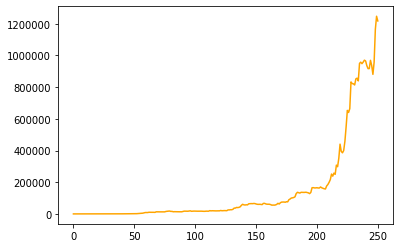

In [222]:
from pandas.core.frame import DataFrame
trades=DataFrame(trades)
trades.to_csv('trades1.csv')
trades1=np.array(trades)
trades1=trades1.tolist()
y=[]
for i in trades1:
    y.append(i[0]+i[1]+i[2])
plt.plot(y,'orange')
plt.show()

In [192]:
from scipy.optimize import minimize
import numpy as np
#目标函数即min(FG1+FG2+FG3)
bit=pd.read_csv('Btcoin.csv')
gold=pd.read_csv('gold.csv')
trades=[np.array([1,0,0]),np.array([1,0,0])]
asset=[1000,1000]
Wt=1000
Rt=np.array([0,0,0])
a=np.array([0,0.01,0.02])
Wo=1000
Xo=trades[-1]
def fun(X):
    return -(Wt*np.dot(X,Rt)-np.dot(np.abs(np.dot(Wt,X)-np.dot(Wo,Xo)),a))

def con():
    # 约束条件 分为eq 和ineq
    #eq表示 函数结果等于0 ； ineq 表示 表达式大于等于0
    cons = ({'type': 'eq', 'fun': lambda X: X[0]+X[1]+X[2]-1},
            {'type': 'ineq', 'fun': lambda X: X[0]},
            {'type': 'ineq', 'fun': lambda X: X[1]},
            {'type': 'ineq', 'fun': lambda X: X[2]}
           )

            #{'type': 'ineq', 'fun': lambda x: -x[2] + x2max}#如果有不等式约束
   #cons= ([con1, con2, con3, con4, con5, con6, con7, con8]) #如果有多个约束，则最后返回结果是这个
   #x[0] 其中的0 必须是具体数字，不能是t 等参数
    

    return cons

#上下限约束
#b1=(100,200)#
#b2=(120,250)#
#b3=(150,300)#
#bnds = (b1,b2,b3)#边界约束
if __name__ == "__main__":
            for i in range(30,len(bit),7):
                cons=con()#约束
                Rt = np.array([1,1+(gold['Value'][i+6]-gold['Value'][i-1])/gold['Value'][i-1], 1+(bit['Value'][i+6]-bit['Value'][i-1])/bit['Value'][i-1]])
                Xo = trades[-2]
                Wo=asset[-2]
                Xt=trades[-1]
                res = minimize(fun, Xt, method='SLSQP', constraints=cons)
                Wt=-res.fun
                trades.append(np.array(res.x))
                asset.append(Wt)
                print('days',bit['Date'][i])
                print('Wt',Wt)
                print('portfolio',res.x)

days 2016-10-11
Wt 1014.7022055251523
portfolio [ 4.10782519e-14 -5.88140647e-13  1.00000000e+00]
days 2016-10-18
Wt 1014.7022055251522
portfolio [ 1.00000000e+00 -2.77555756e-16  2.22044605e-16]
days 2016-10-25
Wt 1093.5398889769735
portfolio [-2.80977464e-11 -3.45010687e-11  1.00000000e+00]
days 2016-11-01
Wt 1093.5398889769726
portfolio [ 1.00000000e+00 -1.90403249e-14  3.39728246e-14]
days 2016-11-08
Wt 1088.148895662053
portfolio [-1.73019416e-12  1.98631776e-11  1.00000000e+00]
days 2016-11-15
Wt 1115.782819319154
portfolio [-1.73019416e-12  1.98631776e-11  1.00000000e+00]
days 2016-11-22
Wt 1099.251283058603
portfolio [2.47676281e-02 3.77243482e-12 9.75232372e-01]
days 2016-11-29
Wt 1140.2119105969273
portfolio [1.49466897e-11 7.46159221e-11 1.00000000e+00]
days 2016-12-06
Wt 1172.6482426444466
portfolio [1.49466897e-11 7.46159221e-11 1.00000000e+00]
days 2016-12-13
Wt 1189.7734315572866
portfolio [2.76604859e-02 1.85046306e-10 9.72339514e-01]
days 2016-12-20
Wt 1353.35368697094

C:\Users\11438\anaconda3\lib\site-packages\ipykernel_launcher.py:40: RuntimeWarning: invalid value encountered in double_scalars
C:\Users\11438\anaconda3\lib\site-packages\ipykernel_launcher.py:40: RuntimeWarning: divide by zero encountered in double_scalars


days 2018-08-21
Wt nan
portfolio [ 1.95253028e-07 -1.95291408e-07  1.00000000e+00]
days 2018-08-28
Wt nan
portfolio [ 1.95253028e-07 -1.95291408e-07  1.00000000e+00]
days 2018-09-04
Wt nan
portfolio [ 1.95253028e-07 -1.95291408e-07  1.00000000e+00]
days 2018-09-11
Wt nan
portfolio [ 1.95253028e-07 -1.95291408e-07  1.00000000e+00]
days 2018-09-18
Wt nan
portfolio [ 1.95253028e-07 -1.95291408e-07  1.00000000e+00]
days 2018-09-25
Wt nan
portfolio [ 1.95253028e-07 -1.95291408e-07  1.00000000e+00]
days 2018-10-02
Wt nan
portfolio [ 1.95253028e-07 -1.95291408e-07  1.00000000e+00]
days 2018-10-09
Wt nan
portfolio [ 1.95253028e-07 -1.95291408e-07  1.00000000e+00]
days 2018-10-16
Wt nan
portfolio [ 1.95253028e-07 -1.95291408e-07  1.00000000e+00]
days 2018-10-23
Wt nan
portfolio [ 1.95253028e-07 -1.95291408e-07  1.00000000e+00]
days 2018-10-30
Wt nan
portfolio [ 1.95253028e-07 -1.95291408e-07  1.00000000e+00]
days 2018-11-06
Wt nan
portfolio [ 1.95253028e-07 -1.95291408e-07  1.00000000e+00]
days

portfolio [ 1.95253028e-07 -1.95291408e-07  1.00000000e+00]
days 2020-11-03
Wt nan
portfolio [ 1.95253028e-07 -1.95291408e-07  1.00000000e+00]
days 2020-11-10
Wt nan
portfolio [ 1.95253028e-07 -1.95291408e-07  1.00000000e+00]
days 2020-11-17
Wt nan
portfolio [ 1.95253028e-07 -1.95291408e-07  1.00000000e+00]
days 2020-11-24
Wt nan
portfolio [ 1.95253028e-07 -1.95291408e-07  1.00000000e+00]
days 2020-12-01
Wt nan
portfolio [ 1.95253028e-07 -1.95291408e-07  1.00000000e+00]
days 2020-12-08
Wt nan
portfolio [ 1.95253028e-07 -1.95291408e-07  1.00000000e+00]
days 2020-12-15
Wt nan
portfolio [ 1.95253028e-07 -1.95291408e-07  1.00000000e+00]
days 2020-12-22
Wt nan
portfolio [ 1.95253028e-07 -1.95291408e-07  1.00000000e+00]
days 2020-12-29
Wt nan
portfolio [ 1.95253028e-07 -1.95291408e-07  1.00000000e+00]
days 2021-01-05
Wt nan
portfolio [ 1.95253028e-07 -1.95291408e-07  1.00000000e+00]
days 2021-01-12
Wt nan
portfolio [ 1.95253028e-07 -1.95291408e-07  1.00000000e+00]
days 2021-01-19
Wt nan
port

KeyError: 1828

In [154]:
import numpy as np
import random
import matplotlib.pyplot as plt
import pandas as pd
bit=pd.read_csv('Btcoin.csv')
gold=pd.read_csv('gold.csv')
trades=[np.array([1000,0,0]),np.array([1000,0,0])]
Wt=1000
Rt=np.array([0,0,0])
a=np.array([0,0.01,0.02])
Wo=1000
Xo=trades[-1]

class PSO():
    def __init__(self, pN, dim, max_iter):
        self.w = 0.8
        self.c1 = 2
        self.c2 = 2
        self.r1 = 0.6
        self.r2 = 0.3
        self.pN = pN  # 粒子数量
        self.dim = dim  # 搜索维度
        self.max_iter = max_iter  # 迭代次数
        self.X = np.zeros((self.pN, self.dim))  # 所有粒子的位置和速度
        self.V = np.zeros((self.pN, self.dim))
        self.pbest = np.zeros((self.pN, self.dim))  # 个体经历的最佳位置和全局最佳位置
        self.gbest = np.zeros((1, self.dim))
        self.p_fit = np.zeros(self.pN)  # 每个个体的历史最佳适应值
        self.fit = 1e10  # 全局最佳适应值

    # ---------------------目标函数Sphere函数-----------------------------
    def function(self, X):
        return -(Wt*np.dot(X,Rt)-np.dot(np.abs(np.dot(Wt,X)-np.dot(Wo,Xo)),a))

    # ---------------------初始化种群----------------------------------
    def init_Population(self):
        for i in range(self.pN):
            for j in range(self.dim):
                self.X[i][j] = random.uniform(0, 1)
                self.V[i][j] = random.uniform(0, 1)
            self.pbest[i] = self.X[i]
            tmp = self.function(self.X[i])
            self.p_fit[i] = tmp
            if tmp < self.fit:
                self.fit = tmp
                self.gbest = self.X[i]

                # ----------------------更新粒子位置----------------------------------

    def iterator(self):
        fitness = []
        for t in range(self.max_iter):
            for i in range(self.pN):  # 更新gbest\pbest
                temp = self.function(self.X[i])
                if temp < self.p_fit[i]:  # 更新个体最优
                    self.p_fit[i] = temp
                    self.pbest[i] = self.X[i]
                    if self.p_fit[i] < self.fit:  # 更新全局最优
                        self.gbest = self.X[i]
                        self.fit = self.p_fit[i]
            for i in range(self.pN):
                self.V[i] = self.w * self.V[i] + self.c1 * self.r1 * (self.pbest[i] - self.X[i]) + \
                            self.c2 * self.r2 * (self.gbest - self.X[i])
                self.X[i] = self.X[i] + self.V[i]
            fitness.append(self.fit)
        print(self.X[0], end=" ")
        print(self.fit)  # 输出最优值
        return fitness,self.X[0]

        # ----------------------程序执行-----------------------


for i in range (30,len(bit)):
    Wt = sum(trades[-1])
    Rt = np.array([1,1+(gold['Value'][i]-gold['Value'][i-1])/gold['Value'][i-1], 1+(bit['Value'][i]-bit['Value'][i-1])/bit['Value'][i-1]])
    Xo = trades[-2]
    Wo=sum(Xo)
    my_pso = PSO(pN=30, dim=3, max_iter=100)
    my_pso.init_Population()
    fitness,res= my_pso.iterator()
    trades.append(np.dot(res,Rt))
# -------------------画图--------------------
plt.figure(1)
plt.title("Figure1")
plt.xlabel("iterators", size=14)
plt.ylabel("fitness", size=14)
t = np.array([t for t in range(0, 100)])
fitness = np.array(fitness)
plt.plot(t, fitness, color='b', linewidth=3)
plt.show()

[2.85267824e+10 3.30161413e+10 1.28317429e+10] -68802794841770.836


TypeError: 'numpy.float64' object is not iterable

In [223]:
trades=[[1000,0,0]]
trans_time=3 #换仓周期
a1=0.01 #黄金交易费
a2=0.02 #比特币交易费
time=[]
for day in range(50,1800,trans_time):      
    position=trades[-1] #今日仓位
    Wt=position[0]+position[1]+position[2]#今日资产总额
    #gold_train=gold_data[0:day-1]
    #gold_test=gold_data[day:]
    #bit_train=bit_data[0:day-1]
    #bit_test=bit_data[day:]
    print(position)
    #gold_predict
    train_x, train_y,test_x,test_y,scaler=get_data(gold_data, sequence_length=3, split=day)
    train_x = np.reshape(train_x, (train_x.shape[0], train_x.shape[1], 1))
    test_x = np.reshape(test_x, (test_x.shape[0], test_x.shape[1], 1))
    predict_y, test_y = train_model(train_x, train_y, test_x, test_y)
    predict_y = scaler.inverse_transform([[i] for i in predict_y])
    test_y = scaler.inverse_transform(test_y)
    gold_predict=predict_y[trans_time]
    
    train_x, train_y,test_x,test_y,scaler=get_data(bit_data, sequence_length=3, split=day)
    train_x = np.reshape(train_x, (train_x.shape[0], train_x.shape[1], 1))
    test_x = np.reshape(test_x, (test_x.shape[0], test_x.shape[1], 1))
    predict_y, test_y = train_model(train_x, train_y, test_x, test_y)
    predict_y = scaler.inverse_transform([[i] for i in predict_y])
    test_y = scaler.inverse_transform(test_y)
    bit_predict=predict_y[trans_time]
    
    gold_pred_increase=(gold_predict-gold_data['Value'][day-1])/gold_data['Value'][day-1] #黄金预测涨幅
    bit_pred_increase=(bit_predict-bit_data['Value'][day-1])/bit_data['Value'][day-1] #比特币预测涨幅
    
    gold_increase=(gold_data['Value'][day-1+trans_time]-gold_data['Value'][day-1])/gold_data['Value'][day-1]#黄金实际涨幅
    bit_increase=(bit_data['Value'][day-1+trans_time]-bit_data['Value'][day-1])/bit_data['Value'][day-1]#比特币实际涨幅
    
    if(gold_pred_increase<-a1 and bit_pred_increase<-a2):
        position=[position[0]+position[1]*(1-a1)+position[2]*(1-a2),0,0]
    elif bit_pred_increase-a2>gold_pred_increase-a1 and bit_pred_increase-a2>0:
        position=[0,0,position[0]*(1-a2)+position[1]*(1-a1)*(1-a2)+position[2]]
    elif bit_pred_increase-a2<gold_pred_increase-a1 and gold_pred_increase>a1:
        position=[0,position[0]*(1-a1)+position[1]+position[2]*(1-a1)*(1-a2),0]
    else:position=position
    
    asset=[position[0],position[1]*(1+gold_increase),position[2]*(1+bit_increase)]
    trades.append(asset)
    time.append(day)
    print('day:',day,'position:',asset,gold_predict,bit_predict,gold_pred_increase,gold_increase)
print(trades)

[1000, 0, 0]
Epoch 1/100
1/1 [==============================] - 4s 4s/step - loss: 0.0293 - val_loss: 0.0212
Epoch 2/100
1/1 [==============================] - 0s 29ms/step - loss: 0.0173 - val_loss: 0.0129
Epoch 3/100
1/1 [==============================] - 0s 26ms/step - loss: 0.0099 - val_loss: 0.0069
Epoch 4/100
1/1 [==============================] - 0s 27ms/step - loss: 0.0048 - val_loss: 0.0031
Epoch 5/100
1/1 [==============================] - 0s 28ms/step - loss: 0.0020 - val_loss: 0.0012
Epoch 6/100
1/1 [==============================] - 0s 26ms/step - loss: 8.5590e-04 - val_loss: 5.8729e-04
Epoch 7/100
1/1 [==============================] - 0s 26ms/step - loss: 6.2334e-04 - val_loss: 4.2302e-04
Epoch 8/100
1/1 [==============================] - 0s 27ms/step - loss: 5.9986e-04 - val_loss: 3.9374e-04
Epoch 9/100
1/1 [==============================] - 0s 25ms/step - loss: 5.9649e-04 - val_loss: 3.9123e-04
Epoch 10/100
1/1 [==============================] - 0s 27ms/step - loss: 5.

Epoch 78/100
1/1 [==============================] - 0s 24ms/step - loss: 4.0029e-04 - val_loss: 0.0013
Epoch 79/100
1/1 [==============================] - 0s 26ms/step - loss: 4.2694e-04 - val_loss: 1.7844e-04
Epoch 80/100
1/1 [==============================] - 0s 26ms/step - loss: 4.3293e-04 - val_loss: 0.0015
Epoch 81/100
1/1 [==============================] - 0s 25ms/step - loss: 4.8930e-04 - val_loss: 1.2290e-04
Epoch 82/100
1/1 [==============================] - 0s 26ms/step - loss: 4.9454e-04 - val_loss: 0.0017
Epoch 83/100
1/1 [==============================] - 0s 26ms/step - loss: 5.6189e-04 - val_loss: 1.0717e-04
Epoch 84/100
1/1 [==============================] - 0s 29ms/step - loss: 5.1679e-04 - val_loss: 0.0017
Epoch 85/100
1/1 [==============================] - 0s 24ms/step - loss: 5.4851e-04 - val_loss: 1.3958e-04
Epoch 86/100
1/1 [==============================] - 0s 26ms/step - loss: 4.7157e-04 - val_loss: 0.0015
Epoch 87/100
1/1 [==============================] - 0s 25

1/1 [==============================] - 0s 25ms/step - loss: 5.0308e-04 - val_loss: 8.2699e-05
Epoch 30/100
1/1 [==============================] - 0s 26ms/step - loss: 4.9664e-04 - val_loss: 8.1311e-05
Epoch 31/100
1/1 [==============================] - 0s 25ms/step - loss: 4.8989e-04 - val_loss: 7.9855e-05
Epoch 32/100
1/1 [==============================] - 0s 27ms/step - loss: 4.8283e-04 - val_loss: 7.8357e-05
Epoch 33/100
1/1 [==============================] - 0s 26ms/step - loss: 4.7546e-04 - val_loss: 7.6745e-05
Epoch 34/100
1/1 [==============================] - 0s 24ms/step - loss: 4.6775e-04 - val_loss: 7.5197e-05
Epoch 35/100
1/1 [==============================] - 0s 28ms/step - loss: 4.5971e-04 - val_loss: 7.3237e-05
Epoch 36/100
1/1 [==============================] - 0s 26ms/step - loss: 4.5133e-04 - val_loss: 7.2214e-05
Epoch 37/100
1/1 [==============================] - 0s 28ms/step - loss: 4.4259e-04 - val_loss: 6.7976e-05
Epoch 38/100
1/1 [==============================] 

1/1 [==============================] - 0s 24ms/step - loss: 1.8240e-05 - val_loss: 1.9286e-05
Epoch 82/100
1/1 [==============================] - 0s 26ms/step - loss: 3.0764e-05 - val_loss: 3.5181e-05
Epoch 83/100
1/1 [==============================] - 0s 26ms/step - loss: 2.3291e-05 - val_loss: 3.8658e-06
Epoch 84/100
1/1 [==============================] - 0s 25ms/step - loss: 9.8857e-06 - val_loss: 9.3410e-06
Epoch 85/100
1/1 [==============================] - 0s 24ms/step - loss: 3.9720e-06 - val_loss: 8.6542e-09
Epoch 86/100
1/1 [==============================] - 0s 27ms/step - loss: 1.7769e-06 - val_loss: 3.8815e-06
Epoch 87/100
1/1 [==============================] - 0s 25ms/step - loss: 9.7199e-07 - val_loss: 2.5122e-07
Epoch 88/100
1/1 [==============================] - 0s 27ms/step - loss: 6.7232e-07 - val_loss: 2.7799e-06
Epoch 89/100
1/1 [==============================] - 0s 25ms/step - loss: 5.5708e-07 - val_loss: 4.0174e-07
Epoch 90/100
1/1 [==============================] 

1/1 [==============================] - 0s 28ms/step - loss: 3.3321e-07 - val_loss: 1.2876e-06
Epoch 33/100
1/1 [==============================] - 0s 27ms/step - loss: 3.3315e-07 - val_loss: 1.2949e-06
Epoch 34/100
1/1 [==============================] - 0s 26ms/step - loss: 3.3310e-07 - val_loss: 1.2684e-06
Epoch 35/100
1/1 [==============================] - 0s 28ms/step - loss: 3.3311e-07 - val_loss: 1.3676e-06
Epoch 36/100
1/1 [==============================] - 0s 29ms/step - loss: 3.3414e-07 - val_loss: 9.9088e-07
Epoch 37/100
1/1 [==============================] - 0s 28ms/step - loss: 3.5236e-07 - val_loss: 3.0238e-06
Epoch 38/100
1/1 [==============================] - 0s 27ms/step - loss: 6.9768e-07 - val_loss: 2.5325e-06
Epoch 39/100
1/1 [==============================] - 0s 31ms/step - loss: 7.7633e-06 - val_loss: 1.3026e-04
Epoch 40/100
1/1 [==============================] - 0s 28ms/step - loss: 1.0596e-04 - val_loss: 8.9618e-05
Epoch 41/100
1/1 [==============================] 

1/1 [==============================] - 0s 28ms/step - loss: 4.3773e-04 - val_loss: 0.0012
Epoch 87/100
1/1 [==============================] - 0s 28ms/step - loss: 5.0542e-04 - val_loss: 0.0041
Epoch 88/100
1/1 [==============================] - 0s 27ms/step - loss: 5.0341e-04 - val_loss: 0.0011
Epoch 89/100
1/1 [==============================] - 0s 26ms/step - loss: 5.6143e-04 - val_loss: 0.0040
Epoch 90/100
1/1 [==============================] - 0s 26ms/step - loss: 4.9288e-04 - val_loss: 0.0012
Epoch 91/100
1/1 [==============================] - 0s 29ms/step - loss: 5.0607e-04 - val_loss: 0.0038
Epoch 92/100
1/1 [==============================] - 0s 25ms/step - loss: 4.3449e-04 - val_loss: 0.0014
Epoch 93/100
1/1 [==============================] - 0s 27ms/step - loss: 4.3691e-04 - val_loss: 0.0036
Epoch 94/100
1/1 [==============================] - 0s 28ms/step - loss: 3.9651e-04 - val_loss: 0.0014
Epoch 95/100
1/1 [==============================] - 0s 28ms/step - loss: 4.0716e-04 - 

Epoch 63/100
1/1 [==============================] - 0s 26ms/step - loss: 6.5378e-06 - val_loss: 4.0525e-05
Epoch 64/100
1/1 [==============================] - 0s 29ms/step - loss: 2.7346e-05 - val_loss: 4.1665e-05
Epoch 65/100
1/1 [==============================] - 0s 31ms/step - loss: 5.8617e-05 - val_loss: 5.5560e-05
Epoch 66/100
1/1 [==============================] - 0s 30ms/step - loss: 3.9799e-05 - val_loss: 5.4318e-06
Epoch 67/100
1/1 [==============================] - 0s 28ms/step - loss: 1.2703e-05 - val_loss: 9.3543e-06
Epoch 68/100
1/1 [==============================] - 0s 28ms/step - loss: 3.9370e-06 - val_loss: 2.2328e-08
Epoch 69/100
1/1 [==============================] - 0s 28ms/step - loss: 1.4538e-06 - val_loss: 3.2740e-06
Epoch 70/100
1/1 [==============================] - 0s 29ms/step - loss: 7.9748e-07 - val_loss: 5.4385e-07
Epoch 71/100
1/1 [==============================] - 0s 27ms/step - loss: 5.9072e-07 - val_loss: 2.3161e-06
Epoch 72/100
1/1 [===================

1/1 [==============================] - 0s 24ms/step - loss: 4.3608e-07 - val_loss: 9.8464e-07
Epoch 18/100
1/1 [==============================] - 0s 27ms/step - loss: 4.3601e-07 - val_loss: 9.8444e-07
Epoch 19/100
1/1 [==============================] - 0s 27ms/step - loss: 4.3593e-07 - val_loss: 9.8424e-07
Epoch 20/100
1/1 [==============================] - 0s 26ms/step - loss: 4.3586e-07 - val_loss: 9.8402e-07
Epoch 21/100
1/1 [==============================] - 0s 26ms/step - loss: 4.3578e-07 - val_loss: 9.8380e-07
Epoch 22/100
1/1 [==============================] - 0s 26ms/step - loss: 4.3569e-07 - val_loss: 9.8357e-07
Epoch 23/100
1/1 [==============================] - 0s 27ms/step - loss: 4.3561e-07 - val_loss: 9.8333e-07
Epoch 24/100
1/1 [==============================] - 0s 28ms/step - loss: 4.3552e-07 - val_loss: 9.8309e-07
Epoch 25/100
1/1 [==============================] - 0s 27ms/step - loss: 4.3543e-07 - val_loss: 9.8283e-07
Epoch 26/100
1/1 [==============================] 

Epoch 70/100
1/1 [==============================] - 0s 28ms/step - loss: 6.2945e-04 - val_loss: 0.0012
Epoch 71/100
1/1 [==============================] - 0s 28ms/step - loss: 6.4326e-04 - val_loss: 1.8758e-05
Epoch 72/100
1/1 [==============================] - 0s 24ms/step - loss: 7.2518e-04 - val_loss: 0.0011
Epoch 73/100
1/1 [==============================] - 0s 25ms/step - loss: 6.2389e-04 - val_loss: 3.7339e-05
Epoch 74/100
1/1 [==============================] - 0s 27ms/step - loss: 6.3035e-04 - val_loss: 9.3687e-04
Epoch 75/100
1/1 [==============================] - 0s 26ms/step - loss: 5.3300e-04 - val_loss: 7.0707e-05
Epoch 76/100
1/1 [==============================] - 0s 27ms/step - loss: 5.2767e-04 - val_loss: 8.0484e-04
Epoch 77/100
1/1 [==============================] - 0s 26ms/step - loss: 4.8145e-04 - val_loss: 7.8172e-05
Epoch 78/100
1/1 [==============================] - 0s 26ms/step - loss: 4.8974e-04 - val_loss: 7.6091e-04
Epoch 79/100
1/1 [===========================

Epoch 46/100
1/1 [==============================] - 0s 27ms/step - loss: 6.7661e-07 - val_loss: 2.6011e-06
Epoch 47/100
1/1 [==============================] - 0s 26ms/step - loss: 4.9836e-07 - val_loss: 1.7914e-06
Epoch 48/100
1/1 [==============================] - 0s 26ms/step - loss: 4.7163e-07 - val_loss: 2.1792e-06
Epoch 49/100
1/1 [==============================] - 0s 26ms/step - loss: 4.6613e-07 - val_loss: 1.9464e-06
Epoch 50/100
1/1 [==============================] - 0s 24ms/step - loss: 4.6460e-07 - val_loss: 2.1016e-06
Epoch 51/100
1/1 [==============================] - 0s 28ms/step - loss: 4.6403e-07 - val_loss: 1.9811e-06
Epoch 52/100
1/1 [==============================] - 0s 24ms/step - loss: 4.6375e-07 - val_loss: 2.0848e-06
Epoch 53/100
1/1 [==============================] - 0s 27ms/step - loss: 4.6359e-07 - val_loss: 1.9833e-06
Epoch 54/100
1/1 [==============================] - 0s 26ms/step - loss: 4.6349e-07 - val_loss: 2.0922e-06
Epoch 55/100
1/1 [===================

Epoch 100/100
1/1 [==============================] - 0s 24ms/step - loss: 5.4719e-04 - val_loss: 0.0011
Epoch 1/100
1/1 [==============================] - 4s 4s/step - loss: 1.3117e-06 - val_loss: 7.0311e-04
Epoch 2/100
1/1 [==============================] - 0s 27ms/step - loss: 7.6771e-04 - val_loss: 4.5779e-06
Epoch 3/100
1/1 [==============================] - 0s 25ms/step - loss: 1.4124e-06 - val_loss: 1.6910e-06
Epoch 4/100
1/1 [==============================] - 0s 24ms/step - loss: 5.3200e-07 - val_loss: 1.4458e-06
Epoch 5/100
1/1 [==============================] - 0s 27ms/step - loss: 5.2100e-07 - val_loss: 1.4291e-06
Epoch 6/100
1/1 [==============================] - 0s 25ms/step - loss: 5.2091e-07 - val_loss: 1.4287e-06
Epoch 7/100
1/1 [==============================] - 0s 25ms/step - loss: 5.2086e-07 - val_loss: 1.4285e-06
Epoch 8/100
1/1 [==============================] - 0s 24ms/step - loss: 5.2081e-07 - val_loss: 1.4283e-06
Epoch 9/100
1/1 [==============================] -

1/1 [==============================] - 0s 25ms/step - loss: 1.7103e-06 - val_loss: 2.8699e-07
Epoch 77/100
1/1 [==============================] - 0s 25ms/step - loss: 3.5676e-06 - val_loss: 1.6801e-05
Epoch 78/100
1/1 [==============================] - 0s 24ms/step - loss: 8.8843e-06 - val_loss: 1.0720e-05
Epoch 79/100
1/1 [==============================] - 0s 26ms/step - loss: 2.0634e-05 - val_loss: 4.5614e-05
Epoch 80/100
1/1 [==============================] - 0s 27ms/step - loss: 3.1216e-05 - val_loss: 1.2783e-05
Epoch 81/100
1/1 [==============================] - 0s 26ms/step - loss: 2.3495e-05 - val_loss: 2.0918e-05
Epoch 82/100
1/1 [==============================] - 0s 23ms/step - loss: 1.1842e-05 - val_loss: 9.9095e-07
Epoch 83/100
1/1 [==============================] - 0s 27ms/step - loss: 5.4108e-06 - val_loss: 7.3484e-06
Epoch 84/100
1/1 [==============================] - 0s 24ms/step - loss: 2.7663e-06 - val_loss: 2.5326e-08
Epoch 85/100
1/1 [==============================] 

Epoch 53/100
1/1 [==============================] - 0s 24ms/step - loss: 7.5099e-04 - val_loss: 0.0011
Epoch 54/100
1/1 [==============================] - 0s 24ms/step - loss: 9.7129e-04 - val_loss: 0.0049
Epoch 55/100
1/1 [==============================] - 0s 24ms/step - loss: 7.7115e-04 - val_loss: 0.0014
Epoch 56/100
1/1 [==============================] - 0s 25ms/step - loss: 7.4596e-04 - val_loss: 0.0041
Epoch 57/100
1/1 [==============================] - 0s 23ms/step - loss: 5.5433e-04 - val_loss: 0.0018
Epoch 58/100
1/1 [==============================] - 0s 25ms/step - loss: 5.1999e-04 - val_loss: 0.0036
Epoch 59/100
1/1 [==============================] - 0s 25ms/step - loss: 4.6242e-04 - val_loss: 0.0019
Epoch 60/100
1/1 [==============================] - 0s 23ms/step - loss: 4.5665e-04 - val_loss: 0.0035
Epoch 61/100
1/1 [==============================] - 0s 25ms/step - loss: 4.4138e-04 - val_loss: 0.0017
Epoch 62/100
1/1 [==============================] - 0s 24ms/step - loss: 

1/1 [==============================] - 0s 28ms/step - loss: 0.0028 - val_loss: 0.0030
Epoch 6/100
1/1 [==============================] - 0s 28ms/step - loss: 0.0016 - val_loss: 0.0043
Epoch 7/100
1/1 [==============================] - 0s 28ms/step - loss: 0.0012 - val_loss: 0.0049
Epoch 8/100
1/1 [==============================] - 0s 28ms/step - loss: 0.0012 - val_loss: 0.0050
Epoch 9/100
1/1 [==============================] - 0s 28ms/step - loss: 0.0012 - val_loss: 0.0049
Epoch 10/100
1/1 [==============================] - 0s 29ms/step - loss: 0.0012 - val_loss: 0.0049
Epoch 11/100
1/1 [==============================] - 0s 29ms/step - loss: 0.0011 - val_loss: 0.0048
Epoch 12/100
1/1 [==============================] - 0s 28ms/step - loss: 0.0011 - val_loss: 0.0047
Epoch 13/100
1/1 [==============================] - 0s 29ms/step - loss: 0.0011 - val_loss: 0.0047
Epoch 14/100
1/1 [==============================] - 0s 28ms/step - loss: 0.0011 - val_loss: 0.0046
Epoch 15/100
1/1 [=========

1/1 [==============================] - 0s 28ms/step - loss: 5.8519e-04 - val_loss: 4.4934e-04
Epoch 85/100
1/1 [==============================] - 0s 26ms/step - loss: 4.9376e-04 - val_loss: 3.4362e-06
Epoch 86/100
1/1 [==============================] - 0s 26ms/step - loss: 5.0386e-04 - val_loss: 3.7254e-04
Epoch 87/100
1/1 [==============================] - 0s 26ms/step - loss: 4.4207e-04 - val_loss: 1.6459e-06
Epoch 88/100
1/1 [==============================] - 0s 27ms/step - loss: 4.5631e-04 - val_loss: 3.3148e-04
Epoch 89/100
1/1 [==============================] - 0s 26ms/step - loss: 4.2430e-04 - val_loss: 3.6695e-06
Epoch 90/100
1/1 [==============================] - 0s 28ms/step - loss: 4.5315e-04 - val_loss: 3.2569e-04
Epoch 91/100
1/1 [==============================] - 0s 26ms/step - loss: 4.3810e-04 - val_loss: 1.1547e-05
Epoch 92/100
1/1 [==============================] - 0s 27ms/step - loss: 4.8489e-04 - val_loss: 3.4103e-04
Epoch 93/100
1/1 [==============================] 

Epoch 37/100
1/1 [==============================] - 0s 23ms/step - loss: 4.9860e-04 - val_loss: 0.0013
Epoch 38/100
1/1 [==============================] - 0s 23ms/step - loss: 4.8048e-04 - val_loss: 1.2796e-04
Epoch 39/100
1/1 [==============================] - 0s 23ms/step - loss: 9.2661e-04 - val_loss: 0.0048
Epoch 40/100
1/1 [==============================] - 0s 22ms/step - loss: 0.0029 - val_loss: 8.0236e-06
Epoch 41/100
1/1 [==============================] - 0s 23ms/step - loss: 0.0015 - val_loss: 0.0012
Epoch 42/100
1/1 [==============================] - 0s 26ms/step - loss: 4.5876e-04 - val_loss: 7.2758e-04
Epoch 43/100
1/1 [==============================] - 0s 23ms/step - loss: 4.2313e-04 - val_loss: 8.3709e-04
Epoch 44/100
1/1 [==============================] - 0s 24ms/step - loss: 4.0891e-04 - val_loss: 7.1401e-04
Epoch 45/100
1/1 [==============================] - 0s 23ms/step - loss: 3.9804e-04 - val_loss: 7.1209e-04
Epoch 46/100
1/1 [==============================] - 0s 25

1/1 [==============================] - 0s 29ms/step - loss: 1.2685e-06 - val_loss: 2.4059e-07
Epoch 90/100
1/1 [==============================] - 0s 24ms/step - loss: 1.0666e-06 - val_loss: 2.9406e-06
Epoch 91/100
1/1 [==============================] - 0s 23ms/step - loss: 9.9840e-07 - val_loss: 2.9460e-07
Epoch 92/100
1/1 [==============================] - 0s 25ms/step - loss: 1.0017e-06 - val_loss: 3.1732e-06
Epoch 93/100
1/1 [==============================] - 0s 24ms/step - loss: 1.0807e-06 - val_loss: 1.1784e-07
Epoch 94/100
1/1 [==============================] - 0s 23ms/step - loss: 1.2750e-06 - val_loss: 4.6759e-06
Epoch 95/100
1/1 [==============================] - 0s 24ms/step - loss: 1.7227e-06 - val_loss: 9.8494e-08
Epoch 96/100
1/1 [==============================] - 0s 24ms/step - loss: 2.7400e-06 - val_loss: 1.0475e-05
Epoch 97/100
1/1 [==============================] - 0s 24ms/step - loss: 5.0961e-06 - val_loss: 3.4949e-06
Epoch 98/100
1/1 [==============================] 

1/1 [==============================] - 0s 24ms/step - loss: 3.3476e-05 - val_loss: 1.7521e-10
Epoch 43/100
1/1 [==============================] - 0s 23ms/step - loss: 3.6216e-06 - val_loss: 5.1731e-06
Epoch 44/100
1/1 [==============================] - 0s 23ms/step - loss: 1.0009e-06 - val_loss: 2.2942e-06
Epoch 45/100
1/1 [==============================] - 0s 24ms/step - loss: 7.3988e-07 - val_loss: 3.3018e-06
Epoch 46/100
1/1 [==============================] - 0s 24ms/step - loss: 7.0534e-07 - val_loss: 2.7967e-06
Epoch 47/100
1/1 [==============================] - 0s 23ms/step - loss: 6.9878e-07 - val_loss: 3.0735e-06
Epoch 48/100
1/1 [==============================] - 0s 24ms/step - loss: 6.9706e-07 - val_loss: 2.8920e-06
Epoch 49/100
1/1 [==============================] - 0s 26ms/step - loss: 6.9641e-07 - val_loss: 3.0245e-06
Epoch 50/100
1/1 [==============================] - 0s 25ms/step - loss: 6.9606e-07 - val_loss: 2.9126e-06
Epoch 51/100
1/1 [==============================] 

1/1 [==============================] - 0s 28ms/step - loss: 0.0014 - val_loss: 0.0062
Epoch 19/100
1/1 [==============================] - 0s 27ms/step - loss: 0.0013 - val_loss: 0.0060
Epoch 20/100
1/1 [==============================] - 0s 28ms/step - loss: 0.0013 - val_loss: 0.0058
Epoch 21/100
1/1 [==============================] - 0s 28ms/step - loss: 0.0012 - val_loss: 0.0056
Epoch 22/100
1/1 [==============================] - 0s 29ms/step - loss: 0.0012 - val_loss: 0.0053
Epoch 23/100
1/1 [==============================] - 0s 25ms/step - loss: 0.0012 - val_loss: 0.0051
Epoch 24/100
1/1 [==============================] - 0s 27ms/step - loss: 0.0011 - val_loss: 0.0048
Epoch 25/100
1/1 [==============================] - 0s 25ms/step - loss: 0.0011 - val_loss: 0.0046
Epoch 26/100
1/1 [==============================] - 0s 26ms/step - loss: 0.0010 - val_loss: 0.0043
Epoch 27/100
1/1 [==============================] - 0s 30ms/step - loss: 9.4833e-04 - val_loss: 0.0040
Epoch 28/100
1/1 [=

1/1 [==============================] - 0s 28ms/step - loss: 4.7176e-04 - val_loss: 6.0072e-04
Epoch 97/100
1/1 [==============================] - 0s 27ms/step - loss: 4.1729e-04 - val_loss: 1.5178e-05
Epoch 98/100
1/1 [==============================] - 0s 25ms/step - loss: 4.3582e-04 - val_loss: 5.6793e-04
Epoch 99/100
1/1 [==============================] - 0s 25ms/step - loss: 3.9568e-04 - val_loss: 1.7792e-05
Epoch 100/100
1/1 [==============================] - 0s 29ms/step - loss: 4.1834e-04 - val_loss: 5.5679e-04
Epoch 1/100
1/1 [==============================] - 4s 4s/step - loss: 2.1896e-06 - val_loss: 5.5231e-04
Epoch 2/100
1/1 [==============================] - 0s 31ms/step - loss: 6.2011e-04 - val_loss: 6.8585e-06
Epoch 3/100
1/1 [==============================] - 0s 36ms/step - loss: 2.3035e-06 - val_loss: 1.9755e-06
Epoch 4/100
1/1 [==============================] - 0s 27ms/step - loss: 7.5951e-07 - val_loss: 1.8911e-06
Epoch 5/100
1/1 [==============================] - 0s 2

Epoch 49/100
1/1 [==============================] - 0s 25ms/step - loss: 2.3278e-04 - val_loss: 7.8726e-06
Epoch 50/100
1/1 [==============================] - 0s 27ms/step - loss: 2.3055e-04 - val_loss: 1.5419e-07
Epoch 51/100
1/1 [==============================] - 0s 27ms/step - loss: 2.2940e-04 - val_loss: 6.4340e-06
Epoch 52/100
1/1 [==============================] - 0s 26ms/step - loss: 2.3109e-04 - val_loss: 9.6383e-06
Epoch 53/100
1/1 [==============================] - 0s 27ms/step - loss: 2.4329e-04 - val_loss: 3.5809e-05
Epoch 54/100
1/1 [==============================] - 0s 28ms/step - loss: 2.9787e-04 - val_loss: 1.9098e-04
Epoch 55/100
1/1 [==============================] - 0s 29ms/step - loss: 5.3865e-04 - val_loss: 4.3824e-04
Epoch 56/100
1/1 [==============================] - 0s 27ms/step - loss: 0.0011 - val_loss: 6.6090e-04
Epoch 57/100
1/1 [==============================] - 0s 26ms/step - loss: 0.0015 - val_loss: 1.9836e-04
Epoch 58/100
1/1 [===========================

Epoch 1/100
1/1 [==============================] - 4s 4s/step - loss: 0.0221 - val_loss: 5.6779e-05
Epoch 2/100
1/1 [==============================] - 0s 29ms/step - loss: 0.0126 - val_loss: 3.1349e-04
Epoch 3/100
1/1 [==============================] - 0s 28ms/step - loss: 0.0074 - val_loss: 0.0017
Epoch 4/100
1/1 [==============================] - 0s 28ms/step - loss: 0.0041 - val_loss: 0.0036
Epoch 5/100
1/1 [==============================] - 0s 28ms/step - loss: 0.0025 - val_loss: 0.0052
Epoch 6/100
1/1 [==============================] - 0s 24ms/step - loss: 0.0020 - val_loss: 0.0059
Epoch 7/100
1/1 [==============================] - 0s 26ms/step - loss: 0.0019 - val_loss: 0.0060
Epoch 8/100
1/1 [==============================] - 0s 28ms/step - loss: 0.0018 - val_loss: 0.0059
Epoch 9/100
1/1 [==============================] - 0s 30ms/step - loss: 0.0018 - val_loss: 0.0058
Epoch 10/100
1/1 [==============================] - 0s 29ms/step - loss: 0.0018 - val_loss: 0.0056
Epoch 11/100


1/1 [==============================] - 0s 27ms/step - loss: 4.3284e-04 - val_loss: 3.4462e-05
Epoch 80/100
1/1 [==============================] - 0s 28ms/step - loss: 4.4675e-04 - val_loss: 2.2290e-04
Epoch 81/100
1/1 [==============================] - 0s 27ms/step - loss: 3.8782e-04 - val_loss: 2.3368e-05
Epoch 82/100
1/1 [==============================] - 0s 28ms/step - loss: 4.0090e-04 - val_loss: 2.0017e-04
Epoch 83/100
1/1 [==============================] - 0s 27ms/step - loss: 3.6723e-04 - val_loss: 2.3050e-05
Epoch 84/100
1/1 [==============================] - 0s 28ms/step - loss: 3.9106e-04 - val_loss: 1.9994e-04
Epoch 85/100
1/1 [==============================] - 0s 27ms/step - loss: 3.7400e-04 - val_loss: 3.0662e-05
Epoch 86/100
1/1 [==============================] - 0s 26ms/step - loss: 4.1210e-04 - val_loss: 2.1776e-04
Epoch 87/100
1/1 [==============================] - 0s 26ms/step - loss: 3.9969e-04 - val_loss: 4.1452e-05
Epoch 88/100
1/1 [==============================] 

Epoch 32/100
1/1 [==============================] - 0s 27ms/step - loss: 4.4393e-04 - val_loss: 3.9609e-04
Epoch 33/100
1/1 [==============================] - 0s 25ms/step - loss: 3.8401e-04 - val_loss: 3.5458e-04
Epoch 34/100
1/1 [==============================] - 0s 29ms/step - loss: 3.4185e-04 - val_loss: 1.2356e-06
Epoch 35/100
1/1 [==============================] - 0s 26ms/step - loss: 5.7413e-04 - val_loss: 0.0029
Epoch 36/100
1/1 [==============================] - 0s 29ms/step - loss: 0.0031 - val_loss: 2.3747e-04
Epoch 37/100
1/1 [==============================] - 0s 29ms/step - loss: 0.0017 - val_loss: 3.6416e-04
Epoch 38/100
1/1 [==============================] - 0s 27ms/step - loss: 3.4667e-04 - val_loss: 1.1259e-04
Epoch 39/100
1/1 [==============================] - 0s 29ms/step - loss: 2.9979e-04 - val_loss: 1.5994e-04
Epoch 40/100
1/1 [==============================] - 0s 30ms/step - loss: 2.8279e-04 - val_loss: 9.6506e-05
Epoch 41/100
1/1 [==============================]

1/1 [==============================] - 0s 27ms/step - loss: 5.1279e-06 - val_loss: 8.3453e-06
Epoch 85/100
1/1 [==============================] - 0s 28ms/step - loss: 2.7456e-06 - val_loss: 3.4070e-07
Epoch 86/100
1/1 [==============================] - 0s 26ms/step - loss: 1.7884e-06 - val_loss: 5.1334e-06
Epoch 87/100
1/1 [==============================] - 0s 26ms/step - loss: 1.4396e-06 - val_loss: 7.9750e-07
Epoch 88/100
1/1 [==============================] - 0s 26ms/step - loss: 1.2985e-06 - val_loss: 4.5657e-06
Epoch 89/100
1/1 [==============================] - 0s 26ms/step - loss: 1.2663e-06 - val_loss: 7.8326e-07
Epoch 90/100
1/1 [==============================] - 0s 25ms/step - loss: 1.3069e-06 - val_loss: 5.1628e-06
Epoch 91/100
1/1 [==============================] - 0s 26ms/step - loss: 1.4499e-06 - val_loss: 3.4498e-07
Epoch 92/100
1/1 [==============================] - 0s 27ms/step - loss: 1.7755e-06 - val_loss: 7.8804e-06
Epoch 93/100
1/1 [==============================] 

Epoch 61/100
1/1 [==============================] - 0s 30ms/step - loss: 2.5273e-04 - val_loss: 3.6237e-04
Epoch 62/100
1/1 [==============================] - 0s 30ms/step - loss: 2.4566e-04 - val_loss: 1.2713e-04
Epoch 63/100
1/1 [==============================] - 0s 28ms/step - loss: 2.4849e-04 - val_loss: 3.5241e-04
Epoch 64/100
1/1 [==============================] - 0s 30ms/step - loss: 2.5432e-04 - val_loss: 8.2953e-05
Epoch 65/100
1/1 [==============================] - 0s 27ms/step - loss: 2.7568e-04 - val_loss: 4.2637e-04
Epoch 66/100
1/1 [==============================] - 0s 29ms/step - loss: 3.1037e-04 - val_loss: 2.2890e-05
Epoch 67/100
1/1 [==============================] - 0s 29ms/step - loss: 4.0116e-04 - val_loss: 6.5987e-04
Epoch 68/100
1/1 [==============================] - 0s 29ms/step - loss: 5.0721e-04 - val_loss: 2.1679e-07
Epoch 69/100
1/1 [==============================] - 0s 26ms/step - loss: 7.0895e-04 - val_loss: 8.3474e-04
Epoch 70/100
1/1 [===================

1/1 [==============================] - 0s 31ms/step - loss: 2.4192e-06 - val_loss: 4.6756e-05
Epoch 38/100
1/1 [==============================] - 0s 28ms/step - loss: 2.7460e-05 - val_loss: 1.2918e-04
Epoch 39/100
1/1 [==============================] - 0s 27ms/step - loss: 1.7127e-04 - val_loss: 9.2500e-05
Epoch 40/100
1/1 [==============================] - 0s 26ms/step - loss: 6.3614e-05 - val_loss: 9.4128e-07
Epoch 41/100
1/1 [==============================] - 0s 26ms/step - loss: 8.1064e-06 - val_loss: 7.4077e-06
Epoch 42/100
1/1 [==============================] - 0s 27ms/step - loss: 1.9830e-06 - val_loss: 1.6685e-06
Epoch 43/100
1/1 [==============================] - 0s 28ms/step - loss: 1.1180e-06 - val_loss: 3.6312e-06
Epoch 44/100
1/1 [==============================] - 0s 27ms/step - loss: 9.8805e-07 - val_loss: 2.5280e-06
Epoch 45/100
1/1 [==============================] - 0s 26ms/step - loss: 9.5996e-07 - val_loss: 3.1587e-06
Epoch 46/100
1/1 [==============================] 

1/1 [==============================] - 0s 25ms/step - loss: 4.1084e-04 - val_loss: 9.5311e-06
Epoch 90/100
1/1 [==============================] - 0s 26ms/step - loss: 4.4871e-04 - val_loss: 2.6028e-04
Epoch 91/100
1/1 [==============================] - 0s 25ms/step - loss: 4.0585e-04 - val_loss: 5.9915e-06
Epoch 92/100
1/1 [==============================] - 0s 23ms/step - loss: 4.2763e-04 - val_loss: 2.4313e-04
Epoch 93/100
1/1 [==============================] - 0s 28ms/step - loss: 3.8165e-04 - val_loss: 3.3309e-06
Epoch 94/100
1/1 [==============================] - 0s 25ms/step - loss: 3.9755e-04 - val_loss: 2.2413e-04
Epoch 95/100
1/1 [==============================] - 0s 27ms/step - loss: 3.6347e-04 - val_loss: 2.8304e-06
Epoch 96/100
1/1 [==============================] - 0s 27ms/step - loss: 3.8342e-04 - val_loss: 2.1639e-04
Epoch 97/100
1/1 [==============================] - 0s 26ms/step - loss: 3.6111e-04 - val_loss: 3.9858e-06
Epoch 98/100
1/1 [==============================] 

1/1 [==============================] - 0s 29ms/step - loss: 2.2393e-04 - val_loss: 1.5227e-05
Epoch 42/100
1/1 [==============================] - 0s 28ms/step - loss: 2.2048e-04 - val_loss: 8.0455e-06
Epoch 43/100
1/1 [==============================] - 0s 28ms/step - loss: 2.1768e-04 - val_loss: 6.1609e-06
Epoch 44/100
1/1 [==============================] - 0s 27ms/step - loss: 2.1546e-04 - val_loss: 3.3998e-06
Epoch 45/100
1/1 [==============================] - 0s 29ms/step - loss: 2.1375e-04 - val_loss: 3.2813e-06
Epoch 46/100
1/1 [==============================] - 0s 27ms/step - loss: 2.1249e-04 - val_loss: 3.9747e-06
Epoch 47/100
1/1 [==============================] - 0s 28ms/step - loss: 2.1170e-04 - val_loss: 3.2441e-06
Epoch 48/100
1/1 [==============================] - 0s 28ms/step - loss: 2.1162e-04 - val_loss: 1.1019e-05
Epoch 49/100
1/1 [==============================] - 0s 26ms/step - loss: 2.1341e-04 - val_loss: 3.6552e-06
Epoch 50/100
1/1 [==============================] 

1/1 [==============================] - 0s 28ms/step - loss: 1.9445e-06 - val_loss: 1.7952e-05
Epoch 94/100
1/1 [==============================] - 0s 28ms/step - loss: 2.8419e-06 - val_loss: 1.0793e-06
Epoch 95/100
1/1 [==============================] - 0s 27ms/step - loss: 4.9537e-06 - val_loss: 3.3704e-05
Epoch 96/100
1/1 [==============================] - 0s 26ms/step - loss: 9.5277e-06 - val_loss: 1.1167e-06
Epoch 97/100
1/1 [==============================] - 0s 28ms/step - loss: 1.5454e-05 - val_loss: 4.7955e-05
Epoch 98/100
1/1 [==============================] - 0s 27ms/step - loss: 1.7271e-05 - val_loss: 4.4646e-07
Epoch 99/100
1/1 [==============================] - 0s 27ms/step - loss: 1.1828e-05 - val_loss: 2.9099e-05
Epoch 100/100
1/1 [==============================] - 0s 29ms/step - loss: 7.3206e-06 - val_loss: 1.3095e-06
day: 101 position: [928.2456074488464, 0.0, 0.0] [1123.03281567] [804.04152875] [-0.00236936] 0.005019099227147431
[928.2456074488464, 0.0, 0.0]
Epoch 1/100

1/1 [==============================] - 0s 27ms/step - loss: 1.3126e-06 - val_loss: 1.0765e-05
Epoch 46/100
1/1 [==============================] - 0s 27ms/step - loss: 1.3038e-06 - val_loss: 1.0047e-05
Epoch 47/100
1/1 [==============================] - 0s 27ms/step - loss: 1.3009e-06 - val_loss: 1.0546e-05
Epoch 48/100
1/1 [==============================] - 0s 28ms/step - loss: 1.2995e-06 - val_loss: 1.0135e-05
Epoch 49/100
1/1 [==============================] - 0s 29ms/step - loss: 1.2986e-06 - val_loss: 1.0497e-05
Epoch 50/100
1/1 [==============================] - 0s 28ms/step - loss: 1.2980e-06 - val_loss: 1.0121e-05
Epoch 51/100
1/1 [==============================] - 0s 27ms/step - loss: 1.2975e-06 - val_loss: 1.0532e-05
Epoch 52/100
1/1 [==============================] - 0s 28ms/step - loss: 1.2972e-06 - val_loss: 1.0012e-05
Epoch 53/100
1/1 [==============================] - 0s 28ms/step - loss: 1.2974e-06 - val_loss: 1.0711e-05
Epoch 54/100
1/1 [==============================] 

1/1 [==============================] - 0s 28ms/step - loss: 3.7399e-04 - val_loss: 4.1467e-04
Epoch 99/100
1/1 [==============================] - 0s 25ms/step - loss: 4.1238e-04 - val_loss: 3.3376e-05
Epoch 100/100
1/1 [==============================] - 0s 25ms/step - loss: 3.9040e-04 - val_loss: 4.2273e-04
Epoch 1/100
1/1 [==============================] - 4s 4s/step - loss: 4.4306e-06 - val_loss: 5.7411e-04
Epoch 2/100
1/1 [==============================] - 0s 29ms/step - loss: 7.8052e-04 - val_loss: 3.2067e-05
Epoch 3/100
1/1 [==============================] - 0s 27ms/step - loss: 4.4869e-06 - val_loss: 1.7194e-05
Epoch 4/100
1/1 [==============================] - 0s 29ms/step - loss: 1.6307e-06 - val_loss: 1.5808e-05
Epoch 5/100
1/1 [==============================] - 0s 29ms/step - loss: 1.5974e-06 - val_loss: 1.5715e-05
Epoch 6/100
1/1 [==============================] - 0s 27ms/step - loss: 1.5968e-06 - val_loss: 1.5709e-05
Epoch 7/100
1/1 [==============================] - 0s 28m

1/1 [==============================] - 0s 25ms/step - loss: 3.2385e-04 - val_loss: 3.1558e-05
Epoch 51/100
1/1 [==============================] - 0s 29ms/step - loss: 2.8524e-04 - val_loss: 9.9896e-05
Epoch 52/100
1/1 [==============================] - 0s 28ms/step - loss: 2.8606e-04 - val_loss: 2.4808e-05
Epoch 53/100
1/1 [==============================] - 0s 29ms/step - loss: 2.8262e-04 - val_loss: 1.3147e-04
Epoch 54/100
1/1 [==============================] - 0s 29ms/step - loss: 3.0931e-04 - val_loss: 3.7315e-05
Epoch 55/100
1/1 [==============================] - 0s 28ms/step - loss: 3.3292e-04 - val_loss: 2.1080e-04
Epoch 56/100
1/1 [==============================] - 0s 26ms/step - loss: 4.0767e-04 - val_loss: 8.2416e-05
Epoch 57/100
1/1 [==============================] - 0s 28ms/step - loss: 4.5435e-04 - val_loss: 3.1382e-04
Epoch 58/100
1/1 [==============================] - 0s 34ms/step - loss: 5.7266e-04 - val_loss: 1.2601e-04
Epoch 59/100
1/1 [==============================] 

Epoch 1/100
1/1 [==============================] - 4s 4s/step - loss: 0.0179 - val_loss: 6.8897e-05
Epoch 2/100
1/1 [==============================] - 0s 30ms/step - loss: 0.0107 - val_loss: 3.9403e-04
Epoch 3/100
1/1 [==============================] - 0s 31ms/step - loss: 0.0069 - val_loss: 0.0016
Epoch 4/100
1/1 [==============================] - 0s 36ms/step - loss: 0.0046 - val_loss: 0.0030
Epoch 5/100
1/1 [==============================] - 0s 31ms/step - loss: 0.0036 - val_loss: 0.0040
Epoch 6/100
1/1 [==============================] - 0s 34ms/step - loss: 0.0033 - val_loss: 0.0041
Epoch 7/100
1/1 [==============================] - 0s 30ms/step - loss: 0.0032 - val_loss: 0.0040
Epoch 8/100
1/1 [==============================] - 0s 29ms/step - loss: 0.0031 - val_loss: 0.0038
Epoch 9/100
1/1 [==============================] - 0s 30ms/step - loss: 0.0029 - val_loss: 0.0035
Epoch 10/100
1/1 [==============================] - 0s 31ms/step - loss: 0.0028 - val_loss: 0.0033
Epoch 11/100


1/1 [==============================] - 0s 28ms/step - loss: 2.3847e-06 - val_loss: 3.1768e-05
Epoch 56/100
1/1 [==============================] - 0s 30ms/step - loss: 2.3824e-06 - val_loss: 3.2371e-05
Epoch 57/100
1/1 [==============================] - 0s 28ms/step - loss: 2.3804e-06 - val_loss: 3.1293e-05
Epoch 58/100
1/1 [==============================] - 0s 29ms/step - loss: 2.3799e-06 - val_loss: 3.3155e-05
Epoch 59/100
1/1 [==============================] - 0s 27ms/step - loss: 2.3857e-06 - val_loss: 2.9463e-05
Epoch 60/100
1/1 [==============================] - 0s 28ms/step - loss: 2.4195e-06 - val_loss: 3.7446e-05
Epoch 61/100
1/1 [==============================] - 0s 27ms/step - loss: 2.5994e-06 - val_loss: 2.0534e-05
Epoch 62/100
1/1 [==============================] - 0s 28ms/step - loss: 3.6321e-06 - val_loss: 7.0052e-05
Epoch 63/100
1/1 [==============================] - 0s 26ms/step - loss: 9.9433e-06 - val_loss: 1.0414e-06
Epoch 64/100
1/1 [==============================] 

Epoch 31/100
1/1 [==============================] - 0s 29ms/step - loss: 0.0022 - val_loss: 0.0012
Epoch 32/100
1/1 [==============================] - 0s 29ms/step - loss: 0.0011 - val_loss: 3.9684e-05
Epoch 33/100
1/1 [==============================] - 0s 29ms/step - loss: 2.6399e-04 - val_loss: 1.8361e-04
Epoch 34/100
1/1 [==============================] - 0s 30ms/step - loss: 2.1936e-04 - val_loss: 1.1567e-04
Epoch 35/100
1/1 [==============================] - 0s 29ms/step - loss: 2.0800e-04 - val_loss: 1.7258e-04
Epoch 36/100
1/1 [==============================] - 0s 31ms/step - loss: 2.0380e-04 - val_loss: 1.5586e-04
Epoch 37/100
1/1 [==============================] - 0s 31ms/step - loss: 2.0149e-04 - val_loss: 1.8966e-04
Epoch 38/100
1/1 [==============================] - 0s 28ms/step - loss: 2.0008e-04 - val_loss: 1.7988e-04
Epoch 39/100
1/1 [==============================] - 0s 29ms/step - loss: 1.9921e-04 - val_loss: 2.0735e-04
Epoch 40/100
1/1 [==============================]

1/1 [==============================] - 0s 27ms/step - loss: 2.4783e-05 - val_loss: 4.5243e-05
Epoch 84/100
1/1 [==============================] - 0s 27ms/step - loss: 1.2808e-05 - val_loss: 3.4534e-06
Epoch 85/100
1/1 [==============================] - 0s 30ms/step - loss: 6.6030e-06 - val_loss: 2.3651e-05
Epoch 86/100
1/1 [==============================] - 0s 29ms/step - loss: 4.6196e-06 - val_loss: 7.9407e-06
Epoch 87/100
1/1 [==============================] - 0s 31ms/step - loss: 3.8072e-06 - val_loss: 1.8411e-05
Epoch 88/100
1/1 [==============================] - 0s 31ms/step - loss: 3.5198e-06 - val_loss: 9.5019e-06
Epoch 89/100
1/1 [==============================] - 0s 28ms/step - loss: 3.4004e-06 - val_loss: 1.7400e-05
Epoch 90/100
1/1 [==============================] - 0s 27ms/step - loss: 3.3734e-06 - val_loss: 9.3869e-06
Epoch 91/100
1/1 [==============================] - 0s 30ms/step - loss: 3.4060e-06 - val_loss: 1.8448e-05
Epoch 92/100
1/1 [==============================] 

Epoch 59/100
1/1 [==============================] - 0s 31ms/step - loss: 4.2463e-04 - val_loss: 6.1564e-05
Epoch 60/100
1/1 [==============================] - 0s 29ms/step - loss: 4.9585e-04 - val_loss: 7.2455e-04
Epoch 61/100
1/1 [==============================] - 0s 30ms/step - loss: 6.1577e-04 - val_loss: 7.7896e-05
Epoch 62/100
1/1 [==============================] - 0s 30ms/step - loss: 5.2351e-04 - val_loss: 5.7658e-04
Epoch 63/100
1/1 [==============================] - 0s 30ms/step - loss: 5.1125e-04 - val_loss: 4.2304e-05
Epoch 64/100
1/1 [==============================] - 0s 30ms/step - loss: 3.8448e-04 - val_loss: 4.0008e-04
Epoch 65/100
1/1 [==============================] - 0s 30ms/step - loss: 3.5859e-04 - val_loss: 3.2061e-05
Epoch 66/100
1/1 [==============================] - 0s 29ms/step - loss: 3.0914e-04 - val_loss: 3.4851e-04
Epoch 67/100
1/1 [==============================] - 0s 28ms/step - loss: 3.0721e-04 - val_loss: 3.2610e-05
Epoch 68/100
1/1 [===================

1/1 [==============================] - 0s 31ms/step - loss: 3.3686e-06 - val_loss: 9.0786e-06
Epoch 36/100
1/1 [==============================] - 0s 29ms/step - loss: 3.3793e-06 - val_loss: 5.1848e-06
Epoch 37/100
1/1 [==============================] - 0s 29ms/step - loss: 3.7132e-06 - val_loss: 3.1714e-05
Epoch 38/100
1/1 [==============================] - 0s 30ms/step - loss: 1.0961e-05 - val_loss: 5.7200e-05
Epoch 39/100
1/1 [==============================] - 0s 27ms/step - loss: 1.1223e-04 - val_loss: 1.8070e-04
Epoch 40/100
1/1 [==============================] - 0s 29ms/step - loss: 1.1487e-04 - val_loss: 2.1740e-06
Epoch 41/100
1/1 [==============================] - 0s 30ms/step - loss: 2.2361e-05 - val_loss: 1.9703e-05
Epoch 42/100
1/1 [==============================] - 0s 28ms/step - loss: 5.7941e-06 - val_loss: 5.4186e-06
Epoch 43/100
1/1 [==============================] - 0s 29ms/step - loss: 3.6628e-06 - val_loss: 9.6866e-06
Epoch 44/100
1/1 [==============================] 

Epoch 10/100
1/1 [==============================] - 0s 29ms/step - loss: 0.0027 - val_loss: 6.1175e-04
Epoch 11/100
1/1 [==============================] - 0s 29ms/step - loss: 0.0026 - val_loss: 5.5028e-04
Epoch 12/100
1/1 [==============================] - 0s 32ms/step - loss: 0.0024 - val_loss: 4.8662e-04
Epoch 13/100
1/1 [==============================] - 0s 28ms/step - loss: 0.0022 - val_loss: 4.2180e-04
Epoch 14/100
1/1 [==============================] - 0s 30ms/step - loss: 0.0020 - val_loss: 3.5729e-04
Epoch 15/100
1/1 [==============================] - 0s 29ms/step - loss: 0.0018 - val_loss: 2.9503e-04
Epoch 16/100
1/1 [==============================] - 0s 30ms/step - loss: 0.0016 - val_loss: 2.3738e-04
Epoch 17/100
1/1 [==============================] - 0s 29ms/step - loss: 0.0014 - val_loss: 1.8696e-04
Epoch 18/100
1/1 [==============================] - 0s 30ms/step - loss: 0.0012 - val_loss: 1.4632e-04
Epoch 19/100
1/1 [==============================] - 0s 27ms/step - loss: 

1/1 [==============================] - 0s 28ms/step - loss: 1.0141e-05 - val_loss: 6.1070e-06
Epoch 64/100
1/1 [==============================] - 0s 28ms/step - loss: 5.0572e-06 - val_loss: 3.0946e-07
Epoch 65/100
1/1 [==============================] - 0s 28ms/step - loss: 3.8384e-06 - val_loss: 2.6081e-06
Epoch 66/100
1/1 [==============================] - 0s 29ms/step - loss: 3.5231e-06 - val_loss: 7.9729e-07
Epoch 67/100
1/1 [==============================] - 0s 31ms/step - loss: 3.4181e-06 - val_loss: 2.0273e-06
Epoch 68/100
1/1 [==============================] - 0s 29ms/step - loss: 3.3763e-06 - val_loss: 9.4258e-07
Epoch 69/100
1/1 [==============================] - 0s 32ms/step - loss: 3.3573e-06 - val_loss: 1.9468e-06
Epoch 70/100
1/1 [==============================] - 0s 29ms/step - loss: 3.3506e-06 - val_loss: 8.9053e-07
Epoch 71/100
1/1 [==============================] - 0s 26ms/step - loss: 3.3552e-06 - val_loss: 2.1621e-06
Epoch 72/100
1/1 [==============================] 

Epoch 14/100
1/1 [==============================] - 0s 31ms/step - loss: 3.1706e-06 - val_loss: 2.0299e-06
Epoch 15/100
1/1 [==============================] - 0s 28ms/step - loss: 3.1680e-06 - val_loss: 2.0282e-06
Epoch 16/100
1/1 [==============================] - 0s 30ms/step - loss: 3.1653e-06 - val_loss: 2.0265e-06
Epoch 17/100
1/1 [==============================] - 0s 28ms/step - loss: 3.1624e-06 - val_loss: 2.0247e-06
Epoch 18/100
1/1 [==============================] - 0s 29ms/step - loss: 3.1594e-06 - val_loss: 2.0228e-06
Epoch 19/100
1/1 [==============================] - 0s 30ms/step - loss: 3.1563e-06 - val_loss: 2.0208e-06
Epoch 20/100
1/1 [==============================] - 0s 30ms/step - loss: 3.1531e-06 - val_loss: 2.0187e-06
Epoch 21/100
1/1 [==============================] - 0s 30ms/step - loss: 3.1497e-06 - val_loss: 2.0166e-06
Epoch 22/100
1/1 [==============================] - 0s 30ms/step - loss: 3.1461e-06 - val_loss: 2.0143e-06
Epoch 23/100
1/1 [===================

Epoch 66/100
1/1 [==============================] - 0s 29ms/step - loss: 3.5659e-04 - val_loss: 2.7841e-04
Epoch 67/100
1/1 [==============================] - 0s 30ms/step - loss: 3.1582e-04 - val_loss: 4.1686e-04
Epoch 68/100
1/1 [==============================] - 0s 31ms/step - loss: 3.2174e-04 - val_loss: 2.7397e-04
Epoch 69/100
1/1 [==============================] - 0s 30ms/step - loss: 3.0924e-04 - val_loss: 4.3382e-04
Epoch 70/100
1/1 [==============================] - 0s 31ms/step - loss: 3.3308e-04 - val_loss: 2.8813e-04
Epoch 71/100
1/1 [==============================] - 0s 29ms/step - loss: 3.3608e-04 - val_loss: 4.8467e-04
Epoch 72/100
1/1 [==============================] - 0s 30ms/step - loss: 3.8032e-04 - val_loss: 3.1589e-04
Epoch 73/100
1/1 [==============================] - 0s 28ms/step - loss: 3.8297e-04 - val_loss: 5.3531e-04
Epoch 74/100
1/1 [==============================] - 0s 29ms/step - loss: 4.3388e-04 - val_loss: 3.3158e-04
Epoch 75/100
1/1 [===================

1/1 [==============================] - 0s 31ms/step - loss: 7.0210e-06 - val_loss: 4.0912e-06
Epoch 43/100
1/1 [==============================] - 0s 32ms/step - loss: 3.7027e-06 - val_loss: 8.0901e-06
Epoch 44/100
1/1 [==============================] - 0s 31ms/step - loss: 3.3927e-06 - val_loss: 6.3335e-06
Epoch 45/100
1/1 [==============================] - 0s 32ms/step - loss: 3.3485e-06 - val_loss: 7.1300e-06
Epoch 46/100
1/1 [==============================] - 0s 33ms/step - loss: 3.3372e-06 - val_loss: 6.6704e-06
Epoch 47/100
1/1 [==============================] - 0s 29ms/step - loss: 3.3314e-06 - val_loss: 6.9532e-06
Epoch 48/100
1/1 [==============================] - 0s 30ms/step - loss: 3.3267e-06 - val_loss: 6.7321e-06
Epoch 49/100
1/1 [==============================] - 0s 26ms/step - loss: 3.3221e-06 - val_loss: 6.9023e-06
Epoch 50/100
1/1 [==============================] - 0s 26ms/step - loss: 3.3175e-06 - val_loss: 6.7281e-06
Epoch 51/100
1/1 [==============================] 

Epoch 94/100
1/1 [==============================] - 0s 31ms/step - loss: 3.7404e-04 - val_loss: 1.5901e-04
Epoch 95/100
1/1 [==============================] - 0s 29ms/step - loss: 3.5235e-04 - val_loss: 1.5187e-04
Epoch 96/100
1/1 [==============================] - 0s 31ms/step - loss: 3.8069e-04 - val_loss: 1.6030e-04
Epoch 97/100
1/1 [==============================] - 0s 30ms/step - loss: 3.5341e-04 - val_loss: 1.4930e-04
Epoch 98/100
1/1 [==============================] - 0s 32ms/step - loss: 3.7792e-04 - val_loss: 1.5552e-04
Epoch 99/100
1/1 [==============================] - 0s 30ms/step - loss: 3.4775e-04 - val_loss: 1.4270e-04
Epoch 100/100
1/1 [==============================] - 0s 30ms/step - loss: 3.6921e-04 - val_loss: 1.4925e-04
Epoch 1/100
1/1 [==============================] - 4s 4s/step - loss: 9.1719e-06 - val_loss: 5.6981e-04
Epoch 2/100
1/1 [==============================] - 0s 33ms/step - loss: 7.0890e-04 - val_loss: 2.5421e-05
Epoch 3/100
1/1 [=======================

1/1 [==============================] - 0s 30ms/step - loss: 3.4446e-06 - val_loss: 8.2286e-06
Epoch 71/100
1/1 [==============================] - 0s 31ms/step - loss: 3.4354e-06 - val_loss: 5.7869e-06
Epoch 72/100
1/1 [==============================] - 0s 31ms/step - loss: 3.4370e-06 - val_loss: 8.5585e-06
Epoch 73/100
1/1 [==============================] - 0s 31ms/step - loss: 3.4544e-06 - val_loss: 5.1430e-06
Epoch 74/100
1/1 [==============================] - 0s 33ms/step - loss: 3.5055e-06 - val_loss: 1.0044e-05
Epoch 75/100
1/1 [==============================] - 0s 28ms/step - loss: 3.6456e-06 - val_loss: 3.2499e-06
Epoch 76/100
1/1 [==============================] - 0s 31ms/step - loss: 4.0495e-06 - val_loss: 1.6282e-05
Epoch 77/100
1/1 [==============================] - 0s 32ms/step - loss: 5.3263e-06 - val_loss: 5.3492e-08
Epoch 78/100
1/1 [==============================] - 0s 30ms/step - loss: 9.5114e-06 - val_loss: 4.7329e-05
Epoch 79/100
1/1 [==============================] 

Epoch 46/100
1/1 [==============================] - 0s 29ms/step - loss: 2.4007e-04 - val_loss: 3.9732e-04
Epoch 47/100
1/1 [==============================] - 0s 30ms/step - loss: 3.3713e-04 - val_loss: 4.0852e-04
Epoch 48/100
1/1 [==============================] - 0s 29ms/step - loss: 5.8922e-04 - val_loss: 0.0010
Epoch 49/100
1/1 [==============================] - 0s 29ms/step - loss: 0.0010 - val_loss: 5.0779e-04
Epoch 50/100
1/1 [==============================] - 0s 30ms/step - loss: 7.0189e-04 - val_loss: 6.0104e-04
Epoch 51/100
1/1 [==============================] - 0s 31ms/step - loss: 5.8685e-04 - val_loss: 2.5590e-04
Epoch 52/100
1/1 [==============================] - 0s 31ms/step - loss: 3.3574e-04 - val_loss: 3.0878e-04
Epoch 53/100
1/1 [==============================] - 0s 31ms/step - loss: 2.8621e-04 - val_loss: 2.0239e-04
Epoch 54/100
1/1 [==============================] - 0s 31ms/step - loss: 2.4707e-04 - val_loss: 2.6424e-04
Epoch 55/100
1/1 [===========================

1/1 [==============================] - 0s 31ms/step - loss: 2.4528e-05 - val_loss: 1.6153e-06
Epoch 99/100
1/1 [==============================] - 0s 29ms/step - loss: 1.8133e-05 - val_loss: 2.9352e-05
Epoch 100/100
1/1 [==============================] - 0s 29ms/step - loss: 1.1602e-05 - val_loss: 3.9166e-07
day: 134 position: [973.3668089599399, 0.0, 0.0] [1176.57179133] [869.51351616] [-0.01997269] -0.004622881179459377
[973.3668089599399, 0.0, 0.0]
Epoch 1/100
1/1 [==============================] - 4s 4s/step - loss: 0.0155 - val_loss: 7.2275e-04
Epoch 2/100
1/1 [==============================] - 0s 32ms/step - loss: 0.0084 - val_loss: 1.1390e-06
Epoch 3/100
1/1 [==============================] - 0s 33ms/step - loss: 0.0050 - val_loss: 4.2725e-04
Epoch 4/100
1/1 [==============================] - 0s 33ms/step - loss: 0.0034 - val_loss: 0.0012
Epoch 5/100
1/1 [==============================] - 0s 32ms/step - loss: 0.0029 - val_loss: 0.0015
Epoch 6/100
1/1 [============================

1/1 [==============================] - 0s 30ms/step - loss: 3.5015e-06 - val_loss: 7.2421e-06
Epoch 51/100
1/1 [==============================] - 0s 28ms/step - loss: 3.4966e-06 - val_loss: 6.9657e-06
Epoch 52/100
1/1 [==============================] - 0s 33ms/step - loss: 3.4915e-06 - val_loss: 7.2646e-06
Epoch 53/100
1/1 [==============================] - 0s 30ms/step - loss: 3.4865e-06 - val_loss: 6.8555e-06
Epoch 54/100
1/1 [==============================] - 0s 32ms/step - loss: 3.4817e-06 - val_loss: 7.4080e-06
Epoch 55/100
1/1 [==============================] - 0s 30ms/step - loss: 3.4779e-06 - val_loss: 6.5316e-06
Epoch 56/100
1/1 [==============================] - 0s 32ms/step - loss: 3.4781e-06 - val_loss: 8.0079e-06
Epoch 57/100
1/1 [==============================] - 0s 28ms/step - loss: 3.4925e-06 - val_loss: 5.3762e-06
Epoch 58/100
1/1 [==============================] - 0s 30ms/step - loss: 3.5659e-06 - val_loss: 1.1095e-05
Epoch 59/100
1/1 [==============================] 

Epoch 2/100
1/1 [==============================] - 0s 33ms/step - loss: 6.2445e-04 - val_loss: 2.9548e-05
Epoch 3/100
1/1 [==============================] - 0s 33ms/step - loss: 9.7167e-06 - val_loss: 9.5678e-06
Epoch 4/100
1/1 [==============================] - 0s 33ms/step - loss: 3.6040e-06 - val_loss: 8.8335e-06
Epoch 5/100
1/1 [==============================] - 0s 31ms/step - loss: 3.5871e-06 - val_loss: 8.8265e-06
Epoch 6/100
1/1 [==============================] - 0s 30ms/step - loss: 3.5850e-06 - val_loss: 8.8215e-06
Epoch 7/100
1/1 [==============================] - 0s 32ms/step - loss: 3.5828e-06 - val_loss: 8.8161e-06
Epoch 8/100
1/1 [==============================] - 0s 33ms/step - loss: 3.5804e-06 - val_loss: 8.8105e-06
Epoch 9/100
1/1 [==============================] - 0s 32ms/step - loss: 3.5780e-06 - val_loss: 8.8047e-06
Epoch 10/100
1/1 [==============================] - 0s 33ms/step - loss: 3.5754e-06 - val_loss: 8.7985e-06
Epoch 11/100
1/1 [===========================

Epoch 54/100
1/1 [==============================] - 0s 34ms/step - loss: 2.4108e-04 - val_loss: 4.7570e-04
Epoch 55/100
1/1 [==============================] - 0s 33ms/step - loss: 2.3308e-04 - val_loss: 1.8032e-04
Epoch 56/100
1/1 [==============================] - 0s 31ms/step - loss: 2.2827e-04 - val_loss: 4.9181e-04
Epoch 57/100
1/1 [==============================] - 0s 34ms/step - loss: 2.3312e-04 - val_loss: 1.6395e-04
Epoch 58/100
1/1 [==============================] - 0s 33ms/step - loss: 2.4154e-04 - val_loss: 5.9672e-04
Epoch 59/100
1/1 [==============================] - 0s 34ms/step - loss: 2.6769e-04 - val_loss: 1.1186e-04
Epoch 60/100
1/1 [==============================] - 0s 33ms/step - loss: 3.0773e-04 - val_loss: 8.8030e-04
Epoch 61/100
1/1 [==============================] - 0s 32ms/step - loss: 4.0522e-04 - val_loss: 8.1600e-05
Epoch 62/100
1/1 [==============================] - 0s 31ms/step - loss: 4.9132e-04 - val_loss: 0.0012
Epoch 63/100
1/1 [=======================

1/1 [==============================] - 0s 34ms/step - loss: 0.0028 - val_loss: 5.8627e-05
Epoch 6/100
1/1 [==============================] - 0s 31ms/step - loss: 0.0026 - val_loss: 6.9472e-05
Epoch 7/100
1/1 [==============================] - 0s 34ms/step - loss: 0.0025 - val_loss: 6.8683e-05
Epoch 8/100
1/1 [==============================] - 0s 35ms/step - loss: 0.0023 - val_loss: 6.6711e-05
Epoch 9/100
1/1 [==============================] - 0s 34ms/step - loss: 0.0022 - val_loss: 6.4480e-05
Epoch 10/100
1/1 [==============================] - 0s 37ms/step - loss: 0.0021 - val_loss: 6.2034e-05
Epoch 11/100
1/1 [==============================] - 0s 36ms/step - loss: 0.0019 - val_loss: 5.9475e-05
Epoch 12/100
1/1 [==============================] - 0s 36ms/step - loss: 0.0018 - val_loss: 5.6937e-05
Epoch 13/100
1/1 [==============================] - 0s 35ms/step - loss: 0.0017 - val_loss: 5.4589e-05
Epoch 14/100
1/1 [==============================] - 0s 34ms/step - loss: 0.0015 - val_loss

1/1 [==============================] - 0s 29ms/step - loss: 4.4857e-06 - val_loss: 6.4472e-06
Epoch 59/100
1/1 [==============================] - 0s 31ms/step - loss: 6.6687e-06 - val_loss: 6.3787e-05
Epoch 60/100
1/1 [==============================] - 0s 33ms/step - loss: 1.8363e-05 - val_loss: 8.8200e-06
Epoch 61/100
1/1 [==============================] - 0s 30ms/step - loss: 5.5326e-05 - val_loss: 1.3541e-04
Epoch 62/100
1/1 [==============================] - 0s 31ms/step - loss: 5.8781e-05 - val_loss: 8.8966e-09
Epoch 63/100
1/1 [==============================] - 0s 30ms/step - loss: 2.1802e-05 - val_loss: 4.1897e-05
Epoch 64/100
1/1 [==============================] - 0s 32ms/step - loss: 8.9901e-06 - val_loss: 9.8662e-06
Epoch 65/100
1/1 [==============================] - 0s 30ms/step - loss: 5.2587e-06 - val_loss: 2.3747e-05
Epoch 66/100
1/1 [==============================] - 0s 31ms/step - loss: 4.4278e-06 - val_loss: 1.4698e-05
Epoch 67/100
1/1 [==============================] 

Epoch 34/100
1/1 [==============================] - 0s 33ms/step - loss: 2.7854e-04 - val_loss: 5.4834e-04
Epoch 35/100
1/1 [==============================] - 0s 34ms/step - loss: 2.4744e-04 - val_loss: 2.0702e-04
Epoch 36/100
1/1 [==============================] - 0s 35ms/step - loss: 2.2957e-04 - val_loss: 4.8824e-04
Epoch 37/100
1/1 [==============================] - 0s 31ms/step - loss: 2.2392e-04 - val_loss: 2.2238e-04
Epoch 38/100
1/1 [==============================] - 0s 30ms/step - loss: 2.2139e-04 - val_loss: 5.1802e-04
Epoch 39/100
1/1 [==============================] - 0s 32ms/step - loss: 2.2507e-04 - val_loss: 1.9001e-04
Epoch 40/100
1/1 [==============================] - 0s 31ms/step - loss: 2.3379e-04 - val_loss: 6.5666e-04
Epoch 41/100
1/1 [==============================] - 0s 28ms/step - loss: 2.5975e-04 - val_loss: 1.0548e-04
Epoch 42/100
1/1 [==============================] - 0s 30ms/step - loss: 3.0900e-04 - val_loss: 0.0011
Epoch 43/100
1/1 [=======================

1/1 [==============================] - 0s 30ms/step - loss: 4.4044e-06 - val_loss: 1.6041e-05
Epoch 11/100
1/1 [==============================] - 0s 29ms/step - loss: 4.4015e-06 - val_loss: 1.6028e-05
Epoch 12/100
1/1 [==============================] - 0s 31ms/step - loss: 4.3985e-06 - val_loss: 1.6015e-05
Epoch 13/100
1/1 [==============================] - 0s 30ms/step - loss: 4.3954e-06 - val_loss: 1.6001e-05
Epoch 14/100
1/1 [==============================] - 0s 32ms/step - loss: 4.3921e-06 - val_loss: 1.5987e-05
Epoch 15/100
1/1 [==============================] - 0s 33ms/step - loss: 4.3887e-06 - val_loss: 1.5972e-05
Epoch 16/100
1/1 [==============================] - 0s 32ms/step - loss: 4.3851e-06 - val_loss: 1.5956e-05
Epoch 17/100
1/1 [==============================] - 0s 31ms/step - loss: 4.3813e-06 - val_loss: 1.5940e-05
Epoch 18/100
1/1 [==============================] - 0s 33ms/step - loss: 4.3774e-06 - val_loss: 1.5923e-05
Epoch 19/100
1/1 [==============================] 

Epoch 62/100
1/1 [==============================] - 0s 31ms/step - loss: 3.6553e-04 - val_loss: 5.9166e-05
Epoch 63/100
1/1 [==============================] - 0s 33ms/step - loss: 3.5091e-04 - val_loss: 2.4965e-04
Epoch 64/100
1/1 [==============================] - 0s 32ms/step - loss: 3.1022e-04 - val_loss: 3.9499e-05
Epoch 65/100
1/1 [==============================] - 0s 33ms/step - loss: 3.1500e-04 - val_loss: 2.4322e-04
Epoch 66/100
1/1 [==============================] - 0s 31ms/step - loss: 3.0510e-04 - val_loss: 4.8461e-05
Epoch 67/100
1/1 [==============================] - 0s 31ms/step - loss: 3.3021e-04 - val_loss: 2.9310e-04
Epoch 68/100
1/1 [==============================] - 0s 33ms/step - loss: 3.3810e-04 - val_loss: 8.4731e-05
Epoch 69/100
1/1 [==============================] - 0s 32ms/step - loss: 3.8906e-04 - val_loss: 3.7841e-04
Epoch 70/100
1/1 [==============================] - 0s 32ms/step - loss: 3.9817e-04 - val_loss: 1.3225e-04
Epoch 71/100
1/1 [===================

1/1 [==============================] - 0s 34ms/step - loss: 1.5928e-04 - val_loss: 3.2523e-06
Epoch 39/100
1/1 [==============================] - 0s 39ms/step - loss: 3.3074e-05 - val_loss: 2.7699e-05
Epoch 40/100
1/1 [==============================] - 0s 35ms/step - loss: 7.3388e-06 - val_loss: 9.0466e-06
Epoch 41/100
1/1 [==============================] - 0s 32ms/step - loss: 4.7168e-06 - val_loss: 1.4147e-05
Epoch 42/100
1/1 [==============================] - 0s 29ms/step - loss: 4.4605e-06 - val_loss: 1.1884e-05
Epoch 43/100
1/1 [==============================] - 0s 30ms/step - loss: 4.4183e-06 - val_loss: 1.2933e-05
Epoch 44/100
1/1 [==============================] - 0s 30ms/step - loss: 4.4042e-06 - val_loss: 1.2291e-05
Epoch 45/100
1/1 [==============================] - 0s 29ms/step - loss: 4.3950e-06 - val_loss: 1.2674e-05
Epoch 46/100
1/1 [==============================] - 0s 29ms/step - loss: 4.3866e-06 - val_loss: 1.2341e-05
Epoch 47/100
1/1 [==============================] 

Epoch 90/100
1/1 [==============================] - 0s 32ms/step - loss: 3.5711e-04 - val_loss: 2.5547e-04
Epoch 91/100
1/1 [==============================] - 0s 32ms/step - loss: 3.7074e-04 - val_loss: 8.5648e-05
Epoch 92/100
1/1 [==============================] - 0s 30ms/step - loss: 3.3440e-04 - val_loss: 2.2748e-04
Epoch 93/100
1/1 [==============================] - 0s 31ms/step - loss: 3.4653e-04 - val_loss: 7.6597e-05
Epoch 94/100
1/1 [==============================] - 0s 31ms/step - loss: 3.2206e-04 - val_loss: 2.2012e-04
Epoch 95/100
1/1 [==============================] - 0s 33ms/step - loss: 3.3958e-04 - val_loss: 7.8198e-05
Epoch 96/100
1/1 [==============================] - 0s 29ms/step - loss: 3.2422e-04 - val_loss: 2.3166e-04
Epoch 97/100
1/1 [==============================] - 0s 29ms/step - loss: 3.4880e-04 - val_loss: 8.6826e-05
Epoch 98/100
1/1 [==============================] - 0s 30ms/step - loss: 3.3581e-04 - val_loss: 2.5005e-04
Epoch 99/100
1/1 [===================

1/1 [==============================] - 0s 30ms/step - loss: 5.1046e-06 - val_loss: 9.9098e-06
Epoch 67/100
1/1 [==============================] - 0s 31ms/step - loss: 4.7283e-06 - val_loss: 1.5030e-05
Epoch 68/100
1/1 [==============================] - 0s 31ms/step - loss: 4.6108e-06 - val_loss: 1.1216e-05
Epoch 69/100
1/1 [==============================] - 0s 31ms/step - loss: 4.5603e-06 - val_loss: 1.4166e-05
Epoch 70/100
1/1 [==============================] - 0s 31ms/step - loss: 4.5326e-06 - val_loss: 1.1394e-05
Epoch 71/100
1/1 [==============================] - 0s 30ms/step - loss: 4.5147e-06 - val_loss: 1.4119e-05
Epoch 72/100
1/1 [==============================] - 0s 31ms/step - loss: 4.5043e-06 - val_loss: 1.0965e-05
Epoch 73/100
1/1 [==============================] - 0s 32ms/step - loss: 4.5044e-06 - val_loss: 1.4865e-05
Epoch 74/100
1/1 [==============================] - 0s 29ms/step - loss: 4.5283e-06 - val_loss: 9.5262e-06
Epoch 75/100
1/1 [==============================] 

Epoch 42/100
1/1 [==============================] - 0s 32ms/step - loss: 1.9929e-04 - val_loss: 1.8720e-04
Epoch 43/100
1/1 [==============================] - 0s 31ms/step - loss: 1.9900e-04 - val_loss: 2.2573e-04
Epoch 44/100
1/1 [==============================] - 0s 32ms/step - loss: 1.9908e-04 - val_loss: 1.6799e-04
Epoch 45/100
1/1 [==============================] - 0s 32ms/step - loss: 1.9992e-04 - val_loss: 2.7305e-04
Epoch 46/100
1/1 [==============================] - 0s 32ms/step - loss: 2.0334e-04 - val_loss: 9.8933e-05
Epoch 47/100
1/1 [==============================] - 0s 32ms/step - loss: 2.1686e-04 - val_loss: 5.3346e-04
Epoch 48/100
1/1 [==============================] - 0s 33ms/step - loss: 2.7667e-04 - val_loss: 1.3203e-05
Epoch 49/100
1/1 [==============================] - 0s 31ms/step - loss: 5.1374e-04 - val_loss: 0.0020
Epoch 50/100
1/1 [==============================] - 0s 31ms/step - loss: 0.0011 - val_loss: 1.4370e-04
Epoch 51/100
1/1 [===========================

1/1 [==============================] - 0s 32ms/step - loss: 2.0935e-05 - val_loss: 3.0189e-08
Epoch 95/100
1/1 [==============================] - 0s 31ms/step - loss: 2.2553e-05 - val_loss: 6.0947e-05
Epoch 96/100
1/1 [==============================] - 0s 33ms/step - loss: 1.7945e-05 - val_loss: 2.5539e-06
Epoch 97/100
1/1 [==============================] - 0s 31ms/step - loss: 1.1456e-05 - val_loss: 3.6974e-05
Epoch 98/100
1/1 [==============================] - 0s 32ms/step - loss: 8.4502e-06 - val_loss: 7.7256e-06
Epoch 99/100
1/1 [==============================] - 0s 33ms/step - loss: 6.7616e-06 - val_loss: 2.7971e-05
Epoch 100/100
1/1 [==============================] - 0s 32ms/step - loss: 6.0525e-06 - val_loss: 1.0243e-05
day: 158 position: [0, 991.871933705514, 0.0] [1247.54183923] [845.50973645] [0.01890055] 0.014333551127082615
[0, 991.871933705514, 0.0]
Epoch 1/100
1/1 [==============================] - 4s 4s/step - loss: 0.0151 - val_loss: 0.0067
Epoch 2/100
1/1 [============

Epoch 45/100
1/1 [==============================] - 0s 32ms/step - loss: 4.9827e-06 - val_loss: 2.2306e-05
Epoch 46/100
1/1 [==============================] - 0s 34ms/step - loss: 4.9729e-06 - val_loss: 2.2644e-05
Epoch 47/100
1/1 [==============================] - 0s 33ms/step - loss: 4.9630e-06 - val_loss: 2.2279e-05
Epoch 48/100
1/1 [==============================] - 0s 34ms/step - loss: 4.9528e-06 - val_loss: 2.2543e-05
Epoch 49/100
1/1 [==============================] - 0s 33ms/step - loss: 4.9422e-06 - val_loss: 2.2167e-05
Epoch 50/100
1/1 [==============================] - 0s 32ms/step - loss: 4.9312e-06 - val_loss: 2.2510e-05
Epoch 51/100
1/1 [==============================] - 0s 31ms/step - loss: 4.9199e-06 - val_loss: 2.1948e-05
Epoch 52/100
1/1 [==============================] - 0s 32ms/step - loss: 4.9084e-06 - val_loss: 2.2636e-05
Epoch 53/100
1/1 [==============================] - 0s 32ms/step - loss: 4.8971e-06 - val_loss: 2.1415e-05
Epoch 54/100
1/1 [===================

1/1 [==============================] - 0s 30ms/step - loss: 3.7773e-04 - val_loss: 3.6543e-05
Epoch 98/100
1/1 [==============================] - 0s 31ms/step - loss: 3.4919e-04 - val_loss: 0.0010
Epoch 99/100
1/1 [==============================] - 0s 33ms/step - loss: 3.7149e-04 - val_loss: 3.9927e-05
Epoch 100/100
1/1 [==============================] - 0s 34ms/step - loss: 3.4138e-04 - val_loss: 9.7707e-04
Epoch 1/100
1/1 [==============================] - 4s 4s/step - loss: 1.4672e-05 - val_loss: 4.1173e-04
Epoch 2/100
1/1 [==============================] - 0s 33ms/step - loss: 6.7231e-04 - val_loss: 7.5584e-05
Epoch 3/100
1/1 [==============================] - 0s 30ms/step - loss: 1.4654e-05 - val_loss: 3.3202e-05
Epoch 4/100
1/1 [==============================] - 0s 31ms/step - loss: 5.3254e-06 - val_loss: 3.1756e-05
Epoch 5/100
1/1 [==============================] - 0s 30ms/step - loss: 5.3057e-06 - val_loss: 3.1734e-05
Epoch 6/100
1/1 [==============================] - 0s 28ms/s

1/1 [==============================] - 0s 29ms/step - loss: 1.9422e-04 - val_loss: 8.4686e-05
Epoch 49/100
1/1 [==============================] - 0s 33ms/step - loss: 1.9920e-04 - val_loss: 5.6218e-07
Epoch 50/100
1/1 [==============================] - 0s 32ms/step - loss: 2.2214e-04 - val_loss: 3.6753e-04
Epoch 51/100
1/1 [==============================] - 0s 30ms/step - loss: 3.3826e-04 - val_loss: 3.6167e-04
Epoch 52/100
1/1 [==============================] - 0s 31ms/step - loss: 7.7835e-04 - val_loss: 0.0018
Epoch 53/100
1/1 [==============================] - 0s 30ms/step - loss: 0.0014 - val_loss: 2.1021e-04
Epoch 54/100
1/1 [==============================] - 0s 29ms/step - loss: 6.0421e-04 - val_loss: 5.6792e-04
Epoch 55/100
1/1 [==============================] - 0s 28ms/step - loss: 4.5219e-04 - val_loss: 8.6484e-06
Epoch 56/100
1/1 [==============================] - 0s 33ms/step - loss: 2.8196e-04 - val_loss: 2.1087e-04
Epoch 57/100
1/1 [==============================] - 0s 31m

1/1 [==============================] - 0s 36ms/step - loss: 6.5806e-06 - val_loss: 4.4114e-05
day: 167 position: [981.9532143684589, 0.0, 0.0] [1233.57261569] [754.61199253] [-0.01601514] 0.002831731344474099
[981.9532143684589, 0.0, 0.0]
Epoch 1/100
1/1 [==============================] - 4s 4s/step - loss: 0.0148 - val_loss: 0.0077
Epoch 2/100
1/1 [==============================] - 0s 34ms/step - loss: 0.0089 - val_loss: 0.0040
Epoch 3/100
1/1 [==============================] - 0s 32ms/step - loss: 0.0057 - val_loss: 0.0016
Epoch 4/100
1/1 [==============================] - 0s 30ms/step - loss: 0.0037 - val_loss: 4.7537e-04
Epoch 5/100
1/1 [==============================] - 0s 31ms/step - loss: 0.0028 - val_loss: 1.0739e-04
Epoch 6/100
1/1 [==============================] - 0s 30ms/step - loss: 0.0025 - val_loss: 3.5696e-05
Epoch 7/100
1/1 [==============================] - 0s 33ms/step - loss: 0.0024 - val_loss: 2.3551e-05
Epoch 8/100
1/1 [==============================] - 0s 34ms/st

Epoch 76/100
1/1 [==============================] - 0s 31ms/step - loss: 4.2468e-04 - val_loss: 8.3434e-04
Epoch 77/100
1/1 [==============================] - 0s 30ms/step - loss: 4.1049e-04 - val_loss: 1.5485e-05
Epoch 78/100
1/1 [==============================] - 0s 31ms/step - loss: 4.4721e-04 - val_loss: 7.6274e-04
Epoch 79/100
1/1 [==============================] - 0s 30ms/step - loss: 3.7933e-04 - val_loss: 2.9592e-06
Epoch 80/100
1/1 [==============================] - 0s 30ms/step - loss: 3.8083e-04 - val_loss: 6.4618e-04
Epoch 81/100
1/1 [==============================] - 0s 30ms/step - loss: 3.2623e-04 - val_loss: 1.2378e-06
Epoch 82/100
1/1 [==============================] - 0s 29ms/step - loss: 3.2786e-04 - val_loss: 5.9209e-04
Epoch 83/100
1/1 [==============================] - 0s 31ms/step - loss: 3.0129e-04 - val_loss: 2.6573e-06
Epoch 84/100
1/1 [==============================] - 0s 31ms/step - loss: 3.1437e-04 - val_loss: 6.0584e-04
Epoch 85/100
1/1 [===================

1/1 [==============================] - 0s 33ms/step - loss: 6.1298e-06 - val_loss: 4.1736e-05
Epoch 53/100
1/1 [==============================] - 0s 34ms/step - loss: 6.1083e-06 - val_loss: 4.2340e-05
Epoch 54/100
1/1 [==============================] - 0s 32ms/step - loss: 6.0863e-06 - val_loss: 4.1010e-05
Epoch 55/100
1/1 [==============================] - 0s 33ms/step - loss: 6.0647e-06 - val_loss: 4.2869e-05
Epoch 56/100
1/1 [==============================] - 0s 33ms/step - loss: 6.0469e-06 - val_loss: 3.8959e-05
Epoch 57/100
1/1 [==============================] - 0s 32ms/step - loss: 6.0487e-06 - val_loss: 4.6598e-05
Epoch 58/100
1/1 [==============================] - 0s 31ms/step - loss: 6.1501e-06 - val_loss: 3.0088e-05
Epoch 59/100
1/1 [==============================] - 0s 33ms/step - loss: 6.8141e-06 - val_loss: 7.4605e-05
Epoch 60/100
1/1 [==============================] - 0s 31ms/step - loss: 1.0990e-05 - val_loss: 1.3447e-06
Epoch 61/100
1/1 [==============================] 

1/1 [==============================] - 0s 33ms/step - loss: 1.7954e-05 - val_loss: 5.4842e-05
Epoch 4/100
1/1 [==============================] - 0s 29ms/step - loss: 7.0897e-06 - val_loss: 5.3285e-05
Epoch 5/100
1/1 [==============================] - 0s 33ms/step - loss: 7.0745e-06 - val_loss: 5.3273e-05
Epoch 6/100
1/1 [==============================] - 0s 30ms/step - loss: 7.0695e-06 - val_loss: 5.3230e-05
Epoch 7/100
1/1 [==============================] - 0s 32ms/step - loss: 7.0642e-06 - val_loss: 5.3187e-05
Epoch 8/100
1/1 [==============================] - 0s 29ms/step - loss: 7.0587e-06 - val_loss: 5.3142e-05
Epoch 9/100
1/1 [==============================] - 0s 32ms/step - loss: 7.0528e-06 - val_loss: 5.3095e-05
Epoch 10/100
1/1 [==============================] - 0s 33ms/step - loss: 7.0468e-06 - val_loss: 5.3045e-05
Epoch 11/100
1/1 [==============================] - 0s 32ms/step - loss: 7.0404e-06 - val_loss: 5.2994e-05
Epoch 12/100
1/1 [==============================] - 0s 3

Epoch 80/100
1/1 [==============================] - 0s 28ms/step - loss: 3.2911e-05 - val_loss: 1.7495e-04
Epoch 81/100
1/1 [==============================] - 0s 28ms/step - loss: 4.3171e-05 - val_loss: 9.2999e-06
Epoch 82/100
1/1 [==============================] - 0s 27ms/step - loss: 2.4504e-05 - val_loss: 9.7058e-05
Epoch 83/100
1/1 [==============================] - 0s 26ms/step - loss: 1.3730e-05 - val_loss: 3.3112e-05
Epoch 84/100
1/1 [==============================] - 0s 29ms/step - loss: 9.1793e-06 - val_loss: 6.7134e-05
Epoch 85/100
1/1 [==============================] - 0s 32ms/step - loss: 7.8676e-06 - val_loss: 4.3067e-05
Epoch 86/100
1/1 [==============================] - 0s 34ms/step - loss: 7.3829e-06 - val_loss: 6.0087e-05
Epoch 87/100
1/1 [==============================] - 0s 33ms/step - loss: 7.2056e-06 - val_loss: 4.5389e-05
Epoch 88/100
1/1 [==============================] - 0s 31ms/step - loss: 7.1269e-06 - val_loss: 5.8849e-05
Epoch 89/100
1/1 [===================

1/1 [==============================] - 0s 31ms/step - loss: 7.4562e-06 - val_loss: 3.6929e-05
Epoch 32/100
1/1 [==============================] - 0s 31ms/step - loss: 7.4316e-06 - val_loss: 3.6890e-05
Epoch 33/100
1/1 [==============================] - 0s 31ms/step - loss: 7.4060e-06 - val_loss: 3.6276e-05
Epoch 34/100
1/1 [==============================] - 0s 30ms/step - loss: 7.3801e-06 - val_loss: 3.8046e-05
Epoch 35/100
1/1 [==============================] - 0s 32ms/step - loss: 7.3683e-06 - val_loss: 2.9487e-05
Epoch 36/100
1/1 [==============================] - 0s 30ms/step - loss: 7.6852e-06 - val_loss: 7.8562e-05
Epoch 37/100
1/1 [==============================] - 0s 31ms/step - loss: 1.5568e-05 - val_loss: 2.5285e-05
Epoch 38/100
1/1 [==============================] - 0s 32ms/step - loss: 1.2519e-04 - val_loss: 2.5308e-04
Epoch 39/100
1/1 [==============================] - 0s 33ms/step - loss: 1.0383e-04 - val_loss: 7.3893e-06
Epoch 40/100
1/1 [==============================] 

1/1 [==============================] - 0s 31ms/step - loss: 0.0024 - val_loss: 5.8419e-04
Epoch 7/100
1/1 [==============================] - 0s 29ms/step - loss: 0.0023 - val_loss: 5.6905e-04
Epoch 8/100
1/1 [==============================] - 0s 31ms/step - loss: 0.0022 - val_loss: 5.5275e-04
Epoch 9/100
1/1 [==============================] - 0s 33ms/step - loss: 0.0021 - val_loss: 5.3433e-04
Epoch 10/100
1/1 [==============================] - 0s 32ms/step - loss: 0.0020 - val_loss: 5.1381e-04
Epoch 11/100
1/1 [==============================] - 0s 32ms/step - loss: 0.0019 - val_loss: 4.9111e-04
Epoch 12/100
1/1 [==============================] - 0s 32ms/step - loss: 0.0018 - val_loss: 4.6627e-04
Epoch 13/100
1/1 [==============================] - 0s 33ms/step - loss: 0.0017 - val_loss: 4.3941e-04
Epoch 14/100
1/1 [==============================] - 0s 32ms/step - loss: 0.0015 - val_loss: 4.1071e-04
Epoch 15/100
1/1 [==============================] - 0s 33ms/step - loss: 0.0014 - val_los

1/1 [==============================] - 0s 32ms/step - loss: 8.8567e-06 - val_loss: 6.3815e-05
Epoch 60/100
1/1 [==============================] - 0s 31ms/step - loss: 1.4646e-05 - val_loss: 5.1087e-07
Epoch 61/100
1/1 [==============================] - 0s 31ms/step - loss: 4.4186e-05 - val_loss: 2.0216e-04
Epoch 62/100
1/1 [==============================] - 0s 29ms/step - loss: 8.5738e-05 - val_loss: 8.0628e-08
Epoch 63/100
1/1 [==============================] - 0s 29ms/step - loss: 4.0721e-05 - val_loss: 6.9879e-05
Epoch 64/100
1/1 [==============================] - 0s 32ms/step - loss: 1.6240e-05 - val_loss: 1.7795e-05
Epoch 65/100
1/1 [==============================] - 0s 33ms/step - loss: 9.5969e-06 - val_loss: 3.7495e-05
Epoch 66/100
1/1 [==============================] - 0s 31ms/step - loss: 8.4087e-06 - val_loss: 2.5816e-05
Epoch 67/100
1/1 [==============================] - 0s 31ms/step - loss: 8.1040e-06 - val_loss: 3.2599e-05
Epoch 68/100
1/1 [==============================] 

1/1 [==============================] - 0s 28ms/step - loss: 8.8265e-06 - val_loss: 4.0092e-05
Epoch 11/100
1/1 [==============================] - 0s 32ms/step - loss: 8.8088e-06 - val_loss: 4.0011e-05
Epoch 12/100
1/1 [==============================] - 0s 31ms/step - loss: 8.7903e-06 - val_loss: 3.9926e-05
Epoch 13/100
1/1 [==============================] - 0s 34ms/step - loss: 8.7710e-06 - val_loss: 3.9837e-05
Epoch 14/100
1/1 [==============================] - 0s 37ms/step - loss: 8.7506e-06 - val_loss: 3.9743e-05
Epoch 15/100
1/1 [==============================] - 0s 34ms/step - loss: 8.7293e-06 - val_loss: 3.9645e-05
Epoch 16/100
1/1 [==============================] - 0s 32ms/step - loss: 8.7070e-06 - val_loss: 3.9543e-05
Epoch 17/100
1/1 [==============================] - 0s 32ms/step - loss: 8.6836e-06 - val_loss: 3.9435e-05
Epoch 18/100
1/1 [==============================] - 0s 33ms/step - loss: 8.6591e-06 - val_loss: 3.9322e-05
Epoch 19/100
1/1 [==============================] 

1/1 [==============================] - 0s 34ms/step - loss: 4.3121e-04 - val_loss: 0.0020
Epoch 63/100
1/1 [==============================] - 0s 31ms/step - loss: 5.8533e-04 - val_loss: 8.9857e-05
Epoch 64/100
1/1 [==============================] - 0s 37ms/step - loss: 5.2549e-04 - val_loss: 0.0019
Epoch 65/100
1/1 [==============================] - 0s 34ms/step - loss: 5.3071e-04 - val_loss: 1.8808e-04
Epoch 66/100
1/1 [==============================] - 0s 36ms/step - loss: 3.7102e-04 - val_loss: 0.0014
Epoch 67/100
1/1 [==============================] - 0s 36ms/step - loss: 3.3835e-04 - val_loss: 3.0218e-04
Epoch 68/100
1/1 [==============================] - 0s 35ms/step - loss: 2.8026e-04 - val_loss: 0.0012
Epoch 69/100
1/1 [==============================] - 0s 31ms/step - loss: 2.7297e-04 - val_loss: 3.4815e-04
Epoch 70/100
1/1 [==============================] - 0s 34ms/step - loss: 2.5783e-04 - val_loss: 0.0012
Epoch 71/100
1/1 [==============================] - 0s 37ms/step - los

Epoch 39/100
1/1 [==============================] - 0s 31ms/step - loss: 8.9670e-06 - val_loss: 2.3959e-05
Epoch 40/100
1/1 [==============================] - 0s 30ms/step - loss: 8.6141e-06 - val_loss: 2.7071e-05
Epoch 41/100
1/1 [==============================] - 0s 31ms/step - loss: 8.5477e-06 - val_loss: 2.5432e-05
Epoch 42/100
1/1 [==============================] - 0s 28ms/step - loss: 8.5137e-06 - val_loss: 2.6179e-05
Epoch 43/100
1/1 [==============================] - 0s 31ms/step - loss: 8.4841e-06 - val_loss: 2.5519e-05
Epoch 44/100
1/1 [==============================] - 0s 31ms/step - loss: 8.4544e-06 - val_loss: 2.5814e-05
Epoch 45/100
1/1 [==============================] - 0s 31ms/step - loss: 8.4236e-06 - val_loss: 2.5349e-05
Epoch 46/100
1/1 [==============================] - 0s 30ms/step - loss: 8.3915e-06 - val_loss: 2.5553e-05
Epoch 47/100
1/1 [==============================] - 0s 33ms/step - loss: 8.3579e-06 - val_loss: 2.5072e-05
Epoch 48/100
1/1 [===================

Epoch 91/100
1/1 [==============================] - 0s 32ms/step - loss: 3.5020e-04 - val_loss: 7.4193e-05
Epoch 92/100
1/1 [==============================] - 0s 35ms/step - loss: 3.3192e-04 - val_loss: 2.7187e-04
Epoch 93/100
1/1 [==============================] - 0s 33ms/step - loss: 3.5901e-04 - val_loss: 8.1386e-05
Epoch 94/100
1/1 [==============================] - 0s 33ms/step - loss: 3.4183e-04 - val_loss: 2.8722e-04
Epoch 95/100
1/1 [==============================] - 0s 35ms/step - loss: 3.7144e-04 - val_loss: 8.6581e-05
Epoch 96/100
1/1 [==============================] - 0s 32ms/step - loss: 3.4883e-04 - val_loss: 2.9186e-04
Epoch 97/100
1/1 [==============================] - 0s 30ms/step - loss: 3.7545e-04 - val_loss: 8.5030e-05
Epoch 98/100
1/1 [==============================] - 0s 33ms/step - loss: 3.4644e-04 - val_loss: 2.8280e-04
Epoch 99/100
1/1 [==============================] - 0s 35ms/step - loss: 3.6819e-04 - val_loss: 7.9262e-05
Epoch 100/100
1/1 [==================

1/1 [==============================] - 0s 32ms/step - loss: 8.8227e-06 - val_loss: 5.2694e-06
Epoch 68/100
1/1 [==============================] - 0s 31ms/step - loss: 8.7315e-06 - val_loss: 7.0564e-06
Epoch 69/100
1/1 [==============================] - 0s 31ms/step - loss: 8.6669e-06 - val_loss: 5.4246e-06
Epoch 70/100
1/1 [==============================] - 0s 31ms/step - loss: 8.6108e-06 - val_loss: 6.9137e-06
Epoch 71/100
1/1 [==============================] - 0s 34ms/step - loss: 8.5589e-06 - val_loss: 5.2012e-06
Epoch 72/100
1/1 [==============================] - 0s 33ms/step - loss: 8.5121e-06 - val_loss: 7.2156e-06
Epoch 73/100
1/1 [==============================] - 0s 34ms/step - loss: 8.4778e-06 - val_loss: 4.4528e-06
Epoch 74/100
1/1 [==============================] - 0s 34ms/step - loss: 8.4790e-06 - val_loss: 8.7581e-06
Epoch 75/100
1/1 [==============================] - 0s 37ms/step - loss: 8.5972e-06 - val_loss: 2.3654e-06
Epoch 76/100
1/1 [==============================] 

1/1 [==============================] - 0s 34ms/step - loss: 8.7699e-06 - val_loss: 1.2183e-05
Epoch 19/100
1/1 [==============================] - 0s 35ms/step - loss: 8.7406e-06 - val_loss: 1.2143e-05
Epoch 20/100
1/1 [==============================] - 0s 35ms/step - loss: 8.7098e-06 - val_loss: 1.2101e-05
Epoch 21/100
1/1 [==============================] - 0s 34ms/step - loss: 8.6775e-06 - val_loss: 1.2057e-05
Epoch 22/100
1/1 [==============================] - 0s 38ms/step - loss: 8.6434e-06 - val_loss: 1.2011e-05
Epoch 23/100
1/1 [==============================] - 0s 37ms/step - loss: 8.6076e-06 - val_loss: 1.1962e-05
Epoch 24/100
1/1 [==============================] - 0s 35ms/step - loss: 8.5700e-06 - val_loss: 1.1911e-05
Epoch 25/100
1/1 [==============================] - 0s 36ms/step - loss: 8.5306e-06 - val_loss: 1.1856e-05
Epoch 26/100
1/1 [==============================] - 0s 34ms/step - loss: 8.4891e-06 - val_loss: 1.1803e-05
Epoch 27/100
1/1 [==============================] 

Epoch 70/100
1/1 [==============================] - 0s 35ms/step - loss: 3.2649e-04 - val_loss: 1.2243e-04
Epoch 71/100
1/1 [==============================] - 0s 34ms/step - loss: 3.5201e-04 - val_loss: 3.3506e-04
Epoch 72/100
1/1 [==============================] - 0s 35ms/step - loss: 4.2455e-04 - val_loss: 1.8945e-04
Epoch 73/100
1/1 [==============================] - 0s 35ms/step - loss: 4.2744e-04 - val_loss: 4.0495e-04
Epoch 74/100
1/1 [==============================] - 0s 33ms/step - loss: 4.7909e-04 - val_loss: 1.6842e-04
Epoch 75/100
1/1 [==============================] - 0s 36ms/step - loss: 4.0811e-04 - val_loss: 3.1983e-04
Epoch 76/100
1/1 [==============================] - 0s 36ms/step - loss: 4.0959e-04 - val_loss: 1.0870e-04
Epoch 77/100
1/1 [==============================] - 0s 33ms/step - loss: 3.4177e-04 - val_loss: 2.2932e-04
Epoch 78/100
1/1 [==============================] - 0s 37ms/step - loss: 3.3879e-04 - val_loss: 7.9253e-05
Epoch 79/100
1/1 [===================

Epoch 46/100
1/1 [==============================] - 0s 32ms/step - loss: 9.2118e-06 - val_loss: 1.9059e-06
Epoch 47/100
1/1 [==============================] - 0s 30ms/step - loss: 9.1799e-06 - val_loss: 2.0184e-06
Epoch 48/100
1/1 [==============================] - 0s 30ms/step - loss: 9.1469e-06 - val_loss: 1.8872e-06
Epoch 49/100
1/1 [==============================] - 0s 33ms/step - loss: 9.1125e-06 - val_loss: 2.0002e-06
Epoch 50/100
1/1 [==============================] - 0s 32ms/step - loss: 9.0768e-06 - val_loss: 1.8375e-06
Epoch 51/100
1/1 [==============================] - 0s 30ms/step - loss: 9.0397e-06 - val_loss: 2.0200e-06
Epoch 52/100
1/1 [==============================] - 0s 32ms/step - loss: 9.0014e-06 - val_loss: 1.7231e-06
Epoch 53/100
1/1 [==============================] - 0s 32ms/step - loss: 8.9628e-06 - val_loss: 2.1682e-06
Epoch 54/100
1/1 [==============================] - 0s 31ms/step - loss: 8.9271e-06 - val_loss: 1.3824e-06
Epoch 55/100
1/1 [===================

Epoch 98/100
1/1 [==============================] - 0s 35ms/step - loss: 3.7371e-04 - val_loss: 6.8606e-05
Epoch 99/100
1/1 [==============================] - 0s 34ms/step - loss: 3.4605e-04 - val_loss: 4.5865e-04
Epoch 100/100
1/1 [==============================] - 0s 31ms/step - loss: 3.6891e-04 - val_loss: 6.3997e-05
Epoch 1/100
1/1 [==============================] - 4s 4s/step - loss: 2.6759e-05 - val_loss: 3.6496e-04
Epoch 2/100
1/1 [==============================] - 0s 38ms/step - loss: 4.9669e-04 - val_loss: 4.9457e-05
Epoch 3/100
1/1 [==============================] - 0s 38ms/step - loss: 2.5908e-05 - val_loss: 8.0579e-06
Epoch 4/100
1/1 [==============================] - 0s 34ms/step - loss: 9.3672e-06 - val_loss: 8.8224e-06
Epoch 5/100
1/1 [==============================] - 0s 36ms/step - loss: 9.3372e-06 - val_loss: 8.7536e-06
Epoch 6/100
1/1 [==============================] - 0s 35ms/step - loss: 9.3219e-06 - val_loss: 8.7503e-06
Epoch 7/100
1/1 [===========================

1/1 [==============================] - 0s 35ms/step - loss: 1.5612e-05 - val_loss: 5.9595e-05
Epoch 75/100
1/1 [==============================] - 0s 37ms/step - loss: 3.2197e-05 - val_loss: 1.2283e-05
Epoch 76/100
1/1 [==============================] - 0s 36ms/step - loss: 4.8680e-05 - val_loss: 6.8664e-05
Epoch 77/100
1/1 [==============================] - 0s 34ms/step - loss: 3.7916e-05 - val_loss: 3.1023e-08
Epoch 78/100
1/1 [==============================] - 0s 38ms/step - loss: 1.8016e-05 - val_loss: 2.1558e-05
Epoch 79/100
1/1 [==============================] - 0s 36ms/step - loss: 1.1773e-05 - val_loss: 3.2952e-06
Epoch 80/100
1/1 [==============================] - 0s 38ms/step - loss: 9.7425e-06 - val_loss: 1.2925e-05
Epoch 81/100
1/1 [==============================] - 0s 42ms/step - loss: 9.1031e-06 - val_loss: 5.2840e-06
Epoch 82/100
1/1 [==============================] - 0s 38ms/step - loss: 8.8365e-06 - val_loss: 1.1217e-05
Epoch 83/100
1/1 [==============================] 

Epoch 50/100
1/1 [==============================] - 0s 36ms/step - loss: 3.3073e-04 - val_loss: 1.6037e-04
Epoch 51/100
1/1 [==============================] - 0s 34ms/step - loss: 2.5316e-04 - val_loss: 1.3015e-05
Epoch 52/100
1/1 [==============================] - 0s 34ms/step - loss: 2.3444e-04 - val_loss: 1.1247e-04
Epoch 53/100
1/1 [==============================] - 0s 36ms/step - loss: 2.2119e-04 - val_loss: 8.0999e-06
Epoch 54/100
1/1 [==============================] - 0s 35ms/step - loss: 2.2126e-04 - val_loss: 1.2378e-04
Epoch 55/100
1/1 [==============================] - 0s 34ms/step - loss: 2.2380e-04 - val_loss: 1.5363e-05
Epoch 56/100
1/1 [==============================] - 0s 37ms/step - loss: 2.3990e-04 - val_loss: 1.9940e-04
Epoch 57/100
1/1 [==============================] - 0s 37ms/step - loss: 2.6484e-04 - val_loss: 7.0158e-05
Epoch 58/100
1/1 [==============================] - 0s 36ms/step - loss: 3.2979e-04 - val_loss: 4.1703e-04
Epoch 59/100
1/1 [===================

1/1 [==============================] - 0s 34ms/step - loss: 8.8823e-06 - val_loss: 1.0016e-05
Epoch 27/100
1/1 [==============================] - 0s 34ms/step - loss: 8.8469e-06 - val_loss: 9.9768e-06
Epoch 28/100
1/1 [==============================] - 0s 35ms/step - loss: 8.8101e-06 - val_loss: 9.9376e-06
Epoch 29/100
1/1 [==============================] - 0s 35ms/step - loss: 8.7716e-06 - val_loss: 9.8920e-06
Epoch 30/100
1/1 [==============================] - 0s 37ms/step - loss: 8.7315e-06 - val_loss: 9.8598e-06
Epoch 31/100
1/1 [==============================] - 0s 35ms/step - loss: 8.6898e-06 - val_loss: 9.7734e-06
Epoch 32/100
1/1 [==============================] - 0s 37ms/step - loss: 8.6463e-06 - val_loss: 9.8815e-06
Epoch 33/100
1/1 [==============================] - 0s 37ms/step - loss: 8.6013e-06 - val_loss: 9.2010e-06
Epoch 34/100
1/1 [==============================] - 0s 36ms/step - loss: 8.5607e-06 - val_loss: 1.2104e-05
Epoch 35/100
1/1 [==============================] 

Epoch 1/100
1/1 [==============================] - 4s 4s/step - loss: 0.0150 - val_loss: 0.0100
Epoch 2/100
1/1 [==============================] - 0s 39ms/step - loss: 0.0086 - val_loss: 0.0056
Epoch 3/100
1/1 [==============================] - 0s 35ms/step - loss: 0.0053 - val_loss: 0.0027
Epoch 4/100
1/1 [==============================] - 0s 36ms/step - loss: 0.0033 - val_loss: 0.0012
Epoch 5/100
1/1 [==============================] - 0s 35ms/step - loss: 0.0024 - val_loss: 5.4241e-04
Epoch 6/100
1/1 [==============================] - 0s 36ms/step - loss: 0.0022 - val_loss: 3.7965e-04
Epoch 7/100
1/1 [==============================] - 0s 35ms/step - loss: 0.0021 - val_loss: 3.4716e-04
Epoch 8/100
1/1 [==============================] - 0s 37ms/step - loss: 0.0020 - val_loss: 3.3546e-04
Epoch 9/100
1/1 [==============================] - 0s 38ms/step - loss: 0.0019 - val_loss: 3.2521e-04
Epoch 10/100
1/1 [==============================] - 0s 37ms/step - loss: 0.0019 - val_loss: 3.1502e-

1/1 [==============================] - 0s 36ms/step - loss: 8.4524e-06 - val_loss: 1.3244e-05
Epoch 55/100
1/1 [==============================] - 0s 36ms/step - loss: 8.4057e-06 - val_loss: 1.5492e-05
Epoch 56/100
1/1 [==============================] - 0s 36ms/step - loss: 8.3811e-06 - val_loss: 1.0711e-05
Epoch 57/100
1/1 [==============================] - 0s 36ms/step - loss: 8.4814e-06 - val_loss: 2.2745e-05
Epoch 58/100
1/1 [==============================] - 0s 33ms/step - loss: 9.3523e-06 - val_loss: 1.1288e-06
Epoch 59/100
1/1 [==============================] - 0s 36ms/step - loss: 1.5366e-05 - val_loss: 1.0129e-04
Epoch 60/100
1/1 [==============================] - 0s 35ms/step - loss: 4.8662e-05 - val_loss: 2.4922e-05
Epoch 61/100
1/1 [==============================] - 0s 36ms/step - loss: 8.3648e-05 - val_loss: 1.0100e-04
Epoch 62/100
1/1 [==============================] - 0s 37ms/step - loss: 4.7779e-05 - val_loss: 1.6809e-06
Epoch 63/100
1/1 [==============================] 

1/1 [==============================] - 0s 35ms/step - loss: 9.4189e-06 - val_loss: 2.0901e-05
Epoch 6/100
1/1 [==============================] - 0s 34ms/step - loss: 9.4015e-06 - val_loss: 2.0863e-05
Epoch 7/100
1/1 [==============================] - 0s 35ms/step - loss: 9.3833e-06 - val_loss: 2.0823e-05
Epoch 8/100
1/1 [==============================] - 0s 35ms/step - loss: 9.3642e-06 - val_loss: 2.0782e-05
Epoch 9/100
1/1 [==============================] - 0s 34ms/step - loss: 9.3441e-06 - val_loss: 2.0739e-05
Epoch 10/100
1/1 [==============================] - 0s 34ms/step - loss: 9.3231e-06 - val_loss: 2.0693e-05
Epoch 11/100
1/1 [==============================] - 0s 35ms/step - loss: 9.3010e-06 - val_loss: 2.0645e-05
Epoch 12/100
1/1 [==============================] - 0s 34ms/step - loss: 9.2778e-06 - val_loss: 2.0595e-05
Epoch 13/100
1/1 [==============================] - 0s 34ms/step - loss: 9.2536e-06 - val_loss: 2.0543e-05
Epoch 14/100
1/1 [==============================] - 0s

Epoch 57/100
1/1 [==============================] - 0s 33ms/step - loss: 2.0775e-04 - val_loss: 3.3004e-04
Epoch 58/100
1/1 [==============================] - 0s 30ms/step - loss: 2.1498e-04 - val_loss: 2.0619e-04
Epoch 59/100
1/1 [==============================] - 0s 30ms/step - loss: 2.2822e-04 - val_loss: 4.2228e-04
Epoch 60/100
1/1 [==============================] - 0s 32ms/step - loss: 2.6457e-04 - val_loss: 2.6131e-04
Epoch 61/100
1/1 [==============================] - 0s 34ms/step - loss: 3.2495e-04 - val_loss: 7.3383e-04
Epoch 62/100
1/1 [==============================] - 0s 35ms/step - loss: 4.6368e-04 - val_loss: 4.4086e-04
Epoch 63/100
1/1 [==============================] - 0s 34ms/step - loss: 5.5919e-04 - val_loss: 0.0011
Epoch 64/100
1/1 [==============================] - 0s 32ms/step - loss: 6.8223e-04 - val_loss: 3.7056e-04
Epoch 65/100
1/1 [==============================] - 0s 33ms/step - loss: 4.9102e-04 - val_loss: 7.1510e-04
Epoch 66/100
1/1 [=======================

1/1 [==============================] - 0s 38ms/step - loss: 8.7671e-06 - val_loss: 2.3790e-05
Epoch 34/100
1/1 [==============================] - 0s 33ms/step - loss: 8.7090e-06 - val_loss: 2.2560e-05
Epoch 35/100
1/1 [==============================] - 0s 37ms/step - loss: 8.6564e-06 - val_loss: 2.8455e-05
Epoch 36/100
1/1 [==============================] - 0s 35ms/step - loss: 8.8438e-06 - val_loss: 4.0985e-06
Epoch 37/100
1/1 [==============================] - 0s 35ms/step - loss: 1.6288e-05 - val_loss: 2.6613e-04
Epoch 38/100
1/1 [==============================] - 0s 36ms/step - loss: 1.4059e-04 - val_loss: 3.2482e-05
Epoch 39/100
1/1 [==============================] - 0s 34ms/step - loss: 1.2107e-04 - val_loss: 9.5700e-05
Epoch 40/100
1/1 [==============================] - 0s 37ms/step - loss: 3.2138e-05 - val_loss: 1.2835e-05
Epoch 41/100
1/1 [==============================] - 0s 35ms/step - loss: 1.1123e-05 - val_loss: 2.9710e-05
Epoch 42/100
1/1 [==============================] 

1/1 [==============================] - 0s 35ms/step - loss: 3.7195e-04 - val_loss: 3.2066e-04
Epoch 87/100
1/1 [==============================] - 0s 36ms/step - loss: 3.3648e-04 - val_loss: 0.0012
Epoch 88/100
1/1 [==============================] - 0s 37ms/step - loss: 3.5229e-04 - val_loss: 3.2316e-04
Epoch 89/100
1/1 [==============================] - 0s 34ms/step - loss: 3.1971e-04 - val_loss: 0.0011
Epoch 90/100
1/1 [==============================] - 0s 37ms/step - loss: 3.3456e-04 - val_loss: 3.2488e-04
Epoch 91/100
1/1 [==============================] - 0s 32ms/step - loss: 3.1087e-04 - val_loss: 0.0011
Epoch 92/100
1/1 [==============================] - 0s 36ms/step - loss: 3.3005e-04 - val_loss: 3.2406e-04
Epoch 93/100
1/1 [==============================] - 0s 36ms/step - loss: 3.1320e-04 - val_loss: 0.0011
Epoch 94/100
1/1 [==============================] - 0s 33ms/step - loss: 3.3786e-04 - val_loss: 3.2193e-04
Epoch 95/100
1/1 [==============================] - 0s 34ms/step -

1/1 [==============================] - 0s 33ms/step - loss: 1.9681e-04 - val_loss: 2.8068e-04
Epoch 39/100
1/1 [==============================] - 0s 35ms/step - loss: 1.9421e-04 - val_loss: 2.3062e-04
Epoch 40/100
1/1 [==============================] - 0s 36ms/step - loss: 1.9225e-04 - val_loss: 2.6808e-04
Epoch 41/100
1/1 [==============================] - 0s 35ms/step - loss: 1.9084e-04 - val_loss: 2.1525e-04
Epoch 42/100
1/1 [==============================] - 0s 35ms/step - loss: 1.8995e-04 - val_loss: 2.7136e-04
Epoch 43/100
1/1 [==============================] - 0s 36ms/step - loss: 1.8973e-04 - val_loss: 1.8720e-04
Epoch 44/100
1/1 [==============================] - 0s 34ms/step - loss: 1.9073e-04 - val_loss: 3.1529e-04
Epoch 45/100
1/1 [==============================] - 0s 34ms/step - loss: 1.9516e-04 - val_loss: 1.2425e-04
Epoch 46/100
1/1 [==============================] - 0s 36ms/step - loss: 2.1051e-04 - val_loss: 5.6974e-04
Epoch 47/100
1/1 [==============================] 

1/1 [==============================] - 0s 34ms/step - loss: 1.2524e-05 - val_loss: 9.7770e-07
Epoch 91/100
1/1 [==============================] - 0s 34ms/step - loss: 1.9607e-05 - val_loss: 8.8980e-05
Epoch 92/100
1/1 [==============================] - 0s 34ms/step - loss: 3.4276e-05 - val_loss: 1.1536e-06
Epoch 93/100
1/1 [==============================] - 0s 34ms/step - loss: 3.8645e-05 - val_loss: 8.1429e-05
Epoch 94/100
1/1 [==============================] - 0s 33ms/step - loss: 2.9579e-05 - val_loss: 2.9049e-06
Epoch 95/100
1/1 [==============================] - 0s 31ms/step - loss: 1.6629e-05 - val_loss: 3.9368e-05
Epoch 96/100
1/1 [==============================] - 0s 34ms/step - loss: 1.2197e-05 - val_loss: 1.0642e-05
Epoch 97/100
1/1 [==============================] - 0s 35ms/step - loss: 1.0327e-05 - val_loss: 2.8621e-05
Epoch 98/100
1/1 [==============================] - 0s 34ms/step - loss: 9.6679e-06 - val_loss: 1.3303e-05
Epoch 99/100
1/1 [==============================] 

1/1 [==============================] - 0s 33ms/step - loss: 9.7565e-06 - val_loss: 2.4643e-05
Epoch 43/100
1/1 [==============================] - 0s 33ms/step - loss: 9.6867e-06 - val_loss: 2.3309e-05
Epoch 44/100
1/1 [==============================] - 0s 35ms/step - loss: 9.6373e-06 - val_loss: 2.3867e-05
Epoch 45/100
1/1 [==============================] - 0s 35ms/step - loss: 9.5896e-06 - val_loss: 2.3312e-05
Epoch 46/100
1/1 [==============================] - 0s 35ms/step - loss: 9.5406e-06 - val_loss: 2.3507e-05
Epoch 47/100
1/1 [==============================] - 0s 34ms/step - loss: 9.4897e-06 - val_loss: 2.3106e-05
Epoch 48/100
1/1 [==============================] - 0s 35ms/step - loss: 9.4367e-06 - val_loss: 2.3225e-05
Epoch 49/100
1/1 [==============================] - 0s 37ms/step - loss: 9.3813e-06 - val_loss: 2.2808e-05
Epoch 50/100
1/1 [==============================] - 0s 31ms/step - loss: 9.3235e-06 - val_loss: 2.2985e-05
Epoch 51/100
1/1 [==============================] 

Epoch 18/100
1/1 [==============================] - 0s 36ms/step - loss: 9.0784e-04 - val_loss: 6.7808e-04
Epoch 19/100
1/1 [==============================] - 0s 36ms/step - loss: 8.1632e-04 - val_loss: 5.9817e-04
Epoch 20/100
1/1 [==============================] - 0s 35ms/step - loss: 7.2580e-04 - val_loss: 5.1910e-04
Epoch 21/100
1/1 [==============================] - 0s 37ms/step - loss: 6.3800e-04 - val_loss: 4.4232e-04
Epoch 22/100
1/1 [==============================] - 0s 35ms/step - loss: 5.5476e-04 - val_loss: 3.6943e-04
Epoch 23/100
1/1 [==============================] - 0s 37ms/step - loss: 4.7796e-04 - val_loss: 3.0198e-04
Epoch 24/100
1/1 [==============================] - 0s 36ms/step - loss: 4.0933e-04 - val_loss: 2.4156e-04
Epoch 25/100
1/1 [==============================] - 0s 35ms/step - loss: 3.5023e-04 - val_loss: 1.8869e-04
Epoch 26/100
1/1 [==============================] - 0s 39ms/step - loss: 3.0146e-04 - val_loss: 1.4653e-04
Epoch 27/100
1/1 [===================

1/1 [==============================] - 0s 34ms/step - loss: 9.6314e-06 - val_loss: 3.2003e-05
Epoch 71/100
1/1 [==============================] - 0s 36ms/step - loss: 9.5949e-06 - val_loss: 2.6281e-05
Epoch 72/100
1/1 [==============================] - 0s 35ms/step - loss: 9.5805e-06 - val_loss: 3.4258e-05
Epoch 73/100
1/1 [==============================] - 0s 36ms/step - loss: 9.6340e-06 - val_loss: 2.1704e-05
Epoch 74/100
1/1 [==============================] - 0s 37ms/step - loss: 9.9154e-06 - val_loss: 4.4862e-05
Epoch 75/100
1/1 [==============================] - 0s 35ms/step - loss: 1.1065e-05 - val_loss: 8.0755e-06
Epoch 76/100
1/1 [==============================] - 0s 36ms/step - loss: 1.5628e-05 - val_loss: 1.0143e-04
Epoch 77/100
1/1 [==============================] - 0s 35ms/step - loss: 3.1400e-05 - val_loss: 1.2507e-06
Epoch 78/100
1/1 [==============================] - 0s 36ms/step - loss: 5.1623e-05 - val_loss: 1.2795e-04
Epoch 79/100
1/1 [==============================] 

Epoch 46/100
1/1 [==============================] - 0s 35ms/step - loss: 7.8634e-04 - val_loss: 8.5986e-04
Epoch 47/100
1/1 [==============================] - 0s 36ms/step - loss: 6.5953e-04 - val_loss: 4.2792e-04
Epoch 48/100
1/1 [==============================] - 0s 35ms/step - loss: 6.3618e-04 - val_loss: 4.2287e-04
Epoch 49/100
1/1 [==============================] - 0s 33ms/step - loss: 3.8253e-04 - val_loss: 1.2689e-04
Epoch 50/100
1/1 [==============================] - 0s 39ms/step - loss: 3.3257e-04 - val_loss: 2.4853e-04
Epoch 51/100
1/1 [==============================] - 0s 35ms/step - loss: 2.7048e-04 - val_loss: 6.5315e-05
Epoch 52/100
1/1 [==============================] - 0s 38ms/step - loss: 2.6026e-04 - val_loss: 2.2051e-04
Epoch 53/100
1/1 [==============================] - 0s 35ms/step - loss: 2.4732e-04 - val_loss: 6.1006e-05
Epoch 54/100
1/1 [==============================] - 0s 34ms/step - loss: 2.5758e-04 - val_loss: 2.6985e-04
Epoch 55/100
1/1 [===================

1/1 [==============================] - 0s 38ms/step - loss: 1.0245e-05 - val_loss: 3.1883e-05
Epoch 23/100
1/1 [==============================] - 0s 33ms/step - loss: 1.0207e-05 - val_loss: 3.1756e-05
Epoch 24/100
1/1 [==============================] - 0s 35ms/step - loss: 1.0167e-05 - val_loss: 3.1622e-05
Epoch 25/100
1/1 [==============================] - 0s 37ms/step - loss: 1.0126e-05 - val_loss: 3.1483e-05
Epoch 26/100
1/1 [==============================] - 0s 36ms/step - loss: 1.0082e-05 - val_loss: 3.1336e-05
Epoch 27/100
1/1 [==============================] - 0s 40ms/step - loss: 1.0037e-05 - val_loss: 3.1185e-05
Epoch 28/100
1/1 [==============================] - 0s 36ms/step - loss: 9.9890e-06 - val_loss: 3.1020e-05
Epoch 29/100
1/1 [==============================] - 0s 37ms/step - loss: 9.9392e-06 - val_loss: 3.0870e-05
Epoch 30/100
1/1 [==============================] - 0s 37ms/step - loss: 9.8871e-06 - val_loss: 3.0643e-05
Epoch 31/100
1/1 [==============================] 

Epoch 74/100
1/1 [==============================] - 0s 36ms/step - loss: 4.0755e-04 - val_loss: 4.3581e-04
Epoch 75/100
1/1 [==============================] - 0s 32ms/step - loss: 4.1708e-04 - val_loss: 2.8701e-04
Epoch 76/100
1/1 [==============================] - 0s 39ms/step - loss: 4.7927e-04 - val_loss: 4.2193e-04
Epoch 77/100
1/1 [==============================] - 0s 36ms/step - loss: 4.1322e-04 - val_loss: 2.3375e-04
Epoch 78/100
1/1 [==============================] - 0s 33ms/step - loss: 4.2194e-04 - val_loss: 3.2467e-04
Epoch 79/100
1/1 [==============================] - 0s 35ms/step - loss: 3.4678e-04 - val_loss: 1.5864e-04
Epoch 80/100
1/1 [==============================] - 0s 34ms/step - loss: 3.4387e-04 - val_loss: 2.6592e-04
Epoch 81/100
1/1 [==============================] - 0s 34ms/step - loss: 3.0428e-04 - val_loss: 1.2838e-04
Epoch 82/100
1/1 [==============================] - 0s 34ms/step - loss: 3.1232e-04 - val_loss: 2.6025e-04
Epoch 83/100
1/1 [===================

1/1 [==============================] - 0s 33ms/step - loss: 1.0172e-05 - val_loss: 3.9245e-05
Epoch 51/100
1/1 [==============================] - 0s 34ms/step - loss: 1.0104e-05 - val_loss: 3.7924e-05
Epoch 52/100
1/1 [==============================] - 0s 32ms/step - loss: 1.0034e-05 - val_loss: 3.9401e-05
Epoch 53/100
1/1 [==============================] - 0s 33ms/step - loss: 9.9651e-06 - val_loss: 3.5971e-05
Epoch 54/100
1/1 [==============================] - 0s 34ms/step - loss: 9.9077e-06 - val_loss: 4.2088e-05
Epoch 55/100
1/1 [==============================] - 0s 33ms/step - loss: 9.9186e-06 - val_loss: 2.8444e-05
Epoch 56/100
1/1 [==============================] - 0s 34ms/step - loss: 1.0326e-05 - val_loss: 6.4157e-05
Epoch 57/100
1/1 [==============================] - 0s 33ms/step - loss: 1.3291e-05 - val_loss: 1.8159e-06
Epoch 58/100
1/1 [==============================] - 0s 34ms/step - loss: 3.1994e-05 - val_loss: 2.2331e-04
Epoch 59/100
1/1 [==============================] 

1/1 [==============================] - 4s 4s/step - loss: 3.5255e-05 - val_loss: 2.3636e-04
Epoch 2/100
1/1 [==============================] - 0s 37ms/step - loss: 5.2063e-04 - val_loss: 1.3686e-04
Epoch 3/100
1/1 [==============================] - 0s 35ms/step - loss: 3.1093e-05 - val_loss: 5.3447e-05
Epoch 4/100
1/1 [==============================] - 0s 36ms/step - loss: 1.1506e-05 - val_loss: 5.2821e-05
Epoch 5/100
1/1 [==============================] - 0s 35ms/step - loss: 1.1486e-05 - val_loss: 5.2761e-05
Epoch 6/100
1/1 [==============================] - 0s 33ms/step - loss: 1.1466e-05 - val_loss: 5.2669e-05
Epoch 7/100
1/1 [==============================] - 0s 36ms/step - loss: 1.1446e-05 - val_loss: 5.2575e-05
Epoch 8/100
1/1 [==============================] - 0s 36ms/step - loss: 1.1424e-05 - val_loss: 5.2475e-05
Epoch 9/100
1/1 [==============================] - 0s 34ms/step - loss: 1.1401e-05 - val_loss: 5.2371e-05
Epoch 10/100
1/1 [==============================] - 0s 35ms/

Epoch 78/100
1/1 [==============================] - 0s 34ms/step - loss: 3.7273e-05 - val_loss: 1.6040e-05
Epoch 79/100
1/1 [==============================] - 0s 34ms/step - loss: 1.8123e-05 - val_loss: 7.1833e-05
Epoch 80/100
1/1 [==============================] - 0s 36ms/step - loss: 1.2786e-05 - val_loss: 3.3728e-05
Epoch 81/100
1/1 [==============================] - 0s 35ms/step - loss: 1.0997e-05 - val_loss: 5.6085e-05
Epoch 82/100
1/1 [==============================] - 0s 32ms/step - loss: 1.0431e-05 - val_loss: 3.8454e-05
Epoch 83/100
1/1 [==============================] - 0s 32ms/step - loss: 1.0172e-05 - val_loss: 5.2455e-05
Epoch 84/100
1/1 [==============================] - 0s 33ms/step - loss: 1.0041e-05 - val_loss: 3.8336e-05
Epoch 85/100
1/1 [==============================] - 0s 34ms/step - loss: 9.9706e-06 - val_loss: 5.2954e-05
Epoch 86/100
1/1 [==============================] - 0s 35ms/step - loss: 9.9752e-06 - val_loss: 3.4742e-05
Epoch 87/100
1/1 [===================

Epoch 54/100
1/1 [==============================] - 0s 30ms/step - loss: 2.5824e-04 - val_loss: 1.9289e-04
Epoch 55/100
1/1 [==============================] - 0s 31ms/step - loss: 2.3042e-04 - val_loss: 6.4507e-04
Epoch 56/100
1/1 [==============================] - 0s 30ms/step - loss: 2.1068e-04 - val_loss: 2.3662e-04
Epoch 57/100
1/1 [==============================] - 0s 32ms/step - loss: 2.0713e-04 - val_loss: 6.3601e-04
Epoch 58/100
1/1 [==============================] - 0s 30ms/step - loss: 2.0549e-04 - val_loss: 2.2443e-04
Epoch 59/100
1/1 [==============================] - 0s 32ms/step - loss: 2.1326e-04 - val_loss: 7.3285e-04
Epoch 60/100
1/1 [==============================] - 0s 33ms/step - loss: 2.2572e-04 - val_loss: 1.6067e-04
Epoch 61/100
1/1 [==============================] - 0s 33ms/step - loss: 2.6153e-04 - val_loss: 0.0010
Epoch 62/100
1/1 [==============================] - 0s 35ms/step - loss: 3.1411e-04 - val_loss: 1.0073e-04
Epoch 63/100
1/1 [=======================

Epoch 5/100
1/1 [==============================] - 0s 37ms/step - loss: 0.0019 - val_loss: 5.9095e-05
Epoch 6/100
1/1 [==============================] - 0s 39ms/step - loss: 0.0018 - val_loss: 8.6993e-05
Epoch 7/100
1/1 [==============================] - 0s 41ms/step - loss: 0.0017 - val_loss: 9.0780e-05
Epoch 8/100
1/1 [==============================] - 0s 38ms/step - loss: 0.0017 - val_loss: 9.2827e-05
Epoch 9/100
1/1 [==============================] - 0s 41ms/step - loss: 0.0016 - val_loss: 9.4917e-05
Epoch 10/100
1/1 [==============================] - 0s 34ms/step - loss: 0.0016 - val_loss: 9.6994e-05
Epoch 11/100
1/1 [==============================] - 0s 32ms/step - loss: 0.0015 - val_loss: 9.9067e-05
Epoch 12/100
1/1 [==============================] - 0s 32ms/step - loss: 0.0014 - val_loss: 1.0114e-04
Epoch 13/100
1/1 [==============================] - 0s 33ms/step - loss: 0.0013 - val_loss: 1.0324e-04
Epoch 14/100
1/1 [==============================] - 0s 33ms/step - loss: 0.001

1/1 [==============================] - 0s 32ms/step - loss: 7.8372e-05 - val_loss: 8.8323e-07
Epoch 59/100
1/1 [==============================] - 0s 34ms/step - loss: 7.7818e-05 - val_loss: 2.0652e-04
Epoch 60/100
1/1 [==============================] - 0s 32ms/step - loss: 3.8179e-05 - val_loss: 4.8780e-05
Epoch 61/100
1/1 [==============================] - 0s 37ms/step - loss: 1.6692e-05 - val_loss: 1.0608e-04
Epoch 62/100
1/1 [==============================] - 0s 31ms/step - loss: 1.2888e-05 - val_loss: 7.3639e-05
Epoch 63/100
1/1 [==============================] - 0s 32ms/step - loss: 1.1974e-05 - val_loss: 9.0789e-05
Epoch 64/100
1/1 [==============================] - 0s 32ms/step - loss: 1.1698e-05 - val_loss: 7.8218e-05
Epoch 65/100
1/1 [==============================] - 0s 33ms/step - loss: 1.1559e-05 - val_loss: 8.6891e-05
Epoch 66/100
1/1 [==============================] - 0s 32ms/step - loss: 1.1461e-05 - val_loss: 7.8175e-05
Epoch 67/100
1/1 [==============================] 

1/1 [==============================] - 0s 35ms/step - loss: 1.3290e-05 - val_loss: 1.3861e-04
Epoch 10/100
1/1 [==============================] - 0s 37ms/step - loss: 1.3258e-05 - val_loss: 1.3830e-04
Epoch 11/100
1/1 [==============================] - 0s 34ms/step - loss: 1.3225e-05 - val_loss: 1.3797e-04
Epoch 12/100
1/1 [==============================] - 0s 33ms/step - loss: 1.3190e-05 - val_loss: 1.3763e-04
Epoch 13/100
1/1 [==============================] - 0s 35ms/step - loss: 1.3153e-05 - val_loss: 1.3728e-04
Epoch 14/100
1/1 [==============================] - 0s 36ms/step - loss: 1.3114e-05 - val_loss: 1.3690e-04
Epoch 15/100
1/1 [==============================] - 0s 31ms/step - loss: 1.3074e-05 - val_loss: 1.3651e-04
Epoch 16/100
1/1 [==============================] - 0s 34ms/step - loss: 1.3031e-05 - val_loss: 1.3609e-04
Epoch 17/100
1/1 [==============================] - 0s 33ms/step - loss: 1.2986e-05 - val_loss: 1.3565e-04
Epoch 18/100
1/1 [==============================] 

Epoch 61/100
1/1 [==============================] - 0s 32ms/step - loss: 2.3318e-04 - val_loss: 2.8041e-04
Epoch 62/100
1/1 [==============================] - 0s 31ms/step - loss: 2.8471e-04 - val_loss: 8.3355e-05
Epoch 63/100
1/1 [==============================] - 0s 32ms/step - loss: 3.6665e-04 - val_loss: 6.1574e-04
Epoch 64/100
1/1 [==============================] - 0s 29ms/step - loss: 5.4194e-04 - val_loss: 2.0938e-04
Epoch 65/100
1/1 [==============================] - 0s 31ms/step - loss: 5.7625e-04 - val_loss: 7.1875e-04
Epoch 66/100
1/1 [==============================] - 0s 30ms/step - loss: 6.3930e-04 - val_loss: 1.1412e-04
Epoch 67/100
1/1 [==============================] - 0s 29ms/step - loss: 4.1596e-04 - val_loss: 3.8096e-04
Epoch 68/100
1/1 [==============================] - 0s 30ms/step - loss: 3.7033e-04 - val_loss: 4.8082e-05
Epoch 69/100
1/1 [==============================] - 0s 31ms/step - loss: 2.8502e-04 - val_loss: 2.4578e-04
Epoch 70/100
1/1 [===================

1/1 [==============================] - 0s 34ms/step - loss: 1.4252e-05 - val_loss: 1.5993e-04
Epoch 38/100
1/1 [==============================] - 0s 35ms/step - loss: 1.3728e-05 - val_loss: 1.6895e-04
Epoch 39/100
1/1 [==============================] - 0s 35ms/step - loss: 1.3598e-05 - val_loss: 1.6331e-04
Epoch 40/100
1/1 [==============================] - ETA: 0s - loss: 1.3512e-0 - 0s 33ms/step - loss: 1.3512e-05 - val_loss: 1.6499e-04
Epoch 41/100
1/1 [==============================] - 0s 31ms/step - loss: 1.3430e-05 - val_loss: 1.6225e-04
Epoch 42/100
1/1 [==============================] - 0s 33ms/step - loss: 1.3345e-05 - val_loss: 1.6250e-04
Epoch 43/100
1/1 [==============================] - 0s 33ms/step - loss: 1.3258e-05 - val_loss: 1.6027e-04
Epoch 44/100
1/1 [==============================] - 0s 33ms/step - loss: 1.3166e-05 - val_loss: 1.6021e-04
Epoch 45/100
1/1 [==============================] - 0s 37ms/step - loss: 1.3070e-05 - val_loss: 1.5779e-04
Epoch 46/100
1/1 [====

1/1 [==============================] - 0s 33ms/step - loss: 3.3775e-04 - val_loss: 3.0280e-04
Epoch 90/100
1/1 [==============================] - 0s 32ms/step - loss: 3.5977e-04 - val_loss: 5.7488e-05
Epoch 91/100
1/1 [==============================] - 0s 36ms/step - loss: 3.2097e-04 - val_loss: 2.7468e-04
Epoch 92/100
1/1 [==============================] - 0s 33ms/step - loss: 3.3740e-04 - val_loss: 4.9022e-05
Epoch 93/100
1/1 [==============================] - 0s 34ms/step - loss: 3.0681e-04 - val_loss: 2.5980e-04
Epoch 94/100
1/1 [==============================] - 0s 30ms/step - loss: 3.2524e-04 - val_loss: 4.7226e-05
Epoch 95/100
1/1 [==============================] - 0s 32ms/step - loss: 3.0374e-04 - val_loss: 2.6354e-04
Epoch 96/100
1/1 [==============================] - 0s 31ms/step - loss: 3.2767e-04 - val_loss: 5.1386e-05
Epoch 97/100
1/1 [==============================] - 0s 33ms/step - loss: 3.1066e-04 - val_loss: 2.7882e-04
Epoch 98/100
1/1 [==============================] 

Epoch 65/100
1/1 [==============================] - 0s 33ms/step - loss: 1.4750e-05 - val_loss: 1.3025e-04
Epoch 66/100
1/1 [==============================] - 0s 33ms/step - loss: 1.4603e-05 - val_loss: 1.3650e-04
Epoch 67/100
1/1 [==============================] - 0s 33ms/step - loss: 1.4459e-05 - val_loss: 1.2699e-04
Epoch 68/100
1/1 [==============================] - 0s 34ms/step - loss: 1.4316e-05 - val_loss: 1.3468e-04
Epoch 69/100
1/1 [==============================] - 0s 36ms/step - loss: 1.4179e-05 - val_loss: 1.2088e-04
Epoch 70/100
1/1 [==============================] - 0s 34ms/step - loss: 1.4064e-05 - val_loss: 1.3714e-04
Epoch 71/100
1/1 [==============================] - 0s 33ms/step - loss: 1.4031e-05 - val_loss: 1.0658e-04
Epoch 72/100
1/1 [==============================] - 0s 33ms/step - loss: 1.4305e-05 - val_loss: 1.5945e-04
Epoch 73/100
1/1 [==============================] - 0s 33ms/step - loss: 1.5872e-05 - val_loss: 6.1854e-05
Epoch 74/100
1/1 [===================

Epoch 41/100
1/1 [==============================] - 0s 34ms/step - loss: 1.8622e-04 - val_loss: 4.5476e-04
Epoch 42/100
1/1 [==============================] - 0s 34ms/step - loss: 1.8394e-04 - val_loss: 4.4286e-04
Epoch 43/100
1/1 [==============================] - 0s 32ms/step - loss: 1.8211e-04 - val_loss: 4.5555e-04
Epoch 44/100
1/1 [==============================] - 0s 34ms/step - loss: 1.8067e-04 - val_loss: 4.4524e-04
Epoch 45/100
1/1 [==============================] - 0s 35ms/step - loss: 1.7955e-04 - val_loss: 4.5885e-04
Epoch 46/100
1/1 [==============================] - 0s 32ms/step - loss: 1.7871e-04 - val_loss: 4.4406e-04
Epoch 47/100
1/1 [==============================] - 0s 34ms/step - loss: 1.7809e-04 - val_loss: 4.6633e-04
Epoch 48/100
1/1 [==============================] - 0s 35ms/step - loss: 1.7767e-04 - val_loss: 4.3461e-04
Epoch 49/100
1/1 [==============================] - 0s 34ms/step - loss: 1.7749e-04 - val_loss: 4.8951e-04
Epoch 50/100
1/1 [===================

1/1 [==============================] - 0s 34ms/step - loss: 1.5659e-05 - val_loss: 1.1024e-04
Epoch 94/100
1/1 [==============================] - 0s 35ms/step - loss: 1.4046e-05 - val_loss: 1.5361e-04
Epoch 95/100
1/1 [==============================] - 0s 38ms/step - loss: 1.3425e-05 - val_loss: 1.1298e-04
Epoch 96/100
1/1 [==============================] - 0s 38ms/step - loss: 1.3063e-05 - val_loss: 1.4750e-04
Epoch 97/100
1/1 [==============================] - 0s 35ms/step - loss: 1.2893e-05 - val_loss: 1.0534e-04
Epoch 98/100
1/1 [==============================] - 0s 35ms/step - loss: 1.2899e-05 - val_loss: 1.5345e-04
Epoch 99/100
1/1 [==============================] - 0s 38ms/step - loss: 1.3348e-05 - val_loss: 8.4364e-05
Epoch 100/100
1/1 [==============================] - 0s 38ms/step - loss: 1.4846e-05 - val_loss: 1.9155e-04
day: 248 position: [0, 1041.5221437366824, 0.0] [1261.51783161] [1053.57333671] [0.02213404] 0.0144222978447577
[0, 1041.5221437366824, 0.0]
Epoch 1/100
1/1

1/1 [==============================] - 0s 34ms/step - loss: 1.8291e-05 - val_loss: 2.4890e-04
Epoch 45/100
1/1 [==============================] - 0s 35ms/step - loss: 1.8134e-05 - val_loss: 2.4336e-04
Epoch 46/100
1/1 [==============================] - 0s 36ms/step - loss: 1.7970e-05 - val_loss: 2.4559e-04
Epoch 47/100
1/1 [==============================] - 0s 36ms/step - loss: 1.7799e-05 - val_loss: 2.3689e-04
Epoch 48/100
1/1 [==============================] - 0s 36ms/step - loss: 1.7627e-05 - val_loss: 2.4481e-04
Epoch 49/100
1/1 [==============================] - 0s 34ms/step - loss: 1.7465e-05 - val_loss: 2.2392e-04
Epoch 50/100
1/1 [==============================] - 0s 32ms/step - loss: 1.7375e-05 - val_loss: 2.5851e-04
Epoch 51/100
1/1 [==============================] - 0s 34ms/step - loss: 1.7665e-05 - val_loss: 1.7851e-04
Epoch 52/100
1/1 [==============================] - 0s 32ms/step - loss: 2.0099e-05 - val_loss: 3.7614e-04
Epoch 53/100
1/1 [==============================] 

1/1 [==============================] - 0s 33ms/step - loss: 3.0358e-04 - val_loss: 2.8265e-04
Epoch 96/100
1/1 [==============================] - 0s 34ms/step - loss: 3.2098e-04 - val_loss: 9.2586e-05
Epoch 97/100
1/1 [==============================] - 0s 33ms/step - loss: 3.0134e-04 - val_loss: 2.8775e-04
Epoch 98/100
1/1 [==============================] - 0s 31ms/step - loss: 3.2479e-04 - val_loss: 9.9548e-05
Epoch 99/100
1/1 [==============================] - 0s 34ms/step - loss: 3.0950e-04 - val_loss: 3.0626e-04
Epoch 100/100
1/1 [==============================] - 0s 32ms/step - loss: 3.3804e-04 - val_loss: 1.0820e-04
Epoch 1/100
1/1 [==============================] - 4s 4s/step - loss: 5.9356e-05 - val_loss: 1.1581e-05
Epoch 2/100
1/1 [==============================] - 0s 37ms/step - loss: 5.7106e-04 - val_loss: 6.6286e-04
Epoch 3/100
1/1 [==============================] - 0s 36ms/step - loss: 5.2055e-05 - val_loss: 4.0902e-04
Epoch 4/100
1/1 [==============================] - 0s 

Epoch 47/100
1/1 [==============================] - 0s 36ms/step - loss: 3.0797e-04 - val_loss: 7.4702e-05
Epoch 48/100
1/1 [==============================] - 0s 35ms/step - loss: 4.8754e-04 - val_loss: 0.0014
Epoch 49/100
1/1 [==============================] - 0s 34ms/step - loss: 8.2678e-04 - val_loss: 1.7736e-04
Epoch 50/100
1/1 [==============================] - 0s 32ms/step - loss: 6.7662e-04 - val_loss: 0.0011
Epoch 51/100
1/1 [==============================] - 0s 33ms/step - loss: 6.2442e-04 - val_loss: 1.3497e-05
Epoch 52/100
1/1 [==============================] - 0s 33ms/step - loss: 3.4594e-04 - val_loss: 4.7801e-04
Epoch 53/100
1/1 [==============================] - 0s 33ms/step - loss: 2.9296e-04 - val_loss: 9.0939e-06
Epoch 54/100
1/1 [==============================] - 0s 34ms/step - loss: 2.4068e-04 - val_loss: 3.2902e-04
Epoch 55/100
1/1 [==============================] - 0s 34ms/step - loss: 2.3035e-04 - val_loss: 1.5671e-05
Epoch 56/100
1/1 [===========================

1/1 [==============================] - 0s 36ms/step - loss: 1.5662e-05 - val_loss: 1.0569e-04
Epoch 100/100
1/1 [==============================] - 0s 40ms/step - loss: 1.4644e-05 - val_loss: 1.6474e-04
day: 257 position: [0, 1052.3782651230752, 0.0] [1248.09096456] [1415.95599198] [-0.00704804] 0.006444170412506392
[0, 1052.3782651230752, 0.0]
Epoch 1/100
2/2 [==============================] - 4s 627ms/step - loss: 0.0156 - val_loss: 0.0068
Epoch 2/100
2/2 [==============================] - 0s 22ms/step - loss: 0.0049 - val_loss: 2.4777e-04
Epoch 3/100
2/2 [==============================] - 0s 21ms/step - loss: 0.0019 - val_loss: 0.0010
Epoch 4/100
2/2 [==============================] - 0s 24ms/step - loss: 0.0018 - val_loss: 2.1204e-05
Epoch 5/100
2/2 [==============================] - 0s 21ms/step - loss: 0.0025 - val_loss: 1.7633e-04
Epoch 6/100
2/2 [==============================] - 0s 21ms/step - loss: 0.0018 - val_loss: 2.1001e-04
Epoch 7/100
2/2 [==============================] 

2/2 [==============================] - 0s 22ms/step - loss: 3.9745e-05 - val_loss: 4.7374e-04
Epoch 52/100
2/2 [==============================] - 0s 20ms/step - loss: 6.1949e-05 - val_loss: 7.8399e-06
Epoch 53/100
2/2 [==============================] - 0s 20ms/step - loss: 1.5728e-04 - val_loss: 4.0389e-04
Epoch 54/100
2/2 [==============================] - 0s 18ms/step - loss: 4.4189e-05 - val_loss: 3.4249e-04
Epoch 55/100
2/2 [==============================] - 0s 20ms/step - loss: 3.1274e-05 - val_loss: 3.5093e-04
Epoch 56/100
2/2 [==============================] - 0s 19ms/step - loss: 3.3588e-05 - val_loss: 2.7833e-04
Epoch 57/100
2/2 [==============================] - 0s 19ms/step - loss: 2.2290e-05 - val_loss: 3.8340e-04
Epoch 58/100
2/2 [==============================] - 0s 19ms/step - loss: 4.2682e-05 - val_loss: 1.9815e-04
Epoch 59/100
2/2 [==============================] - 0s 18ms/step - loss: 1.8812e-05 - val_loss: 2.9623e-04
Epoch 60/100
2/2 [==============================] 

2/2 [==============================] - 0s 23ms/step - loss: 7.4548e-05 - val_loss: 3.0017e-04
Epoch 3/100
2/2 [==============================] - 0s 22ms/step - loss: 5.9588e-05 - val_loss: 1.8012e-04
Epoch 4/100
2/2 [==============================] - 0s 21ms/step - loss: 1.0362e-04 - val_loss: 6.1534e-04
Epoch 5/100
2/2 [==============================] - 0s 21ms/step - loss: 4.4579e-05 - val_loss: 2.7408e-04
Epoch 6/100
2/2 [==============================] - 0s 22ms/step - loss: 5.9019e-05 - val_loss: 5.6129e-04
Epoch 7/100
2/2 [==============================] - 0s 21ms/step - loss: 3.9139e-05 - val_loss: 1.6880e-04
Epoch 8/100
2/2 [==============================] - 0s 23ms/step - loss: 9.8054e-05 - val_loss: 6.3511e-04
Epoch 9/100
2/2 [==============================] - 0s 22ms/step - loss: 4.9417e-05 - val_loss: 3.1876e-04
Epoch 10/100
2/2 [==============================] - 0s 23ms/step - loss: 4.4600e-05 - val_loss: 1.4148e-04
Epoch 11/100
2/2 [==============================] - 0s 22

Epoch 79/100
2/2 [==============================] - 0s 23ms/step - loss: 6.3588e-06 - val_loss: 3.5250e-05
Epoch 80/100
2/2 [==============================] - 0s 21ms/step - loss: 1.2288e-05 - val_loss: 7.4969e-06
Epoch 81/100
2/2 [==============================] - 0s 21ms/step - loss: 1.0260e-04 - val_loss: 7.8005e-05
Epoch 82/100
2/2 [==============================] - 0s 20ms/step - loss: 7.9698e-06 - val_loss: 1.4693e-04
Epoch 83/100
2/2 [==============================] - 0s 21ms/step - loss: 1.2768e-05 - val_loss: 2.4936e-05
Epoch 84/100
2/2 [==============================] - 0s 20ms/step - loss: 1.9327e-05 - val_loss: 1.4836e-05
Epoch 85/100
2/2 [==============================] - 0s 21ms/step - loss: 2.3109e-05 - val_loss: 3.5091e-05
Epoch 86/100
2/2 [==============================] - 0s 20ms/step - loss: 1.1621e-05 - val_loss: 1.1922e-05
Epoch 87/100
2/2 [==============================] - 0s 21ms/step - loss: 2.3707e-05 - val_loss: 1.3578e-05
Epoch 88/100
2/2 [===================

Epoch 55/100
2/2 [==============================] - 0s 21ms/step - loss: 3.8338e-04 - val_loss: 3.1177e-04
Epoch 56/100
2/2 [==============================] - 0s 23ms/step - loss: 1.7629e-04 - val_loss: 1.1782e-04
Epoch 57/100
2/2 [==============================] - 0s 21ms/step - loss: 5.3346e-04 - val_loss: 1.1790e-04
Epoch 58/100
2/2 [==============================] - 0s 21ms/step - loss: 5.2515e-04 - val_loss: 2.6579e-04
Epoch 59/100
2/2 [==============================] - 0s 21ms/step - loss: 1.7354e-04 - val_loss: 6.2056e-04
Epoch 60/100
2/2 [==============================] - 0s 22ms/step - loss: 2.7588e-04 - val_loss: 4.1806e-04
Epoch 61/100
2/2 [==============================] - 0s 22ms/step - loss: 2.0415e-04 - val_loss: 1.6739e-04
Epoch 62/100
2/2 [==============================] - 0s 21ms/step - loss: 1.6974e-04 - val_loss: 2.3515e-04
Epoch 63/100
2/2 [==============================] - 0s 20ms/step - loss: 1.7011e-04 - val_loss: 4.6567e-04
Epoch 64/100
2/2 [===================

Epoch 6/100
2/2 [==============================] - 0s 23ms/step - loss: 0.0019 - val_loss: 0.0018
Epoch 7/100
2/2 [==============================] - 0s 20ms/step - loss: 0.0017 - val_loss: 6.6048e-04
Epoch 8/100
2/2 [==============================] - 0s 21ms/step - loss: 0.0015 - val_loss: 3.9786e-04
Epoch 9/100
2/2 [==============================] - 0s 21ms/step - loss: 0.0014 - val_loss: 0.0015
Epoch 10/100
2/2 [==============================] - 0s 21ms/step - loss: 0.0014 - val_loss: 2.7883e-04
Epoch 11/100
2/2 [==============================] - 0s 23ms/step - loss: 0.0012 - val_loss: 0.0017
Epoch 12/100
2/2 [==============================] - 0s 23ms/step - loss: 0.0013 - val_loss: 3.0499e-04
Epoch 13/100
2/2 [==============================] - 0s 23ms/step - loss: 9.6260e-04 - val_loss: 0.0018
Epoch 14/100
2/2 [==============================] - 0s 23ms/step - loss: 0.0013 - val_loss: 0.0018
Epoch 15/100
2/2 [==============================] - 0s 22ms/step - loss: 0.0012 - val_loss: 4

2/2 [==============================] - 0s 21ms/step - loss: 1.9409e-05 - val_loss: 1.1418e-04
Epoch 60/100
2/2 [==============================] - 0s 20ms/step - loss: 9.9771e-06 - val_loss: 7.3619e-05
Epoch 61/100
2/2 [==============================] - 0s 20ms/step - loss: 1.0547e-05 - val_loss: 6.0696e-05
Epoch 62/100
2/2 [==============================] - 0s 21ms/step - loss: 1.0551e-05 - val_loss: 1.9755e-06
Epoch 63/100
2/2 [==============================] - 0s 21ms/step - loss: 5.3180e-05 - val_loss: 1.3143e-05
Epoch 64/100
2/2 [==============================] - 0s 20ms/step - loss: 5.1589e-05 - val_loss: 9.2257e-05
Epoch 65/100
2/2 [==============================] - 0s 21ms/step - loss: 1.1515e-05 - val_loss: 1.0450e-04
Epoch 66/100
2/2 [==============================] - 0s 21ms/step - loss: 9.0393e-06 - val_loss: 1.3103e-04
Epoch 67/100
2/2 [==============================] - 0s 21ms/step - loss: 1.1128e-05 - val_loss: 6.4533e-05
Epoch 68/100
2/2 [==============================] 

2/2 [==============================] - 0s 22ms/step - loss: 8.0998e-05 - val_loss: 5.7269e-04
Epoch 11/100
2/2 [==============================] - 0s 22ms/step - loss: 4.4738e-05 - val_loss: 9.4639e-04
Epoch 12/100
2/2 [==============================] - 0s 23ms/step - loss: 9.4869e-05 - val_loss: 8.1177e-04
Epoch 13/100
2/2 [==============================] - 0s 23ms/step - loss: 6.9856e-05 - val_loss: 8.2456e-04
Epoch 14/100
2/2 [==============================] - 0s 23ms/step - loss: 7.0490e-05 - val_loss: 5.6270e-04
Epoch 15/100
2/2 [==============================] - 0s 23ms/step - loss: 4.1527e-05 - val_loss: 4.1522e-04
Epoch 16/100
2/2 [==============================] - 0s 21ms/step - loss: 4.0792e-05 - val_loss: 2.5322e-04
Epoch 17/100
2/2 [==============================] - 0s 22ms/step - loss: 6.1380e-05 - val_loss: 1.9481e-04
Epoch 18/100
2/2 [==============================] - 0s 22ms/step - loss: 8.5537e-05 - val_loss: 1.7828e-04
Epoch 19/100
2/2 [==============================] 

2/2 [==============================] - 0s 20ms/step - loss: 2.5870e-04 - val_loss: 1.3083e-04
Epoch 62/100
2/2 [==============================] - 0s 21ms/step - loss: 2.0474e-04 - val_loss: 3.1994e-04
Epoch 63/100
2/2 [==============================] - 0s 21ms/step - loss: 3.7858e-04 - val_loss: 8.5513e-04
Epoch 64/100
2/2 [==============================] - 0s 21ms/step - loss: 7.7385e-04 - val_loss: 2.5314e-04
Epoch 65/100
2/2 [==============================] - 0s 22ms/step - loss: 2.7501e-04 - val_loss: 1.2474e-04
Epoch 66/100
2/2 [==============================] - 0s 21ms/step - loss: 2.0898e-04 - val_loss: 2.4823e-04
Epoch 67/100
2/2 [==============================] - 0s 22ms/step - loss: 3.1100e-04 - val_loss: 1.6793e-04
Epoch 68/100
2/2 [==============================] - 0s 21ms/step - loss: 2.3680e-04 - val_loss: 9.0647e-05
Epoch 69/100
2/2 [==============================] - 0s 22ms/step - loss: 1.6819e-04 - val_loss: 1.1450e-04
Epoch 70/100
2/2 [==============================] 

Epoch 12/100
2/2 [==============================] - 0s 25ms/step - loss: 9.8830e-04 - val_loss: 2.9872e-04
Epoch 13/100
2/2 [==============================] - 0s 24ms/step - loss: 8.6153e-04 - val_loss: 2.3843e-05
Epoch 14/100
2/2 [==============================] - 0s 23ms/step - loss: 7.1407e-04 - val_loss: 1.3933e-04
Epoch 15/100
2/2 [==============================] - 0s 21ms/step - loss: 7.1685e-04 - val_loss: 2.0915e-04
Epoch 16/100
2/2 [==============================] - 0s 21ms/step - loss: 6.6745e-04 - val_loss: 4.9603e-05
Epoch 17/100
2/2 [==============================] - 0s 21ms/step - loss: 4.6255e-04 - val_loss: 6.3578e-04
Epoch 18/100
2/2 [==============================] - 0s 24ms/step - loss: 8.9647e-04 - val_loss: 3.1455e-05
Epoch 19/100
2/2 [==============================] - 0s 23ms/step - loss: 3.3001e-04 - val_loss: 6.0064e-05
Epoch 20/100
2/2 [==============================] - 0s 20ms/step - loss: 3.3795e-04 - val_loss: 1.4902e-04
Epoch 21/100
2/2 [===================

2/2 [==============================] - 0s 21ms/step - loss: 9.4429e-05 - val_loss: 7.8557e-05
Epoch 65/100
2/2 [==============================] - 0s 22ms/step - loss: 2.4229e-05 - val_loss: 9.5466e-06
Epoch 66/100
2/2 [==============================] - 0s 21ms/step - loss: 4.3152e-06 - val_loss: 8.4687e-06
Epoch 67/100
2/2 [==============================] - 0s 21ms/step - loss: 3.3333e-06 - val_loss: 7.1538e-06
Epoch 68/100
2/2 [==============================] - 0s 21ms/step - loss: 3.0011e-06 - val_loss: 1.1352e-05
Epoch 69/100
2/2 [==============================] - 0s 21ms/step - loss: 5.9570e-06 - val_loss: 3.3385e-05
Epoch 70/100
2/2 [==============================] - 0s 21ms/step - loss: 2.6759e-05 - val_loss: 1.4686e-04
Epoch 71/100
2/2 [==============================] - 0s 22ms/step - loss: 9.7417e-05 - val_loss: 5.8301e-05
Epoch 72/100
2/2 [==============================] - 0s 23ms/step - loss: 1.9523e-05 - val_loss: 2.6647e-05
Epoch 73/100
2/2 [==============================] 

2/2 [==============================] - 0s 23ms/step - loss: 7.2450e-05 - val_loss: 1.3151e-04
Epoch 16/100
2/2 [==============================] - 0s 20ms/step - loss: 9.4072e-05 - val_loss: 2.8833e-04
Epoch 17/100
2/2 [==============================] - 0s 23ms/step - loss: 4.8617e-05 - val_loss: 2.9043e-04
Epoch 18/100
2/2 [==============================] - 0s 22ms/step - loss: 4.3502e-05 - val_loss: 2.8427e-04
Epoch 19/100
2/2 [==============================] - 0s 21ms/step - loss: 3.9673e-05 - val_loss: 1.6807e-04
Epoch 20/100
2/2 [==============================] - 0s 22ms/step - loss: 5.2509e-05 - val_loss: 1.9051e-05
Epoch 21/100
2/2 [==============================] - 0s 20ms/step - loss: 1.6415e-04 - val_loss: 1.7695e-04
Epoch 22/100
2/2 [==============================] - 0s 21ms/step - loss: 5.0680e-05 - val_loss: 1.7896e-04
Epoch 23/100
2/2 [==============================] - 0s 21ms/step - loss: 4.3329e-05 - val_loss: 1.4838e-04
Epoch 24/100
2/2 [==============================] 

2/2 [==============================] - 0s 22ms/step - loss: 2.2975e-04 - val_loss: 1.8020e-05
Epoch 67/100
2/2 [==============================] - 0s 22ms/step - loss: 2.2673e-04 - val_loss: 2.2142e-05
Epoch 68/100
2/2 [==============================] - 0s 23ms/step - loss: 3.5805e-04 - val_loss: 9.6550e-06
Epoch 69/100
2/2 [==============================] - 0s 24ms/step - loss: 2.4110e-04 - val_loss: 3.8638e-05
Epoch 70/100
2/2 [==============================] - 0s 21ms/step - loss: 1.9235e-04 - val_loss: 9.7991e-06
Epoch 71/100
2/2 [==============================] - 0s 21ms/step - loss: 2.5367e-04 - val_loss: 3.9322e-05
Epoch 72/100
2/2 [==============================] - 0s 22ms/step - loss: 4.2726e-04 - val_loss: 4.4890e-05
Epoch 73/100
2/2 [==============================] - 0s 25ms/step - loss: 4.3151e-04 - val_loss: 9.3460e-06
Epoch 74/100
2/2 [==============================] - 0s 25ms/step - loss: 2.5618e-04 - val_loss: 1.0225e-05
Epoch 75/100
2/2 [==============================] 

2/2 [==============================] - 0s 20ms/step - loss: 4.4166e-04 - val_loss: 8.0887e-04
Epoch 18/100
2/2 [==============================] - 0s 22ms/step - loss: 0.0011 - val_loss: 1.4902e-04
Epoch 19/100
2/2 [==============================] - 0s 21ms/step - loss: 4.6152e-04 - val_loss: 4.6879e-05
Epoch 20/100
2/2 [==============================] - 0s 21ms/step - loss: 3.3748e-04 - val_loss: 1.7907e-04
Epoch 21/100
2/2 [==============================] - 0s 21ms/step - loss: 4.0232e-04 - val_loss: 8.3230e-05
Epoch 22/100
2/2 [==============================] - 0s 20ms/step - loss: 2.7933e-04 - val_loss: 3.1967e-05
Epoch 23/100
2/2 [==============================] - 0s 21ms/step - loss: 2.3675e-04 - val_loss: 1.1503e-04
Epoch 24/100
2/2 [==============================] - 0s 24ms/step - loss: 2.9742e-04 - val_loss: 2.3384e-04
Epoch 25/100
2/2 [==============================] - 0s 22ms/step - loss: 4.3783e-04 - val_loss: 5.6073e-04
Epoch 26/100
2/2 [==============================] - 0s

Epoch 69/100
2/2 [==============================] - 0s 20ms/step - loss: 1.4101e-05 - val_loss: 1.4430e-05
Epoch 70/100
2/2 [==============================] - 0s 20ms/step - loss: 2.8068e-05 - val_loss: 4.9235e-05
Epoch 71/100
2/2 [==============================] - 0s 22ms/step - loss: 5.7682e-05 - val_loss: 7.0721e-06
Epoch 72/100
2/2 [==============================] - 0s 20ms/step - loss: 2.2665e-05 - val_loss: 1.8719e-06
Epoch 73/100
2/2 [==============================] - 0s 21ms/step - loss: 1.0498e-05 - val_loss: 3.9792e-06
Epoch 74/100
2/2 [==============================] - 0s 22ms/step - loss: 9.7099e-06 - val_loss: 1.7163e-05
Epoch 75/100
2/2 [==============================] - 0s 20ms/step - loss: 1.8410e-05 - val_loss: 2.8565e-05
Epoch 76/100
2/2 [==============================] - 0s 22ms/step - loss: 3.3260e-05 - val_loss: 2.9323e-05
Epoch 77/100
2/2 [==============================] - 0s 20ms/step - loss: 3.6364e-05 - val_loss: 6.7635e-06
Epoch 78/100
2/2 [===================

2/2 [==============================] - 0s 23ms/step - loss: 6.0214e-05 - val_loss: 4.2016e-04
Epoch 21/100
2/2 [==============================] - 0s 26ms/step - loss: 8.2667e-05 - val_loss: 3.5548e-04
Epoch 22/100
2/2 [==============================] - 0s 21ms/step - loss: 6.3109e-05 - val_loss: 2.6321e-04
Epoch 23/100
2/2 [==============================] - 0s 22ms/step - loss: 4.4426e-05 - val_loss: 2.6359e-04
Epoch 24/100
2/2 [==============================] - 0s 22ms/step - loss: 4.3777e-05 - val_loss: 1.7964e-04
Epoch 25/100
2/2 [==============================] - 0s 21ms/step - loss: 2.8296e-05 - val_loss: 1.0405e-04
Epoch 26/100
2/2 [==============================] - 0s 22ms/step - loss: 2.0367e-05 - val_loss: 1.5814e-04
Epoch 27/100
2/2 [==============================] - 0s 22ms/step - loss: 3.1933e-05 - val_loss: 4.3027e-04
Epoch 28/100
2/2 [==============================] - 0s 23ms/step - loss: 1.4619e-04 - val_loss: 3.1821e-04
Epoch 29/100
2/2 [==============================] 

2/2 [==============================] - 0s 22ms/step - loss: 4.6472e-04 - val_loss: 1.6472e-04
Epoch 72/100
2/2 [==============================] - 0s 22ms/step - loss: 2.0949e-04 - val_loss: 1.5371e-04
Epoch 73/100
2/2 [==============================] - 0s 22ms/step - loss: 2.1162e-04 - val_loss: 2.9023e-04
Epoch 74/100
2/2 [==============================] - 0s 23ms/step - loss: 3.0130e-04 - val_loss: 3.3426e-04
Epoch 75/100
2/2 [==============================] - 0s 22ms/step - loss: 3.2787e-04 - val_loss: 3.5281e-04
Epoch 76/100
2/2 [==============================] - 0s 23ms/step - loss: 3.2895e-04 - val_loss: 2.0732e-04
Epoch 77/100
2/2 [==============================] - 0s 23ms/step - loss: 2.3682e-04 - val_loss: 2.3817e-04
Epoch 78/100
2/2 [==============================] - 0s 21ms/step - loss: 2.6867e-04 - val_loss: 4.2623e-04
Epoch 79/100
2/2 [==============================] - 0s 25ms/step - loss: 3.7187e-04 - val_loss: 2.2339e-04
Epoch 80/100
2/2 [==============================] 

2/2 [==============================] - 0s 23ms/step - loss: 5.8533e-04 - val_loss: 5.0837e-05
Epoch 23/100
2/2 [==============================] - 0s 20ms/step - loss: 2.9970e-04 - val_loss: 4.2753e-05
Epoch 24/100
2/2 [==============================] - 0s 22ms/step - loss: 2.9635e-04 - val_loss: 5.2413e-05
Epoch 25/100
2/2 [==============================] - 0s 22ms/step - loss: 2.8521e-04 - val_loss: 8.4511e-05
Epoch 26/100
2/2 [==============================] - 0s 20ms/step - loss: 5.1481e-04 - val_loss: 5.7075e-05
Epoch 27/100
2/2 [==============================] - 0s 19ms/step - loss: 4.5571e-04 - val_loss: 5.3694e-05
Epoch 28/100
2/2 [==============================] - 0s 22ms/step - loss: 4.2596e-04 - val_loss: 4.1652e-05
Epoch 29/100
2/2 [==============================] - 0s 21ms/step - loss: 3.2565e-04 - val_loss: 7.1981e-05
Epoch 30/100
2/2 [==============================] - 0s 22ms/step - loss: 2.1976e-04 - val_loss: 5.5657e-05
Epoch 31/100
2/2 [==============================] 

2/2 [==============================] - 0s 20ms/step - loss: 7.0464e-06 - val_loss: 4.1557e-05
Epoch 75/100
2/2 [==============================] - 0s 22ms/step - loss: 1.5102e-05 - val_loss: 7.7020e-05
Epoch 76/100
2/2 [==============================] - 0s 21ms/step - loss: 3.3610e-05 - val_loss: 1.1538e-04
Epoch 77/100
2/2 [==============================] - 0s 23ms/step - loss: 4.8535e-05 - val_loss: 8.5307e-05
Epoch 78/100
2/2 [==============================] - 0s 25ms/step - loss: 2.7102e-05 - val_loss: 6.0988e-05
Epoch 79/100
2/2 [==============================] - 0s 23ms/step - loss: 1.5246e-05 - val_loss: 4.4387e-05
Epoch 80/100
2/2 [==============================] - 0s 22ms/step - loss: 1.0371e-05 - val_loss: 4.2461e-05
Epoch 81/100
2/2 [==============================] - 0s 22ms/step - loss: 1.3021e-05 - val_loss: 6.4909e-05
Epoch 82/100
2/2 [==============================] - 0s 23ms/step - loss: 2.7330e-05 - val_loss: 1.0234e-04
Epoch 83/100
2/2 [==============================] 

2/2 [==============================] - 0s 21ms/step - loss: 3.2515e-05 - val_loss: 2.4829e-05
Epoch 26/100
2/2 [==============================] - 0s 23ms/step - loss: 3.5145e-05 - val_loss: 6.1112e-06
Epoch 27/100
2/2 [==============================] - 0s 22ms/step - loss: 5.3700e-05 - val_loss: 6.5678e-07
Epoch 28/100
2/2 [==============================] - 0s 23ms/step - loss: 9.5619e-05 - val_loss: 2.0109e-06
Epoch 29/100
2/2 [==============================] - 0s 23ms/step - loss: 6.4716e-05 - val_loss: 2.5191e-05
Epoch 30/100
2/2 [==============================] - 0s 20ms/step - loss: 2.7106e-05 - val_loss: 5.6858e-05
Epoch 31/100
2/2 [==============================] - 0s 23ms/step - loss: 1.7079e-05 - val_loss: 5.0035e-05
Epoch 32/100
2/2 [==============================] - 0s 21ms/step - loss: 1.4009e-05 - val_loss: 6.0135e-05
Epoch 33/100
2/2 [==============================] - 0s 22ms/step - loss: 1.9673e-05 - val_loss: 2.1481e-04
Epoch 34/100
2/2 [==============================] 

Epoch 1/100
2/2 [==============================] - 4s 675ms/step - loss: 0.0149 - val_loss: 0.0012
Epoch 2/100
2/2 [==============================] - 0s 24ms/step - loss: 0.0047 - val_loss: 6.2562e-05
Epoch 3/100
2/2 [==============================] - 0s 22ms/step - loss: 0.0018 - val_loss: 3.3445e-04
Epoch 4/100
2/2 [==============================] - 0s 22ms/step - loss: 0.0015 - val_loss: 5.0884e-04
Epoch 5/100
2/2 [==============================] - 0s 22ms/step - loss: 0.0015 - val_loss: 4.0172e-04
Epoch 6/100
2/2 [==============================] - 0s 25ms/step - loss: 0.0014 - val_loss: 6.0128e-04
Epoch 7/100
2/2 [==============================] - 0s 23ms/step - loss: 0.0013 - val_loss: 4.0531e-04
Epoch 8/100
2/2 [==============================] - 0s 22ms/step - loss: 0.0012 - val_loss: 1.9397e-04
Epoch 9/100
2/2 [==============================] - 0s 22ms/step - loss: 0.0011 - val_loss: 6.1548e-04
Epoch 10/100
2/2 [==============================] - 0s 24ms/step - loss: 0.0011 - val

2/2 [==============================] - 0s 22ms/step - loss: 1.7896e-05 - val_loss: 4.4867e-06
Epoch 54/100
2/2 [==============================] - 0s 22ms/step - loss: 1.2700e-05 - val_loss: 1.2602e-05
Epoch 55/100
2/2 [==============================] - 0s 23ms/step - loss: 1.9470e-05 - val_loss: 3.7948e-05
Epoch 56/100
2/2 [==============================] - 0s 22ms/step - loss: 4.2305e-05 - val_loss: 1.0818e-05
Epoch 57/100
2/2 [==============================] - 0s 21ms/step - loss: 2.8384e-05 - val_loss: 2.8148e-06
Epoch 58/100
2/2 [==============================] - 0s 23ms/step - loss: 1.3702e-05 - val_loss: 4.9047e-06
Epoch 59/100
2/2 [==============================] - 0s 23ms/step - loss: 1.2998e-05 - val_loss: 1.3718e-05
Epoch 60/100
2/2 [==============================] - 0s 23ms/step - loss: 2.1643e-05 - val_loss: 2.9983e-05
Epoch 61/100
2/2 [==============================] - 0s 22ms/step - loss: 3.9436e-05 - val_loss: 1.9322e-05
Epoch 62/100
2/2 [==============================] 

2/2 [==============================] - 0s 24ms/step - loss: 9.7302e-05 - val_loss: 1.2950e-04
Epoch 5/100
2/2 [==============================] - 0s 24ms/step - loss: 1.0596e-04 - val_loss: 1.2703e-04
Epoch 6/100
2/2 [==============================] - 0s 24ms/step - loss: 1.0137e-04 - val_loss: 1.0589e-04
Epoch 7/100
2/2 [==============================] - 0s 23ms/step - loss: 1.1186e-04 - val_loss: 3.3616e-05
Epoch 8/100
2/2 [==============================] - 0s 26ms/step - loss: 1.4670e-04 - val_loss: 1.4061e-04
Epoch 9/100
2/2 [==============================] - 0s 23ms/step - loss: 8.3568e-05 - val_loss: 1.3170e-04
Epoch 10/100
2/2 [==============================] - 0s 24ms/step - loss: 7.7466e-05 - val_loss: 1.7413e-04
Epoch 11/100
2/2 [==============================] - 0s 22ms/step - loss: 6.9524e-05 - val_loss: 1.0918e-04
Epoch 12/100
2/2 [==============================] - 0s 24ms/step - loss: 7.0965e-05 - val_loss: 3.9151e-05
Epoch 13/100
2/2 [==============================] - 0s 

Epoch 81/100
2/2 [==============================] - 0s 23ms/step - loss: 2.2603e-05 - val_loss: 4.8018e-05
Epoch 82/100
2/2 [==============================] - 0s 21ms/step - loss: 4.0249e-05 - val_loss: 3.9315e-05
Epoch 83/100
2/2 [==============================] - 0s 23ms/step - loss: 2.4839e-05 - val_loss: 1.4901e-05
Epoch 84/100
2/2 [==============================] - 0s 23ms/step - loss: 9.5447e-06 - val_loss: 1.0926e-05
Epoch 85/100
2/2 [==============================] - 0s 24ms/step - loss: 9.5364e-06 - val_loss: 1.8810e-05
Epoch 86/100
2/2 [==============================] - 0s 21ms/step - loss: 1.8675e-05 - val_loss: 4.0036e-05
Epoch 87/100
2/2 [==============================] - 0s 21ms/step - loss: 3.2605e-05 - val_loss: 4.2414e-05
Epoch 88/100
2/2 [==============================] - 0s 22ms/step - loss: 3.1593e-05 - val_loss: 2.9850e-05
Epoch 89/100
2/2 [==============================] - 0s 21ms/step - loss: 1.9379e-05 - val_loss: 1.7036e-05
Epoch 90/100
2/2 [===================

Epoch 56/100
2/2 [==============================] - 0s 24ms/step - loss: 4.4137e-04 - val_loss: 3.8164e-05
Epoch 57/100
2/2 [==============================] - 0s 22ms/step - loss: 3.4203e-04 - val_loss: 1.2612e-05
Epoch 58/100
2/2 [==============================] - 0s 23ms/step - loss: 1.8876e-04 - val_loss: 3.0470e-05
Epoch 59/100
2/2 [==============================] - 0s 22ms/step - loss: 1.7055e-04 - val_loss: 2.3561e-05
Epoch 60/100
2/2 [==============================] - 0s 21ms/step - loss: 1.8299e-04 - val_loss: 1.2164e-05
Epoch 61/100
2/2 [==============================] - 0s 25ms/step - loss: 2.9563e-04 - val_loss: 1.1813e-04
Epoch 62/100
2/2 [==============================] - 0s 24ms/step - loss: 5.7168e-04 - val_loss: 6.6463e-05
Epoch 63/100
2/2 [==============================] - 0s 24ms/step - loss: 4.2170e-04 - val_loss: 7.7681e-06
Epoch 64/100
2/2 [==============================] - 0s 25ms/step - loss: 2.3707e-04 - val_loss: 2.1060e-05
Epoch 65/100
2/2 [===================

Epoch 32/100
2/2 [==============================] - 0s 26ms/step - loss: 2.0880e-05 - val_loss: 1.2374e-04
Epoch 33/100
2/2 [==============================] - 0s 21ms/step - loss: 9.2746e-05 - val_loss: 1.8288e-04
Epoch 34/100
2/2 [==============================] - 0s 27ms/step - loss: 1.1006e-04 - val_loss: 6.5714e-05
Epoch 35/100
2/2 [==============================] - 0s 23ms/step - loss: 3.1787e-05 - val_loss: 3.5572e-05
Epoch 36/100
2/2 [==============================] - 0s 23ms/step - loss: 1.7243e-05 - val_loss: 3.6779e-05
Epoch 37/100
2/2 [==============================] - 0s 25ms/step - loss: 1.8916e-05 - val_loss: 4.7811e-05
Epoch 38/100
2/2 [==============================] - 0s 22ms/step - loss: 2.7739e-05 - val_loss: 6.1592e-05
Epoch 39/100
2/2 [==============================] - 0s 23ms/step - loss: 3.8885e-05 - val_loss: 6.7771e-05
Epoch 40/100
2/2 [==============================] - 0s 23ms/step - loss: 4.1741e-05 - val_loss: 5.7330e-05
Epoch 41/100
2/2 [===================

Epoch 7/100
2/2 [==============================] - 0s 23ms/step - loss: 0.0013 - val_loss: 1.1881e-05
Epoch 8/100
2/2 [==============================] - 0s 21ms/step - loss: 0.0012 - val_loss: 9.0038e-05
Epoch 9/100
2/2 [==============================] - 0s 21ms/step - loss: 0.0012 - val_loss: 2.3125e-04
Epoch 10/100
2/2 [==============================] - 0s 24ms/step - loss: 0.0011 - val_loss: 1.1465e-04
Epoch 11/100
2/2 [==============================] - 0s 22ms/step - loss: 8.9527e-04 - val_loss: 3.3720e-05
Epoch 12/100
2/2 [==============================] - 0s 23ms/step - loss: 9.5662e-04 - val_loss: 3.1860e-04
Epoch 13/100
2/2 [==============================] - 0s 21ms/step - loss: 0.0012 - val_loss: 1.8928e-05
Epoch 14/100
2/2 [==============================] - 0s 21ms/step - loss: 7.0288e-04 - val_loss: 7.8408e-05
Epoch 15/100
2/2 [==============================] - 0s 22ms/step - loss: 5.9002e-04 - val_loss: 1.3150e-04
Epoch 16/100
2/2 [==============================] - 0s 21ms/

2/2 [==============================] - 0s 22ms/step - loss: 5.6071e-05 - val_loss: 1.5627e-04
Epoch 60/100
2/2 [==============================] - 0s 21ms/step - loss: 3.2302e-05 - val_loss: 1.1053e-04
Epoch 61/100
2/2 [==============================] - 0s 22ms/step - loss: 1.5275e-05 - val_loss: 6.6279e-05
Epoch 62/100
2/2 [==============================] - 0s 21ms/step - loss: 6.2780e-06 - val_loss: 6.8283e-05
Epoch 63/100
2/2 [==============================] - 0s 22ms/step - loss: 8.7167e-06 - val_loss: 1.1821e-04
Epoch 64/100
2/2 [==============================] - 0s 21ms/step - loss: 3.2909e-05 - val_loss: 2.3225e-04
Epoch 65/100
2/2 [==============================] - 0s 21ms/step - loss: 7.6196e-05 - val_loss: 1.5659e-04
Epoch 66/100
2/2 [==============================] - 0s 23ms/step - loss: 3.1094e-05 - val_loss: 8.6376e-05
Epoch 67/100
2/2 [==============================] - 0s 22ms/step - loss: 1.0677e-05 - val_loss: 8.1108e-05
Epoch 68/100
2/2 [==============================] 

2/2 [==============================] - 0s 26ms/step - loss: 1.1439e-04 - val_loss: 7.0684e-04
Epoch 11/100
2/2 [==============================] - 0s 22ms/step - loss: 1.1655e-04 - val_loss: 5.2298e-04
Epoch 12/100
2/2 [==============================] - 0s 23ms/step - loss: 7.7992e-05 - val_loss: 4.9389e-04
Epoch 13/100
2/2 [==============================] - 0s 24ms/step - loss: 7.2246e-05 - val_loss: 4.7479e-04
Epoch 14/100
2/2 [==============================] - 0s 24ms/step - loss: 7.0693e-05 - val_loss: 5.1064e-04
Epoch 15/100
2/2 [==============================] - 0s 23ms/step - loss: 8.5692e-05 - val_loss: 5.9189e-04
Epoch 16/100
2/2 [==============================] - 0s 23ms/step - loss: 9.5993e-05 - val_loss: 3.4334e-04
Epoch 17/100
2/2 [==============================] - 0s 23ms/step - loss: 4.4953e-05 - val_loss: 2.9468e-04
Epoch 18/100
2/2 [==============================] - 0s 23ms/step - loss: 3.7146e-05 - val_loss: 2.9271e-04
Epoch 19/100
2/2 [==============================] 

2/2 [==============================] - 0s 22ms/step - loss: 8.6808e-04 - val_loss: 2.6733e-04
Epoch 62/100
2/2 [==============================] - 0s 22ms/step - loss: 2.2217e-04 - val_loss: 7.5058e-05
Epoch 63/100
2/2 [==============================] - 0s 22ms/step - loss: 1.5658e-04 - val_loss: 1.1614e-04
Epoch 64/100
2/2 [==============================] - 0s 23ms/step - loss: 1.8001e-04 - val_loss: 4.1121e-04
Epoch 65/100
2/2 [==============================] - 0s 24ms/step - loss: 3.4957e-04 - val_loss: 6.2542e-04
Epoch 66/100
2/2 [==============================] - 0s 21ms/step - loss: 4.5087e-04 - val_loss: 4.3264e-04
Epoch 67/100
2/2 [==============================] - 0s 21ms/step - loss: 3.4603e-04 - val_loss: 4.1684e-04
Epoch 68/100
2/2 [==============================] - 0s 22ms/step - loss: 3.2563e-04 - val_loss: 2.9396e-04
Epoch 69/100
2/2 [==============================] - 0s 21ms/step - loss: 2.8229e-04 - val_loss: 5.0256e-04
Epoch 70/100
2/2 [==============================] 

2/2 [==============================] - 0s 23ms/step - loss: 6.8385e-04 - val_loss: 0.0010
Epoch 13/100
2/2 [==============================] - 0s 22ms/step - loss: 7.5951e-04 - val_loss: 0.0011
Epoch 14/100
2/2 [==============================] - 0s 23ms/step - loss: 7.1762e-04 - val_loss: 6.9971e-04
Epoch 15/100
2/2 [==============================] - 0s 23ms/step - loss: 5.6306e-04 - val_loss: 6.3685e-04
Epoch 16/100
2/2 [==============================] - 0s 23ms/step - loss: 4.7127e-04 - val_loss: 3.8305e-04
Epoch 17/100
2/2 [==============================] - 0s 25ms/step - loss: 3.8910e-04 - val_loss: 6.8959e-04
Epoch 18/100
2/2 [==============================] - 0s 26ms/step - loss: 5.3034e-04 - val_loss: 0.0019
Epoch 19/100
2/2 [==============================] - 0s 26ms/step - loss: 0.0010 - val_loss: 7.4212e-04
Epoch 20/100
2/2 [==============================] - 0s 24ms/step - loss: 4.4034e-04 - val_loss: 5.6050e-04
Epoch 21/100
2/2 [==============================] - 0s 22ms/step -

Epoch 89/100
2/2 [==============================] - 0s 24ms/step - loss: 1.9310e-04 - val_loss: 4.0921e-04
Epoch 90/100
2/2 [==============================] - 0s 29ms/step - loss: 2.1399e-04 - val_loss: 1.9844e-04
Epoch 91/100
2/2 [==============================] - 0s 23ms/step - loss: 1.6009e-04 - val_loss: 1.7901e-04
Epoch 92/100
2/2 [==============================] - 0s 24ms/step - loss: 1.5251e-04 - val_loss: 5.9806e-05
Epoch 93/100
2/2 [==============================] - 0s 22ms/step - loss: 1.5972e-04 - val_loss: 1.8935e-05
Epoch 94/100
2/2 [==============================] - 0s 24ms/step - loss: 2.4068e-04 - val_loss: 2.7555e-04
Epoch 95/100
2/2 [==============================] - 0s 21ms/step - loss: 7.8067e-04 - val_loss: 6.7602e-05
Epoch 96/100
2/2 [==============================] - 0s 21ms/step - loss: 3.8998e-04 - val_loss: 2.5438e-05
Epoch 97/100
2/2 [==============================] - 0s 22ms/step - loss: 1.8486e-04 - val_loss: 5.1947e-05
Epoch 98/100
2/2 [===================

2/2 [==============================] - 0s 21ms/step - loss: 2.4962e-05 - val_loss: 1.1045e-04
Epoch 66/100
2/2 [==============================] - 0s 23ms/step - loss: 4.4957e-05 - val_loss: 1.2897e-04
Epoch 67/100
2/2 [==============================] - 0s 23ms/step - loss: 4.5265e-05 - val_loss: 9.7660e-05
Epoch 68/100
2/2 [==============================] - 0s 22ms/step - loss: 2.7069e-05 - val_loss: 5.8619e-05
Epoch 69/100
2/2 [==============================] - 0s 22ms/step - loss: 1.4600e-05 - val_loss: 6.0171e-05
Epoch 70/100
2/2 [==============================] - 0s 21ms/step - loss: 1.8878e-05 - val_loss: 7.7228e-05
Epoch 71/100
2/2 [==============================] - 0s 24ms/step - loss: 3.1195e-05 - val_loss: 1.0906e-04
Epoch 72/100
2/2 [==============================] - 0s 24ms/step - loss: 4.3921e-05 - val_loss: 9.4935e-05
Epoch 73/100
2/2 [==============================] - 0s 21ms/step - loss: 2.5905e-05 - val_loss: 3.7956e-05
Epoch 74/100
2/2 [==============================] 

2/2 [==============================] - 0s 25ms/step - loss: 1.0765e-04 - val_loss: 4.6281e-05
Epoch 17/100
2/2 [==============================] - 0s 24ms/step - loss: 9.1770e-05 - val_loss: 1.1061e-04
Epoch 18/100
2/2 [==============================] - 0s 24ms/step - loss: 5.7380e-05 - val_loss: 3.3498e-05
Epoch 19/100
2/2 [==============================] - 0s 24ms/step - loss: 8.0852e-05 - val_loss: 3.6984e-05
Epoch 20/100
2/2 [==============================] - 0s 23ms/step - loss: 6.7110e-05 - val_loss: 4.0729e-05
Epoch 21/100
2/2 [==============================] - 0s 23ms/step - loss: 5.3217e-05 - val_loss: 3.6386e-05
Epoch 22/100
2/2 [==============================] - 0s 25ms/step - loss: 4.9387e-05 - val_loss: 8.7049e-06
Epoch 23/100
2/2 [==============================] - 0s 23ms/step - loss: 7.3271e-05 - val_loss: 3.1694e-06
Epoch 24/100
2/2 [==============================] - 0s 23ms/step - loss: 7.5588e-05 - val_loss: 2.6832e-05
Epoch 25/100
2/2 [==============================] 

2/2 [==============================] - 0s 25ms/step - loss: 1.5085e-04 - val_loss: 1.1515e-04
Epoch 68/100
2/2 [==============================] - 0s 25ms/step - loss: 1.7667e-04 - val_loss: 1.6397e-04
Epoch 69/100
2/2 [==============================] - 0s 23ms/step - loss: 2.3121e-04 - val_loss: 5.3064e-04
Epoch 70/100
2/2 [==============================] - 0s 22ms/step - loss: 4.8520e-04 - val_loss: 4.6206e-04
Epoch 71/100
2/2 [==============================] - 0s 22ms/step - loss: 4.4098e-04 - val_loss: 3.6337e-04
Epoch 72/100
2/2 [==============================] - 0s 23ms/step - loss: 3.3438e-04 - val_loss: 1.5256e-04
Epoch 73/100
2/2 [==============================] - 0s 23ms/step - loss: 2.1453e-04 - val_loss: 2.0940e-04
Epoch 74/100
2/2 [==============================] - 0s 24ms/step - loss: 2.3667e-04 - val_loss: 1.7131e-04
Epoch 75/100
2/2 [==============================] - 0s 23ms/step - loss: 2.0344e-04 - val_loss: 1.4007e-04
Epoch 76/100
2/2 [==============================] 

2/2 [==============================] - 0s 25ms/step - loss: 5.0172e-04 - val_loss: 3.5357e-05
Epoch 19/100
2/2 [==============================] - 0s 26ms/step - loss: 4.0398e-04 - val_loss: 3.7520e-05
Epoch 20/100
2/2 [==============================] - 0s 26ms/step - loss: 3.6498e-04 - val_loss: 7.4441e-05
Epoch 21/100
2/2 [==============================] - 0s 25ms/step - loss: 4.0973e-04 - val_loss: 3.9480e-04
Epoch 22/100
2/2 [==============================] - ETA: 0s - loss: 6.3827e-0 - 0s 26ms/step - loss: 6.5477e-04 - val_loss: 1.2556e-04
Epoch 23/100
2/2 [==============================] - 0s 25ms/step - loss: 4.0025e-04 - val_loss: 1.9738e-04
Epoch 24/100
2/2 [==============================] - 0s 24ms/step - loss: 4.3064e-04 - val_loss: 1.4272e-04
Epoch 25/100
2/2 [==============================] - 0s 23ms/step - loss: 3.4011e-04 - val_loss: 1.0558e-04
Epoch 26/100
2/2 [==============================] - 0s 22ms/step - loss: 2.9817e-04 - val_loss: 1.9305e-04
Epoch 27/100
2/2 [====

2/2 [==============================] - 0s 25ms/step - loss: 2.2519e-05 - val_loss: 1.4331e-04
Epoch 71/100
2/2 [==============================] - 0s 26ms/step - loss: 2.0543e-05 - val_loss: 1.5230e-04
Epoch 72/100
2/2 [==============================] - 0s 27ms/step - loss: 2.8012e-05 - val_loss: 1.9379e-04
Epoch 73/100
2/2 [==============================] - 0s 27ms/step - loss: 4.1049e-05 - val_loss: 1.9992e-04
Epoch 74/100
2/2 [==============================] - 0s 24ms/step - loss: 3.0727e-05 - val_loss: 1.4488e-04
Epoch 75/100
2/2 [==============================] - 0s 24ms/step - loss: 1.4743e-05 - val_loss: 9.9446e-05
Epoch 76/100
2/2 [==============================] - 0s 25ms/step - loss: 9.7667e-06 - val_loss: 1.1957e-04
Epoch 77/100
2/2 [==============================] - 0s 24ms/step - loss: 1.9046e-05 - val_loss: 1.9640e-04
Epoch 78/100
2/2 [==============================] - 0s 24ms/step - loss: 4.3632e-05 - val_loss: 2.2931e-04
Epoch 79/100
2/2 [==============================] 

Epoch 46/100
2/2 [==============================] - 0s 24ms/step - loss: 4.0862e-04 - val_loss: 1.5531e-04
Epoch 47/100
2/2 [==============================] - 0s 22ms/step - loss: 2.0767e-04 - val_loss: 1.8922e-04
Epoch 48/100
2/2 [==============================] - 0s 23ms/step - loss: 1.9167e-04 - val_loss: 1.3370e-04
Epoch 49/100
2/2 [==============================] - 0s 23ms/step - loss: 2.2214e-04 - val_loss: 8.2303e-05
Epoch 50/100
2/2 [==============================] - 0s 23ms/step - loss: 3.1079e-04 - val_loss: 5.6577e-05
Epoch 51/100
2/2 [==============================] - 0s 25ms/step - loss: 4.4444e-04 - val_loss: 5.9072e-05
Epoch 52/100
2/2 [==============================] - 0s 23ms/step - loss: 4.1328e-04 - val_loss: 6.5150e-05
Epoch 53/100
2/2 [==============================] - 0s 25ms/step - loss: 3.6297e-04 - val_loss: 9.8184e-05
Epoch 54/100
2/2 [==============================] - 0s 25ms/step - loss: 2.5962e-04 - val_loss: 1.6877e-04
Epoch 55/100
2/2 [===================

2/2 [==============================] - 0s 24ms/step - loss: 1.2873e-05 - val_loss: 2.9422e-06
Epoch 99/100
2/2 [==============================] - 0s 24ms/step - loss: 1.1009e-05 - val_loss: 2.6192e-06
Epoch 100/100
2/2 [==============================] - 0s 24ms/step - loss: 1.3784e-05 - val_loss: 3.1348e-06
day: 332 position: [0, 0.0, 1642.5995928421187] [1289.84630456] [4119.89333976] [0.02222722] 0.019258202567760306
[0, 0.0, 1642.5995928421187]
Epoch 1/100
2/2 [==============================] - 4s 652ms/step - loss: 0.0145 - val_loss: 0.0109
Epoch 2/100
2/2 [==============================] - 0s 25ms/step - loss: 0.0046 - val_loss: 0.0029
Epoch 3/100
2/2 [==============================] - 0s 23ms/step - loss: 0.0016 - val_loss: 0.0013
Epoch 4/100
2/2 [==============================] - 0s 24ms/step - loss: 0.0014 - val_loss: 0.0018
Epoch 5/100
2/2 [==============================] - 0s 23ms/step - loss: 0.0014 - val_loss: 0.0010
Epoch 6/100
2/2 [==============================] - 0s 24m

2/2 [==============================] - 0s 23ms/step - loss: 2.5236e-05 - val_loss: 2.2532e-05
Epoch 50/100
2/2 [==============================] - 0s 23ms/step - loss: 2.1145e-05 - val_loss: 2.7535e-05
Epoch 51/100
2/2 [==============================] - 0s 27ms/step - loss: 2.0314e-05 - val_loss: 1.2541e-05
Epoch 52/100
2/2 [==============================] - 0s 25ms/step - loss: 3.1375e-05 - val_loss: 7.5409e-06
Epoch 53/100
2/2 [==============================] - 0s 27ms/step - loss: 4.4432e-05 - val_loss: 1.4756e-05
Epoch 54/100
2/2 [==============================] - 0s 24ms/step - loss: 3.6930e-05 - val_loss: 2.9391e-05
Epoch 55/100
2/2 [==============================] - 0s 24ms/step - loss: 2.2508e-05 - val_loss: 2.2426e-05
Epoch 56/100
2/2 [==============================] - 0s 24ms/step - loss: 1.9288e-05 - val_loss: 1.1308e-05
Epoch 57/100
2/2 [==============================] - 0s 25ms/step - loss: 2.7163e-05 - val_loss: 8.6083e-06
Epoch 58/100
2/2 [==============================] 

2/2 [==============================] - 0s 24ms/step - loss: 5.7017e-04 - val_loss: 5.3351e-04
Epoch 1/100
2/2 [==============================] - 4s 815ms/step - loss: 3.4373e-04 - val_loss: 0.0027
Epoch 2/100
2/2 [==============================] - 0s 25ms/step - loss: 1.8216e-04 - val_loss: 0.0016
Epoch 3/100
2/2 [==============================] - 0s 26ms/step - loss: 1.4966e-04 - val_loss: 0.0018
Epoch 4/100
2/2 [==============================] - 0s 24ms/step - loss: 1.3621e-04 - val_loss: 0.0016
Epoch 5/100
2/2 [==============================] - 0s 25ms/step - loss: 1.3106e-04 - val_loss: 0.0014
Epoch 6/100
2/2 [==============================] - 0s 24ms/step - loss: 1.3201e-04 - val_loss: 0.0010
Epoch 7/100
2/2 [==============================] - 0s 25ms/step - loss: 1.7185e-04 - val_loss: 0.0010
Epoch 8/100
2/2 [==============================] - 0s 25ms/step - loss: 1.3813e-04 - val_loss: 0.0014
Epoch 9/100
2/2 [==============================] - 0s 26ms/step - loss: 1.0345e-04 - val_

Epoch 77/100
2/2 [==============================] - 0s 21ms/step - loss: 9.7367e-06 - val_loss: 9.1167e-05
Epoch 78/100
2/2 [==============================] - 0s 24ms/step - loss: 1.3434e-05 - val_loss: 1.2216e-04
Epoch 79/100
2/2 [==============================] - 0s 23ms/step - loss: 2.9026e-05 - val_loss: 2.2931e-04
Epoch 80/100
2/2 [==============================] - 0s 21ms/step - loss: 4.5859e-05 - val_loss: 1.9907e-04
Epoch 81/100
2/2 [==============================] - 0s 23ms/step - loss: 2.6580e-05 - val_loss: 1.4964e-04
Epoch 82/100
2/2 [==============================] - 0s 24ms/step - loss: 1.9805e-05 - val_loss: 1.3790e-04
Epoch 83/100
2/2 [==============================] - 0s 22ms/step - loss: 2.2244e-05 - val_loss: 1.5849e-04
Epoch 84/100
2/2 [==============================] - 0s 23ms/step - loss: 3.2272e-05 - val_loss: 1.9116e-04
Epoch 85/100
2/2 [==============================] - 0s 23ms/step - loss: 2.9184e-05 - val_loss: 1.2034e-04
Epoch 86/100
2/2 [===================

2/2 [==============================] - 0s 25ms/step - loss: 1.3539e-05 - val_loss: 4.1229e-05
Epoch 31/100
2/2 [==============================] - 0s 25ms/step - loss: 1.1293e-04 - val_loss: 4.1368e-05
Epoch 32/100
2/2 [==============================] - 0s 24ms/step - loss: 1.4255e-04 - val_loss: 3.2110e-05
Epoch 33/100
2/2 [==============================] - 0s 25ms/step - loss: 2.3027e-05 - val_loss: 2.2449e-05
Epoch 34/100
2/2 [==============================] - 0s 24ms/step - loss: 1.2924e-05 - val_loss: 1.9990e-05
Epoch 35/100
2/2 [==============================] - 0s 24ms/step - loss: 7.4549e-06 - val_loss: 1.4354e-05
Epoch 36/100
2/2 [==============================] - 0s 24ms/step - loss: 5.2943e-06 - val_loss: 2.0923e-06
Epoch 37/100
2/2 [==============================] - 0s 24ms/step - loss: 5.7492e-06 - val_loss: 2.1877e-05
Epoch 38/100
2/2 [==============================] - 0s 26ms/step - loss: 3.8294e-05 - val_loss: 2.0972e-04
Epoch 39/100
2/2 [==============================] 

2/2 [==============================] - 0s 26ms/step - loss: 0.0014 - val_loss: 0.0012
Epoch 6/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0013 - val_loss: 0.0015
Epoch 7/100
2/2 [==============================] - 0s 23ms/step - loss: 0.0012 - val_loss: 0.0016
Epoch 8/100
2/2 [==============================] - 0s 24ms/step - loss: 0.0012 - val_loss: 0.0016
Epoch 9/100
2/2 [==============================] - 0s 24ms/step - loss: 0.0011 - val_loss: 0.0011
Epoch 10/100
2/2 [==============================] - 0s 23ms/step - loss: 9.7209e-04 - val_loss: 0.0012
Epoch 11/100
2/2 [==============================] - 0s 25ms/step - loss: 8.7314e-04 - val_loss: 4.5930e-04
Epoch 12/100
2/2 [==============================] - 0s 25ms/step - loss: 8.1390e-04 - val_loss: 9.3501e-05
Epoch 13/100
2/2 [==============================] - 0s 25ms/step - loss: 8.4821e-04 - val_loss: 2.1453e-04
Epoch 14/100
2/2 [==============================] - 0s 25ms/step - loss: 6.8151e-04 - val_loss: 7.

Epoch 82/100
2/2 [==============================] - 0s 25ms/step - loss: 2.2076e-04 - val_loss: 3.0314e-04
Epoch 83/100
2/2 [==============================] - 0s 23ms/step - loss: 3.5927e-04 - val_loss: 3.0553e-04
Epoch 84/100
2/2 [==============================] - 0s 26ms/step - loss: 3.6542e-04 - val_loss: 3.1134e-04
Epoch 85/100
2/2 [==============================] - 0s 24ms/step - loss: 3.6474e-04 - val_loss: 2.7367e-04
Epoch 86/100
2/2 [==============================] - 0s 25ms/step - loss: 3.3549e-04 - val_loss: 2.1013e-04
Epoch 87/100
2/2 [==============================] - 0s 27ms/step - loss: 2.5858e-04 - val_loss: 6.3603e-05
Epoch 88/100
2/2 [==============================] - 0s 25ms/step - loss: 1.7379e-04 - val_loss: 6.3992e-05
Epoch 89/100
2/2 [==============================] - 0s 26ms/step - loss: 1.8435e-04 - val_loss: 1.7070e-04
Epoch 90/100
2/2 [==============================] - 0s 26ms/step - loss: 2.5671e-04 - val_loss: 2.5631e-04
Epoch 91/100
2/2 [===================

2/2 [==============================] - 0s 25ms/step - loss: 3.0132e-04 - val_loss: 1.9302e-05
Epoch 34/100
2/2 [==============================] - 0s 28ms/step - loss: 1.7996e-04 - val_loss: 8.7207e-06
Epoch 35/100
2/2 [==============================] - 0s 24ms/step - loss: 1.6253e-04 - val_loss: 7.6865e-06
Epoch 36/100
2/2 [==============================] - 0s 23ms/step - loss: 1.5691e-04 - val_loss: 1.1622e-05
Epoch 37/100
2/2 [==============================] - 0s 23ms/step - loss: 1.5533e-04 - val_loss: 1.1043e-05
Epoch 38/100
2/2 [==============================] - 0s 23ms/step - loss: 1.7332e-04 - val_loss: 3.3332e-04
Epoch 39/100
2/2 [==============================] - 0s 22ms/step - loss: 5.7291e-04 - val_loss: 8.6172e-04
Epoch 40/100
2/2 [==============================] - 0s 21ms/step - loss: 8.0427e-04 - val_loss: 1.3936e-04
Epoch 41/100
2/2 [==============================] - ETA: 0s - loss: 2.8931e-0 - 0s 23ms/step - loss: 2.7326e-04 - val_loss: 3.0077e-05
Epoch 42/100
2/2 [====

2/2 [==============================] - 0s 26ms/step - loss: 1.0753e-04 - val_loss: 0.0011
Epoch 10/100
2/2 [==============================] - 0s 26ms/step - loss: 1.0517e-04 - val_loss: 0.0017
Epoch 11/100
2/2 [==============================] - 0s 27ms/step - loss: 2.1203e-04 - val_loss: 0.0015
Epoch 12/100
2/2 [==============================] - 0s 25ms/step - loss: 1.4074e-04 - val_loss: 8.1996e-04
Epoch 13/100
2/2 [==============================] - 0s 25ms/step - loss: 7.4440e-05 - val_loss: 5.9418e-04
Epoch 14/100
2/2 [==============================] - 0s 24ms/step - loss: 6.2123e-05 - val_loss: 5.1146e-04
Epoch 15/100
2/2 [==============================] - 0s 25ms/step - loss: 5.0402e-05 - val_loss: 3.4438e-04
Epoch 16/100
2/2 [==============================] - 0s 27ms/step - loss: 4.7822e-05 - val_loss: 1.6147e-05
Epoch 17/100
2/2 [==============================] - 0s 26ms/step - loss: 2.2898e-04 - val_loss: 1.5716e-04
Epoch 18/100
2/2 [==============================] - 0s 27ms/st

Epoch 86/100
2/2 [==============================] - 0s 25ms/step - loss: 2.7710e-05 - val_loss: 1.1419e-04
Epoch 87/100
2/2 [==============================] - 0s 24ms/step - loss: 3.2379e-05 - val_loss: 1.1006e-04
Epoch 88/100
2/2 [==============================] - 0s 24ms/step - loss: 2.7623e-05 - val_loss: 8.9753e-05
Epoch 89/100
2/2 [==============================] - 0s 25ms/step - loss: 2.5415e-05 - val_loss: 8.6376e-05
Epoch 90/100
2/2 [==============================] - 0s 24ms/step - loss: 2.6600e-05 - val_loss: 1.0961e-04
Epoch 91/100
2/2 [==============================] - 0s 25ms/step - loss: 3.1000e-05 - val_loss: 9.7839e-05
Epoch 92/100
2/2 [==============================] - 0s 23ms/step - loss: 2.1552e-05 - val_loss: 7.2793e-05
Epoch 93/100
2/2 [==============================] - 0s 23ms/step - loss: 1.7318e-05 - val_loss: 7.8281e-05
Epoch 94/100
2/2 [==============================] - 0s 24ms/step - loss: 2.1721e-05 - val_loss: 9.9795e-05
Epoch 95/100
2/2 [===================

2/2 [==============================] - 0s 26ms/step - loss: 2.8460e-05 - val_loss: 2.6965e-06
Epoch 40/100
2/2 [==============================] - 0s 24ms/step - loss: 2.1757e-05 - val_loss: 3.0979e-06
Epoch 41/100
2/2 [==============================] - 0s 26ms/step - loss: 2.2809e-05 - val_loss: 6.2993e-06
Epoch 42/100
2/2 [==============================] - 0s 23ms/step - loss: 3.5757e-05 - val_loss: 1.4473e-05
Epoch 43/100
2/2 [==============================] - 0s 25ms/step - loss: 5.6047e-05 - val_loss: 5.4201e-06
Epoch 44/100
2/2 [==============================] - 0s 23ms/step - loss: 4.9875e-05 - val_loss: 3.0384e-06
Epoch 45/100
2/2 [==============================] - 0s 23ms/step - loss: 3.4886e-05 - val_loss: 3.9909e-06
Epoch 46/100
2/2 [==============================] - 0s 25ms/step - loss: 2.7533e-05 - val_loss: 2.7134e-06
Epoch 47/100
2/2 [==============================] - 0s 25ms/step - loss: 2.3432e-05 - val_loss: 9.2557e-06
Epoch 48/100
2/2 [==============================] 

Epoch 15/100
2/2 [==============================] - 0s 29ms/step - loss: 6.8925e-04 - val_loss: 0.0033
Epoch 16/100
2/2 [==============================] - 0s 28ms/step - loss: 7.3094e-04 - val_loss: 0.0049
Epoch 17/100
2/2 [==============================] - 0s 27ms/step - loss: 9.9802e-04 - val_loss: 0.0037
Epoch 18/100
2/2 [==============================] - 0s 26ms/step - loss: 7.0172e-04 - val_loss: 0.0025
Epoch 19/100
2/2 [==============================] - 0s 26ms/step - loss: 4.8992e-04 - val_loss: 0.0022
Epoch 20/100
2/2 [==============================] - 0s 26ms/step - loss: 4.2767e-04 - val_loss: 0.0023
Epoch 21/100
2/2 [==============================] - 0s 24ms/step - loss: 4.0107e-04 - val_loss: 0.0022
Epoch 22/100
2/2 [==============================] - 0s 24ms/step - loss: 4.0367e-04 - val_loss: 0.0030
Epoch 23/100
2/2 [==============================] - 0s 24ms/step - loss: 6.1562e-04 - val_loss: 0.0031
Epoch 24/100
2/2 [==============================] - 0s 25ms/step - loss: 

Epoch 94/100
2/2 [==============================] - 0s 23ms/step - loss: 2.4877e-04 - val_loss: 0.0011
Epoch 95/100
2/2 [==============================] - 0s 26ms/step - loss: 1.9157e-04 - val_loss: 8.4218e-04
Epoch 96/100
2/2 [==============================] - 0s 26ms/step - loss: 1.5712e-04 - val_loss: 5.3768e-04
Epoch 97/100
2/2 [==============================] - 0s 26ms/step - loss: 1.4969e-04 - val_loss: 4.9836e-04
Epoch 98/100
2/2 [==============================] - 0s 26ms/step - loss: 1.5439e-04 - val_loss: 2.5585e-04
Epoch 99/100
2/2 [==============================] - 0s 26ms/step - loss: 2.5320e-04 - val_loss: 1.5062e-04
Epoch 100/100
2/2 [==============================] - 0s 26ms/step - loss: 6.8029e-04 - val_loss: 1.9378e-04
Epoch 1/100
2/2 [==============================] - 4s 804ms/step - loss: 4.2614e-04 - val_loss: 0.0031
Epoch 2/100
2/2 [==============================] - 0s 29ms/step - loss: 2.4970e-04 - val_loss: 0.0021
Epoch 3/100
2/2 [==============================] 

2/2 [==============================] - 0s 27ms/step - loss: 2.9230e-04 - val_loss: 2.2909e-05
Epoch 47/100
2/2 [==============================] - 0s 26ms/step - loss: 2.0811e-04 - val_loss: 1.7585e-05
Epoch 48/100
2/2 [==============================] - 0s 26ms/step - loss: 2.0387e-04 - val_loss: 3.9921e-05
Epoch 49/100
2/2 [==============================] - 0s 25ms/step - loss: 1.8740e-04 - val_loss: 1.3979e-05
Epoch 50/100
2/2 [==============================] - 0s 24ms/step - loss: 2.6611e-04 - val_loss: 1.4727e-04
Epoch 51/100
2/2 [==============================] - 0s 27ms/step - loss: 6.3658e-04 - val_loss: 1.9403e-04
Epoch 52/100
2/2 [==============================] - 0s 25ms/step - loss: 5.7918e-04 - val_loss: 1.8308e-05
Epoch 53/100
2/2 [==============================] - 0s 24ms/step - loss: 2.4380e-04 - val_loss: 2.8573e-05
Epoch 54/100
2/2 [==============================] - 0s 23ms/step - loss: 2.1218e-04 - val_loss: 4.2322e-05
Epoch 55/100
2/2 [==============================] 

2/2 [==============================] - 0s 23ms/step - loss: 2.7779e-05 - val_loss: 4.4520e-05
Epoch 99/100
2/2 [==============================] - 0s 22ms/step - loss: 2.2397e-05 - val_loss: 5.0651e-05
Epoch 100/100
2/2 [==============================] - 0s 24ms/step - loss: 2.1324e-05 - val_loss: 4.7416e-05
day: 356 position: [0, 0.0, 1924.6996709859538] [1320.10929291] [4787.0074546] [-0.00022017] 0.009618297485610282
[0, 0.0, 1924.6996709859538]
Epoch 1/100
2/2 [==============================] - 4s 847ms/step - loss: 0.0140 - val_loss: 0.0198
Epoch 2/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0039 - val_loss: 0.0087
Epoch 3/100
2/2 [==============================] - 0s 24ms/step - loss: 0.0016 - val_loss: 0.0069
Epoch 4/100
2/2 [==============================] - 0s 25ms/step - loss: 0.0014 - val_loss: 0.0057
Epoch 5/100
2/2 [==============================] - 0s 23ms/step - loss: 0.0013 - val_loss: 0.0040
Epoch 6/100
2/2 [==============================] - 0s 27m

Epoch 74/100
2/2 [==============================] - 0s 26ms/step - loss: 2.2026e-04 - val_loss: 5.1475e-05
Epoch 75/100
2/2 [==============================] - 0s 26ms/step - loss: 2.2977e-04 - val_loss: 9.7226e-06
Epoch 76/100
2/2 [==============================] - 0s 28ms/step - loss: 4.0837e-04 - val_loss: 2.2983e-05
Epoch 77/100
2/2 [==============================] - 0s 25ms/step - loss: 4.2833e-04 - val_loss: 6.4790e-06
Epoch 78/100
2/2 [==============================] - 0s 27ms/step - loss: 3.0222e-04 - val_loss: 3.8034e-05
Epoch 79/100
2/2 [==============================] - 0s 24ms/step - loss: 2.4162e-04 - val_loss: 3.0618e-05
Epoch 80/100
2/2 [==============================] - 0s 25ms/step - loss: 2.3722e-04 - val_loss: 2.1868e-05
Epoch 81/100
2/2 [==============================] - 0s 23ms/step - loss: 2.6018e-04 - val_loss: 4.4795e-06
Epoch 82/100
2/2 [==============================] - 0s 24ms/step - loss: 3.4231e-04 - val_loss: 3.7287e-06
Epoch 83/100
2/2 [===================

2/2 [==============================] - 0s 25ms/step - loss: 3.2117e-04 - val_loss: 0.0011
Epoch 27/100
2/2 [==============================] - 0s 25ms/step - loss: 3.1703e-04 - val_loss: 0.0011
Epoch 28/100
2/2 [==============================] - 0s 25ms/step - loss: 3.5274e-04 - val_loss: 0.0013
Epoch 29/100
2/2 [==============================] - 0s 25ms/step - loss: 3.7572e-04 - val_loss: 9.1752e-04
Epoch 30/100
2/2 [==============================] - 0s 25ms/step - loss: 3.4060e-04 - val_loss: 0.0013
Epoch 31/100
2/2 [==============================] - 0s 26ms/step - loss: 4.7706e-04 - val_loss: 0.0014
Epoch 32/100
2/2 [==============================] - 0s 26ms/step - loss: 4.3304e-04 - val_loss: 6.1767e-04
Epoch 33/100
2/2 [==============================] - 0s 25ms/step - loss: 2.2941e-04 - val_loss: 3.9513e-04
Epoch 34/100
2/2 [==============================] - 0s 25ms/step - loss: 1.9594e-04 - val_loss: 4.1245e-04
Epoch 35/100
2/2 [==============================] - 0s 24ms/step - los

Epoch 79/100
2/2 [==============================] - 0s 25ms/step - loss: 3.8916e-05 - val_loss: 6.0142e-05
Epoch 80/100
2/2 [==============================] - 0s 26ms/step - loss: 3.7307e-05 - val_loss: 4.7368e-05
Epoch 81/100
2/2 [==============================] - 0s 24ms/step - loss: 3.6950e-05 - val_loss: 6.9433e-05
Epoch 82/100
2/2 [==============================] - 0s 25ms/step - loss: 3.5441e-05 - val_loss: 3.9002e-05
Epoch 83/100
2/2 [==============================] - 0s 25ms/step - loss: 2.7662e-05 - val_loss: 5.3704e-05
Epoch 84/100
2/2 [==============================] - 0s 24ms/step - loss: 2.9153e-05 - val_loss: 3.8481e-05
Epoch 85/100
2/2 [==============================] - 0s 26ms/step - loss: 2.3698e-05 - val_loss: 4.3708e-05
Epoch 86/100
2/2 [==============================] - 0s 26ms/step - loss: 2.8778e-05 - val_loss: 4.8305e-05
Epoch 87/100
2/2 [==============================] - 0s 25ms/step - loss: 3.3470e-05 - val_loss: 5.7880e-05
Epoch 88/100
2/2 [===================

2/2 [==============================] - 0s 26ms/step - loss: 6.4925e-05 - val_loss: 1.2264e-04
Epoch 31/100
2/2 [==============================] - 0s 27ms/step - loss: 6.5749e-05 - val_loss: 8.2349e-05
Epoch 32/100
2/2 [==============================] - 0s 24ms/step - loss: 4.7293e-05 - val_loss: 5.4655e-05
Epoch 33/100
2/2 [==============================] - 0s 26ms/step - loss: 3.9861e-05 - val_loss: 4.9546e-05
Epoch 34/100
2/2 [==============================] - 0s 25ms/step - loss: 3.9343e-05 - val_loss: 5.4797e-05
Epoch 35/100
2/2 [==============================] - 0s 27ms/step - loss: 4.5138e-05 - val_loss: 6.0720e-05
Epoch 36/100
2/2 [==============================] - 0s 26ms/step - loss: 5.0956e-05 - val_loss: 5.5122e-05
Epoch 37/100
2/2 [==============================] - 0s 25ms/step - loss: 4.9122e-05 - val_loss: 7.2145e-05
Epoch 38/100
2/2 [==============================] - 0s 25ms/step - loss: 5.0920e-05 - val_loss: 5.6073e-05
Epoch 39/100
2/2 [==============================] 

2/2 [==============================] - 0s 25ms/step - loss: 0.0017 - val_loss: 0.0049
Epoch 6/100
2/2 [==============================] - 0s 25ms/step - loss: 0.0017 - val_loss: 0.0035
Epoch 7/100
2/2 [==============================] - 0s 26ms/step - loss: 0.0016 - val_loss: 0.0033
Epoch 8/100
2/2 [==============================] - 0s 26ms/step - loss: 0.0015 - val_loss: 0.0040
Epoch 9/100
2/2 [==============================] - 0s 24ms/step - loss: 0.0014 - val_loss: 0.0033
Epoch 10/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0013 - val_loss: 0.0033
Epoch 11/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0012 - val_loss: 0.0034
Epoch 12/100
2/2 [==============================] - 0s 23ms/step - loss: 0.0011 - val_loss: 0.0029
Epoch 13/100
2/2 [==============================] - 0s 27ms/step - loss: 9.7746e-04 - val_loss: 0.0021
Epoch 14/100
2/2 [==============================] - 0s 25ms/step - loss: 8.5060e-04 - val_loss: 0.0029
Epoch 15/100
2/2 [=

2/2 [==============================] - 0s 27ms/step - loss: 2.6890e-05 - val_loss: 1.4267e-04
Epoch 59/100
2/2 [==============================] - 0s 25ms/step - loss: 2.7610e-05 - val_loss: 1.7988e-04
Epoch 60/100
2/2 [==============================] - 0s 26ms/step - loss: 3.9941e-05 - val_loss: 1.6720e-04
Epoch 61/100
2/2 [==============================] - 0s 25ms/step - loss: 5.1048e-05 - val_loss: 1.5996e-04
Epoch 62/100
2/2 [==============================] - 0s 26ms/step - loss: 4.0784e-05 - val_loss: 1.3611e-04
Epoch 63/100
2/2 [==============================] - 0s 26ms/step - loss: 3.3385e-05 - val_loss: 1.4666e-04
Epoch 64/100
2/2 [==============================] - 0s 27ms/step - loss: 3.5223e-05 - val_loss: 2.0030e-04
Epoch 65/100
2/2 [==============================] - 0s 24ms/step - loss: 4.6253e-05 - val_loss: 2.2600e-04
Epoch 66/100
2/2 [==============================] - 0s 24ms/step - loss: 5.0431e-05 - val_loss: 1.5181e-04
Epoch 67/100
2/2 [==============================] 

2/2 [==============================] - 0s 25ms/step - loss: 1.5488e-04 - val_loss: 5.9337e-04
Epoch 10/100
2/2 [==============================] - 0s 25ms/step - loss: 1.2055e-04 - val_loss: 3.9773e-04
Epoch 11/100
2/2 [==============================] - 0s 24ms/step - loss: 9.6811e-05 - val_loss: 1.7740e-04
Epoch 12/100
2/2 [==============================] - 0s 25ms/step - loss: 1.3863e-04 - val_loss: 3.7662e-06
Epoch 13/100
2/2 [==============================] - 0s 27ms/step - loss: 3.5644e-04 - val_loss: 1.3953e-04
Epoch 14/100
2/2 [==============================] - 0s 26ms/step - loss: 9.6809e-05 - val_loss: 1.5843e-04
Epoch 15/100
2/2 [==============================] - 0s 26ms/step - loss: 6.3793e-05 - val_loss: 1.3038e-04
Epoch 16/100
2/2 [==============================] - 0s 23ms/step - loss: 4.6380e-05 - val_loss: 1.0491e-04
Epoch 17/100
2/2 [==============================] - 0s 26ms/step - loss: 3.5999e-05 - val_loss: 3.4829e-05
Epoch 18/100
2/2 [==============================] 

Epoch 61/100
2/2 [==============================] - 0s 24ms/step - loss: 4.5750e-04 - val_loss: 1.3401e-04
Epoch 62/100
2/2 [==============================] - 0s 25ms/step - loss: 4.1015e-04 - val_loss: 1.0454e-04
Epoch 63/100
2/2 [==============================] - 0s 23ms/step - loss: 3.2718e-04 - val_loss: 2.5856e-05
Epoch 64/100
2/2 [==============================] - 0s 26ms/step - loss: 2.0403e-04 - val_loss: 3.8172e-05
Epoch 65/100
2/2 [==============================] - 0s 25ms/step - loss: 2.0137e-04 - val_loss: 3.4693e-05
Epoch 66/100
2/2 [==============================] - 0s 24ms/step - loss: 2.7985e-04 - val_loss: 5.7029e-05
Epoch 67/100
2/2 [==============================] - 0s 28ms/step - loss: 3.3306e-04 - val_loss: 1.2024e-04
Epoch 68/100
2/2 [==============================] - 0s 25ms/step - loss: 4.1635e-04 - val_loss: 1.4475e-04
Epoch 69/100
2/2 [==============================] - 0s 26ms/step - loss: 3.7660e-04 - val_loss: 3.9306e-05
Epoch 70/100
2/2 [===================

2/2 [==============================] - 0s 26ms/step - loss: 0.0011 - val_loss: 5.0542e-05
Epoch 13/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0013 - val_loss: 8.7896e-06
Epoch 14/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0011 - val_loss: 3.4272e-04
Epoch 15/100
2/2 [==============================] - 0s 27ms/step - loss: 7.5032e-04 - val_loss: 1.6087e-04
Epoch 16/100
2/2 [==============================] - 0s 28ms/step - loss: 7.1032e-04 - val_loss: 4.2874e-05
Epoch 17/100
2/2 [==============================] - 0s 25ms/step - loss: 6.6985e-04 - val_loss: 3.4801e-05
Epoch 18/100
2/2 [==============================] - 0s 25ms/step - loss: 6.1346e-04 - val_loss: 3.4870e-05
Epoch 19/100
2/2 [==============================] - 0s 25ms/step - loss: 7.7700e-04 - val_loss: 1.4711e-04
Epoch 20/100
2/2 [==============================] - 0s 24ms/step - loss: 7.3486e-04 - val_loss: 1.7572e-05
Epoch 21/100
2/2 [==============================] - 0s 26ms/st

Epoch 89/100
2/2 [==============================] - 0s 27ms/step - loss: 2.9914e-04 - val_loss: 1.6893e-04
Epoch 90/100
2/2 [==============================] - 0s 24ms/step - loss: 2.3993e-04 - val_loss: 3.1322e-04
Epoch 91/100
2/2 [==============================] - 0s 27ms/step - loss: 2.9996e-04 - val_loss: 2.3345e-04
Epoch 92/100
2/2 [==============================] - 0s 26ms/step - loss: 2.5769e-04 - val_loss: 2.2799e-04
Epoch 93/100
2/2 [==============================] - 0s 25ms/step - loss: 3.2942e-04 - val_loss: 5.0015e-04
Epoch 94/100
2/2 [==============================] - 0s 26ms/step - loss: 4.1359e-04 - val_loss: 1.5745e-04
Epoch 95/100
2/2 [==============================] - 0s 26ms/step - loss: 2.1696e-04 - val_loss: 1.0097e-04
Epoch 96/100
2/2 [==============================] - 0s 26ms/step - loss: 1.9571e-04 - val_loss: 1.8736e-04
Epoch 97/100
2/2 [==============================] - 0s 27ms/step - loss: 2.5015e-04 - val_loss: 3.3412e-04
Epoch 98/100
2/2 [===================

2/2 [==============================] - 0s 25ms/step - loss: 5.1221e-05 - val_loss: 7.1674e-05
Epoch 66/100
2/2 [==============================] - 0s 25ms/step - loss: 3.6842e-05 - val_loss: 5.6060e-05
Epoch 67/100
2/2 [==============================] - 0s 26ms/step - loss: 3.2017e-05 - val_loss: 4.7201e-05
Epoch 68/100
2/2 [==============================] - 0s 25ms/step - loss: 3.7054e-05 - val_loss: 8.6868e-05
Epoch 69/100
2/2 [==============================] - 0s 26ms/step - loss: 5.6216e-05 - val_loss: 1.1134e-04
Epoch 70/100
2/2 [==============================] - 0s 24ms/step - loss: 5.3200e-05 - val_loss: 6.7916e-05
Epoch 71/100
2/2 [==============================] - 0s 24ms/step - loss: 3.3925e-05 - val_loss: 5.5188e-05
Epoch 72/100
2/2 [==============================] - 0s 24ms/step - loss: 3.0082e-05 - val_loss: 5.0221e-05
Epoch 73/100
2/2 [==============================] - 0s 24ms/step - loss: 3.4731e-05 - val_loss: 6.9418e-05
Epoch 74/100
2/2 [==============================] 

2/2 [==============================] - 0s 22ms/step - loss: 1.0428e-04 - val_loss: 2.0840e-05
Epoch 17/100
2/2 [==============================] - 0s 22ms/step - loss: 7.8954e-05 - val_loss: 3.1332e-05
Epoch 18/100
2/2 [==============================] - 0s 22ms/step - loss: 6.1308e-05 - val_loss: 3.9577e-06
Epoch 19/100
2/2 [==============================] - 0s 23ms/step - loss: 9.9464e-05 - val_loss: 1.0441e-05
Epoch 20/100
2/2 [==============================] - 0s 25ms/step - loss: 1.3114e-04 - val_loss: 3.7846e-06
Epoch 21/100
2/2 [==============================] - 0s 24ms/step - loss: 6.6946e-05 - val_loss: 9.8944e-06
Epoch 22/100
2/2 [==============================] - 0s 26ms/step - loss: 3.6355e-05 - val_loss: 7.2437e-06
Epoch 23/100
2/2 [==============================] - 0s 25ms/step - loss: 2.9301e-05 - val_loss: 2.9320e-06
Epoch 24/100
2/2 [==============================] - 0s 23ms/step - loss: 3.6465e-05 - val_loss: 7.2562e-06
Epoch 25/100
2/2 [==============================] 

2/2 [==============================] - 0s 25ms/step - loss: 3.7213e-04 - val_loss: 2.0013e-04
Epoch 68/100
2/2 [==============================] - 0s 26ms/step - loss: 3.4163e-04 - val_loss: 1.8013e-04
Epoch 69/100
2/2 [==============================] - 0s 25ms/step - loss: 3.1172e-04 - val_loss: 1.6260e-04
Epoch 70/100
2/2 [==============================] - 0s 24ms/step - loss: 2.7297e-04 - val_loss: 6.2484e-05
Epoch 71/100
2/2 [==============================] - 0s 26ms/step - loss: 2.0348e-04 - val_loss: 6.8124e-05
Epoch 72/100
2/2 [==============================] - 0s 26ms/step - loss: 2.1833e-04 - val_loss: 1.2695e-04
Epoch 73/100
2/2 [==============================] - 0s 24ms/step - loss: 3.2445e-04 - val_loss: 4.6359e-04
Epoch 74/100
2/2 [==============================] - 0s 26ms/step - loss: 5.5508e-04 - val_loss: 3.7627e-04
Epoch 75/100
2/2 [==============================] - 0s 24ms/step - loss: 3.9719e-04 - val_loss: 6.0665e-05
Epoch 76/100
2/2 [==============================] 

2/2 [==============================] - 0s 25ms/step - loss: 8.7102e-04 - val_loss: 5.9292e-04
Epoch 19/100
2/2 [==============================] - 0s 25ms/step - loss: 6.6453e-04 - val_loss: 3.3977e-04
Epoch 20/100
2/2 [==============================] - 0s 24ms/step - loss: 5.1357e-04 - val_loss: 2.6531e-04
Epoch 21/100
2/2 [==============================] - 0s 25ms/step - loss: 4.3913e-04 - val_loss: 2.3593e-04
Epoch 22/100
2/2 [==============================] - 0s 24ms/step - loss: 3.9191e-04 - val_loss: 1.9250e-04
Epoch 23/100
2/2 [==============================] - 0s 24ms/step - loss: 3.7368e-04 - val_loss: 3.1864e-04
Epoch 24/100
2/2 [==============================] - 0s 27ms/step - loss: 5.7868e-04 - val_loss: 8.1766e-04
Epoch 25/100
2/2 [==============================] - 0s 25ms/step - loss: 7.2327e-04 - val_loss: 2.0967e-04
Epoch 26/100
2/2 [==============================] - 0s 24ms/step - loss: 3.4375e-04 - val_loss: 9.6177e-05
Epoch 27/100
2/2 [==============================] 

2/2 [==============================] - 0s 24ms/step - loss: 1.8840e-05 - val_loss: 4.8438e-06
Epoch 71/100
2/2 [==============================] - 0s 23ms/step - loss: 2.0568e-05 - val_loss: 2.2693e-05
Epoch 72/100
2/2 [==============================] - 0s 23ms/step - loss: 4.5837e-05 - val_loss: 4.4829e-05
Epoch 73/100
2/2 [==============================] - 0s 23ms/step - loss: 7.3424e-05 - val_loss: 5.9994e-06
Epoch 74/100
2/2 [==============================] - 0s 23ms/step - loss: 3.7935e-05 - val_loss: 8.9829e-06
Epoch 75/100
2/2 [==============================] - 0s 23ms/step - loss: 2.7076e-05 - val_loss: 1.1962e-05
Epoch 76/100
2/2 [==============================] - 0s 24ms/step - loss: 2.5730e-05 - val_loss: 8.5273e-06
Epoch 77/100
2/2 [==============================] - 0s 24ms/step - loss: 2.5359e-05 - val_loss: 2.0732e-05
Epoch 78/100
2/2 [==============================] - 0s 25ms/step - loss: 3.9562e-05 - val_loss: 3.1277e-05
Epoch 79/100
2/2 [==============================] 

2/2 [==============================] - 0s 26ms/step - loss: 5.6591e-05 - val_loss: 1.7141e-06
Epoch 22/100
2/2 [==============================] - 0s 28ms/step - loss: 4.8005e-05 - val_loss: 6.8641e-06
Epoch 23/100
2/2 [==============================] - 0s 27ms/step - loss: 6.0594e-05 - val_loss: 2.8425e-05
Epoch 24/100
2/2 [==============================] - 0s 27ms/step - loss: 8.8488e-05 - val_loss: 2.1039e-05
Epoch 25/100
2/2 [==============================] - ETA: 0s - loss: 8.1392e-0 - 0s 26ms/step - loss: 7.9382e-05 - val_loss: 9.3849e-06
Epoch 26/100
2/2 [==============================] - 0s 25ms/step - loss: 5.4391e-05 - val_loss: 8.6790e-06
Epoch 27/100
2/2 [==============================] - 0s 26ms/step - loss: 4.7991e-05 - val_loss: 2.5802e-05
Epoch 28/100
2/2 [==============================] - 0s 28ms/step - loss: 5.9629e-05 - val_loss: 2.5995e-05
Epoch 29/100
2/2 [==============================] - 0s 25ms/step - loss: 6.5344e-05 - val_loss: 3.7844e-05
Epoch 30/100
2/2 [====

2/2 [==============================] - 0s 27ms/step - loss: 1.9133e-04 - val_loss: 2.7188e-04
Epoch 73/100
2/2 [==============================] - 0s 28ms/step - loss: 2.1178e-04 - val_loss: 2.8768e-04
Epoch 74/100
2/2 [==============================] - 0s 27ms/step - loss: 3.2145e-04 - val_loss: 3.5805e-04
Epoch 75/100
2/2 [==============================] - 0s 26ms/step - loss: 4.5179e-04 - val_loss: 2.9538e-04
Epoch 76/100
2/2 [==============================] - 0s 26ms/step - loss: 3.3063e-04 - val_loss: 2.8056e-04
Epoch 77/100
2/2 [==============================] - 0s 27ms/step - loss: 2.7813e-04 - val_loss: 2.6877e-04
Epoch 78/100
2/2 [==============================] - 0s 26ms/step - loss: 2.3724e-04 - val_loss: 2.7177e-04
Epoch 79/100
2/2 [==============================] - 0s 29ms/step - loss: 2.4299e-04 - val_loss: 2.7603e-04
Epoch 80/100
2/2 [==============================] - 0s 30ms/step - loss: 2.8494e-04 - val_loss: 3.2032e-04
Epoch 81/100
2/2 [==============================] 

2/2 [==============================] - 0s 24ms/step - loss: 4.5379e-04 - val_loss: 0.0022
Epoch 25/100
2/2 [==============================] - 0s 26ms/step - loss: 7.7606e-04 - val_loss: 0.0020
Epoch 26/100
2/2 [==============================] - 0s 25ms/step - loss: 6.7131e-04 - val_loss: 0.0015
Epoch 27/100
2/2 [==============================] - 0s 27ms/step - loss: 4.3001e-04 - val_loss: 0.0010
Epoch 28/100
2/2 [==============================] - 0s 27ms/step - loss: 2.5350e-04 - val_loss: 6.3707e-04
Epoch 29/100
2/2 [==============================] - 0s 26ms/step - loss: 2.0841e-04 - val_loss: 8.7619e-04
Epoch 30/100
2/2 [==============================] - 0s 25ms/step - loss: 2.3292e-04 - val_loss: 9.7813e-04
Epoch 31/100
2/2 [==============================] - 0s 25ms/step - loss: 3.1055e-04 - val_loss: 0.0018
Epoch 32/100
2/2 [==============================] - 0s 26ms/step - loss: 5.9302e-04 - val_loss: 0.0020
Epoch 33/100
2/2 [==============================] - 0s 27ms/step - loss: 6

2/2 [==============================] - 0s 27ms/step - loss: 3.8935e-05 - val_loss: 1.7514e-04
Epoch 79/100
2/2 [==============================] - 0s 28ms/step - loss: 2.8209e-05 - val_loss: 1.5441e-04
Epoch 80/100
2/2 [==============================] - 0s 28ms/step - loss: 2.1075e-05 - val_loss: 1.5685e-04
Epoch 81/100
2/2 [==============================] - 0s 26ms/step - loss: 2.8788e-05 - val_loss: 2.0826e-04
Epoch 82/100
2/2 [==============================] - 0s 25ms/step - loss: 5.2484e-05 - val_loss: 2.8235e-04
Epoch 83/100
2/2 [==============================] - 0s 27ms/step - loss: 5.7847e-05 - val_loss: 2.0773e-04
Epoch 84/100
2/2 [==============================] - 0s 27ms/step - loss: 3.6601e-05 - val_loss: 1.5963e-04
Epoch 85/100
2/2 [==============================] - 0s 27ms/step - loss: 2.2345e-05 - val_loss: 1.3168e-04
Epoch 86/100
2/2 [==============================] - 0s 23ms/step - loss: 1.7347e-05 - val_loss: 1.1602e-04
Epoch 87/100
2/2 [==============================] 

2/2 [==============================] - 0s 28ms/step - loss: 1.9548e-04 - val_loss: 3.5221e-04
Epoch 55/100
2/2 [==============================] - 0s 27ms/step - loss: 2.4566e-04 - val_loss: 8.0703e-04
Epoch 56/100
2/2 [==============================] - 0s 25ms/step - loss: 4.6466e-04 - val_loss: 0.0012
Epoch 57/100
2/2 [==============================] - 0s 27ms/step - loss: 5.9217e-04 - val_loss: 7.8282e-04
Epoch 58/100
2/2 [==============================] - 0s 26ms/step - loss: 3.9614e-04 - val_loss: 5.5102e-04
Epoch 59/100
2/2 [==============================] - 0s 25ms/step - loss: 2.8222e-04 - val_loss: 3.7654e-04
Epoch 60/100
2/2 [==============================] - 0s 28ms/step - loss: 2.2330e-04 - val_loss: 3.4594e-04
Epoch 61/100
2/2 [==============================] - 0s 29ms/step - loss: 2.2198e-04 - val_loss: 4.0260e-04
Epoch 62/100
2/2 [==============================] - 0s 26ms/step - loss: 2.3538e-04 - val_loss: 4.2911e-04
Epoch 63/100
2/2 [==============================] - 0s

Epoch 31/100
2/2 [==============================] - 0s 28ms/step - loss: 4.4268e-05 - val_loss: 3.9018e-04
Epoch 32/100
2/2 [==============================] - 0s 29ms/step - loss: 5.5502e-05 - val_loss: 4.5986e-04
Epoch 33/100
2/2 [==============================] - 0s 29ms/step - loss: 7.1250e-05 - val_loss: 4.9846e-04
Epoch 34/100
2/2 [==============================] - 0s 32ms/step - loss: 8.0536e-05 - val_loss: 4.8526e-04
Epoch 35/100
2/2 [==============================] - 0s 29ms/step - loss: 7.3749e-05 - val_loss: 4.3232e-04
Epoch 36/100
2/2 [==============================] - 0s 23ms/step - loss: 5.3352e-05 - val_loss: 3.5051e-04
Epoch 37/100
2/2 [==============================] - 0s 24ms/step - loss: 3.8834e-05 - val_loss: 3.6276e-04
Epoch 38/100
2/2 [==============================] - 0s 25ms/step - loss: 4.5737e-05 - val_loss: 3.7655e-04
Epoch 39/100
2/2 [==============================] - 0s 24ms/step - loss: 5.5466e-05 - val_loss: 4.4697e-04
Epoch 40/100
2/2 [===================

Epoch 6/100
2/2 [==============================] - 0s 26ms/step - loss: 0.0014 - val_loss: 9.6669e-04
Epoch 7/100
2/2 [==============================] - 0s 27ms/step - loss: 0.0013 - val_loss: 0.0011
Epoch 8/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0012 - val_loss: 8.3358e-04
Epoch 9/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0011 - val_loss: 0.0011
Epoch 10/100
2/2 [==============================] - 0s 26ms/step - loss: 0.0010 - val_loss: 8.0638e-04
Epoch 11/100
2/2 [==============================] - 0s 26ms/step - loss: 9.1633e-04 - val_loss: 8.1145e-04
Epoch 12/100
2/2 [==============================] - 0s 27ms/step - loss: 8.2884e-04 - val_loss: 8.0310e-04
Epoch 13/100
2/2 [==============================] - 0s 29ms/step - loss: 7.3787e-04 - val_loss: 7.4521e-04
Epoch 14/100
2/2 [==============================] - 0s 28ms/step - loss: 7.8583e-04 - val_loss: 0.0016
Epoch 15/100
2/2 [==============================] - 0s 29ms/step - loss: 

Epoch 83/100
2/2 [==============================] - 0s 27ms/step - loss: 3.0150e-04 - val_loss: 1.9267e-04
Epoch 84/100
2/2 [==============================] - 0s 25ms/step - loss: 2.9723e-04 - val_loss: 2.4484e-04
Epoch 85/100
2/2 [==============================] - 0s 25ms/step - loss: 3.4358e-04 - val_loss: 2.6381e-04
Epoch 86/100
2/2 [==============================] - 0s 27ms/step - loss: 3.5465e-04 - val_loss: 2.2084e-04
Epoch 87/100
2/2 [==============================] - 0s 26ms/step - loss: 2.9833e-04 - val_loss: 1.6706e-04
Epoch 88/100
2/2 [==============================] - 0s 27ms/step - loss: 2.3788e-04 - val_loss: 1.2218e-04
Epoch 89/100
2/2 [==============================] - 0s 26ms/step - loss: 2.1998e-04 - val_loss: 1.8044e-04
Epoch 90/100
2/2 [==============================] - 0s 26ms/step - loss: 2.5397e-04 - val_loss: 1.3681e-04
Epoch 91/100
2/2 [==============================] - 0s 27ms/step - loss: 2.6986e-04 - val_loss: 3.4853e-04
Epoch 92/100
2/2 [===================

2/2 [==============================] - 0s 29ms/step - loss: 2.2641e-04 - val_loss: 2.2598e-04
Epoch 35/100
2/2 [==============================] - 0s 25ms/step - loss: 2.7082e-04 - val_loss: 4.5661e-04
Epoch 36/100
2/2 [==============================] - 0s 27ms/step - loss: 4.2129e-04 - val_loss: 5.7509e-04
Epoch 37/100
2/2 [==============================] - 0s 27ms/step - loss: 5.4362e-04 - val_loss: 5.2332e-04
Epoch 38/100
2/2 [==============================] - 0s 27ms/step - loss: 3.9932e-04 - val_loss: 2.0786e-04
Epoch 39/100
2/2 [==============================] - 0s 26ms/step - loss: 2.3023e-04 - val_loss: 1.7049e-04
Epoch 40/100
2/2 [==============================] - 0s 26ms/step - loss: 2.1363e-04 - val_loss: 2.1859e-04
Epoch 41/100
2/2 [==============================] - 0s 26ms/step - loss: 2.2394e-04 - val_loss: 2.6131e-04
Epoch 42/100
2/2 [==============================] - 0s 27ms/step - loss: 2.7326e-04 - val_loss: 4.8277e-04
Epoch 43/100
2/2 [==============================] 

2/2 [==============================] - 0s 27ms/step - loss: 3.4355e-05 - val_loss: 1.5487e-05
Epoch 87/100
2/2 [==============================] - 0s 29ms/step - loss: 3.2260e-05 - val_loss: 2.3988e-05
Epoch 88/100
2/2 [==============================] - 0s 27ms/step - loss: 4.4165e-05 - val_loss: 3.1648e-05
Epoch 89/100
2/2 [==============================] - 0s 28ms/step - loss: 5.2490e-05 - val_loss: 2.1233e-05
Epoch 90/100
2/2 [==============================] - 0s 28ms/step - loss: 4.0993e-05 - val_loss: 1.1999e-05
Epoch 91/100
2/2 [==============================] - 0s 26ms/step - loss: 2.6518e-05 - val_loss: 7.1648e-06
Epoch 92/100
2/2 [==============================] - 0s 27ms/step - loss: 1.8912e-05 - val_loss: 1.0662e-05
Epoch 93/100
2/2 [==============================] - 0s 27ms/step - loss: 2.2435e-05 - val_loss: 2.1203e-05
Epoch 94/100
2/2 [==============================] - 0s 26ms/step - loss: 3.3727e-05 - val_loss: 1.3661e-05
Epoch 95/100
2/2 [==============================] 

2/2 [==============================] - 0s 28ms/step - loss: 6.0113e-05 - val_loss: 9.7776e-05
Epoch 38/100
2/2 [==============================] - 0s 27ms/step - loss: 4.3766e-05 - val_loss: 8.8665e-05
Epoch 39/100
2/2 [==============================] - 0s 27ms/step - loss: 4.5472e-05 - val_loss: 1.0996e-04
Epoch 40/100
2/2 [==============================] - 0s 28ms/step - loss: 5.5801e-05 - val_loss: 1.3985e-04
Epoch 41/100
2/2 [==============================] - 0s 28ms/step - loss: 6.4070e-05 - val_loss: 1.2964e-04
Epoch 42/100
2/2 [==============================] - 0s 28ms/step - loss: 5.4655e-05 - val_loss: 1.0161e-04
Epoch 43/100
2/2 [==============================] - 0s 26ms/step - loss: 5.1017e-05 - val_loss: 1.2088e-04
Epoch 44/100
2/2 [==============================] - 0s 26ms/step - loss: 5.6695e-05 - val_loss: 1.2936e-04
Epoch 45/100
2/2 [==============================] - 0s 26ms/step - loss: 6.3273e-05 - val_loss: 1.3387e-04
Epoch 46/100
2/2 [==============================] 

2/2 [==============================] - 0s 27ms/step - loss: 2.3471e-04 - val_loss: 7.0793e-05
Epoch 89/100
2/2 [==============================] - 0s 29ms/step - loss: 2.3745e-04 - val_loss: 5.8334e-05
Epoch 90/100
2/2 [==============================] - 0s 28ms/step - loss: 2.5813e-04 - val_loss: 1.5058e-04
Epoch 91/100
2/2 [==============================] - 0s 30ms/step - loss: 3.1914e-04 - val_loss: 1.3430e-04
Epoch 92/100
2/2 [==============================] - 0s 28ms/step - loss: 2.8640e-04 - val_loss: 6.3944e-05
Epoch 93/100
2/2 [==============================] - 0s 29ms/step - loss: 2.3098e-04 - val_loss: 6.3137e-05
Epoch 94/100
2/2 [==============================] - 0s 27ms/step - loss: 2.7327e-04 - val_loss: 2.1492e-04
Epoch 95/100
2/2 [==============================] - 0s 26ms/step - loss: 4.2342e-04 - val_loss: 2.4628e-04
Epoch 96/100
2/2 [==============================] - 0s 27ms/step - loss: 3.7734e-04 - val_loss: 7.6120e-05
Epoch 97/100
2/2 [==============================] 

2/2 [==============================] - 0s 28ms/step - loss: 4.0600e-04 - val_loss: 3.3295e-04
Epoch 40/100
2/2 [==============================] - 0s 28ms/step - loss: 4.0610e-04 - val_loss: 2.5281e-04
Epoch 41/100
2/2 [==============================] - 0s 25ms/step - loss: 3.3261e-04 - val_loss: 1.8190e-04
Epoch 42/100
2/2 [==============================] - 0s 29ms/step - loss: 3.1567e-04 - val_loss: 2.6174e-04
Epoch 43/100
2/2 [==============================] - 0s 27ms/step - loss: 3.6266e-04 - val_loss: 2.5362e-04
Epoch 44/100
2/2 [==============================] - 0s 28ms/step - loss: 3.9333e-04 - val_loss: 3.2974e-04
Epoch 45/100
2/2 [==============================] - 0s 29ms/step - loss: 4.0397e-04 - val_loss: 2.2993e-04
Epoch 46/100
2/2 [==============================] - 0s 26ms/step - loss: 3.1451e-04 - val_loss: 1.5785e-04
Epoch 47/100
2/2 [==============================] - 0s 28ms/step - loss: 2.5537e-04 - val_loss: 1.1463e-04
Epoch 48/100
2/2 [==============================] 

2/2 [==============================] - 0s 27ms/step - loss: 3.8067e-05 - val_loss: 1.2121e-04
Epoch 92/100
2/2 [==============================] - 0s 27ms/step - loss: 4.5893e-05 - val_loss: 1.6067e-04
Epoch 93/100
2/2 [==============================] - 0s 28ms/step - loss: 4.8601e-05 - val_loss: 1.2995e-04
Epoch 94/100
2/2 [==============================] - 0s 27ms/step - loss: 3.1226e-05 - val_loss: 9.6163e-05
Epoch 95/100
2/2 [==============================] - 0s 27ms/step - loss: 2.7906e-05 - val_loss: 1.2717e-04
Epoch 96/100
2/2 [==============================] - 0s 25ms/step - loss: 3.7960e-05 - val_loss: 1.4237e-04
Epoch 97/100
2/2 [==============================] - 0s 31ms/step - loss: 4.3567e-05 - val_loss: 1.2046e-04
Epoch 98/100
2/2 [==============================] - 0s 30ms/step - loss: 4.5592e-05 - val_loss: 1.5955e-04
Epoch 99/100
2/2 [==============================] - 0s 27ms/step - loss: 4.3732e-05 - val_loss: 1.1333e-04
Epoch 100/100
2/2 [==============================]

2/2 [==============================] - 0s 25ms/step - loss: 5.0862e-05 - val_loss: 5.5840e-06
Epoch 43/100
2/2 [==============================] - 0s 26ms/step - loss: 4.8986e-05 - val_loss: 4.5635e-06
Epoch 44/100
2/2 [==============================] - 0s 24ms/step - loss: 5.8424e-05 - val_loss: 1.3241e-05
Epoch 45/100
2/2 [==============================] - 0s 29ms/step - loss: 7.2264e-05 - val_loss: 5.8615e-06
Epoch 46/100
2/2 [==============================] - 0s 29ms/step - loss: 6.4923e-05 - val_loss: 7.6401e-06
Epoch 47/100
2/2 [==============================] - 0s 25ms/step - loss: 4.3139e-05 - val_loss: 9.6574e-06
Epoch 48/100
2/2 [==============================] - 0s 28ms/step - loss: 3.2747e-05 - val_loss: 4.9042e-06
Epoch 49/100
2/2 [==============================] - 0s 28ms/step - loss: 3.7407e-05 - val_loss: 4.8247e-06
Epoch 50/100
2/2 [==============================] - 0s 27ms/step - loss: 5.3029e-05 - val_loss: 4.9776e-06
Epoch 51/100
2/2 [==============================] 

2/2 [==============================] - 0s 26ms/step - loss: 2.8080e-04 - val_loss: 3.0132e-04
Epoch 94/100
2/2 [==============================] - 0s 27ms/step - loss: 4.1369e-04 - val_loss: 3.7441e-04
Epoch 95/100
2/2 [==============================] - 0s 28ms/step - loss: 4.0706e-04 - val_loss: 2.0908e-04
Epoch 96/100
2/2 [==============================] - 0s 25ms/step - loss: 2.4580e-04 - val_loss: 6.6799e-05
Epoch 97/100
2/2 [==============================] - 0s 28ms/step - loss: 1.5805e-04 - val_loss: 4.5682e-05
Epoch 98/100
2/2 [==============================] - 0s 26ms/step - loss: 1.6052e-04 - val_loss: 1.2592e-04
Epoch 99/100
2/2 [==============================] - 0s 25ms/step - loss: 2.9081e-04 - val_loss: 4.7699e-04
Epoch 100/100
2/2 [==============================] - 0s 28ms/step - loss: 5.2179e-04 - val_loss: 3.6123e-04
Epoch 1/100
2/2 [==============================] - 4s 669ms/step - loss: 8.5484e-04 - val_loss: 0.0063
Epoch 2/100
2/2 [==============================] - 0s

2/2 [==============================] - 0s 27ms/step - loss: 4.0261e-04 - val_loss: 7.1367e-05
Epoch 45/100
2/2 [==============================] - 0s 28ms/step - loss: 2.9141e-04 - val_loss: 6.6106e-05
Epoch 46/100
2/2 [==============================] - 0s 26ms/step - loss: 2.7518e-04 - val_loss: 6.3401e-05
Epoch 47/100
2/2 [==============================] - 0s 26ms/step - loss: 3.1157e-04 - val_loss: 9.6107e-05
Epoch 48/100
2/2 [==============================] - 0s 27ms/step - loss: 3.2070e-04 - val_loss: 6.2257e-05
Epoch 49/100
2/2 [==============================] - 0s 27ms/step - loss: 2.5518e-04 - val_loss: 5.8162e-05
Epoch 50/100
2/2 [==============================] - 0s 28ms/step - loss: 2.8091e-04 - val_loss: 1.1003e-04
Epoch 51/100
2/2 [==============================] - 0s 28ms/step - loss: 4.0190e-04 - val_loss: 1.0809e-04
Epoch 52/100
2/2 [==============================] - 0s 28ms/step - loss: 4.1423e-04 - val_loss: 9.3439e-05
Epoch 53/100
2/2 [==============================] 

2/2 [==============================] - 0s 27ms/step - loss: 6.0490e-05 - val_loss: 8.2828e-05
Epoch 97/100
2/2 [==============================] - 0s 28ms/step - loss: 5.1843e-05 - val_loss: 7.5014e-05
Epoch 98/100
2/2 [==============================] - 0s 26ms/step - loss: 3.9797e-05 - val_loss: 3.3618e-05
Epoch 99/100
2/2 [==============================] - 0s 27ms/step - loss: 2.5252e-05 - val_loss: 2.5997e-05
Epoch 100/100
2/2 [==============================] - 0s 27ms/step - loss: 2.6875e-05 - val_loss: 3.1033e-05
day: 422 position: [0, 3144.403424785454, 0.0] [1298.31892281] [6123.97142438] [0.02157441] 0.010937131166889498
[0, 3144.403424785454, 0.0]
Epoch 1/100
2/2 [==============================] - 4s 820ms/step - loss: 0.0169 - val_loss: 0.0115
Epoch 2/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0061 - val_loss: 0.0032
Epoch 3/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0021 - val_loss: 9.7061e-04
Epoch 4/100
2/2 [====================

2/2 [==============================] - 0s 27ms/step - loss: 3.7943e-04 - val_loss: 1.0380e-04
Epoch 72/100
2/2 [==============================] - 0s 28ms/step - loss: 3.8595e-04 - val_loss: 6.7800e-05
Epoch 73/100
2/2 [==============================] - 0s 27ms/step - loss: 3.3812e-04 - val_loss: 6.4068e-05
Epoch 74/100
2/2 [==============================] - 0s 27ms/step - loss: 2.8928e-04 - val_loss: 3.9107e-05
Epoch 75/100
2/2 [==============================] - 0s 27ms/step - loss: 2.6187e-04 - val_loss: 5.6136e-05
Epoch 76/100
2/2 [==============================] - 0s 27ms/step - loss: 2.9821e-04 - val_loss: 7.0743e-05
Epoch 77/100
2/2 [==============================] - 0s 27ms/step - loss: 3.2248e-04 - val_loss: 6.8922e-05
Epoch 78/100
2/2 [==============================] - 0s 27ms/step - loss: 3.4163e-04 - val_loss: 7.3949e-05
Epoch 79/100
2/2 [==============================] - 0s 28ms/step - loss: 3.4721e-04 - val_loss: 6.1863e-05
Epoch 80/100
2/2 [==============================] 

Epoch 22/100
2/2 [==============================] - 0s 29ms/step - loss: 4.1729e-04 - val_loss: 3.2239e-04
Epoch 23/100
2/2 [==============================] - 0s 25ms/step - loss: 3.5969e-04 - val_loss: 2.6650e-04
Epoch 24/100
2/2 [==============================] - 0s 29ms/step - loss: 3.2299e-04 - val_loss: 2.5808e-04
Epoch 25/100
2/2 [==============================] - 0s 27ms/step - loss: 3.3459e-04 - val_loss: 3.6540e-04
Epoch 26/100
2/2 [==============================] - 0s 28ms/step - loss: 4.7001e-04 - val_loss: 6.2770e-04
Epoch 27/100
2/2 [==============================] - 0s 29ms/step - loss: 5.4579e-04 - val_loss: 3.6343e-04
Epoch 28/100
2/2 [==============================] - 0s 28ms/step - loss: 3.8759e-04 - val_loss: 2.2255e-04
Epoch 29/100
2/2 [==============================] - 0s 27ms/step - loss: 3.1123e-04 - val_loss: 1.9608e-04
Epoch 30/100
2/2 [==============================] - 0s 29ms/step - loss: 3.1055e-04 - val_loss: 3.0444e-04
Epoch 31/100
2/2 [===================

2/2 [==============================] - 0s 29ms/step - loss: 3.6154e-05 - val_loss: 1.9599e-04
Epoch 75/100
2/2 [==============================] - 0s 29ms/step - loss: 4.6045e-05 - val_loss: 2.2521e-04
Epoch 76/100
2/2 [==============================] - 0s 31ms/step - loss: 5.4893e-05 - val_loss: 2.2492e-04
Epoch 77/100
2/2 [==============================] - 0s 29ms/step - loss: 5.8477e-05 - val_loss: 2.3260e-04
Epoch 78/100
2/2 [==============================] - 0s 27ms/step - loss: 5.3923e-05 - val_loss: 2.0545e-04
Epoch 79/100
2/2 [==============================] - 0s 28ms/step - loss: 4.2443e-05 - val_loss: 2.0051e-04
Epoch 80/100
2/2 [==============================] - 0s 28ms/step - loss: 4.2759e-05 - val_loss: 1.8515e-04
Epoch 81/100
2/2 [==============================] - 0s 30ms/step - loss: 4.1912e-05 - val_loss: 2.0522e-04
Epoch 82/100
2/2 [==============================] - 0s 29ms/step - loss: 5.0149e-05 - val_loss: 2.1099e-04
Epoch 83/100
2/2 [==============================] 

2/2 [==============================] - 0s 25ms/step - loss: 1.0641e-04 - val_loss: 4.9694e-05
Epoch 26/100
2/2 [==============================] - 0s 25ms/step - loss: 1.2080e-04 - val_loss: 6.3729e-05
Epoch 27/100
2/2 [==============================] - 0s 26ms/step - loss: 8.0133e-05 - val_loss: 1.0131e-04
Epoch 28/100
2/2 [==============================] - 0s 24ms/step - loss: 4.3531e-05 - val_loss: 1.0383e-04
Epoch 29/100
2/2 [==============================] - 0s 25ms/step - loss: 3.6193e-05 - val_loss: 8.3894e-05
Epoch 30/100
2/2 [==============================] - 0s 24ms/step - loss: 5.1326e-05 - val_loss: 4.9279e-05
Epoch 31/100
2/2 [==============================] - 0s 30ms/step - loss: 1.0449e-04 - val_loss: 4.5169e-05
Epoch 32/100
2/2 [==============================] - 0s 30ms/step - loss: 1.2480e-04 - val_loss: 7.5226e-05
Epoch 33/100
2/2 [==============================] - 0s 29ms/step - loss: 6.8307e-05 - val_loss: 1.0281e-04
Epoch 34/100
2/2 [==============================] 

Epoch 1/100
2/2 [==============================] - 4s 866ms/step - loss: 0.0151 - val_loss: 0.0078
Epoch 2/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0040 - val_loss: 0.0014
Epoch 3/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0015 - val_loss: 7.1537e-04
Epoch 4/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0014 - val_loss: 6.1732e-04
Epoch 5/100
2/2 [==============================] - 0s 26ms/step - loss: 0.0013 - val_loss: 5.7520e-04
Epoch 6/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0012 - val_loss: 5.4949e-04
Epoch 7/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0012 - val_loss: 6.1594e-04
Epoch 8/100
2/2 [==============================] - 0s 26ms/step - loss: 0.0011 - val_loss: 8.0632e-04
Epoch 9/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0010 - val_loss: 6.7036e-04
Epoch 10/100
2/2 [==============================] - 0s 28ms/step - loss: 9.3773e-04 - val

2/2 [==============================] - 0s 27ms/step - loss: 5.1236e-05 - val_loss: 3.3839e-05
Epoch 54/100
2/2 [==============================] - 0s 29ms/step - loss: 6.6081e-05 - val_loss: 7.1615e-05
Epoch 55/100
2/2 [==============================] - 0s 27ms/step - loss: 8.6632e-05 - val_loss: 2.0339e-05
Epoch 56/100
2/2 [==============================] - 0s 30ms/step - loss: 6.6498e-05 - val_loss: 3.1640e-05
Epoch 57/100
2/2 [==============================] - 0s 29ms/step - loss: 5.2496e-05 - val_loss: 3.4770e-05
Epoch 58/100
2/2 [==============================] - 0s 27ms/step - loss: 4.6760e-05 - val_loss: 3.8657e-05
Epoch 59/100
2/2 [==============================] - 0s 28ms/step - loss: 5.0480e-05 - val_loss: 5.2177e-05
Epoch 60/100
2/2 [==============================] - 0s 28ms/step - loss: 7.0763e-05 - val_loss: 5.8887e-05
Epoch 61/100
2/2 [==============================] - 0s 29ms/step - loss: 8.2698e-05 - val_loss: 4.2689e-05
Epoch 62/100
2/2 [==============================] 

2/2 [==============================] - 0s 28ms/step - loss: 6.7033e-04 - val_loss: 0.0084
Epoch 5/100
2/2 [==============================] - 0s 28ms/step - loss: 6.9872e-04 - val_loss: 0.0065
Epoch 6/100
2/2 [==============================] - 0s 28ms/step - loss: 5.2288e-04 - val_loss: 0.0050
Epoch 7/100
2/2 [==============================] - 0s 25ms/step - loss: 4.3554e-04 - val_loss: 0.0039
Epoch 8/100
2/2 [==============================] - 0s 27ms/step - loss: 3.8190e-04 - val_loss: 0.0018
Epoch 9/100
2/2 [==============================] - 0s 29ms/step - loss: 4.9747e-04 - val_loss: 0.0018
Epoch 10/100
2/2 [==============================] - 0s 26ms/step - loss: 3.4823e-04 - val_loss: 0.0016
Epoch 11/100
2/2 [==============================] - 0s 25ms/step - loss: 2.3282e-04 - val_loss: 0.0014
Epoch 12/100
2/2 [==============================] - 0s 26ms/step - loss: 1.5668e-04 - val_loss: 0.0010
Epoch 13/100
2/2 [==============================] - 0s 25ms/step - loss: 1.1576e-04 - val_l

2/2 [==============================] - 0s 29ms/step - loss: 6.3658e-05 - val_loss: 5.2236e-05
Epoch 82/100
2/2 [==============================] - 0s 27ms/step - loss: 5.3454e-05 - val_loss: 1.7583e-05
Epoch 83/100
2/2 [==============================] - 0s 28ms/step - loss: 3.6886e-05 - val_loss: 1.8926e-05
Epoch 84/100
2/2 [==============================] - 0s 27ms/step - loss: 3.3606e-05 - val_loss: 4.6414e-05
Epoch 85/100
2/2 [==============================] - 0s 30ms/step - loss: 4.2346e-05 - val_loss: 4.8987e-05
Epoch 86/100
2/2 [==============================] - 0s 28ms/step - loss: 5.5009e-05 - val_loss: 3.5880e-05
Epoch 87/100
2/2 [==============================] - 0s 29ms/step - loss: 6.1829e-05 - val_loss: 5.3298e-06
Epoch 88/100
2/2 [==============================] - 0s 29ms/step - loss: 4.7911e-05 - val_loss: 6.7740e-05
Epoch 89/100
2/2 [==============================] - 0s 29ms/step - loss: 6.7491e-05 - val_loss: 8.3996e-05
Epoch 90/100
2/2 [==============================] 

2/2 [==============================] - 0s 26ms/step - loss: 5.0206e-05 - val_loss: 3.6332e-04
Epoch 33/100
2/2 [==============================] - 0s 29ms/step - loss: 9.9974e-05 - val_loss: 5.0479e-04
Epoch 34/100
2/2 [==============================] - 0s 27ms/step - loss: 1.1601e-04 - val_loss: 4.5548e-04
Epoch 35/100
2/2 [==============================] - 0s 27ms/step - loss: 7.7774e-05 - val_loss: 4.0719e-04
Epoch 36/100
2/2 [==============================] - 0s 27ms/step - loss: 6.8883e-05 - val_loss: 3.4402e-04
Epoch 37/100
2/2 [==============================] - 0s 28ms/step - loss: 6.0094e-05 - val_loss: 3.6478e-04
Epoch 38/100
2/2 [==============================] - 0s 28ms/step - loss: 5.1006e-05 - val_loss: 2.8902e-04
Epoch 39/100
2/2 [==============================] - 0s 27ms/step - loss: 6.1193e-05 - val_loss: 4.5770e-04
Epoch 40/100
2/2 [==============================] - 0s 28ms/step - loss: 1.1394e-04 - val_loss: 5.7839e-04
Epoch 41/100
2/2 [==============================] 

2/2 [==============================] - 0s 26ms/step - loss: 3.4544e-04 - val_loss: 2.6303e-04
Epoch 85/100
2/2 [==============================] - 0s 27ms/step - loss: 2.9742e-04 - val_loss: 1.3826e-04
Epoch 86/100
2/2 [==============================] - 0s 28ms/step - loss: 2.0895e-04 - val_loss: 8.6378e-05
Epoch 87/100
2/2 [==============================] - 0s 27ms/step - loss: 1.9511e-04 - val_loss: 1.4587e-04
Epoch 88/100
2/2 [==============================] - 0s 29ms/step - loss: 2.2510e-04 - val_loss: 1.7448e-04
Epoch 89/100
2/2 [==============================] - 0s 27ms/step - loss: 3.1827e-04 - val_loss: 4.7903e-04
Epoch 90/100
2/2 [==============================] - 0s 29ms/step - loss: 4.5954e-04 - val_loss: 3.2448e-04
Epoch 91/100
2/2 [==============================] - 0s 29ms/step - loss: 3.8158e-04 - val_loss: 2.7134e-04
Epoch 92/100
2/2 [==============================] - 0s 29ms/step - loss: 3.5783e-04 - val_loss: 2.5709e-04
Epoch 93/100
2/2 [==============================] 

Epoch 61/100
2/2 [==============================] - 0s 29ms/step - loss: 6.4355e-05 - val_loss: 5.4847e-04
Epoch 62/100
2/2 [==============================] - 0s 29ms/step - loss: 6.4486e-05 - val_loss: 4.1895e-04
Epoch 63/100
2/2 [==============================] - 0s 27ms/step - loss: 5.6046e-05 - val_loss: 4.6726e-04
Epoch 64/100
2/2 [==============================] - 0s 28ms/step - loss: 4.6060e-05 - val_loss: 3.0104e-04
Epoch 65/100
2/2 [==============================] - 0s 27ms/step - loss: 4.7472e-05 - val_loss: 4.6587e-04
Epoch 66/100
2/2 [==============================] - 0s 31ms/step - loss: 7.1619e-05 - val_loss: 6.0011e-04
Epoch 67/100
2/2 [==============================] - 0s 29ms/step - loss: 8.3828e-05 - val_loss: 6.3499e-04
Epoch 68/100
2/2 [==============================] - 0s 28ms/step - loss: 6.6753e-05 - val_loss: 4.0295e-04
Epoch 69/100
2/2 [==============================] - 0s 27ms/step - loss: 4.2485e-05 - val_loss: 3.8041e-04
Epoch 70/100
2/2 [===================

2/2 [==============================] - 0s 31ms/step - loss: 1.3955e-04 - val_loss: 0.0010
Epoch 13/100
2/2 [==============================] - 0s 30ms/step - loss: 1.2177e-04 - val_loss: 2.0990e-04
Epoch 14/100
2/2 [==============================] - 0s 30ms/step - loss: 2.6233e-04 - val_loss: 1.6481e-04
Epoch 15/100
2/2 [==============================] - 0s 29ms/step - loss: 2.2097e-04 - val_loss: 2.3047e-04
Epoch 16/100
2/2 [==============================] - 0s 31ms/step - loss: 9.9376e-05 - val_loss: 1.7328e-04
Epoch 17/100
2/2 [==============================] - 0s 33ms/step - loss: 5.2628e-05 - val_loss: 1.1935e-04
Epoch 18/100
2/2 [==============================] - 0s 32ms/step - loss: 3.8025e-05 - val_loss: 4.6293e-05
Epoch 19/100
2/2 [==============================] - 0s 30ms/step - loss: 6.1990e-05 - val_loss: 1.3161e-05
Epoch 20/100
2/2 [==============================] - 0s 29ms/step - loss: 1.7711e-04 - val_loss: 1.5247e-05
Epoch 21/100
2/2 [==============================] - 0s

2/2 [==============================] - 0s 30ms/step - loss: 3.6404e-04 - val_loss: 1.7085e-04
Epoch 64/100
2/2 [==============================] - 0s 28ms/step - loss: 3.6938e-04 - val_loss: 1.3916e-04
Epoch 65/100
2/2 [==============================] - 0s 29ms/step - loss: 3.1356e-04 - val_loss: 6.9750e-05
Epoch 66/100
2/2 [==============================] - 0s 27ms/step - loss: 2.6089e-04 - val_loss: 7.9846e-05
Epoch 67/100
2/2 [==============================] - 0s 28ms/step - loss: 2.4613e-04 - val_loss: 4.8082e-05
Epoch 68/100
2/2 [==============================] - 0s 30ms/step - loss: 2.3973e-04 - val_loss: 1.0265e-04
Epoch 69/100
2/2 [==============================] - 0s 26ms/step - loss: 2.9593e-04 - val_loss: 1.3493e-04
Epoch 70/100
2/2 [==============================] - 0s 31ms/step - loss: 3.2079e-04 - val_loss: 1.3163e-04
Epoch 71/100
2/2 [==============================] - 0s 28ms/step - loss: 3.1867e-04 - val_loss: 1.2336e-04
Epoch 72/100
2/2 [==============================] 

2/2 [==============================] - 0s 28ms/step - loss: 8.8368e-04 - val_loss: 1.3150e-04
Epoch 15/100
2/2 [==============================] - 0s 28ms/step - loss: 8.1490e-04 - val_loss: 6.3704e-05
Epoch 16/100
2/2 [==============================] - 0s 29ms/step - loss: 7.7362e-04 - val_loss: 1.6644e-04
Epoch 17/100
2/2 [==============================] - 0s 29ms/step - loss: 7.5601e-04 - val_loss: 6.1722e-05
Epoch 18/100
2/2 [==============================] - 0s 30ms/step - loss: 5.2914e-04 - val_loss: 1.9836e-05
Epoch 19/100
2/2 [==============================] - 0s 30ms/step - loss: 4.1460e-04 - val_loss: 1.2327e-05
Epoch 20/100
2/2 [==============================] - 0s 31ms/step - loss: 3.8296e-04 - val_loss: 2.6015e-05
Epoch 21/100
2/2 [==============================] - 0s 30ms/step - loss: 5.6525e-04 - val_loss: 4.4328e-04
Epoch 22/100
2/2 [==============================] - 0s 30ms/step - loss: 8.1855e-04 - val_loss: 7.9492e-05
Epoch 23/100
2/2 [==============================] 

2/2 [==============================] - 0s 28ms/step - loss: 7.4081e-05 - val_loss: 0.0010
Epoch 69/100
2/2 [==============================] - 0s 29ms/step - loss: 9.5977e-05 - val_loss: 0.0011
Epoch 70/100
2/2 [==============================] - 0s 29ms/step - loss: 7.4872e-05 - val_loss: 0.0012
Epoch 71/100
2/2 [==============================] - 0s 30ms/step - loss: 5.2027e-05 - val_loss: 0.0011
Epoch 72/100
2/2 [==============================] - 0s 31ms/step - loss: 5.9734e-05 - val_loss: 0.0012
Epoch 73/100
2/2 [==============================] - 0s 29ms/step - loss: 5.9063e-05 - val_loss: 0.0011
Epoch 74/100
2/2 [==============================] - 0s 30ms/step - loss: 6.5959e-05 - val_loss: 9.6677e-04
Epoch 75/100
2/2 [==============================] - 0s 29ms/step - loss: 7.9992e-05 - val_loss: 0.0011
Epoch 76/100
2/2 [==============================] - 0s 31ms/step - loss: 6.6661e-05 - val_loss: 0.0011
Epoch 77/100
2/2 [==============================] - 0s 30ms/step - loss: 5.2557e-0

2/2 [==============================] - 0s 31ms/step - loss: 6.7229e-05 - val_loss: 0.0014
Epoch 22/100
2/2 [==============================] - 0s 30ms/step - loss: 1.0887e-04 - val_loss: 0.0015
Epoch 23/100
2/2 [==============================] - 0s 30ms/step - loss: 1.6637e-04 - val_loss: 0.0012
Epoch 24/100
2/2 [==============================] - 0s 31ms/step - loss: 1.5136e-04 - val_loss: 0.0013
Epoch 25/100
2/2 [==============================] - 0s 30ms/step - loss: 1.0432e-04 - val_loss: 0.0012
Epoch 26/100
2/2 [==============================] - 0s 31ms/step - loss: 8.5423e-05 - val_loss: 0.0015
Epoch 27/100
2/2 [==============================] - 0s 27ms/step - loss: 1.1162e-04 - val_loss: 0.0013
Epoch 28/100
2/2 [==============================] - 0s 31ms/step - loss: 1.0560e-04 - val_loss: 0.0013
Epoch 29/100
2/2 [==============================] - 0s 30ms/step - loss: 8.1743e-05 - val_loss: 0.0012
Epoch 30/100
2/2 [==============================] - 0s 28ms/step - loss: 6.3656e-05 - 

2/2 [==============================] - 0s 30ms/step - loss: 3.0356e-04 - val_loss: 2.9969e-04
Epoch 76/100
2/2 [==============================] - 0s 30ms/step - loss: 4.3812e-04 - val_loss: 3.0505e-04
Epoch 77/100
2/2 [==============================] - 0s 31ms/step - loss: 3.6091e-04 - val_loss: 1.5237e-04
Epoch 78/100
2/2 [==============================] - 0s 31ms/step - loss: 2.2878e-04 - val_loss: 1.2682e-04
Epoch 79/100
2/2 [==============================] - 0s 30ms/step - loss: 2.1525e-04 - val_loss: 1.4493e-04
Epoch 80/100
2/2 [==============================] - 0s 30ms/step - loss: 2.6041e-04 - val_loss: 2.1925e-04
Epoch 81/100
2/2 [==============================] - 0s 31ms/step - loss: 3.4806e-04 - val_loss: 2.7634e-04
Epoch 82/100
2/2 [==============================] - 0s 30ms/step - loss: 3.6274e-04 - val_loss: 1.9739e-04
Epoch 83/100
2/2 [==============================] - 0s 31ms/step - loss: 2.9062e-04 - val_loss: 1.6883e-04
Epoch 84/100
2/2 [==============================] 

2/2 [==============================] - 0s 29ms/step - loss: 1.1816e-04 - val_loss: 5.0619e-04
Epoch 53/100
2/2 [==============================] - 0s 28ms/step - loss: 1.0837e-04 - val_loss: 4.7184e-04
Epoch 54/100
2/2 [==============================] - 0s 31ms/step - loss: 1.1940e-04 - val_loss: 7.9522e-04
Epoch 55/100
2/2 [==============================] - 0s 29ms/step - loss: 1.2426e-04 - val_loss: 5.9760e-04
Epoch 56/100
2/2 [==============================] - 0s 29ms/step - loss: 1.0850e-04 - val_loss: 4.7936e-04
Epoch 57/100
2/2 [==============================] - 0s 29ms/step - loss: 8.3719e-05 - val_loss: 3.6555e-04
Epoch 58/100
2/2 [==============================] - 0s 27ms/step - loss: 6.2227e-05 - val_loss: 3.2745e-04
Epoch 59/100
2/2 [==============================] - 0s 31ms/step - loss: 8.2704e-05 - val_loss: 7.3780e-04
Epoch 60/100
2/2 [==============================] - 0s 31ms/step - loss: 1.1580e-04 - val_loss: 5.3106e-04
Epoch 61/100
2/2 [==============================] 

2/2 [==============================] - 0s 31ms/step - loss: 0.0015 - val_loss: 0.0400
Epoch 4/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0013 - val_loss: 0.0339
Epoch 5/100
2/2 [==============================] - 0s 30ms/step - loss: 0.0011 - val_loss: 0.0317
Epoch 6/100
2/2 [==============================] - 0s 30ms/step - loss: 9.9359e-04 - val_loss: 0.0255
Epoch 7/100
2/2 [==============================] - 0s 31ms/step - loss: 8.0979e-04 - val_loss: 0.0194
Epoch 8/100
2/2 [==============================] - 0s 30ms/step - loss: 6.1337e-04 - val_loss: 0.0137
Epoch 9/100
2/2 [==============================] - 0s 29ms/step - loss: 5.0164e-04 - val_loss: 0.0105
Epoch 10/100
2/2 [==============================] - 0s 30ms/step - loss: 4.3522e-04 - val_loss: 0.0068
Epoch 11/100
2/2 [==============================] - 0s 30ms/step - loss: 2.4143e-04 - val_loss: 0.0034
Epoch 12/100
2/2 [==============================] - 0s 30ms/step - loss: 1.6296e-04 - val_loss: 0.0026
E

2/2 [==============================] - 0s 31ms/step - loss: 2.9845e-04 - val_loss: 4.1988e-04
Epoch 56/100
2/2 [==============================] - 0s 31ms/step - loss: 4.0031e-04 - val_loss: 6.7620e-04
Epoch 57/100
2/2 [==============================] - 0s 30ms/step - loss: 4.5524e-04 - val_loss: 4.2891e-04
Epoch 58/100
2/2 [==============================] - 0s 30ms/step - loss: 3.4935e-04 - val_loss: 3.4800e-04
Epoch 59/100
2/2 [==============================] - 0s 30ms/step - loss: 2.8111e-04 - val_loss: 2.9065e-04
Epoch 60/100
2/2 [==============================] - 0s 30ms/step - loss: 2.4731e-04 - val_loss: 2.5854e-04
Epoch 61/100
2/2 [==============================] - 0s 34ms/step - loss: 2.4897e-04 - val_loss: 3.5501e-04
Epoch 62/100
2/2 [==============================] - 0s 32ms/step - loss: 2.7486e-04 - val_loss: 3.5485e-04
Epoch 63/100
2/2 [==============================] - 0s 29ms/step - loss: 3.3002e-04 - val_loss: 5.5789e-04
Epoch 64/100
2/2 [==============================] 

Epoch 32/100
2/2 [==============================] - 0s 30ms/step - loss: 1.3372e-04 - val_loss: 9.7789e-04
Epoch 33/100
2/2 [==============================] - 0s 29ms/step - loss: 1.0666e-04 - val_loss: 7.6401e-04
Epoch 34/100
2/2 [==============================] - 0s 31ms/step - loss: 1.0917e-04 - val_loss: 8.8964e-04
Epoch 35/100
2/2 [==============================] - 0s 31ms/step - loss: 1.0407e-04 - val_loss: 6.8505e-04
Epoch 36/100
2/2 [==============================] - 0s 32ms/step - loss: 1.4776e-04 - val_loss: 6.4236e-04
Epoch 37/100
2/2 [==============================] - 0s 30ms/step - loss: 1.8933e-04 - val_loss: 6.4075e-04
Epoch 38/100
2/2 [==============================] - 0s 30ms/step - loss: 1.7043e-04 - val_loss: 7.1048e-04
Epoch 39/100
2/2 [==============================] - 0s 30ms/step - loss: 1.1185e-04 - val_loss: 8.0340e-04
Epoch 40/100
2/2 [==============================] - 0s 31ms/step - loss: 7.7307e-05 - val_loss: 0.0010
Epoch 41/100
2/2 [=======================

Epoch 84/100
2/2 [==============================] - 0s 30ms/step - loss: 3.4613e-04 - val_loss: 1.5274e-04
Epoch 85/100
2/2 [==============================] - 0s 29ms/step - loss: 4.2012e-04 - val_loss: 1.1605e-04
Epoch 86/100
2/2 [==============================] - 0s 30ms/step - loss: 3.2494e-04 - val_loss: 5.9887e-05
Epoch 87/100
2/2 [==============================] - 0s 31ms/step - loss: 2.5138e-04 - val_loss: 3.3608e-05
Epoch 88/100
2/2 [==============================] - 0s 31ms/step - loss: 2.1485e-04 - val_loss: 2.7015e-05
Epoch 89/100
2/2 [==============================] - 0s 30ms/step - loss: 2.0850e-04 - val_loss: 4.4911e-05
Epoch 90/100
2/2 [==============================] - 0s 32ms/step - loss: 2.5086e-04 - val_loss: 8.8769e-05
Epoch 91/100
2/2 [==============================] - 0s 29ms/step - loss: 2.9845e-04 - val_loss: 1.0118e-04
Epoch 92/100
2/2 [==============================] - 0s 29ms/step - loss: 3.4227e-04 - val_loss: 1.2578e-04
Epoch 93/100
2/2 [===================

2/2 [==============================] - 0s 31ms/step - loss: 3.2861e-04 - val_loss: 1.0882e-04
Epoch 38/100
2/2 [==============================] - 0s 31ms/step - loss: 3.3268e-04 - val_loss: 1.0365e-04
Epoch 39/100
2/2 [==============================] - 0s 31ms/step - loss: 2.8552e-04 - val_loss: 6.9610e-05
Epoch 40/100
2/2 [==============================] - 0s 30ms/step - loss: 3.1412e-04 - val_loss: 1.9094e-04
Epoch 41/100
2/2 [==============================] - 0s 30ms/step - loss: 3.6165e-04 - val_loss: 8.0830e-05
Epoch 42/100
2/2 [==============================] - 0s 30ms/step - loss: 2.8989e-04 - val_loss: 1.1824e-04
Epoch 43/100
2/2 [==============================] - 0s 30ms/step - loss: 3.4235e-04 - val_loss: 1.4758e-04
Epoch 44/100
2/2 [==============================] - 0s 30ms/step - loss: 3.6310e-04 - val_loss: 1.1894e-04
Epoch 45/100
2/2 [==============================] - 0s 31ms/step - loss: 2.9966e-04 - val_loss: 8.0274e-05
Epoch 46/100
2/2 [==============================] 

Epoch 14/100
2/2 [==============================] - 0s 31ms/step - loss: 1.6015e-04 - val_loss: 5.6971e-04
Epoch 15/100
2/2 [==============================] - 0s 33ms/step - loss: 1.1846e-04 - val_loss: 5.6868e-04
Epoch 16/100
2/2 [==============================] - 0s 29ms/step - loss: 1.3912e-04 - val_loss: 5.8984e-04
Epoch 17/100
2/2 [==============================] - 0s 32ms/step - loss: 1.1572e-04 - val_loss: 6.0792e-04
Epoch 18/100
2/2 [==============================] - 0s 29ms/step - loss: 1.7937e-04 - val_loss: 6.9844e-04
Epoch 19/100
2/2 [==============================] - 0s 33ms/step - loss: 2.9375e-04 - val_loss: 5.9210e-04
Epoch 20/100
2/2 [==============================] - 0s 31ms/step - loss: 1.7287e-04 - val_loss: 5.8587e-04
Epoch 21/100
2/2 [==============================] - 0s 32ms/step - loss: 1.2630e-04 - val_loss: 5.8425e-04
Epoch 22/100
2/2 [==============================] - 0s 31ms/step - loss: 1.5029e-04 - val_loss: 5.8645e-04
Epoch 23/100
2/2 [===================

2/2 [==============================] - 0s 30ms/step - loss: 3.7687e-04 - val_loss: 8.9479e-05
Epoch 66/100
2/2 [==============================] - 0s 31ms/step - loss: 3.8744e-04 - val_loss: 9.2271e-05
Epoch 67/100
2/2 [==============================] - 0s 31ms/step - loss: 2.5564e-04 - val_loss: 1.0441e-04
Epoch 68/100
2/2 [==============================] - 0s 31ms/step - loss: 2.2748e-04 - val_loss: 1.0531e-04
Epoch 69/100
2/2 [==============================] - 0s 31ms/step - loss: 2.2925e-04 - val_loss: 9.0050e-05
Epoch 70/100
2/2 [==============================] - 0s 31ms/step - loss: 3.3374e-04 - val_loss: 1.0037e-04
Epoch 71/100
2/2 [==============================] - 0s 29ms/step - loss: 4.6410e-04 - val_loss: 8.2193e-05
Epoch 72/100
2/2 [==============================] - 0s 31ms/step - loss: 3.4998e-04 - val_loss: 8.9823e-05
Epoch 73/100
2/2 [==============================] - 0s 30ms/step - loss: 2.7986e-04 - val_loss: 9.6014e-05
Epoch 74/100
2/2 [==============================] 

2/2 [==============================] - 0s 27ms/step - loss: 6.6709e-04 - val_loss: 0.0018
Epoch 17/100
2/2 [==============================] - 0s 31ms/step - loss: 7.0352e-04 - val_loss: 0.0016
Epoch 18/100
2/2 [==============================] - 0s 30ms/step - loss: 5.5364e-04 - val_loss: 0.0010
Epoch 19/100
2/2 [==============================] - 0s 32ms/step - loss: 4.8992e-04 - val_loss: 0.0015
Epoch 20/100
2/2 [==============================] - 0s 31ms/step - loss: 6.2794e-04 - val_loss: 0.0017
Epoch 21/100
2/2 [==============================] - 0s 34ms/step - loss: 6.0813e-04 - val_loss: 0.0013
Epoch 22/100
2/2 [==============================] - 0s 29ms/step - loss: 4.8919e-04 - val_loss: 0.0012
Epoch 23/100
2/2 [==============================] - 0s 29ms/step - loss: 4.5159e-04 - val_loss: 0.0011
Epoch 24/100
2/2 [==============================] - 0s 33ms/step - loss: 3.6824e-04 - val_loss: 8.3315e-04
Epoch 25/100
2/2 [==============================] - 0s 32ms/step - loss: 3.7932e-0

2/2 [==============================] - 0s 31ms/step - loss: 1.8740e-04 - val_loss: 5.3803e-04
Epoch 70/100
2/2 [==============================] - 0s 28ms/step - loss: 1.8396e-04 - val_loss: 3.5308e-04
Epoch 71/100
2/2 [==============================] - 0s 32ms/step - loss: 1.3200e-04 - val_loss: 3.3548e-04
Epoch 72/100
2/2 [==============================] - 0s 31ms/step - loss: 9.9336e-05 - val_loss: 2.4542e-04
Epoch 73/100
2/2 [==============================] - 0s 31ms/step - loss: 1.0542e-04 - val_loss: 5.5414e-04
Epoch 74/100
2/2 [==============================] - 0s 31ms/step - loss: 1.7275e-04 - val_loss: 3.4583e-04
Epoch 75/100
2/2 [==============================] - 0s 31ms/step - loss: 1.6468e-04 - val_loss: 4.1114e-04
Epoch 76/100
2/2 [==============================] - 0s 31ms/step - loss: 1.6294e-04 - val_loss: 3.6549e-04
Epoch 77/100
2/2 [==============================] - 0s 28ms/step - loss: 1.4230e-04 - val_loss: 3.3259e-04
Epoch 78/100
2/2 [==============================] 

2/2 [==============================] - 0s 31ms/step - loss: 1.2957e-04 - val_loss: 0.0012
Epoch 23/100
2/2 [==============================] - 0s 31ms/step - loss: 2.4495e-04 - val_loss: 0.0014
Epoch 24/100
2/2 [==============================] - 0s 32ms/step - loss: 2.5458e-04 - val_loss: 9.7214e-04
Epoch 25/100
2/2 [==============================] - 0s 31ms/step - loss: 2.4675e-04 - val_loss: 0.0017
Epoch 26/100
2/2 [==============================] - 0s 32ms/step - loss: 2.5390e-04 - val_loss: 8.0860e-04
Epoch 27/100
2/2 [==============================] - 0s 32ms/step - loss: 1.3091e-04 - val_loss: 5.7822e-04
Epoch 28/100
2/2 [==============================] - 0s 33ms/step - loss: 9.6267e-05 - val_loss: 5.4647e-04
Epoch 29/100
2/2 [==============================] - 0s 33ms/step - loss: 8.5787e-05 - val_loss: 3.1926e-04
Epoch 30/100
2/2 [==============================] - 0s 33ms/step - loss: 9.5882e-05 - val_loss: 0.0011
Epoch 31/100
2/2 [==============================] - 0s 31ms/step -

Epoch 100/100
2/2 [==============================] - 0s 33ms/step - loss: 1.1581e-04 - val_loss: 1.8259e-04
day: 479 position: [0, 0.0, 9293.196369047942] [1331.91371295] [17475.91555348] [0.01513945] 0.0038870469875386887
[0, 0.0, 9293.196369047942]
Epoch 1/100
2/2 [==============================] - 4s 661ms/step - loss: 0.0165 - val_loss: 0.0179
Epoch 2/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0055 - val_loss: 0.0066
Epoch 3/100
2/2 [==============================] - 0s 36ms/step - loss: 0.0019 - val_loss: 0.0030
Epoch 4/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0014 - val_loss: 0.0027
Epoch 5/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0013 - val_loss: 0.0024
Epoch 6/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0013 - val_loss: 0.0027
Epoch 7/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0012 - val_loss: 0.0019
Epoch 8/100
2/2 [==============================] - 0s 35ms/ste

2/2 [==============================] - 0s 38ms/step - loss: 1.8954e-04 - val_loss: 6.1892e-04
Epoch 52/100
2/2 [==============================] - 0s 34ms/step - loss: 1.9026e-04 - val_loss: 5.7858e-04
Epoch 53/100
2/2 [==============================] - 0s 37ms/step - loss: 1.8341e-04 - val_loss: 6.2729e-04
Epoch 54/100
2/2 [==============================] - 0s 35ms/step - loss: 1.9176e-04 - val_loss: 6.9838e-04
Epoch 55/100
2/2 [==============================] - 0s 33ms/step - loss: 1.7568e-04 - val_loss: 5.7531e-04
Epoch 56/100
2/2 [==============================] - 0s 34ms/step - loss: 1.1879e-04 - val_loss: 5.6349e-04
Epoch 57/100
2/2 [==============================] - 0s 35ms/step - loss: 8.7953e-05 - val_loss: 5.6734e-04
Epoch 58/100
2/2 [==============================] - 0s 33ms/step - loss: 1.0414e-04 - val_loss: 6.0288e-04
Epoch 59/100
2/2 [==============================] - 0s 31ms/step - loss: 1.2007e-04 - val_loss: 5.5346e-04
Epoch 60/100
2/2 [==============================] 

2/2 [==============================] - 0s 37ms/step - loss: 0.0035 - val_loss: 0.0245
Epoch 3/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0031 - val_loss: 0.0205
Epoch 4/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0027 - val_loss: 0.0167
Epoch 5/100
2/2 [==============================] - 0s 31ms/step - loss: 0.0022 - val_loss: 0.0165
Epoch 6/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0019 - val_loss: 0.0112
Epoch 7/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0013 - val_loss: 0.0051
Epoch 8/100
2/2 [==============================] - 0s 32ms/step - loss: 9.2457e-04 - val_loss: 0.0025
Epoch 9/100
2/2 [==============================] - 0s 33ms/step - loss: 7.4463e-04 - val_loss: 3.6786e-04
Epoch 10/100
2/2 [==============================] - 0s 32ms/step - loss: 9.3628e-04 - val_loss: 4.8906e-04
Epoch 11/100
2/2 [==============================] - 0s 33ms/step - loss: 2.9341e-04 - val_loss: 3.7869e-04
Ep

Epoch 82/100
2/2 [==============================] - 0s 31ms/step - loss: 1.4556e-04 - val_loss: 0.0020
Epoch 83/100
2/2 [==============================] - 0s 31ms/step - loss: 1.5241e-04 - val_loss: 0.0023
Epoch 84/100
2/2 [==============================] - 0s 32ms/step - loss: 1.9930e-04 - val_loss: 0.0018
Epoch 85/100
2/2 [==============================] - 0s 31ms/step - loss: 1.3437e-04 - val_loss: 0.0014
Epoch 86/100
2/2 [==============================] - 0s 30ms/step - loss: 9.1293e-05 - val_loss: 0.0013
Epoch 87/100
2/2 [==============================] - 0s 32ms/step - loss: 9.9874e-05 - val_loss: 0.0022
Epoch 88/100
2/2 [==============================] - 0s 31ms/step - loss: 1.3412e-04 - val_loss: 0.0016
Epoch 89/100
2/2 [==============================] - 0s 31ms/step - loss: 1.6087e-04 - val_loss: 0.0020
Epoch 90/100
2/2 [==============================] - 0s 30ms/step - loss: 1.7875e-04 - val_loss: 0.0020
Epoch 91/100
2/2 [==============================] - 0s 31ms/step - loss: 

Epoch 35/100
2/2 [==============================] - 0s 34ms/step - loss: 1.8971e-04 - val_loss: 1.7244e-04
Epoch 36/100
2/2 [==============================] - 0s 33ms/step - loss: 2.0239e-04 - val_loss: 1.7934e-04
Epoch 37/100
2/2 [==============================] - 0s 33ms/step - loss: 2.2742e-04 - val_loss: 2.0763e-04
Epoch 38/100
2/2 [==============================] - 0s 33ms/step - loss: 2.1295e-04 - val_loss: 1.6723e-04
Epoch 39/100
2/2 [==============================] - 0s 32ms/step - loss: 1.8443e-04 - val_loss: 1.8225e-04
Epoch 40/100
2/2 [==============================] - 0s 34ms/step - loss: 2.2645e-04 - val_loss: 2.5729e-04
Epoch 41/100
2/2 [==============================] - 0s 30ms/step - loss: 2.2342e-04 - val_loss: 1.6476e-04
Epoch 42/100
2/2 [==============================] - 0s 31ms/step - loss: 1.2744e-04 - val_loss: 3.2312e-04
Epoch 43/100
2/2 [==============================] - 0s 34ms/step - loss: 8.7897e-05 - val_loss: 2.2309e-04
Epoch 44/100
2/2 [===================

Epoch 88/100
2/2 [==============================] - 0s 32ms/step - loss: 3.2544e-04 - val_loss: 8.0190e-04
Epoch 89/100
2/2 [==============================] - 0s 32ms/step - loss: 3.4859e-04 - val_loss: 7.0823e-04
Epoch 90/100
2/2 [==============================] - 0s 36ms/step - loss: 2.9113e-04 - val_loss: 5.2011e-04
Epoch 91/100
2/2 [==============================] - 0s 35ms/step - loss: 2.6343e-04 - val_loss: 5.6329e-04
Epoch 92/100
2/2 [==============================] - 0s 33ms/step - loss: 2.7165e-04 - val_loss: 5.5970e-04
Epoch 93/100
2/2 [==============================] - 0s 34ms/step - loss: 2.9840e-04 - val_loss: 6.9397e-04
Epoch 94/100
2/2 [==============================] - 0s 31ms/step - loss: 3.1062e-04 - val_loss: 6.0444e-04
Epoch 95/100
2/2 [==============================] - 0s 30ms/step - loss: 3.1827e-04 - val_loss: 7.5207e-04
Epoch 96/100
2/2 [==============================] - 0s 29ms/step - loss: 3.1591e-04 - val_loss: 5.6465e-04
Epoch 97/100
2/2 [===================

Epoch 65/100
2/2 [==============================] - 0s 31ms/step - loss: 1.4877e-04 - val_loss: 6.2277e-04
Epoch 66/100
2/2 [==============================] - 0s 32ms/step - loss: 1.0991e-04 - val_loss: 6.4637e-04
Epoch 67/100
2/2 [==============================] - 0s 31ms/step - loss: 1.0281e-04 - val_loss: 7.6453e-04
Epoch 68/100
2/2 [==============================] - 0s 33ms/step - loss: 1.2734e-04 - val_loss: 8.6683e-04
Epoch 69/100
2/2 [==============================] - 0s 34ms/step - loss: 1.8300e-04 - val_loss: 0.0013
Epoch 70/100
2/2 [==============================] - 0s 31ms/step - loss: 2.7377e-04 - val_loss: 9.9999e-04
Epoch 71/100
2/2 [==============================] - 0s 33ms/step - loss: 1.9359e-04 - val_loss: 7.3775e-04
Epoch 72/100
2/2 [==============================] - 0s 32ms/step - loss: 1.5003e-04 - val_loss: 8.1242e-04
Epoch 73/100
2/2 [==============================] - 0s 34ms/step - loss: 1.1958e-04 - val_loss: 6.4629e-04
Epoch 74/100
2/2 [=======================

Epoch 18/100
2/2 [==============================] - 0s 32ms/step - loss: 1.5193e-04 - val_loss: 0.0015
Epoch 19/100
2/2 [==============================] - 0s 30ms/step - loss: 2.3754e-04 - val_loss: 0.0019
Epoch 20/100
2/2 [==============================] - 0s 32ms/step - loss: 3.3204e-04 - val_loss: 0.0015
Epoch 21/100
2/2 [==============================] - 0s 30ms/step - loss: 2.1823e-04 - val_loss: 0.0012
Epoch 22/100
2/2 [==============================] - 0s 34ms/step - loss: 1.2664e-04 - val_loss: 0.0011
Epoch 23/100
2/2 [==============================] - 0s 32ms/step - loss: 1.1275e-04 - val_loss: 0.0012
Epoch 24/100
2/2 [==============================] - 0s 33ms/step - loss: 1.3570e-04 - val_loss: 0.0016
Epoch 25/100
2/2 [==============================] - 0s 31ms/step - loss: 1.8124e-04 - val_loss: 0.0018
Epoch 26/100
2/2 [==============================] - 0s 33ms/step - loss: 2.4988e-04 - val_loss: 0.0021
Epoch 27/100
2/2 [==============================] - 0s 32ms/step - loss: 

Epoch 72/100
2/2 [==============================] - 0s 31ms/step - loss: 3.6945e-04 - val_loss: 1.0266e-04
Epoch 73/100
2/2 [==============================] - 0s 33ms/step - loss: 2.3010e-04 - val_loss: 4.7481e-05
Epoch 74/100
2/2 [==============================] - 0s 32ms/step - loss: 1.8785e-04 - val_loss: 3.3405e-05
Epoch 75/100
2/2 [==============================] - 0s 33ms/step - loss: 1.9637e-04 - val_loss: 1.2457e-04
Epoch 76/100
2/2 [==============================] - 0s 31ms/step - loss: 3.1874e-04 - val_loss: 3.9685e-04
Epoch 77/100
2/2 [==============================] - 0s 31ms/step - loss: 5.3933e-04 - val_loss: 2.9805e-04
Epoch 78/100
2/2 [==============================] - 0s 31ms/step - loss: 3.7268e-04 - val_loss: 6.1146e-05
Epoch 79/100
2/2 [==============================] - 0s 32ms/step - loss: 2.3873e-04 - val_loss: 6.2865e-05
Epoch 80/100
2/2 [==============================] - 0s 33ms/step - loss: 2.0946e-04 - val_loss: 3.8986e-05
Epoch 81/100
2/2 [===================

Epoch 24/100
2/2 [==============================] - 0s 34ms/step - loss: 3.8721e-04 - val_loss: 1.0154e-04
Epoch 25/100
2/2 [==============================] - 0s 28ms/step - loss: 7.3784e-04 - val_loss: 1.0526e-04
Epoch 26/100
2/2 [==============================] - 0s 33ms/step - loss: 4.8946e-04 - val_loss: 1.8735e-04
Epoch 27/100
2/2 [==============================] - 0s 32ms/step - loss: 3.2479e-04 - val_loss: 1.8763e-04
Epoch 28/100
2/2 [==============================] - 0s 34ms/step - loss: 2.9855e-04 - val_loss: 1.5078e-04
Epoch 29/100
2/2 [==============================] - 0s 32ms/step - loss: 2.9722e-04 - val_loss: 1.3635e-04
Epoch 30/100
2/2 [==============================] - 0s 34ms/step - loss: 3.2313e-04 - val_loss: 1.0151e-04
Epoch 31/100
2/2 [==============================] - 0s 33ms/step - loss: 4.3475e-04 - val_loss: 1.0886e-04
Epoch 32/100
2/2 [==============================] - 0s 32ms/step - loss: 4.9706e-04 - val_loss: 1.0798e-04
Epoch 33/100
2/2 [===================

Epoch 77/100
2/2 [==============================] - 0s 34ms/step - loss: 1.2543e-04 - val_loss: 4.2734e-05
Epoch 78/100
2/2 [==============================] - 0s 31ms/step - loss: 1.4282e-04 - val_loss: 7.2093e-05
Epoch 79/100
2/2 [==============================] - 0s 31ms/step - loss: 1.8563e-04 - val_loss: 2.2233e-04
Epoch 80/100
2/2 [==============================] - 0s 33ms/step - loss: 2.1405e-04 - val_loss: 8.9835e-05
Epoch 81/100
2/2 [==============================] - 0s 33ms/step - loss: 1.6191e-04 - val_loss: 3.9602e-05
Epoch 82/100
2/2 [==============================] - 0s 33ms/step - loss: 1.6511e-04 - val_loss: 1.6684e-04
Epoch 83/100
2/2 [==============================] - 0s 32ms/step - loss: 1.9066e-04 - val_loss: 9.0180e-05
Epoch 84/100
2/2 [==============================] - 0s 31ms/step - loss: 1.7708e-04 - val_loss: 1.3159e-04
Epoch 85/100
2/2 [==============================] - 0s 35ms/step - loss: 1.7284e-04 - val_loss: 8.1126e-05
Epoch 86/100
2/2 [===================

Epoch 53/100
2/2 [==============================] - 0s 32ms/step - loss: 3.0013e-04 - val_loss: 1.3582e-04
Epoch 54/100
2/2 [==============================] - 0s 31ms/step - loss: 2.1786e-04 - val_loss: 1.3460e-04
Epoch 55/100
2/2 [==============================] - 0s 31ms/step - loss: 1.9995e-04 - val_loss: 1.3904e-04
Epoch 56/100
2/2 [==============================] - 0s 36ms/step - loss: 2.3765e-04 - val_loss: 1.7970e-04
Epoch 57/100
2/2 [==============================] - 0s 35ms/step - loss: 3.8112e-04 - val_loss: 3.3511e-04
Epoch 58/100
2/2 [==============================] - 0s 38ms/step - loss: 4.6658e-04 - val_loss: 1.9240e-04
Epoch 59/100
2/2 [==============================] - 0s 35ms/step - loss: 3.3314e-04 - val_loss: 1.6434e-04
Epoch 60/100
2/2 [==============================] - 0s 36ms/step - loss: 2.5203e-04 - val_loss: 1.3601e-04
Epoch 61/100
2/2 [==============================] - 0s 34ms/step - loss: 1.9242e-04 - val_loss: 1.3496e-04
Epoch 62/100
2/2 [===================

Epoch 4/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0015 - val_loss: 0.0048
Epoch 5/100
2/2 [==============================] - 0s 34ms/step - loss: 0.0014 - val_loss: 0.0045
Epoch 6/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0014 - val_loss: 0.0043
Epoch 7/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0013 - val_loss: 0.0037
Epoch 8/100
2/2 [==============================] - 0s 35ms/step - loss: 0.0012 - val_loss: 0.0032
Epoch 9/100
2/2 [==============================] - 0s 36ms/step - loss: 0.0012 - val_loss: 0.0032
Epoch 10/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0011 - val_loss: 0.0028
Epoch 11/100
2/2 [==============================] - 0s 35ms/step - loss: 9.7752e-04 - val_loss: 0.0031
Epoch 12/100
2/2 [==============================] - 0s 33ms/step - loss: 8.7042e-04 - val_loss: 0.0018
Epoch 13/100
2/2 [==============================] - 0s 34ms/step - loss: 7.5809e-04 - val_loss: 0.0020
Epoc

Epoch 58/100
2/2 [==============================] - 0s 32ms/step - loss: 3.0530e-04 - val_loss: 1.7703e-04
Epoch 59/100
2/2 [==============================] - 0s 32ms/step - loss: 2.0427e-04 - val_loss: 1.6415e-04
Epoch 60/100
2/2 [==============================] - 0s 33ms/step - loss: 1.5499e-04 - val_loss: 1.4274e-04
Epoch 61/100
2/2 [==============================] - 0s 33ms/step - loss: 1.1365e-04 - val_loss: 1.7301e-04
Epoch 62/100
2/2 [==============================] - 0s 33ms/step - loss: 9.2486e-05 - val_loss: 1.8981e-04
Epoch 63/100
2/2 [==============================] - 0s 33ms/step - loss: 9.3191e-05 - val_loss: 1.4175e-04
Epoch 64/100
2/2 [==============================] - 0s 32ms/step - loss: 1.4181e-04 - val_loss: 2.7081e-04
Epoch 65/100
2/2 [==============================] - 0s 33ms/step - loss: 4.6885e-04 - val_loss: 6.1864e-04
Epoch 66/100
2/2 [==============================] - 0s 29ms/step - loss: 3.8475e-04 - val_loss: 1.4844e-04
Epoch 67/100
2/2 [===================

2/2 [==============================] - 0s 29ms/step - loss: 7.1819e-04 - val_loss: 3.1883e-04
Epoch 10/100
2/2 [==============================] - 0s 31ms/step - loss: 3.6174e-04 - val_loss: 6.4768e-05
Epoch 11/100
2/2 [==============================] - 0s 29ms/step - loss: 2.5187e-04 - val_loss: 5.0982e-05
Epoch 12/100
2/2 [==============================] - 0s 28ms/step - loss: 3.6509e-04 - val_loss: 1.9226e-04
Epoch 13/100
2/2 [==============================] - 0s 29ms/step - loss: 4.3614e-04 - val_loss: 2.5242e-05
Epoch 14/100
2/2 [==============================] - 0s 28ms/step - loss: 2.1653e-04 - val_loss: 4.4154e-05
Epoch 15/100
2/2 [==============================] - 0s 28ms/step - loss: 2.1607e-04 - val_loss: 2.5998e-05
Epoch 16/100
2/2 [==============================] - 0s 29ms/step - loss: 2.6139e-04 - val_loss: 2.5354e-05
Epoch 17/100
2/2 [==============================] - 0s 33ms/step - loss: 2.1988e-04 - val_loss: 4.2421e-05
Epoch 18/100
2/2 [==============================] 

Epoch 61/100
2/2 [==============================] - 0s 31ms/step - loss: 2.6130e-04 - val_loss: 9.5506e-05
Epoch 62/100
2/2 [==============================] - 0s 30ms/step - loss: 2.1526e-04 - val_loss: 1.0115e-04
Epoch 63/100
2/2 [==============================] - 0s 30ms/step - loss: 2.4840e-04 - val_loss: 1.8442e-04
Epoch 64/100
2/2 [==============================] - 0s 30ms/step - loss: 3.0559e-04 - val_loss: 2.4772e-04
Epoch 65/100
2/2 [==============================] - 0s 30ms/step - loss: 3.0969e-04 - val_loss: 1.8762e-04
Epoch 66/100
2/2 [==============================] - 0s 29ms/step - loss: 2.9431e-04 - val_loss: 2.0815e-04
Epoch 67/100
2/2 [==============================] - 0s 30ms/step - loss: 3.0666e-04 - val_loss: 2.1622e-04
Epoch 68/100
2/2 [==============================] - 0s 30ms/step - loss: 3.0745e-04 - val_loss: 2.1639e-04
Epoch 69/100
2/2 [==============================] - 0s 32ms/step - loss: 3.0107e-04 - val_loss: 2.0790e-04
Epoch 70/100
2/2 [===================

2/2 [==============================] - 0s 32ms/step - loss: 0.0010 - val_loss: 0.0025
Epoch 13/100
2/2 [==============================] - 0s 32ms/step - loss: 0.0011 - val_loss: 0.0022
Epoch 14/100
2/2 [==============================] - 0s 32ms/step - loss: 8.4136e-04 - val_loss: 0.0011
Epoch 15/100
2/2 [==============================] - 0s 29ms/step - loss: 6.3140e-04 - val_loss: 5.9045e-04
Epoch 16/100
2/2 [==============================] - 0s 30ms/step - loss: 5.7012e-04 - val_loss: 0.0012
Epoch 17/100
2/2 [==============================] - 0s 33ms/step - loss: 6.5696e-04 - val_loss: 0.0017
Epoch 18/100
2/2 [==============================] - 0s 33ms/step - loss: 7.6403e-04 - val_loss: 0.0015
Epoch 19/100
2/2 [==============================] - 0s 28ms/step - loss: 6.6887e-04 - val_loss: 0.0010
Epoch 20/100
2/2 [==============================] - 0s 32ms/step - loss: 5.5701e-04 - val_loss: 8.8730e-04
Epoch 21/100
2/2 [==============================] - 0s 30ms/step - loss: 4.4638e-04 - 

2/2 [==============================] - 0s 30ms/step - loss: 3.9641e-04 - val_loss: 2.5067e-04
Epoch 90/100
2/2 [==============================] - 0s 29ms/step - loss: 2.7425e-04 - val_loss: 7.7227e-05
Epoch 91/100
2/2 [==============================] - 0s 31ms/step - loss: 1.8858e-04 - val_loss: 6.5274e-05
Epoch 92/100
2/2 [==============================] - 0s 30ms/step - loss: 2.2240e-04 - val_loss: 1.8841e-04
Epoch 93/100
2/2 [==============================] - 0s 29ms/step - loss: 3.3175e-04 - val_loss: 3.1670e-04
Epoch 94/100
2/2 [==============================] - 0s 28ms/step - loss: 4.0068e-04 - val_loss: 2.7892e-04
Epoch 95/100
2/2 [==============================] - 0s 30ms/step - loss: 3.6539e-04 - val_loss: 1.9684e-04
Epoch 96/100
2/2 [==============================] - 0s 31ms/step - loss: 2.4044e-04 - val_loss: 6.9265e-05
Epoch 97/100
2/2 [==============================] - ETA: 0s - loss: 1.8570e-0 - 0s 30ms/step - loss: 1.8957e-04 - val_loss: 8.2307e-05
Epoch 98/100
2/2 [====

2/2 [==============================] - 0s 32ms/step - loss: 3.6329e-04 - val_loss: 5.1903e-04
Epoch 42/100
2/2 [==============================] - 0s 34ms/step - loss: 4.0789e-04 - val_loss: 4.9306e-04
Epoch 43/100
2/2 [==============================] - 0s 32ms/step - loss: 4.0934e-04 - val_loss: 4.6172e-04
Epoch 44/100
2/2 [==============================] - 0s 32ms/step - loss: 3.4182e-04 - val_loss: 3.3566e-04
Epoch 45/100
2/2 [==============================] - 0s 32ms/step - loss: 2.9951e-04 - val_loss: 3.4732e-04
Epoch 46/100
2/2 [==============================] - 0s 31ms/step - loss: 3.5951e-04 - val_loss: 5.0392e-04
Epoch 47/100
2/2 [==============================] - 0s 31ms/step - loss: 4.2177e-04 - val_loss: 5.2029e-04
Epoch 48/100
2/2 [==============================] - 0s 31ms/step - loss: 3.7647e-04 - val_loss: 3.3880e-04
Epoch 49/100
2/2 [==============================] - 0s 32ms/step - loss: 2.6781e-04 - val_loss: 2.5166e-04
Epoch 50/100
2/2 [==============================] 

Epoch 18/100
2/2 [==============================] - 0s 32ms/step - loss: 1.3969e-04 - val_loss: 2.8674e-04
Epoch 19/100
2/2 [==============================] - 0s 34ms/step - loss: 1.5123e-04 - val_loss: 4.2996e-04
Epoch 20/100
2/2 [==============================] - 0s 33ms/step - loss: 2.1792e-04 - val_loss: 6.6798e-04
Epoch 21/100
2/2 [==============================] - 0s 31ms/step - loss: 3.1118e-04 - val_loss: 6.7714e-04
Epoch 22/100
2/2 [==============================] - 0s 30ms/step - loss: 2.8924e-04 - val_loss: 5.5819e-04
Epoch 23/100
2/2 [==============================] - 0s 34ms/step - loss: 2.3555e-04 - val_loss: 4.6885e-04
Epoch 24/100
2/2 [==============================] - 0s 31ms/step - loss: 1.9280e-04 - val_loss: 3.8187e-04
Epoch 25/100
2/2 [==============================] - 0s 31ms/step - loss: 1.6977e-04 - val_loss: 4.3265e-04
Epoch 26/100
2/2 [==============================] - 0s 29ms/step - loss: 1.8688e-04 - val_loss: 4.5867e-04
Epoch 27/100
2/2 [===================

3/3 [==============================] - 0s 17ms/step - loss: 1.3996e-04 - val_loss: 0.0028
Epoch 71/100
3/3 [==============================] - 0s 17ms/step - loss: 7.9578e-04 - val_loss: 1.3542e-04
Epoch 72/100
3/3 [==============================] - 0s 16ms/step - loss: 1.9295e-04 - val_loss: 1.1169e-04
Epoch 73/100
3/3 [==============================] - 0s 16ms/step - loss: 4.8312e-04 - val_loss: 1.1819e-04
Epoch 74/100
3/3 [==============================] - 0s 16ms/step - loss: 2.5748e-04 - val_loss: 0.0012
Epoch 75/100
3/3 [==============================] - 0s 18ms/step - loss: 2.3812e-04 - val_loss: 1.4967e-04
Epoch 76/100
3/3 [==============================] - 0s 17ms/step - loss: 2.0111e-04 - val_loss: 7.0278e-04
Epoch 77/100
3/3 [==============================] - 0s 17ms/step - loss: 1.9108e-04 - val_loss: 2.0151e-04
Epoch 78/100
3/3 [==============================] - 0s 16ms/step - loss: 6.6502e-04 - val_loss: 3.8844e-04
Epoch 79/100
3/3 [==============================] - 0s 16m

3/3 [==============================] - 0s 17ms/step - loss: 2.2993e-04 - val_loss: 0.0015
Epoch 24/100
3/3 [==============================] - 0s 17ms/step - loss: 4.2033e-04 - val_loss: 1.8486e-04
Epoch 25/100
3/3 [==============================] - 0s 16ms/step - loss: 7.7487e-04 - val_loss: 0.0014
Epoch 26/100
3/3 [==============================] - 0s 16ms/step - loss: 2.9559e-04 - val_loss: 8.4263e-04
Epoch 27/100
3/3 [==============================] - 0s 15ms/step - loss: 1.9573e-04 - val_loss: 0.0015
Epoch 28/100
3/3 [==============================] - 0s 16ms/step - loss: 4.1002e-04 - val_loss: 6.8362e-04
Epoch 29/100
3/3 [==============================] - 0s 15ms/step - loss: 9.8237e-04 - val_loss: 4.2922e-04
Epoch 30/100
3/3 [==============================] - 0s 16ms/step - loss: 1.4748e-04 - val_loss: 2.8838e-04
Epoch 31/100
3/3 [==============================] - 0s 16ms/step - loss: 1.4495e-04 - val_loss: 4.1733e-04
Epoch 32/100
3/3 [==============================] - 0s 15ms/st

Epoch 100/100
3/3 [==============================] - 0s 17ms/step - loss: 3.4097e-04 - val_loss: 3.6934e-04
Epoch 1/100
3/3 [==============================] - 4s 319ms/step - loss: 0.0058 - val_loss: 0.0023
Epoch 2/100
3/3 [==============================] - 0s 18ms/step - loss: 0.0040 - val_loss: 0.0041
Epoch 3/100
3/3 [==============================] - 0s 19ms/step - loss: 0.0030 - val_loss: 0.0088
Epoch 4/100
3/3 [==============================] - 0s 17ms/step - loss: 0.0026 - val_loss: 0.0062
Epoch 5/100
3/3 [==============================] - 0s 18ms/step - loss: 0.0021 - val_loss: 0.0049
Epoch 6/100
3/3 [==============================] - 0s 17ms/step - loss: 0.0015 - val_loss: 0.0037
Epoch 7/100
3/3 [==============================] - 0s 18ms/step - loss: 0.0011 - val_loss: 1.1417e-04
Epoch 8/100
3/3 [==============================] - 0s 19ms/step - loss: 0.0010 - val_loss: 7.6699e-04
Epoch 9/100
3/3 [==============================] - 0s 18ms/step - loss: 2.0727e-04 - val_loss: 0.00

3/3 [==============================] - 0s 19ms/step - loss: 1.7385e-04 - val_loss: 1.3083e-04
Epoch 78/100
3/3 [==============================] - 0s 18ms/step - loss: 3.6926e-04 - val_loss: 1.2508e-04
Epoch 79/100
3/3 [==============================] - 0s 17ms/step - loss: 9.9647e-05 - val_loss: 0.0015
Epoch 80/100
3/3 [==============================] - 0s 19ms/step - loss: 2.2449e-04 - val_loss: 4.0651e-04
Epoch 81/100
3/3 [==============================] - 0s 17ms/step - loss: 9.2385e-05 - val_loss: 2.5504e-04
Epoch 82/100
3/3 [==============================] - 0s 17ms/step - loss: 9.5697e-05 - val_loss: 0.0023
Epoch 83/100
3/3 [==============================] - 0s 18ms/step - loss: 3.9175e-04 - val_loss: 2.7397e-04
Epoch 84/100
3/3 [==============================] - 0s 18ms/step - loss: 1.0295e-04 - val_loss: 3.7925e-04
Epoch 85/100
3/3 [==============================] - 0s 19ms/step - loss: 8.5988e-05 - val_loss: 4.8624e-04
Epoch 86/100
3/3 [==============================] - 0s 19m

Epoch 53/100
3/3 [==============================] - 0s 19ms/step - loss: 3.2300e-04 - val_loss: 7.2432e-04
Epoch 54/100
3/3 [==============================] - 0s 17ms/step - loss: 4.7322e-04 - val_loss: 6.0534e-04
Epoch 55/100
3/3 [==============================] - 0s 18ms/step - loss: 3.0076e-04 - val_loss: 1.3168e-04
Epoch 56/100
3/3 [==============================] - 0s 19ms/step - loss: 1.8371e-04 - val_loss: 2.9141e-04
Epoch 57/100
3/3 [==============================] - 0s 19ms/step - loss: 1.8361e-04 - val_loss: 9.4422e-04
Epoch 58/100
3/3 [==============================] - 0s 19ms/step - loss: 6.7286e-04 - val_loss: 3.6789e-04
Epoch 59/100
3/3 [==============================] - 0s 17ms/step - loss: 2.6256e-04 - val_loss: 8.3990e-05
Epoch 60/100
3/3 [==============================] - 0s 18ms/step - loss: 1.4990e-04 - val_loss: 1.6912e-04
Epoch 61/100
3/3 [==============================] - 0s 19ms/step - loss: 1.3506e-04 - val_loss: 1.6403e-04
Epoch 62/100
3/3 [===================

3/3 [==============================] - 0s 18ms/step - loss: 0.0017 - val_loss: 9.9968e-04
Epoch 5/100
3/3 [==============================] - 0s 19ms/step - loss: 0.0015 - val_loss: 4.9809e-04
Epoch 6/100
3/3 [==============================] - 0s 15ms/step - loss: 0.0015 - val_loss: 0.0022
Epoch 7/100
3/3 [==============================] - 0s 18ms/step - loss: 0.0012 - val_loss: 0.0012
Epoch 8/100
3/3 [==============================] - 0s 16ms/step - loss: 0.0011 - val_loss: 1.2486e-04
Epoch 9/100
3/3 [==============================] - 0s 18ms/step - loss: 0.0013 - val_loss: 0.0011
Epoch 10/100
3/3 [==============================] - 0s 19ms/step - loss: 8.5470e-04 - val_loss: 2.9368e-05
Epoch 11/100
3/3 [==============================] - 0s 18ms/step - loss: 0.0011 - val_loss: 0.0029
Epoch 12/100
3/3 [==============================] - 0s 19ms/step - loss: 8.3579e-04 - val_loss: 1.4006e-04
Epoch 13/100
3/3 [==============================] - 0s 16ms/step - loss: 6.0417e-04 - val_loss: 0.0

Epoch 58/100
3/3 [==============================] - 0s 16ms/step - loss: 9.9425e-05 - val_loss: 1.7787e-04
Epoch 59/100
3/3 [==============================] - 0s 17ms/step - loss: 9.5170e-05 - val_loss: 9.2382e-05
Epoch 60/100
3/3 [==============================] - 0s 17ms/step - loss: 1.1984e-04 - val_loss: 5.0558e-04
Epoch 61/100
3/3 [==============================] - 0s 18ms/step - loss: 3.2485e-04 - val_loss: 5.4468e-04
Epoch 62/100
3/3 [==============================] - 0s 18ms/step - loss: 3.0059e-04 - val_loss: 4.2603e-04
Epoch 63/100
3/3 [==============================] - 0s 17ms/step - loss: 1.3361e-04 - val_loss: 3.0203e-04
Epoch 64/100
3/3 [==============================] - 0s 17ms/step - loss: 1.2990e-04 - val_loss: 6.5405e-04
Epoch 65/100
3/3 [==============================] - 0s 19ms/step - loss: 3.0357e-04 - val_loss: 9.9342e-05
Epoch 66/100
3/3 [==============================] - 0s 17ms/step - loss: 9.3980e-05 - val_loss: 1.6297e-04
Epoch 67/100
3/3 [===================

Epoch 10/100
3/3 [==============================] - 0s 19ms/step - loss: 3.1080e-04 - val_loss: 9.8531e-04
Epoch 11/100
3/3 [==============================] - 0s 18ms/step - loss: 4.2875e-04 - val_loss: 7.5854e-04
Epoch 12/100
3/3 [==============================] - 0s 19ms/step - loss: 4.6106e-04 - val_loss: 1.5701e-04
Epoch 13/100
3/3 [==============================] - 0s 18ms/step - loss: 1.2190e-04 - val_loss: 1.4655e-04
Epoch 14/100
3/3 [==============================] - 0s 19ms/step - loss: 1.1430e-04 - val_loss: 8.3989e-05
Epoch 15/100
3/3 [==============================] - 0s 17ms/step - loss: 1.0762e-04 - val_loss: 1.7401e-04
Epoch 16/100
3/3 [==============================] - 0s 17ms/step - loss: 2.7864e-04 - val_loss: 8.6544e-04
Epoch 17/100
3/3 [==============================] - 0s 18ms/step - loss: 4.9273e-04 - val_loss: 7.9485e-05
Epoch 18/100
3/3 [==============================] - 0s 15ms/step - loss: 1.3532e-04 - val_loss: 4.4838e-04
Epoch 19/100
3/3 [===================

3/3 [==============================] - 0s 20ms/step - loss: 2.7300e-04 - val_loss: 1.3496e-04
Epoch 62/100
3/3 [==============================] - 0s 19ms/step - loss: 1.8573e-04 - val_loss: 2.5489e-04
Epoch 63/100
3/3 [==============================] - 0s 19ms/step - loss: 2.2545e-04 - val_loss: 2.9215e-04
Epoch 64/100
3/3 [==============================] - 0s 19ms/step - loss: 3.4035e-04 - val_loss: 8.6822e-04
Epoch 65/100
3/3 [==============================] - 0s 18ms/step - loss: 5.5475e-04 - val_loss: 1.8086e-04
Epoch 66/100
3/3 [==============================] - 0s 18ms/step - loss: 1.7624e-04 - val_loss: 2.5283e-04
Epoch 67/100
3/3 [==============================] - 0s 19ms/step - loss: 1.9499e-04 - val_loss: 2.6878e-04
Epoch 68/100
3/3 [==============================] - 0s 18ms/step - loss: 2.3965e-04 - val_loss: 6.4611e-04
Epoch 69/100
3/3 [==============================] - 0s 18ms/step - loss: 5.3854e-04 - val_loss: 5.9172e-04
Epoch 70/100
3/3 [==============================] 

3/3 [==============================] - 0s 17ms/step - loss: 9.8086e-04 - val_loss: 3.3217e-04
Epoch 13/100
3/3 [==============================] - 0s 17ms/step - loss: 4.3485e-04 - val_loss: 9.0984e-04
Epoch 14/100
3/3 [==============================] - 0s 16ms/step - loss: 3.9730e-04 - val_loss: 1.2700e-04
Epoch 15/100
3/3 [==============================] - 0s 16ms/step - loss: 3.2700e-04 - val_loss: 9.2466e-04
Epoch 16/100
3/3 [==============================] - 0s 15ms/step - loss: 5.3209e-04 - val_loss: 1.0917e-04
Epoch 17/100
3/3 [==============================] - 0s 15ms/step - loss: 3.0913e-04 - val_loss: 0.0016
Epoch 18/100
3/3 [==============================] - 0s 18ms/step - loss: 7.2154e-04 - val_loss: 1.5279e-04
Epoch 19/100
3/3 [==============================] - 0s 18ms/step - loss: 1.9725e-04 - val_loss: 1.6857e-04
Epoch 20/100
3/3 [==============================] - 0s 18ms/step - loss: 1.6698e-04 - val_loss: 1.1504e-04
Epoch 21/100
3/3 [==============================] - 0s

Epoch 89/100
3/3 [==============================] - 0s 19ms/step - loss: 2.0263e-04 - val_loss: 2.7389e-04
Epoch 90/100
3/3 [==============================] - 0s 19ms/step - loss: 3.1311e-04 - val_loss: 4.7758e-04
Epoch 91/100
3/3 [==============================] - 0s 19ms/step - loss: 2.6835e-04 - val_loss: 2.9845e-04
Epoch 92/100
3/3 [==============================] - 0s 16ms/step - loss: 3.4012e-04 - val_loss: 1.3435e-04
Epoch 93/100
3/3 [==============================] - 0s 18ms/step - loss: 1.3673e-04 - val_loss: 1.4808e-04
Epoch 94/100
3/3 [==============================] - 0s 18ms/step - loss: 1.9743e-04 - val_loss: 7.4558e-04
Epoch 95/100
3/3 [==============================] - 0s 17ms/step - loss: 4.9338e-04 - val_loss: 3.8266e-04
Epoch 96/100
3/3 [==============================] - 0s 18ms/step - loss: 3.5967e-04 - val_loss: 2.8724e-04
Epoch 97/100
3/3 [==============================] - 0s 17ms/step - loss: 1.9442e-04 - val_loss: 1.5920e-04
Epoch 98/100
3/3 [===================

3/3 [==============================] - 0s 19ms/step - loss: 3.0063e-04 - val_loss: 1.1035e-04
Epoch 41/100
3/3 [==============================] - 0s 20ms/step - loss: 2.3026e-04 - val_loss: 7.0686e-05
Epoch 42/100
3/3 [==============================] - 0s 19ms/step - loss: 1.3812e-04 - val_loss: 1.5732e-04
Epoch 43/100
3/3 [==============================] - 0s 18ms/step - loss: 1.9117e-04 - val_loss: 9.9615e-04
Epoch 44/100
3/3 [==============================] - 0s 19ms/step - loss: 9.9045e-04 - val_loss: 3.3003e-04
Epoch 45/100
3/3 [==============================] - 0s 19ms/step - loss: 2.0759e-04 - val_loss: 1.0384e-04
Epoch 46/100
3/3 [==============================] - 0s 19ms/step - loss: 2.1585e-04 - val_loss: 1.4521e-04
Epoch 47/100
3/3 [==============================] - 0s 18ms/step - loss: 1.7765e-04 - val_loss: 1.3565e-04
Epoch 48/100
3/3 [==============================] - 0s 19ms/step - loss: 3.9981e-04 - val_loss: 9.0667e-04
Epoch 49/100
3/3 [==============================] 

Epoch 93/100
3/3 [==============================] - 0s 20ms/step - loss: 2.4584e-04 - val_loss: 1.2276e-04
Epoch 94/100
3/3 [==============================] - 0s 19ms/step - loss: 1.3913e-04 - val_loss: 1.2331e-04
Epoch 95/100
3/3 [==============================] - 0s 18ms/step - loss: 1.0393e-04 - val_loss: 0.0010
Epoch 96/100
3/3 [==============================] - 0s 19ms/step - loss: 3.3645e-04 - val_loss: 1.2344e-04
Epoch 97/100
3/3 [==============================] - 0s 18ms/step - loss: 1.3108e-04 - val_loss: 1.5925e-04
Epoch 98/100
3/3 [==============================] - 0s 19ms/step - loss: 8.5270e-05 - val_loss: 3.9292e-04
Epoch 99/100
3/3 [==============================] - 0s 19ms/step - loss: 1.2066e-04 - val_loss: 1.4608e-04
Epoch 100/100
3/3 [==============================] - 0s 19ms/step - loss: 1.8572e-04 - val_loss: 3.8937e-04
day: 542 position: [11329.77509130054, 0.0, 0.0] [1321.92665464] [9299.40668134] [-0.00711533] -0.008111762054979857
[11329.77509130054, 0.0, 0.0]


Epoch 45/100
3/3 [==============================] - 0s 18ms/step - loss: 1.9756e-04 - val_loss: 1.9141e-04
Epoch 46/100
3/3 [==============================] - 0s 20ms/step - loss: 3.0454e-04 - val_loss: 4.0231e-04
Epoch 47/100
3/3 [==============================] - 0s 19ms/step - loss: 1.4597e-04 - val_loss: 1.2540e-04
Epoch 48/100
3/3 [==============================] - 0s 18ms/step - loss: 1.0148e-04 - val_loss: 0.0019
Epoch 49/100
3/3 [==============================] - 0s 17ms/step - loss: 4.2694e-04 - val_loss: 1.5942e-04
Epoch 50/100
3/3 [==============================] - 0s 18ms/step - loss: 2.5154e-04 - val_loss: 1.9576e-04
Epoch 51/100
3/3 [==============================] - 0s 17ms/step - loss: 9.0277e-05 - val_loss: 1.6097e-04
Epoch 52/100
3/3 [==============================] - 0s 16ms/step - loss: 1.0154e-04 - val_loss: 9.4940e-04
Epoch 53/100
3/3 [==============================] - 0s 16ms/step - loss: 2.1712e-04 - val_loss: 8.4275e-05
Epoch 54/100
3/3 [=======================

Epoch 97/100
3/3 [==============================] - 0s 18ms/step - loss: 2.8125e-04 - val_loss: 4.1900e-04
Epoch 98/100
3/3 [==============================] - 0s 18ms/step - loss: 4.7217e-04 - val_loss: 2.3479e-04
Epoch 99/100
3/3 [==============================] - 0s 18ms/step - loss: 2.4518e-04 - val_loss: 4.4894e-05
Epoch 100/100
3/3 [==============================] - 0s 18ms/step - loss: 1.8078e-04 - val_loss: 3.9559e-04
Epoch 1/100
3/3 [==============================] - 4s 321ms/step - loss: 0.0070 - val_loss: 0.0038
Epoch 2/100
3/3 [==============================] - 0s 20ms/step - loss: 0.0039 - val_loss: 0.0037
Epoch 3/100
3/3 [==============================] - 0s 20ms/step - loss: 0.0033 - val_loss: 0.0021
Epoch 4/100
3/3 [==============================] - 0s 21ms/step - loss: 0.0024 - val_loss: 9.0711e-04
Epoch 5/100
3/3 [==============================] - 0s 20ms/step - loss: 0.0017 - val_loss: 0.0022
Epoch 6/100
3/3 [==============================] - 0s 16ms/step - loss: 0.00

3/3 [==============================] - 0s 18ms/step - loss: 3.0338e-04 - val_loss: 6.6790e-04
Epoch 49/100
3/3 [==============================] - 0s 18ms/step - loss: 5.5019e-04 - val_loss: 1.6716e-04
Epoch 50/100
3/3 [==============================] - 0s 19ms/step - loss: 2.2910e-04 - val_loss: 4.9944e-05
Epoch 51/100
3/3 [==============================] - 0s 19ms/step - loss: 1.3904e-04 - val_loss: 5.0424e-05
Epoch 52/100
3/3 [==============================] - 0s 19ms/step - loss: 2.0251e-04 - val_loss: 6.0410e-04
Epoch 53/100
3/3 [==============================] - 0s 19ms/step - loss: 5.7381e-04 - val_loss: 6.1936e-04
Epoch 54/100
3/3 [==============================] - 0s 19ms/step - loss: 4.3186e-04 - val_loss: 2.8155e-04
Epoch 55/100
3/3 [==============================] - 0s 18ms/step - loss: 2.9032e-04 - val_loss: 6.0629e-05
Epoch 56/100
3/3 [==============================] - 0s 20ms/step - loss: 1.5142e-04 - val_loss: 1.5349e-04
Epoch 57/100
3/3 [==============================] 

day: 551 position: [0, 0.0, 10627.453690456683] [1321.16047729] [8989.64415962] [0.00182785] -0.006559241706161206
[0, 0.0, 10627.453690456683]
Epoch 1/100
3/3 [==============================] - 4s 421ms/step - loss: 0.0184 - val_loss: 0.0106
Epoch 2/100
3/3 [==============================] - 0s 21ms/step - loss: 0.0040 - val_loss: 0.0022
Epoch 3/100
3/3 [==============================] - 0s 18ms/step - loss: 0.0016 - val_loss: 0.0016
Epoch 4/100
3/3 [==============================] - 0s 20ms/step - loss: 0.0015 - val_loss: 0.0013
Epoch 5/100
3/3 [==============================] - 0s 20ms/step - loss: 0.0014 - val_loss: 0.0017
Epoch 6/100
3/3 [==============================] - 0s 18ms/step - loss: 0.0013 - val_loss: 5.2929e-04
Epoch 7/100
3/3 [==============================] - 0s 21ms/step - loss: 0.0012 - val_loss: 0.0014
Epoch 8/100
3/3 [==============================] - 0s 20ms/step - loss: 0.0010 - val_loss: 7.6207e-04
Epoch 9/100
3/3 [==============================] - 0s 20ms/step

3/3 [==============================] - 0s 20ms/step - loss: 1.3299e-04 - val_loss: 5.1084e-04
Epoch 53/100
3/3 [==============================] - 0s 19ms/step - loss: 3.1734e-04 - val_loss: 1.0336e-04
Epoch 54/100
3/3 [==============================] - 0s 19ms/step - loss: 1.3380e-04 - val_loss: 4.6295e-05
Epoch 55/100
3/3 [==============================] - 0s 21ms/step - loss: 9.2122e-05 - val_loss: 5.9479e-05
Epoch 56/100
3/3 [==============================] - 0s 21ms/step - loss: 1.1275e-04 - val_loss: 5.4216e-04
Epoch 57/100
3/3 [==============================] - 0s 20ms/step - loss: 3.3865e-04 - val_loss: 1.9371e-04
Epoch 58/100
3/3 [==============================] - 0s 17ms/step - loss: 2.2266e-04 - val_loss: 4.5620e-04
Epoch 59/100
3/3 [==============================] - 0s 20ms/step - loss: 2.4824e-04 - val_loss: 4.2443e-05
Epoch 60/100
3/3 [==============================] - 0s 19ms/step - loss: 9.5012e-05 - val_loss: 8.9741e-05
Epoch 61/100
3/3 [==============================] 

Epoch 28/100
3/3 [==============================] - 0s 19ms/step - loss: 3.9307e-04 - val_loss: 1.2435e-04
Epoch 29/100
3/3 [==============================] - 0s 18ms/step - loss: 3.0755e-04 - val_loss: 0.0020
Epoch 30/100
3/3 [==============================] - 0s 19ms/step - loss: 5.1943e-04 - val_loss: 1.5248e-04
Epoch 31/100
3/3 [==============================] - 0s 18ms/step - loss: 1.9754e-04 - val_loss: 8.6447e-04
Epoch 32/100
3/3 [==============================] - 0s 21ms/step - loss: 2.5820e-04 - val_loss: 1.1027e-04
Epoch 33/100
3/3 [==============================] - 0s 20ms/step - loss: 4.0851e-04 - val_loss: 8.3674e-04
Epoch 34/100
3/3 [==============================] - 0s 19ms/step - loss: 2.0721e-04 - val_loss: 1.2241e-04
Epoch 35/100
3/3 [==============================] - 0s 20ms/step - loss: 3.0418e-04 - val_loss: 0.0019
Epoch 36/100
3/3 [==============================] - 0s 20ms/step - loss: 5.0638e-04 - val_loss: 1.1002e-04
Epoch 37/100
3/3 [===========================

Epoch 5/100
3/3 [==============================] - 0s 22ms/step - loss: 0.0014 - val_loss: 3.0976e-04
Epoch 6/100
3/3 [==============================] - 0s 21ms/step - loss: 9.1625e-04 - val_loss: 0.0014
Epoch 7/100
3/3 [==============================] - 0s 21ms/step - loss: 6.7021e-04 - val_loss: 1.5102e-05
Epoch 8/100
3/3 [==============================] - 0s 21ms/step - loss: 2.8495e-04 - val_loss: 2.7952e-04
Epoch 9/100
3/3 [==============================] - 0s 20ms/step - loss: 2.2420e-04 - val_loss: 2.4457e-04
Epoch 10/100
3/3 [==============================] - 0s 20ms/step - loss: 3.6572e-04 - val_loss: 1.0103e-04
Epoch 11/100
3/3 [==============================] - 0s 19ms/step - loss: 1.2098e-04 - val_loss: 1.0652e-04
Epoch 12/100
3/3 [==============================] - 0s 19ms/step - loss: 2.5701e-04 - val_loss: 6.5708e-04
Epoch 13/100
3/3 [==============================] - 0s 17ms/step - loss: 3.4733e-04 - val_loss: 1.0381e-04
Epoch 14/100
3/3 [==============================] 

3/3 [==============================] - 0s 21ms/step - loss: 2.7505e-04 - val_loss: 6.1129e-04
Epoch 58/100
3/3 [==============================] - 0s 22ms/step - loss: 1.7915e-04 - val_loss: 2.0212e-04
Epoch 59/100
3/3 [==============================] - 0s 25ms/step - loss: 1.7382e-04 - val_loss: 0.0014
Epoch 60/100
3/3 [==============================] - 0s 19ms/step - loss: 5.0337e-04 - val_loss: 1.4346e-04
Epoch 61/100
3/3 [==============================] - 0s 20ms/step - loss: 2.4472e-04 - val_loss: 0.0012
Epoch 62/100
3/3 [==============================] - 0s 18ms/step - loss: 2.7296e-04 - val_loss: 1.6075e-04
Epoch 63/100
3/3 [==============================] - 0s 17ms/step - loss: 2.1429e-04 - val_loss: 8.3789e-04
Epoch 64/100
3/3 [==============================] - 0s 19ms/step - loss: 2.8074e-04 - val_loss: 1.5711e-04
Epoch 65/100
3/3 [==============================] - 0s 20ms/step - loss: 3.6551e-04 - val_loss: 0.0013
Epoch 66/100
3/3 [==============================] - 0s 21ms/st

Epoch 34/100
3/3 [==============================] - 0s 20ms/step - loss: 1.1184e-04 - val_loss: 1.5164e-04
Epoch 35/100
3/3 [==============================] - 0s 20ms/step - loss: 2.9732e-04 - val_loss: 4.4074e-04
Epoch 36/100
3/3 [==============================] - 0s 20ms/step - loss: 2.9776e-04 - val_loss: 7.3680e-05
Epoch 37/100
3/3 [==============================] - 0s 20ms/step - loss: 1.5916e-04 - val_loss: 2.0028e-04
Epoch 38/100
3/3 [==============================] - 0s 20ms/step - loss: 1.8558e-04 - val_loss: 1.5117e-04
Epoch 39/100
3/3 [==============================] - 0s 20ms/step - loss: 1.9193e-04 - val_loss: 3.6254e-04
Epoch 40/100
3/3 [==============================] - 0s 19ms/step - loss: 3.2098e-04 - val_loss: 9.5998e-05
Epoch 41/100
3/3 [==============================] - 0s 21ms/step - loss: 1.8275e-04 - val_loss: 1.4177e-04
Epoch 42/100
3/3 [==============================] - 0s 21ms/step - loss: 1.3336e-04 - val_loss: 3.0101e-05
Epoch 43/100
3/3 [===================

Epoch 9/100
3/3 [==============================] - 0s 21ms/step - loss: 0.0011 - val_loss: 0.0014
Epoch 10/100
3/3 [==============================] - 0s 20ms/step - loss: 8.2414e-04 - val_loss: 1.9958e-04
Epoch 11/100
3/3 [==============================] - 0s 21ms/step - loss: 9.9894e-04 - val_loss: 0.0021
Epoch 12/100
3/3 [==============================] - 0s 21ms/step - loss: 7.9935e-04 - val_loss: 1.5433e-04
Epoch 13/100
3/3 [==============================] - 0s 20ms/step - loss: 5.8572e-04 - val_loss: 0.0015
Epoch 14/100
3/3 [==============================] - 0s 20ms/step - loss: 6.6837e-04 - val_loss: 1.9138e-04
Epoch 15/100
3/3 [==============================] - 0s 22ms/step - loss: 5.2647e-04 - val_loss: 5.3604e-04
Epoch 16/100
3/3 [==============================] - 0s 22ms/step - loss: 3.2997e-04 - val_loss: 1.3644e-04
Epoch 17/100
3/3 [==============================] - 0s 20ms/step - loss: 3.7480e-04 - val_loss: 0.0013
Epoch 18/100
3/3 [==============================] - 0s 20m

Epoch 86/100
3/3 [==============================] - 0s 22ms/step - loss: 3.3744e-04 - val_loss: 6.4678e-04
Epoch 87/100
3/3 [==============================] - 0s 20ms/step - loss: 3.1968e-04 - val_loss: 1.3214e-04
Epoch 88/100
3/3 [==============================] - 0s 21ms/step - loss: 1.6509e-04 - val_loss: 4.0839e-04
Epoch 89/100
3/3 [==============================] - 0s 20ms/step - loss: 2.7291e-04 - val_loss: 5.1948e-04
Epoch 90/100
3/3 [==============================] - 0s 18ms/step - loss: 4.5445e-04 - val_loss: 5.2007e-04
Epoch 91/100
3/3 [==============================] - 0s 19ms/step - loss: 2.7115e-04 - val_loss: 1.3008e-04
Epoch 92/100
3/3 [==============================] - 0s 21ms/step - loss: 1.7434e-04 - val_loss: 7.0658e-04
Epoch 93/100
3/3 [==============================] - 0s 20ms/step - loss: 4.1889e-04 - val_loss: 4.8136e-04
Epoch 94/100
3/3 [==============================] - 0s 20ms/step - loss: 3.6706e-04 - val_loss: 3.9797e-04
Epoch 95/100
3/3 [===================

3/3 [==============================] - 0s 20ms/step - loss: 3.9634e-04 - val_loss: 5.5009e-04
Epoch 38/100
3/3 [==============================] - 0s 20ms/step - loss: 3.1000e-04 - val_loss: 2.2842e-04
Epoch 39/100
3/3 [==============================] - 0s 19ms/step - loss: 4.1350e-04 - val_loss: 4.6276e-04
Epoch 40/100
3/3 [==============================] - 0s 21ms/step - loss: 2.1356e-04 - val_loss: 6.9786e-05
Epoch 41/100
3/3 [==============================] - 0s 20ms/step - loss: 1.6749e-04 - val_loss: 3.4558e-04
Epoch 42/100
3/3 [==============================] - 0s 20ms/step - loss: 2.1690e-04 - val_loss: 3.1661e-04
Epoch 43/100
3/3 [==============================] - 0s 22ms/step - loss: 6.2896e-04 - val_loss: 5.1784e-04
Epoch 44/100
3/3 [==============================] - 0s 20ms/step - loss: 2.9988e-04 - val_loss: 7.1842e-05
Epoch 45/100
3/3 [==============================] - 0s 22ms/step - loss: 2.0773e-04 - val_loss: 5.3210e-04
Epoch 46/100
3/3 [==============================] 

3/3 [==============================] - 0s 21ms/step - loss: 1.0692e-04 - val_loss: 7.9682e-04
Epoch 90/100
3/3 [==============================] - 0s 20ms/step - loss: 3.4126e-04 - val_loss: 6.8297e-05
Epoch 91/100
3/3 [==============================] - 0s 20ms/step - loss: 2.0195e-04 - val_loss: 2.1077e-04
Epoch 92/100
3/3 [==============================] - 0s 20ms/step - loss: 1.1927e-04 - val_loss: 6.8680e-05
Epoch 93/100
3/3 [==============================] - 0s 20ms/step - loss: 8.8534e-05 - val_loss: 5.7236e-05
Epoch 94/100
3/3 [==============================] - 0s 20ms/step - loss: 1.1526e-04 - val_loss: 5.4465e-04
Epoch 95/100
3/3 [==============================] - 0s 19ms/step - loss: 2.9357e-04 - val_loss: 3.7171e-05
Epoch 96/100
3/3 [==============================] - 0s 20ms/step - loss: 1.0659e-04 - val_loss: 8.8955e-05
Epoch 97/100
3/3 [==============================] - 0s 20ms/step - loss: 8.5769e-05 - val_loss: 3.9364e-04
Epoch 98/100
3/3 [==============================] 

Epoch 65/100
3/3 [==============================] - 0s 17ms/step - loss: 1.9436e-04 - val_loss: 1.2569e-04
Epoch 66/100
3/3 [==============================] - 0s 18ms/step - loss: 3.8505e-04 - val_loss: 9.0876e-04
Epoch 67/100
3/3 [==============================] - 0s 19ms/step - loss: 4.4528e-04 - val_loss: 6.5397e-05
Epoch 68/100
3/3 [==============================] - 0s 19ms/step - loss: 2.0805e-04 - val_loss: 2.2475e-04
Epoch 69/100
3/3 [==============================] - 0s 20ms/step - loss: 2.2666e-04 - val_loss: 1.2394e-04
Epoch 70/100
3/3 [==============================] - 0s 19ms/step - loss: 2.7091e-04 - val_loss: 4.8253e-04
Epoch 71/100
3/3 [==============================] - 0s 20ms/step - loss: 3.1690e-04 - val_loss: 1.9557e-04
Epoch 72/100
3/3 [==============================] - 0s 19ms/step - loss: 3.8530e-04 - val_loss: 4.5713e-04
Epoch 73/100
3/3 [==============================] - 0s 21ms/step - loss: 2.7742e-04 - val_loss: 4.7133e-05
Epoch 74/100
3/3 [===================

3/3 [==============================] - 0s 20ms/step - loss: 2.5967e-04 - val_loss: 4.7255e-04
Epoch 17/100
3/3 [==============================] - 0s 20ms/step - loss: 4.0451e-04 - val_loss: 3.9010e-04
Epoch 18/100
3/3 [==============================] - 0s 19ms/step - loss: 8.5807e-04 - val_loss: 8.4043e-04
Epoch 19/100
3/3 [==============================] - 0s 19ms/step - loss: 3.0655e-04 - val_loss: 3.6823e-05
Epoch 20/100
3/3 [==============================] - 0s 19ms/step - loss: 2.5597e-04 - val_loss: 6.2911e-04
Epoch 21/100
3/3 [==============================] - 0s 19ms/step - loss: 3.9219e-04 - val_loss: 1.2125e-04
Epoch 22/100
3/3 [==============================] - 0s 18ms/step - loss: 4.4144e-04 - val_loss: 7.2630e-04
Epoch 23/100
3/3 [==============================] - 0s 19ms/step - loss: 3.6999e-04 - val_loss: 6.8187e-05
Epoch 24/100
3/3 [==============================] - 0s 18ms/step - loss: 2.6419e-04 - val_loss: 4.2793e-04
Epoch 25/100
3/3 [==============================] 

3/3 [==============================] - 0s 20ms/step - loss: 3.6709e-04 - val_loss: 1.6167e-04
Epoch 69/100
3/3 [==============================] - 0s 19ms/step - loss: 1.6501e-04 - val_loss: 6.5272e-05
Epoch 70/100
3/3 [==============================] - 0s 21ms/step - loss: 1.0442e-04 - val_loss: 5.4888e-05
Epoch 71/100
3/3 [==============================] - 0s 20ms/step - loss: 9.1617e-05 - val_loss: 5.3743e-05
Epoch 72/100
3/3 [==============================] - 0s 20ms/step - loss: 9.0030e-05 - val_loss: 7.0383e-05
Epoch 73/100
3/3 [==============================] - 0s 19ms/step - loss: 1.3196e-04 - val_loss: 4.6741e-04
Epoch 74/100
3/3 [==============================] - 0s 19ms/step - loss: 5.0616e-04 - val_loss: 1.5494e-04
Epoch 75/100
3/3 [==============================] - 0s 20ms/step - loss: 1.7616e-04 - val_loss: 5.4420e-05
Epoch 76/100
3/3 [==============================] - 0s 19ms/step - loss: 8.8865e-05 - val_loss: 5.4793e-05
Epoch 77/100
3/3 [==============================] 

Epoch 44/100
3/3 [==============================] - 0s 21ms/step - loss: 3.9180e-04 - val_loss: 7.5515e-04
Epoch 45/100
3/3 [==============================] - 0s 19ms/step - loss: 4.0303e-04 - val_loss: 2.5103e-04
Epoch 46/100
3/3 [==============================] - 0s 19ms/step - loss: 3.6197e-04 - val_loss: 4.9543e-04
Epoch 47/100
3/3 [==============================] - 0s 20ms/step - loss: 2.6270e-04 - val_loss: 1.2796e-04
Epoch 48/100
3/3 [==============================] - 0s 21ms/step - loss: 3.2339e-04 - val_loss: 9.4289e-04
Epoch 49/100
3/3 [==============================] - 0s 21ms/step - loss: 4.4082e-04 - val_loss: 9.3777e-05
Epoch 50/100
3/3 [==============================] - 0s 20ms/step - loss: 2.2775e-04 - val_loss: 1.8441e-04
Epoch 51/100
3/3 [==============================] - 0s 20ms/step - loss: 1.7455e-04 - val_loss: 1.7013e-04
Epoch 52/100
3/3 [==============================] - 0s 20ms/step - loss: 3.9840e-04 - val_loss: 8.9675e-04
Epoch 53/100
3/3 [===================

3/3 [==============================] - 0s 23ms/step - loss: 8.9109e-05 - val_loss: 1.2278e-04
Epoch 97/100
3/3 [==============================] - 0s 22ms/step - loss: 1.6827e-04 - val_loss: 3.9795e-04
Epoch 98/100
3/3 [==============================] - 0s 22ms/step - loss: 3.0930e-04 - val_loss: 4.5230e-05
Epoch 99/100
3/3 [==============================] - 0s 20ms/step - loss: 9.0242e-05 - val_loss: 2.9282e-05
Epoch 100/100
3/3 [==============================] - 0s 20ms/step - loss: 8.8875e-05 - val_loss: 3.4664e-05
day: 575 position: [0, 0.0, 10660.845523932316] [1338.26798375] [7954.24252766] [0.00530948] 0.014685997596153811
[0, 0.0, 10660.845523932316]
Epoch 1/100
3/3 [==============================] - 4s 336ms/step - loss: 0.0183 - val_loss: 0.0155
Epoch 2/100
3/3 [==============================] - 0s 21ms/step - loss: 0.0038 - val_loss: 0.0037
Epoch 3/100
3/3 [==============================] - 0s 22ms/step - loss: 0.0016 - val_loss: 0.0044
Epoch 4/100
3/3 [======================

3/3 [==============================] - 0s 20ms/step - loss: 1.5661e-04 - val_loss: 3.3268e-04
Epoch 48/100
3/3 [==============================] - 0s 20ms/step - loss: 1.5173e-04 - val_loss: 6.5122e-05
Epoch 49/100
3/3 [==============================] - 0s 22ms/step - loss: 2.3689e-04 - val_loss: 7.8309e-04
Epoch 50/100
3/3 [==============================] - 0s 21ms/step - loss: 3.1146e-04 - val_loss: 9.3190e-05
Epoch 51/100
3/3 [==============================] - 0s 22ms/step - loss: 1.0208e-04 - val_loss: 1.1936e-04
Epoch 52/100
3/3 [==============================] - 0s 21ms/step - loss: 1.0162e-04 - val_loss: 5.0785e-05
Epoch 53/100
3/3 [==============================] - 0s 21ms/step - loss: 2.3435e-04 - val_loss: 9.9494e-04
Epoch 54/100
3/3 [==============================] - 0s 21ms/step - loss: 4.2185e-04 - val_loss: 9.1037e-05
Epoch 55/100
3/3 [==============================] - 0s 19ms/step - loss: 9.7940e-05 - val_loss: 1.3981e-04
Epoch 56/100
3/3 [==============================] 

3/3 [==============================] - 0s 20ms/step - loss: 3.1440e-04 - val_loss: 3.3164e-04
Epoch 99/100
3/3 [==============================] - 0s 20ms/step - loss: 2.7870e-04 - val_loss: 1.0311e-04
Epoch 100/100
3/3 [==============================] - 0s 19ms/step - loss: 2.1220e-04 - val_loss: 2.4492e-04
Epoch 1/100
3/3 [==============================] - 4s 328ms/step - loss: 0.0069 - val_loss: 0.0028
Epoch 2/100
3/3 [==============================] - 0s 21ms/step - loss: 0.0038 - val_loss: 0.0024
Epoch 3/100
3/3 [==============================] - 0s 21ms/step - loss: 0.0031 - val_loss: 0.0034
Epoch 4/100
3/3 [==============================] - 0s 20ms/step - loss: 0.0024 - val_loss: 0.0019
Epoch 5/100
3/3 [==============================] - 0s 19ms/step - loss: 0.0015 - val_loss: 4.3899e-04
Epoch 6/100
3/3 [==============================] - 0s 21ms/step - loss: 0.0011 - val_loss: 0.0020
Epoch 7/100
3/3 [==============================] - 0s 19ms/step - loss: 7.9951e-04 - val_loss: 3.0

3/3 [==============================] - 0s 20ms/step - loss: 1.4003e-04 - val_loss: 3.4977e-05
Epoch 50/100
3/3 [==============================] - 0s 19ms/step - loss: 1.3549e-04 - val_loss: 1.2055e-04
Epoch 51/100
3/3 [==============================] - 0s 20ms/step - loss: 1.8471e-04 - val_loss: 3.6314e-04
Epoch 52/100
3/3 [==============================] - 0s 19ms/step - loss: 6.2206e-04 - val_loss: 8.0583e-04
Epoch 53/100
3/3 [==============================] - 0s 20ms/step - loss: 4.1804e-04 - val_loss: 3.9194e-05
Epoch 54/100
3/3 [==============================] - 0s 20ms/step - loss: 1.3561e-04 - val_loss: 4.5136e-05
Epoch 55/100
3/3 [==============================] - 0s 21ms/step - loss: 1.3870e-04 - val_loss: 3.2805e-05
Epoch 56/100
3/3 [==============================] - 0s 21ms/step - loss: 1.3669e-04 - val_loss: 1.3804e-04
Epoch 57/100
3/3 [==============================] - 0s 21ms/step - loss: 3.4204e-04 - val_loss: 9.7246e-04
Epoch 58/100
3/3 [==============================] 

Epoch 1/100
3/3 [==============================] - 4s 337ms/step - loss: 0.0183 - val_loss: 0.0128
Epoch 2/100
3/3 [==============================] - 0s 21ms/step - loss: 0.0032 - val_loss: 0.0022
Epoch 3/100
3/3 [==============================] - 0s 20ms/step - loss: 0.0016 - val_loss: 0.0025
Epoch 4/100
3/3 [==============================] - 0s 20ms/step - loss: 0.0015 - val_loss: 0.0028
Epoch 5/100
3/3 [==============================] - 0s 21ms/step - loss: 0.0014 - val_loss: 0.0016
Epoch 6/100
3/3 [==============================] - 0s 21ms/step - loss: 0.0013 - val_loss: 0.0017
Epoch 7/100
3/3 [==============================] - 0s 21ms/step - loss: 0.0011 - val_loss: 0.0019
Epoch 8/100
3/3 [==============================] - 0s 21ms/step - loss: 9.4343e-04 - val_loss: 7.7724e-04
Epoch 9/100
3/3 [==============================] - 0s 21ms/step - loss: 8.0558e-04 - val_loss: 0.0029
Epoch 10/100
3/3 [==============================] - 0s 20ms/step - loss: 0.0011 - val_loss: 1.7656e-04
Ep

Epoch 78/100
3/3 [==============================] - 0s 20ms/step - loss: 1.3852e-04 - val_loss: 1.4862e-04
Epoch 79/100
3/3 [==============================] - 0s 21ms/step - loss: 1.4776e-04 - val_loss: 2.1924e-04
Epoch 80/100
3/3 [==============================] - 0s 22ms/step - loss: 4.3666e-04 - val_loss: 9.5007e-04
Epoch 81/100
3/3 [==============================] - 0s 22ms/step - loss: 4.9747e-04 - val_loss: 1.4431e-04
Epoch 82/100
3/3 [==============================] - 0s 21ms/step - loss: 2.1592e-04 - val_loss: 1.1121e-04
Epoch 83/100
3/3 [==============================] - 0s 22ms/step - loss: 1.4104e-04 - val_loss: 5.3578e-05
Epoch 84/100
3/3 [==============================] - 0s 18ms/step - loss: 1.4517e-04 - val_loss: 2.4260e-04
Epoch 85/100
3/3 [==============================] - 0s 18ms/step - loss: 2.8447e-04 - val_loss: 0.0010
Epoch 86/100
3/3 [==============================] - 0s 19ms/step - loss: 5.8041e-04 - val_loss: 3.2459e-04
Epoch 87/100
3/3 [=======================

3/3 [==============================] - 0s 21ms/step - loss: 4.9931e-04 - val_loss: 5.2090e-04
Epoch 30/100
3/3 [==============================] - 0s 22ms/step - loss: 2.7244e-04 - val_loss: 1.0419e-05
Epoch 31/100
3/3 [==============================] - 0s 20ms/step - loss: 2.2615e-04 - val_loss: 6.5378e-04
Epoch 32/100
3/3 [==============================] - 0s 20ms/step - loss: 4.0266e-04 - val_loss: 2.7252e-04
Epoch 33/100
3/3 [==============================] - 0s 20ms/step - loss: 4.2131e-04 - val_loss: 5.9732e-04
Epoch 34/100
3/3 [==============================] - 0s 21ms/step - loss: 3.6768e-04 - val_loss: 1.5532e-04
Epoch 35/100
3/3 [==============================] - 0s 23ms/step - loss: 4.0433e-04 - val_loss: 5.8033e-04
Epoch 36/100
3/3 [==============================] - 0s 23ms/step - loss: 3.5627e-04 - val_loss: 6.1793e-05
Epoch 37/100
3/3 [==============================] - 0s 23ms/step - loss: 2.5500e-04 - val_loss: 2.9415e-04
Epoch 38/100
3/3 [==============================] 

Epoch 82/100
3/3 [==============================] - 0s 21ms/step - loss: 1.2869e-04 - val_loss: 2.9820e-05
Epoch 83/100
3/3 [==============================] - 0s 20ms/step - loss: 8.8141e-05 - val_loss: 1.6552e-04
Epoch 84/100
3/3 [==============================] - 0s 20ms/step - loss: 9.8552e-05 - val_loss: 1.9684e-05
Epoch 85/100
3/3 [==============================] - 0s 20ms/step - loss: 1.8451e-04 - val_loss: 7.7217e-04
Epoch 86/100
3/3 [==============================] - 0s 24ms/step - loss: 2.9132e-04 - val_loss: 2.4823e-05
Epoch 87/100
3/3 [==============================] - 0s 20ms/step - loss: 1.2328e-04 - val_loss: 2.5889e-05
Epoch 88/100
3/3 [==============================] - 0s 22ms/step - loss: 9.2572e-05 - val_loss: 2.7742e-04
Epoch 89/100
3/3 [==============================] - 0s 20ms/step - loss: 1.1008e-04 - val_loss: 5.9919e-05
Epoch 90/100
3/3 [==============================] - 0s 20ms/step - loss: 2.7093e-04 - val_loss: 0.0010
Epoch 91/100
3/3 [=======================

3/3 [==============================] - 0s 21ms/step - loss: 2.8291e-04 - val_loss: 2.5766e-04
Epoch 34/100
3/3 [==============================] - 0s 21ms/step - loss: 1.6444e-04 - val_loss: 7.2275e-05
Epoch 35/100
3/3 [==============================] - 0s 21ms/step - loss: 1.0945e-04 - val_loss: 2.7041e-04
Epoch 36/100
3/3 [==============================] - 0s 20ms/step - loss: 1.7944e-04 - val_loss: 1.4376e-04
Epoch 37/100
3/3 [==============================] - 0s 22ms/step - loss: 2.5753e-04 - val_loss: 6.8644e-04
Epoch 38/100
3/3 [==============================] - 0s 22ms/step - loss: 3.2833e-04 - val_loss: 1.8003e-04
Epoch 39/100
3/3 [==============================] - 0s 21ms/step - loss: 2.1723e-04 - val_loss: 3.7730e-04
Epoch 40/100
3/3 [==============================] - 0s 20ms/step - loss: 2.0688e-04 - val_loss: 6.2698e-05
Epoch 41/100
3/3 [==============================] - 0s 21ms/step - loss: 1.3552e-04 - val_loss: 1.2216e-04
Epoch 42/100
3/3 [==============================] 

Epoch 85/100
3/3 [==============================] - 0s 20ms/step - loss: 2.8477e-04 - val_loss: 6.2144e-05
Epoch 86/100
3/3 [==============================] - 0s 21ms/step - loss: 2.0465e-04 - val_loss: 4.9270e-04
Epoch 87/100
3/3 [==============================] - 0s 19ms/step - loss: 4.2647e-04 - val_loss: 3.5604e-04
Epoch 88/100
3/3 [==============================] - 0s 21ms/step - loss: 3.6474e-04 - val_loss: 1.9175e-04
Epoch 89/100
3/3 [==============================] - 0s 20ms/step - loss: 1.6689e-04 - val_loss: 5.0001e-05
Epoch 90/100
3/3 [==============================] - 0s 21ms/step - loss: 2.2584e-04 - val_loss: 6.1753e-04
Epoch 91/100
3/3 [==============================] - 0s 21ms/step - loss: 4.1864e-04 - val_loss: 9.7834e-05
Epoch 92/100
3/3 [==============================] - 0s 21ms/step - loss: 2.3752e-04 - val_loss: 4.1478e-04
Epoch 93/100
3/3 [==============================] - 0s 25ms/step - loss: 2.7488e-04 - val_loss: 4.6515e-05
Epoch 94/100
3/3 [===================

3/3 [==============================] - 0s 21ms/step - loss: 1.3528e-04 - val_loss: 7.3557e-05
Epoch 37/100
3/3 [==============================] - 0s 20ms/step - loss: 1.3298e-04 - val_loss: 9.1829e-05
Epoch 38/100
3/3 [==============================] - 0s 20ms/step - loss: 3.4103e-04 - val_loss: 8.6570e-04
Epoch 39/100
3/3 [==============================] - 0s 21ms/step - loss: 6.9445e-04 - val_loss: 3.3348e-04
Epoch 40/100
3/3 [==============================] - 0s 20ms/step - loss: 3.0395e-04 - val_loss: 2.6427e-04
Epoch 41/100
3/3 [==============================] - 0s 19ms/step - loss: 2.4950e-04 - val_loss: 2.0865e-04
Epoch 42/100
3/3 [==============================] - 0s 19ms/step - loss: 3.0491e-04 - val_loss: 2.8814e-04
Epoch 43/100
3/3 [==============================] - 0s 20ms/step - loss: 2.5286e-04 - val_loss: 2.1115e-04
Epoch 44/100
3/3 [==============================] - 0s 20ms/step - loss: 3.4197e-04 - val_loss: 5.7471e-04
Epoch 45/100
3/3 [==============================] 

3/3 [==============================] - 0s 20ms/step - loss: 1.6639e-04 - val_loss: 2.1457e-04
Epoch 89/100
3/3 [==============================] - 0s 20ms/step - loss: 1.8376e-04 - val_loss: 4.9521e-05
Epoch 90/100
3/3 [==============================] - 0s 18ms/step - loss: 1.9600e-04 - val_loss: 1.5793e-04
Epoch 91/100
3/3 [==============================] - 0s 19ms/step - loss: 1.3633e-04 - val_loss: 4.7082e-05
Epoch 92/100
3/3 [==============================] - 0s 21ms/step - loss: 1.6587e-04 - val_loss: 3.4745e-04
Epoch 93/100
3/3 [==============================] - 0s 21ms/step - loss: 2.6207e-04 - val_loss: 3.6804e-05
Epoch 94/100
3/3 [==============================] - 0s 20ms/step - loss: 1.5140e-04 - val_loss: 3.8977e-05
Epoch 95/100
3/3 [==============================] - 0s 19ms/step - loss: 8.6375e-05 - val_loss: 3.7660e-05
Epoch 96/100
3/3 [==============================] - 0s 20ms/step - loss: 9.7717e-05 - val_loss: 4.4732e-05
Epoch 97/100
3/3 [==============================] 

3/3 [==============================] - 0s 22ms/step - loss: 9.8365e-05 - val_loss: 3.0451e-05
Epoch 40/100
3/3 [==============================] - 0s 20ms/step - loss: 1.2470e-04 - val_loss: 3.6460e-04
Epoch 41/100
3/3 [==============================] - 0s 21ms/step - loss: 4.6503e-04 - val_loss: 1.6140e-04
Epoch 42/100
3/3 [==============================] - 0s 22ms/step - loss: 1.8317e-04 - val_loss: 4.4797e-05
Epoch 43/100
3/3 [==============================] - 0s 21ms/step - loss: 9.5127e-05 - val_loss: 4.6013e-05
Epoch 44/100
3/3 [==============================] - 0s 20ms/step - loss: 1.0529e-04 - val_loss: 4.0542e-05
Epoch 45/100
3/3 [==============================] - 0s 20ms/step - loss: 1.0578e-04 - val_loss: 5.2091e-04
Epoch 46/100
3/3 [==============================] - 0s 23ms/step - loss: 3.9017e-04 - val_loss: 1.8277e-04
Epoch 47/100
3/3 [==============================] - 0s 20ms/step - loss: 2.3159e-04 - val_loss: 2.1405e-04
Epoch 48/100
3/3 [==============================] 

3/3 [==============================] - 0s 21ms/step - loss: 1.9548e-04 - val_loss: 2.1010e-04
Epoch 91/100
3/3 [==============================] - 0s 21ms/step - loss: 2.1809e-04 - val_loss: 1.5968e-04
Epoch 92/100
3/3 [==============================] - 0s 21ms/step - loss: 3.5776e-04 - val_loss: 6.3432e-04
Epoch 93/100
3/3 [==============================] - 0s 21ms/step - loss: 4.1778e-04 - val_loss: 1.1884e-04
Epoch 94/100
3/3 [==============================] - 0s 22ms/step - loss: 2.4587e-04 - val_loss: 3.7639e-04
Epoch 95/100
3/3 [==============================] - 0s 19ms/step - loss: 2.4653e-04 - val_loss: 5.4024e-05
Epoch 96/100
3/3 [==============================] - 0s 21ms/step - loss: 2.1906e-04 - val_loss: 4.9257e-04
Epoch 97/100
3/3 [==============================] - 0s 20ms/step - loss: 2.9704e-04 - val_loss: 6.6889e-05
Epoch 98/100
3/3 [==============================] - 0s 21ms/step - loss: 2.4535e-04 - val_loss: 3.7944e-04
Epoch 99/100
3/3 [==============================] 

3/3 [==============================] - 0s 20ms/step - loss: 4.0027e-04 - val_loss: 9.2646e-04
Epoch 42/100
3/3 [==============================] - 0s 20ms/step - loss: 4.1973e-04 - val_loss: 5.4234e-05
Epoch 43/100
3/3 [==============================] - 0s 19ms/step - loss: 2.5951e-04 - val_loss: 5.7889e-04
Epoch 44/100
3/3 [==============================] - 0s 18ms/step - loss: 2.9721e-04 - val_loss: 1.1323e-04
Epoch 45/100
3/3 [==============================] - 0s 19ms/step - loss: 3.7198e-04 - val_loss: 5.7829e-04
Epoch 46/100
3/3 [==============================] - 0s 19ms/step - loss: 3.3537e-04 - val_loss: 5.2019e-05
Epoch 47/100
3/3 [==============================] - 0s 21ms/step - loss: 2.2598e-04 - val_loss: 4.6199e-04
Epoch 48/100
3/3 [==============================] - 0s 20ms/step - loss: 2.5852e-04 - val_loss: 2.0671e-04
Epoch 49/100
3/3 [==============================] - 0s 21ms/step - loss: 5.1267e-04 - val_loss: 6.3092e-04
Epoch 50/100
3/3 [==============================] 

3/3 [==============================] - 0s 20ms/step - loss: 1.0835e-04 - val_loss: 4.8658e-05
Epoch 94/100
3/3 [==============================] - 0s 20ms/step - loss: 8.3279e-05 - val_loss: 5.4577e-05
Epoch 95/100
3/3 [==============================] - 0s 21ms/step - loss: 8.5039e-05 - val_loss: 4.8192e-05
Epoch 96/100
3/3 [==============================] - 0s 21ms/step - loss: 1.6428e-04 - val_loss: 4.0945e-04
Epoch 97/100
3/3 [==============================] - 0s 19ms/step - loss: 2.5329e-04 - val_loss: 4.4418e-05
Epoch 98/100
3/3 [==============================] - 0s 19ms/step - loss: 1.3825e-04 - val_loss: 2.1462e-04
Epoch 99/100
3/3 [==============================] - 0s 20ms/step - loss: 1.6607e-04 - val_loss: 1.6581e-04
Epoch 100/100
3/3 [==============================] - 0s 21ms/step - loss: 2.1641e-04 - val_loss: 2.7603e-04
day: 608 position: [0, 0.0, 13317.137293416587] [1303.32446054] [9038.38743002] [-0.01587612] -0.003397893306150187
[0, 0.0, 13317.137293416587]
Epoch 1/100

3/3 [==============================] - 0s 23ms/step - loss: 1.0354e-04 - val_loss: 1.5003e-04
Epoch 45/100
3/3 [==============================] - 0s 22ms/step - loss: 1.4722e-04 - val_loss: 1.6355e-04
Epoch 46/100
3/3 [==============================] - 0s 22ms/step - loss: 2.5409e-04 - val_loss: 4.4947e-04
Epoch 47/100
3/3 [==============================] - 0s 22ms/step - loss: 2.7557e-04 - val_loss: 1.3666e-04
Epoch 48/100
3/3 [==============================] - 0s 20ms/step - loss: 2.1444e-04 - val_loss: 2.1391e-04
Epoch 49/100
3/3 [==============================] - 0s 21ms/step - loss: 1.2836e-04 - val_loss: 6.8332e-05
Epoch 50/100
3/3 [==============================] - 0s 19ms/step - loss: 1.6553e-04 - val_loss: 3.8569e-04
Epoch 51/100
3/3 [==============================] - 0s 19ms/step - loss: 2.2923e-04 - val_loss: 2.4826e-04
Epoch 52/100
3/3 [==============================] - 0s 20ms/step - loss: 2.7422e-04 - val_loss: 2.1543e-04
Epoch 53/100
3/3 [==============================] 

3/3 [==============================] - 0s 21ms/step - loss: 2.1758e-04 - val_loss: 2.0813e-04
Epoch 96/100
3/3 [==============================] - 0s 21ms/step - loss: 1.2735e-04 - val_loss: 2.2455e-04
Epoch 97/100
3/3 [==============================] - 0s 20ms/step - loss: 1.3395e-04 - val_loss: 7.5435e-04
Epoch 98/100
3/3 [==============================] - 0s 21ms/step - loss: 4.1300e-04 - val_loss: 2.3211e-04
Epoch 99/100
3/3 [==============================] - 0s 19ms/step - loss: 4.0712e-04 - val_loss: 6.9921e-04
Epoch 100/100
3/3 [==============================] - 0s 21ms/step - loss: 2.4860e-04 - val_loss: 1.3641e-04
Epoch 1/100
3/3 [==============================] - 4s 340ms/step - loss: 0.0066 - val_loss: 0.0018
Epoch 2/100
3/3 [==============================] - 0s 20ms/step - loss: 0.0037 - val_loss: 0.0020
Epoch 3/100
3/3 [==============================] - 0s 21ms/step - loss: 0.0030 - val_loss: 6.0633e-04
Epoch 4/100
3/3 [==============================] - 0s 20ms/step - loss:

3/3 [==============================] - 0s 19ms/step - loss: 2.3154e-04 - val_loss: 1.3675e-04
Epoch 47/100
3/3 [==============================] - 0s 21ms/step - loss: 2.8358e-04 - val_loss: 4.9435e-04
Epoch 48/100
3/3 [==============================] - 0s 20ms/step - loss: 5.7138e-04 - val_loss: 2.5358e-04
Epoch 49/100
3/3 [==============================] - 0s 19ms/step - loss: 2.9164e-04 - val_loss: 1.4064e-04
Epoch 50/100
3/3 [==============================] - 0s 21ms/step - loss: 1.9176e-04 - val_loss: 8.4603e-05
Epoch 51/100
3/3 [==============================] - 0s 21ms/step - loss: 1.6341e-04 - val_loss: 1.2221e-04
Epoch 52/100
3/3 [==============================] - 0s 20ms/step - loss: 2.1185e-04 - val_loss: 4.8454e-04
Epoch 53/100
3/3 [==============================] - 0s 19ms/step - loss: 6.2775e-04 - val_loss: 3.7209e-04
Epoch 54/100
3/3 [==============================] - 0s 20ms/step - loss: 3.7251e-04 - val_loss: 1.7761e-04
Epoch 55/100
3/3 [==============================] 

3/3 [==============================] - 0s 20ms/step - loss: 1.6957e-04 - val_loss: 3.5492e-05
Epoch 99/100
3/3 [==============================] - 0s 21ms/step - loss: 8.4068e-05 - val_loss: 7.5118e-05
Epoch 100/100
3/3 [==============================] - 0s 19ms/step - loss: 8.9819e-05 - val_loss: 4.6106e-05
day: 617 position: [0, 0.0, 11921.395446867877] [1292.93431564] [7180.86400226] [0.00359723] 0.0005433517037957351
[0, 0.0, 11921.395446867877]
Epoch 1/100
3/3 [==============================] - 4s 359ms/step - loss: 0.0196 - val_loss: 0.0066
Epoch 2/100
3/3 [==============================] - 0s 23ms/step - loss: 0.0037 - val_loss: 5.9989e-04
Epoch 3/100
3/3 [==============================] - 0s 23ms/step - loss: 0.0017 - val_loss: 2.9749e-04
Epoch 4/100
3/3 [==============================] - 0s 23ms/step - loss: 0.0016 - val_loss: 4.1799e-04
Epoch 5/100
3/3 [==============================] - 0s 21ms/step - loss: 0.0015 - val_loss: 4.1196e-04
Epoch 6/100
3/3 [=======================

3/3 [==============================] - 0s 20ms/step - loss: 2.1063e-04 - val_loss: 7.2985e-05
Epoch 50/100
3/3 [==============================] - 0s 21ms/step - loss: 1.2824e-04 - val_loss: 2.2752e-04
Epoch 51/100
3/3 [==============================] - 0s 20ms/step - loss: 1.6651e-04 - val_loss: 3.2605e-04
Epoch 52/100
3/3 [==============================] - 0s 21ms/step - loss: 2.7725e-04 - val_loss: 2.4099e-04
Epoch 53/100
3/3 [==============================] - 0s 19ms/step - loss: 1.9920e-04 - val_loss: 6.9217e-05
Epoch 54/100
3/3 [==============================] - 0s 19ms/step - loss: 1.3492e-04 - val_loss: 2.8267e-04
Epoch 55/100
3/3 [==============================] - 0s 22ms/step - loss: 2.0469e-04 - val_loss: 1.4854e-04
Epoch 56/100
3/3 [==============================] - 0s 20ms/step - loss: 2.1165e-04 - val_loss: 2.2585e-04
Epoch 57/100
3/3 [==============================] - 0s 21ms/step - loss: 1.4826e-04 - val_loss: 1.1847e-04
Epoch 58/100
3/3 [==============================] 

3/3 [==============================] - 0s 19ms/step - loss: 2.7073e-04 - val_loss: 8.8890e-05
Epoch 1/100
3/3 [==============================] - 4s 334ms/step - loss: 0.0070 - val_loss: 0.0018
Epoch 2/100
3/3 [==============================] - 0s 23ms/step - loss: 0.0036 - val_loss: 0.0010
Epoch 3/100
3/3 [==============================] - 0s 21ms/step - loss: 0.0029 - val_loss: 7.1635e-04
Epoch 4/100
3/3 [==============================] - 0s 21ms/step - loss: 0.0021 - val_loss: 1.4312e-04
Epoch 5/100
3/3 [==============================] - 0s 21ms/step - loss: 0.0015 - val_loss: 0.0012
Epoch 6/100
3/3 [==============================] - 0s 21ms/step - loss: 0.0011 - val_loss: 3.3711e-05
Epoch 7/100
3/3 [==============================] - 0s 21ms/step - loss: 4.8088e-04 - val_loss: 3.2432e-05
Epoch 8/100
3/3 [==============================] - 0s 22ms/step - loss: 2.1994e-04 - val_loss: 2.6375e-04
Epoch 9/100
3/3 [==============================] - 0s 21ms/step - loss: 3.7368e-04 - val_loss

3/3 [==============================] - 0s 22ms/step - loss: 3.1784e-04 - val_loss: 1.4709e-04
Epoch 52/100
3/3 [==============================] - 0s 23ms/step - loss: 3.4594e-04 - val_loss: 3.9870e-04
Epoch 53/100
3/3 [==============================] - 0s 23ms/step - loss: 3.4631e-04 - val_loss: 1.5358e-04
Epoch 54/100
3/3 [==============================] - 0s 23ms/step - loss: 2.8083e-04 - val_loss: 2.3514e-04
Epoch 55/100
3/3 [==============================] - 0s 21ms/step - loss: 2.7026e-04 - val_loss: 1.8554e-04
Epoch 56/100
3/3 [==============================] - 0s 22ms/step - loss: 2.9007e-04 - val_loss: 3.4592e-04
Epoch 57/100
3/3 [==============================] - 0s 21ms/step - loss: 3.8829e-04 - val_loss: 2.3680e-04
Epoch 58/100
3/3 [==============================] - ETA: 0s - loss: 3.7463e-0 - 0s 20ms/step - loss: 3.7203e-04 - val_loss: 3.0066e-04
Epoch 59/100
3/3 [==============================] - 0s 19ms/step - loss: 2.6725e-04 - val_loss: 4.0008e-05
Epoch 60/100
3/3 [====

Epoch 2/100
3/3 [==============================] - 0s 23ms/step - loss: 0.0038 - val_loss: 5.9961e-04
Epoch 3/100
3/3 [==============================] - 0s 20ms/step - loss: 0.0017 - val_loss: 2.7994e-04
Epoch 4/100
3/3 [==============================] - 0s 21ms/step - loss: 0.0016 - val_loss: 2.8011e-04
Epoch 5/100
3/3 [==============================] - 0s 21ms/step - loss: 0.0015 - val_loss: 1.3793e-04
Epoch 6/100
3/3 [==============================] - 0s 21ms/step - loss: 0.0014 - val_loss: 3.4494e-04
Epoch 7/100
3/3 [==============================] - 0s 21ms/step - loss: 0.0012 - val_loss: 4.4704e-04
Epoch 8/100
3/3 [==============================] - 0s 21ms/step - loss: 0.0011 - val_loss: 2.5939e-05
Epoch 9/100
3/3 [==============================] - 0s 20ms/step - loss: 0.0011 - val_loss: 6.3572e-04
Epoch 10/100
3/3 [==============================] - 0s 20ms/step - loss: 9.7697e-04 - val_loss: 2.3658e-05
Epoch 11/100
3/3 [==============================] - 0s 20ms/step - loss: 6.51

Epoch 79/100
3/3 [==============================] - 0s 20ms/step - loss: 2.4433e-04 - val_loss: 2.6120e-04
Epoch 80/100
3/3 [==============================] - 0s 21ms/step - loss: 3.9516e-04 - val_loss: 2.5182e-04
Epoch 81/100
3/3 [==============================] - 0s 20ms/step - loss: 3.2319e-04 - val_loss: 1.6835e-04
Epoch 82/100
3/3 [==============================] - 0s 20ms/step - loss: 2.2601e-04 - val_loss: 4.7956e-05
Epoch 83/100
3/3 [==============================] - 0s 20ms/step - loss: 1.5802e-04 - val_loss: 1.6312e-04
Epoch 84/100
3/3 [==============================] - 0s 21ms/step - loss: 2.3693e-04 - val_loss: 2.6015e-04
Epoch 85/100
3/3 [==============================] - 0s 21ms/step - loss: 4.5195e-04 - val_loss: 4.7666e-04
Epoch 86/100
3/3 [==============================] - 0s 21ms/step - loss: 4.4111e-04 - val_loss: 8.0829e-05
Epoch 87/100
3/3 [==============================] - 0s 21ms/step - loss: 2.2970e-04 - val_loss: 8.0611e-05
Epoch 88/100
3/3 [===================

3/3 [==============================] - 0s 22ms/step - loss: 4.8371e-04 - val_loss: 2.9001e-04
Epoch 31/100
3/3 [==============================] - 0s 22ms/step - loss: 3.1563e-04 - val_loss: 1.1500e-04
Epoch 32/100
3/3 [==============================] - 0s 21ms/step - loss: 2.3484e-04 - val_loss: 1.4481e-04
Epoch 33/100
3/3 [==============================] - 0s 21ms/step - loss: 2.4779e-04 - val_loss: 3.5452e-04
Epoch 34/100
3/3 [==============================] - 0s 20ms/step - loss: 5.8694e-04 - val_loss: 4.7039e-04
Epoch 35/100
3/3 [==============================] - 0s 21ms/step - loss: 4.3418e-04 - val_loss: 1.9564e-04
Epoch 36/100
3/3 [==============================] - 0s 20ms/step - loss: 2.6694e-04 - val_loss: 1.4649e-04
Epoch 37/100
3/3 [==============================] - 0s 24ms/step - loss: 2.3762e-04 - val_loss: 2.7064e-04
Epoch 38/100
3/3 [==============================] - 0s 24ms/step - loss: 4.2061e-04 - val_loss: 4.5926e-04
Epoch 39/100
3/3 [==============================] 

3/3 [==============================] - 0s 20ms/step - loss: 1.2305e-04 - val_loss: 1.1756e-04
Epoch 83/100
3/3 [==============================] - 0s 20ms/step - loss: 2.2358e-04 - val_loss: 2.2660e-04
Epoch 84/100
3/3 [==============================] - 0s 19ms/step - loss: 1.9569e-04 - val_loss: 5.9518e-05
Epoch 85/100
3/3 [==============================] - 0s 20ms/step - loss: 1.3355e-04 - val_loss: 2.4115e-04
Epoch 86/100
3/3 [==============================] - 0s 19ms/step - loss: 2.7206e-04 - val_loss: 1.0354e-04
Epoch 87/100
3/3 [==============================] - 0s 20ms/step - loss: 1.6401e-04 - val_loss: 6.8746e-05
Epoch 88/100
3/3 [==============================] - 0s 20ms/step - loss: 9.3873e-05 - val_loss: 2.2163e-05
Epoch 89/100
3/3 [==============================] - 0s 19ms/step - loss: 8.1805e-05 - val_loss: 1.5372e-05
Epoch 90/100
3/3 [==============================] - 0s 19ms/step - loss: 1.2063e-04 - val_loss: 1.3016e-04
Epoch 91/100
3/3 [==============================] 

3/3 [==============================] - 0s 20ms/step - loss: 1.8996e-04 - val_loss: 3.8801e-05
Epoch 58/100
3/3 [==============================] - 0s 20ms/step - loss: 2.4537e-04 - val_loss: 4.3796e-04
Epoch 59/100
3/3 [==============================] - 0s 20ms/step - loss: 4.3311e-04 - val_loss: 1.9466e-04
Epoch 60/100
3/3 [==============================] - 0s 20ms/step - loss: 3.4313e-04 - val_loss: 2.9184e-04
Epoch 61/100
3/3 [==============================] - 0s 21ms/step - loss: 2.5259e-04 - val_loss: 7.1213e-05
Epoch 62/100
3/3 [==============================] - 0s 21ms/step - loss: 2.6584e-04 - val_loss: 4.0083e-04
Epoch 63/100
3/3 [==============================] - 0s 20ms/step - loss: 3.6382e-04 - val_loss: 9.6722e-05
Epoch 64/100
3/3 [==============================] - 0s 19ms/step - loss: 2.9034e-04 - val_loss: 2.4348e-04
Epoch 65/100
3/3 [==============================] - 0s 20ms/step - loss: 2.6919e-04 - val_loss: 1.2578e-04
Epoch 66/100
3/3 [==============================] 

3/3 [==============================] - 0s 18ms/step - loss: 1.3295e-04 - val_loss: 9.2276e-05
Epoch 34/100
3/3 [==============================] - 0s 17ms/step - loss: 1.8242e-04 - val_loss: 3.2375e-04
Epoch 35/100
3/3 [==============================] - 0s 17ms/step - loss: 3.0687e-04 - val_loss: 1.4331e-04
Epoch 36/100
3/3 [==============================] - 0s 22ms/step - loss: 1.4115e-04 - val_loss: 4.8080e-05
Epoch 37/100
3/3 [==============================] - 0s 21ms/step - loss: 1.2749e-04 - val_loss: 2.1772e-04
Epoch 38/100
3/3 [==============================] - 0s 19ms/step - loss: 3.1795e-04 - val_loss: 3.5065e-04
Epoch 39/100
3/3 [==============================] - 0s 21ms/step - loss: 2.5739e-04 - val_loss: 8.9400e-05
Epoch 40/100
3/3 [==============================] - 0s 20ms/step - loss: 1.1800e-04 - val_loss: 6.2404e-05
Epoch 41/100
3/3 [==============================] - 0s 22ms/step - loss: 1.6324e-04 - val_loss: 1.6684e-04
Epoch 42/100
3/3 [==============================] 

3/3 [==============================] - 0s 21ms/step - loss: 0.0012 - val_loss: 3.2577e-04
Epoch 9/100
3/3 [==============================] - 0s 22ms/step - loss: 9.7886e-04 - val_loss: 3.1349e-04
Epoch 10/100
3/3 [==============================] - 0s 20ms/step - loss: 0.0010 - val_loss: 2.5472e-04
Epoch 11/100
3/3 [==============================] - 0s 20ms/step - loss: 0.0012 - val_loss: 2.1639e-04
Epoch 12/100
3/3 [==============================] - 0s 19ms/step - loss: 6.3501e-04 - val_loss: 1.1470e-05
Epoch 13/100
3/3 [==============================] - 0s 20ms/step - loss: 6.3475e-04 - val_loss: 3.1333e-04
Epoch 14/100
3/3 [==============================] - 0s 20ms/step - loss: 5.6508e-04 - val_loss: 1.2066e-04
Epoch 15/100
3/3 [==============================] - 0s 21ms/step - loss: 7.5027e-04 - val_loss: 8.4368e-04
Epoch 16/100
3/3 [==============================] - 0s 21ms/step - loss: 6.1446e-04 - val_loss: 1.5991e-05
Epoch 17/100
3/3 [==============================] - 0s 20ms/ste

Epoch 85/100
3/3 [==============================] - 0s 21ms/step - loss: 4.4513e-04 - val_loss: 2.0640e-04
Epoch 86/100
3/3 [==============================] - 0s 20ms/step - loss: 2.8292e-04 - val_loss: 1.2331e-04
Epoch 87/100
3/3 [==============================] - 0s 21ms/step - loss: 1.9777e-04 - val_loss: 8.8104e-05
Epoch 88/100
3/3 [==============================] - 0s 20ms/step - loss: 3.2198e-04 - val_loss: 2.8209e-04
Epoch 89/100
3/3 [==============================] - 0s 20ms/step - loss: 3.3275e-04 - val_loss: 9.0053e-05
Epoch 90/100
3/3 [==============================] - 0s 20ms/step - loss: 2.3847e-04 - val_loss: 2.5183e-04
Epoch 91/100
3/3 [==============================] - 0s 20ms/step - loss: 3.1349e-04 - val_loss: 1.3961e-04
Epoch 92/100
3/3 [==============================] - 0s 20ms/step - loss: 3.0430e-04 - val_loss: 1.6840e-04
Epoch 93/100
3/3 [==============================] - 0s 20ms/step - loss: 2.6827e-04 - val_loss: 7.6960e-05
Epoch 94/100
3/3 [===================

3/3 [==============================] - 0s 20ms/step - loss: 3.9245e-04 - val_loss: 8.4220e-05
Epoch 37/100
3/3 [==============================] - 0s 21ms/step - loss: 1.7906e-04 - val_loss: 9.4585e-05
Epoch 38/100
3/3 [==============================] - 0s 19ms/step - loss: 1.7937e-04 - val_loss: 2.9577e-04
Epoch 39/100
3/3 [==============================] - 0s 22ms/step - loss: 5.2110e-04 - val_loss: 6.8065e-04
Epoch 40/100
3/3 [==============================] - 0s 23ms/step - loss: 5.0634e-04 - val_loss: 1.1870e-04
Epoch 41/100
3/3 [==============================] - 0s 21ms/step - loss: 1.9159e-04 - val_loss: 1.0094e-04
Epoch 42/100
3/3 [==============================] - 0s 19ms/step - loss: 1.7414e-04 - val_loss: 8.2933e-05
Epoch 43/100
3/3 [==============================] - 0s 18ms/step - loss: 2.5142e-04 - val_loss: 6.5108e-04
Epoch 44/100
3/3 [==============================] - 0s 19ms/step - loss: 6.5625e-04 - val_loss: 2.9962e-04
Epoch 45/100
3/3 [==============================] 

3/3 [==============================] - 0s 19ms/step - loss: 2.2091e-04 - val_loss: 1.9903e-04
Epoch 89/100
3/3 [==============================] - 0s 19ms/step - loss: 1.1975e-04 - val_loss: 3.6840e-05
Epoch 90/100
3/3 [==============================] - 0s 18ms/step - loss: 1.4230e-04 - val_loss: 1.8412e-04
Epoch 91/100
3/3 [==============================] - 0s 19ms/step - loss: 1.4429e-04 - val_loss: 6.4497e-05
Epoch 92/100
3/3 [==============================] - 0s 18ms/step - loss: 1.9430e-04 - val_loss: 2.9203e-04
Epoch 93/100
3/3 [==============================] - 0s 19ms/step - loss: 2.2227e-04 - val_loss: 3.8501e-05
Epoch 94/100
3/3 [==============================] - 0s 18ms/step - loss: 1.3338e-04 - val_loss: 1.2932e-04
Epoch 95/100
3/3 [==============================] - 0s 18ms/step - loss: 1.0145e-04 - val_loss: 2.3922e-05
Epoch 96/100
3/3 [==============================] - 0s 20ms/step - loss: 1.1933e-04 - val_loss: 2.9013e-04
Epoch 97/100
3/3 [==============================] 

Epoch 63/100
3/3 [==============================] - 0s 19ms/step - loss: 3.5685e-04 - val_loss: 6.8991e-04
Epoch 64/100
3/3 [==============================] - 0s 18ms/step - loss: 4.4683e-04 - val_loss: 1.3258e-04
Epoch 65/100
3/3 [==============================] - 0s 18ms/step - loss: 2.9520e-04 - val_loss: 2.8133e-04
Epoch 66/100
3/3 [==============================] - 0s 18ms/step - loss: 2.1817e-04 - val_loss: 4.2130e-05
Epoch 67/100
3/3 [==============================] - 0s 19ms/step - loss: 2.3617e-04 - val_loss: 4.7368e-04
Epoch 68/100
3/3 [==============================] - 0s 18ms/step - loss: 3.5079e-04 - val_loss: 1.6523e-04
Epoch 69/100
3/3 [==============================] - 0s 18ms/step - loss: 2.8158e-04 - val_loss: 2.1376e-04
Epoch 70/100
3/3 [==============================] - 0s 19ms/step - loss: 2.0025e-04 - val_loss: 5.9100e-05
Epoch 71/100
3/3 [==============================] - 0s 18ms/step - loss: 2.6848e-04 - val_loss: 6.1269e-04
Epoch 72/100
3/3 [===================

3/3 [==============================] - 0s 18ms/step - loss: 8.6045e-04 - val_loss: 1.2995e-04
Epoch 15/100
3/3 [==============================] - 0s 18ms/step - loss: 5.9695e-04 - val_loss: 2.7426e-04
Epoch 16/100
3/3 [==============================] - 0s 18ms/step - loss: 4.6040e-04 - val_loss: 5.7600e-05
Epoch 17/100
3/3 [==============================] - 0s 18ms/step - loss: 4.7996e-04 - val_loss: 5.0565e-04
Epoch 18/100
3/3 [==============================] - 0s 18ms/step - loss: 5.1678e-04 - val_loss: 1.2997e-04
Epoch 19/100
3/3 [==============================] - 0s 19ms/step - loss: 4.6921e-04 - val_loss: 5.7834e-04
Epoch 20/100
3/3 [==============================] - 0s 20ms/step - loss: 5.3168e-04 - val_loss: 1.1098e-04
Epoch 21/100
3/3 [==============================] - 0s 19ms/step - loss: 4.4411e-04 - val_loss: 3.6387e-04
Epoch 22/100
3/3 [==============================] - 0s 19ms/step - loss: 2.8084e-04 - val_loss: 9.5172e-06
Epoch 23/100
3/3 [==============================] 

3/3 [==============================] - 0s 21ms/step - loss: 2.8825e-04 - val_loss: 1.4940e-04
Epoch 67/100
3/3 [==============================] - 0s 19ms/step - loss: 1.9857e-04 - val_loss: 9.9137e-05
Epoch 68/100
3/3 [==============================] - 0s 22ms/step - loss: 1.6266e-04 - val_loss: 6.7650e-05
Epoch 69/100
3/3 [==============================] - 0s 21ms/step - loss: 1.8219e-04 - val_loss: 8.6858e-05
Epoch 70/100
3/3 [==============================] - 0s 21ms/step - loss: 1.7479e-04 - val_loss: 1.9425e-04
Epoch 71/100
3/3 [==============================] - 0s 20ms/step - loss: 2.0165e-04 - val_loss: 9.1239e-05
Epoch 72/100
3/3 [==============================] - 0s 20ms/step - loss: 1.5048e-04 - val_loss: 1.1140e-04
Epoch 73/100
3/3 [==============================] - 0s 22ms/step - loss: 1.1818e-04 - val_loss: 6.0061e-05
Epoch 74/100
3/3 [==============================] - 0s 22ms/step - loss: 1.4800e-04 - val_loss: 2.4540e-04
Epoch 75/100
3/3 [==============================] 

3/3 [==============================] - 0s 21ms/step - loss: 2.6935e-04 - val_loss: 4.2435e-04
Epoch 42/100
3/3 [==============================] - 0s 21ms/step - loss: 4.1089e-04 - val_loss: 1.8297e-04
Epoch 43/100
3/3 [==============================] - 0s 22ms/step - loss: 3.9233e-04 - val_loss: 2.6193e-04
Epoch 44/100
3/3 [==============================] - 0s 21ms/step - loss: 2.2405e-04 - val_loss: 5.5622e-05
Epoch 45/100
3/3 [==============================] - 0s 21ms/step - loss: 2.3938e-04 - val_loss: 4.3144e-04
Epoch 46/100
3/3 [==============================] - 0s 20ms/step - loss: 4.4993e-04 - val_loss: 2.3757e-04
Epoch 47/100
3/3 [==============================] - 0s 21ms/step - loss: 3.8179e-04 - val_loss: 1.8937e-04
Epoch 48/100
3/3 [==============================] - 0s 22ms/step - loss: 1.9576e-04 - val_loss: 4.1192e-05
Epoch 49/100
3/3 [==============================] - 0s 21ms/step - loss: 1.7570e-04 - val_loss: 1.8441e-04
Epoch 50/100
3/3 [==============================] 

3/3 [==============================] - 0s 21ms/step - loss: 1.8403e-04 - val_loss: 7.4985e-05
Epoch 94/100
3/3 [==============================] - 0s 22ms/step - loss: 1.0673e-04 - val_loss: 2.2335e-05
Epoch 95/100
3/3 [==============================] - 0s 22ms/step - loss: 1.0061e-04 - val_loss: 1.1254e-04
Epoch 96/100
3/3 [==============================] - 0s 23ms/step - loss: 1.5897e-04 - val_loss: 2.5237e-04
Epoch 97/100
3/3 [==============================] - 0s 21ms/step - loss: 3.1630e-04 - val_loss: 1.6923e-04
Epoch 98/100
3/3 [==============================] - 0s 21ms/step - loss: 1.3596e-04 - val_loss: 2.3337e-05
Epoch 99/100
3/3 [==============================] - 0s 22ms/step - loss: 8.1161e-05 - val_loss: 4.2914e-05
Epoch 100/100
3/3 [==============================] - 0s 21ms/step - loss: 9.1106e-05 - val_loss: 7.6092e-05
day: 650 position: [11072.396383913696, 0.0, 0.0] [1250.71288617] [5615.81426961] [-0.01452714] -0.0003545680179648154
[11072.396383913696, 0.0, 0.0]
Epoch 

3/3 [==============================] - 0s 22ms/step - loss: 1.9878e-04 - val_loss: 2.2535e-04
Epoch 45/100
3/3 [==============================] - 0s 20ms/step - loss: 3.0493e-04 - val_loss: 1.3731e-04
Epoch 46/100
3/3 [==============================] - 0s 21ms/step - loss: 1.6537e-04 - val_loss: 1.9612e-05
Epoch 47/100
3/3 [==============================] - 0s 21ms/step - loss: 1.4053e-04 - val_loss: 1.9093e-04
Epoch 48/100
3/3 [==============================] - 0s 21ms/step - loss: 2.4105e-04 - val_loss: 1.6462e-04
Epoch 49/100
3/3 [==============================] - 0s 19ms/step - loss: 2.0118e-04 - val_loss: 6.9603e-05
Epoch 50/100
3/3 [==============================] - 0s 20ms/step - loss: 1.1576e-04 - val_loss: 1.1502e-05
Epoch 51/100
3/3 [==============================] - 0s 20ms/step - loss: 1.1013e-04 - val_loss: 2.1996e-04
Epoch 52/100
3/3 [==============================] - 0s 21ms/step - loss: 2.7567e-04 - val_loss: 1.5079e-04
Epoch 53/100
3/3 [==============================] 

3/3 [==============================] - 0s 21ms/step - loss: 2.4344e-04 - val_loss: 3.7705e-04
Epoch 96/100
3/3 [==============================] - 0s 20ms/step - loss: 3.3884e-04 - val_loss: 1.5289e-04
Epoch 97/100
3/3 [==============================] - 0s 20ms/step - loss: 3.7268e-04 - val_loss: 2.1378e-04
Epoch 98/100
3/3 [==============================] - 0s 20ms/step - loss: 1.4602e-04 - val_loss: 2.5037e-05
Epoch 99/100
3/3 [==============================] - 0s 20ms/step - loss: 1.4666e-04 - val_loss: 1.7874e-04
Epoch 100/100
3/3 [==============================] - 0s 21ms/step - loss: 2.2337e-04 - val_loss: 2.1231e-04
Epoch 1/100
3/3 [==============================] - 4s 330ms/step - loss: 0.0070 - val_loss: 7.0547e-04
Epoch 2/100
3/3 [==============================] - 0s 21ms/step - loss: 0.0034 - val_loss: 1.7119e-04
Epoch 3/100
3/3 [==============================] - 0s 21ms/step - loss: 0.0027 - val_loss: 2.9899e-04
Epoch 4/100
3/3 [==============================] - 0s 20ms/step

Epoch 46/100
3/3 [==============================] - 0s 21ms/step - loss: 2.8051e-04 - val_loss: 2.7321e-04
Epoch 47/100
3/3 [==============================] - 0s 20ms/step - loss: 3.0433e-04 - val_loss: 7.2560e-05
Epoch 48/100
3/3 [==============================] - 0s 20ms/step - loss: 2.7806e-04 - val_loss: 4.0564e-04
Epoch 49/100
3/3 [==============================] - 0s 21ms/step - loss: 4.7554e-04 - val_loss: 1.6233e-04
Epoch 50/100
3/3 [==============================] - 0s 24ms/step - loss: 3.3948e-04 - val_loss: 1.6880e-04
Epoch 51/100
3/3 [==============================] - 0s 21ms/step - loss: 1.8979e-04 - val_loss: 6.1284e-05
Epoch 52/100
3/3 [==============================] - 0s 21ms/step - loss: 2.1045e-04 - val_loss: 1.9562e-04
Epoch 53/100
3/3 [==============================] - 0s 20ms/step - loss: 3.2851e-04 - val_loss: 2.7242e-04
Epoch 54/100
3/3 [==============================] - 0s 18ms/step - loss: 4.6370e-04 - val_loss: 2.0048e-04
Epoch 55/100
3/3 [===================

3/3 [==============================] - 0s 21ms/step - loss: 2.0046e-04 - val_loss: 2.3030e-04
Epoch 99/100
3/3 [==============================] - 0s 21ms/step - loss: 1.8348e-04 - val_loss: 4.2127e-05
Epoch 100/100
3/3 [==============================] - 0s 21ms/step - loss: 1.3860e-04 - val_loss: 1.5774e-05
day: 659 position: [0, 0.0, 11713.270675258498] [1275.06282031] [6583.08743583] [0.01968317] 0.004158502938942017
[0, 0.0, 11713.270675258498]
Epoch 1/100
3/3 [==============================] - 4s 329ms/step - loss: 0.0170 - val_loss: 0.0013
Epoch 2/100
3/3 [==============================] - 0s 21ms/step - loss: 0.0030 - val_loss: 2.0532e-04
Epoch 3/100
3/3 [==============================] - 0s 20ms/step - loss: 0.0015 - val_loss: 1.8616e-04
Epoch 4/100
3/3 [==============================] - 0s 20ms/step - loss: 0.0014 - val_loss: 2.7717e-04
Epoch 5/100
3/3 [==============================] - 0s 21ms/step - loss: 0.0013 - val_loss: 1.8899e-04
Epoch 6/100
3/3 [========================

3/3 [==============================] - 0s 20ms/step - loss: 2.3053e-04 - val_loss: 3.4187e-04
Epoch 50/100
3/3 [==============================] - 0s 20ms/step - loss: 2.2308e-04 - val_loss: 2.2609e-05
Epoch 51/100
3/3 [==============================] - 0s 20ms/step - loss: 1.3322e-04 - val_loss: 1.5681e-04
Epoch 52/100
3/3 [==============================] - 0s 20ms/step - loss: 1.4219e-04 - val_loss: 3.1802e-05
Epoch 53/100
3/3 [==============================] - 0s 20ms/step - loss: 2.1017e-04 - val_loss: 4.2744e-04
Epoch 54/100
3/3 [==============================] - 0s 21ms/step - loss: 3.0444e-04 - val_loss: 7.1861e-05
Epoch 55/100
3/3 [==============================] - 0s 20ms/step - loss: 1.7655e-04 - val_loss: 4.9461e-05
Epoch 56/100
3/3 [==============================] - 0s 19ms/step - loss: 9.0937e-05 - val_loss: 6.3397e-06
Epoch 57/100
3/3 [==============================] - 0s 20ms/step - loss: 1.0031e-04 - val_loss: 1.1304e-04
Epoch 58/100
3/3 [==============================] 

3/3 [==============================] - 0s 21ms/step - loss: 2.2531e-04 - val_loss: 2.1117e-04
Epoch 1/100
3/3 [==============================] - 4s 420ms/step - loss: 0.0064 - val_loss: 4.9082e-04
Epoch 2/100
3/3 [==============================] - 0s 25ms/step - loss: 0.0033 - val_loss: 3.3748e-04
Epoch 3/100
3/3 [==============================] - 0s 24ms/step - loss: 0.0026 - val_loss: 1.2749e-04
Epoch 4/100
3/3 [==============================] - 0s 23ms/step - loss: 0.0018 - val_loss: 1.8557e-04
Epoch 5/100
3/3 [==============================] - 0s 23ms/step - loss: 0.0011 - val_loss: 9.8562e-04
Epoch 6/100
3/3 [==============================] - 0s 23ms/step - loss: 0.0011 - val_loss: 8.0450e-06
Epoch 7/100
3/3 [==============================] - 0s 23ms/step - loss: 3.9360e-04 - val_loss: 2.3480e-04
Epoch 8/100
3/3 [==============================] - 0s 21ms/step - loss: 4.1362e-04 - val_loss: 2.4824e-04
Epoch 9/100
3/3 [==============================] - 0s 21ms/step - loss: 3.4782e-0

Epoch 51/100
3/3 [==============================] - 0s 22ms/step - loss: 1.8053e-04 - val_loss: 2.6133e-04
Epoch 52/100
3/3 [==============================] - 0s 22ms/step - loss: 4.3905e-04 - val_loss: 3.9614e-04
Epoch 53/100
3/3 [==============================] - 0s 22ms/step - loss: 4.4931e-04 - val_loss: 2.0703e-04
Epoch 54/100
3/3 [==============================] - 0s 22ms/step - loss: 1.7991e-04 - val_loss: 5.0520e-05
Epoch 55/100
3/3 [==============================] - 0s 23ms/step - loss: 2.3506e-04 - val_loss: 3.5629e-04
Epoch 56/100
3/3 [==============================] - 0s 23ms/step - loss: 4.4462e-04 - val_loss: 1.8593e-04
Epoch 57/100
3/3 [==============================] - 0s 22ms/step - loss: 3.4830e-04 - val_loss: 2.4729e-04
Epoch 58/100
3/3 [==============================] - 0s 22ms/step - loss: 2.4136e-04 - val_loss: 7.2245e-05
Epoch 59/100
3/3 [==============================] - 0s 22ms/step - loss: 2.2953e-04 - val_loss: 3.2926e-04
Epoch 60/100
3/3 [===================

Epoch 27/100
3/3 [==============================] - 0s 21ms/step - loss: 1.8598e-04 - val_loss: 5.0240e-05
Epoch 28/100
3/3 [==============================] - 0s 22ms/step - loss: 1.2658e-04 - val_loss: 1.1300e-04
Epoch 29/100
3/3 [==============================] - 0s 22ms/step - loss: 2.2541e-04 - val_loss: 3.2033e-04
Epoch 30/100
3/3 [==============================] - 0s 22ms/step - loss: 3.4769e-04 - val_loss: 7.9167e-05
Epoch 31/100
3/3 [==============================] - 0s 20ms/step - loss: 1.3230e-04 - val_loss: 1.0680e-04
Epoch 32/100
3/3 [==============================] - 0s 21ms/step - loss: 1.9108e-04 - val_loss: 1.8105e-04
Epoch 33/100
3/3 [==============================] - 0s 21ms/step - loss: 2.9788e-04 - val_loss: 9.1753e-05
Epoch 34/100
3/3 [==============================] - 0s 23ms/step - loss: 1.4242e-04 - val_loss: 7.8729e-05
Epoch 35/100
3/3 [==============================] - 0s 21ms/step - loss: 2.0553e-04 - val_loss: 3.1786e-04
Epoch 36/100
3/3 [===================

3/3 [==============================] - 0s 25ms/step - loss: 2.8498e-04 - val_loss: 7.4475e-05
Epoch 79/100
3/3 [==============================] - 0s 23ms/step - loss: 2.8664e-04 - val_loss: 2.8186e-04
Epoch 80/100
3/3 [==============================] - 0s 24ms/step - loss: 2.5524e-04 - val_loss: 4.7272e-05
Epoch 81/100
3/3 [==============================] - 0s 24ms/step - loss: 3.4621e-04 - val_loss: 3.8173e-04
Epoch 82/100
3/3 [==============================] - 0s 23ms/step - loss: 3.1269e-04 - val_loss: 3.6906e-05
Epoch 83/100
3/3 [==============================] - 0s 21ms/step - loss: 2.2307e-04 - val_loss: 1.9307e-04
Epoch 84/100
3/3 [==============================] - 0s 22ms/step - loss: 1.6787e-04 - val_loss: 2.2711e-05
Epoch 85/100
3/3 [==============================] - 0s 21ms/step - loss: 2.1410e-04 - val_loss: 4.9055e-04
Epoch 86/100
3/3 [==============================] - 0s 21ms/step - loss: 5.3128e-04 - val_loss: 9.2562e-05
Epoch 87/100
3/3 [==============================] 

3/3 [==============================] - 0s 22ms/step - loss: 4.5450e-04 - val_loss: 6.6068e-04
Epoch 30/100
3/3 [==============================] - 0s 24ms/step - loss: 3.6667e-04 - val_loss: 4.4227e-05
Epoch 31/100
3/3 [==============================] - 0s 25ms/step - loss: 3.1271e-04 - val_loss: 5.8556e-04
Epoch 32/100
3/3 [==============================] - 0s 22ms/step - loss: 3.5218e-04 - val_loss: 7.6837e-05
Epoch 33/100
3/3 [==============================] - 0s 21ms/step - loss: 4.0280e-04 - val_loss: 5.0053e-04
Epoch 34/100
3/3 [==============================] - 0s 21ms/step - loss: 2.6592e-04 - val_loss: 4.3806e-05
Epoch 35/100
3/3 [==============================] - 0s 21ms/step - loss: 3.1478e-04 - val_loss: 6.8618e-04
Epoch 36/100
3/3 [==============================] - 0s 21ms/step - loss: 4.4176e-04 - val_loss: 8.1997e-05
Epoch 37/100
3/3 [==============================] - 0s 20ms/step - loss: 3.7354e-04 - val_loss: 6.2743e-04
Epoch 38/100
3/3 [==============================] 

Epoch 82/100
3/3 [==============================] - 0s 21ms/step - loss: 2.3941e-04 - val_loss: 6.9822e-05
Epoch 83/100
3/3 [==============================] - 0s 21ms/step - loss: 1.4722e-04 - val_loss: 2.4371e-04
Epoch 84/100
3/3 [==============================] - 0s 20ms/step - loss: 1.5743e-04 - val_loss: 5.1611e-05
Epoch 85/100
3/3 [==============================] - 0s 22ms/step - loss: 1.3125e-04 - val_loss: 1.3299e-04
Epoch 86/100
3/3 [==============================] - 0s 22ms/step - loss: 1.1203e-04 - val_loss: 5.1743e-05
Epoch 87/100
3/3 [==============================] - 0s 22ms/step - loss: 1.5617e-04 - val_loss: 3.3874e-04
Epoch 88/100
3/3 [==============================] - 0s 22ms/step - loss: 2.9074e-04 - val_loss: 7.5714e-05
Epoch 89/100
3/3 [==============================] - 0s 22ms/step - loss: 1.9119e-04 - val_loss: 1.5324e-04
Epoch 90/100
3/3 [==============================] - 0s 21ms/step - loss: 1.1318e-04 - val_loss: 3.9148e-05
Epoch 91/100
3/3 [===================

3/3 [==============================] - 0s 23ms/step - loss: 2.1515e-04 - val_loss: 2.3823e-04
Epoch 34/100
3/3 [==============================] - 0s 20ms/step - loss: 1.3330e-04 - val_loss: 2.4980e-05
Epoch 35/100
3/3 [==============================] - 0s 19ms/step - loss: 1.1698e-04 - val_loss: 3.0565e-04
Epoch 36/100
3/3 [==============================] - 0s 20ms/step - loss: 1.8343e-04 - val_loss: 5.9574e-05
Epoch 37/100
3/3 [==============================] - 0s 21ms/step - loss: 2.6744e-04 - val_loss: 5.0809e-04
Epoch 38/100
3/3 [==============================] - 0s 19ms/step - loss: 2.7126e-04 - val_loss: 6.9967e-05
Epoch 39/100
3/3 [==============================] - 0s 23ms/step - loss: 2.2862e-04 - val_loss: 3.2593e-04
Epoch 40/100
3/3 [==============================] - 0s 22ms/step - loss: 1.7348e-04 - val_loss: 2.8446e-05
Epoch 41/100
3/3 [==============================] - 0s 22ms/step - loss: 1.2410e-04 - val_loss: 1.2428e-04
Epoch 42/100
3/3 [==============================] 

Epoch 85/100
3/3 [==============================] - 0s 22ms/step - loss: 3.1910e-04 - val_loss: 1.9696e-04
Epoch 86/100
3/3 [==============================] - 0s 21ms/step - loss: 3.3675e-04 - val_loss: 2.4156e-04
Epoch 87/100
3/3 [==============================] - 0s 22ms/step - loss: 2.8193e-04 - val_loss: 1.1947e-04
Epoch 88/100
3/3 [==============================] - 0s 21ms/step - loss: 3.1731e-04 - val_loss: 1.9783e-04
Epoch 89/100
3/3 [==============================] - 0s 24ms/step - loss: 2.6782e-04 - val_loss: 9.4242e-05
Epoch 90/100
3/3 [==============================] - 0s 22ms/step - loss: 2.0762e-04 - val_loss: 2.0412e-04
Epoch 91/100
3/3 [==============================] - 0s 22ms/step - loss: 2.4543e-04 - val_loss: 1.3395e-04
Epoch 92/100
3/3 [==============================] - 0s 23ms/step - loss: 3.1953e-04 - val_loss: 2.2261e-04
Epoch 93/100
3/3 [==============================] - 0s 21ms/step - loss: 2.7331e-04 - val_loss: 1.4945e-04
Epoch 94/100
3/3 [===================

3/3 [==============================] - 0s 22ms/step - loss: 3.9958e-04 - val_loss: 1.4790e-04
Epoch 37/100
3/3 [==============================] - 0s 21ms/step - loss: 4.2037e-04 - val_loss: 2.9696e-04
Epoch 38/100
3/3 [==============================] - 0s 22ms/step - loss: 3.8944e-04 - val_loss: 8.7789e-05
Epoch 39/100
3/3 [==============================] - 0s 22ms/step - loss: 2.5133e-04 - val_loss: 8.2095e-05
Epoch 40/100
3/3 [==============================] - 0s 23ms/step - loss: 1.7299e-04 - val_loss: 8.1936e-05
Epoch 41/100
3/3 [==============================] - 0s 22ms/step - loss: 2.7258e-04 - val_loss: 2.3174e-04
Epoch 42/100
3/3 [==============================] - 0s 22ms/step - loss: 4.1768e-04 - val_loss: 2.0729e-04
Epoch 43/100
3/3 [==============================] - 0s 22ms/step - loss: 4.2432e-04 - val_loss: 2.7487e-04
Epoch 44/100
3/3 [==============================] - 0s 22ms/step - loss: 3.2504e-04 - val_loss: 7.0718e-05
Epoch 45/100
3/3 [==============================] 

3/3 [==============================] - 0s 23ms/step - loss: 8.5997e-05 - val_loss: 1.5317e-04
Epoch 89/100
3/3 [==============================] - 0s 22ms/step - loss: 2.5235e-04 - val_loss: 2.4777e-04
Epoch 90/100
3/3 [==============================] - 0s 24ms/step - loss: 2.9799e-04 - val_loss: 1.9610e-04
Epoch 91/100
3/3 [==============================] - 0s 23ms/step - loss: 1.0021e-04 - val_loss: 3.2233e-05
Epoch 92/100
3/3 [==============================] - 0s 22ms/step - loss: 8.0310e-05 - val_loss: 1.7481e-05
Epoch 93/100
3/3 [==============================] - 0s 22ms/step - loss: 7.8255e-05 - val_loss: 1.4200e-05
Epoch 94/100
3/3 [==============================] - 0s 22ms/step - loss: 1.3071e-04 - val_loss: 4.4452e-04
Epoch 95/100
3/3 [==============================] - 0s 22ms/step - loss: 3.9156e-04 - val_loss: 4.6048e-05
Epoch 96/100
3/3 [==============================] - 0s 22ms/step - loss: 1.1813e-04 - val_loss: 8.5159e-05
Epoch 97/100
3/3 [==============================] 

3/3 [==============================] - 0s 22ms/step - loss: 1.5787e-04 - val_loss: 4.3998e-05
Epoch 40/100
3/3 [==============================] - 0s 22ms/step - loss: 1.4264e-04 - val_loss: 2.2651e-04
Epoch 41/100
3/3 [==============================] - 0s 22ms/step - loss: 1.9891e-04 - val_loss: 1.1898e-04
Epoch 42/100
3/3 [==============================] - 0s 22ms/step - loss: 2.2649e-04 - val_loss: 3.8734e-04
Epoch 43/100
3/3 [==============================] - 0s 22ms/step - loss: 2.2202e-04 - val_loss: 1.1422e-04
Epoch 44/100
3/3 [==============================] - 0s 23ms/step - loss: 2.0746e-04 - val_loss: 2.2586e-04
Epoch 45/100
3/3 [==============================] - 0s 24ms/step - loss: 1.6231e-04 - val_loss: 9.3226e-05
Epoch 46/100
3/3 [==============================] - 0s 23ms/step - loss: 1.3184e-04 - val_loss: 1.6236e-04
Epoch 47/100
3/3 [==============================] - 0s 22ms/step - loss: 1.6110e-04 - val_loss: 9.9613e-05
Epoch 48/100
3/3 [==============================] 

3/3 [==============================] - 0s 23ms/step - loss: 1.6449e-04 - val_loss: 6.8410e-06
Epoch 91/100
3/3 [==============================] - 0s 24ms/step - loss: 2.1495e-04 - val_loss: 3.5134e-04
Epoch 92/100
3/3 [==============================] - 0s 22ms/step - loss: 3.7541e-04 - val_loss: 9.9407e-05
Epoch 93/100
3/3 [==============================] - 0s 24ms/step - loss: 4.0796e-04 - val_loss: 2.8773e-04
Epoch 94/100
3/3 [==============================] - 0s 24ms/step - loss: 2.8733e-04 - val_loss: 1.3579e-05
Epoch 95/100
3/3 [==============================] - 0s 23ms/step - loss: 1.8428e-04 - val_loss: 1.6256e-04
Epoch 96/100
3/3 [==============================] - 0s 22ms/step - loss: 2.0198e-04 - val_loss: 3.4160e-05
Epoch 97/100
3/3 [==============================] - 0s 23ms/step - loss: 2.8594e-04 - val_loss: 3.3455e-04
Epoch 98/100
3/3 [==============================] - 0s 22ms/step - loss: 3.3244e-04 - val_loss: 3.9290e-05
Epoch 99/100
3/3 [==============================] 

3/3 [==============================] - 0s 22ms/step - loss: 4.0443e-04 - val_loss: 2.5242e-04
Epoch 42/100
3/3 [==============================] - 0s 21ms/step - loss: 2.5740e-04 - val_loss: 2.3763e-05
Epoch 43/100
3/3 [==============================] - 0s 22ms/step - loss: 2.4649e-04 - val_loss: 3.1320e-04
Epoch 44/100
3/3 [==============================] - 0s 21ms/step - loss: 3.1470e-04 - val_loss: 6.3214e-05
Epoch 45/100
3/3 [==============================] - 0s 24ms/step - loss: 3.9495e-04 - val_loss: 3.0388e-04
Epoch 46/100
3/3 [==============================] - 0s 22ms/step - loss: 3.1666e-04 - val_loss: 4.6905e-05
Epoch 47/100
3/3 [==============================] - 0s 24ms/step - loss: 3.6838e-04 - val_loss: 2.6326e-04
Epoch 48/100
3/3 [==============================] - 0s 24ms/step - loss: 2.8793e-04 - val_loss: 4.7560e-05
Epoch 49/100
3/3 [==============================] - 0s 23ms/step - loss: 3.6438e-04 - val_loss: 2.5756e-04
Epoch 50/100
3/3 [==============================] 

3/3 [==============================] - 0s 22ms/step - loss: 1.8694e-04 - val_loss: 4.0068e-05
Epoch 94/100
3/3 [==============================] - 0s 22ms/step - loss: 1.8733e-04 - val_loss: 2.8458e-04
Epoch 95/100
3/3 [==============================] - 0s 22ms/step - loss: 1.7498e-04 - val_loss: 2.6159e-06
Epoch 96/100
3/3 [==============================] - 0s 21ms/step - loss: 9.3629e-05 - val_loss: 6.0990e-05
Epoch 97/100
3/3 [==============================] - 0s 25ms/step - loss: 8.4455e-05 - val_loss: 1.8277e-05
Epoch 98/100
3/3 [==============================] - 0s 22ms/step - loss: 1.7770e-04 - val_loss: 4.1406e-04
Epoch 99/100
3/3 [==============================] - 0s 21ms/step - loss: 2.0668e-04 - val_loss: 3.5015e-05
Epoch 100/100
3/3 [==============================] - 0s 20ms/step - loss: 1.8512e-04 - val_loss: 1.8108e-04
day: 692 position: [13788.897496816899, 0.0, 0.0] [1204.65711888] [7242.67943815] [-0.00957238] -0.0054674011345883945
[13788.897496816899, 0.0, 0.0]
Epoch 

3/3 [==============================] - 0s 23ms/step - loss: 1.0972e-04 - val_loss: 9.8355e-06
Epoch 45/100
3/3 [==============================] - 0s 22ms/step - loss: 1.9172e-04 - val_loss: 3.4193e-04
Epoch 46/100
3/3 [==============================] - 0s 23ms/step - loss: 2.8358e-04 - val_loss: 1.6608e-04
Epoch 47/100
3/3 [==============================] - 0s 23ms/step - loss: 2.2258e-04 - val_loss: 1.5481e-04
Epoch 48/100
3/3 [==============================] - 0s 23ms/step - loss: 1.2244e-04 - val_loss: 5.0884e-06
Epoch 49/100
3/3 [==============================] - 0s 22ms/step - loss: 8.9595e-05 - val_loss: 1.2933e-04
Epoch 50/100
3/3 [==============================] - 0s 21ms/step - loss: 1.3414e-04 - val_loss: 1.3426e-04
Epoch 51/100
3/3 [==============================] - 0s 23ms/step - loss: 3.8968e-04 - val_loss: 3.0488e-04
Epoch 52/100
3/3 [==============================] - 0s 23ms/step - loss: 1.4073e-04 - val_loss: 4.0129e-06
Epoch 53/100
3/3 [==============================] 

3/3 [==============================] - 0s 24ms/step - loss: 3.6628e-04 - val_loss: 1.8568e-04
Epoch 96/100
3/3 [==============================] - 0s 26ms/step - loss: 2.6795e-04 - val_loss: 3.6070e-05
Epoch 97/100
3/3 [==============================] - 0s 26ms/step - loss: 2.1219e-04 - val_loss: 1.2020e-04
Epoch 98/100
3/3 [==============================] - 0s 25ms/step - loss: 1.9426e-04 - val_loss: 6.0638e-05
Epoch 99/100
3/3 [==============================] - 0s 24ms/step - loss: 2.8213e-04 - val_loss: 2.6088e-04
Epoch 100/100
3/3 [==============================] - 0s 24ms/step - loss: 3.7193e-04 - val_loss: 1.0430e-04
Epoch 1/100
3/3 [==============================] - 4s 412ms/step - loss: 0.0065 - val_loss: 5.4241e-04
Epoch 2/100
3/3 [==============================] - 0s 26ms/step - loss: 0.0033 - val_loss: 2.2771e-04
Epoch 3/100
3/3 [==============================] - 0s 26ms/step - loss: 0.0026 - val_loss: 4.5422e-05
Epoch 4/100
3/3 [==============================] - 0s 25ms/step

3/3 [==============================] - 0s 21ms/step - loss: 3.3105e-04 - val_loss: 1.1312e-04
Epoch 47/100
3/3 [==============================] - 0s 21ms/step - loss: 1.8555e-04 - val_loss: 2.9047e-04
Epoch 48/100
3/3 [==============================] - 0s 20ms/step - loss: 2.2759e-04 - val_loss: 1.4672e-04
Epoch 49/100
3/3 [==============================] - 0s 20ms/step - loss: 4.6954e-04 - val_loss: 6.2884e-04
Epoch 50/100
3/3 [==============================] - 0s 21ms/step - loss: 3.6873e-04 - val_loss: 1.1758e-04
Epoch 51/100
3/3 [==============================] - 0s 21ms/step - loss: 2.9139e-04 - val_loss: 4.8331e-04
Epoch 52/100
3/3 [==============================] - 0s 23ms/step - loss: 2.8901e-04 - val_loss: 1.1873e-04
Epoch 53/100
3/3 [==============================] - 0s 22ms/step - loss: 3.1947e-04 - val_loss: 5.0786e-04
Epoch 54/100
3/3 [==============================] - 0s 21ms/step - loss: 2.9029e-04 - val_loss: 1.1270e-04
Epoch 55/100
3/3 [==============================] 

3/3 [==============================] - 0s 22ms/step - loss: 1.1452e-04 - val_loss: 8.0580e-05
Epoch 99/100
3/3 [==============================] - 0s 22ms/step - loss: 1.0704e-04 - val_loss: 4.5530e-05
Epoch 100/100
3/3 [==============================] - 0s 22ms/step - loss: 1.7804e-04 - val_loss: 3.0946e-04
day: 701 position: [0, 0.0, 13623.485998280177] [1173.62714653] [7235.6641787] [-0.03357448] -0.026679841897233273
[0, 0.0, 13623.485998280177]
Epoch 1/100
3/3 [==============================] - 4s 338ms/step - loss: 0.0181 - val_loss: 2.3040e-04
Epoch 2/100
3/3 [==============================] - 0s 23ms/step - loss: 0.0041 - val_loss: 0.0037
Epoch 3/100
3/3 [==============================] - 0s 23ms/step - loss: 0.0016 - val_loss: 0.0042
Epoch 4/100
3/3 [==============================] - 0s 22ms/step - loss: 0.0015 - val_loss: 0.0037
Epoch 5/100
3/3 [==============================] - 0s 22ms/step - loss: 0.0015 - val_loss: 0.0039
Epoch 6/100
3/3 [==============================] - 0

3/3 [==============================] - 0s 20ms/step - loss: 1.7318e-04 - val_loss: 7.0235e-05
Epoch 50/100
3/3 [==============================] - 0s 20ms/step - loss: 1.5248e-04 - val_loss: 1.0730e-04
Epoch 51/100
3/3 [==============================] - 0s 21ms/step - loss: 2.0216e-04 - val_loss: 1.9905e-04
Epoch 52/100
3/3 [==============================] - 0s 21ms/step - loss: 2.7281e-04 - val_loss: 1.6903e-04
Epoch 53/100
3/3 [==============================] - 0s 22ms/step - loss: 1.7221e-04 - val_loss: 3.7440e-05
Epoch 54/100
3/3 [==============================] - 0s 23ms/step - loss: 9.7017e-05 - val_loss: 1.2160e-05
Epoch 55/100
3/3 [==============================] - 0s 22ms/step - loss: 8.5815e-05 - val_loss: 4.6429e-05
Epoch 56/100
3/3 [==============================] - 0s 22ms/step - loss: 2.6114e-04 - val_loss: 4.2954e-04
Epoch 57/100
3/3 [==============================] - 0s 22ms/step - loss: 3.3340e-04 - val_loss: 5.0231e-05
Epoch 58/100
3/3 [==============================] 

3/3 [==============================] - 0s 23ms/step - loss: 3.2938e-04 - val_loss: 5.3516e-04
Epoch 1/100
3/3 [==============================] - 4s 336ms/step - loss: 0.0069 - val_loss: 6.8495e-04
Epoch 2/100
3/3 [==============================] - 0s 24ms/step - loss: 0.0034 - val_loss: 1.3202e-04
Epoch 3/100
3/3 [==============================] - 0s 23ms/step - loss: 0.0027 - val_loss: 3.8713e-04
Epoch 4/100
3/3 [==============================] - 0s 22ms/step - loss: 0.0020 - val_loss: 1.4495e-05
Epoch 5/100
3/3 [==============================] - 0s 22ms/step - loss: 0.0013 - val_loss: 1.7545e-06
Epoch 6/100
3/3 [==============================] - 0s 24ms/step - loss: 8.8576e-04 - val_loss: 6.2587e-04
Epoch 7/100
3/3 [==============================] - 0s 24ms/step - loss: 5.7345e-04 - val_loss: 3.9299e-06
Epoch 8/100
3/3 [==============================] - 0s 24ms/step - loss: 2.5749e-04 - val_loss: 3.2383e-04
Epoch 9/100
3/3 [==============================] - 0s 23ms/step - loss: 4.946

3/3 [==============================] - 0s 26ms/step - loss: 2.1390e-04 - val_loss: 1.0508e-04
Epoch 52/100
3/3 [==============================] - 0s 24ms/step - loss: 1.8535e-04 - val_loss: 1.2844e-04
Epoch 53/100
3/3 [==============================] - 0s 22ms/step - loss: 3.6628e-04 - val_loss: 2.7411e-04
Epoch 54/100
3/3 [==============================] - 0s 20ms/step - loss: 4.1723e-04 - val_loss: 1.0401e-04
Epoch 55/100
3/3 [==============================] - 0s 21ms/step - loss: 1.9562e-04 - val_loss: 1.0960e-04
Epoch 56/100
3/3 [==============================] - 0s 20ms/step - loss: 1.9945e-04 - val_loss: 1.2426e-04
Epoch 57/100
3/3 [==============================] - 0s 20ms/step - loss: 3.8415e-04 - val_loss: 2.8957e-04
Epoch 58/100
3/3 [==============================] - 0s 21ms/step - loss: 3.9229e-04 - val_loss: 1.0819e-04
Epoch 59/100
3/3 [==============================] - 0s 21ms/step - loss: 2.1185e-04 - val_loss: 1.3038e-04
Epoch 60/100
3/3 [==============================] 

Epoch 2/100
3/3 [==============================] - 0s 24ms/step - loss: 0.0033 - val_loss: 0.0028
Epoch 3/100
3/3 [==============================] - 0s 23ms/step - loss: 0.0015 - val_loss: 0.0031
Epoch 4/100
3/3 [==============================] - 0s 23ms/step - loss: 0.0014 - val_loss: 0.0027
Epoch 5/100
3/3 [==============================] - 0s 23ms/step - loss: 0.0013 - val_loss: 0.0030
Epoch 6/100
3/3 [==============================] - 0s 23ms/step - loss: 0.0012 - val_loss: 0.0021
Epoch 7/100
3/3 [==============================] - 0s 23ms/step - loss: 0.0011 - val_loss: 0.0017
Epoch 8/100
3/3 [==============================] - 0s 23ms/step - loss: 9.1713e-04 - val_loss: 0.0016
Epoch 9/100
3/3 [==============================] - 0s 23ms/step - loss: 7.7217e-04 - val_loss: 0.0018
Epoch 10/100
3/3 [==============================] - 0s 23ms/step - loss: 7.1423e-04 - val_loss: 1.8193e-04
Epoch 11/100
3/3 [==============================] - 0s 23ms/step - loss: 9.8164e-04 - val_loss: 0.001

3/3 [==============================] - 0s 23ms/step - loss: 1.6581e-04 - val_loss: 6.9255e-05
Epoch 56/100
3/3 [==============================] - 0s 22ms/step - loss: 1.8527e-04 - val_loss: 2.3900e-04
Epoch 57/100
3/3 [==============================] - 0s 23ms/step - loss: 1.9715e-04 - val_loss: 4.6921e-05
Epoch 58/100
3/3 [==============================] - 0s 23ms/step - loss: 1.6205e-04 - val_loss: 2.1805e-04
Epoch 59/100
3/3 [==============================] - 0s 22ms/step - loss: 1.6519e-04 - val_loss: 3.2355e-05
Epoch 60/100
3/3 [==============================] - 0s 23ms/step - loss: 1.3611e-04 - val_loss: 1.0603e-04
Epoch 61/100
3/3 [==============================] - 0s 23ms/step - loss: 1.8075e-04 - val_loss: 2.2117e-04
Epoch 62/100
3/3 [==============================] - 0s 22ms/step - loss: 2.7651e-04 - val_loss: 1.2499e-04
Epoch 63/100
3/3 [==============================] - 0s 22ms/step - loss: 1.4078e-04 - val_loss: 2.4047e-05
Epoch 64/100
3/3 [==============================] 

3/3 [==============================] - 0s 24ms/step - loss: 7.0345e-04 - val_loss: 6.0073e-05
Epoch 7/100
3/3 [==============================] - 0s 23ms/step - loss: 3.0488e-04 - val_loss: 1.1890e-04
Epoch 8/100
3/3 [==============================] - 0s 22ms/step - loss: 1.9892e-04 - val_loss: 2.0312e-04
Epoch 9/100
3/3 [==============================] - 0s 23ms/step - loss: 4.6014e-04 - val_loss: 4.4657e-04
Epoch 10/100
3/3 [==============================] - 0s 24ms/step - loss: 2.7880e-04 - val_loss: 2.6920e-05
Epoch 11/100
3/3 [==============================] - 0s 24ms/step - loss: 1.5341e-04 - val_loss: 1.6674e-04
Epoch 12/100
3/3 [==============================] - 0s 24ms/step - loss: 1.6862e-04 - val_loss: 7.7709e-05
Epoch 13/100
3/3 [==============================] - 0s 25ms/step - loss: 2.4515e-04 - val_loss: 2.4071e-04
Epoch 14/100
3/3 [==============================] - 0s 24ms/step - loss: 2.3181e-04 - val_loss: 5.4311e-05
Epoch 15/100
3/3 [==============================] - 0

3/3 [==============================] - 0s 24ms/step - loss: 3.4845e-04 - val_loss: 1.0031e-04
Epoch 58/100
3/3 [==============================] - 0s 24ms/step - loss: 2.7138e-04 - val_loss: 1.7973e-04
Epoch 59/100
3/3 [==============================] - 0s 22ms/step - loss: 2.6517e-04 - val_loss: 1.4171e-04
Epoch 60/100
3/3 [==============================] - 0s 23ms/step - loss: 3.0753e-04 - val_loss: 2.2467e-04
Epoch 61/100
3/3 [==============================] - 0s 25ms/step - loss: 3.5126e-04 - val_loss: 1.3225e-04
Epoch 62/100
3/3 [==============================] - 0s 25ms/step - loss: 3.1670e-04 - val_loss: 1.7537e-04
Epoch 63/100
3/3 [==============================] - 0s 24ms/step - loss: 2.9622e-04 - val_loss: 1.2104e-04
Epoch 64/100
3/3 [==============================] - 0s 23ms/step - loss: 2.9231e-04 - val_loss: 1.7877e-04
Epoch 65/100
3/3 [==============================] - 0s 22ms/step - loss: 3.5440e-04 - val_loss: 1.9859e-04
Epoch 66/100
3/3 [==============================] 

3/3 [==============================] - 0s 23ms/step - loss: 0.0011 - val_loss: 0.0028
Epoch 9/100
3/3 [==============================] - 0s 23ms/step - loss: 0.0011 - val_loss: 6.8194e-04
Epoch 10/100
3/3 [==============================] - 0s 23ms/step - loss: 9.1722e-04 - val_loss: 0.0017
Epoch 11/100
3/3 [==============================] - 0s 22ms/step - loss: 7.2323e-04 - val_loss: 4.6120e-04
Epoch 12/100
3/3 [==============================] - 0s 23ms/step - loss: 6.5495e-04 - val_loss: 0.0016
Epoch 13/100
3/3 [==============================] - 0s 23ms/step - loss: 5.3043e-04 - val_loss: 3.2623e-04
Epoch 14/100
3/3 [==============================] - 0s 23ms/step - loss: 4.7200e-04 - val_loss: 0.0012
Epoch 15/100
3/3 [==============================] - 0s 24ms/step - loss: 5.4888e-04 - val_loss: 4.3927e-05
Epoch 16/100
3/3 [==============================] - 0s 23ms/step - loss: 4.2739e-04 - val_loss: 8.8655e-04
Epoch 17/100
3/3 [==============================] - 0s 23ms/step - loss: 4.

Epoch 85/100
3/3 [==============================] - 0s 23ms/step - loss: 2.0921e-04 - val_loss: 2.9941e-05
Epoch 86/100
3/3 [==============================] - 0s 22ms/step - loss: 1.9273e-04 - val_loss: 2.0161e-04
Epoch 87/100
3/3 [==============================] - 0s 23ms/step - loss: 3.2486e-04 - val_loss: 1.1688e-04
Epoch 88/100
3/3 [==============================] - 0s 23ms/step - loss: 3.5552e-04 - val_loss: 1.8037e-04
Epoch 89/100
3/3 [==============================] - 0s 23ms/step - loss: 1.9129e-04 - val_loss: 3.9141e-05
Epoch 90/100
3/3 [==============================] - 0s 23ms/step - loss: 3.0006e-04 - val_loss: 2.3076e-04
Epoch 91/100
3/3 [==============================] - 0s 24ms/step - loss: 2.3334e-04 - val_loss: 2.4939e-05
Epoch 92/100
3/3 [==============================] - 0s 23ms/step - loss: 2.7250e-04 - val_loss: 2.5084e-04
Epoch 93/100
3/3 [==============================] - 0s 23ms/step - loss: 2.5523e-04 - val_loss: 4.5945e-05
Epoch 94/100
3/3 [===================

3/3 [==============================] - 0s 23ms/step - loss: 3.6760e-04 - val_loss: 3.2958e-04
Epoch 37/100
3/3 [==============================] - 0s 22ms/step - loss: 3.3562e-04 - val_loss: 1.0130e-04
Epoch 38/100
3/3 [==============================] - 0s 23ms/step - loss: 3.4813e-04 - val_loss: 2.9335e-04
Epoch 39/100
3/3 [==============================] - 0s 22ms/step - loss: 3.4485e-04 - val_loss: 9.0628e-05
Epoch 40/100
3/3 [==============================] - 0s 23ms/step - loss: 3.4872e-04 - val_loss: 2.3285e-04
Epoch 41/100
3/3 [==============================] - 0s 23ms/step - loss: 2.3589e-04 - val_loss: 3.7145e-05
Epoch 42/100
3/3 [==============================] - 0s 22ms/step - loss: 1.8442e-04 - val_loss: 2.3862e-04
Epoch 43/100
3/3 [==============================] - 0s 24ms/step - loss: 4.3872e-04 - val_loss: 1.6712e-04
Epoch 44/100
3/3 [==============================] - 0s 24ms/step - loss: 4.2598e-04 - val_loss: 2.0635e-04
Epoch 45/100
3/3 [==============================] 

3/3 [==============================] - 0s 22ms/step - loss: 1.2320e-04 - val_loss: 8.3299e-05
Epoch 89/100
3/3 [==============================] - 0s 21ms/step - loss: 1.5491e-04 - val_loss: 1.7105e-04
Epoch 90/100
3/3 [==============================] - 0s 22ms/step - loss: 1.5016e-04 - val_loss: 1.0816e-04
Epoch 91/100
3/3 [==============================] - 0s 23ms/step - loss: 1.8810e-04 - val_loss: 2.3129e-04
Epoch 92/100
3/3 [==============================] - 0s 24ms/step - loss: 1.7776e-04 - val_loss: 6.3749e-05
Epoch 93/100
3/3 [==============================] - 0s 22ms/step - loss: 1.4813e-04 - val_loss: 1.1164e-04
Epoch 94/100
3/3 [==============================] - 0s 23ms/step - loss: 1.5279e-04 - val_loss: 1.1484e-04
Epoch 95/100
3/3 [==============================] - 0s 25ms/step - loss: 1.7153e-04 - val_loss: 2.0019e-04
Epoch 96/100
3/3 [==============================] - 0s 26ms/step - loss: 1.6330e-04 - val_loss: 7.6967e-05
Epoch 97/100
3/3 [==============================] 

3/3 [==============================] - 0s 22ms/step - loss: 1.9916e-04 - val_loss: 2.9919e-04
Epoch 40/100
3/3 [==============================] - 0s 23ms/step - loss: 2.0424e-04 - val_loss: 8.5365e-05
Epoch 41/100
3/3 [==============================] - 0s 23ms/step - loss: 1.9987e-04 - val_loss: 2.4459e-04
Epoch 42/100
3/3 [==============================] - 0s 22ms/step - loss: 2.0959e-04 - val_loss: 9.0395e-05
Epoch 43/100
3/3 [==============================] - 0s 22ms/step - loss: 1.9460e-04 - val_loss: 2.2157e-04
Epoch 44/100
3/3 [==============================] - 0s 22ms/step - loss: 1.7571e-04 - val_loss: 9.6105e-05
Epoch 45/100
3/3 [==============================] - 0s 23ms/step - loss: 2.3022e-04 - val_loss: 2.3979e-04
Epoch 46/100
3/3 [==============================] - 0s 22ms/step - loss: 1.4820e-04 - val_loss: 5.0302e-05
Epoch 47/100
3/3 [==============================] - 0s 21ms/step - loss: 2.3364e-04 - val_loss: 2.8819e-04
Epoch 48/100
3/3 [==============================] 

3/3 [==============================] - 0s 23ms/step - loss: 2.2205e-04 - val_loss: 1.0416e-04
Epoch 91/100
3/3 [==============================] - 0s 24ms/step - loss: 2.4388e-04 - val_loss: 2.0590e-04
Epoch 92/100
3/3 [==============================] - 0s 24ms/step - loss: 3.7646e-04 - val_loss: 1.6478e-04
Epoch 93/100
3/3 [==============================] - 0s 23ms/step - loss: 2.9594e-04 - val_loss: 8.6591e-05
Epoch 94/100
3/3 [==============================] - 0s 23ms/step - loss: 1.4752e-04 - val_loss: 6.1165e-05
Epoch 95/100
3/3 [==============================] - 0s 23ms/step - loss: 1.6992e-04 - val_loss: 1.4923e-04
Epoch 96/100
3/3 [==============================] - 0s 22ms/step - loss: 3.6280e-04 - val_loss: 1.9981e-04
Epoch 97/100
3/3 [==============================] - 0s 25ms/step - loss: 3.5581e-04 - val_loss: 1.4081e-04
Epoch 98/100
3/3 [==============================] - 0s 24ms/step - loss: 2.0107e-04 - val_loss: 6.3862e-05
Epoch 99/100
3/3 [==============================] 

3/3 [==============================] - 0s 23ms/step - loss: 2.0316e-04 - val_loss: 1.8660e-04
Epoch 42/100
3/3 [==============================] - 0s 22ms/step - loss: 3.3286e-04 - val_loss: 1.8245e-04
Epoch 43/100
3/3 [==============================] - 0s 25ms/step - loss: 4.1783e-04 - val_loss: 2.2838e-04
Epoch 44/100
3/3 [==============================] - 0s 25ms/step - loss: 2.5778e-04 - val_loss: 8.9870e-05
Epoch 45/100
3/3 [==============================] - 0s 25ms/step - loss: 2.5814e-04 - val_loss: 2.1925e-04
Epoch 46/100
3/3 [==============================] - 0s 23ms/step - loss: 3.2751e-04 - val_loss: 1.2790e-04
Epoch 47/100
3/3 [==============================] - 0s 24ms/step - loss: 3.1149e-04 - val_loss: 2.0157e-04
Epoch 48/100
3/3 [==============================] - 0s 24ms/step - loss: 2.5577e-04 - val_loss: 8.2326e-05
Epoch 49/100
3/3 [==============================] - 0s 24ms/step - loss: 2.2689e-04 - val_loss: 1.6042e-04
Epoch 50/100
3/3 [==============================] 

3/3 [==============================] - 0s 24ms/step - loss: 2.6596e-04 - val_loss: 1.3800e-04
Epoch 94/100
3/3 [==============================] - 0s 24ms/step - loss: 1.2605e-04 - val_loss: 3.4973e-05
Epoch 95/100
3/3 [==============================] - 0s 24ms/step - loss: 1.1114e-04 - val_loss: 4.1427e-05
Epoch 96/100
3/3 [==============================] - 0s 22ms/step - loss: 1.0816e-04 - val_loss: 8.1961e-05
Epoch 97/100
3/3 [==============================] - 0s 25ms/step - loss: 1.8696e-04 - val_loss: 2.6210e-04
Epoch 98/100
3/3 [==============================] - 0s 23ms/step - loss: 2.2204e-04 - val_loss: 4.9652e-05
Epoch 99/100
3/3 [==============================] - 0s 26ms/step - loss: 1.1410e-04 - val_loss: 5.0727e-05
Epoch 100/100
3/3 [==============================] - 0s 28ms/step - loss: 1.0453e-04 - val_loss: 8.8513e-05
day: 734 position: [0, 0.0, 13704.687018407005] [1195.87281101] [6947.28049009] [-0.00505611] -4.159906818083491e-05
[0, 0.0, 13704.687018407005]
Epoch 1/10

3/3 [==============================] - 0s 26ms/step - loss: 1.7598e-04 - val_loss: 9.6695e-05
Epoch 45/100
3/3 [==============================] - 0s 25ms/step - loss: 1.4380e-04 - val_loss: 9.2285e-05
Epoch 46/100
3/3 [==============================] - 0s 25ms/step - loss: 1.7226e-04 - val_loss: 1.5907e-04
Epoch 47/100
3/3 [==============================] - 0s 24ms/step - loss: 1.8715e-04 - val_loss: 1.4076e-04
Epoch 48/100
3/3 [==============================] - 0s 22ms/step - loss: 2.3985e-04 - val_loss: 3.0770e-04
Epoch 49/100
3/3 [==============================] - 0s 21ms/step - loss: 2.3214e-04 - val_loss: 2.8578e-05
Epoch 50/100
3/3 [==============================] - 0s 22ms/step - loss: 9.1584e-05 - val_loss: 3.1199e-05
Epoch 51/100
3/3 [==============================] - 0s 21ms/step - loss: 9.0639e-05 - val_loss: 3.4253e-05
Epoch 52/100
3/3 [==============================] - 0s 21ms/step - loss: 1.8733e-04 - val_loss: 4.8354e-04
Epoch 53/100
3/3 [==============================] 

3/3 [==============================] - 0s 24ms/step - loss: 2.3477e-04 - val_loss: 4.0126e-05
Epoch 96/100
3/3 [==============================] - 0s 25ms/step - loss: 2.3122e-04 - val_loss: 1.7298e-04
Epoch 97/100
3/3 [==============================] - 0s 24ms/step - loss: 2.4533e-04 - val_loss: 8.2235e-05
Epoch 98/100
3/3 [==============================] - 0s 24ms/step - loss: 3.2177e-04 - val_loss: 2.5671e-04
Epoch 99/100
3/3 [==============================] - 0s 25ms/step - loss: 3.4383e-04 - val_loss: 3.9443e-05
Epoch 100/100
3/3 [==============================] - 0s 25ms/step - loss: 2.1816e-04 - val_loss: 1.5901e-04
Epoch 1/100
3/3 [==============================] - 4s 331ms/step - loss: 0.0066 - val_loss: 5.4888e-04
Epoch 2/100
3/3 [==============================] - 0s 25ms/step - loss: 0.0033 - val_loss: 2.3023e-04
Epoch 3/100
3/3 [==============================] - 0s 22ms/step - loss: 0.0027 - val_loss: 5.4316e-05
Epoch 4/100
3/3 [==============================] - 0s 23ms/step

3/3 [==============================] - 0s 24ms/step - loss: 3.3060e-04 - val_loss: 5.1799e-05
Epoch 47/100
3/3 [==============================] - 0s 23ms/step - loss: 2.3291e-04 - val_loss: 1.8150e-04
Epoch 48/100
3/3 [==============================] - 0s 24ms/step - loss: 2.9764e-04 - val_loss: 1.2127e-04
Epoch 49/100
3/3 [==============================] - 0s 24ms/step - loss: 4.3689e-04 - val_loss: 2.4447e-04
Epoch 50/100
3/3 [==============================] - 0s 22ms/step - loss: 2.5462e-04 - val_loss: 3.3159e-05
Epoch 51/100
3/3 [==============================] - 0s 25ms/step - loss: 1.8963e-04 - val_loss: 1.8564e-04
Epoch 52/100
3/3 [==============================] - 0s 24ms/step - loss: 3.4544e-04 - val_loss: 1.5299e-04
Epoch 53/100
3/3 [==============================] - 0s 23ms/step - loss: 4.5577e-04 - val_loss: 2.4597e-04
Epoch 54/100
3/3 [==============================] - 0s 24ms/step - loss: 2.6123e-04 - val_loss: 3.0007e-05
Epoch 55/100
3/3 [==============================] 

3/3 [==============================] - 0s 26ms/step - loss: 1.9707e-04 - val_loss: 1.3975e-04
Epoch 99/100
3/3 [==============================] - 0s 25ms/step - loss: 1.5713e-04 - val_loss: 7.2348e-05
Epoch 100/100
3/3 [==============================] - 0s 25ms/step - loss: 1.2075e-04 - val_loss: 1.0938e-04
day: 743 position: [14080.749582911776, 0.0, 0.0] [1179.93566273] [6001.13237862] [-0.01565391] -0.0037123550513056187
[14080.749582911776, 0.0, 0.0]
Epoch 1/100
3/3 [==============================] - 4s 332ms/step - loss: 0.0140 - val_loss: 4.3334e-04
Epoch 2/100
3/3 [==============================] - 0s 25ms/step - loss: 0.0023 - val_loss: 0.0032
Epoch 3/100
3/3 [==============================] - 0s 23ms/step - loss: 0.0015 - val_loss: 0.0031
Epoch 4/100
3/3 [==============================] - 0s 26ms/step - loss: 0.0014 - val_loss: 0.0030
Epoch 5/100
3/3 [==============================] - 0s 26ms/step - loss: 0.0012 - val_loss: 0.0029
Epoch 6/100
3/3 [=============================

3/3 [==============================] - 0s 24ms/step - loss: 1.7095e-04 - val_loss: 1.7524e-04
Epoch 50/100
3/3 [==============================] - 0s 24ms/step - loss: 1.7117e-04 - val_loss: 1.1371e-04
Epoch 51/100
3/3 [==============================] - 0s 25ms/step - loss: 2.4594e-04 - val_loss: 2.0604e-04
Epoch 52/100
3/3 [==============================] - 0s 25ms/step - loss: 1.5543e-04 - val_loss: 4.8705e-05
Epoch 53/100
3/3 [==============================] - 0s 23ms/step - loss: 1.0615e-04 - val_loss: 3.7909e-05
Epoch 54/100
3/3 [==============================] - 0s 23ms/step - loss: 1.0652e-04 - val_loss: 8.2128e-05
Epoch 55/100
3/3 [==============================] - 0s 22ms/step - loss: 2.7406e-04 - val_loss: 4.0866e-04
Epoch 56/100
3/3 [==============================] - 0s 23ms/step - loss: 2.6033e-04 - val_loss: 7.1410e-05
Epoch 57/100
3/3 [==============================] - 0s 23ms/step - loss: 1.1490e-04 - val_loss: 5.9560e-05
Epoch 58/100
3/3 [==============================] 

3/3 [==============================] - 0s 24ms/step - loss: 3.1883e-04 - val_loss: 9.2977e-05
Epoch 1/100
3/3 [==============================] - 4s 330ms/step - loss: 0.0063 - val_loss: 5.5017e-04
Epoch 2/100
3/3 [==============================] - 0s 28ms/step - loss: 0.0031 - val_loss: 1.3980e-04
Epoch 3/100
3/3 [==============================] - 0s 27ms/step - loss: 0.0025 - val_loss: 1.6436e-04
Epoch 4/100
3/3 [==============================] - 0s 27ms/step - loss: 0.0019 - val_loss: 2.1641e-04
Epoch 5/100
3/3 [==============================] - 0s 26ms/step - loss: 0.0014 - val_loss: 2.6772e-05
Epoch 6/100
3/3 [==============================] - 0s 25ms/step - loss: 8.1805e-04 - val_loss: 2.4269e-05
Epoch 7/100
3/3 [==============================] - 0s 24ms/step - loss: 3.9879e-04 - val_loss: 2.1285e-04
Epoch 8/100
3/3 [==============================] - 0s 23ms/step - loss: 5.8601e-04 - val_loss: 4.2464e-04
Epoch 9/100
3/3 [==============================] - 0s 23ms/step - loss: 3.961

3/3 [==============================] - 0s 24ms/step - loss: 2.4974e-04 - val_loss: 1.1491e-04
Epoch 52/100
3/3 [==============================] - 0s 24ms/step - loss: 2.5978e-04 - val_loss: 1.3526e-04
Epoch 53/100
3/3 [==============================] - 0s 24ms/step - loss: 2.7982e-04 - val_loss: 2.0486e-04
Epoch 54/100
3/3 [==============================] - 0s 25ms/step - loss: 4.1673e-04 - val_loss: 1.9604e-04
Epoch 55/100
3/3 [==============================] - 0s 24ms/step - loss: 2.4380e-04 - val_loss: 9.8304e-05
Epoch 56/100
3/3 [==============================] - 0s 23ms/step - loss: 2.2399e-04 - val_loss: 1.5587e-04
Epoch 57/100
3/3 [==============================] - 0s 21ms/step - loss: 2.5270e-04 - val_loss: 1.4110e-04
Epoch 58/100
3/3 [==============================] - 0s 24ms/step - loss: 3.1874e-04 - val_loss: 2.1560e-04
Epoch 59/100
3/3 [==============================] - 0s 24ms/step - loss: 3.5468e-04 - val_loss: 1.4963e-04
Epoch 60/100
3/3 [==============================] 

Epoch 2/100
3/3 [==============================] - 0s 25ms/step - loss: 0.0028 - val_loss: 0.0026
Epoch 3/100
3/3 [==============================] - 0s 26ms/step - loss: 0.0016 - val_loss: 0.0027
Epoch 4/100
3/3 [==============================] - 0s 24ms/step - loss: 0.0015 - val_loss: 0.0020
Epoch 5/100
3/3 [==============================] - 0s 25ms/step - loss: 0.0014 - val_loss: 0.0022
Epoch 6/100
3/3 [==============================] - 0s 23ms/step - loss: 0.0013 - val_loss: 0.0019
Epoch 7/100
3/3 [==============================] - 0s 24ms/step - loss: 0.0011 - val_loss: 0.0023
Epoch 8/100
3/3 [==============================] - 0s 23ms/step - loss: 0.0011 - val_loss: 0.0013
Epoch 9/100
3/3 [==============================] - 0s 25ms/step - loss: 7.9495e-04 - val_loss: 9.3243e-04
Epoch 10/100
3/3 [==============================] - 0s 24ms/step - loss: 8.7797e-04 - val_loss: 0.0019
Epoch 11/100
3/3 [==============================] - 0s 24ms/step - loss: 7.4764e-04 - val_loss: 3.4096e-0

3/3 [==============================] - 0s 24ms/step - loss: 1.3512e-04 - val_loss: 6.6745e-05
Epoch 56/100
3/3 [==============================] - 0s 25ms/step - loss: 1.7527e-04 - val_loss: 1.9383e-04
Epoch 57/100
3/3 [==============================] - 0s 23ms/step - loss: 2.3675e-04 - val_loss: 1.7907e-04
Epoch 58/100
3/3 [==============================] - 0s 25ms/step - loss: 2.0892e-04 - val_loss: 1.4198e-04
Epoch 59/100
3/3 [==============================] - 0s 23ms/step - loss: 1.5708e-04 - val_loss: 4.5783e-05
Epoch 60/100
3/3 [==============================] - 0s 23ms/step - loss: 1.2395e-04 - val_loss: 6.0341e-05
Epoch 61/100
3/3 [==============================] - 0s 24ms/step - loss: 1.6098e-04 - val_loss: 1.4814e-04
Epoch 62/100
3/3 [==============================] - 0s 23ms/step - loss: 2.5415e-04 - val_loss: 1.2903e-04
Epoch 63/100
3/3 [==============================] - 0s 24ms/step - loss: 1.9589e-04 - val_loss: 7.1862e-05
Epoch 64/100
3/3 [==============================] 

3/3 [==============================] - 0s 25ms/step - loss: 0.0011 - val_loss: 7.2576e-04
Epoch 7/100
3/3 [==============================] - 0s 25ms/step - loss: 5.3446e-04 - val_loss: 6.2494e-06
Epoch 8/100
3/3 [==============================] - 0s 23ms/step - loss: 1.9713e-04 - val_loss: 1.0059e-04
Epoch 9/100
3/3 [==============================] - 0s 24ms/step - loss: 2.6271e-04 - val_loss: 4.7753e-04
Epoch 10/100
3/3 [==============================] - 0s 22ms/step - loss: 5.2895e-04 - val_loss: 2.3189e-04
Epoch 11/100
3/3 [==============================] - 0s 23ms/step - loss: 2.3954e-04 - val_loss: 4.4819e-05
Epoch 12/100
3/3 [==============================] - 0s 21ms/step - loss: 1.3171e-04 - val_loss: 1.3345e-04
Epoch 13/100
3/3 [==============================] - 0s 24ms/step - loss: 2.3369e-04 - val_loss: 2.3640e-04
Epoch 14/100
3/3 [==============================] - 0s 22ms/step - loss: 3.0289e-04 - val_loss: 2.3438e-04
Epoch 15/100
3/3 [==============================] - 0s 23

Epoch 83/100
3/3 [==============================] - 0s 23ms/step - loss: 1.2061e-04 - val_loss: 1.4089e-04
Epoch 84/100
3/3 [==============================] - 0s 24ms/step - loss: 2.5927e-04 - val_loss: 1.9952e-04
Epoch 85/100
3/3 [==============================] - 0s 21ms/step - loss: 1.7800e-04 - val_loss: 4.8535e-05
Epoch 86/100
3/3 [==============================] - 0s 21ms/step - loss: 1.6998e-04 - val_loss: 1.7403e-04
Epoch 87/100
3/3 [==============================] - 0s 21ms/step - loss: 1.7819e-04 - val_loss: 4.2460e-05
Epoch 88/100
3/3 [==============================] - 0s 22ms/step - loss: 8.7956e-05 - val_loss: 1.2402e-05
Epoch 89/100
3/3 [==============================] - 0s 22ms/step - loss: 7.7550e-05 - val_loss: 5.9388e-06
Epoch 90/100
3/3 [==============================] - 0s 21ms/step - loss: 7.5392e-05 - val_loss: 5.6288e-05
Epoch 91/100
3/3 [==============================] - 0s 22ms/step - loss: 2.6908e-04 - val_loss: 4.0408e-04
Epoch 92/100
3/3 [===================

3/3 [==============================] - 0s 25ms/step - loss: 1.6719e-04 - val_loss: 6.0681e-05
Epoch 35/100
3/3 [==============================] - 0s 24ms/step - loss: 1.5899e-04 - val_loss: 2.1448e-04
Epoch 36/100
3/3 [==============================] - 0s 24ms/step - loss: 2.6394e-04 - val_loss: 9.4950e-05
Epoch 37/100
3/3 [==============================] - 0s 23ms/step - loss: 1.6334e-04 - val_loss: 9.1307e-05
Epoch 38/100
3/3 [==============================] - 0s 22ms/step - loss: 1.4493e-04 - val_loss: 7.8156e-05
Epoch 39/100
3/3 [==============================] - 0s 22ms/step - loss: 1.8516e-04 - val_loss: 2.6520e-04
Epoch 40/100
3/3 [==============================] - 0s 22ms/step - loss: 3.4473e-04 - val_loss: 1.8558e-04
Epoch 41/100
3/3 [==============================] - 0s 23ms/step - loss: 1.8076e-04 - val_loss: 5.0501e-05
Epoch 42/100
3/3 [==============================] - 0s 21ms/step - loss: 1.1199e-04 - val_loss: 7.0546e-05
Epoch 43/100
3/3 [==============================] 

3/3 [==============================] - 0s 23ms/step - loss: 3.0449e-04 - val_loss: 1.2044e-04
Epoch 86/100
3/3 [==============================] - 0s 23ms/step - loss: 1.6151e-04 - val_loss: 2.9261e-04
Epoch 87/100
3/3 [==============================] - 0s 22ms/step - loss: 1.3746e-04 - val_loss: 1.3194e-04
Epoch 88/100
3/3 [==============================] - 0s 22ms/step - loss: 2.9858e-04 - val_loss: 9.0242e-04
Epoch 89/100
3/3 [==============================] - 0s 22ms/step - loss: 4.6520e-04 - val_loss: 1.1705e-04
Epoch 90/100
3/3 [==============================] - 0s 21ms/step - loss: 1.9157e-04 - val_loss: 3.6907e-04
Epoch 91/100
3/3 [==============================] - 0s 22ms/step - loss: 1.9085e-04 - val_loss: 1.2492e-04
Epoch 92/100
3/3 [==============================] - 0s 21ms/step - loss: 2.1139e-04 - val_loss: 6.3027e-04
Epoch 93/100
3/3 [==============================] - 0s 21ms/step - loss: 4.0536e-04 - val_loss: 1.1656e-04
Epoch 94/100
3/3 [==============================] 

3/3 [==============================] - 0s 26ms/step - loss: 3.5414e-04 - val_loss: 1.0866e-04
Epoch 37/100
3/3 [==============================] - 0s 23ms/step - loss: 2.2207e-04 - val_loss: 2.5015e-04
Epoch 38/100
3/3 [==============================] - 0s 22ms/step - loss: 2.7921e-04 - val_loss: 1.7961e-04
Epoch 39/100
3/3 [==============================] - 0s 23ms/step - loss: 4.7376e-04 - val_loss: 3.7991e-04
Epoch 40/100
3/3 [==============================] - 0s 23ms/step - loss: 3.0371e-04 - val_loss: 7.3617e-05
Epoch 41/100
3/3 [==============================] - 0s 24ms/step - loss: 2.0236e-04 - val_loss: 2.9115e-04
Epoch 42/100
3/3 [==============================] - 0s 24ms/step - loss: 3.6427e-04 - val_loss: 1.3201e-04
Epoch 43/100
3/3 [==============================] - 0s 27ms/step - loss: 3.1413e-04 - val_loss: 2.3287e-04
Epoch 44/100
3/3 [==============================] - 0s 26ms/step - loss: 1.8804e-04 - val_loss: 6.7311e-05
Epoch 45/100
3/3 [==============================] 

3/3 [==============================] - 0s 23ms/step - loss: 2.2187e-04 - val_loss: 8.2176e-05
Epoch 89/100
3/3 [==============================] - 0s 23ms/step - loss: 1.1579e-04 - val_loss: 1.1132e-05
Epoch 90/100
3/3 [==============================] - 0s 24ms/step - loss: 9.9357e-05 - val_loss: 1.2218e-04
Epoch 91/100
3/3 [==============================] - 0s 24ms/step - loss: 1.4965e-04 - val_loss: 8.0143e-05
Epoch 92/100
3/3 [==============================] - 0s 24ms/step - loss: 1.8051e-04 - val_loss: 1.8851e-04
Epoch 93/100
3/3 [==============================] - 0s 24ms/step - loss: 2.0137e-04 - val_loss: 7.9629e-05
Epoch 94/100
3/3 [==============================] - 0s 23ms/step - loss: 1.2954e-04 - val_loss: 8.2377e-05
Epoch 95/100
3/3 [==============================] - 0s 23ms/step - loss: 1.2571e-04 - val_loss: 6.3211e-05
Epoch 96/100
3/3 [==============================] - 0s 24ms/step - loss: 1.4853e-04 - val_loss: 1.1568e-04
Epoch 97/100
3/3 [==============================] 

3/3 [==============================] - 0s 25ms/step - loss: 2.2031e-04 - val_loss: 3.7855e-04
Epoch 40/100
3/3 [==============================] - 0s 25ms/step - loss: 2.6194e-04 - val_loss: 1.3552e-04
Epoch 41/100
3/3 [==============================] - 0s 23ms/step - loss: 2.1296e-04 - val_loss: 1.1578e-04
Epoch 42/100
3/3 [==============================] - 0s 23ms/step - loss: 1.2211e-04 - val_loss: 2.2143e-05
Epoch 43/100
3/3 [==============================] - 0s 24ms/step - loss: 1.1030e-04 - val_loss: 1.3439e-04
Epoch 44/100
3/3 [==============================] - 0s 26ms/step - loss: 2.5242e-04 - val_loss: 2.2857e-04
Epoch 45/100
3/3 [==============================] - 0s 24ms/step - loss: 2.6881e-04 - val_loss: 6.4059e-05
Epoch 46/100
3/3 [==============================] - 0s 24ms/step - loss: 1.0105e-04 - val_loss: 3.5353e-05
Epoch 47/100
3/3 [==============================] - 0s 25ms/step - loss: 1.4765e-04 - val_loss: 2.1627e-04
Epoch 48/100
3/3 [==============================] 

3/3 [==============================] - 0s 21ms/step - loss: 3.1297e-04 - val_loss: 2.0435e-04
Epoch 91/100
3/3 [==============================] - 0s 22ms/step - loss: 3.8683e-04 - val_loss: 2.1224e-04
Epoch 92/100
3/3 [==============================] - 0s 22ms/step - loss: 2.5897e-04 - val_loss: 6.0354e-05
Epoch 93/100
3/3 [==============================] - 0s 23ms/step - loss: 1.9765e-04 - val_loss: 1.0980e-04
Epoch 94/100
3/3 [==============================] - 0s 22ms/step - loss: 2.3924e-04 - val_loss: 1.2115e-04
Epoch 95/100
3/3 [==============================] - 0s 25ms/step - loss: 2.6429e-04 - val_loss: 1.6521e-04
Epoch 96/100
3/3 [==============================] - 0s 23ms/step - loss: 2.9575e-04 - val_loss: 1.2644e-04
Epoch 97/100
3/3 [==============================] - 0s 23ms/step - loss: 2.8401e-04 - val_loss: 1.8906e-04
Epoch 98/100
3/3 [==============================] - 0s 24ms/step - loss: 3.1652e-04 - val_loss: 8.1679e-05
Epoch 99/100
3/3 [==============================] 

3/3 [==============================] - 0s 24ms/step - loss: 2.7234e-04 - val_loss: 1.7560e-04
Epoch 42/100
3/3 [==============================] - 0s 27ms/step - loss: 3.6542e-04 - val_loss: 2.6588e-04
Epoch 43/100
3/3 [==============================] - 0s 22ms/step - loss: 3.5320e-04 - val_loss: 9.7183e-05
Epoch 44/100
3/3 [==============================] - 0s 23ms/step - loss: 2.2729e-04 - val_loss: 1.0208e-04
Epoch 45/100
3/3 [==============================] - 0s 24ms/step - loss: 2.3997e-04 - val_loss: 1.0127e-04
Epoch 46/100
3/3 [==============================] - 0s 22ms/step - loss: 2.7286e-04 - val_loss: 2.0969e-04
Epoch 47/100
3/3 [==============================] - 0s 23ms/step - loss: 4.4922e-04 - val_loss: 2.4552e-04
Epoch 48/100
3/3 [==============================] - 0s 21ms/step - loss: 3.5769e-04 - val_loss: 1.0536e-04
Epoch 49/100
3/3 [==============================] - 0s 23ms/step - loss: 2.2455e-04 - val_loss: 4.4187e-05
Epoch 50/100
3/3 [==============================] 

3/3 [==============================] - 0s 24ms/step - loss: 1.1124e-04 - val_loss: 1.3107e-06
Epoch 94/100
3/3 [==============================] - 0s 24ms/step - loss: 7.3113e-05 - val_loss: 1.0511e-05
Epoch 95/100
3/3 [==============================] - 0s 24ms/step - loss: 7.3564e-05 - val_loss: 4.8790e-06
Epoch 96/100
3/3 [==============================] - 0s 23ms/step - loss: 1.0725e-04 - val_loss: 2.8668e-04
Epoch 97/100
3/3 [==============================] - 0s 22ms/step - loss: 3.5280e-04 - val_loss: 1.1559e-04
Epoch 98/100
3/3 [==============================] - 0s 23ms/step - loss: 1.1975e-04 - val_loss: 1.9043e-05
Epoch 99/100
3/3 [==============================] - 0s 23ms/step - loss: 7.6428e-05 - val_loss: 2.7634e-05
Epoch 100/100
3/3 [==============================] - 0s 26ms/step - loss: 8.3570e-05 - val_loss: 1.5455e-05
day: 776 position: [0, 0.0, 13787.827737862093] [1208.18240448] [6534.67862748] [-0.02080285] -0.0024719374316164483
[0, 0.0, 13787.827737862093]
Epoch 1/10

4/4 [==============================] - 0s 17ms/step - loss: 1.9767e-04 - val_loss: 3.5838e-06
Epoch 45/100
4/4 [==============================] - 0s 17ms/step - loss: 7.2612e-05 - val_loss: 3.4091e-06
Epoch 46/100
4/4 [==============================] - 0s 17ms/step - loss: 8.2219e-05 - val_loss: 1.1010e-04
Epoch 47/100
4/4 [==============================] - 0s 18ms/step - loss: 3.4614e-04 - val_loss: 1.5921e-05
Epoch 48/100
4/4 [==============================] - 0s 17ms/step - loss: 8.6129e-05 - val_loss: 2.6113e-04
Epoch 49/100
4/4 [==============================] - 0s 16ms/step - loss: 3.0602e-04 - val_loss: 8.7028e-05
Epoch 50/100
4/4 [==============================] - 0s 17ms/step - loss: 1.3497e-04 - val_loss: 8.3990e-04
Epoch 51/100
4/4 [==============================] - 0s 17ms/step - loss: 3.4080e-04 - val_loss: 3.1428e-05
Epoch 52/100
4/4 [==============================] - 0s 17ms/step - loss: 9.6503e-05 - val_loss: 3.8165e-05
Epoch 53/100
4/4 [==============================] 

4/4 [==============================] - 0s 16ms/step - loss: 2.0502e-04 - val_loss: 2.5344e-04
Epoch 96/100
4/4 [==============================] - 0s 16ms/step - loss: 3.3770e-04 - val_loss: 1.4440e-04
Epoch 97/100
4/4 [==============================] - 0s 17ms/step - loss: 1.7672e-04 - val_loss: 1.8071e-04
Epoch 98/100
4/4 [==============================] - 0s 17ms/step - loss: 2.4733e-04 - val_loss: 1.8325e-04
Epoch 99/100
4/4 [==============================] - 0s 17ms/step - loss: 1.7605e-04 - val_loss: 6.5945e-04
Epoch 100/100
4/4 [==============================] - 0s 18ms/step - loss: 4.7552e-04 - val_loss: 1.6897e-04
Epoch 1/100
4/4 [==============================] - 4s 238ms/step - loss: 0.0064 - val_loss: 1.2638e-04
Epoch 2/100
4/4 [==============================] - 0s 19ms/step - loss: 0.0030 - val_loss: 1.4925e-04
Epoch 3/100
4/4 [==============================] - 0s 18ms/step - loss: 0.0024 - val_loss: 1.6614e-04
Epoch 4/100
4/4 [==============================] - 0s 18ms/step

4/4 [==============================] - 0s 17ms/step - loss: 4.1195e-04 - val_loss: 2.3050e-04
Epoch 47/100
4/4 [==============================] - 0s 16ms/step - loss: 3.1724e-04 - val_loss: 1.4865e-04
Epoch 48/100
4/4 [==============================] - 0s 18ms/step - loss: 2.4328e-04 - val_loss: 6.1903e-05
Epoch 49/100
4/4 [==============================] - 0s 17ms/step - loss: 1.1891e-04 - val_loss: 6.3980e-05
Epoch 50/100
4/4 [==============================] - 0s 18ms/step - loss: 1.1691e-04 - val_loss: 8.1633e-05
Epoch 51/100
4/4 [==============================] - 0s 17ms/step - loss: 2.1079e-04 - val_loss: 0.0014
Epoch 52/100
4/4 [==============================] - 0s 18ms/step - loss: 6.9784e-04 - val_loss: 7.4240e-05
Epoch 53/100
4/4 [==============================] - 0s 18ms/step - loss: 1.3719e-04 - val_loss: 8.0036e-05
Epoch 54/100
4/4 [==============================] - 0s 17ms/step - loss: 1.3920e-04 - val_loss: 3.7998e-04
Epoch 55/100
4/4 [==============================] - 0s

4/4 [==============================] - 0s 18ms/step - loss: 8.0320e-05 - val_loss: 5.6750e-05
Epoch 99/100
4/4 [==============================] - 0s 18ms/step - loss: 1.0872e-04 - val_loss: 2.5630e-05
Epoch 100/100
4/4 [==============================] - 0s 18ms/step - loss: 1.0885e-04 - val_loss: 5.3695e-04
day: 785 position: [13531.558113766345, 0.0, 0.0] [1206.52955729] [5018.07007047] [-0.02075354] -0.0017449882314746073
[13531.558113766345, 0.0, 0.0]
Epoch 1/100
4/4 [==============================] - 4s 279ms/step - loss: 0.0160 - val_loss: 1.2296e-04
Epoch 2/100
4/4 [==============================] - 0s 17ms/step - loss: 0.0023 - val_loss: 8.3942e-04
Epoch 3/100
4/4 [==============================] - 0s 18ms/step - loss: 0.0019 - val_loss: 0.0015
Epoch 4/100
4/4 [==============================] - 0s 19ms/step - loss: 0.0017 - val_loss: 0.0024
Epoch 5/100
4/4 [==============================] - 0s 18ms/step - loss: 0.0017 - val_loss: 0.0016
Epoch 6/100
4/4 [=========================

4/4 [==============================] - 0s 17ms/step - loss: 2.3158e-04 - val_loss: 7.9109e-06
Epoch 50/100
4/4 [==============================] - 0s 17ms/step - loss: 7.9228e-05 - val_loss: 1.7493e-04
Epoch 51/100
4/4 [==============================] - 0s 16ms/step - loss: 3.1308e-04 - val_loss: 2.8556e-04
Epoch 52/100
4/4 [==============================] - 0s 16ms/step - loss: 2.3564e-04 - val_loss: 7.8939e-06
Epoch 53/100
4/4 [==============================] - 0s 16ms/step - loss: 8.9121e-05 - val_loss: 1.0673e-05
Epoch 54/100
4/4 [==============================] - 0s 16ms/step - loss: 8.8962e-05 - val_loss: 6.8649e-05
Epoch 55/100
4/4 [==============================] - 0s 16ms/step - loss: 1.9342e-04 - val_loss: 5.5651e-04
Epoch 56/100
4/4 [==============================] - 0s 17ms/step - loss: 3.1832e-04 - val_loss: 1.2024e-06
Epoch 57/100
4/4 [==============================] - 0s 17ms/step - loss: 7.0589e-05 - val_loss: 2.3969e-05
Epoch 58/100
4/4 [==============================] 

4/4 [==============================] - 0s 17ms/step - loss: 3.0166e-04 - val_loss: 5.1687e-05
Epoch 1/100
4/4 [==============================] - 4s 224ms/step - loss: 0.0059 - val_loss: 5.1243e-04
Epoch 2/100
4/4 [==============================] - 0s 21ms/step - loss: 0.0028 - val_loss: 4.1565e-05
Epoch 3/100
4/4 [==============================] - 0s 20ms/step - loss: 0.0021 - val_loss: 3.4798e-04
Epoch 4/100
4/4 [==============================] - 0s 20ms/step - loss: 0.0013 - val_loss: 9.4394e-05
Epoch 5/100
4/4 [==============================] - 0s 18ms/step - loss: 9.2702e-04 - val_loss: 7.1179e-04
Epoch 6/100
4/4 [==============================] - 0s 17ms/step - loss: 6.9554e-04 - val_loss: 9.9376e-06
Epoch 7/100
4/4 [==============================] - 0s 15ms/step - loss: 1.4906e-04 - val_loss: 1.1533e-06
Epoch 8/100
4/4 [==============================] - 0s 16ms/step - loss: 9.3156e-05 - val_loss: 7.2304e-06
Epoch 9/100
4/4 [==============================] - 0s 16ms/step - loss: 1

4/4 [==============================] - 0s 17ms/step - loss: 5.3273e-04 - val_loss: 1.2474e-04
Epoch 52/100
4/4 [==============================] - 0s 17ms/step - loss: 2.4578e-04 - val_loss: 1.2060e-04
Epoch 53/100
4/4 [==============================] - 0s 16ms/step - loss: 2.3268e-04 - val_loss: 1.3091e-04
Epoch 54/100
4/4 [==============================] - 0s 16ms/step - loss: 3.3076e-04 - val_loss: 2.1934e-04
Epoch 55/100
4/4 [==============================] - 0s 16ms/step - loss: 3.6549e-04 - val_loss: 1.6469e-04
Epoch 56/100
4/4 [==============================] - 0s 15ms/step - loss: 2.6688e-04 - val_loss: 1.1875e-04
Epoch 57/100
4/4 [==============================] - 0s 16ms/step - loss: 1.4832e-04 - val_loss: 1.2642e-04
Epoch 58/100
4/4 [==============================] - 0s 17ms/step - loss: 1.2744e-04 - val_loss: 1.2367e-04
Epoch 59/100
4/4 [==============================] - 0s 16ms/step - loss: 3.4331e-04 - val_loss: 5.6520e-04
Epoch 60/100
4/4 [==============================] 

Epoch 2/100
4/4 [==============================] - 0s 17ms/step - loss: 0.0021 - val_loss: 0.0020
Epoch 3/100
4/4 [==============================] - 0s 19ms/step - loss: 0.0016 - val_loss: 0.0013
Epoch 4/100
4/4 [==============================] - 0s 18ms/step - loss: 0.0014 - val_loss: 0.0018
Epoch 5/100
4/4 [==============================] - 0s 18ms/step - loss: 0.0012 - val_loss: 0.0028
Epoch 6/100
4/4 [==============================] - 0s 18ms/step - loss: 0.0013 - val_loss: 9.4845e-04
Epoch 7/100
4/4 [==============================] - 0s 16ms/step - loss: 8.4349e-04 - val_loss: 1.7653e-04
Epoch 8/100
4/4 [==============================] - 0s 17ms/step - loss: 7.4048e-04 - val_loss: 8.0391e-05
Epoch 9/100
4/4 [==============================] - 0s 15ms/step - loss: 0.0011 - val_loss: 2.6340e-04
Epoch 10/100
4/4 [==============================] - 0s 15ms/step - loss: 3.9589e-04 - val_loss: 1.4535e-04
Epoch 11/100
4/4 [==============================] - 0s 17ms/step - loss: 3.4038e-04 -

4/4 [==============================] - 0s 16ms/step - loss: 4.0164e-04 - val_loss: 2.2914e-04
Epoch 80/100
4/4 [==============================] - 0s 15ms/step - loss: 2.4324e-04 - val_loss: 1.8022e-04
Epoch 81/100
4/4 [==============================] - 0s 16ms/step - loss: 1.8450e-04 - val_loss: 9.1358e-05
Epoch 82/100
4/4 [==============================] - 0s 17ms/step - loss: 1.1514e-04 - val_loss: 1.3702e-04
Epoch 83/100
4/4 [==============================] - 0s 17ms/step - loss: 4.7723e-04 - val_loss: 2.3739e-04
Epoch 84/100
4/4 [==============================] - 0s 16ms/step - loss: 2.3658e-04 - val_loss: 1.0141e-04
Epoch 85/100
4/4 [==============================] - 0s 16ms/step - loss: 1.4181e-04 - val_loss: 2.0802e-04
Epoch 86/100
4/4 [==============================] - 0s 17ms/step - loss: 3.3019e-04 - val_loss: 1.5773e-04
Epoch 87/100
4/4 [==============================] - 0s 17ms/step - loss: 2.2634e-04 - val_loss: 8.8223e-05
Epoch 88/100
4/4 [==============================] 

4/4 [==============================] - 0s 16ms/step - loss: 2.1580e-04 - val_loss: 8.5136e-05
Epoch 31/100
4/4 [==============================] - 0s 17ms/step - loss: 1.4146e-04 - val_loss: 4.9474e-04
Epoch 32/100
4/4 [==============================] - 0s 16ms/step - loss: 6.1325e-04 - val_loss: 3.6043e-04
Epoch 33/100
4/4 [==============================] - 0s 17ms/step - loss: 3.1402e-04 - val_loss: 2.6827e-04
Epoch 34/100
4/4 [==============================] - 0s 15ms/step - loss: 2.8564e-04 - val_loss: 1.9330e-04
Epoch 35/100
4/4 [==============================] - 0s 16ms/step - loss: 1.9920e-04 - val_loss: 5.6145e-04
Epoch 36/100
4/4 [==============================] - 0s 16ms/step - loss: 4.6283e-04 - val_loss: 6.8906e-04
Epoch 37/100
4/4 [==============================] - 0s 17ms/step - loss: 3.9796e-04 - val_loss: 2.0488e-04
Epoch 38/100
4/4 [==============================] - 0s 18ms/step - loss: 1.7510e-04 - val_loss: 1.7259e-04
Epoch 39/100
4/4 [==============================] 

4/4 [==============================] - 0s 18ms/step - loss: 1.7896e-04 - val_loss: 1.5132e-05
Epoch 83/100
4/4 [==============================] - 0s 18ms/step - loss: 1.0400e-04 - val_loss: 5.3637e-05
Epoch 84/100
4/4 [==============================] - 0s 17ms/step - loss: 2.0873e-04 - val_loss: 1.5171e-05
Epoch 85/100
4/4 [==============================] - 0s 18ms/step - loss: 1.3515e-04 - val_loss: 2.6468e-05
Epoch 86/100
4/4 [==============================] - 0s 17ms/step - loss: 1.5068e-04 - val_loss: 9.2236e-05
Epoch 87/100
4/4 [==============================] - 0s 17ms/step - loss: 2.0264e-04 - val_loss: 3.4581e-05
Epoch 88/100
4/4 [==============================] - 0s 18ms/step - loss: 8.6642e-05 - val_loss: 5.6026e-05
Epoch 89/100
4/4 [==============================] - 0s 17ms/step - loss: 7.1784e-05 - val_loss: 6.1152e-05
Epoch 90/100
4/4 [==============================] - 0s 19ms/step - loss: 2.9806e-04 - val_loss: 1.9271e-05
Epoch 91/100
4/4 [==============================] 

4/4 [==============================] - 0s 16ms/step - loss: 1.5330e-04 - val_loss: 3.6010e-04
Epoch 34/100
4/4 [==============================] - 0s 17ms/step - loss: 2.6851e-04 - val_loss: 2.6681e-04
Epoch 35/100
4/4 [==============================] - 0s 16ms/step - loss: 1.5615e-04 - val_loss: 2.7892e-04
Epoch 36/100
4/4 [==============================] - 0s 18ms/step - loss: 1.6563e-04 - val_loss: 5.4616e-04
Epoch 37/100
4/4 [==============================] - 0s 18ms/step - loss: 3.1048e-04 - val_loss: 6.7112e-05
Epoch 38/100
4/4 [==============================] - 0s 17ms/step - loss: 7.3507e-05 - val_loss: 1.3385e-04
Epoch 39/100
4/4 [==============================] - 0s 17ms/step - loss: 1.1074e-04 - val_loss: 6.3128e-04
Epoch 40/100
4/4 [==============================] - 0s 17ms/step - loss: 3.9387e-04 - val_loss: 1.7550e-04
Epoch 41/100
4/4 [==============================] - 0s 18ms/step - loss: 8.7455e-05 - val_loss: 2.1176e-04
Epoch 42/100
4/4 [==============================] 

Epoch 85/100
4/4 [==============================] - 0s 20ms/step - loss: 4.5193e-04 - val_loss: 2.2877e-05
Epoch 86/100
4/4 [==============================] - 0s 20ms/step - loss: 1.3699e-04 - val_loss: 5.2848e-05
Epoch 87/100
4/4 [==============================] - 0s 18ms/step - loss: 2.7299e-04 - val_loss: 1.7364e-04
Epoch 88/100
4/4 [==============================] - 0s 18ms/step - loss: 3.2547e-04 - val_loss: 3.4303e-05
Epoch 89/100
4/4 [==============================] - 0s 18ms/step - loss: 1.9794e-04 - val_loss: 1.8580e-04
Epoch 90/100
4/4 [==============================] - 0s 17ms/step - loss: 3.3522e-04 - val_loss: 7.1507e-05
Epoch 91/100
4/4 [==============================] - 0s 15ms/step - loss: 2.3810e-04 - val_loss: 1.9249e-05
Epoch 92/100
4/4 [==============================] - 0s 16ms/step - loss: 1.5600e-04 - val_loss: 1.2495e-04
Epoch 93/100
4/4 [==============================] - 0s 19ms/step - loss: 3.2572e-04 - val_loss: 8.2718e-05
Epoch 94/100
4/4 [===================

4/4 [==============================] - 0s 17ms/step - loss: 1.2613e-04 - val_loss: 4.9296e-05
Epoch 37/100
4/4 [==============================] - 0s 17ms/step - loss: 4.2887e-04 - val_loss: 4.1173e-04
Epoch 38/100
4/4 [==============================] - 0s 17ms/step - loss: 4.3401e-04 - val_loss: 1.5924e-05
Epoch 39/100
4/4 [==============================] - 0s 17ms/step - loss: 1.2681e-04 - val_loss: 3.0045e-05
Epoch 40/100
4/4 [==============================] - 0s 17ms/step - loss: 2.1080e-04 - val_loss: 4.2304e-04
Epoch 41/100
4/4 [==============================] - 0s 17ms/step - loss: 5.1097e-04 - val_loss: 9.5804e-05
Epoch 42/100
4/4 [==============================] - 0s 18ms/step - loss: 2.3186e-04 - val_loss: 5.4504e-05
Epoch 43/100
4/4 [==============================] - 0s 18ms/step - loss: 2.1204e-04 - val_loss: 5.5844e-05
Epoch 44/100
4/4 [==============================] - 0s 18ms/step - loss: 2.0471e-04 - val_loss: 9.4511e-05
Epoch 45/100
4/4 [==============================] 

4/4 [==============================] - 0s 18ms/step - loss: 6.6197e-05 - val_loss: 5.7616e-05
Epoch 89/100
4/4 [==============================] - 0s 17ms/step - loss: 1.7932e-04 - val_loss: 1.8216e-04
Epoch 90/100
4/4 [==============================] - 0s 19ms/step - loss: 1.4394e-04 - val_loss: 5.5186e-05
Epoch 91/100
4/4 [==============================] - 0s 19ms/step - loss: 6.9322e-05 - val_loss: 3.1713e-05
Epoch 92/100
4/4 [==============================] - 0s 17ms/step - loss: 6.9667e-05 - val_loss: 1.7551e-04
Epoch 93/100
4/4 [==============================] - 0s 17ms/step - loss: 2.9443e-04 - val_loss: 4.7117e-05
Epoch 94/100
4/4 [==============================] - 0s 17ms/step - loss: 1.0938e-04 - val_loss: 2.9651e-05
Epoch 95/100
4/4 [==============================] - 0s 18ms/step - loss: 9.3610e-05 - val_loss: 5.3566e-05
Epoch 96/100
4/4 [==============================] - 0s 17ms/step - loss: 1.4796e-04 - val_loss: 7.0985e-05
Epoch 97/100
4/4 [==============================] 

4/4 [==============================] - 0s 19ms/step - loss: 8.2648e-05 - val_loss: 9.4605e-05
Epoch 40/100
4/4 [==============================] - 0s 18ms/step - loss: 3.2010e-04 - val_loss: 1.6562e-04
Epoch 41/100
4/4 [==============================] - 0s 17ms/step - loss: 1.6070e-04 - val_loss: 8.2335e-05
Epoch 42/100
4/4 [==============================] - 0s 18ms/step - loss: 1.4551e-04 - val_loss: 1.5986e-04
Epoch 43/100
4/4 [==============================] - 0s 17ms/step - loss: 2.3704e-04 - val_loss: 1.2209e-04
Epoch 44/100
4/4 [==============================] - 0s 17ms/step - loss: 1.7561e-04 - val_loss: 5.6525e-05
Epoch 45/100
4/4 [==============================] - 0s 20ms/step - loss: 1.2548e-04 - val_loss: 3.2437e-05
Epoch 46/100
4/4 [==============================] - 0s 19ms/step - loss: 8.4106e-05 - val_loss: 1.1097e-04
Epoch 47/100
4/4 [==============================] - 0s 17ms/step - loss: 2.6685e-04 - val_loss: 2.4996e-04
Epoch 48/100
4/4 [==============================] 

4/4 [==============================] - 0s 19ms/step - loss: 1.5958e-04 - val_loss: 3.5499e-04
Epoch 91/100
4/4 [==============================] - 0s 18ms/step - loss: 3.9704e-04 - val_loss: 2.8705e-04
Epoch 92/100
4/4 [==============================] - 0s 19ms/step - loss: 2.3885e-04 - val_loss: 2.4078e-04
Epoch 93/100
4/4 [==============================] - 0s 17ms/step - loss: 1.8844e-04 - val_loss: 5.6716e-04
Epoch 94/100
4/4 [==============================] - 0s 18ms/step - loss: 3.5134e-04 - val_loss: 2.7612e-04
Epoch 95/100
4/4 [==============================] - 0s 18ms/step - loss: 1.9060e-04 - val_loss: 1.0571e-04
Epoch 96/100
4/4 [==============================] - 0s 20ms/step - loss: 1.1613e-04 - val_loss: 1.2335e-04
Epoch 97/100
4/4 [==============================] - 0s 19ms/step - loss: 1.3963e-04 - val_loss: 5.1865e-04
Epoch 98/100
4/4 [==============================] - 0s 16ms/step - loss: 5.6524e-04 - val_loss: 2.4666e-04
Epoch 99/100
4/4 [==============================] 

4/4 [==============================] - 0s 17ms/step - loss: 3.0400e-04 - val_loss: 4.1874e-04
Epoch 42/100
4/4 [==============================] - 0s 17ms/step - loss: 2.7884e-04 - val_loss: 3.0039e-04
Epoch 43/100
4/4 [==============================] - 0s 18ms/step - loss: 1.8530e-04 - val_loss: 4.3117e-04
Epoch 44/100
4/4 [==============================] - 0s 18ms/step - loss: 3.3180e-04 - val_loss: 4.0400e-04
Epoch 45/100
4/4 [==============================] - 0s 17ms/step - loss: 2.6996e-04 - val_loss: 2.4057e-04
Epoch 46/100
4/4 [==============================] - 0s 18ms/step - loss: 2.1444e-04 - val_loss: 1.9570e-04
Epoch 47/100
4/4 [==============================] - 0s 17ms/step - loss: 1.5636e-04 - val_loss: 4.7360e-04
Epoch 48/100
4/4 [==============================] - 0s 18ms/step - loss: 4.8554e-04 - val_loss: 3.1063e-04
Epoch 49/100
4/4 [==============================] - 0s 18ms/step - loss: 2.3465e-04 - val_loss: 2.6184e-04
Epoch 50/100
4/4 [==============================] 

4/4 [==============================] - 0s 19ms/step - loss: 1.4195e-04 - val_loss: 1.9743e-04
Epoch 94/100
4/4 [==============================] - 0s 18ms/step - loss: 1.6277e-04 - val_loss: 1.0241e-04
Epoch 95/100
4/4 [==============================] - 0s 16ms/step - loss: 9.6114e-05 - val_loss: 1.4056e-04
Epoch 96/100
4/4 [==============================] - 0s 19ms/step - loss: 2.1180e-04 - val_loss: 1.0477e-04
Epoch 97/100
4/4 [==============================] - 0s 17ms/step - loss: 1.0895e-04 - val_loss: 3.9773e-05
Epoch 98/100
4/4 [==============================] - 0s 19ms/step - loss: 8.1694e-05 - val_loss: 7.1902e-05
Epoch 99/100
4/4 [==============================] - 0s 17ms/step - loss: 1.4400e-04 - val_loss: 1.6401e-04
Epoch 100/100
4/4 [==============================] - 0s 20ms/step - loss: 1.3293e-04 - val_loss: 2.9232e-05
day: 818 position: [0, 0.0, 14171.89754218304] [1232.4273759] [3562.20765586] [-0.00874497] 0.0016488377704495735
[0, 0.0, 14171.89754218304]
Epoch 1/100
4/

4/4 [==============================] - 0s 19ms/step - loss: 1.9875e-04 - val_loss: 3.3398e-05
Epoch 45/100
4/4 [==============================] - 0s 19ms/step - loss: 1.5901e-04 - val_loss: 7.7053e-05
Epoch 46/100
4/4 [==============================] - 0s 19ms/step - loss: 1.5715e-04 - val_loss: 3.7526e-05
Epoch 47/100
4/4 [==============================] - 0s 19ms/step - loss: 1.4282e-04 - val_loss: 4.7390e-05
Epoch 48/100
4/4 [==============================] - 0s 18ms/step - loss: 3.0179e-04 - val_loss: 1.1128e-05
Epoch 49/100
4/4 [==============================] - 0s 19ms/step - loss: 8.2338e-05 - val_loss: 1.0557e-05
Epoch 50/100
4/4 [==============================] - 0s 20ms/step - loss: 8.2541e-05 - val_loss: 9.0044e-05
Epoch 51/100
4/4 [==============================] - 0s 20ms/step - loss: 3.1890e-04 - val_loss: 4.2591e-05
Epoch 52/100
4/4 [==============================] - 0s 20ms/step - loss: 1.7494e-04 - val_loss: 2.8808e-05
Epoch 53/100
4/4 [==============================] 

Epoch 19/100
4/4 [==============================] - 0s 18ms/step - loss: 3.5625e-04 - val_loss: 3.8968e-04
Epoch 20/100
4/4 [==============================] - 0s 19ms/step - loss: 5.0347e-04 - val_loss: 1.3923e-04
Epoch 21/100
4/4 [==============================] - 0s 17ms/step - loss: 3.0817e-04 - val_loss: 1.4665e-04
Epoch 22/100
4/4 [==============================] - 0s 19ms/step - loss: 3.3770e-04 - val_loss: 1.6200e-04
Epoch 23/100
4/4 [==============================] - 0s 18ms/step - loss: 3.9921e-04 - val_loss: 2.8222e-04
Epoch 24/100
4/4 [==============================] - 0s 17ms/step - loss: 3.7559e-04 - val_loss: 2.0145e-04
Epoch 25/100
4/4 [==============================] - 0s 18ms/step - loss: 3.5688e-04 - val_loss: 1.4224e-04
Epoch 26/100
4/4 [==============================] - 0s 17ms/step - loss: 2.6806e-04 - val_loss: 1.0760e-04
Epoch 27/100
4/4 [==============================] - 0s 17ms/step - loss: 2.7632e-04 - val_loss: 1.8210e-04
Epoch 28/100
4/4 [===================

4/4 [==============================] - 0s 18ms/step - loss: 1.6198e-04 - val_loss: 3.4621e-05
Epoch 72/100
4/4 [==============================] - 0s 19ms/step - loss: 1.2391e-04 - val_loss: 8.0649e-06
Epoch 73/100
4/4 [==============================] - 0s 18ms/step - loss: 1.0272e-04 - val_loss: 5.6731e-05
Epoch 74/100
4/4 [==============================] - 0s 18ms/step - loss: 2.3263e-04 - val_loss: 4.6801e-05
Epoch 75/100
4/4 [==============================] - 0s 18ms/step - loss: 1.5510e-04 - val_loss: 1.6731e-05
Epoch 76/100
4/4 [==============================] - 0s 20ms/step - loss: 1.2369e-04 - val_loss: 3.2230e-05
Epoch 77/100
4/4 [==============================] - 0s 18ms/step - loss: 1.3651e-04 - val_loss: 1.4149e-04
Epoch 78/100
4/4 [==============================] - 0s 20ms/step - loss: 1.9077e-04 - val_loss: 3.8422e-06
Epoch 79/100
4/4 [==============================] - 0s 19ms/step - loss: 7.1647e-05 - val_loss: 1.2335e-05
Epoch 80/100
4/4 [==============================] 

4/4 [==============================] - 0s 20ms/step - loss: 1.4453e-04 - val_loss: 1.9606e-04
Epoch 47/100
4/4 [==============================] - 0s 20ms/step - loss: 4.4745e-04 - val_loss: 3.9321e-04
Epoch 48/100
4/4 [==============================] - 0s 19ms/step - loss: 3.3369e-04 - val_loss: 1.6054e-04
Epoch 49/100
4/4 [==============================] - 0s 18ms/step - loss: 1.8446e-04 - val_loss: 2.0634e-04
Epoch 50/100
4/4 [==============================] - 0s 18ms/step - loss: 3.2355e-04 - val_loss: 3.5391e-04
Epoch 51/100
4/4 [==============================] - 0s 16ms/step - loss: 3.0344e-04 - val_loss: 1.1483e-04
Epoch 52/100
4/4 [==============================] - 0s 17ms/step - loss: 1.8982e-04 - val_loss: 3.6635e-04
Epoch 53/100
4/4 [==============================] - 0s 18ms/step - loss: 4.6930e-04 - val_loss: 2.1705e-04
Epoch 54/100
4/4 [==============================] - 0s 18ms/step - loss: 1.9315e-04 - val_loss: 1.0502e-04
Epoch 55/100
4/4 [==============================] 

4/4 [==============================] - 0s 18ms/step - loss: 1.1342e-04 - val_loss: 1.4738e-05
Epoch 99/100
4/4 [==============================] - 0s 17ms/step - loss: 1.0559e-04 - val_loss: 1.1089e-04
Epoch 100/100
4/4 [==============================] - 0s 18ms/step - loss: 1.8240e-04 - val_loss: 4.7587e-05
day: 827 position: [0, 0.0, 15213.883414439935] [1248.58153411] [4461.29090538] [0.01071076] 0.015906423280851654
[0, 0.0, 15213.883414439935]
Epoch 1/100
4/4 [==============================] - 4s 217ms/step - loss: 0.0140 - val_loss: 1.7748e-04
Epoch 2/100
4/4 [==============================] - 0s 21ms/step - loss: 0.0019 - val_loss: 1.3430e-04
Epoch 3/100
4/4 [==============================] - 0s 19ms/step - loss: 0.0016 - val_loss: 2.4913e-04
Epoch 4/100
4/4 [==============================] - 0s 20ms/step - loss: 0.0014 - val_loss: 2.0589e-04
Epoch 5/100
4/4 [==============================] - 0s 19ms/step - loss: 0.0015 - val_loss: 9.1255e-05
Epoch 6/100
4/4 [====================

4/4 [==============================] - 0s 18ms/step - loss: 1.6146e-04 - val_loss: 1.8908e-04
Epoch 74/100
4/4 [==============================] - 0s 17ms/step - loss: 2.5737e-04 - val_loss: 4.2129e-04
Epoch 75/100
4/4 [==============================] - 0s 17ms/step - loss: 2.9568e-04 - val_loss: 3.1929e-04
Epoch 76/100
4/4 [==============================] - 0s 17ms/step - loss: 2.6462e-04 - val_loss: 3.1290e-04
Epoch 77/100
4/4 [==============================] - 0s 19ms/step - loss: 2.4037e-04 - val_loss: 2.7000e-04
Epoch 78/100
4/4 [==============================] - 0s 17ms/step - loss: 2.1648e-04 - val_loss: 1.9463e-04
Epoch 79/100
4/4 [==============================] - 0s 18ms/step - loss: 1.9549e-04 - val_loss: 4.5358e-04
Epoch 80/100
4/4 [==============================] - 0s 19ms/step - loss: 3.9084e-04 - val_loss: 2.3693e-04
Epoch 81/100
4/4 [==============================] - 0s 19ms/step - loss: 1.9817e-04 - val_loss: 2.0569e-04
Epoch 82/100
4/4 [==============================] 

4/4 [==============================] - 0s 19ms/step - loss: 4.0624e-04 - val_loss: 6.7785e-04
Epoch 25/100
4/4 [==============================] - 0s 19ms/step - loss: 4.0015e-04 - val_loss: 2.2052e-04
Epoch 26/100
4/4 [==============================] - 0s 19ms/step - loss: 1.7457e-04 - val_loss: 2.8089e-04
Epoch 27/100
4/4 [==============================] - 0s 19ms/step - loss: 2.3640e-04 - val_loss: 8.4111e-04
Epoch 28/100
4/4 [==============================] - 0s 18ms/step - loss: 5.5474e-04 - val_loss: 3.1494e-04
Epoch 29/100
4/4 [==============================] - 0s 18ms/step - loss: 1.8965e-04 - val_loss: 3.2108e-04
Epoch 30/100
4/4 [==============================] - 0s 17ms/step - loss: 2.7402e-04 - val_loss: 3.4325e-04
Epoch 31/100
4/4 [==============================] - 0s 19ms/step - loss: 3.6141e-04 - val_loss: 4.9912e-04
Epoch 32/100
4/4 [==============================] - 0s 19ms/step - loss: 3.2451e-04 - val_loss: 3.9943e-04
Epoch 33/100
4/4 [==============================] 

Epoch 1/100
4/4 [==============================] - 4s 239ms/step - loss: 0.0058 - val_loss: 1.9838e-04
Epoch 2/100
4/4 [==============================] - 0s 20ms/step - loss: 0.0027 - val_loss: 5.4302e-04
Epoch 3/100
4/4 [==============================] - 0s 19ms/step - loss: 0.0020 - val_loss: 1.8863e-04
Epoch 4/100
4/4 [==============================] - 0s 19ms/step - loss: 0.0013 - val_loss: 3.4807e-04
Epoch 5/100
4/4 [==============================] - 0s 19ms/step - loss: 7.8608e-04 - val_loss: 2.7011e-04
Epoch 6/100
4/4 [==============================] - 0s 20ms/step - loss: 3.7278e-04 - val_loss: 3.7796e-04
Epoch 7/100
4/4 [==============================] - 0s 19ms/step - loss: 4.3100e-04 - val_loss: 9.8621e-05
Epoch 8/100
4/4 [==============================] - 0s 20ms/step - loss: 1.7042e-04 - val_loss: 3.0410e-05
Epoch 9/100
4/4 [==============================] - 0s 19ms/step - loss: 1.0703e-04 - val_loss: 7.1071e-05
Epoch 10/100
4/4 [==============================] - 0s 20ms/s

4/4 [==============================] - 0s 20ms/step - loss: 3.5633e-04 - val_loss: 2.2341e-04
Epoch 53/100
4/4 [==============================] - 0s 19ms/step - loss: 1.3757e-04 - val_loss: 2.3143e-04
Epoch 54/100
4/4 [==============================] - 0s 18ms/step - loss: 2.4750e-04 - val_loss: 8.5881e-04
Epoch 55/100
4/4 [==============================] - 0s 19ms/step - loss: 4.3452e-04 - val_loss: 2.3487e-04
Epoch 56/100
4/4 [==============================] - 0s 18ms/step - loss: 1.6435e-04 - val_loss: 1.0539e-04
Epoch 57/100
4/4 [==============================] - 0s 20ms/step - loss: 1.1986e-04 - val_loss: 2.4399e-04
Epoch 58/100
4/4 [==============================] - 0s 19ms/step - loss: 3.4702e-04 - val_loss: 8.9641e-04
Epoch 59/100
4/4 [==============================] - 0s 19ms/step - loss: 3.5943e-04 - val_loss: 2.8075e-04
Epoch 60/100
4/4 [==============================] - 0s 19ms/step - loss: 1.8572e-04 - val_loss: 2.3706e-04
Epoch 61/100
4/4 [==============================] 

Epoch 3/100
4/4 [==============================] - 0s 20ms/step - loss: 0.0016 - val_loss: 2.0726e-04
Epoch 4/100
4/4 [==============================] - 0s 19ms/step - loss: 0.0014 - val_loss: 9.4416e-05
Epoch 5/100
4/4 [==============================] - 0s 23ms/step - loss: 0.0012 - val_loss: 7.2038e-05
Epoch 6/100
4/4 [==============================] - 0s 21ms/step - loss: 0.0010 - val_loss: 1.7455e-04
Epoch 7/100
4/4 [==============================] - 0s 21ms/step - loss: 8.0139e-04 - val_loss: 7.6066e-04
Epoch 8/100
4/4 [==============================] - 0s 23ms/step - loss: 9.3033e-04 - val_loss: 6.0625e-04
Epoch 9/100
4/4 [==============================] - 0s 21ms/step - loss: 6.8187e-04 - val_loss: 3.8877e-04
Epoch 10/100
4/4 [==============================] - 0s 18ms/step - loss: 4.6885e-04 - val_loss: 2.6136e-04
Epoch 11/100
4/4 [==============================] - 0s 18ms/step - loss: 4.2044e-04 - val_loss: 8.2162e-04
Epoch 12/100
4/4 [==============================] - 0s 18ms/

Epoch 80/100
4/4 [==============================] - 0s 19ms/step - loss: 3.4696e-04 - val_loss: 6.0526e-04
Epoch 81/100
4/4 [==============================] - 0s 18ms/step - loss: 3.1678e-04 - val_loss: 1.9719e-04
Epoch 82/100
4/4 [==============================] - 0s 18ms/step - loss: 1.6224e-04 - val_loss: 3.3349e-04
Epoch 83/100
4/4 [==============================] - 0s 19ms/step - loss: 2.0237e-04 - val_loss: 3.4168e-04
Epoch 84/100
4/4 [==============================] - 0s 20ms/step - loss: 2.1748e-04 - val_loss: 5.9846e-04
Epoch 85/100
4/4 [==============================] - 0s 23ms/step - loss: 3.8430e-04 - val_loss: 3.6716e-04
Epoch 86/100
4/4 [==============================] - 0s 20ms/step - loss: 2.1342e-04 - val_loss: 2.3725e-04
Epoch 87/100
4/4 [==============================] - 0s 18ms/step - loss: 1.6847e-04 - val_loss: 5.3103e-04
Epoch 88/100
4/4 [==============================] - 0s 19ms/step - loss: 3.1715e-04 - val_loss: 2.6261e-04
Epoch 89/100
4/4 [===================

4/4 [==============================] - 0s 18ms/step - loss: 3.5001e-04 - val_loss: 3.4600e-04
Epoch 32/100
4/4 [==============================] - 0s 19ms/step - loss: 1.6530e-04 - val_loss: 2.8186e-04
Epoch 33/100
4/4 [==============================] - 0s 20ms/step - loss: 1.6258e-04 - val_loss: 6.5682e-04
Epoch 34/100
4/4 [==============================] - 0s 23ms/step - loss: 5.1332e-04 - val_loss: 7.1560e-04
Epoch 35/100
4/4 [==============================] - 0s 23ms/step - loss: 2.5425e-04 - val_loss: 2.7907e-04
Epoch 36/100
4/4 [==============================] - 0s 22ms/step - loss: 1.5175e-04 - val_loss: 7.4637e-04
Epoch 37/100
4/4 [==============================] - 0s 19ms/step - loss: 4.7019e-04 - val_loss: 4.4415e-04
Epoch 38/100
4/4 [==============================] - 0s 19ms/step - loss: 2.0078e-04 - val_loss: 5.3488e-04
Epoch 39/100
4/4 [==============================] - 0s 17ms/step - loss: 3.0381e-04 - val_loss: 4.9788e-04
Epoch 40/100
4/4 [==============================] 

4/4 [==============================] - 0s 19ms/step - loss: 3.2128e-04 - val_loss: 8.4803e-05
Epoch 84/100
4/4 [==============================] - 0s 18ms/step - loss: 1.1400e-04 - val_loss: 4.1845e-06
Epoch 85/100
4/4 [==============================] - 0s 19ms/step - loss: 8.0389e-05 - val_loss: 5.1880e-05
Epoch 86/100
4/4 [==============================] - 0s 19ms/step - loss: 1.2218e-04 - val_loss: 5.1427e-05
Epoch 87/100
4/4 [==============================] - 0s 19ms/step - loss: 1.3816e-04 - val_loss: 5.4409e-05
Epoch 88/100
4/4 [==============================] - 0s 19ms/step - loss: 1.7163e-04 - val_loss: 3.6432e-05
Epoch 89/100
4/4 [==============================] - 0s 20ms/step - loss: 9.8414e-05 - val_loss: 2.5372e-05
Epoch 90/100
4/4 [==============================] - 0s 18ms/step - loss: 8.3356e-05 - val_loss: 2.8242e-05
Epoch 91/100
4/4 [==============================] - 0s 18ms/step - loss: 1.7405e-04 - val_loss: 9.7750e-05
Epoch 92/100
4/4 [==============================] 

4/4 [==============================] - 0s 18ms/step - loss: 1.6942e-04 - val_loss: 2.5028e-04
Epoch 35/100
4/4 [==============================] - 0s 19ms/step - loss: 2.9085e-04 - val_loss: 7.8134e-05
Epoch 36/100
4/4 [==============================] - 0s 19ms/step - loss: 1.4972e-04 - val_loss: 5.6945e-05
Epoch 37/100
4/4 [==============================] - 0s 19ms/step - loss: 1.3262e-04 - val_loss: 9.9860e-06
Epoch 38/100
4/4 [==============================] - 0s 19ms/step - loss: 1.2035e-04 - val_loss: 1.8300e-04
Epoch 39/100
4/4 [==============================] - 0s 20ms/step - loss: 3.2987e-04 - val_loss: 6.1339e-05
Epoch 40/100
4/4 [==============================] - 0s 18ms/step - loss: 1.0255e-04 - val_loss: 6.2971e-06
Epoch 41/100
4/4 [==============================] - 0s 18ms/step - loss: 1.0197e-04 - val_loss: 1.4961e-04
Epoch 42/100
4/4 [==============================] - 0s 19ms/step - loss: 2.7188e-04 - val_loss: 1.0200e-04
Epoch 43/100
4/4 [==============================] 

4/4 [==============================] - 0s 20ms/step - loss: 7.3578e-04 - val_loss: 3.1425e-04
Epoch 10/100
4/4 [==============================] - 0s 20ms/step - loss: 4.2961e-04 - val_loss: 6.7527e-04
Epoch 11/100
4/4 [==============================] - 0s 20ms/step - loss: 5.5821e-04 - val_loss: 5.1018e-04
Epoch 12/100
4/4 [==============================] - 0s 21ms/step - loss: 4.1779e-04 - val_loss: 4.6265e-04
Epoch 13/100
4/4 [==============================] - 0s 19ms/step - loss: 3.9916e-04 - val_loss: 5.9816e-04
Epoch 14/100
4/4 [==============================] - 0s 20ms/step - loss: 4.2949e-04 - val_loss: 4.5303e-04
Epoch 15/100
4/4 [==============================] - 0s 19ms/step - loss: 3.1369e-04 - val_loss: 4.2022e-04
Epoch 16/100
4/4 [==============================] - 0s 20ms/step - loss: 2.4305e-04 - val_loss: 3.3897e-04
Epoch 17/100
4/4 [==============================] - 0s 20ms/step - loss: 3.5128e-04 - val_loss: 7.2494e-04
Epoch 18/100
4/4 [==============================] 

4/4 [==============================] - 0s 20ms/step - loss: 1.1001e-04 - val_loss: 1.0265e-04
Epoch 62/100
4/4 [==============================] - 0s 20ms/step - loss: 1.9409e-04 - val_loss: 1.0681e-04
Epoch 63/100
4/4 [==============================] - 0s 18ms/step - loss: 1.5216e-04 - val_loss: 6.2247e-05
Epoch 64/100
4/4 [==============================] - 0s 19ms/step - loss: 1.5932e-04 - val_loss: 5.8971e-05
Epoch 65/100
4/4 [==============================] - 0s 19ms/step - loss: 1.3474e-04 - val_loss: 1.2140e-04
Epoch 66/100
4/4 [==============================] - 0s 19ms/step - loss: 1.4071e-04 - val_loss: 6.7770e-05
Epoch 67/100
4/4 [==============================] - 0s 20ms/step - loss: 1.5222e-04 - val_loss: 1.4936e-04
Epoch 68/100
4/4 [==============================] - 0s 20ms/step - loss: 1.7896e-04 - val_loss: 3.5315e-05
Epoch 69/100
4/4 [==============================] - 0s 19ms/step - loss: 1.2385e-04 - val_loss: 1.3544e-04
Epoch 70/100
4/4 [==============================] 

4/4 [==============================] - 0s 20ms/step - loss: 3.4247e-04 - val_loss: 2.9149e-04
Epoch 37/100
4/4 [==============================] - 0s 20ms/step - loss: 2.7683e-04 - val_loss: 2.9569e-04
Epoch 38/100
4/4 [==============================] - 0s 20ms/step - loss: 3.2290e-04 - val_loss: 3.2380e-04
Epoch 39/100
4/4 [==============================] - 0s 20ms/step - loss: 2.8258e-04 - val_loss: 2.8025e-04
Epoch 40/100
4/4 [==============================] - 0s 20ms/step - loss: 2.5582e-04 - val_loss: 4.4917e-04
Epoch 41/100
4/4 [==============================] - 0s 19ms/step - loss: 3.3458e-04 - val_loss: 4.3034e-04
Epoch 42/100
4/4 [==============================] - 0s 20ms/step - loss: 2.9175e-04 - val_loss: 1.6843e-04
Epoch 43/100
4/4 [==============================] - 0s 23ms/step - loss: 2.1538e-04 - val_loss: 3.6122e-04
Epoch 44/100
4/4 [==============================] - 0s 23ms/step - loss: 3.5453e-04 - val_loss: 3.6913e-04
Epoch 45/100
4/4 [==============================] 

4/4 [==============================] - 0s 19ms/step - loss: 1.5700e-04 - val_loss: 9.1199e-06
Epoch 89/100
4/4 [==============================] - 0s 19ms/step - loss: 7.0116e-05 - val_loss: 1.2146e-05
Epoch 90/100
4/4 [==============================] - 0s 18ms/step - loss: 1.2435e-04 - val_loss: 1.1949e-04
Epoch 91/100
4/4 [==============================] - 0s 18ms/step - loss: 1.7904e-04 - val_loss: 6.1522e-05
Epoch 92/100
4/4 [==============================] - 0s 19ms/step - loss: 1.0253e-04 - val_loss: 3.8133e-05
Epoch 93/100
4/4 [==============================] - 0s 19ms/step - loss: 1.3582e-04 - val_loss: 2.2355e-05
Epoch 94/100
4/4 [==============================] - 0s 18ms/step - loss: 1.0644e-04 - val_loss: 1.3924e-04
Epoch 95/100
4/4 [==============================] - 0s 18ms/step - loss: 2.0387e-04 - val_loss: 2.0378e-05
Epoch 96/100
4/4 [==============================] - 0s 18ms/step - loss: 1.0457e-04 - val_loss: 5.2262e-05
Epoch 97/100
4/4 [==============================] 

4/4 [==============================] - 0s 22ms/step - loss: 2.9783e-04 - val_loss: 2.6506e-04
Epoch 64/100
4/4 [==============================] - 0s 19ms/step - loss: 1.8589e-04 - val_loss: 1.6922e-04
Epoch 65/100
4/4 [==============================] - 0s 20ms/step - loss: 2.0003e-04 - val_loss: 5.7818e-04
Epoch 66/100
4/4 [==============================] - 0s 20ms/step - loss: 4.0204e-04 - val_loss: 4.9360e-04
Epoch 67/100
4/4 [==============================] - 0s 20ms/step - loss: 2.1968e-04 - val_loss: 7.6483e-05
Epoch 68/100
4/4 [==============================] - 0s 20ms/step - loss: 1.4345e-04 - val_loss: 5.0538e-04
Epoch 69/100
4/4 [==============================] - 0s 20ms/step - loss: 4.3173e-04 - val_loss: 4.5880e-04
Epoch 70/100
4/4 [==============================] - 0s 19ms/step - loss: 2.0482e-04 - val_loss: 1.2430e-04
Epoch 71/100
4/4 [==============================] - 0s 19ms/step - loss: 1.1559e-04 - val_loss: 7.2212e-05
Epoch 72/100
4/4 [==============================] 

4/4 [==============================] - 0s 20ms/step - loss: 3.4403e-04 - val_loss: 2.8052e-04
Epoch 15/100
4/4 [==============================] - 0s 21ms/step - loss: 3.6765e-04 - val_loss: 7.5054e-04
Epoch 16/100
4/4 [==============================] - 0s 19ms/step - loss: 5.0627e-04 - val_loss: 4.2033e-04
Epoch 17/100
4/4 [==============================] - 0s 20ms/step - loss: 3.6494e-04 - val_loss: 3.4156e-04
Epoch 18/100
4/4 [==============================] - 0s 20ms/step - loss: 2.8847e-04 - val_loss: 1.3419e-04
Epoch 19/100
4/4 [==============================] - 0s 19ms/step - loss: 1.8916e-04 - val_loss: 3.9940e-04
Epoch 20/100
4/4 [==============================] - 0s 19ms/step - loss: 5.5138e-04 - val_loss: 7.3444e-04
Epoch 21/100
4/4 [==============================] - 0s 21ms/step - loss: 4.0428e-04 - val_loss: 1.1221e-04
Epoch 22/100
4/4 [==============================] - 0s 20ms/step - loss: 1.6075e-04 - val_loss: 2.8598e-04
Epoch 23/100
4/4 [==============================] 

4/4 [==============================] - 0s 18ms/step - loss: 2.9098e-04 - val_loss: 3.1640e-05
Epoch 67/100
4/4 [==============================] - 0s 19ms/step - loss: 1.0406e-04 - val_loss: 5.7519e-06
Epoch 68/100
4/4 [==============================] - 0s 18ms/step - loss: 7.8693e-05 - val_loss: 4.7454e-05
Epoch 69/100
4/4 [==============================] - 0s 18ms/step - loss: 2.6208e-04 - val_loss: 2.9417e-05
Epoch 70/100
4/4 [==============================] - 0s 18ms/step - loss: 1.0636e-04 - val_loss: 1.3946e-05
Epoch 71/100
4/4 [==============================] - 0s 19ms/step - loss: 1.2608e-04 - val_loss: 1.7260e-05
Epoch 72/100
4/4 [==============================] - 0s 19ms/step - loss: 1.4975e-04 - val_loss: 1.1344e-04
Epoch 73/100
4/4 [==============================] - 0s 20ms/step - loss: 2.0021e-04 - val_loss: 2.2566e-05
Epoch 74/100
4/4 [==============================] - 0s 19ms/step - loss: 1.1579e-04 - val_loss: 1.2639e-05
Epoch 75/100
4/4 [==============================] 

4/4 [==============================] - 0s 22ms/step - loss: 3.8221e-04 - val_loss: 2.7030e-04
Epoch 42/100
4/4 [==============================] - 0s 21ms/step - loss: 3.0907e-04 - val_loss: 1.0924e-04
Epoch 43/100
4/4 [==============================] - 0s 20ms/step - loss: 1.8641e-04 - val_loss: 2.0112e-04
Epoch 44/100
4/4 [==============================] - 0s 19ms/step - loss: 3.3083e-04 - val_loss: 3.3968e-04
Epoch 45/100
4/4 [==============================] - 0s 20ms/step - loss: 3.1485e-04 - val_loss: 1.6769e-04
Epoch 46/100
4/4 [==============================] - 0s 19ms/step - loss: 2.2739e-04 - val_loss: 1.8610e-04
Epoch 47/100
4/4 [==============================] - 0s 20ms/step - loss: 2.8544e-04 - val_loss: 2.1667e-04
Epoch 48/100
4/4 [==============================] - 0s 20ms/step - loss: 3.0376e-04 - val_loss: 2.4717e-04
Epoch 49/100
4/4 [==============================] - 0s 20ms/step - loss: 3.3487e-04 - val_loss: 1.7199e-04
Epoch 50/100
4/4 [==============================] 

4/4 [==============================] - 0s 21ms/step - loss: 1.6144e-04 - val_loss: 1.6044e-04
Epoch 94/100
4/4 [==============================] - 0s 21ms/step - loss: 1.7062e-04 - val_loss: 1.1400e-05
Epoch 95/100
4/4 [==============================] - 0s 23ms/step - loss: 6.6584e-05 - val_loss: 2.2559e-05
Epoch 96/100
4/4 [==============================] - 0s 23ms/step - loss: 1.2483e-04 - val_loss: 8.1765e-05
Epoch 97/100
4/4 [==============================] - 0s 23ms/step - loss: 1.5133e-04 - val_loss: 9.0923e-05
Epoch 98/100
4/4 [==============================] - 0s 20ms/step - loss: 1.6999e-04 - val_loss: 3.2543e-05
Epoch 99/100
4/4 [==============================] - 0s 18ms/step - loss: 1.1147e-04 - val_loss: 5.9806e-05
Epoch 100/100
4/4 [==============================] - 0s 19ms/step - loss: 1.1350e-04 - val_loss: 1.2270e-04
day: 860 position: [0, 0.0, 13684.048492156086] [1293.67674241] [4241.22542993] [0.00737949] -0.0036209313191092438
[0, 0.0, 13684.048492156086]
Epoch 1/100

4/4 [==============================] - 0s 20ms/step - loss: 2.4235e-04 - val_loss: 1.1700e-04
Epoch 69/100
4/4 [==============================] - 0s 22ms/step - loss: 2.2384e-04 - val_loss: 3.1460e-04
Epoch 70/100
4/4 [==============================] - 0s 21ms/step - loss: 2.9416e-04 - val_loss: 1.9034e-04
Epoch 71/100
4/4 [==============================] - 0s 22ms/step - loss: 2.1203e-04 - val_loss: 9.9019e-05
Epoch 72/100
4/4 [==============================] - 0s 20ms/step - loss: 1.9673e-04 - val_loss: 3.2972e-04
Epoch 73/100
4/4 [==============================] - 0s 20ms/step - loss: 3.5776e-04 - val_loss: 2.7635e-04
Epoch 74/100
4/4 [==============================] - 0s 20ms/step - loss: 2.7202e-04 - val_loss: 8.4760e-05
Epoch 75/100
4/4 [==============================] - 0s 20ms/step - loss: 1.8521e-04 - val_loss: 2.0972e-04
Epoch 76/100
4/4 [==============================] - 0s 20ms/step - loss: 2.6616e-04 - val_loss: 1.8765e-04
Epoch 77/100
4/4 [==============================] 

4/4 [==============================] - 0s 18ms/step - loss: 3.2266e-04 - val_loss: 1.5248e-04
Epoch 20/100
4/4 [==============================] - 0s 20ms/step - loss: 3.3222e-04 - val_loss: 1.8302e-04
Epoch 21/100
4/4 [==============================] - 0s 19ms/step - loss: 3.3490e-04 - val_loss: 1.3082e-04
Epoch 22/100
4/4 [==============================] - 0s 19ms/step - loss: 2.9036e-04 - val_loss: 2.1009e-04
Epoch 23/100
4/4 [==============================] - 0s 19ms/step - loss: 3.6913e-04 - val_loss: 1.2111e-04
Epoch 24/100
4/4 [==============================] - 0s 18ms/step - loss: 2.2922e-04 - val_loss: 1.0170e-04
Epoch 25/100
4/4 [==============================] - 0s 20ms/step - loss: 2.1361e-04 - val_loss: 1.7942e-04
Epoch 26/100
4/4 [==============================] - 0s 21ms/step - loss: 3.9184e-04 - val_loss: 1.2626e-04
Epoch 27/100
4/4 [==============================] - 0s 21ms/step - loss: 2.4283e-04 - val_loss: 2.7279e-04
Epoch 28/100
4/4 [==============================] 

4/4 [==============================] - 0s 19ms/step - loss: 2.7420e-04 - val_loss: 2.2212e-04
Epoch 72/100
4/4 [==============================] - 0s 20ms/step - loss: 1.8374e-04 - val_loss: 1.3209e-05
Epoch 73/100
4/4 [==============================] - 0s 20ms/step - loss: 7.3045e-05 - val_loss: 1.6362e-05
Epoch 74/100
4/4 [==============================] - 0s 20ms/step - loss: 1.2915e-04 - val_loss: 1.5342e-04
Epoch 75/100
4/4 [==============================] - 0s 20ms/step - loss: 1.6348e-04 - val_loss: 1.2662e-04
Epoch 76/100
4/4 [==============================] - 0s 20ms/step - loss: 1.7683e-04 - val_loss: 2.0187e-05
Epoch 77/100
4/4 [==============================] - 0s 20ms/step - loss: 8.1771e-05 - val_loss: 2.2108e-05
Epoch 78/100
4/4 [==============================] - 0s 20ms/step - loss: 1.0100e-04 - val_loss: 2.0210e-04
Epoch 79/100
4/4 [==============================] - 0s 19ms/step - loss: 2.5696e-04 - val_loss: 5.4530e-05
Epoch 80/100
4/4 [==============================] 

4/4 [==============================] - 0s 20ms/step - loss: 1.2152e-04 - val_loss: 7.1932e-05
Epoch 23/100
4/4 [==============================] - 0s 20ms/step - loss: 1.7332e-04 - val_loss: 1.5068e-04
Epoch 24/100
4/4 [==============================] - 0s 21ms/step - loss: 1.9521e-04 - val_loss: 1.2700e-04
Epoch 25/100
4/4 [==============================] - 0s 20ms/step - loss: 1.8793e-04 - val_loss: 9.5226e-05
Epoch 26/100
4/4 [==============================] - 0s 21ms/step - loss: 2.0686e-04 - val_loss: 1.7260e-04
Epoch 27/100
4/4 [==============================] - 0s 21ms/step - loss: 2.1921e-04 - val_loss: 5.3709e-05
Epoch 28/100
4/4 [==============================] - 0s 20ms/step - loss: 1.0985e-04 - val_loss: 9.1465e-05
Epoch 29/100
4/4 [==============================] - 0s 20ms/step - loss: 2.4592e-04 - val_loss: 1.7161e-04
Epoch 30/100
4/4 [==============================] - 0s 21ms/step - loss: 2.0790e-04 - val_loss: 7.7144e-05
Epoch 31/100
4/4 [==============================] 

4/4 [==============================] - 0s 21ms/step - loss: 1.2107e-04 - val_loss: 3.1156e-05
Epoch 74/100
4/4 [==============================] - 0s 20ms/step - loss: 5.0891e-04 - val_loss: 2.3246e-05
Epoch 75/100
4/4 [==============================] - 0s 20ms/step - loss: 1.9246e-04 - val_loss: 9.5654e-05
Epoch 76/100
4/4 [==============================] - 0s 19ms/step - loss: 1.2958e-04 - val_loss: 3.1427e-05
Epoch 77/100
4/4 [==============================] - 0s 20ms/step - loss: 2.7458e-04 - val_loss: 6.2599e-05
Epoch 78/100
4/4 [==============================] - 0s 18ms/step - loss: 3.3366e-04 - val_loss: 4.3313e-05
Epoch 79/100
4/4 [==============================] - 0s 18ms/step - loss: 1.7163e-04 - val_loss: 4.5460e-05
Epoch 80/100
4/4 [==============================] - 0s 18ms/step - loss: 1.9495e-04 - val_loss: 3.0350e-05
Epoch 81/100
4/4 [==============================] - 0s 18ms/step - loss: 3.1369e-04 - val_loss: 2.1643e-05
Epoch 82/100
4/4 [==============================] 

4/4 [==============================] - 0s 17ms/step - loss: 2.8202e-04 - val_loss: 5.6744e-04
Epoch 25/100
4/4 [==============================] - 0s 17ms/step - loss: 2.7352e-04 - val_loss: 6.7050e-04
Epoch 26/100
4/4 [==============================] - 0s 17ms/step - loss: 3.6999e-04 - val_loss: 7.8080e-04
Epoch 27/100
4/4 [==============================] - 0s 18ms/step - loss: 3.2119e-04 - val_loss: 5.2131e-04
Epoch 28/100
4/4 [==============================] - 0s 18ms/step - loss: 2.5351e-04 - val_loss: 6.5835e-04
Epoch 29/100
4/4 [==============================] - 0s 19ms/step - loss: 3.1134e-04 - val_loss: 7.1165e-04
Epoch 30/100
4/4 [==============================] - 0s 19ms/step - loss: 3.6310e-04 - val_loss: 4.9674e-04
Epoch 31/100
4/4 [==============================] - 0s 19ms/step - loss: 2.5358e-04 - val_loss: 5.8501e-04
Epoch 32/100
4/4 [==============================] - 0s 18ms/step - loss: 2.9326e-04 - val_loss: 4.8412e-04
Epoch 33/100
4/4 [==============================] 

Epoch 1/100
4/4 [==============================] - 4s 241ms/step - loss: 0.0058 - val_loss: 6.8928e-04
Epoch 2/100
4/4 [==============================] - 0s 23ms/step - loss: 0.0027 - val_loss: 8.2595e-04
Epoch 3/100
4/4 [==============================] - 0s 19ms/step - loss: 0.0021 - val_loss: 7.8824e-04
Epoch 4/100
4/4 [==============================] - 0s 18ms/step - loss: 0.0014 - val_loss: 2.1794e-04
Epoch 5/100
4/4 [==============================] - 0s 18ms/step - loss: 7.0349e-04 - val_loss: 1.6596e-04
Epoch 6/100
4/4 [==============================] - 0s 17ms/step - loss: 8.5267e-04 - val_loss: 5.0177e-06
Epoch 7/100
4/4 [==============================] - 0s 17ms/step - loss: 2.5938e-04 - val_loss: 4.6094e-05
Epoch 8/100
4/4 [==============================] - 0s 18ms/step - loss: 2.3083e-04 - val_loss: 7.9860e-05
Epoch 9/100
4/4 [==============================] - 0s 17ms/step - loss: 2.6200e-04 - val_loss: 1.6249e-04
Epoch 10/100
4/4 [==============================] - 0s 17ms/s

4/4 [==============================] - 0s 17ms/step - loss: 3.2054e-04 - val_loss: 3.8195e-04
Epoch 53/100
4/4 [==============================] - 0s 18ms/step - loss: 2.4445e-04 - val_loss: 3.2828e-04
Epoch 54/100
4/4 [==============================] - 0s 17ms/step - loss: 2.9085e-04 - val_loss: 6.1733e-04
Epoch 55/100
4/4 [==============================] - 0s 18ms/step - loss: 3.3714e-04 - val_loss: 2.9788e-04
Epoch 56/100
4/4 [==============================] - 0s 18ms/step - loss: 2.1741e-04 - val_loss: 4.5893e-04
Epoch 57/100
4/4 [==============================] - 0s 17ms/step - loss: 3.0530e-04 - val_loss: 2.2155e-04
Epoch 58/100
4/4 [==============================] - 0s 16ms/step - loss: 2.1030e-04 - val_loss: 5.3559e-04
Epoch 59/100
4/4 [==============================] - 0s 16ms/step - loss: 4.0068e-04 - val_loss: 5.0041e-04
Epoch 60/100
4/4 [==============================] - 0s 16ms/step - loss: 2.5826e-04 - val_loss: 2.5317e-04
Epoch 61/100
4/4 [==============================] 

Epoch 3/100
4/4 [==============================] - 0s 21ms/step - loss: 0.0016 - val_loss: 0.0017
Epoch 4/100
4/4 [==============================] - 0s 19ms/step - loss: 0.0014 - val_loss: 0.0014
Epoch 5/100
4/4 [==============================] - 0s 18ms/step - loss: 0.0013 - val_loss: 0.0012
Epoch 6/100
4/4 [==============================] - 0s 19ms/step - loss: 0.0011 - val_loss: 8.1239e-04
Epoch 7/100
4/4 [==============================] - 0s 21ms/step - loss: 9.3541e-04 - val_loss: 3.9499e-05
Epoch 8/100
4/4 [==============================] - 0s 19ms/step - loss: 9.1388e-04 - val_loss: 7.4854e-05
Epoch 9/100
4/4 [==============================] - 0s 18ms/step - loss: 6.6634e-04 - val_loss: 1.3712e-05
Epoch 10/100
4/4 [==============================] - 0s 17ms/step - loss: 7.0443e-04 - val_loss: 3.6799e-05
Epoch 11/100
4/4 [==============================] - 0s 17ms/step - loss: 4.8768e-04 - val_loss: 1.0434e-04
Epoch 12/100
4/4 [==============================] - 0s 19ms/step - loss:

Epoch 80/100
4/4 [==============================] - 0s 18ms/step - loss: 2.4177e-04 - val_loss: 1.3349e-04
Epoch 81/100
4/4 [==============================] - 0s 17ms/step - loss: 2.3796e-04 - val_loss: 3.5638e-04
Epoch 82/100
4/4 [==============================] - 0s 16ms/step - loss: 3.1388e-04 - val_loss: 1.4649e-04
Epoch 83/100
4/4 [==============================] - 0s 16ms/step - loss: 1.9280e-04 - val_loss: 9.4603e-05
Epoch 84/100
4/4 [==============================] - 0s 17ms/step - loss: 2.3163e-04 - val_loss: 2.6437e-04
Epoch 85/100
4/4 [==============================] - 0s 17ms/step - loss: 2.5480e-04 - val_loss: 2.2642e-04
Epoch 86/100
4/4 [==============================] - 0s 18ms/step - loss: 3.0922e-04 - val_loss: 2.2145e-04
Epoch 87/100
4/4 [==============================] - 0s 20ms/step - loss: 1.9154e-04 - val_loss: 4.4451e-05
Epoch 88/100
4/4 [==============================] - 0s 19ms/step - loss: 1.1769e-04 - val_loss: 1.8734e-05
Epoch 89/100
4/4 [===================

4/4 [==============================] - 0s 16ms/step - loss: 2.1212e-04 - val_loss: 1.6991e-04
Epoch 32/100
4/4 [==============================] - 0s 19ms/step - loss: 3.1209e-04 - val_loss: 6.2570e-04
Epoch 33/100
4/4 [==============================] - 0s 16ms/step - loss: 4.0003e-04 - val_loss: 3.0161e-04
Epoch 34/100
4/4 [==============================] - 0s 20ms/step - loss: 2.7356e-04 - val_loss: 2.2478e-04
Epoch 35/100
4/4 [==============================] - 0s 19ms/step - loss: 2.9543e-04 - val_loss: 4.2485e-04
Epoch 36/100
4/4 [==============================] - 0s 19ms/step - loss: 2.9208e-04 - val_loss: 1.8055e-04
Epoch 37/100
4/4 [==============================] - 0s 18ms/step - loss: 2.3436e-04 - val_loss: 3.4955e-04
Epoch 38/100
4/4 [==============================] - 0s 18ms/step - loss: 3.4561e-04 - val_loss: 3.2022e-04
Epoch 39/100
4/4 [==============================] - 0s 17ms/step - loss: 2.6974e-04 - val_loss: 1.7236e-04
Epoch 40/100
4/4 [==============================] 

4/4 [==============================] - 0s 17ms/step - loss: 1.1208e-04 - val_loss: 1.2969e-05
Epoch 84/100
4/4 [==============================] - 0s 17ms/step - loss: 6.5315e-05 - val_loss: 4.1263e-06
Epoch 85/100
4/4 [==============================] - 0s 16ms/step - loss: 8.0448e-05 - val_loss: 1.4958e-04
Epoch 86/100
4/4 [==============================] - 0s 17ms/step - loss: 3.0364e-04 - val_loss: 6.7714e-05
Epoch 87/100
4/4 [==============================] - 0s 16ms/step - loss: 9.6985e-05 - val_loss: 1.0214e-05
Epoch 88/100
4/4 [==============================] - 0s 16ms/step - loss: 6.5510e-05 - val_loss: 3.6832e-06
Epoch 89/100
4/4 [==============================] - 0s 16ms/step - loss: 6.5271e-05 - val_loss: 1.0598e-04
Epoch 90/100
4/4 [==============================] - 0s 16ms/step - loss: 2.6966e-04 - val_loss: 8.5818e-05
Epoch 91/100
4/4 [==============================] - 0s 16ms/step - loss: 1.3680e-04 - val_loss: 1.5443e-05
Epoch 92/100
4/4 [==============================] 

4/4 [==============================] - 0s 17ms/step - loss: 1.4126e-04 - val_loss: 8.2112e-05
Epoch 59/100
4/4 [==============================] - 0s 18ms/step - loss: 3.2039e-04 - val_loss: 3.3892e-04
Epoch 60/100
4/4 [==============================] - 0s 17ms/step - loss: 3.3338e-04 - val_loss: 2.7716e-05
Epoch 61/100
4/4 [==============================] - 0s 16ms/step - loss: 1.3568e-04 - val_loss: 2.7760e-05
Epoch 62/100
4/4 [==============================] - 0s 17ms/step - loss: 1.5141e-04 - val_loss: 1.6726e-04
Epoch 63/100
4/4 [==============================] - 0s 18ms/step - loss: 3.8868e-04 - val_loss: 1.2092e-04
Epoch 64/100
4/4 [==============================] - 0s 20ms/step - loss: 2.3144e-04 - val_loss: 5.9780e-05
Epoch 65/100
4/4 [==============================] - 0s 19ms/step - loss: 1.5131e-04 - val_loss: 7.9777e-05
Epoch 66/100
4/4 [==============================] - 0s 17ms/step - loss: 2.4436e-04 - val_loss: 2.0674e-04
Epoch 67/100
4/4 [==============================] 

4/4 [==============================] - 0s 17ms/step - loss: 6.6581e-04 - val_loss: 3.6196e-04
Epoch 10/100
4/4 [==============================] - 0s 18ms/step - loss: 4.9793e-04 - val_loss: 9.7831e-05
Epoch 11/100
4/4 [==============================] - 0s 17ms/step - loss: 7.2200e-04 - val_loss: 8.5056e-05
Epoch 12/100
4/4 [==============================] - 0s 17ms/step - loss: 4.3242e-04 - val_loss: 1.0865e-04
Epoch 13/100
4/4 [==============================] - 0s 17ms/step - loss: 4.1665e-04 - val_loss: 6.8633e-05
Epoch 14/100
4/4 [==============================] - 0s 17ms/step - loss: 4.0061e-04 - val_loss: 8.6748e-05
Epoch 15/100
4/4 [==============================] - 0s 18ms/step - loss: 4.4168e-04 - val_loss: 8.3327e-05
Epoch 16/100
4/4 [==============================] - 0s 18ms/step - loss: 3.3345e-04 - val_loss: 6.5013e-05
Epoch 17/100
4/4 [==============================] - 0s 17ms/step - loss: 2.8201e-04 - val_loss: 7.3303e-05
Epoch 18/100
4/4 [==============================] 

4/4 [==============================] - 0s 18ms/step - loss: 2.0225e-04 - val_loss: 2.9781e-05
Epoch 62/100
4/4 [==============================] - 0s 18ms/step - loss: 7.8014e-05 - val_loss: 1.4135e-05
Epoch 63/100
4/4 [==============================] - 0s 19ms/step - loss: 1.0975e-04 - val_loss: 9.0958e-05
Epoch 64/100
4/4 [==============================] - 0s 17ms/step - loss: 2.3572e-04 - val_loss: 8.6534e-05
Epoch 65/100
4/4 [==============================] - 0s 19ms/step - loss: 1.3317e-04 - val_loss: 2.2290e-05
Epoch 66/100
4/4 [==============================] - 0s 19ms/step - loss: 8.7058e-05 - val_loss: 2.3832e-05
Epoch 67/100
4/4 [==============================] - 0s 18ms/step - loss: 9.0000e-05 - val_loss: 6.5662e-05
Epoch 68/100
4/4 [==============================] - 0s 18ms/step - loss: 2.6672e-04 - val_loss: 9.1815e-05
Epoch 69/100
4/4 [==============================] - 0s 19ms/step - loss: 1.0779e-04 - val_loss: 5.3858e-06
Epoch 70/100
4/4 [==============================] 

4/4 [==============================] - 0s 19ms/step - loss: 1.2370e-04 - val_loss: 2.1534e-05
Epoch 13/100
4/4 [==============================] - 0s 19ms/step - loss: 1.1141e-04 - val_loss: 1.0423e-04
Epoch 14/100
4/4 [==============================] - 0s 18ms/step - loss: 3.7823e-04 - val_loss: 2.1681e-04
Epoch 15/100
4/4 [==============================] - 0s 19ms/step - loss: 2.4847e-04 - val_loss: 3.4503e-05
Epoch 16/100
4/4 [==============================] - 0s 20ms/step - loss: 1.0948e-04 - val_loss: 2.4427e-05
Epoch 17/100
4/4 [==============================] - 0s 18ms/step - loss: 2.0079e-04 - val_loss: 1.2008e-04
Epoch 18/100
4/4 [==============================] - 0s 18ms/step - loss: 2.3381e-04 - val_loss: 5.7124e-05
Epoch 19/100
4/4 [==============================] - 0s 19ms/step - loss: 2.0875e-04 - val_loss: 6.1949e-05
Epoch 20/100
4/4 [==============================] - 0s 18ms/step - loss: 1.4101e-04 - val_loss: 7.8171e-05
Epoch 21/100
4/4 [==============================] 

4/4 [==============================] - 0s 18ms/step - loss: 1.7857e-04 - val_loss: 3.1618e-04
Epoch 64/100
4/4 [==============================] - 0s 18ms/step - loss: 2.5054e-04 - val_loss: 5.0424e-04
Epoch 65/100
4/4 [==============================] - 0s 17ms/step - loss: 3.2276e-04 - val_loss: 6.3515e-04
Epoch 66/100
4/4 [==============================] - 0s 18ms/step - loss: 2.9275e-04 - val_loss: 3.5502e-04
Epoch 67/100
4/4 [==============================] - 0s 18ms/step - loss: 1.4334e-04 - val_loss: 2.2425e-04
Epoch 68/100
4/4 [==============================] - 0s 18ms/step - loss: 1.8894e-04 - val_loss: 9.8155e-04
Epoch 69/100
4/4 [==============================] - 0s 19ms/step - loss: 4.5646e-04 - val_loss: 4.8104e-04
Epoch 70/100
4/4 [==============================] - 0s 20ms/step - loss: 2.0612e-04 - val_loss: 2.8729e-04
Epoch 71/100
4/4 [==============================] - 0s 20ms/step - loss: 1.7361e-04 - val_loss: 4.5744e-04
Epoch 72/100
4/4 [==============================] 

4/4 [==============================] - 0s 19ms/step - loss: 2.8177e-04 - val_loss: 9.9643e-05
Epoch 15/100
4/4 [==============================] - 0s 19ms/step - loss: 4.1627e-04 - val_loss: 3.9765e-04
Epoch 16/100
4/4 [==============================] - 0s 19ms/step - loss: 4.4061e-04 - val_loss: 1.0178e-04
Epoch 17/100
4/4 [==============================] - 0s 19ms/step - loss: 1.9068e-04 - val_loss: 1.9490e-04
Epoch 18/100
4/4 [==============================] - 0s 18ms/step - loss: 4.4453e-04 - val_loss: 3.3377e-04
Epoch 19/100
4/4 [==============================] - 0s 19ms/step - loss: 3.5449e-04 - val_loss: 2.2343e-04
Epoch 20/100
4/4 [==============================] - 0s 20ms/step - loss: 2.7423e-04 - val_loss: 3.9556e-04
Epoch 21/100
4/4 [==============================] - 0s 19ms/step - loss: 2.9950e-04 - val_loss: 2.9589e-04
Epoch 22/100
4/4 [==============================] - 0s 19ms/step - loss: 3.8127e-04 - val_loss: 3.8819e-04
Epoch 23/100
4/4 [==============================] 

4/4 [==============================] - 0s 19ms/step - loss: 2.0665e-04 - val_loss: 5.9695e-05
Epoch 67/100
4/4 [==============================] - 0s 18ms/step - loss: 1.3466e-04 - val_loss: 7.6019e-05
Epoch 68/100
4/4 [==============================] - 0s 17ms/step - loss: 1.2979e-04 - val_loss: 7.8908e-05
Epoch 69/100
4/4 [==============================] - 0s 18ms/step - loss: 1.5662e-04 - val_loss: 6.5284e-05
Epoch 70/100
4/4 [==============================] - 0s 18ms/step - loss: 1.3938e-04 - val_loss: 6.4756e-05
Epoch 71/100
4/4 [==============================] - 0s 18ms/step - loss: 1.1417e-04 - val_loss: 6.7768e-05
Epoch 72/100
4/4 [==============================] - 0s 18ms/step - loss: 1.4966e-04 - val_loss: 6.1488e-05
Epoch 73/100
4/4 [==============================] - 0s 19ms/step - loss: 1.0663e-04 - val_loss: 6.5186e-05
Epoch 74/100
4/4 [==============================] - 0s 19ms/step - loss: 1.0629e-04 - val_loss: 9.5794e-05
Epoch 75/100
4/4 [==============================] 

4/4 [==============================] - 0s 20ms/step - loss: 1.5783e-04 - val_loss: 1.8623e-04
Epoch 18/100
4/4 [==============================] - 0s 20ms/step - loss: 2.8681e-04 - val_loss: 1.7379e-04
Epoch 19/100
4/4 [==============================] - 0s 19ms/step - loss: 2.0606e-04 - val_loss: 3.8877e-05
Epoch 20/100
4/4 [==============================] - 0s 18ms/step - loss: 1.3810e-04 - val_loss: 9.2923e-05
Epoch 21/100
4/4 [==============================] - 0s 19ms/step - loss: 1.7003e-04 - val_loss: 1.4030e-04
Epoch 22/100
4/4 [==============================] - 0s 19ms/step - loss: 2.4708e-04 - val_loss: 1.3365e-04
Epoch 23/100
4/4 [==============================] - 0s 19ms/step - loss: 2.3743e-04 - val_loss: 8.7461e-05
Epoch 24/100
4/4 [==============================] - 0s 19ms/step - loss: 1.4438e-04 - val_loss: 8.1180e-05
Epoch 25/100
4/4 [==============================] - 0s 20ms/step - loss: 1.1384e-04 - val_loss: 6.9618e-05
Epoch 26/100
4/4 [==============================] 

4/4 [==============================] - 0s 18ms/step - loss: 2.9366e-04 - val_loss: 1.0459e-04
Epoch 69/100
4/4 [==============================] - 0s 19ms/step - loss: 1.8106e-04 - val_loss: 7.5225e-05
Epoch 70/100
4/4 [==============================] - 0s 18ms/step - loss: 2.1296e-04 - val_loss: 1.0680e-04
Epoch 71/100
4/4 [==============================] - 0s 17ms/step - loss: 2.7194e-04 - val_loss: 1.0948e-04
Epoch 72/100
4/4 [==============================] - 0s 18ms/step - loss: 2.5154e-04 - val_loss: 7.9179e-05
Epoch 73/100
4/4 [==============================] - 0s 18ms/step - loss: 2.3682e-04 - val_loss: 1.4683e-04
Epoch 74/100
4/4 [==============================] - 0s 19ms/step - loss: 2.9571e-04 - val_loss: 8.3391e-05
Epoch 75/100
4/4 [==============================] - 0s 18ms/step - loss: 1.8147e-04 - val_loss: 7.4592e-05
Epoch 76/100
4/4 [==============================] - 0s 18ms/step - loss: 1.7670e-04 - val_loss: 1.4709e-04
Epoch 77/100
4/4 [==============================] 

4/4 [==============================] - 0s 24ms/step - loss: 2.4530e-04 - val_loss: 4.2973e-04
Epoch 20/100
4/4 [==============================] - 0s 24ms/step - loss: 3.1098e-04 - val_loss: 6.3258e-04
Epoch 21/100
4/4 [==============================] - 0s 20ms/step - loss: 3.3685e-04 - val_loss: 3.8598e-04
Epoch 22/100
4/4 [==============================] - 0s 23ms/step - loss: 2.2269e-04 - val_loss: 4.9455e-04
Epoch 23/100
4/4 [==============================] - 0s 20ms/step - loss: 2.9213e-04 - val_loss: 6.8143e-04
Epoch 24/100
4/4 [==============================] - 0s 20ms/step - loss: 4.2888e-04 - val_loss: 5.0526e-04
Epoch 25/100
4/4 [==============================] - 0s 20ms/step - loss: 2.4040e-04 - val_loss: 4.0051e-04
Epoch 26/100
4/4 [==============================] - 0s 19ms/step - loss: 2.9485e-04 - val_loss: 6.1741e-04
Epoch 27/100
4/4 [==============================] - 0s 19ms/step - loss: 2.7152e-04 - val_loss: 5.0754e-04
Epoch 28/100
4/4 [==============================] 

4/4 [==============================] - 0s 20ms/step - loss: 1.7142e-04 - val_loss: 1.0868e-04
Epoch 72/100
4/4 [==============================] - 0s 19ms/step - loss: 1.3473e-04 - val_loss: 3.4967e-05
Epoch 73/100
4/4 [==============================] - 0s 19ms/step - loss: 1.0900e-04 - val_loss: 2.6096e-05
Epoch 74/100
4/4 [==============================] - 0s 19ms/step - loss: 1.1128e-04 - val_loss: 5.3267e-05
Epoch 75/100
4/4 [==============================] - 0s 19ms/step - loss: 1.4444e-04 - val_loss: 7.7065e-05
Epoch 76/100
4/4 [==============================] - 0s 19ms/step - loss: 1.7555e-04 - val_loss: 5.3300e-05
Epoch 77/100
4/4 [==============================] - 0s 19ms/step - loss: 1.1832e-04 - val_loss: 4.3594e-05
Epoch 78/100
4/4 [==============================] - 0s 21ms/step - loss: 1.0898e-04 - val_loss: 1.4257e-04
Epoch 79/100
4/4 [==============================] - 0s 23ms/step - loss: 2.0468e-04 - val_loss: 3.5596e-05
Epoch 80/100
4/4 [==============================] 

4/4 [==============================] - 0s 21ms/step - loss: 3.2677e-04 - val_loss: 8.0361e-04
Epoch 47/100
4/4 [==============================] - 0s 21ms/step - loss: 4.5132e-04 - val_loss: 3.0941e-04
Epoch 48/100
4/4 [==============================] - 0s 22ms/step - loss: 1.5467e-04 - val_loss: 2.2848e-04
Epoch 49/100
4/4 [==============================] - 0s 23ms/step - loss: 1.1497e-04 - val_loss: 2.2497e-04
Epoch 50/100
4/4 [==============================] - 0s 21ms/step - loss: 1.6867e-04 - val_loss: 0.0011
Epoch 51/100
4/4 [==============================] - 0s 20ms/step - loss: 6.7329e-04 - val_loss: 3.2105e-04
Epoch 52/100
4/4 [==============================] - 0s 25ms/step - loss: 1.5298e-04 - val_loss: 2.7147e-04
Epoch 53/100
4/4 [==============================] - 0s 23ms/step - loss: 2.2409e-04 - val_loss: 4.6533e-04
Epoch 54/100
4/4 [==============================] - 0s 21ms/step - loss: 3.3245e-04 - val_loss: 4.0679e-04
Epoch 55/100
4/4 [==============================] - 0s

4/4 [==============================] - 0s 18ms/step - loss: 9.4971e-05 - val_loss: 2.0654e-05
Epoch 99/100
4/4 [==============================] - 0s 17ms/step - loss: 7.2807e-05 - val_loss: 5.8087e-05
Epoch 100/100
4/4 [==============================] - 0s 19ms/step - loss: 2.0154e-04 - val_loss: 5.4115e-05
day: 911 position: [0, 0.0, 11602.115497046558] [1285.87162364] [3444.20259529] [-0.00838895] 0.007865818392134216
[0, 0.0, 11602.115497046558]
Epoch 1/100
4/4 [==============================] - 4s 228ms/step - loss: 0.0141 - val_loss: 0.0037
Epoch 2/100
4/4 [==============================] - 0s 26ms/step - loss: 0.0020 - val_loss: 5.9784e-04
Epoch 3/100
4/4 [==============================] - 0s 23ms/step - loss: 0.0015 - val_loss: 5.3920e-04
Epoch 4/100
4/4 [==============================] - 0s 23ms/step - loss: 0.0014 - val_loss: 6.3222e-04
Epoch 5/100
4/4 [==============================] - 0s 18ms/step - loss: 0.0013 - val_loss: 5.4463e-04
Epoch 6/100
4/4 [=======================

4/4 [==============================] - 0s 18ms/step - loss: 2.3862e-04 - val_loss: 3.0229e-04
Epoch 74/100
4/4 [==============================] - 0s 17ms/step - loss: 1.8695e-04 - val_loss: 2.2177e-04
Epoch 75/100
4/4 [==============================] - 0s 19ms/step - loss: 2.3864e-04 - val_loss: 4.9072e-04
Epoch 76/100
4/4 [==============================] - 0s 18ms/step - loss: 3.0781e-04 - val_loss: 4.1103e-04
Epoch 77/100
4/4 [==============================] - 0s 18ms/step - loss: 2.4138e-04 - val_loss: 3.9390e-04
Epoch 78/100
4/4 [==============================] - 0s 19ms/step - loss: 2.1940e-04 - val_loss: 3.3709e-04
Epoch 79/100
4/4 [==============================] - 0s 19ms/step - loss: 2.5338e-04 - val_loss: 4.4141e-04
Epoch 80/100
4/4 [==============================] - 0s 19ms/step - loss: 2.5778e-04 - val_loss: 2.9463e-04
Epoch 81/100
4/4 [==============================] - 0s 19ms/step - loss: 2.1551e-04 - val_loss: 4.3412e-04
Epoch 82/100
4/4 [==============================] 

4/4 [==============================] - 0s 20ms/step - loss: 1.5854e-04 - val_loss: 1.8845e-05
Epoch 25/100
4/4 [==============================] - 0s 20ms/step - loss: 1.9591e-04 - val_loss: 5.2543e-04
Epoch 26/100
4/4 [==============================] - 0s 20ms/step - loss: 6.7387e-04 - val_loss: 6.6810e-05
Epoch 27/100
4/4 [==============================] - 0s 20ms/step - loss: 1.8081e-04 - val_loss: 2.1297e-05
Epoch 28/100
4/4 [==============================] - 0s 20ms/step - loss: 1.7440e-04 - val_loss: 1.7352e-04
Epoch 29/100
4/4 [==============================] - 0s 20ms/step - loss: 4.3635e-04 - val_loss: 2.7735e-04
Epoch 30/100
4/4 [==============================] - 0s 20ms/step - loss: 3.7900e-04 - val_loss: 9.1101e-05
Epoch 31/100
4/4 [==============================] - 0s 20ms/step - loss: 2.2013e-04 - val_loss: 4.2197e-05
Epoch 32/100
4/4 [==============================] - 0s 20ms/step - loss: 2.2449e-04 - val_loss: 1.8162e-04
Epoch 33/100
4/4 [==============================] 

4/4 [==============================] - 0s 20ms/step - loss: 9.3188e-05 - val_loss: 5.7686e-05
Epoch 77/100
4/4 [==============================] - 0s 20ms/step - loss: 1.8405e-04 - val_loss: 7.7332e-05
Epoch 78/100
4/4 [==============================] - 0s 20ms/step - loss: 1.2298e-04 - val_loss: 4.4474e-05
Epoch 79/100
4/4 [==============================] - 0s 20ms/step - loss: 1.5250e-04 - val_loss: 5.0162e-05
Epoch 80/100
4/4 [==============================] - 0s 20ms/step - loss: 9.9636e-05 - val_loss: 1.9474e-05
Epoch 81/100
4/4 [==============================] - 0s 21ms/step - loss: 8.8019e-05 - val_loss: 5.6310e-05
Epoch 82/100
4/4 [==============================] - 0s 23ms/step - loss: 2.0107e-04 - val_loss: 1.4008e-04
Epoch 83/100
4/4 [==============================] - 0s 20ms/step - loss: 1.5089e-04 - val_loss: 8.8082e-06
Epoch 84/100
4/4 [==============================] - 0s 20ms/step - loss: 6.9734e-05 - val_loss: 3.1156e-06
Epoch 85/100
4/4 [==============================] 

4/4 [==============================] - 0s 20ms/step - loss: 1.7860e-04 - val_loss: 1.3496e-04
Epoch 28/100
4/4 [==============================] - 0s 20ms/step - loss: 2.0994e-04 - val_loss: 1.0339e-04
Epoch 29/100
4/4 [==============================] - 0s 19ms/step - loss: 1.3946e-04 - val_loss: 3.2499e-05
Epoch 30/100
4/4 [==============================] - 0s 19ms/step - loss: 1.2417e-04 - val_loss: 1.6952e-04
Epoch 31/100
4/4 [==============================] - 0s 18ms/step - loss: 2.8378e-04 - val_loss: 6.0718e-05
Epoch 32/100
4/4 [==============================] - 0s 18ms/step - loss: 1.3604e-04 - val_loss: 5.8166e-05
Epoch 33/100
4/4 [==============================] - 0s 20ms/step - loss: 2.1497e-04 - val_loss: 6.7382e-05
Epoch 34/100
4/4 [==============================] - 0s 18ms/step - loss: 1.3094e-04 - val_loss: 1.8547e-05
Epoch 35/100
4/4 [==============================] - 0s 19ms/step - loss: 8.6046e-05 - val_loss: 5.2275e-05
Epoch 36/100
4/4 [==============================] 

Epoch 2/100
4/4 [==============================] - 0s 23ms/step - loss: 0.0021 - val_loss: 0.0013
Epoch 3/100
4/4 [==============================] - 0s 19ms/step - loss: 0.0016 - val_loss: 0.0011
Epoch 4/100
4/4 [==============================] - 0s 20ms/step - loss: 0.0015 - val_loss: 9.6817e-04
Epoch 5/100
4/4 [==============================] - 0s 19ms/step - loss: 0.0013 - val_loss: 0.0015
Epoch 6/100
4/4 [==============================] - 0s 21ms/step - loss: 0.0012 - val_loss: 0.0016
Epoch 7/100
4/4 [==============================] - 0s 20ms/step - loss: 0.0011 - val_loss: 0.0014
Epoch 8/100
4/4 [==============================] - 0s 18ms/step - loss: 8.6029e-04 - val_loss: 0.0018
Epoch 9/100
4/4 [==============================] - 0s 18ms/step - loss: 8.6291e-04 - val_loss: 0.0010
Epoch 10/100
4/4 [==============================] - 0s 18ms/step - loss: 5.8517e-04 - val_loss: 5.6755e-04
Epoch 11/100
4/4 [==============================] - 0s 20ms/step - loss: 4.4193e-04 - val_loss: 0

4/4 [==============================] - 0s 21ms/step - loss: 1.3909e-04 - val_loss: 1.0992e-04
Epoch 56/100
4/4 [==============================] - 0s 21ms/step - loss: 1.7334e-04 - val_loss: 4.7947e-05
Epoch 57/100
4/4 [==============================] - 0s 22ms/step - loss: 1.1816e-04 - val_loss: 2.7141e-05
Epoch 58/100
4/4 [==============================] - 0s 24ms/step - loss: 1.0957e-04 - val_loss: 6.0038e-05
Epoch 59/100
4/4 [==============================] - 0s 18ms/step - loss: 1.2512e-04 - val_loss: 8.4597e-05
Epoch 60/100
4/4 [==============================] - 0s 21ms/step - loss: 1.7704e-04 - val_loss: 8.4777e-05
Epoch 61/100
4/4 [==============================] - 0s 22ms/step - loss: 1.3997e-04 - val_loss: 4.3794e-05
Epoch 62/100
4/4 [==============================] - 0s 21ms/step - loss: 1.2519e-04 - val_loss: 2.3211e-05
Epoch 63/100
4/4 [==============================] - 0s 21ms/step - loss: 8.2888e-05 - val_loss: 4.5148e-05
Epoch 64/100
4/4 [==============================] 

4/4 [==============================] - 0s 17ms/step - loss: 4.3843e-04 - val_loss: 2.3230e-04
Epoch 7/100
4/4 [==============================] - 0s 18ms/step - loss: 3.0140e-04 - val_loss: 1.7914e-04
Epoch 8/100
4/4 [==============================] - 0s 18ms/step - loss: 2.5194e-04 - val_loss: 1.7862e-04
Epoch 9/100
4/4 [==============================] - 0s 17ms/step - loss: 2.1276e-04 - val_loss: 1.0072e-04
Epoch 10/100
4/4 [==============================] - 0s 18ms/step - loss: 1.6255e-04 - val_loss: 1.1823e-04
Epoch 11/100
4/4 [==============================] - 0s 17ms/step - loss: 2.2450e-04 - val_loss: 1.4863e-04
Epoch 12/100
4/4 [==============================] - 0s 18ms/step - loss: 1.6886e-04 - val_loss: 3.8146e-05
Epoch 13/100
4/4 [==============================] - 0s 17ms/step - loss: 2.0009e-04 - val_loss: 2.8447e-04
Epoch 14/100
4/4 [==============================] - 0s 22ms/step - loss: 2.8411e-04 - val_loss: 4.3322e-05
Epoch 15/100
4/4 [==============================] - 0

4/4 [==============================] - 0s 18ms/step - loss: 3.6624e-04 - val_loss: 3.7332e-04
Epoch 58/100
4/4 [==============================] - 0s 18ms/step - loss: 3.0042e-04 - val_loss: 2.7332e-04
Epoch 59/100
4/4 [==============================] - 0s 18ms/step - loss: 2.4521e-04 - val_loss: 2.2339e-04
Epoch 60/100
4/4 [==============================] - 0s 18ms/step - loss: 2.2354e-04 - val_loss: 2.8104e-04
Epoch 61/100
4/4 [==============================] - 0s 19ms/step - loss: 3.0732e-04 - val_loss: 3.8841e-04
Epoch 62/100
4/4 [==============================] - 0s 20ms/step - loss: 2.8715e-04 - val_loss: 2.3506e-04
Epoch 63/100
4/4 [==============================] - 0s 19ms/step - loss: 2.3657e-04 - val_loss: 3.0124e-04
Epoch 64/100
4/4 [==============================] - 0s 18ms/step - loss: 2.7559e-04 - val_loss: 3.0593e-04
Epoch 65/100
4/4 [==============================] - 0s 18ms/step - loss: 2.7435e-04 - val_loss: 2.3595e-04
Epoch 66/100
4/4 [==============================] 

4/4 [==============================] - 0s 17ms/step - loss: 9.8516e-04 - val_loss: 6.3124e-04
Epoch 9/100
4/4 [==============================] - 0s 17ms/step - loss: 6.0330e-04 - val_loss: 5.4993e-04
Epoch 10/100
4/4 [==============================] - 0s 18ms/step - loss: 5.2105e-04 - val_loss: 5.4120e-04
Epoch 11/100
4/4 [==============================] - 0s 17ms/step - loss: 4.9923e-04 - val_loss: 5.6724e-04
Epoch 12/100
4/4 [==============================] - 0s 17ms/step - loss: 4.9683e-04 - val_loss: 3.9037e-04
Epoch 13/100
4/4 [==============================] - 0s 19ms/step - loss: 4.1390e-04 - val_loss: 2.9385e-04
Epoch 14/100
4/4 [==============================] - 0s 18ms/step - loss: 2.9206e-04 - val_loss: 4.6319e-04
Epoch 15/100
4/4 [==============================] - 0s 18ms/step - loss: 4.2286e-04 - val_loss: 5.7959e-04
Epoch 16/100
4/4 [==============================] - 0s 18ms/step - loss: 3.8489e-04 - val_loss: 3.1026e-04
Epoch 17/100
4/4 [==============================] -

4/4 [==============================] - 0s 19ms/step - loss: 1.0515e-04 - val_loss: 1.0059e-04
Epoch 61/100
4/4 [==============================] - 0s 19ms/step - loss: 1.3052e-04 - val_loss: 1.4394e-04
Epoch 62/100
4/4 [==============================] - 0s 19ms/step - loss: 2.1020e-04 - val_loss: 1.0685e-04
Epoch 63/100
4/4 [==============================] - 0s 20ms/step - loss: 1.4701e-04 - val_loss: 9.4597e-05
Epoch 64/100
4/4 [==============================] - 0s 19ms/step - loss: 1.3243e-04 - val_loss: 7.8221e-05
Epoch 65/100
4/4 [==============================] - 0s 19ms/step - loss: 1.0134e-04 - val_loss: 1.1504e-04
Epoch 66/100
4/4 [==============================] - 0s 20ms/step - loss: 2.2604e-04 - val_loss: 1.3762e-04
Epoch 67/100
4/4 [==============================] - 0s 19ms/step - loss: 1.2800e-04 - val_loss: 7.5360e-05
Epoch 68/100
4/4 [==============================] - 0s 20ms/step - loss: 1.0771e-04 - val_loss: 1.2162e-04
Epoch 69/100
4/4 [==============================] 

4/4 [==============================] - 0s 18ms/step - loss: 2.8372e-04 - val_loss: 1.5836e-04
Epoch 36/100
4/4 [==============================] - 0s 18ms/step - loss: 3.1432e-04 - val_loss: 1.1782e-04
Epoch 37/100
4/4 [==============================] - 0s 18ms/step - loss: 2.2080e-04 - val_loss: 1.1159e-04
Epoch 38/100
4/4 [==============================] - 0s 19ms/step - loss: 2.7865e-04 - val_loss: 1.5021e-04
Epoch 39/100
4/4 [==============================] - 0s 19ms/step - loss: 3.8866e-04 - val_loss: 1.3954e-04
Epoch 40/100
4/4 [==============================] - 0s 18ms/step - loss: 2.2162e-04 - val_loss: 6.1724e-05
Epoch 41/100
4/4 [==============================] - 0s 20ms/step - loss: 2.3935e-04 - val_loss: 2.0262e-04
Epoch 42/100
4/4 [==============================] - 0s 18ms/step - loss: 3.4051e-04 - val_loss: 2.5742e-04
Epoch 43/100
4/4 [==============================] - 0s 17ms/step - loss: 3.1252e-04 - val_loss: 6.3593e-05
Epoch 44/100
4/4 [==============================] 

4/4 [==============================] - 0s 19ms/step - loss: 2.0862e-04 - val_loss: 2.3361e-04
Epoch 88/100
4/4 [==============================] - 0s 20ms/step - loss: 1.3923e-04 - val_loss: 9.1468e-05
Epoch 89/100
4/4 [==============================] - 0s 19ms/step - loss: 9.4303e-05 - val_loss: 1.3145e-04
Epoch 90/100
4/4 [==============================] - 0s 19ms/step - loss: 1.5201e-04 - val_loss: 2.2107e-04
Epoch 91/100
4/4 [==============================] - 0s 20ms/step - loss: 1.2175e-04 - val_loss: 6.8071e-05
Epoch 92/100
4/4 [==============================] - 0s 19ms/step - loss: 8.5264e-05 - val_loss: 1.7559e-04
Epoch 93/100
4/4 [==============================] - 0s 18ms/step - loss: 1.4352e-04 - val_loss: 1.7316e-04
Epoch 94/100
4/4 [==============================] - 0s 18ms/step - loss: 1.2437e-04 - val_loss: 1.2570e-04
Epoch 95/100
4/4 [==============================] - 0s 20ms/step - loss: 1.0293e-04 - val_loss: 1.3850e-04
Epoch 96/100
4/4 [==============================] 

4/4 [==============================] - 0s 18ms/step - loss: 2.1477e-04 - val_loss: 1.7372e-04
Epoch 63/100
4/4 [==============================] - 0s 17ms/step - loss: 3.2696e-04 - val_loss: 1.5213e-04
Epoch 64/100
4/4 [==============================] - 0s 20ms/step - loss: 2.4970e-04 - val_loss: 1.5605e-04
Epoch 65/100
4/4 [==============================] - 0s 18ms/step - loss: 2.4799e-04 - val_loss: 1.4529e-04
Epoch 66/100
4/4 [==============================] - 0s 19ms/step - loss: 2.3899e-04 - val_loss: 1.1081e-04
Epoch 67/100
4/4 [==============================] - 0s 18ms/step - loss: 2.3598e-04 - val_loss: 2.4029e-04
Epoch 68/100
4/4 [==============================] - 0s 20ms/step - loss: 3.0510e-04 - val_loss: 1.2888e-04
Epoch 69/100
4/4 [==============================] - 0s 19ms/step - loss: 1.8868e-04 - val_loss: 1.0345e-04
Epoch 70/100
4/4 [==============================] - 0s 19ms/step - loss: 2.0538e-04 - val_loss: 1.7825e-04
Epoch 71/100
4/4 [==============================] 

4/4 [==============================] - 0s 17ms/step - loss: 4.1084e-04 - val_loss: 6.1690e-04
Epoch 14/100
4/4 [==============================] - 0s 19ms/step - loss: 4.1649e-04 - val_loss: 5.6071e-04
Epoch 15/100
4/4 [==============================] - 0s 19ms/step - loss: 3.7817e-04 - val_loss: 6.0276e-04
Epoch 16/100
4/4 [==============================] - 0s 20ms/step - loss: 4.1104e-04 - val_loss: 4.9615e-04
Epoch 17/100
4/4 [==============================] - 0s 18ms/step - loss: 3.3420e-04 - val_loss: 3.4136e-04
Epoch 18/100
4/4 [==============================] - 0s 20ms/step - loss: 2.8969e-04 - val_loss: 4.8976e-04
Epoch 19/100
4/4 [==============================] - 0s 18ms/step - loss: 3.6970e-04 - val_loss: 5.8906e-04
Epoch 20/100
4/4 [==============================] - 0s 20ms/step - loss: 3.3681e-04 - val_loss: 2.4976e-04
Epoch 21/100
4/4 [==============================] - 0s 18ms/step - loss: 2.6404e-04 - val_loss: 5.0038e-04
Epoch 22/100
4/4 [==============================] 

4/4 [==============================] - 0s 19ms/step - loss: 1.2332e-04 - val_loss: 3.6362e-05
Epoch 66/100
4/4 [==============================] - 0s 19ms/step - loss: 1.1831e-04 - val_loss: 2.1044e-05
Epoch 67/100
4/4 [==============================] - 0s 20ms/step - loss: 1.1136e-04 - val_loss: 7.5708e-05
Epoch 68/100
4/4 [==============================] - 0s 20ms/step - loss: 2.1167e-04 - val_loss: 6.3611e-05
Epoch 69/100
4/4 [==============================] - 0s 25ms/step - loss: 1.2666e-04 - val_loss: 2.0785e-05
Epoch 70/100
4/4 [==============================] - 0s 24ms/step - loss: 1.0083e-04 - val_loss: 4.4189e-05
Epoch 71/100
4/4 [==============================] - 0s 23ms/step - loss: 1.7227e-04 - val_loss: 6.0712e-05
Epoch 72/100
4/4 [==============================] - 0s 20ms/step - loss: 1.2483e-04 - val_loss: 2.8981e-05
Epoch 73/100
4/4 [==============================] - 0s 20ms/step - loss: 1.8578e-04 - val_loss: 6.0393e-05
Epoch 74/100
4/4 [==============================] 

4/4 [==============================] - 0s 24ms/step - loss: 2.5446e-04 - val_loss: 1.0618e-04
Epoch 17/100
4/4 [==============================] - 0s 21ms/step - loss: 1.7268e-04 - val_loss: 5.3527e-05
Epoch 18/100
4/4 [==============================] - 0s 21ms/step - loss: 1.3274e-04 - val_loss: 8.6749e-05
Epoch 19/100
4/4 [==============================] - 0s 20ms/step - loss: 2.9151e-04 - val_loss: 1.6346e-04
Epoch 20/100
4/4 [==============================] - 0s 18ms/step - loss: 1.8473e-04 - val_loss: 3.3650e-05
Epoch 21/100
4/4 [==============================] - 0s 18ms/step - loss: 1.2204e-04 - val_loss: 1.7790e-04
Epoch 22/100
4/4 [==============================] - 0s 16ms/step - loss: 2.9701e-04 - val_loss: 1.2085e-04
Epoch 23/100
4/4 [==============================] - 0s 17ms/step - loss: 1.7213e-04 - val_loss: 2.2346e-05
Epoch 24/100
4/4 [==============================] - 0s 17ms/step - loss: 7.4259e-05 - val_loss: 5.9458e-06
Epoch 25/100
4/4 [==============================] 

4/4 [==============================] - 0s 17ms/step - loss: 1.9698e-04 - val_loss: 2.4832e-04
Epoch 68/100
4/4 [==============================] - 0s 17ms/step - loss: 2.5245e-04 - val_loss: 4.0724e-04
Epoch 69/100
4/4 [==============================] - 0s 19ms/step - loss: 3.0230e-04 - val_loss: 2.9345e-04
Epoch 70/100
4/4 [==============================] - 0s 18ms/step - loss: 2.3431e-04 - val_loss: 4.1192e-04
Epoch 71/100
4/4 [==============================] - 0s 20ms/step - loss: 2.8944e-04 - val_loss: 2.7583e-04
Epoch 72/100
4/4 [==============================] - 0s 19ms/step - loss: 2.0485e-04 - val_loss: 1.7359e-04
Epoch 73/100
4/4 [==============================] - 0s 20ms/step - loss: 1.9007e-04 - val_loss: 3.9185e-04
Epoch 74/100
4/4 [==============================] - 0s 20ms/step - loss: 3.0771e-04 - val_loss: 3.6172e-04
Epoch 75/100
4/4 [==============================] - 0s 21ms/step - loss: 2.5540e-04 - val_loss: 2.6234e-04
Epoch 76/100
4/4 [==============================] 

4/4 [==============================] - 0s 20ms/step - loss: 2.6032e-04 - val_loss: 1.0082e-04
Epoch 19/100
4/4 [==============================] - 0s 21ms/step - loss: 3.3894e-04 - val_loss: 1.9455e-04
Epoch 20/100
4/4 [==============================] - 0s 21ms/step - loss: 3.3560e-04 - val_loss: 1.7235e-04
Epoch 21/100
4/4 [==============================] - 0s 20ms/step - loss: 3.8907e-04 - val_loss: 1.2230e-04
Epoch 22/100
4/4 [==============================] - 0s 19ms/step - loss: 2.4006e-04 - val_loss: 6.0068e-05
Epoch 23/100
4/4 [==============================] - 0s 20ms/step - loss: 2.2461e-04 - val_loss: 2.0678e-04
Epoch 24/100
4/4 [==============================] - 0s 24ms/step - loss: 4.4526e-04 - val_loss: 1.0973e-04
Epoch 25/100
4/4 [==============================] - 0s 24ms/step - loss: 2.7409e-04 - val_loss: 6.1094e-05
Epoch 26/100
4/4 [==============================] - 0s 24ms/step - loss: 2.8372e-04 - val_loss: 1.9256e-04
Epoch 27/100
4/4 [==============================] 

4/4 [==============================] - 0s 23ms/step - loss: 7.6297e-05 - val_loss: 1.0224e-05
Epoch 71/100
4/4 [==============================] - 0s 19ms/step - loss: 9.8700e-05 - val_loss: 1.7562e-04
Epoch 72/100
4/4 [==============================] - 0s 20ms/step - loss: 2.3401e-04 - val_loss: 3.5856e-05
Epoch 73/100
4/4 [==============================] - 0s 20ms/step - loss: 1.0899e-04 - val_loss: 9.8552e-05
Epoch 74/100
4/4 [==============================] - 0s 20ms/step - loss: 1.5332e-04 - val_loss: 1.6602e-05
Epoch 75/100
4/4 [==============================] - 0s 20ms/step - loss: 8.6180e-05 - val_loss: 5.7719e-05
Epoch 76/100
4/4 [==============================] - 0s 19ms/step - loss: 1.7272e-04 - val_loss: 1.5128e-04
Epoch 77/100
4/4 [==============================] - 0s 19ms/step - loss: 1.3434e-04 - val_loss: 1.7024e-05
Epoch 78/100
4/4 [==============================] - 0s 20ms/step - loss: 8.7054e-05 - val_loss: 8.0300e-05
Epoch 79/100
4/4 [==============================] 

4/4 [==============================] - 0s 19ms/step - loss: 2.8895e-04 - val_loss: 9.6378e-05
Epoch 22/100
4/4 [==============================] - 0s 21ms/step - loss: 1.7026e-04 - val_loss: 5.6044e-05
Epoch 23/100
4/4 [==============================] - 0s 20ms/step - loss: 1.1748e-04 - val_loss: 3.9802e-05
Epoch 24/100
4/4 [==============================] - 0s 20ms/step - loss: 1.7127e-04 - val_loss: 1.8517e-04
Epoch 25/100
4/4 [==============================] - 0s 19ms/step - loss: 2.5311e-04 - val_loss: 5.4603e-05
Epoch 26/100
4/4 [==============================] - 0s 20ms/step - loss: 1.5261e-04 - val_loss: 8.0325e-05
Epoch 27/100
4/4 [==============================] - 0s 20ms/step - loss: 1.9316e-04 - val_loss: 1.5990e-04
Epoch 28/100
4/4 [==============================] - 0s 21ms/step - loss: 2.2606e-04 - val_loss: 4.1993e-05
Epoch 29/100
4/4 [==============================] - 0s 20ms/step - loss: 1.4271e-04 - val_loss: 1.1850e-04
Epoch 30/100
4/4 [==============================] 

4/4 [==============================] - 0s 21ms/step - loss: 3.1751e-04 - val_loss: 9.3756e-05
Epoch 73/100
4/4 [==============================] - 0s 20ms/step - loss: 1.7460e-04 - val_loss: 5.8254e-05
Epoch 74/100
4/4 [==============================] - 0s 19ms/step - loss: 1.6716e-04 - val_loss: 1.1068e-04
Epoch 75/100
4/4 [==============================] - 0s 20ms/step - loss: 3.2424e-04 - val_loss: 2.3129e-04
Epoch 76/100
4/4 [==============================] - 0s 19ms/step - loss: 2.9833e-04 - val_loss: 8.3119e-05
Epoch 77/100
4/4 [==============================] - 0s 19ms/step - loss: 1.8056e-04 - val_loss: 9.8298e-05
Epoch 78/100
4/4 [==============================] - 0s 17ms/step - loss: 2.5410e-04 - val_loss: 2.3367e-04
Epoch 79/100
4/4 [==============================] - 0s 20ms/step - loss: 3.6147e-04 - val_loss: 8.6751e-05
Epoch 80/100
4/4 [==============================] - 0s 20ms/step - loss: 1.6769e-04 - val_loss: 5.7481e-05
Epoch 81/100
4/4 [==============================] 

4/4 [==============================] - 0s 19ms/step - loss: 4.0099e-04 - val_loss: 4.1629e-04
Epoch 24/100
4/4 [==============================] - 0s 23ms/step - loss: 3.0084e-04 - val_loss: 2.9065e-04
Epoch 25/100
4/4 [==============================] - 0s 21ms/step - loss: 2.7007e-04 - val_loss: 3.8197e-04
Epoch 26/100
4/4 [==============================] - 0s 17ms/step - loss: 3.4543e-04 - val_loss: 4.3665e-04
Epoch 27/100
4/4 [==============================] - 0s 20ms/step - loss: 3.2349e-04 - val_loss: 3.6088e-04
Epoch 28/100
4/4 [==============================] - 0s 20ms/step - loss: 2.9119e-04 - val_loss: 2.7597e-04
Epoch 29/100
4/4 [==============================] - 0s 20ms/step - loss: 2.8623e-04 - val_loss: 3.6033e-04
Epoch 30/100
4/4 [==============================] - 0s 21ms/step - loss: 2.6961e-04 - val_loss: 3.4844e-04
Epoch 31/100
4/4 [==============================] - 0s 19ms/step - loss: 3.5917e-04 - val_loss: 4.3136e-04
Epoch 32/100
4/4 [==============================] 

4/4 [==============================] - 0s 20ms/step - loss: 1.3955e-04 - val_loss: 2.1651e-04
Epoch 76/100
4/4 [==============================] - 0s 20ms/step - loss: 1.7205e-04 - val_loss: 5.4654e-05
Epoch 77/100
4/4 [==============================] - 0s 19ms/step - loss: 1.2656e-04 - val_loss: 6.2945e-05
Epoch 78/100
4/4 [==============================] - 0s 20ms/step - loss: 8.9967e-05 - val_loss: 8.0523e-05
Epoch 79/100
4/4 [==============================] - 0s 20ms/step - loss: 1.7506e-04 - val_loss: 1.6616e-04
Epoch 80/100
4/4 [==============================] - 0s 20ms/step - loss: 1.4327e-04 - val_loss: 3.0057e-05
Epoch 81/100
4/4 [==============================] - 0s 20ms/step - loss: 6.9353e-05 - val_loss: 3.0887e-05
Epoch 82/100
4/4 [==============================] - 0s 19ms/step - loss: 1.4565e-04 - val_loss: 1.6679e-04
Epoch 83/100
4/4 [==============================] - 0s 21ms/step - loss: 1.9316e-04 - val_loss: 7.2665e-05
Epoch 84/100
4/4 [==============================] 

4/4 [==============================] - 0s 19ms/step - loss: 2.8159e-04 - val_loss: 2.1585e-04
Epoch 51/100
4/4 [==============================] - 0s 19ms/step - loss: 1.8765e-04 - val_loss: 1.6704e-04
Epoch 52/100
4/4 [==============================] - 0s 19ms/step - loss: 2.8345e-04 - val_loss: 4.6693e-04
Epoch 53/100
4/4 [==============================] - 0s 23ms/step - loss: 3.4261e-04 - val_loss: 1.8355e-04
Epoch 54/100
4/4 [==============================] - 0s 22ms/step - loss: 1.8761e-04 - val_loss: 1.5827e-04
Epoch 55/100
4/4 [==============================] - 0s 20ms/step - loss: 2.2684e-04 - val_loss: 4.0669e-04
Epoch 56/100
4/4 [==============================] - 0s 20ms/step - loss: 3.3224e-04 - val_loss: 2.2195e-04
Epoch 57/100
4/4 [==============================] - 0s 19ms/step - loss: 1.9812e-04 - val_loss: 2.0183e-04
Epoch 58/100
4/4 [==============================] - 0s 20ms/step - loss: 2.2405e-04 - val_loss: 2.3913e-04
Epoch 59/100
4/4 [==============================] 

Epoch 1/100
4/4 [==============================] - 4s 223ms/step - loss: 0.0135 - val_loss: 0.0018
Epoch 2/100
4/4 [==============================] - 0s 19ms/step - loss: 0.0018 - val_loss: 1.5102e-04
Epoch 3/100
4/4 [==============================] - 0s 19ms/step - loss: 0.0014 - val_loss: 1.4264e-04
Epoch 4/100
4/4 [==============================] - 0s 19ms/step - loss: 0.0012 - val_loss: 8.4987e-05
Epoch 5/100
4/4 [==============================] - 0s 19ms/step - loss: 0.0011 - val_loss: 1.7072e-05
Epoch 6/100
4/4 [==============================] - 0s 18ms/step - loss: 9.1830e-04 - val_loss: 3.8463e-04
Epoch 7/100
4/4 [==============================] - 0s 19ms/step - loss: 9.4303e-04 - val_loss: 2.6465e-04
Epoch 8/100
4/4 [==============================] - 0s 19ms/step - loss: 6.2044e-04 - val_loss: 1.2394e-04
Epoch 9/100
4/4 [==============================] - 0s 18ms/step - loss: 5.1666e-04 - val_loss: 8.8731e-04
Epoch 10/100
4/4 [==============================] - 0s 18ms/step - lo

Epoch 78/100
4/4 [==============================] - 0s 18ms/step - loss: 3.2577e-04 - val_loss: 2.5992e-04
Epoch 79/100
4/4 [==============================] - 0s 19ms/step - loss: 2.6233e-04 - val_loss: 9.5435e-05
Epoch 80/100
4/4 [==============================] - 0s 19ms/step - loss: 1.7914e-04 - val_loss: 1.6702e-04
Epoch 81/100
4/4 [==============================] - 0s 18ms/step - loss: 2.4119e-04 - val_loss: 2.1461e-04
Epoch 82/100
4/4 [==============================] - 0s 19ms/step - loss: 2.3997e-04 - val_loss: 1.1867e-04
Epoch 83/100
4/4 [==============================] - 0s 18ms/step - loss: 2.2834e-04 - val_loss: 3.1932e-04
Epoch 84/100
4/4 [==============================] - 0s 19ms/step - loss: 3.1485e-04 - val_loss: 1.2104e-04
Epoch 85/100
4/4 [==============================] - 0s 19ms/step - loss: 1.7723e-04 - val_loss: 2.0155e-04
Epoch 86/100
4/4 [==============================] - 0s 18ms/step - loss: 2.9097e-04 - val_loss: 1.4916e-04
Epoch 87/100
4/4 [===================

4/4 [==============================] - 0s 21ms/step - loss: 2.7730e-04 - val_loss: 3.7454e-04
Epoch 30/100
4/4 [==============================] - 0s 18ms/step - loss: 3.2250e-04 - val_loss: 2.7523e-04
Epoch 31/100
4/4 [==============================] - 0s 20ms/step - loss: 2.9077e-04 - val_loss: 4.0984e-04
Epoch 32/100
4/4 [==============================] - 0s 20ms/step - loss: 3.7366e-04 - val_loss: 2.9213e-04
Epoch 33/100
4/4 [==============================] - 0s 20ms/step - loss: 2.8196e-04 - val_loss: 2.8602e-04
Epoch 34/100
4/4 [==============================] - 0s 21ms/step - loss: 2.7996e-04 - val_loss: 2.7448e-04
Epoch 35/100
4/4 [==============================] - 0s 20ms/step - loss: 2.8944e-04 - val_loss: 2.6469e-04
Epoch 36/100
4/4 [==============================] - 0s 20ms/step - loss: 2.8442e-04 - val_loss: 3.4741e-04
Epoch 37/100
4/4 [==============================] - 0s 19ms/step - loss: 2.8675e-04 - val_loss: 2.5733e-04
Epoch 38/100
4/4 [==============================] 

4/4 [==============================] - 0s 20ms/step - loss: 6.9529e-05 - val_loss: 1.3506e-05
Epoch 82/100
4/4 [==============================] - 0s 21ms/step - loss: 9.5404e-05 - val_loss: 9.5037e-05
Epoch 83/100
4/4 [==============================] - 0s 20ms/step - loss: 2.3928e-04 - val_loss: 4.1817e-05
Epoch 84/100
4/4 [==============================] - 0s 21ms/step - loss: 8.8072e-05 - val_loss: 4.8822e-06
Epoch 85/100
4/4 [==============================] - 0s 20ms/step - loss: 6.5144e-05 - val_loss: 1.4663e-05
Epoch 86/100
4/4 [==============================] - 0s 21ms/step - loss: 1.5607e-04 - val_loss: 1.1550e-04
Epoch 87/100
4/4 [==============================] - 0s 21ms/step - loss: 1.5089e-04 - val_loss: 2.6186e-05
Epoch 88/100
4/4 [==============================] - 0s 21ms/step - loss: 7.3281e-05 - val_loss: 1.1877e-05
Epoch 89/100
4/4 [==============================] - 0s 26ms/step - loss: 1.4515e-04 - val_loss: 8.7608e-05
Epoch 90/100
4/4 [==============================] 

4/4 [==============================] - 0s 20ms/step - loss: 4.5953e-04 - val_loss: 1.8906e-04
Epoch 57/100
4/4 [==============================] - 0s 20ms/step - loss: 2.6506e-04 - val_loss: 2.0529e-05
Epoch 58/100
4/4 [==============================] - 0s 21ms/step - loss: 1.4184e-04 - val_loss: 1.5618e-05
Epoch 59/100
4/4 [==============================] - 0s 25ms/step - loss: 2.4215e-04 - val_loss: 3.3344e-04
Epoch 60/100
4/4 [==============================] - 0s 24ms/step - loss: 4.1260e-04 - val_loss: 5.6303e-05
Epoch 61/100
4/4 [==============================] - 0s 18ms/step - loss: 1.9835e-04 - val_loss: 5.7751e-05
Epoch 62/100
4/4 [==============================] - 0s 18ms/step - loss: 2.3505e-04 - val_loss: 1.6690e-04
Epoch 63/100
4/4 [==============================] - 0s 18ms/step - loss: 3.7402e-04 - val_loss: 7.3497e-05
Epoch 64/100
4/4 [==============================] - 0s 18ms/step - loss: 2.0778e-04 - val_loss: 6.0757e-05
Epoch 65/100
4/4 [==============================] 

4/4 [==============================] - 0s 20ms/step - loss: 7.9863e-04 - val_loss: 4.9049e-05
Epoch 8/100
4/4 [==============================] - 0s 20ms/step - loss: 7.2881e-04 - val_loss: 2.0515e-05
Epoch 9/100
4/4 [==============================] - 0s 19ms/step - loss: 6.4593e-04 - val_loss: 4.9296e-05
Epoch 10/100
4/4 [==============================] - 0s 19ms/step - loss: 5.5660e-04 - val_loss: 4.2839e-05
Epoch 11/100
4/4 [==============================] - 0s 19ms/step - loss: 4.4923e-04 - val_loss: 3.8921e-05
Epoch 12/100
4/4 [==============================] - 0s 19ms/step - loss: 3.6809e-04 - val_loss: 4.7755e-05
Epoch 13/100
4/4 [==============================] - 0s 19ms/step - loss: 3.5745e-04 - val_loss: 4.4440e-05
Epoch 14/100
4/4 [==============================] - 0s 18ms/step - loss: 4.4047e-04 - val_loss: 5.3377e-05
Epoch 15/100
4/4 [==============================] - 0s 22ms/step - loss: 2.7152e-04 - val_loss: 4.2141e-05
Epoch 16/100
4/4 [==============================] - 

4/4 [==============================] - 0s 18ms/step - loss: 7.5521e-05 - val_loss: 5.4120e-05
Epoch 60/100
4/4 [==============================] - 0s 20ms/step - loss: 1.2674e-04 - val_loss: 1.4472e-04
Epoch 61/100
4/4 [==============================] - 0s 20ms/step - loss: 2.8999e-04 - val_loss: 5.4474e-05
Epoch 62/100
4/4 [==============================] - 0s 19ms/step - loss: 6.6677e-05 - val_loss: 8.1915e-05
Epoch 63/100
4/4 [==============================] - 0s 18ms/step - loss: 6.5188e-05 - val_loss: 3.8490e-05
Epoch 64/100
4/4 [==============================] - 0s 19ms/step - loss: 2.5702e-04 - val_loss: 6.2990e-05
Epoch 65/100
4/4 [==============================] - 0s 19ms/step - loss: 1.2731e-04 - val_loss: 8.6419e-05
Epoch 66/100
4/4 [==============================] - 0s 19ms/step - loss: 5.8333e-05 - val_loss: 1.0222e-04
Epoch 67/100
4/4 [==============================] - 0s 19ms/step - loss: 9.0903e-05 - val_loss: 5.2733e-04
Epoch 68/100
4/4 [==============================] 

4/4 [==============================] - 0s 22ms/step - loss: 2.1621e-04 - val_loss: 8.4990e-04
Epoch 11/100
4/4 [==============================] - 0s 24ms/step - loss: 2.8870e-04 - val_loss: 5.4766e-04
Epoch 12/100
4/4 [==============================] - 0s 23ms/step - loss: 1.5496e-04 - val_loss: 4.4546e-04
Epoch 13/100
4/4 [==============================] - 0s 21ms/step - loss: 1.8105e-04 - val_loss: 6.4872e-04
Epoch 14/100
4/4 [==============================] - 0s 22ms/step - loss: 2.3501e-04 - val_loss: 4.9195e-04
Epoch 15/100
4/4 [==============================] - 0s 20ms/step - loss: 1.3014e-04 - val_loss: 3.2959e-04
Epoch 16/100
4/4 [==============================] - 0s 18ms/step - loss: 1.9725e-04 - val_loss: 7.5609e-04
Epoch 17/100
4/4 [==============================] - 0s 18ms/step - loss: 2.4964e-04 - val_loss: 3.0495e-04
Epoch 18/100
4/4 [==============================] - 0s 17ms/step - loss: 1.4017e-04 - val_loss: 5.8042e-04
Epoch 19/100
4/4 [==============================] 

Epoch 61/100
4/4 [==============================] - 0s 18ms/step - loss: 2.4243e-04 - val_loss: 3.5801e-04
Epoch 62/100
4/4 [==============================] - 0s 23ms/step - loss: 3.4999e-04 - val_loss: 2.7306e-04
Epoch 63/100
4/4 [==============================] - 0s 21ms/step - loss: 2.2737e-04 - val_loss: 1.3306e-04
Epoch 64/100
4/4 [==============================] - 0s 21ms/step - loss: 1.6923e-04 - val_loss: 2.3051e-04
Epoch 65/100
4/4 [==============================] - 0s 22ms/step - loss: 3.8025e-04 - val_loss: 2.7092e-04
Epoch 66/100
4/4 [==============================] - 0s 23ms/step - loss: 2.4103e-04 - val_loss: 1.6481e-04
Epoch 67/100
4/4 [==============================] - 0s 19ms/step - loss: 2.0752e-04 - val_loss: 1.9347e-04
Epoch 68/100
4/4 [==============================] - 0s 21ms/step - loss: 2.3360e-04 - val_loss: 2.5677e-04
Epoch 69/100
4/4 [==============================] - 0s 21ms/step - loss: 3.5103e-04 - val_loss: 2.2639e-04
Epoch 70/100
4/4 [===================

4/4 [==============================] - 0s 21ms/step - loss: 2.9840e-04 - val_loss: 1.3273e-04
Epoch 13/100
4/4 [==============================] - 0s 23ms/step - loss: 2.0933e-04 - val_loss: 2.3533e-04
Epoch 14/100
4/4 [==============================] - 0s 23ms/step - loss: 5.2145e-04 - val_loss: 5.3977e-04
Epoch 15/100
4/4 [==============================] - 0s 21ms/step - loss: 3.8985e-04 - val_loss: 1.3592e-04
Epoch 16/100
4/4 [==============================] - 0s 27ms/step - loss: 1.5686e-04 - val_loss: 1.0182e-04
Epoch 17/100
4/4 [==============================] - 0s 26ms/step - loss: 1.9470e-04 - val_loss: 8.1755e-04
Epoch 18/100
4/4 [==============================] - 0s 25ms/step - loss: 7.2473e-04 - val_loss: 2.0420e-04
Epoch 19/100
4/4 [==============================] - 0s 24ms/step - loss: 1.8134e-04 - val_loss: 1.6378e-04
Epoch 20/100
4/4 [==============================] - 0s 20ms/step - loss: 2.8227e-04 - val_loss: 4.7436e-04
Epoch 21/100
4/4 [==============================] 

4/4 [==============================] - 0s 20ms/step - loss: 1.2294e-04 - val_loss: 2.1390e-04
Epoch 65/100
4/4 [==============================] - 0s 18ms/step - loss: 2.2833e-04 - val_loss: 1.1853e-04
Epoch 66/100
4/4 [==============================] - 0s 19ms/step - loss: 9.2248e-05 - val_loss: 7.1824e-05
Epoch 67/100
4/4 [==============================] - 0s 20ms/step - loss: 7.7889e-05 - val_loss: 8.6702e-05
Epoch 68/100
4/4 [==============================] - 0s 22ms/step - loss: 2.0191e-04 - val_loss: 2.1416e-04
Epoch 69/100
4/4 [==============================] - 0s 22ms/step - loss: 1.4913e-04 - val_loss: 9.0826e-05
Epoch 70/100
4/4 [==============================] - 0s 21ms/step - loss: 6.6418e-05 - val_loss: 9.0769e-05
Epoch 71/100
4/4 [==============================] - 0s 18ms/step - loss: 5.9621e-05 - val_loss: 9.6862e-05
Epoch 72/100
4/4 [==============================] - 0s 18ms/step - loss: 2.3279e-04 - val_loss: 7.3706e-04
Epoch 73/100
4/4 [==============================] 

4/4 [==============================] - 0s 19ms/step - loss: 2.2265e-04 - val_loss: 1.9084e-04
Epoch 16/100
4/4 [==============================] - 0s 21ms/step - loss: 1.3009e-04 - val_loss: 2.4991e-04
Epoch 17/100
4/4 [==============================] - 0s 21ms/step - loss: 2.5255e-04 - val_loss: 3.2602e-04
Epoch 18/100
4/4 [==============================] - 0s 24ms/step - loss: 1.6890e-04 - val_loss: 2.6476e-04
Epoch 19/100
4/4 [==============================] - 0s 24ms/step - loss: 1.7442e-04 - val_loss: 2.7476e-04
Epoch 20/100
4/4 [==============================] - 0s 21ms/step - loss: 1.8085e-04 - val_loss: 2.5963e-04
Epoch 21/100
4/4 [==============================] - 0s 20ms/step - loss: 2.0129e-04 - val_loss: 3.9284e-04
Epoch 22/100
4/4 [==============================] - 0s 23ms/step - loss: 1.8342e-04 - val_loss: 2.0088e-04
Epoch 23/100
4/4 [==============================] - 0s 21ms/step - loss: 1.4843e-04 - val_loss: 2.5032e-04
Epoch 24/100
4/4 [==============================] 

4/4 [==============================] - 0s 19ms/step - loss: 3.6133e-04 - val_loss: 2.4990e-04
Epoch 67/100
4/4 [==============================] - 0s 20ms/step - loss: 1.8866e-04 - val_loss: 1.0614e-04
Epoch 68/100
4/4 [==============================] - 0s 21ms/step - loss: 2.0934e-04 - val_loss: 3.8199e-04
Epoch 69/100
4/4 [==============================] - 0s 21ms/step - loss: 3.4620e-04 - val_loss: 2.4699e-04
Epoch 70/100
4/4 [==============================] - 0s 23ms/step - loss: 2.2465e-04 - val_loss: 1.7620e-04
Epoch 71/100
4/4 [==============================] - 0s 20ms/step - loss: 2.8823e-04 - val_loss: 2.2359e-04
Epoch 72/100
4/4 [==============================] - 0s 21ms/step - loss: 2.2587e-04 - val_loss: 2.0898e-04
Epoch 73/100
4/4 [==============================] - 0s 22ms/step - loss: 2.6718e-04 - val_loss: 2.4928e-04
Epoch 74/100
4/4 [==============================] - 0s 21ms/step - loss: 2.9112e-04 - val_loss: 2.4727e-04
Epoch 75/100
4/4 [==============================] 

4/4 [==============================] - 0s 22ms/step - loss: 2.9723e-04 - val_loss: 7.6346e-04
Epoch 18/100
4/4 [==============================] - 0s 23ms/step - loss: 4.7293e-04 - val_loss: 5.7325e-04
Epoch 19/100
4/4 [==============================] - 0s 20ms/step - loss: 3.2471e-04 - val_loss: 3.2993e-04
Epoch 20/100
4/4 [==============================] - 0s 24ms/step - loss: 1.8799e-04 - val_loss: 3.3358e-04
Epoch 21/100
4/4 [==============================] - 0s 24ms/step - loss: 3.6154e-04 - val_loss: 9.0962e-04
Epoch 22/100
4/4 [==============================] - 0s 24ms/step - loss: 3.8298e-04 - val_loss: 2.3477e-04
Epoch 23/100
4/4 [==============================] - 0s 21ms/step - loss: 1.4469e-04 - val_loss: 2.0085e-04
Epoch 24/100
4/4 [==============================] - 0s 24ms/step - loss: 2.5286e-04 - val_loss: 8.5454e-04
Epoch 25/100
4/4 [==============================] - 0s 23ms/step - loss: 5.1742e-04 - val_loss: 2.8493e-04
Epoch 26/100
4/4 [==============================] 

4/4 [==============================] - 0s 22ms/step - loss: 1.1424e-04 - val_loss: 9.6456e-05
Epoch 70/100
4/4 [==============================] - 0s 22ms/step - loss: 1.9280e-04 - val_loss: 9.6590e-05
Epoch 71/100
4/4 [==============================] - 0s 20ms/step - loss: 1.3962e-04 - val_loss: 3.4890e-05
Epoch 72/100
4/4 [==============================] - 0s 21ms/step - loss: 8.7249e-05 - val_loss: 1.1220e-04
Epoch 73/100
4/4 [==============================] - 0s 21ms/step - loss: 1.9081e-04 - val_loss: 5.4624e-05
Epoch 74/100
4/4 [==============================] - 0s 23ms/step - loss: 1.1635e-04 - val_loss: 6.0768e-05
Epoch 75/100
4/4 [==============================] - 0s 23ms/step - loss: 1.4846e-04 - val_loss: 9.0174e-05
Epoch 76/100
4/4 [==============================] - 0s 21ms/step - loss: 1.4330e-04 - val_loss: 4.2662e-05
Epoch 77/100
4/4 [==============================] - 0s 25ms/step - loss: 8.0939e-05 - val_loss: 2.8472e-05
Epoch 78/100
4/4 [==============================] 

4/4 [==============================] - 0s 20ms/step - loss: 2.4381e-04 - val_loss: 4.8968e-04
Epoch 21/100
4/4 [==============================] - 0s 21ms/step - loss: 2.0037e-04 - val_loss: 1.9612e-04
Epoch 22/100
4/4 [==============================] - 0s 21ms/step - loss: 1.6493e-04 - val_loss: 5.3032e-04
Epoch 23/100
4/4 [==============================] - 0s 21ms/step - loss: 2.9299e-04 - val_loss: 1.8062e-04
Epoch 24/100
4/4 [==============================] - 0s 20ms/step - loss: 1.2051e-04 - val_loss: 1.9658e-04
Epoch 25/100
4/4 [==============================] - 0s 21ms/step - loss: 1.7559e-04 - val_loss: 4.2978e-04
Epoch 26/100
4/4 [==============================] - 0s 24ms/step - loss: 2.3322e-04 - val_loss: 2.0147e-04
Epoch 27/100
4/4 [==============================] - 0s 23ms/step - loss: 1.7278e-04 - val_loss: 2.9749e-04
Epoch 28/100
4/4 [==============================] - 0s 23ms/step - loss: 2.0565e-04 - val_loss: 2.9134e-04
Epoch 29/100
4/4 [==============================] 

Epoch 73/100
4/4 [==============================] - 0s 23ms/step - loss: 2.9420e-04 - val_loss: 0.0012
Epoch 74/100
4/4 [==============================] - 0s 20ms/step - loss: 2.7808e-04 - val_loss: 8.5748e-04
Epoch 75/100
4/4 [==============================] - 0s 23ms/step - loss: 2.2914e-04 - val_loss: 8.7147e-04
Epoch 76/100
4/4 [==============================] - 0s 23ms/step - loss: 2.3784e-04 - val_loss: 9.5534e-04
Epoch 77/100
4/4 [==============================] - 0s 21ms/step - loss: 2.5635e-04 - val_loss: 0.0011
Epoch 78/100
4/4 [==============================] - 0s 23ms/step - loss: 2.7026e-04 - val_loss: 9.1863e-04
Epoch 79/100
4/4 [==============================] - 0s 23ms/step - loss: 2.1032e-04 - val_loss: 8.7533e-04
Epoch 80/100
4/4 [==============================] - 0s 26ms/step - loss: 2.3109e-04 - val_loss: 9.4744e-04
Epoch 81/100
4/4 [==============================] - 0s 25ms/step - loss: 2.6345e-04 - val_loss: 0.0012
Epoch 82/100
4/4 [==============================]

4/4 [==============================] - 0s 21ms/step - loss: 4.0896e-04 - val_loss: 1.9383e-04
Epoch 25/100
4/4 [==============================] - 0s 23ms/step - loss: 2.0176e-04 - val_loss: 1.9755e-04
Epoch 26/100
4/4 [==============================] - 0s 24ms/step - loss: 2.6726e-04 - val_loss: 2.6431e-04
Epoch 27/100
4/4 [==============================] - 0s 23ms/step - loss: 4.2829e-04 - val_loss: 1.9473e-04
Epoch 28/100
4/4 [==============================] - 0s 21ms/step - loss: 1.7979e-04 - val_loss: 2.0273e-04
Epoch 29/100
4/4 [==============================] - 0s 22ms/step - loss: 2.4530e-04 - val_loss: 2.6742e-04
Epoch 30/100
4/4 [==============================] - 0s 24ms/step - loss: 4.6383e-04 - val_loss: 2.1301e-04
Epoch 31/100
4/4 [==============================] - 0s 20ms/step - loss: 2.3510e-04 - val_loss: 1.9853e-04
Epoch 32/100
4/4 [==============================] - 0s 24ms/step - loss: 2.0485e-04 - val_loss: 2.1687e-04
Epoch 33/100
4/4 [==============================] 

4/4 [==============================] - 0s 23ms/step - loss: 9.6946e-05 - val_loss: 7.3076e-05
Epoch 77/100
4/4 [==============================] - 0s 23ms/step - loss: 1.1955e-04 - val_loss: 2.9603e-04
Epoch 78/100
4/4 [==============================] - 0s 22ms/step - loss: 1.9791e-04 - val_loss: 8.4151e-05
Epoch 79/100
4/4 [==============================] - 0s 23ms/step - loss: 7.9351e-05 - val_loss: 8.3736e-05
Epoch 80/100
4/4 [==============================] - 0s 23ms/step - loss: 1.3257e-04 - val_loss: 2.0530e-04
Epoch 81/100
4/4 [==============================] - 0s 25ms/step - loss: 1.8115e-04 - val_loss: 1.0801e-04
Epoch 82/100
4/4 [==============================] - 0s 23ms/step - loss: 8.4408e-05 - val_loss: 7.0349e-05
Epoch 83/100
4/4 [==============================] - 0s 23ms/step - loss: 8.2815e-05 - val_loss: 1.6454e-04
Epoch 84/100
4/4 [==============================] - 0s 26ms/step - loss: 1.8474e-04 - val_loss: 2.6483e-04
Epoch 85/100
4/4 [==============================] 

4/4 [==============================] - 0s 24ms/step - loss: 1.8659e-04 - val_loss: 1.9115e-04
Epoch 28/100
4/4 [==============================] - 0s 23ms/step - loss: 1.7828e-04 - val_loss: 1.4222e-04
Epoch 29/100
4/4 [==============================] - 0s 21ms/step - loss: 2.0430e-04 - val_loss: 3.1359e-04
Epoch 30/100
4/4 [==============================] - 0s 20ms/step - loss: 2.4344e-04 - val_loss: 8.2933e-05
Epoch 31/100
4/4 [==============================] - 0s 23ms/step - loss: 9.6239e-05 - val_loss: 5.0111e-05
Epoch 32/100
4/4 [==============================] - 0s 24ms/step - loss: 1.6778e-04 - val_loss: 2.5455e-04
Epoch 33/100
4/4 [==============================] - 0s 23ms/step - loss: 1.9971e-04 - val_loss: 5.8061e-05
Epoch 34/100
4/4 [==============================] - 0s 24ms/step - loss: 8.0152e-05 - val_loss: 5.6142e-05
Epoch 35/100
4/4 [==============================] - 0s 21ms/step - loss: 2.2411e-04 - val_loss: 4.6514e-04
Epoch 36/100
4/4 [==============================] 

Epoch 2/100
4/4 [==============================] - 0s 24ms/step - loss: 0.0020 - val_loss: 0.0037
Epoch 3/100
4/4 [==============================] - 0s 22ms/step - loss: 0.0015 - val_loss: 0.0039
Epoch 4/100
4/4 [==============================] - 0s 22ms/step - loss: 0.0014 - val_loss: 0.0033
Epoch 5/100
4/4 [==============================] - 0s 25ms/step - loss: 0.0013 - val_loss: 0.0026
Epoch 6/100
4/4 [==============================] - 0s 23ms/step - loss: 0.0011 - val_loss: 0.0022
Epoch 7/100
4/4 [==============================] - 0s 24ms/step - loss: 8.6635e-04 - val_loss: 0.0021
Epoch 8/100
4/4 [==============================] - 0s 27ms/step - loss: 9.1330e-04 - val_loss: 0.0045
Epoch 9/100
4/4 [==============================] - 0s 25ms/step - loss: 8.8410e-04 - val_loss: 0.0014
Epoch 10/100
4/4 [==============================] - 0s 23ms/step - loss: 4.3106e-04 - val_loss: 9.1805e-04
Epoch 11/100
4/4 [==============================] - 0s 21ms/step - loss: 3.2839e-04 - val_loss: 0

4/4 [==============================] - 0s 25ms/step - loss: 2.0305e-04 - val_loss: 2.2366e-04
Epoch 56/100
4/4 [==============================] - 0s 26ms/step - loss: 1.1671e-04 - val_loss: 1.7765e-04
Epoch 57/100
4/4 [==============================] - 0s 25ms/step - loss: 1.5086e-04 - val_loss: 4.0631e-04
Epoch 58/100
4/4 [==============================] - 0s 21ms/step - loss: 1.7841e-04 - val_loss: 2.2879e-04
Epoch 59/100
4/4 [==============================] - 0s 24ms/step - loss: 1.5776e-04 - val_loss: 2.8974e-04
Epoch 60/100
4/4 [==============================] - 0s 24ms/step - loss: 1.3247e-04 - val_loss: 2.1108e-04
Epoch 61/100
4/4 [==============================] - 0s 23ms/step - loss: 1.1665e-04 - val_loss: 2.9566e-04
Epoch 62/100
4/4 [==============================] - 0s 20ms/step - loss: 1.5449e-04 - val_loss: 3.1301e-04
Epoch 63/100
4/4 [==============================] - 0s 23ms/step - loss: 1.4434e-04 - val_loss: 1.6952e-04
Epoch 64/100
4/4 [==============================] 

4/4 [==============================] - 0s 25ms/step - loss: 6.0700e-04 - val_loss: 5.7531e-04
Epoch 7/100
4/4 [==============================] - 0s 24ms/step - loss: 1.8239e-04 - val_loss: 3.7353e-04
Epoch 8/100
4/4 [==============================] - 0s 25ms/step - loss: 2.1292e-04 - val_loss: 7.3189e-04
Epoch 9/100
4/4 [==============================] - 0s 21ms/step - loss: 3.7943e-04 - val_loss: 6.4386e-04
Epoch 10/100
4/4 [==============================] - 0s 26ms/step - loss: 1.9577e-04 - val_loss: 1.7436e-04
Epoch 11/100
4/4 [==============================] - 0s 21ms/step - loss: 1.3550e-04 - val_loss: 4.4440e-04
Epoch 12/100
4/4 [==============================] - 0s 23ms/step - loss: 2.8814e-04 - val_loss: 3.1714e-04
Epoch 13/100
4/4 [==============================] - 0s 21ms/step - loss: 1.5302e-04 - val_loss: 3.0340e-04
Epoch 14/100
4/4 [==============================] - 0s 23ms/step - loss: 1.6892e-04 - val_loss: 3.9708e-04
Epoch 15/100
4/4 [==============================] - 0

4/4 [==============================] - 0s 25ms/step - loss: 2.7492e-04 - val_loss: 0.0014
Epoch 60/100
4/4 [==============================] - 0s 27ms/step - loss: 2.8623e-04 - val_loss: 0.0015
Epoch 61/100
4/4 [==============================] - 0s 27ms/step - loss: 2.3615e-04 - val_loss: 0.0013
Epoch 62/100
4/4 [==============================] - 0s 28ms/step - loss: 2.7086e-04 - val_loss: 0.0019
Epoch 63/100
4/4 [==============================] - 0s 27ms/step - loss: 3.1016e-04 - val_loss: 0.0012
Epoch 64/100
4/4 [==============================] - 0s 21ms/step - loss: 2.2782e-04 - val_loss: 0.0017
Epoch 65/100
4/4 [==============================] - 0s 22ms/step - loss: 2.8432e-04 - val_loss: 0.0014
Epoch 66/100
4/4 [==============================] - 0s 21ms/step - loss: 2.4912e-04 - val_loss: 0.0015
Epoch 67/100
4/4 [==============================] - 0s 21ms/step - loss: 2.5443e-04 - val_loss: 0.0016
Epoch 68/100
4/4 [==============================] - 0s 23ms/step - loss: 2.8281e-04 - 

4/4 [==============================] - 0s 23ms/step - loss: 7.9752e-04 - val_loss: 0.0036
Epoch 12/100
4/4 [==============================] - 0s 21ms/step - loss: 3.7182e-04 - val_loss: 0.0023
Epoch 13/100
4/4 [==============================] - 0s 22ms/step - loss: 2.7456e-04 - val_loss: 0.0032
Epoch 14/100
4/4 [==============================] - 0s 22ms/step - loss: 5.4236e-04 - val_loss: 0.0029
Epoch 15/100
4/4 [==============================] - 0s 24ms/step - loss: 3.2182e-04 - val_loss: 0.0020
Epoch 16/100
4/4 [==============================] - 0s 23ms/step - loss: 3.3991e-04 - val_loss: 0.0026
Epoch 17/100
4/4 [==============================] - 0s 23ms/step - loss: 3.3469e-04 - val_loss: 0.0020
Epoch 18/100
4/4 [==============================] - 0s 22ms/step - loss: 3.8145e-04 - val_loss: 0.0025
Epoch 19/100
4/4 [==============================] - 0s 23ms/step - loss: 3.6203e-04 - val_loss: 0.0018
Epoch 20/100
4/4 [==============================] - 0s 27ms/step - loss: 3.3454e-04 - 

Epoch 67/100
4/4 [==============================] - 0s 21ms/step - loss: 1.1090e-04 - val_loss: 2.7826e-05
Epoch 68/100
4/4 [==============================] - 0s 20ms/step - loss: 1.2019e-04 - val_loss: 2.6886e-05
Epoch 69/100
4/4 [==============================] - 0s 23ms/step - loss: 1.2654e-04 - val_loss: 2.9915e-05
Epoch 70/100
4/4 [==============================] - 0s 23ms/step - loss: 9.0923e-05 - val_loss: 2.8799e-05
Epoch 71/100
4/4 [==============================] - 0s 21ms/step - loss: 2.1173e-04 - val_loss: 5.4644e-05
Epoch 72/100
4/4 [==============================] - 0s 25ms/step - loss: 1.4325e-04 - val_loss: 4.0081e-05
Epoch 73/100
4/4 [==============================] - 0s 25ms/step - loss: 7.0186e-05 - val_loss: 6.6328e-05
Epoch 74/100
4/4 [==============================] - 0s 23ms/step - loss: 1.1295e-04 - val_loss: 5.9298e-05
Epoch 75/100
4/4 [==============================] - 0s 24ms/step - loss: 2.3007e-04 - val_loss: 4.6922e-05
Epoch 76/100
4/4 [===================

4/4 [==============================] - 0s 21ms/step - loss: 1.9813e-04 - val_loss: 9.6847e-05
Epoch 19/100
4/4 [==============================] - 0s 23ms/step - loss: 1.6928e-04 - val_loss: 9.7297e-05
Epoch 20/100
4/4 [==============================] - 0s 23ms/step - loss: 1.5980e-04 - val_loss: 9.5947e-05
Epoch 21/100
4/4 [==============================] - 0s 24ms/step - loss: 2.1055e-04 - val_loss: 9.4242e-05
Epoch 22/100
4/4 [==============================] - 0s 21ms/step - loss: 1.7551e-04 - val_loss: 9.9932e-05
Epoch 23/100
4/4 [==============================] - 0s 23ms/step - loss: 2.2490e-04 - val_loss: 1.0475e-04
Epoch 24/100
4/4 [==============================] - 0s 22ms/step - loss: 1.8813e-04 - val_loss: 1.0225e-04
Epoch 25/100
4/4 [==============================] - 0s 26ms/step - loss: 1.2450e-04 - val_loss: 9.3593e-05
Epoch 26/100
4/4 [==============================] - 0s 25ms/step - loss: 2.3288e-04 - val_loss: 1.3090e-04
Epoch 27/100
4/4 [==============================] 

4/4 [==============================] - 0s 26ms/step - loss: 2.8841e-04 - val_loss: 7.2688e-04
Epoch 71/100
4/4 [==============================] - 0s 21ms/step - loss: 2.4770e-04 - val_loss: 7.8183e-04
Epoch 72/100
4/4 [==============================] - 0s 21ms/step - loss: 2.3378e-04 - val_loss: 7.8963e-04
Epoch 73/100
4/4 [==============================] - 0s 24ms/step - loss: 3.1185e-04 - val_loss: 8.3885e-04
Epoch 74/100
4/4 [==============================] - 0s 20ms/step - loss: 2.4245e-04 - val_loss: 4.9503e-04
Epoch 75/100
4/4 [==============================] - 0s 24ms/step - loss: 1.7550e-04 - val_loss: 7.6216e-04
Epoch 76/100
4/4 [==============================] - 0s 23ms/step - loss: 3.6263e-04 - val_loss: 8.8444e-04
Epoch 77/100
4/4 [==============================] - 0s 20ms/step - loss: 2.3759e-04 - val_loss: 5.2390e-04
Epoch 78/100
4/4 [==============================] - 0s 23ms/step - loss: 1.6602e-04 - val_loss: 6.3681e-04
Epoch 79/100
4/4 [==============================] 

Epoch 47/100
4/4 [==============================] - 0s 21ms/step - loss: 1.8631e-04 - val_loss: 8.3685e-04
Epoch 48/100
4/4 [==============================] - 0s 24ms/step - loss: 1.4436e-04 - val_loss: 3.4376e-04
Epoch 49/100
4/4 [==============================] - 0s 23ms/step - loss: 8.6961e-05 - val_loss: 5.5130e-04
Epoch 50/100
4/4 [==============================] - 0s 21ms/step - loss: 2.2867e-04 - val_loss: 7.6580e-04
Epoch 51/100
4/4 [==============================] - 0s 21ms/step - loss: 1.4344e-04 - val_loss: 4.1776e-04
Epoch 52/100
4/4 [==============================] - 0s 23ms/step - loss: 7.8301e-05 - val_loss: 4.9315e-04
Epoch 53/100
4/4 [==============================] - 0s 23ms/step - loss: 1.7992e-04 - val_loss: 0.0010
Epoch 54/100
4/4 [==============================] - 0s 23ms/step - loss: 2.2880e-04 - val_loss: 3.9322e-04
Epoch 55/100
4/4 [==============================] - 0s 23ms/step - loss: 6.4528e-05 - val_loss: 2.9263e-04
Epoch 56/100
4/4 [=======================

4/4 [==============================] - 0s 20ms/step - loss: 2.8785e-04 - val_loss: 4.5284e-04
Epoch 99/100
4/4 [==============================] - 0s 23ms/step - loss: 2.5740e-04 - val_loss: 4.2086e-04
Epoch 100/100
4/4 [==============================] - 0s 23ms/step - loss: 2.1449e-04 - val_loss: 4.6224e-04
Epoch 1/100
4/4 [==============================] - 4s 229ms/step - loss: 0.0050 - val_loss: 0.0082
Epoch 2/100
4/4 [==============================] - 0s 23ms/step - loss: 0.0024 - val_loss: 0.0051
Epoch 3/100
4/4 [==============================] - 0s 22ms/step - loss: 0.0019 - val_loss: 0.0031
Epoch 4/100
4/4 [==============================] - 0s 23ms/step - loss: 0.0015 - val_loss: 0.0016
Epoch 5/100
4/4 [==============================] - 0s 24ms/step - loss: 9.2619e-04 - val_loss: 5.8098e-04
Epoch 6/100
4/4 [==============================] - 0s 24ms/step - loss: 6.2431e-04 - val_loss: 4.7146e-04
Epoch 7/100
4/4 [==============================] - 0s 20ms/step - loss: 2.6124e-04 - v

4/4 [==============================] - 0s 24ms/step - loss: 3.3573e-04 - val_loss: 3.1725e-04
Epoch 50/100
4/4 [==============================] - 0s 21ms/step - loss: 1.6365e-04 - val_loss: 3.0251e-04
Epoch 51/100
4/4 [==============================] - 0s 20ms/step - loss: 2.6921e-04 - val_loss: 8.2158e-04
Epoch 52/100
4/4 [==============================] - 0s 19ms/step - loss: 4.2101e-04 - val_loss: 5.4388e-04
Epoch 53/100
4/4 [==============================] - 0s 19ms/step - loss: 2.8646e-04 - val_loss: 3.7281e-04
Epoch 54/100
4/4 [==============================] - 0s 19ms/step - loss: 2.4671e-04 - val_loss: 5.1452e-04
Epoch 55/100
4/4 [==============================] - 0s 22ms/step - loss: 3.0047e-04 - val_loss: 5.4724e-04
Epoch 56/100
4/4 [==============================] - 0s 19ms/step - loss: 3.0270e-04 - val_loss: 4.2975e-04
Epoch 57/100
4/4 [==============================] - 0s 23ms/step - loss: 2.4383e-04 - val_loss: 4.6968e-04
Epoch 58/100
4/4 [==============================] 

Epoch 1/100
4/4 [==============================] - 4s 224ms/step - loss: 0.0140 - val_loss: 0.0218
Epoch 2/100
4/4 [==============================] - 0s 24ms/step - loss: 0.0021 - val_loss: 0.0099
Epoch 3/100
4/4 [==============================] - 0s 20ms/step - loss: 0.0015 - val_loss: 0.0085
Epoch 4/100
4/4 [==============================] - 0s 21ms/step - loss: 0.0014 - val_loss: 0.0078
Epoch 5/100
4/4 [==============================] - 0s 23ms/step - loss: 0.0012 - val_loss: 0.0083
Epoch 6/100
4/4 [==============================] - 0s 23ms/step - loss: 0.0010 - val_loss: 0.0048
Epoch 7/100
4/4 [==============================] - 0s 21ms/step - loss: 8.3641e-04 - val_loss: 0.0027
Epoch 8/100
4/4 [==============================] - 0s 24ms/step - loss: 9.2445e-04 - val_loss: 7.1409e-04
Epoch 9/100
4/4 [==============================] - 0s 27ms/step - loss: 7.1846e-04 - val_loss: 0.0014
Epoch 10/100
4/4 [==============================] - 0s 25ms/step - loss: 4.8722e-04 - val_loss: 5.325

4/4 [==============================] - 0s 25ms/step - loss: 1.3123e-04 - val_loss: 2.9452e-04
Epoch 54/100
4/4 [==============================] - 0s 20ms/step - loss: 1.5145e-04 - val_loss: 3.0687e-04
Epoch 55/100
4/4 [==============================] - 0s 23ms/step - loss: 1.7382e-04 - val_loss: 2.1248e-04
Epoch 56/100
4/4 [==============================] - 0s 21ms/step - loss: 1.4107e-04 - val_loss: 3.0215e-04
Epoch 57/100
4/4 [==============================] - 0s 23ms/step - loss: 1.1304e-04 - val_loss: 1.9914e-04
Epoch 58/100
4/4 [==============================] - 0s 21ms/step - loss: 1.5052e-04 - val_loss: 3.0191e-04
Epoch 59/100
4/4 [==============================] - 0s 24ms/step - loss: 1.8323e-04 - val_loss: 1.8828e-04
Epoch 60/100
4/4 [==============================] - 0s 21ms/step - loss: 1.0069e-04 - val_loss: 1.9234e-04
Epoch 61/100
4/4 [==============================] - 0s 23ms/step - loss: 1.3077e-04 - val_loss: 3.4379e-04
Epoch 62/100
4/4 [==============================] 

4/4 [==============================] - 0s 18ms/step - loss: 0.0011 - val_loss: 0.0010
Epoch 5/100
4/4 [==============================] - 0s 19ms/step - loss: 7.1224e-04 - val_loss: 3.4653e-04
Epoch 6/100
4/4 [==============================] - 0s 18ms/step - loss: 4.9493e-04 - val_loss: 1.2085e-04
Epoch 7/100
4/4 [==============================] - 0s 18ms/step - loss: 3.7329e-04 - val_loss: 1.6055e-04
Epoch 8/100
4/4 [==============================] - 0s 20ms/step - loss: 2.8170e-04 - val_loss: 2.0970e-04
Epoch 9/100
4/4 [==============================] - 0s 22ms/step - loss: 2.4982e-04 - val_loss: 1.4994e-04
Epoch 10/100
4/4 [==============================] - 0s 23ms/step - loss: 1.1856e-04 - val_loss: 1.4129e-04
Epoch 11/100
4/4 [==============================] - 0s 21ms/step - loss: 1.7195e-04 - val_loss: 4.2251e-04
Epoch 12/100
4/4 [==============================] - 0s 21ms/step - loss: 3.5563e-04 - val_loss: 1.5358e-04
Epoch 13/100
4/4 [==============================] - 0s 25ms/ste

Epoch 81/100
4/4 [==============================] - 0s 19ms/step - loss: 1.2961e-04 - val_loss: 4.6589e-04
Epoch 82/100
4/4 [==============================] - 0s 18ms/step - loss: 1.9819e-04 - val_loss: 2.9190e-04
Epoch 83/100
4/4 [==============================] - 0s 19ms/step - loss: 7.9166e-05 - val_loss: 1.9495e-04
Epoch 84/100
4/4 [==============================] - 0s 20ms/step - loss: 8.1985e-05 - val_loss: 3.6522e-04
Epoch 85/100
4/4 [==============================] - 0s 19ms/step - loss: 2.1957e-04 - val_loss: 4.7285e-04
Epoch 86/100
4/4 [==============================] - 0s 20ms/step - loss: 1.4659e-04 - val_loss: 2.2892e-04
Epoch 87/100
4/4 [==============================] - 0s 24ms/step - loss: 9.8689e-05 - val_loss: 3.3733e-04
Epoch 88/100
4/4 [==============================] - 0s 21ms/step - loss: 1.5664e-04 - val_loss: 3.8818e-04
Epoch 89/100
4/4 [==============================] - 0s 19ms/step - loss: 1.3160e-04 - val_loss: 2.7433e-04
Epoch 90/100
4/4 [===================

Epoch 33/100
5/5 [==============================] - 0s 14ms/step - loss: 9.4827e-05 - val_loss: 1.9816e-04
Epoch 34/100
5/5 [==============================] - 0s 15ms/step - loss: 6.6579e-05 - val_loss: 0.0018
Epoch 35/100
5/5 [==============================] - 0s 15ms/step - loss: 3.2948e-04 - val_loss: 3.4572e-04
Epoch 36/100
5/5 [==============================] - 0s 16ms/step - loss: 1.2185e-04 - val_loss: 2.0292e-04
Epoch 37/100
5/5 [==============================] - 0s 15ms/step - loss: 1.3098e-04 - val_loss: 4.5847e-04
Epoch 38/100
5/5 [==============================] - 0s 17ms/step - loss: 1.2656e-04 - val_loss: 2.6222e-04
Epoch 39/100
5/5 [==============================] - 0s 16ms/step - loss: 2.4672e-04 - val_loss: 0.0011
Epoch 40/100
5/5 [==============================] - 0s 15ms/step - loss: 2.0240e-04 - val_loss: 1.7971e-04
Epoch 41/100
5/5 [==============================] - 0s 16ms/step - loss: 6.3203e-05 - val_loss: 1.8354e-04
Epoch 42/100
5/5 [===========================

5/5 [==============================] - 0s 17ms/step - loss: 1.3631e-04 - val_loss: 7.7599e-04
Epoch 86/100
5/5 [==============================] - 0s 17ms/step - loss: 4.1416e-04 - val_loss: 1.1115e-04
Epoch 87/100
5/5 [==============================] - 0s 17ms/step - loss: 1.7989e-04 - val_loss: 0.0012
Epoch 88/100
5/5 [==============================] - 0s 18ms/step - loss: 3.6195e-04 - val_loss: 1.1309e-04
Epoch 89/100
5/5 [==============================] - 0s 15ms/step - loss: 1.3228e-04 - val_loss: 0.0011
Epoch 90/100
5/5 [==============================] - 0s 17ms/step - loss: 3.7328e-04 - val_loss: 1.4544e-04
Epoch 91/100
5/5 [==============================] - 0s 15ms/step - loss: 2.3544e-04 - val_loss: 0.0026
Epoch 92/100
5/5 [==============================] - 0s 16ms/step - loss: 3.9401e-04 - val_loss: 1.4604e-04
Epoch 93/100
5/5 [==============================] - 0s 17ms/step - loss: 1.1615e-04 - val_loss: 1.7899e-04
Epoch 94/100
5/5 [==============================] - 0s 16ms/st

Epoch 62/100
5/5 [==============================] - 0s 15ms/step - loss: 6.0839e-05 - val_loss: 2.7096e-04
Epoch 63/100
5/5 [==============================] - 0s 17ms/step - loss: 6.8358e-05 - val_loss: 2.5573e-04
Epoch 64/100
5/5 [==============================] - 0s 16ms/step - loss: 2.3098e-04 - val_loss: 0.0014
Epoch 65/100
5/5 [==============================] - 0s 17ms/step - loss: 2.4297e-04 - val_loss: 1.7603e-04
Epoch 66/100
5/5 [==============================] - 0s 17ms/step - loss: 6.0435e-05 - val_loss: 6.8534e-04
Epoch 67/100
5/5 [==============================] - 0s 17ms/step - loss: 1.8028e-04 - val_loss: 1.6784e-04
Epoch 68/100
5/5 [==============================] - 0s 16ms/step - loss: 5.9857e-05 - val_loss: 1.7753e-04
Epoch 69/100
5/5 [==============================] - 0s 18ms/step - loss: 1.9637e-04 - val_loss: 2.8936e-04
Epoch 70/100
5/5 [==============================] - 0s 18ms/step - loss: 1.6477e-04 - val_loss: 3.7475e-04
Epoch 71/100
5/5 [=======================

Epoch 14/100
5/5 [==============================] - 0s 15ms/step - loss: 4.5525e-04 - val_loss: 5.6610e-04
Epoch 15/100
5/5 [==============================] - 0s 15ms/step - loss: 1.7819e-04 - val_loss: 3.7885e-04
Epoch 16/100
5/5 [==============================] - 0s 18ms/step - loss: 1.8609e-04 - val_loss: 1.3352e-04
Epoch 17/100
5/5 [==============================] - 0s 18ms/step - loss: 1.3027e-04 - val_loss: 9.9402e-04
Epoch 18/100
5/5 [==============================] - 0s 18ms/step - loss: 3.4029e-04 - val_loss: 1.7985e-04
Epoch 19/100
5/5 [==============================] - 0s 19ms/step - loss: 7.2749e-05 - val_loss: 2.4308e-04
Epoch 20/100
5/5 [==============================] - 0s 18ms/step - loss: 1.4122e-04 - val_loss: 5.0765e-04
Epoch 21/100
5/5 [==============================] - 0s 14ms/step - loss: 3.1365e-04 - val_loss: 2.1558e-04
Epoch 22/100
5/5 [==============================] - 0s 14ms/step - loss: 1.0555e-04 - val_loss: 1.3492e-04
Epoch 23/100
5/5 [===================

Epoch 91/100
5/5 [==============================] - 0s 16ms/step - loss: 1.4679e-04 - val_loss: 1.1424e-04
Epoch 92/100
5/5 [==============================] - 0s 15ms/step - loss: 8.6147e-05 - val_loss: 8.9497e-04
Epoch 93/100
5/5 [==============================] - 0s 15ms/step - loss: 1.9656e-04 - val_loss: 1.2798e-04
Epoch 94/100
5/5 [==============================] - 0s 16ms/step - loss: 6.0897e-05 - val_loss: 1.2461e-04
Epoch 95/100
5/5 [==============================] - 0s 17ms/step - loss: 1.5861e-04 - val_loss: 1.4226e-04
Epoch 96/100
5/5 [==============================] - 0s 17ms/step - loss: 7.4902e-05 - val_loss: 3.5878e-04
Epoch 97/100
5/5 [==============================] - 0s 16ms/step - loss: 1.4534e-04 - val_loss: 1.2045e-04
Epoch 98/100
5/5 [==============================] - 0s 17ms/step - loss: 8.6209e-05 - val_loss: 1.4247e-04
Epoch 99/100
5/5 [==============================] - 0s 17ms/step - loss: 8.5165e-05 - val_loss: 2.0880e-04
Epoch 100/100
5/5 [==================

Epoch 43/100
5/5 [==============================] - 0s 17ms/step - loss: 1.0101e-04 - val_loss: 1.0799e-04
Epoch 44/100
5/5 [==============================] - 0s 18ms/step - loss: 1.1471e-04 - val_loss: 0.0013
Epoch 45/100
5/5 [==============================] - 0s 18ms/step - loss: 3.3193e-04 - val_loss: 1.2543e-04
Epoch 46/100
5/5 [==============================] - 0s 15ms/step - loss: 6.3641e-05 - val_loss: 1.1296e-04
Epoch 47/100
5/5 [==============================] - 0s 19ms/step - loss: 1.5090e-04 - val_loss: 3.2799e-04
Epoch 48/100
5/5 [==============================] - 0s 17ms/step - loss: 1.6603e-04 - val_loss: 1.6297e-04
Epoch 49/100
5/5 [==============================] - 0s 18ms/step - loss: 1.2606e-04 - val_loss: 2.5689e-04
Epoch 50/100
5/5 [==============================] - 0s 18ms/step - loss: 1.9303e-04 - val_loss: 1.6417e-04
Epoch 51/100
5/5 [==============================] - 0s 16ms/step - loss: 1.2539e-04 - val_loss: 2.9323e-04
Epoch 52/100
5/5 [=======================

5/5 [==============================] - 0s 17ms/step - loss: 3.5789e-04 - val_loss: 2.5267e-04
Epoch 96/100
5/5 [==============================] - 0s 18ms/step - loss: 1.2187e-04 - val_loss: 3.1284e-04
Epoch 97/100
5/5 [==============================] - 0s 18ms/step - loss: 2.7606e-04 - val_loss: 7.5683e-04
Epoch 98/100
5/5 [==============================] - 0s 16ms/step - loss: 2.1977e-04 - val_loss: 5.3838e-04
Epoch 99/100
5/5 [==============================] - 0s 17ms/step - loss: 2.8475e-04 - val_loss: 4.9635e-04
Epoch 100/100
5/5 [==============================] - 0s 18ms/step - loss: 2.1048e-04 - val_loss: 6.0779e-04
Epoch 1/100
5/5 [==============================] - 4s 177ms/step - loss: 0.0050 - val_loss: 0.0030
Epoch 2/100
5/5 [==============================] - 0s 19ms/step - loss: 0.0022 - val_loss: 0.0035
Epoch 3/100
5/5 [==============================] - 0s 17ms/step - loss: 0.0016 - val_loss: 0.0014
Epoch 4/100
5/5 [==============================] - 0s 16ms/step - loss: 0.0

5/5 [==============================] - 0s 18ms/step - loss: 1.3065e-04 - val_loss: 1.3323e-04
Epoch 47/100
5/5 [==============================] - 0s 17ms/step - loss: 5.8005e-04 - val_loss: 8.7650e-04
Epoch 48/100
5/5 [==============================] - 0s 19ms/step - loss: 1.9988e-04 - val_loss: 1.5465e-04
Epoch 49/100
5/5 [==============================] - 0s 18ms/step - loss: 1.2997e-04 - val_loss: 7.5959e-04
Epoch 50/100
5/5 [==============================] - 0s 17ms/step - loss: 4.3035e-04 - val_loss: 5.9009e-04
Epoch 51/100
5/5 [==============================] - 0s 17ms/step - loss: 2.4756e-04 - val_loss: 6.4040e-05
Epoch 52/100
5/5 [==============================] - 0s 18ms/step - loss: 1.3145e-04 - val_loss: 0.0018
Epoch 53/100
5/5 [==============================] - 0s 17ms/step - loss: 5.2475e-04 - val_loss: 2.2532e-04
Epoch 54/100
5/5 [==============================] - 0s 18ms/step - loss: 1.6118e-04 - val_loss: 7.8645e-05
Epoch 55/100
5/5 [==============================] - 0s

5/5 [==============================] - 0s 20ms/step - loss: 1.0183e-04 - val_loss: 2.8411e-05
Epoch 99/100
5/5 [==============================] - 0s 18ms/step - loss: 6.8703e-05 - val_loss: 1.5575e-04
Epoch 100/100
5/5 [==============================] - 0s 17ms/step - loss: 2.1355e-04 - val_loss: 2.9262e-05
day: 1052 position: [0, 0.0, 22855.019638660295] [1428.29551313] [10234.14227212] [0.00651528] -0.008632535851449914
[0, 0.0, 22855.019638660295]
Epoch 1/100
5/5 [==============================] - 4s 221ms/step - loss: 0.0149 - val_loss: 0.0217
Epoch 2/100
5/5 [==============================] - 0s 21ms/step - loss: 0.0019 - val_loss: 0.0154
Epoch 3/100
5/5 [==============================] - 0s 17ms/step - loss: 0.0016 - val_loss: 0.0086
Epoch 4/100
5/5 [==============================] - 0s 15ms/step - loss: 0.0014 - val_loss: 0.0089
Epoch 5/100
5/5 [==============================] - 0s 15ms/step - loss: 0.0011 - val_loss: 0.0062
Epoch 6/100
5/5 [==============================] - 0s 

5/5 [==============================] - 0s 18ms/step - loss: 1.4234e-04 - val_loss: 2.4230e-04
Epoch 50/100
5/5 [==============================] - 0s 18ms/step - loss: 2.5564e-04 - val_loss: 4.8198e-05
Epoch 51/100
5/5 [==============================] - 0s 18ms/step - loss: 7.4179e-05 - val_loss: 1.3718e-04
Epoch 52/100
5/5 [==============================] - 0s 19ms/step - loss: 2.0492e-04 - val_loss: 7.7711e-04
Epoch 53/100
5/5 [==============================] - 0s 17ms/step - loss: 2.3708e-04 - val_loss: 4.7718e-05
Epoch 54/100
5/5 [==============================] - 0s 18ms/step - loss: 7.1211e-05 - val_loss: 3.9998e-04
Epoch 55/100
5/5 [==============================] - 0s 18ms/step - loss: 2.3657e-04 - val_loss: 4.7708e-05
Epoch 56/100
5/5 [==============================] - 0s 17ms/step - loss: 6.2248e-05 - val_loss: 2.2275e-04
Epoch 57/100
5/5 [==============================] - 0s 18ms/step - loss: 1.8914e-04 - val_loss: 4.3789e-04
Epoch 58/100
5/5 [==============================] 

Epoch 1/100
5/5 [==============================] - 4s 234ms/step - loss: 0.0051 - val_loss: 0.0026
Epoch 2/100
5/5 [==============================] - 0s 18ms/step - loss: 0.0023 - val_loss: 0.0023
Epoch 3/100
5/5 [==============================] - 0s 19ms/step - loss: 0.0016 - val_loss: 0.0028
Epoch 4/100
5/5 [==============================] - 0s 18ms/step - loss: 9.4237e-04 - val_loss: 1.3006e-04
Epoch 5/100
5/5 [==============================] - 0s 18ms/step - loss: 6.7010e-04 - val_loss: 0.0012
Epoch 6/100
5/5 [==============================] - 0s 19ms/step - loss: 2.8360e-04 - val_loss: 6.1492e-05
Epoch 7/100
5/5 [==============================] - 0s 20ms/step - loss: 1.6203e-04 - val_loss: 0.0013
Epoch 8/100
5/5 [==============================] - 0s 18ms/step - loss: 3.7636e-04 - val_loss: 7.6366e-05
Epoch 9/100
5/5 [==============================] - 0s 15ms/step - loss: 9.9120e-05 - val_loss: 4.0565e-04
Epoch 10/100
5/5 [==============================] - 0s 14ms/step - loss: 3.30

Epoch 78/100
5/5 [==============================] - 0s 14ms/step - loss: 1.3776e-04 - val_loss: 1.1859e-04
Epoch 79/100
5/5 [==============================] - 0s 17ms/step - loss: 1.7424e-04 - val_loss: 2.4506e-04
Epoch 80/100
5/5 [==============================] - 0s 17ms/step - loss: 9.6371e-05 - val_loss: 8.4325e-05
Epoch 81/100
5/5 [==============================] - 0s 15ms/step - loss: 6.0823e-05 - val_loss: 5.8067e-05
Epoch 82/100
5/5 [==============================] - 0s 16ms/step - loss: 2.3318e-04 - val_loss: 5.3667e-04
Epoch 83/100
5/5 [==============================] - 0s 17ms/step - loss: 1.1648e-04 - val_loss: 1.5336e-04
Epoch 84/100
5/5 [==============================] - 0s 17ms/step - loss: 6.8228e-05 - val_loss: 1.8898e-04
Epoch 85/100
5/5 [==============================] - 0s 17ms/step - loss: 2.2492e-04 - val_loss: 5.1983e-05
Epoch 86/100
5/5 [==============================] - 0s 17ms/step - loss: 6.3019e-05 - val_loss: 1.1642e-04
Epoch 87/100
5/5 [===================

Epoch 54/100
5/5 [==============================] - 0s 15ms/step - loss: 3.0503e-04 - val_loss: 9.5450e-04
Epoch 55/100
5/5 [==============================] - 0s 17ms/step - loss: 3.4574e-04 - val_loss: 5.9413e-04
Epoch 56/100
5/5 [==============================] - 0s 16ms/step - loss: 1.2913e-04 - val_loss: 3.1703e-04
Epoch 57/100
5/5 [==============================] - 0s 14ms/step - loss: 3.3612e-04 - val_loss: 0.0019
Epoch 58/100
5/5 [==============================] - 0s 15ms/step - loss: 2.9754e-04 - val_loss: 3.1961e-04
Epoch 59/100
5/5 [==============================] - 0s 16ms/step - loss: 2.1925e-04 - val_loss: 0.0015
Epoch 60/100
5/5 [==============================] - 0s 16ms/step - loss: 2.7452e-04 - val_loss: 3.4921e-04
Epoch 61/100
5/5 [==============================] - 0s 15ms/step - loss: 2.9903e-04 - val_loss: 0.0014
Epoch 62/100
5/5 [==============================] - 0s 16ms/step - loss: 2.3237e-04 - val_loss: 3.3161e-04
Epoch 63/100
5/5 [==============================]

Epoch 31/100
5/5 [==============================] - 0s 16ms/step - loss: 1.2911e-04 - val_loss: 6.6418e-04
Epoch 32/100
5/5 [==============================] - 0s 16ms/step - loss: 2.4892e-04 - val_loss: 2.0292e-05
Epoch 33/100
5/5 [==============================] - 0s 16ms/step - loss: 9.4423e-05 - val_loss: 5.5090e-04
Epoch 34/100
5/5 [==============================] - 0s 17ms/step - loss: 1.7650e-04 - val_loss: 1.3827e-04
Epoch 35/100
5/5 [==============================] - 0s 17ms/step - loss: 2.0825e-04 - val_loss: 3.4586e-04
Epoch 36/100
5/5 [==============================] - 0s 17ms/step - loss: 1.3529e-04 - val_loss: 1.9394e-05
Epoch 37/100
5/5 [==============================] - 0s 15ms/step - loss: 1.5960e-04 - val_loss: 4.2539e-04
Epoch 38/100
5/5 [==============================] - 0s 17ms/step - loss: 1.6096e-04 - val_loss: 2.1559e-05
Epoch 39/100
5/5 [==============================] - 0s 17ms/step - loss: 1.2248e-04 - val_loss: 0.0013
Epoch 40/100
5/5 [=======================

Epoch 83/100
5/5 [==============================] - 0s 17ms/step - loss: 2.4449e-04 - val_loss: 3.3265e-04
Epoch 84/100
5/5 [==============================] - 0s 18ms/step - loss: 1.3083e-04 - val_loss: 0.0012
Epoch 85/100
5/5 [==============================] - 0s 17ms/step - loss: 4.2978e-04 - val_loss: 3.3056e-04
Epoch 86/100
5/5 [==============================] - 0s 16ms/step - loss: 1.7588e-04 - val_loss: 6.4962e-04
Epoch 87/100
5/5 [==============================] - 0s 16ms/step - loss: 1.4982e-04 - val_loss: 8.7867e-04
Epoch 88/100
5/5 [==============================] - 0s 17ms/step - loss: 4.2307e-04 - val_loss: 8.1469e-04
Epoch 89/100
5/5 [==============================] - 0s 17ms/step - loss: 1.2781e-04 - val_loss: 3.2505e-04
Epoch 90/100
5/5 [==============================] - 0s 15ms/step - loss: 1.7168e-04 - val_loss: 0.0024
Epoch 91/100
5/5 [==============================] - 0s 17ms/step - loss: 3.9669e-04 - val_loss: 3.2158e-04
Epoch 92/100
5/5 [===========================

Epoch 35/100
5/5 [==============================] - 0s 18ms/step - loss: 2.9846e-04 - val_loss: 7.1692e-04
Epoch 36/100
5/5 [==============================] - 0s 16ms/step - loss: 3.5469e-04 - val_loss: 0.0014
Epoch 37/100
5/5 [==============================] - 0s 18ms/step - loss: 3.5697e-04 - val_loss: 5.5267e-04
Epoch 38/100
5/5 [==============================] - 0s 17ms/step - loss: 3.0878e-04 - val_loss: 0.0014
Epoch 39/100
5/5 [==============================] - 0s 17ms/step - loss: 2.7234e-04 - val_loss: 3.1582e-04
Epoch 40/100
5/5 [==============================] - 0s 17ms/step - loss: 2.6890e-04 - val_loss: 0.0018
Epoch 41/100
5/5 [==============================] - 0s 18ms/step - loss: 4.4366e-04 - val_loss: 5.4889e-04
Epoch 42/100
5/5 [==============================] - 0s 16ms/step - loss: 2.4294e-04 - val_loss: 3.2082e-04
Epoch 43/100
5/5 [==============================] - 0s 17ms/step - loss: 1.5276e-04 - val_loss: 0.0018
Epoch 44/100
5/5 [==============================] - 0

Epoch 12/100
5/5 [==============================] - 0s 17ms/step - loss: 3.3213e-04 - val_loss: 2.7728e-04
Epoch 13/100
5/5 [==============================] - 0s 17ms/step - loss: 1.3630e-04 - val_loss: 3.5053e-04
Epoch 14/100
5/5 [==============================] - 0s 18ms/step - loss: 1.9690e-04 - val_loss: 1.7650e-04
Epoch 15/100
5/5 [==============================] - 0s 17ms/step - loss: 2.0701e-04 - val_loss: 4.0706e-04
Epoch 16/100
5/5 [==============================] - 0s 15ms/step - loss: 2.3820e-04 - val_loss: 1.8625e-04
Epoch 17/100
5/5 [==============================] - 0s 18ms/step - loss: 1.5592e-04 - val_loss: 5.9835e-04
Epoch 18/100
5/5 [==============================] - 0s 18ms/step - loss: 2.6205e-04 - val_loss: 4.3631e-04
Epoch 19/100
5/5 [==============================] - 0s 18ms/step - loss: 2.0788e-04 - val_loss: 1.1960e-04
Epoch 20/100
5/5 [==============================] - 0s 18ms/step - loss: 8.2489e-05 - val_loss: 3.0435e-04
Epoch 21/100
5/5 [===================

Epoch 64/100
5/5 [==============================] - 0s 15ms/step - loss: 2.1720e-04 - val_loss: 0.0015
Epoch 65/100
5/5 [==============================] - 0s 16ms/step - loss: 3.6844e-04 - val_loss: 7.8521e-04
Epoch 66/100
5/5 [==============================] - 0s 17ms/step - loss: 2.5951e-04 - val_loss: 7.2970e-04
Epoch 67/100
5/5 [==============================] - 0s 17ms/step - loss: 2.9288e-04 - val_loss: 4.2619e-04
Epoch 68/100
5/5 [==============================] - 0s 15ms/step - loss: 1.4076e-04 - val_loss: 9.7623e-05
Epoch 69/100
5/5 [==============================] - 0s 17ms/step - loss: 2.4978e-04 - val_loss: 3.1743e-04
Epoch 70/100
5/5 [==============================] - 0s 17ms/step - loss: 3.0917e-04 - val_loss: 0.0012
Epoch 71/100
5/5 [==============================] - 0s 17ms/step - loss: 3.1308e-04 - val_loss: 4.1704e-04
Epoch 72/100
5/5 [==============================] - 0s 17ms/step - loss: 1.8360e-04 - val_loss: 3.1363e-04
Epoch 73/100
5/5 [===========================

5/5 [==============================] - 0s 14ms/step - loss: 1.4541e-04 - val_loss: 0.0012
Epoch 16/100
5/5 [==============================] - 0s 14ms/step - loss: 6.1959e-04 - val_loss: 4.1423e-04
Epoch 17/100
5/5 [==============================] - 0s 15ms/step - loss: 2.6428e-04 - val_loss: 5.9311e-04
Epoch 18/100
5/5 [==============================] - 0s 17ms/step - loss: 2.4187e-04 - val_loss: 2.1068e-04
Epoch 19/100
5/5 [==============================] - 0s 16ms/step - loss: 3.9581e-04 - val_loss: 0.0011
Epoch 20/100
5/5 [==============================] - 0s 16ms/step - loss: 2.8548e-04 - val_loss: 5.0143e-04
Epoch 21/100
5/5 [==============================] - 0s 17ms/step - loss: 3.4480e-04 - val_loss: 0.0019
Epoch 22/100
5/5 [==============================] - 0s 15ms/step - loss: 3.5490e-04 - val_loss: 1.2838e-04
Epoch 23/100
5/5 [==============================] - 0s 16ms/step - loss: 2.3875e-04 - val_loss: 0.0017
Epoch 24/100
5/5 [==============================] - 0s 16ms/step -

5/5 [==============================] - 0s 14ms/step - loss: 9.8141e-05 - val_loss: 3.3855e-04
Epoch 69/100
5/5 [==============================] - 0s 14ms/step - loss: 1.3836e-04 - val_loss: 7.5424e-05
Epoch 70/100
5/5 [==============================] - 0s 13ms/step - loss: 1.0308e-04 - val_loss: 5.8658e-04
Epoch 71/100
5/5 [==============================] - 0s 13ms/step - loss: 2.1023e-04 - val_loss: 1.5309e-04
Epoch 72/100
5/5 [==============================] - 0s 13ms/step - loss: 1.0040e-04 - val_loss: 1.2559e-04
Epoch 73/100
5/5 [==============================] - 0s 13ms/step - loss: 8.3270e-05 - val_loss: 1.1243e-04
Epoch 74/100
5/5 [==============================] - 0s 14ms/step - loss: 1.8475e-04 - val_loss: 2.4859e-04
Epoch 75/100
5/5 [==============================] - 0s 13ms/step - loss: 1.0664e-04 - val_loss: 6.4516e-05
Epoch 76/100
5/5 [==============================] - 0s 13ms/step - loss: 1.0147e-04 - val_loss: 2.0243e-04
Epoch 77/100
5/5 [==============================] 

Epoch 44/100
5/5 [==============================] - 0s 14ms/step - loss: 2.3636e-04 - val_loss: 8.9855e-05
Epoch 45/100
5/5 [==============================] - 0s 15ms/step - loss: 2.3850e-04 - val_loss: 0.0013
Epoch 46/100
5/5 [==============================] - 0s 14ms/step - loss: 4.0604e-04 - val_loss: 2.9569e-04
Epoch 47/100
5/5 [==============================] - 0s 15ms/step - loss: 2.7880e-04 - val_loss: 1.5801e-04
Epoch 48/100
5/5 [==============================] - 0s 15ms/step - loss: 1.4550e-04 - val_loss: 4.4579e-04
Epoch 49/100
5/5 [==============================] - 0s 16ms/step - loss: 4.6471e-04 - val_loss: 6.6985e-04
Epoch 50/100
5/5 [==============================] - 0s 15ms/step - loss: 1.8968e-04 - val_loss: 1.4709e-04
Epoch 51/100
5/5 [==============================] - 0s 16ms/step - loss: 3.7671e-04 - val_loss: 9.9313e-04
Epoch 52/100
5/5 [==============================] - 0s 16ms/step - loss: 2.4623e-04 - val_loss: 1.7307e-04
Epoch 53/100
5/5 [=======================

Epoch 21/100
5/5 [==============================] - 0s 14ms/step - loss: 1.0789e-04 - val_loss: 1.0375e-04
Epoch 22/100
5/5 [==============================] - 0s 15ms/step - loss: 1.6728e-04 - val_loss: 7.4078e-04
Epoch 23/100
5/5 [==============================] - 0s 15ms/step - loss: 2.4413e-04 - val_loss: 9.1136e-05
Epoch 24/100
5/5 [==============================] - 0s 15ms/step - loss: 9.8474e-05 - val_loss: 1.3814e-04
Epoch 25/100
5/5 [==============================] - 0s 15ms/step - loss: 1.8796e-04 - val_loss: 6.1665e-04
Epoch 26/100
5/5 [==============================] - 0s 14ms/step - loss: 2.3375e-04 - val_loss: 1.5102e-04
Epoch 27/100
5/5 [==============================] - 0s 14ms/step - loss: 1.3731e-04 - val_loss: 2.2890e-04
Epoch 28/100
5/5 [==============================] - 0s 15ms/step - loss: 1.4973e-04 - val_loss: 1.7969e-04
Epoch 29/100
5/5 [==============================] - 0s 15ms/step - loss: 1.5872e-04 - val_loss: 4.6372e-04
Epoch 30/100
5/5 [===================

Epoch 73/100
5/5 [==============================] - 0s 18ms/step - loss: 4.2469e-04 - val_loss: 4.3361e-04
Epoch 74/100
5/5 [==============================] - 0s 19ms/step - loss: 2.5924e-04 - val_loss: 0.0015
Epoch 75/100
5/5 [==============================] - 0s 19ms/step - loss: 2.9205e-04 - val_loss: 4.0011e-04
Epoch 76/100
5/5 [==============================] - 0s 18ms/step - loss: 2.3419e-04 - val_loss: 8.6717e-04
Epoch 77/100
5/5 [==============================] - 0s 18ms/step - loss: 2.4113e-04 - val_loss: 5.8168e-04
Epoch 78/100
5/5 [==============================] - 0s 18ms/step - loss: 3.1035e-04 - val_loss: 6.7277e-04
Epoch 79/100
5/5 [==============================] - 0s 19ms/step - loss: 2.2490e-04 - val_loss: 4.3239e-04
Epoch 80/100
5/5 [==============================] - 0s 19ms/step - loss: 2.8354e-04 - val_loss: 3.5644e-04
Epoch 81/100
5/5 [==============================] - 0s 19ms/step - loss: 1.9752e-04 - val_loss: 9.7357e-04
Epoch 82/100
5/5 [=======================

5/5 [==============================] - 0s 17ms/step - loss: 1.3570e-04 - val_loss: 6.3069e-04
Epoch 25/100
5/5 [==============================] - 0s 19ms/step - loss: 4.6594e-04 - val_loss: 0.0013
Epoch 26/100
5/5 [==============================] - 0s 18ms/step - loss: 3.1069e-04 - val_loss: 3.8677e-04
Epoch 27/100
5/5 [==============================] - 0s 18ms/step - loss: 1.8891e-04 - val_loss: 9.6170e-04
Epoch 28/100
5/5 [==============================] - 0s 17ms/step - loss: 6.0518e-04 - val_loss: 5.9131e-04
Epoch 29/100
5/5 [==============================] - 0s 17ms/step - loss: 1.9114e-04 - val_loss: 5.1104e-04
Epoch 30/100
5/5 [==============================] - 0s 18ms/step - loss: 3.9916e-04 - val_loss: 5.6093e-04
Epoch 31/100
5/5 [==============================] - 0s 18ms/step - loss: 2.5239e-04 - val_loss: 0.0012
Epoch 32/100
5/5 [==============================] - 0s 18ms/step - loss: 4.0230e-04 - val_loss: 6.8925e-04
Epoch 33/100
5/5 [==============================] - 0s 18m

Epoch 1/100
5/5 [==============================] - 4s 173ms/step - loss: 0.0053 - val_loss: 0.0031
Epoch 2/100
5/5 [==============================] - 0s 17ms/step - loss: 0.0022 - val_loss: 0.0018
Epoch 3/100
5/5 [==============================] - 0s 18ms/step - loss: 0.0015 - val_loss: 0.0021
Epoch 4/100
5/5 [==============================] - 0s 18ms/step - loss: 8.8210e-04 - val_loss: 2.0464e-04
Epoch 5/100
5/5 [==============================] - 0s 18ms/step - loss: 3.9793e-04 - val_loss: 9.8489e-04
Epoch 6/100
5/5 [==============================] - 0s 16ms/step - loss: 3.5145e-04 - val_loss: 9.4807e-05
Epoch 7/100
5/5 [==============================] - 0s 19ms/step - loss: 2.0150e-04 - val_loss: 2.8572e-04
Epoch 8/100
5/5 [==============================] - 0s 17ms/step - loss: 2.4521e-04 - val_loss: 4.4161e-04
Epoch 9/100
5/5 [==============================] - 0s 17ms/step - loss: 2.4569e-04 - val_loss: 1.2947e-04
Epoch 10/100
5/5 [==============================] - 0s 16ms/step - lo

Epoch 78/100
5/5 [==============================] - 0s 18ms/step - loss: 6.5027e-05 - val_loss: 4.5527e-04
Epoch 79/100
5/5 [==============================] - 0s 17ms/step - loss: 2.3025e-04 - val_loss: 5.1195e-05
Epoch 80/100
5/5 [==============================] - 0s 19ms/step - loss: 8.7608e-05 - val_loss: 6.1578e-05
Epoch 81/100
5/5 [==============================] - 0s 18ms/step - loss: 6.7656e-05 - val_loss: 3.7003e-04
Epoch 82/100
5/5 [==============================] - 0s 18ms/step - loss: 2.3434e-04 - val_loss: 7.8180e-05
Epoch 83/100
5/5 [==============================] - 0s 19ms/step - loss: 1.0150e-04 - val_loss: 3.4066e-05
Epoch 84/100
5/5 [==============================] - 0s 18ms/step - loss: 6.4470e-05 - val_loss: 2.4874e-05
Epoch 85/100
5/5 [==============================] - 0s 18ms/step - loss: 1.1049e-04 - val_loss: 2.1332e-04
Epoch 86/100
5/5 [==============================] - 0s 17ms/step - loss: 1.6246e-04 - val_loss: 2.9212e-05
Epoch 87/100
5/5 [===================

Epoch 30/100
5/5 [==============================] - 0s 18ms/step - loss: 2.6806e-04 - val_loss: 4.4067e-04
Epoch 31/100
5/5 [==============================] - 0s 18ms/step - loss: 1.4151e-04 - val_loss: 9.4859e-05
Epoch 32/100
5/5 [==============================] - 0s 19ms/step - loss: 1.6155e-04 - val_loss: 3.1853e-04
Epoch 33/100
5/5 [==============================] - 0s 19ms/step - loss: 1.3921e-04 - val_loss: 6.1390e-05
Epoch 34/100
5/5 [==============================] - 0s 17ms/step - loss: 1.5454e-04 - val_loss: 2.8544e-04
Epoch 35/100
5/5 [==============================] - 0s 18ms/step - loss: 2.3193e-04 - val_loss: 1.3800e-04
Epoch 36/100
5/5 [==============================] - 0s 17ms/step - loss: 1.8177e-04 - val_loss: 4.6544e-04
Epoch 37/100
5/5 [==============================] - 0s 18ms/step - loss: 1.9200e-04 - val_loss: 1.3001e-04
Epoch 38/100
5/5 [==============================] - 0s 21ms/step - loss: 1.3615e-04 - val_loss: 2.0288e-04
Epoch 39/100
5/5 [===================

Epoch 5/100
5/5 [==============================] - 0s 18ms/step - loss: 0.0013 - val_loss: 0.0157
Epoch 6/100
5/5 [==============================] - 0s 17ms/step - loss: 9.1683e-04 - val_loss: 0.0045
Epoch 7/100
5/5 [==============================] - 0s 18ms/step - loss: 7.3675e-04 - val_loss: 0.0064
Epoch 8/100
5/5 [==============================] - 0s 20ms/step - loss: 5.9359e-04 - val_loss: 5.7176e-04
Epoch 9/100
5/5 [==============================] - 0s 19ms/step - loss: 3.7560e-04 - val_loss: 0.0028
Epoch 10/100
5/5 [==============================] - 0s 19ms/step - loss: 4.5208e-04 - val_loss: 5.8744e-04
Epoch 11/100
5/5 [==============================] - 0s 19ms/step - loss: 3.8534e-04 - val_loss: 0.0014
Epoch 12/100
5/5 [==============================] - 0s 18ms/step - loss: 4.2149e-04 - val_loss: 6.2938e-04
Epoch 13/100
5/5 [==============================] - 0s 17ms/step - loss: 3.3590e-04 - val_loss: 6.8645e-04
Epoch 14/100
5/5 [==============================] - 0s 18ms/step -

5/5 [==============================] - 0s 18ms/step - loss: 2.1944e-04 - val_loss: 5.1103e-05
Epoch 59/100
5/5 [==============================] - 0s 18ms/step - loss: 6.6416e-05 - val_loss: 8.5198e-05
Epoch 60/100
5/5 [==============================] - 0s 17ms/step - loss: 2.1765e-04 - val_loss: 1.5501e-04
Epoch 61/100
5/5 [==============================] - 0s 15ms/step - loss: 1.1527e-04 - val_loss: 5.8077e-05
Epoch 62/100
5/5 [==============================] - 0s 15ms/step - loss: 6.7733e-05 - val_loss: 5.2123e-05
Epoch 63/100
5/5 [==============================] - 0s 16ms/step - loss: 1.1717e-04 - val_loss: 9.4909e-04
Epoch 64/100
5/5 [==============================] - 0s 16ms/step - loss: 2.2063e-04 - val_loss: 5.9667e-05
Epoch 65/100
5/5 [==============================] - 0s 19ms/step - loss: 7.6585e-05 - val_loss: 1.8596e-04
Epoch 66/100
5/5 [==============================] - 0s 19ms/step - loss: 1.8877e-04 - val_loss: 1.3669e-04
Epoch 67/100
5/5 [==============================] 

5/5 [==============================] - 0s 14ms/step - loss: 1.3611e-04 - val_loss: 9.1475e-04
Epoch 11/100
5/5 [==============================] - 0s 15ms/step - loss: 3.2642e-04 - val_loss: 1.9807e-04
Epoch 12/100
5/5 [==============================] - 0s 16ms/step - loss: 1.6390e-04 - val_loss: 9.8642e-05
Epoch 13/100
5/5 [==============================] - 0s 14ms/step - loss: 1.1533e-04 - val_loss: 2.5192e-04
Epoch 14/100
5/5 [==============================] - 0s 16ms/step - loss: 2.9391e-04 - val_loss: 2.1427e-04
Epoch 15/100
5/5 [==============================] - 0s 16ms/step - loss: 1.0112e-04 - val_loss: 5.4875e-05
Epoch 16/100
5/5 [==============================] - 0s 18ms/step - loss: 1.9497e-04 - val_loss: 8.6365e-04
Epoch 17/100
5/5 [==============================] - 0s 17ms/step - loss: 2.7076e-04 - val_loss: 5.2624e-05
Epoch 18/100
5/5 [==============================] - 0s 18ms/step - loss: 7.5085e-05 - val_loss: 6.8862e-05
Epoch 19/100
5/5 [==============================] 

5/5 [==============================] - 0s 18ms/step - loss: 2.4710e-04 - val_loss: 7.5870e-04
Epoch 63/100
5/5 [==============================] - 0s 19ms/step - loss: 1.5857e-04 - val_loss: 3.1968e-04
Epoch 64/100
5/5 [==============================] - 0s 20ms/step - loss: 4.8595e-04 - val_loss: 0.0015
Epoch 65/100
5/5 [==============================] - 0s 20ms/step - loss: 2.5163e-04 - val_loss: 2.0467e-04
Epoch 66/100
5/5 [==============================] - 0s 20ms/step - loss: 2.7299e-04 - val_loss: 0.0027
Epoch 67/100
5/5 [==============================] - 0s 19ms/step - loss: 2.9319e-04 - val_loss: 2.1108e-04
Epoch 68/100
5/5 [==============================] - 0s 20ms/step - loss: 2.2430e-04 - val_loss: 0.0018
Epoch 69/100
5/5 [==============================] - 0s 20ms/step - loss: 3.4979e-04 - val_loss: 4.5882e-04
Epoch 70/100
5/5 [==============================] - 0s 18ms/step - loss: 3.1640e-04 - val_loss: 0.0016
Epoch 71/100
5/5 [==============================] - 0s 18ms/step -

Epoch 39/100
5/5 [==============================] - 0s 19ms/step - loss: 1.2034e-04 - val_loss: 1.7512e-04
Epoch 40/100
5/5 [==============================] - 0s 19ms/step - loss: 1.7173e-04 - val_loss: 1.7559e-04
Epoch 41/100
5/5 [==============================] - 0s 18ms/step - loss: 1.6672e-04 - val_loss: 1.2613e-04
Epoch 42/100
5/5 [==============================] - 0s 17ms/step - loss: 9.6295e-05 - val_loss: 2.7899e-04
Epoch 43/100
5/5 [==============================] - 0s 19ms/step - loss: 2.5237e-04 - val_loss: 1.5526e-04
Epoch 44/100
5/5 [==============================] - 0s 19ms/step - loss: 1.1134e-04 - val_loss: 1.7416e-04
Epoch 45/100
5/5 [==============================] - 0s 18ms/step - loss: 1.7963e-04 - val_loss: 2.0511e-04
Epoch 46/100
5/5 [==============================] - 0s 18ms/step - loss: 1.7030e-04 - val_loss: 5.4580e-05
Epoch 47/100
5/5 [==============================] - 0s 18ms/step - loss: 1.4149e-04 - val_loss: 2.1896e-04
Epoch 48/100
5/5 [===================

Epoch 92/100
5/5 [==============================] - 0s 17ms/step - loss: 1.6016e-04 - val_loss: 8.0439e-04
Epoch 93/100
5/5 [==============================] - 0s 18ms/step - loss: 4.7204e-04 - val_loss: 7.0201e-04
Epoch 94/100
5/5 [==============================] - 0s 17ms/step - loss: 1.4342e-04 - val_loss: 1.4482e-04
Epoch 95/100
5/5 [==============================] - 0s 18ms/step - loss: 3.6243e-04 - val_loss: 0.0018
Epoch 96/100
5/5 [==============================] - 0s 18ms/step - loss: 2.1516e-04 - val_loss: 3.0549e-04
Epoch 97/100
5/5 [==============================] - 0s 18ms/step - loss: 1.5726e-04 - val_loss: 0.0018
Epoch 98/100
5/5 [==============================] - 0s 18ms/step - loss: 3.4454e-04 - val_loss: 1.4347e-04
Epoch 99/100
5/5 [==============================] - 0s 20ms/step - loss: 2.1764e-04 - val_loss: 0.0017
Epoch 100/100
5/5 [==============================] - 0s 21ms/step - loss: 2.3803e-04 - val_loss: 2.6228e-04
Epoch 1/100
5/5 [==============================]

5/5 [==============================] - 0s 18ms/step - loss: 4.4053e-04 - val_loss: 4.2500e-04
Epoch 44/100
5/5 [==============================] - 0s 18ms/step - loss: 3.2142e-04 - val_loss: 4.9784e-04
Epoch 45/100
5/5 [==============================] - 0s 19ms/step - loss: 1.7007e-04 - val_loss: 2.0725e-04
Epoch 46/100
5/5 [==============================] - 0s 18ms/step - loss: 4.6011e-04 - val_loss: 0.0013
Epoch 47/100
5/5 [==============================] - 0s 18ms/step - loss: 2.5116e-04 - val_loss: 6.3033e-04
Epoch 48/100
5/5 [==============================] - 0s 18ms/step - loss: 3.8996e-04 - val_loss: 8.3572e-04
Epoch 49/100
5/5 [==============================] - 0s 22ms/step - loss: 2.4733e-04 - val_loss: 2.9732e-04
Epoch 50/100
5/5 [==============================] - 0s 21ms/step - loss: 3.6172e-04 - val_loss: 0.0013
Epoch 51/100
5/5 [==============================] - 0s 20ms/step - loss: 2.7250e-04 - val_loss: 2.2400e-04
Epoch 52/100
5/5 [==============================] - 0s 19m

Epoch 20/100
5/5 [==============================] - 0s 20ms/step - loss: 1.8741e-04 - val_loss: 1.0582e-04
Epoch 21/100
5/5 [==============================] - 0s 18ms/step - loss: 2.3749e-04 - val_loss: 4.4071e-04
Epoch 22/100
5/5 [==============================] - 0s 18ms/step - loss: 1.9740e-04 - val_loss: 1.5862e-04
Epoch 23/100
5/5 [==============================] - 0s 18ms/step - loss: 2.0162e-04 - val_loss: 3.5574e-04
Epoch 24/100
5/5 [==============================] - 0s 19ms/step - loss: 2.2624e-04 - val_loss: 1.5915e-04
Epoch 25/100
5/5 [==============================] - 0s 21ms/step - loss: 1.3277e-04 - val_loss: 2.0531e-04
Epoch 26/100
5/5 [==============================] - 0s 19ms/step - loss: 2.9268e-04 - val_loss: 1.9073e-04
Epoch 27/100
5/5 [==============================] - 0s 17ms/step - loss: 1.4618e-04 - val_loss: 9.7771e-05
Epoch 28/100
5/5 [==============================] - 0s 19ms/step - loss: 1.5396e-04 - val_loss: 3.0781e-04
Epoch 29/100
5/5 [===================

5/5 [==============================] - 0s 19ms/step - loss: 3.1146e-04 - val_loss: 7.2319e-04
Epoch 73/100
5/5 [==============================] - 0s 18ms/step - loss: 2.7215e-04 - val_loss: 4.0582e-04
Epoch 74/100
5/5 [==============================] - 0s 17ms/step - loss: 2.8145e-04 - val_loss: 6.9907e-04
Epoch 75/100
5/5 [==============================] - 0s 18ms/step - loss: 1.9098e-04 - val_loss: 2.8660e-04
Epoch 76/100
5/5 [==============================] - 0s 18ms/step - loss: 3.6376e-04 - val_loss: 0.0019
Epoch 77/100
5/5 [==============================] - 0s 18ms/step - loss: 3.1797e-04 - val_loss: 1.2167e-04
Epoch 78/100
5/5 [==============================] - 0s 20ms/step - loss: 1.3151e-04 - val_loss: 0.0016
Epoch 79/100
5/5 [==============================] - 0s 17ms/step - loss: 4.0950e-04 - val_loss: 2.1213e-04
Epoch 80/100
5/5 [==============================] - 0s 18ms/step - loss: 2.2412e-04 - val_loss: 0.0010
Epoch 81/100
5/5 [==============================] - 0s 21ms/st

5/5 [==============================] - 0s 21ms/step - loss: 3.4234e-04 - val_loss: 0.0011
Epoch 24/100
5/5 [==============================] - 0s 21ms/step - loss: 4.5619e-04 - val_loss: 7.6322e-04
Epoch 25/100
5/5 [==============================] - 0s 21ms/step - loss: 2.9848e-04 - val_loss: 5.8134e-04
Epoch 26/100
5/5 [==============================] - 0s 21ms/step - loss: 2.8986e-04 - val_loss: 2.3376e-04
Epoch 27/100
5/5 [==============================] - 0s 21ms/step - loss: 3.8891e-04 - val_loss: 0.0011
Epoch 28/100
5/5 [==============================] - 0s 18ms/step - loss: 3.6770e-04 - val_loss: 1.3290e-04
Epoch 29/100
5/5 [==============================] - 0s 20ms/step - loss: 1.8920e-04 - val_loss: 0.0015
Epoch 30/100
5/5 [==============================] - 0s 18ms/step - loss: 5.3024e-04 - val_loss: 3.9499e-04
Epoch 31/100
5/5 [==============================] - 0s 19ms/step - loss: 2.5420e-04 - val_loss: 3.9079e-04
Epoch 32/100
5/5 [==============================] - 0s 19ms/st

5/5 [==============================] - 0s 18ms/step - loss: 1.5309e-04 - val_loss: 5.9001e-05
Epoch 77/100
5/5 [==============================] - 0s 18ms/step - loss: 1.0179e-04 - val_loss: 1.4701e-04
Epoch 78/100
5/5 [==============================] - 0s 19ms/step - loss: 1.7274e-04 - val_loss: 2.4605e-05
Epoch 79/100
5/5 [==============================] - 0s 23ms/step - loss: 1.0276e-04 - val_loss: 1.4670e-05
Epoch 80/100
5/5 [==============================] - 0s 22ms/step - loss: 8.0519e-05 - val_loss: 1.6003e-04
Epoch 81/100
5/5 [==============================] - 0s 22ms/step - loss: 1.7045e-04 - val_loss: 6.4667e-05
Epoch 82/100
5/5 [==============================] - 0s 21ms/step - loss: 9.8983e-05 - val_loss: 6.8010e-06
Epoch 83/100
5/5 [==============================] - 0s 18ms/step - loss: 9.0613e-05 - val_loss: 2.5357e-04
Epoch 84/100
5/5 [==============================] - 0s 19ms/step - loss: 1.8226e-04 - val_loss: 1.2318e-04
Epoch 85/100
5/5 [==============================] 

Epoch 52/100
5/5 [==============================] - 0s 18ms/step - loss: 3.1321e-04 - val_loss: 0.0011
Epoch 53/100
5/5 [==============================] - 0s 19ms/step - loss: 3.5567e-04 - val_loss: 4.0231e-04
Epoch 54/100
5/5 [==============================] - 0s 21ms/step - loss: 2.8619e-04 - val_loss: 5.2022e-04
Epoch 55/100
5/5 [==============================] - 0s 21ms/step - loss: 2.6191e-04 - val_loss: 4.3924e-04
Epoch 56/100
5/5 [==============================] - 0s 21ms/step - loss: 3.0447e-04 - val_loss: 0.0014
Epoch 57/100
5/5 [==============================] - 0s 19ms/step - loss: 3.6685e-04 - val_loss: 3.5651e-04
Epoch 58/100
5/5 [==============================] - 0s 18ms/step - loss: 2.3381e-04 - val_loss: 7.7492e-04
Epoch 59/100
5/5 [==============================] - 0s 18ms/step - loss: 2.8234e-04 - val_loss: 6.1722e-04
Epoch 60/100
5/5 [==============================] - 0s 18ms/step - loss: 3.9479e-04 - val_loss: 0.0013
Epoch 61/100
5/5 [==============================]

Epoch 29/100
5/5 [==============================] - 0s 22ms/step - loss: 8.2372e-05 - val_loss: 2.6277e-04
Epoch 30/100
5/5 [==============================] - 0s 19ms/step - loss: 1.8472e-04 - val_loss: 3.6553e-04
Epoch 31/100
5/5 [==============================] - 0s 19ms/step - loss: 1.9329e-04 - val_loss: 2.4473e-04
Epoch 32/100
5/5 [==============================] - 0s 18ms/step - loss: 1.5615e-04 - val_loss: 1.4955e-04
Epoch 33/100
5/5 [==============================] - 0s 19ms/step - loss: 1.8650e-04 - val_loss: 5.2602e-04
Epoch 34/100
5/5 [==============================] - 0s 18ms/step - loss: 1.9189e-04 - val_loss: 1.7266e-04
Epoch 35/100
5/5 [==============================] - 0s 19ms/step - loss: 2.0832e-04 - val_loss: 3.9041e-04
Epoch 36/100
5/5 [==============================] - 0s 20ms/step - loss: 1.1882e-04 - val_loss: 1.0611e-04
Epoch 37/100
5/5 [==============================] - 0s 20ms/step - loss: 1.4490e-04 - val_loss: 5.3958e-04
Epoch 38/100
5/5 [===================

Epoch 4/100
5/5 [==============================] - 0s 18ms/step - loss: 0.0021 - val_loss: 0.0166
Epoch 5/100
5/5 [==============================] - 0s 20ms/step - loss: 0.0016 - val_loss: 0.0056
Epoch 6/100
5/5 [==============================] - 0s 18ms/step - loss: 8.7500e-04 - val_loss: 0.0047
Epoch 7/100
5/5 [==============================] - 0s 19ms/step - loss: 0.0011 - val_loss: 5.9450e-04
Epoch 8/100
5/5 [==============================] - 0s 19ms/step - loss: 3.1480e-04 - val_loss: 0.0010
Epoch 9/100
5/5 [==============================] - 0s 21ms/step - loss: 4.1225e-04 - val_loss: 0.0013
Epoch 10/100
5/5 [==============================] - 0s 18ms/step - loss: 4.8777e-04 - val_loss: 0.0012
Epoch 11/100
5/5 [==============================] - 0s 24ms/step - loss: 3.6814e-04 - val_loss: 9.7451e-04
Epoch 12/100
5/5 [==============================] - 0s 23ms/step - loss: 4.4323e-04 - val_loss: 0.0014
Epoch 13/100
5/5 [==============================] - 0s 22ms/step - loss: 4.2566e-04

Epoch 82/100
5/5 [==============================] - 0s 17ms/step - loss: 1.3730e-04 - val_loss: 2.6609e-04
Epoch 83/100
5/5 [==============================] - 0s 17ms/step - loss: 1.4000e-04 - val_loss: 7.7074e-04
Epoch 84/100
5/5 [==============================] - 0s 18ms/step - loss: 5.4747e-04 - val_loss: 2.9485e-04
Epoch 85/100
5/5 [==============================] - 0s 18ms/step - loss: 1.4431e-04 - val_loss: 4.2250e-04
Epoch 86/100
5/5 [==============================] - 0s 19ms/step - loss: 1.2215e-04 - val_loss: 2.6443e-04
Epoch 87/100
5/5 [==============================] - 0s 18ms/step - loss: 4.0731e-04 - val_loss: 0.0014
Epoch 88/100
5/5 [==============================] - 0s 18ms/step - loss: 2.7134e-04 - val_loss: 2.6154e-04
Epoch 89/100
5/5 [==============================] - 0s 18ms/step - loss: 1.4354e-04 - val_loss: 8.3583e-04
Epoch 90/100
5/5 [==============================] - 0s 19ms/step - loss: 3.8655e-04 - val_loss: 5.2123e-04
Epoch 91/100
5/5 [=======================

5/5 [==============================] - 0s 19ms/step - loss: 4.2056e-04 - val_loss: 0.0010
Epoch 34/100
5/5 [==============================] - 0s 18ms/step - loss: 2.6411e-04 - val_loss: 9.4450e-04
Epoch 35/100
5/5 [==============================] - 0s 19ms/step - loss: 3.7324e-04 - val_loss: 0.0014
Epoch 36/100
5/5 [==============================] - 0s 18ms/step - loss: 3.4084e-04 - val_loss: 9.0331e-04
Epoch 37/100
5/5 [==============================] - 0s 17ms/step - loss: 3.6357e-04 - val_loss: 0.0012
Epoch 38/100
5/5 [==============================] - 0s 19ms/step - loss: 2.6218e-04 - val_loss: 6.7786e-04
Epoch 39/100
5/5 [==============================] - 0s 18ms/step - loss: 3.3589e-04 - val_loss: 0.0022
Epoch 40/100
5/5 [==============================] - 0s 19ms/step - loss: 4.2798e-04 - val_loss: 6.8505e-04
Epoch 41/100
5/5 [==============================] - 0s 19ms/step - loss: 2.5017e-04 - val_loss: 8.9423e-04
Epoch 42/100
5/5 [==============================] - 0s 23ms/step -

5/5 [==============================] - 0s 19ms/step - loss: 6.8887e-05 - val_loss: 2.3346e-04
Epoch 87/100
5/5 [==============================] - 0s 18ms/step - loss: 1.6123e-04 - val_loss: 1.3738e-04
Epoch 88/100
5/5 [==============================] - 0s 19ms/step - loss: 1.5589e-04 - val_loss: 2.6996e-04
Epoch 89/100
5/5 [==============================] - 0s 20ms/step - loss: 1.3969e-04 - val_loss: 6.9307e-05
Epoch 90/100
5/5 [==============================] - 0s 20ms/step - loss: 9.7325e-05 - val_loss: 1.7873e-04
Epoch 91/100
5/5 [==============================] - 0s 18ms/step - loss: 9.4463e-05 - val_loss: 1.0434e-04
Epoch 92/100
5/5 [==============================] - 0s 19ms/step - loss: 1.6338e-04 - val_loss: 3.3070e-04
Epoch 93/100
5/5 [==============================] - 0s 23ms/step - loss: 1.1218e-04 - val_loss: 7.6143e-05
Epoch 94/100
5/5 [==============================] - 0s 21ms/step - loss: 9.2757e-05 - val_loss: 3.3455e-04
Epoch 95/100
5/5 [==============================] 

5/5 [==============================] - 0s 18ms/step - loss: 1.5623e-04 - val_loss: 1.7837e-04
Epoch 39/100
5/5 [==============================] - 0s 18ms/step - loss: 2.0684e-04 - val_loss: 1.8955e-04
Epoch 40/100
5/5 [==============================] - 0s 21ms/step - loss: 1.0767e-04 - val_loss: 7.8139e-05
Epoch 41/100
5/5 [==============================] - 0s 20ms/step - loss: 2.2951e-04 - val_loss: 2.8758e-04
Epoch 42/100
5/5 [==============================] - 0s 21ms/step - loss: 1.7264e-04 - val_loss: 1.4612e-04
Epoch 43/100
5/5 [==============================] - 0s 19ms/step - loss: 1.3381e-04 - val_loss: 3.4375e-04
Epoch 44/100
5/5 [==============================] - 0s 18ms/step - loss: 2.1412e-04 - val_loss: 1.2338e-04
Epoch 45/100
5/5 [==============================] - 0s 17ms/step - loss: 1.5492e-04 - val_loss: 1.5339e-04
Epoch 46/100
5/5 [==============================] - 0s 18ms/step - loss: 9.3238e-05 - val_loss: 1.5137e-04
Epoch 47/100
5/5 [==============================] 

5/5 [==============================] - 0s 19ms/step - loss: 1.5659e-04 - val_loss: 2.4253e-04
Epoch 91/100
5/5 [==============================] - 0s 18ms/step - loss: 1.2482e-04 - val_loss: 2.8920e-04
Epoch 92/100
5/5 [==============================] - 0s 20ms/step - loss: 3.8470e-04 - val_loss: 8.9037e-04
Epoch 93/100
5/5 [==============================] - 0s 20ms/step - loss: 2.4784e-04 - val_loss: 3.5388e-04
Epoch 94/100
5/5 [==============================] - 0s 18ms/step - loss: 1.5453e-04 - val_loss: 4.4874e-04
Epoch 95/100
5/5 [==============================] - 0s 18ms/step - loss: 3.6355e-04 - val_loss: 8.7380e-04
Epoch 96/100
5/5 [==============================] - 0s 17ms/step - loss: 2.6293e-04 - val_loss: 4.3636e-04
Epoch 97/100
5/5 [==============================] - 0s 19ms/step - loss: 1.9172e-04 - val_loss: 6.1175e-04
Epoch 98/100
5/5 [==============================] - 0s 18ms/step - loss: 3.3136e-04 - val_loss: 5.2104e-04
Epoch 99/100
5/5 [==============================] 

Epoch 42/100
5/5 [==============================] - 0s 18ms/step - loss: 3.3449e-04 - val_loss: 6.4534e-04
Epoch 43/100
5/5 [==============================] - 0s 19ms/step - loss: 3.2655e-04 - val_loss: 0.0010
Epoch 44/100
5/5 [==============================] - 0s 18ms/step - loss: 3.7358e-04 - val_loss: 7.9309e-04
Epoch 45/100
5/5 [==============================] - 0s 17ms/step - loss: 3.2348e-04 - val_loss: 4.5503e-04
Epoch 46/100
5/5 [==============================] - 0s 18ms/step - loss: 1.5506e-04 - val_loss: 4.6103e-04
Epoch 47/100
5/5 [==============================] - 0s 19ms/step - loss: 4.7481e-04 - val_loss: 7.0445e-04
Epoch 48/100
5/5 [==============================] - 0s 19ms/step - loss: 3.4710e-04 - val_loss: 9.7445e-04
Epoch 49/100
5/5 [==============================] - 0s 19ms/step - loss: 2.9128e-04 - val_loss: 3.8812e-04
Epoch 50/100
5/5 [==============================] - 0s 17ms/step - loss: 2.1331e-04 - val_loss: 0.0016
Epoch 51/100
5/5 [===========================

5/5 [==============================] - 0s 19ms/step - loss: 8.0175e-05 - val_loss: 1.3039e-04
Epoch 95/100
5/5 [==============================] - 0s 18ms/step - loss: 1.7652e-04 - val_loss: 1.7950e-04
Epoch 96/100
5/5 [==============================] - 0s 18ms/step - loss: 1.2594e-04 - val_loss: 1.4557e-05
Epoch 97/100
5/5 [==============================] - 0s 19ms/step - loss: 5.9229e-05 - val_loss: 2.7783e-05
Epoch 98/100
5/5 [==============================] - 0s 18ms/step - loss: 9.3680e-05 - val_loss: 1.7512e-04
Epoch 99/100
5/5 [==============================] - 0s 19ms/step - loss: 1.7635e-04 - val_loss: 1.1372e-04
Epoch 100/100
5/5 [==============================] - 0s 19ms/step - loss: 8.1457e-05 - val_loss: 2.1839e-05
day: 1124 position: [0, 0.0, 25138.951450606364] [1475.22874743] [8555.5780893] [-0.02124482] -0.018643224415325864
[0, 0.0, 25138.951450606364]
Epoch 1/100
5/5 [==============================] - 4s 170ms/step - loss: 0.0187 - val_loss: 0.0338
Epoch 2/100
5/5 [==

5/5 [==============================] - 0s 20ms/step - loss: 2.3170e-04 - val_loss: 1.2752e-04
Epoch 46/100
5/5 [==============================] - 0s 18ms/step - loss: 1.5601e-04 - val_loss: 5.3791e-05
Epoch 47/100
5/5 [==============================] - 0s 18ms/step - loss: 1.1091e-04 - val_loss: 1.0246e-04
Epoch 48/100
5/5 [==============================] - 0s 17ms/step - loss: 2.0611e-04 - val_loss: 1.9775e-04
Epoch 49/100
5/5 [==============================] - 0s 19ms/step - loss: 1.4373e-04 - val_loss: 1.3230e-04
Epoch 50/100
5/5 [==============================] - 0s 18ms/step - loss: 2.0728e-04 - val_loss: 1.3208e-04
Epoch 51/100
5/5 [==============================] - 0s 18ms/step - loss: 1.4412e-04 - val_loss: 1.2317e-04
Epoch 52/100
5/5 [==============================] - 0s 19ms/step - loss: 1.4809e-04 - val_loss: 2.0237e-04
Epoch 53/100
5/5 [==============================] - 0s 18ms/step - loss: 1.9689e-04 - val_loss: 9.6410e-05
Epoch 54/100
5/5 [==============================] 

5/5 [==============================] - 0s 20ms/step - loss: 2.6026e-04 - val_loss: 3.3728e-04
Epoch 98/100
5/5 [==============================] - 0s 20ms/step - loss: 2.1317e-04 - val_loss: 7.8300e-04
Epoch 99/100
5/5 [==============================] - 0s 18ms/step - loss: 3.6315e-04 - val_loss: 2.7187e-04
Epoch 100/100
5/5 [==============================] - 0s 18ms/step - loss: 2.1327e-04 - val_loss: 6.2453e-04
Epoch 1/100
5/5 [==============================] - 4s 170ms/step - loss: 0.0053 - val_loss: 0.0015
Epoch 2/100
5/5 [==============================] - 0s 19ms/step - loss: 0.0023 - val_loss: 1.6147e-04
Epoch 3/100
5/5 [==============================] - 0s 19ms/step - loss: 0.0015 - val_loss: 2.2153e-05
Epoch 4/100
5/5 [==============================] - 0s 18ms/step - loss: 9.5995e-04 - val_loss: 5.5043e-04
Epoch 5/100
5/5 [==============================] - 0s 19ms/step - loss: 5.1298e-04 - val_loss: 4.0958e-05
Epoch 6/100
5/5 [==============================] - 0s 19ms/step - los

5/5 [==============================] - 0s 18ms/step - loss: 3.7978e-04 - val_loss: 7.1370e-04
Epoch 49/100
5/5 [==============================] - 0s 17ms/step - loss: 2.9384e-04 - val_loss: 2.3573e-04
Epoch 50/100
5/5 [==============================] - 0s 17ms/step - loss: 2.2616e-04 - val_loss: 0.0017
Epoch 51/100
5/5 [==============================] - 0s 18ms/step - loss: 4.6255e-04 - val_loss: 3.2782e-04
Epoch 52/100
5/5 [==============================] - 0s 18ms/step - loss: 2.8419e-04 - val_loss: 7.3937e-04
Epoch 53/100
5/5 [==============================] - 0s 18ms/step - loss: 3.5794e-04 - val_loss: 2.9307e-04
Epoch 54/100
5/5 [==============================] - 0s 18ms/step - loss: 2.4247e-04 - val_loss: 3.9664e-04
Epoch 55/100
5/5 [==============================] - 0s 18ms/step - loss: 2.8601e-04 - val_loss: 0.0012
Epoch 56/100
5/5 [==============================] - 0s 18ms/step - loss: 3.8867e-04 - val_loss: 4.6132e-04
Epoch 57/100
5/5 [==============================] - 0s 18m

5/5 [==============================] - 0s 18ms/step - loss: 9.9136e-05 - val_loss: 1.3780e-04
day: 1133 position: [24885.848966131223, 0.0, 0.0] [1500.06271375] [7276.7528183] [0.0067535] 0.0011073825503356315
[24885.848966131223, 0.0, 0.0]
Epoch 1/100
5/5 [==============================] - 4s 172ms/step - loss: 0.0191 - val_loss: 0.0302
Epoch 2/100
5/5 [==============================] - 0s 19ms/step - loss: 0.0035 - val_loss: 0.0183
Epoch 3/100
5/5 [==============================] - 0s 17ms/step - loss: 0.0027 - val_loss: 0.0168
Epoch 4/100
5/5 [==============================] - 0s 17ms/step - loss: 0.0021 - val_loss: 0.0102
Epoch 5/100
5/5 [==============================] - 0s 19ms/step - loss: 0.0015 - val_loss: 0.0017
Epoch 6/100
5/5 [==============================] - 0s 20ms/step - loss: 7.6378e-04 - val_loss: 0.0041
Epoch 7/100
5/5 [==============================] - 0s 22ms/step - loss: 8.1718e-04 - val_loss: 1.3535e-04
Epoch 8/100
5/5 [==============================] - 0s 20ms/s

5/5 [==============================] - 0s 16ms/step - loss: 1.9960e-04 - val_loss: 1.7836e-04
Epoch 52/100
5/5 [==============================] - 0s 15ms/step - loss: 1.1206e-04 - val_loss: 5.7070e-05
Epoch 53/100
5/5 [==============================] - 0s 17ms/step - loss: 1.3197e-04 - val_loss: 2.3729e-04
Epoch 54/100
5/5 [==============================] - 0s 14ms/step - loss: 1.7443e-04 - val_loss: 1.1222e-04
Epoch 55/100
5/5 [==============================] - ETA: 0s - loss: 1.3125e-0 - 0s 18ms/step - loss: 1.3125e-04 - val_loss: 1.3262e-04
Epoch 56/100
5/5 [==============================] - 0s 18ms/step - loss: 1.0305e-04 - val_loss: 2.0477e-05
Epoch 57/100
5/5 [==============================] - 0s 18ms/step - loss: 1.3115e-04 - val_loss: 2.1620e-04
Epoch 58/100
5/5 [==============================] - 0s 18ms/step - loss: 1.9807e-04 - val_loss: 7.1641e-05
Epoch 59/100
5/5 [==============================] - 0s 17ms/step - loss: 8.5080e-05 - val_loss: 9.1784e-05
Epoch 60/100
5/5 [====

5/5 [==============================] - 0s 18ms/step - loss: 1.5666e-04 - val_loss: 2.2042e-04
Epoch 27/100
5/5 [==============================] - 0s 19ms/step - loss: 3.9376e-04 - val_loss: 0.0017
Epoch 28/100
5/5 [==============================] - 0s 17ms/step - loss: 5.5304e-04 - val_loss: 1.5375e-04
Epoch 29/100
5/5 [==============================] - 0s 18ms/step - loss: 1.7092e-04 - val_loss: 3.6105e-04
Epoch 30/100
5/5 [==============================] - 0s 19ms/step - loss: 4.6665e-04 - val_loss: 0.0015
Epoch 31/100
5/5 [==============================] - 0s 18ms/step - loss: 4.2733e-04 - val_loss: 3.0558e-04
Epoch 32/100
5/5 [==============================] - 0s 17ms/step - loss: 2.6334e-04 - val_loss: 3.2289e-04
Epoch 33/100
5/5 [==============================] - 0s 18ms/step - loss: 2.1690e-04 - val_loss: 0.0011
Epoch 34/100
5/5 [==============================] - 0s 17ms/step - loss: 6.2023e-04 - val_loss: 4.2278e-04
Epoch 35/100
5/5 [==============================] - 0s 19ms/st

Epoch 79/100
5/5 [==============================] - 0s 18ms/step - loss: 1.5885e-04 - val_loss: 2.2194e-04
Epoch 80/100
5/5 [==============================] - 0s 19ms/step - loss: 1.2317e-04 - val_loss: 9.3704e-05
Epoch 81/100
5/5 [==============================] - 0s 20ms/step - loss: 7.9768e-05 - val_loss: 1.9312e-04
Epoch 82/100
5/5 [==============================] - 0s 19ms/step - loss: 1.7404e-04 - val_loss: 2.3227e-04
Epoch 83/100
5/5 [==============================] - 0s 18ms/step - loss: 1.1721e-04 - val_loss: 1.4480e-04
Epoch 84/100
5/5 [==============================] - 0s 17ms/step - loss: 1.3486e-04 - val_loss: 1.9093e-04
Epoch 85/100
5/5 [==============================] - 0s 18ms/step - loss: 1.2951e-04 - val_loss: 1.7208e-04
Epoch 86/100
5/5 [==============================] - 0s 18ms/step - loss: 1.4176e-04 - val_loss: 1.4021e-04
Epoch 87/100
5/5 [==============================] - 0s 19ms/step - loss: 9.8200e-05 - val_loss: 1.5118e-04
Epoch 88/100
5/5 [===================

5/5 [==============================] - 0s 14ms/step - loss: 1.2972e-04 - val_loss: 4.6004e-04
Epoch 31/100
5/5 [==============================] - 0s 17ms/step - loss: 2.4556e-04 - val_loss: 1.3598e-04
Epoch 32/100
5/5 [==============================] - 0s 16ms/step - loss: 1.7400e-04 - val_loss: 4.9716e-04
Epoch 33/100
5/5 [==============================] - 0s 15ms/step - loss: 1.4754e-04 - val_loss: 1.4788e-04
Epoch 34/100
5/5 [==============================] - 0s 15ms/step - loss: 2.0376e-04 - val_loss: 4.1187e-04
Epoch 35/100
5/5 [==============================] - 0s 15ms/step - loss: 1.5066e-04 - val_loss: 1.3396e-04
Epoch 36/100
5/5 [==============================] - 0s 17ms/step - loss: 1.8621e-04 - val_loss: 3.6887e-04
Epoch 37/100
5/5 [==============================] - 0s 17ms/step - loss: 1.6855e-04 - val_loss: 1.4589e-04
Epoch 38/100
5/5 [==============================] - 0s 17ms/step - loss: 1.1981e-04 - val_loss: 2.8009e-04
Epoch 39/100
5/5 [==============================] 

5/5 [==============================] - 0s 20ms/step - loss: 0.0014 - val_loss: 0.0043
Epoch 6/100
5/5 [==============================] - 0s 19ms/step - loss: 7.6430e-04 - val_loss: 3.1074e-04
Epoch 7/100
5/5 [==============================] - 0s 20ms/step - loss: 8.3175e-04 - val_loss: 0.0013
Epoch 8/100
5/5 [==============================] - 0s 20ms/step - loss: 2.4198e-04 - val_loss: 3.7477e-04
Epoch 9/100
5/5 [==============================] - 0s 19ms/step - loss: 7.2559e-04 - val_loss: 0.0011
Epoch 10/100
5/5 [==============================] - 0s 19ms/step - loss: 2.5715e-04 - val_loss: 3.5039e-04
Epoch 11/100
5/5 [==============================] - 0s 17ms/step - loss: 2.4654e-04 - val_loss: 0.0013
Epoch 12/100
5/5 [==============================] - 0s 18ms/step - loss: 5.9249e-04 - val_loss: 0.0011
Epoch 13/100
5/5 [==============================] - 0s 18ms/step - loss: 4.1769e-04 - val_loss: 6.4899e-04
Epoch 14/100
5/5 [==============================] - 0s 17ms/step - loss: 1.993

5/5 [==============================] - 0s 15ms/step - loss: 1.7288e-04 - val_loss: 5.0557e-04
Epoch 59/100
5/5 [==============================] - 0s 17ms/step - loss: 1.5698e-04 - val_loss: 1.2250e-04
Epoch 60/100
5/5 [==============================] - 0s 17ms/step - loss: 9.3798e-05 - val_loss: 3.7132e-04
Epoch 61/100
5/5 [==============================] - 0s 16ms/step - loss: 2.1122e-04 - val_loss: 1.3478e-04
Epoch 62/100
5/5 [==============================] - 0s 17ms/step - loss: 9.6501e-05 - val_loss: 2.2828e-04
Epoch 63/100
5/5 [==============================] - 0s 17ms/step - loss: 1.3369e-04 - val_loss: 2.1181e-04
Epoch 64/100
5/5 [==============================] - 0s 17ms/step - loss: 1.8246e-04 - val_loss: 3.3624e-04
Epoch 65/100
5/5 [==============================] - 0s 16ms/step - loss: 1.1196e-04 - val_loss: 1.1819e-04
Epoch 66/100
5/5 [==============================] - 0s 16ms/step - loss: 1.0684e-04 - val_loss: 6.4320e-04
Epoch 67/100
5/5 [==============================] 

5/5 [==============================] - 0s 20ms/step - loss: 3.7578e-04 - val_loss: 3.2437e-04
Epoch 10/100
5/5 [==============================] - 0s 19ms/step - loss: 1.4008e-04 - val_loss: 1.8198e-04
Epoch 11/100
5/5 [==============================] - 0s 19ms/step - loss: 2.1414e-04 - val_loss: 6.4090e-04
Epoch 12/100
5/5 [==============================] - 0s 16ms/step - loss: 2.2119e-04 - val_loss: 1.3499e-04
Epoch 13/100
5/5 [==============================] - 0s 17ms/step - loss: 2.0154e-04 - val_loss: 6.0569e-04
Epoch 14/100
5/5 [==============================] - 0s 15ms/step - loss: 2.3643e-04 - val_loss: 1.5355e-04
Epoch 15/100
5/5 [==============================] - 0s 15ms/step - loss: 1.8853e-04 - val_loss: 5.2730e-04
Epoch 16/100
5/5 [==============================] - 0s 15ms/step - loss: 1.7271e-04 - val_loss: 1.2387e-04
Epoch 17/100
5/5 [==============================] - 0s 17ms/step - loss: 2.6956e-04 - val_loss: 6.4810e-04
Epoch 18/100
5/5 [==============================] 

5/5 [==============================] - 0s 17ms/step - loss: 3.3030e-04 - val_loss: 8.7372e-04
Epoch 62/100
5/5 [==============================] - 0s 17ms/step - loss: 2.6425e-04 - val_loss: 6.0998e-04
Epoch 63/100
5/5 [==============================] - 0s 18ms/step - loss: 4.0575e-04 - val_loss: 7.6177e-04
Epoch 64/100
5/5 [==============================] - 0s 17ms/step - loss: 2.5123e-04 - val_loss: 3.2981e-04
Epoch 65/100
5/5 [==============================] - 0s 16ms/step - loss: 3.6932e-04 - val_loss: 0.0014
Epoch 66/100
5/5 [==============================] - 0s 17ms/step - loss: 3.4193e-04 - val_loss: 3.0413e-04
Epoch 67/100
5/5 [==============================] - 0s 17ms/step - loss: 3.0525e-04 - val_loss: 0.0012
Epoch 68/100
5/5 [==============================] - 0s 17ms/step - loss: 2.5969e-04 - val_loss: 4.5832e-04
Epoch 69/100
5/5 [==============================] - 0s 19ms/step - loss: 2.7711e-04 - val_loss: 0.0013
Epoch 70/100
5/5 [==============================] - 0s 18ms/st

5/5 [==============================] - 0s 18ms/step - loss: 3.0727e-04 - val_loss: 4.9949e-04
Epoch 13/100
5/5 [==============================] - 0s 19ms/step - loss: 5.0718e-04 - val_loss: 0.0014
Epoch 14/100
5/5 [==============================] - 0s 21ms/step - loss: 3.8953e-04 - val_loss: 5.2243e-04
Epoch 15/100
5/5 [==============================] - 0s 20ms/step - loss: 3.8963e-04 - val_loss: 7.9172e-04
Epoch 16/100
5/5 [==============================] - 0s 20ms/step - loss: 3.6328e-04 - val_loss: 0.0010
Epoch 17/100
5/5 [==============================] - 0s 18ms/step - loss: 5.0069e-04 - val_loss: 8.7527e-04
Epoch 18/100
5/5 [==============================] - 0s 18ms/step - loss: 2.6937e-04 - val_loss: 7.8231e-04
Epoch 19/100
5/5 [==============================] - 0s 17ms/step - loss: 5.9330e-04 - val_loss: 7.0141e-04
Epoch 20/100
5/5 [==============================] - 0s 19ms/step - loss: 2.2758e-04 - val_loss: 5.4840e-04
Epoch 21/100
5/5 [==============================] - 0s 18m

5/5 [==============================] - 0s 18ms/step - loss: 1.2841e-04 - val_loss: 1.7935e-04
Epoch 66/100
5/5 [==============================] - 0s 18ms/step - loss: 2.0912e-04 - val_loss: 1.0133e-04
Epoch 67/100
5/5 [==============================] - 0s 18ms/step - loss: 1.0926e-04 - val_loss: 1.0149e-05
Epoch 68/100
5/5 [==============================] - 0s 17ms/step - loss: 6.0778e-05 - val_loss: 1.0524e-05
Epoch 69/100
5/5 [==============================] - 0s 19ms/step - loss: 6.0456e-05 - val_loss: 1.5041e-04
Epoch 70/100
5/5 [==============================] - 0s 18ms/step - loss: 3.2482e-04 - val_loss: 6.8210e-05
Epoch 71/100
5/5 [==============================] - 0s 17ms/step - loss: 1.0434e-04 - val_loss: 1.0839e-04
Epoch 72/100
5/5 [==============================] - 0s 17ms/step - loss: 1.2452e-04 - val_loss: 4.8678e-05
Epoch 73/100
5/5 [==============================] - 0s 16ms/step - loss: 1.3458e-04 - val_loss: 1.4024e-04
Epoch 74/100
5/5 [==============================] 

Epoch 17/100
5/5 [==============================] - 0s 17ms/step - loss: 1.9800e-04 - val_loss: 1.9353e-04
Epoch 18/100
5/5 [==============================] - 0s 17ms/step - loss: 1.6566e-04 - val_loss: 2.7837e-04
Epoch 19/100
5/5 [==============================] - 0s 18ms/step - loss: 2.8218e-04 - val_loss: 1.3871e-04
Epoch 20/100
5/5 [==============================] - 0s 20ms/step - loss: 1.3981e-04 - val_loss: 1.0476e-04
Epoch 21/100
5/5 [==============================] - 0s 20ms/step - loss: 1.7853e-04 - val_loss: 3.5976e-04
Epoch 22/100
5/5 [==============================] - 0s 19ms/step - loss: 2.4132e-04 - val_loss: 1.1874e-04
Epoch 23/100
5/5 [==============================] - 0s 19ms/step - loss: 1.7623e-04 - val_loss: 1.3821e-04
Epoch 24/100
5/5 [==============================] - 0s 18ms/step - loss: 1.4189e-04 - val_loss: 2.7029e-04
Epoch 25/100
5/5 [==============================] - 0s 16ms/step - loss: 2.5769e-04 - val_loss: 9.5940e-05
Epoch 26/100
5/5 [===================

Epoch 69/100
5/5 [==============================] - 0s 18ms/step - loss: 1.3322e-04 - val_loss: 2.9158e-04
Epoch 70/100
5/5 [==============================] - 0s 18ms/step - loss: 7.2790e-04 - val_loss: 5.2298e-04
Epoch 71/100
5/5 [==============================] - 0s 17ms/step - loss: 1.6816e-04 - val_loss: 1.3831e-04
Epoch 72/100
5/5 [==============================] - 0s 17ms/step - loss: 1.3673e-04 - val_loss: 2.7925e-04
Epoch 73/100
5/5 [==============================] - 0s 17ms/step - loss: 1.9176e-04 - val_loss: 0.0019
Epoch 74/100
5/5 [==============================] - 0s 19ms/step - loss: 5.6605e-04 - val_loss: 6.1012e-04
Epoch 75/100
5/5 [==============================] - 0s 16ms/step - loss: 2.6091e-04 - val_loss: 2.8255e-04
Epoch 76/100
5/5 [==============================] - 0s 17ms/step - loss: 3.0344e-04 - val_loss: 6.1800e-04
Epoch 77/100
5/5 [==============================] - 0s 18ms/step - loss: 2.7961e-04 - val_loss: 2.9733e-04
Epoch 78/100
5/5 [=======================

5/5 [==============================] - 0s 22ms/step - loss: 4.8219e-04 - val_loss: 3.4278e-04
Epoch 21/100
5/5 [==============================] - 0s 21ms/step - loss: 3.2708e-04 - val_loss: 9.1931e-04
Epoch 22/100
5/5 [==============================] - 0s 20ms/step - loss: 4.4834e-04 - val_loss: 3.2489e-04
Epoch 23/100
5/5 [==============================] - 0s 20ms/step - loss: 2.9378e-04 - val_loss: 9.5428e-04
Epoch 24/100
5/5 [==============================] - 0s 19ms/step - loss: 4.8590e-04 - val_loss: 5.0875e-04
Epoch 25/100
5/5 [==============================] - 0s 20ms/step - loss: 3.5858e-04 - val_loss: 5.4281e-04
Epoch 26/100
5/5 [==============================] - 0s 18ms/step - loss: 3.4728e-04 - val_loss: 6.9451e-04
Epoch 27/100
5/5 [==============================] - 0s 19ms/step - loss: 3.7200e-04 - val_loss: 2.2019e-04
Epoch 28/100
5/5 [==============================] - 0s 19ms/step - loss: 2.8506e-04 - val_loss: 8.8269e-04
Epoch 29/100
5/5 [==============================] 

Epoch 97/100
5/5 [==============================] - 0s 19ms/step - loss: 2.7914e-04 - val_loss: 1.4913e-04
Epoch 98/100
5/5 [==============================] - 0s 18ms/step - loss: 1.7160e-04 - val_loss: 3.1099e-04
Epoch 99/100
5/5 [==============================] - 0s 21ms/step - loss: 3.5065e-04 - val_loss: 7.5981e-04
Epoch 100/100
5/5 [==============================] - 0s 22ms/step - loss: 3.1709e-04 - val_loss: 2.3567e-04
Epoch 1/100
5/5 [==============================] - 4s 217ms/step - loss: 0.0053 - val_loss: 0.0014
Epoch 2/100
5/5 [==============================] - 0s 18ms/step - loss: 0.0022 - val_loss: 5.8077e-04
Epoch 3/100
5/5 [==============================] - 0s 22ms/step - loss: 0.0015 - val_loss: 8.4163e-04
Epoch 4/100
5/5 [==============================] - 0s 21ms/step - loss: 9.8705e-04 - val_loss: 2.4683e-05
Epoch 5/100
5/5 [==============================] - 0s 18ms/step - loss: 4.7871e-04 - val_loss: 7.3036e-04
Epoch 6/100
5/5 [==============================] - 0s 17

5/5 [==============================] - 0s 19ms/step - loss: 4.7504e-04 - val_loss: 1.6010e-04
Epoch 49/100
5/5 [==============================] - 0s 18ms/step - loss: 2.6002e-04 - val_loss: 4.9380e-04
Epoch 50/100
5/5 [==============================] - 0s 18ms/step - loss: 3.8907e-04 - val_loss: 3.4415e-04
Epoch 51/100
5/5 [==============================] - 0s 18ms/step - loss: 2.0760e-04 - val_loss: 2.0109e-04
Epoch 52/100
5/5 [==============================] - 0s 18ms/step - loss: 4.0904e-04 - val_loss: 9.9646e-04
Epoch 53/100
5/5 [==============================] - 0s 20ms/step - loss: 3.2304e-04 - val_loss: 1.9281e-04
Epoch 54/100
5/5 [==============================] - 0s 20ms/step - loss: 2.7817e-04 - val_loss: 7.2845e-04
Epoch 55/100
5/5 [==============================] - 0s 18ms/step - loss: 3.6374e-04 - val_loss: 3.7965e-04
Epoch 56/100
5/5 [==============================] - 0s 21ms/step - loss: 2.3535e-04 - val_loss: 3.8494e-04
Epoch 57/100
5/5 [==============================] 

5/5 [==============================] - 0s 19ms/step - loss: 9.1431e-05 - val_loss: 1.8956e-05
day: 1166 position: [0, 0.0, 23706.696765299926] [1474.83451296] [6749.61623209] [0.00212986] -0.004926275735543929
[0, 0.0, 23706.696765299926]
Epoch 1/100
5/5 [==============================] - 4s 222ms/step - loss: 0.0235 - val_loss: 0.0341
Epoch 2/100
5/5 [==============================] - 0s 22ms/step - loss: 0.0052 - val_loss: 0.0137
Epoch 3/100
5/5 [==============================] - 0s 19ms/step - loss: 0.0040 - val_loss: 0.0140
Epoch 4/100
5/5 [==============================] - 0s 20ms/step - loss: 0.0032 - val_loss: 0.0124
Epoch 5/100
5/5 [==============================] - 0s 20ms/step - loss: 0.0023 - val_loss: 0.0033
Epoch 6/100
5/5 [==============================] - 0s 19ms/step - loss: 0.0013 - val_loss: 0.0027
Epoch 7/100
5/5 [==============================] - 0s 19ms/step - loss: 5.7834e-04 - val_loss: 1.9863e-04
Epoch 8/100
5/5 [==============================] - 0s 19ms/step - 

5/5 [==============================] - 0s 16ms/step - loss: 2.2677e-04 - val_loss: 1.3416e-05
Epoch 52/100
5/5 [==============================] - 0s 16ms/step - loss: 8.6224e-05 - val_loss: 1.9459e-04
Epoch 53/100
5/5 [==============================] - 0s 16ms/step - loss: 1.6325e-04 - val_loss: 5.2257e-05
Epoch 54/100
5/5 [==============================] - 0s 15ms/step - loss: 1.4680e-04 - val_loss: 2.8534e-04
Epoch 55/100
5/5 [==============================] - 0s 15ms/step - loss: 1.6722e-04 - val_loss: 1.5725e-05
Epoch 56/100
5/5 [==============================] - 0s 16ms/step - loss: 1.4412e-04 - val_loss: 1.1815e-04
Epoch 57/100
5/5 [==============================] - 0s 15ms/step - loss: 9.8876e-05 - val_loss: 2.3125e-05
Epoch 58/100
5/5 [==============================] - 0s 15ms/step - loss: 2.0441e-04 - val_loss: 3.6613e-04
Epoch 59/100
5/5 [==============================] - 0s 15ms/step - loss: 1.6107e-04 - val_loss: 1.4775e-05
Epoch 60/100
5/5 [==============================] 

5/5 [==============================] - 0s 20ms/step - loss: 0.0021 - val_loss: 2.9435e-04
Epoch 3/100
5/5 [==============================] - 0s 21ms/step - loss: 0.0014 - val_loss: 2.3857e-04
Epoch 4/100
5/5 [==============================] - 0s 16ms/step - loss: 7.2701e-04 - val_loss: 3.3809e-04
Epoch 5/100
5/5 [==============================] - 0s 16ms/step - loss: 5.0547e-04 - val_loss: 9.0991e-05
Epoch 6/100
5/5 [==============================] - 0s 17ms/step - loss: 2.5856e-04 - val_loss: 3.5881e-04
Epoch 7/100
5/5 [==============================] - 0s 17ms/step - loss: 2.8915e-04 - val_loss: 5.5489e-05
Epoch 8/100
5/5 [==============================] - 0s 16ms/step - loss: 1.4458e-04 - val_loss: 3.7177e-04
Epoch 9/100
5/5 [==============================] - 0s 17ms/step - loss: 3.1898e-04 - val_loss: 9.1997e-05
Epoch 10/100
5/5 [==============================] - 0s 18ms/step - loss: 1.7375e-04 - val_loss: 1.3901e-04
Epoch 11/100
5/5 [==============================] - 0s 18ms/step 

Epoch 79/100
5/5 [==============================] - 0s 18ms/step - loss: 1.0058e-04 - val_loss: 6.9834e-05
Epoch 80/100
5/5 [==============================] - 0s 18ms/step - loss: 1.2603e-04 - val_loss: 2.3042e-04
Epoch 81/100
5/5 [==============================] - 0s 18ms/step - loss: 1.3846e-04 - val_loss: 3.7877e-05
Epoch 82/100
5/5 [==============================] - 0s 19ms/step - loss: 8.3764e-05 - val_loss: 1.2804e-04
Epoch 83/100
5/5 [==============================] - 0s 18ms/step - loss: 2.0142e-04 - val_loss: 4.7106e-05
Epoch 84/100
5/5 [==============================] - 0s 19ms/step - loss: 8.0243e-05 - val_loss: 1.2929e-04
Epoch 85/100
5/5 [==============================] - 0s 18ms/step - loss: 1.3638e-04 - val_loss: 5.1870e-05
Epoch 86/100
5/5 [==============================] - 0s 19ms/step - loss: 1.2436e-04 - val_loss: 1.6124e-04
Epoch 87/100
5/5 [==============================] - 0s 19ms/step - loss: 1.0444e-04 - val_loss: 2.9676e-05
Epoch 88/100
5/5 [===================

5/5 [==============================] - 0s 19ms/step - loss: 1.5990e-04 - val_loss: 1.3170e-04
Epoch 31/100
5/5 [==============================] - 0s 18ms/step - loss: 1.4001e-04 - val_loss: 3.1922e-04
Epoch 32/100
5/5 [==============================] - 0s 19ms/step - loss: 2.4493e-04 - val_loss: 1.0400e-04
Epoch 33/100
5/5 [==============================] - 0s 18ms/step - loss: 1.0519e-04 - val_loss: 1.4852e-04
Epoch 34/100
5/5 [==============================] - 0s 20ms/step - loss: 2.4849e-04 - val_loss: 1.5231e-04
Epoch 35/100
5/5 [==============================] - 0s 18ms/step - loss: 1.2759e-04 - val_loss: 1.7615e-04
Epoch 36/100
5/5 [==============================] - 0s 19ms/step - loss: 1.9255e-04 - val_loss: 1.4502e-04
Epoch 37/100
5/5 [==============================] - 0s 21ms/step - loss: 1.2890e-04 - val_loss: 7.6706e-05
Epoch 38/100
5/5 [==============================] - 0s 20ms/step - loss: 1.9751e-04 - val_loss: 2.1176e-04
Epoch 39/100
5/5 [==============================] 

5/5 [==============================] - 0s 18ms/step - loss: 0.0018 - val_loss: 0.0011
Epoch 6/100
5/5 [==============================] - 0s 18ms/step - loss: 8.6691e-04 - val_loss: 0.0031
Epoch 7/100
5/5 [==============================] - 0s 19ms/step - loss: 6.5955e-04 - val_loss: 1.0205e-04
Epoch 8/100
5/5 [==============================] - 0s 19ms/step - loss: 6.9489e-04 - val_loss: 0.0020
Epoch 9/100
5/5 [==============================] - 0s 19ms/step - loss: 4.8276e-04 - val_loss: 7.3275e-05
Epoch 10/100
5/5 [==============================] - 0s 20ms/step - loss: 1.9170e-04 - val_loss: 5.4137e-04
Epoch 11/100
5/5 [==============================] - 0s 18ms/step - loss: 7.5164e-04 - val_loss: 6.1143e-04
Epoch 12/100
5/5 [==============================] - 0s 18ms/step - loss: 3.6559e-04 - val_loss: 3.2176e-04
Epoch 13/100
5/5 [==============================] - 0s 19ms/step - loss: 1.7871e-04 - val_loss: 1.3364e-04
Epoch 14/100
5/5 [==============================] - 0s 19ms/step - los

Epoch 82/100
5/5 [==============================] - 0s 19ms/step - loss: 3.2552e-04 - val_loss: 6.1664e-04
Epoch 83/100
5/5 [==============================] - 0s 18ms/step - loss: 2.9940e-04 - val_loss: 3.1770e-04
Epoch 84/100
5/5 [==============================] - 0s 19ms/step - loss: 2.5757e-04 - val_loss: 3.9428e-04
Epoch 85/100
5/5 [==============================] - 0s 18ms/step - loss: 3.2235e-04 - val_loss: 4.5836e-04
Epoch 86/100
5/5 [==============================] - 0s 20ms/step - loss: 3.7752e-04 - val_loss: 6.0499e-04
Epoch 87/100
5/5 [==============================] - 0s 19ms/step - loss: 2.4379e-04 - val_loss: 1.0841e-04
Epoch 88/100
5/5 [==============================] - 0s 17ms/step - loss: 1.6743e-04 - val_loss: 5.8948e-04
Epoch 89/100
5/5 [==============================] - 0s 19ms/step - loss: 5.0534e-04 - val_loss: 3.7422e-04
Epoch 90/100
5/5 [==============================] - 0s 20ms/step - loss: 2.4809e-04 - val_loss: 1.8269e-04
Epoch 91/100
5/5 [===================

5/5 [==============================] - 0s 22ms/step - loss: 3.4400e-04 - val_loss: 2.6422e-04
Epoch 34/100
5/5 [==============================] - 0s 20ms/step - loss: 3.4847e-04 - val_loss: 0.0011
Epoch 35/100
5/5 [==============================] - 0s 21ms/step - loss: 4.0142e-04 - val_loss: 2.6069e-04
Epoch 36/100
5/5 [==============================] - 0s 20ms/step - loss: 3.8042e-04 - val_loss: 5.9521e-04
Epoch 37/100
5/5 [==============================] - 0s 19ms/step - loss: 2.9058e-04 - val_loss: 4.3987e-04
Epoch 38/100
5/5 [==============================] - 0s 19ms/step - loss: 4.2158e-04 - val_loss: 7.7670e-04
Epoch 39/100
5/5 [==============================] - 0s 19ms/step - loss: 3.3674e-04 - val_loss: 3.6359e-04
Epoch 40/100
5/5 [==============================] - 0s 19ms/step - loss: 3.4716e-04 - val_loss: 0.0014
Epoch 41/100
5/5 [==============================] - 0s 18ms/step - loss: 4.6229e-04 - val_loss: 1.9717e-04
Epoch 42/100
5/5 [==============================] - 0s 20m

5/5 [==============================] - 0s 19ms/step - loss: 9.3277e-05 - val_loss: 1.4376e-04
Epoch 86/100
5/5 [==============================] - 0s 19ms/step - loss: 1.3974e-04 - val_loss: 1.3132e-04
Epoch 87/100
5/5 [==============================] - 0s 22ms/step - loss: 1.5335e-04 - val_loss: 8.6363e-05
Epoch 88/100
5/5 [==============================] - 0s 20ms/step - loss: 7.5387e-05 - val_loss: 1.3934e-05
Epoch 89/100
5/5 [==============================] - 0s 19ms/step - loss: 5.7641e-05 - val_loss: 1.6635e-05
Epoch 90/100
5/5 [==============================] - 0s 19ms/step - loss: 6.0602e-05 - val_loss: 1.8023e-04
Epoch 91/100
5/5 [==============================] - 0s 19ms/step - loss: 2.9951e-04 - val_loss: 8.9313e-05
Epoch 92/100
5/5 [==============================] - 0s 17ms/step - loss: 8.0078e-05 - val_loss: 1.3218e-05
Epoch 93/100
5/5 [==============================] - 0s 17ms/step - loss: 6.3228e-05 - val_loss: 8.2909e-05
Epoch 94/100
5/5 [==============================] 

5/5 [==============================] - 0s 19ms/step - loss: 1.1718e-04 - val_loss: 8.6893e-05
Epoch 37/100
5/5 [==============================] - 0s 19ms/step - loss: 2.5114e-04 - val_loss: 2.3097e-04
Epoch 38/100
5/5 [==============================] - 0s 20ms/step - loss: 1.6557e-04 - val_loss: 1.2368e-04
Epoch 39/100
5/5 [==============================] - 0s 18ms/step - loss: 1.3999e-04 - val_loss: 9.9304e-05
Epoch 40/100
5/5 [==============================] - 0s 20ms/step - loss: 1.6641e-04 - val_loss: 1.2786e-04
Epoch 41/100
5/5 [==============================] - 0s 20ms/step - loss: 1.8384e-04 - val_loss: 2.1186e-04
Epoch 42/100
5/5 [==============================] - 0s 20ms/step - loss: 1.7233e-04 - val_loss: 1.1476e-04
Epoch 43/100
5/5 [==============================] - 0s 20ms/step - loss: 1.1573e-04 - val_loss: 4.9488e-05
Epoch 44/100
5/5 [==============================] - 0s 21ms/step - loss: 1.5372e-04 - val_loss: 2.8266e-04
Epoch 45/100
5/5 [==============================] 

Epoch 88/100
5/5 [==============================] - 0s 15ms/step - loss: 3.6244e-04 - val_loss: 8.3135e-04
Epoch 89/100
5/5 [==============================] - 0s 15ms/step - loss: 2.9130e-04 - val_loss: 3.3442e-04
Epoch 90/100
5/5 [==============================] - 0s 17ms/step - loss: 2.5332e-04 - val_loss: 5.6892e-04
Epoch 91/100
5/5 [==============================] - 0s 15ms/step - loss: 3.2148e-04 - val_loss: 2.9502e-04
Epoch 92/100
5/5 [==============================] - 0s 19ms/step - loss: 2.0388e-04 - val_loss: 2.6785e-04
Epoch 93/100
5/5 [==============================] - 0s 17ms/step - loss: 3.1674e-04 - val_loss: 8.4997e-04
Epoch 94/100
5/5 [==============================] - 0s 18ms/step - loss: 3.2965e-04 - val_loss: 1.7573e-04
Epoch 95/100
5/5 [==============================] - 0s 17ms/step - loss: 1.6164e-04 - val_loss: 4.9806e-04
Epoch 96/100
5/5 [==============================] - 0s 15ms/step - loss: 4.2617e-04 - val_loss: 6.7489e-04
Epoch 97/100
5/5 [===================

5/5 [==============================] - 0s 18ms/step - loss: 3.5029e-04 - val_loss: 0.0011
Epoch 40/100
5/5 [==============================] - 0s 18ms/step - loss: 4.9847e-04 - val_loss: 2.9523e-04
Epoch 41/100
5/5 [==============================] - 0s 20ms/step - loss: 2.1266e-04 - val_loss: 3.3582e-04
Epoch 42/100
5/5 [==============================] - 0s 18ms/step - loss: 4.5574e-04 - val_loss: 5.1565e-04
Epoch 43/100
5/5 [==============================] - 0s 17ms/step - loss: 3.1697e-04 - val_loss: 7.6469e-04
Epoch 44/100
5/5 [==============================] - 0s 18ms/step - loss: 3.7561e-04 - val_loss: 3.8024e-04
Epoch 45/100
5/5 [==============================] - 0s 21ms/step - loss: 3.4206e-04 - val_loss: 7.8971e-04
Epoch 46/100
5/5 [==============================] - 0s 22ms/step - loss: 4.1345e-04 - val_loss: 2.4010e-04
Epoch 47/100
5/5 [==============================] - 0s 20ms/step - loss: 2.3277e-04 - val_loss: 3.6715e-04
Epoch 48/100
5/5 [==============================] - 0s

5/5 [==============================] - 0s 19ms/step - loss: 1.4925e-04 - val_loss: 5.5616e-05
Epoch 92/100
5/5 [==============================] - 0s 18ms/step - loss: 6.7350e-05 - val_loss: 1.9759e-05
Epoch 93/100
5/5 [==============================] - 0s 19ms/step - loss: 9.1603e-05 - val_loss: 2.3723e-04
Epoch 94/100
5/5 [==============================] - 0s 19ms/step - loss: 1.7605e-04 - val_loss: 8.9328e-05
Epoch 95/100
5/5 [==============================] - 0s 17ms/step - loss: 8.8170e-05 - val_loss: 6.9478e-06
Epoch 96/100
5/5 [==============================] - 0s 17ms/step - loss: 6.3897e-05 - val_loss: 1.2815e-04
Epoch 97/100
5/5 [==============================] - 0s 17ms/step - loss: 2.1832e-04 - val_loss: 3.7590e-05
Epoch 98/100
5/5 [==============================] - 0s 17ms/step - loss: 7.1591e-05 - val_loss: 2.4084e-05
Epoch 99/100
5/5 [==============================] - 0s 16ms/step - loss: 9.1572e-05 - val_loss: 1.6927e-04
Epoch 100/100
5/5 [==============================]

5/5 [==============================] - 0s 19ms/step - loss: 1.1390e-04 - val_loss: 1.0377e-04
Epoch 43/100
5/5 [==============================] - 0s 19ms/step - loss: 1.5841e-04 - val_loss: 2.0751e-04
Epoch 44/100
5/5 [==============================] - 0s 19ms/step - loss: 1.8862e-04 - val_loss: 8.9097e-05
Epoch 45/100
5/5 [==============================] - 0s 18ms/step - loss: 1.7493e-04 - val_loss: 1.3523e-04
Epoch 46/100
5/5 [==============================] - 0s 20ms/step - loss: 1.2566e-04 - val_loss: 5.5633e-05
Epoch 47/100
5/5 [==============================] - 0s 18ms/step - loss: 1.6214e-04 - val_loss: 1.6590e-04
Epoch 48/100
5/5 [==============================] - 0s 18ms/step - loss: 1.5667e-04 - val_loss: 9.8362e-05
Epoch 49/100
5/5 [==============================] - 0s 22ms/step - loss: 1.5974e-04 - val_loss: 7.6096e-05
Epoch 50/100
5/5 [==============================] - 0s 20ms/step - loss: 1.5976e-04 - val_loss: 1.6065e-04
Epoch 51/100
5/5 [==============================] 

5/5 [==============================] - 0s 20ms/step - loss: 2.8427e-04 - val_loss: 5.3570e-04
Epoch 94/100
5/5 [==============================] - 0s 18ms/step - loss: 3.5429e-04 - val_loss: 4.1842e-05
Epoch 95/100
5/5 [==============================] - 0s 18ms/step - loss: 1.8731e-04 - val_loss: 4.0049e-04
Epoch 96/100
5/5 [==============================] - 0s 19ms/step - loss: 3.2702e-04 - val_loss: 4.9073e-04
Epoch 97/100
5/5 [==============================] - 0s 18ms/step - loss: 3.4223e-04 - val_loss: 4.0367e-04
Epoch 98/100
5/5 [==============================] - 0s 18ms/step - loss: 1.8841e-04 - val_loss: 5.6468e-05
Epoch 99/100
5/5 [==============================] - 0s 18ms/step - loss: 2.1639e-04 - val_loss: 0.0014
Epoch 100/100
5/5 [==============================] - 0s 18ms/step - loss: 4.5384e-04 - val_loss: 4.8939e-05
Epoch 1/100
5/5 [==============================] - 4s 223ms/step - loss: 0.0049 - val_loss: 1.2088e-04
Epoch 2/100
5/5 [==============================] - 0s 19m

5/5 [==============================] - 0s 19ms/step - loss: 2.9325e-04 - val_loss: 9.1474e-04
Epoch 45/100
5/5 [==============================] - 0s 19ms/step - loss: 4.0042e-04 - val_loss: 2.1892e-04
Epoch 46/100
5/5 [==============================] - 0s 20ms/step - loss: 3.0136e-04 - val_loss: 7.9310e-04
Epoch 47/100
5/5 [==============================] - 0s 20ms/step - loss: 4.1658e-04 - val_loss: 4.4099e-04
Epoch 48/100
5/5 [==============================] - 0s 20ms/step - loss: 3.0778e-04 - val_loss: 2.1155e-04
Epoch 49/100
5/5 [==============================] - 0s 22ms/step - loss: 2.5837e-04 - val_loss: 5.8763e-04
Epoch 50/100
5/5 [==============================] - 0s 24ms/step - loss: 4.9155e-04 - val_loss: 8.2083e-04
Epoch 51/100
5/5 [==============================] - 0s 18ms/step - loss: 2.5647e-04 - val_loss: 1.0431e-04
Epoch 52/100
5/5 [==============================] - 0s 17ms/step - loss: 3.1618e-04 - val_loss: 0.0013
Epoch 53/100
5/5 [==============================] - 0s

5/5 [==============================] - 0s 20ms/step - loss: 1.0348e-04 - val_loss: 1.1229e-04
Epoch 97/100
5/5 [==============================] - 0s 20ms/step - loss: 1.2401e-04 - val_loss: 5.3191e-05
Epoch 98/100
5/5 [==============================] - 0s 19ms/step - loss: 1.3913e-04 - val_loss: 9.3375e-05
Epoch 99/100
5/5 [==============================] - 0s 18ms/step - loss: 1.0774e-04 - val_loss: 9.7567e-05
Epoch 100/100
5/5 [==============================] - 0s 19ms/step - loss: 1.2267e-04 - val_loss: 5.6071e-05
day: 1199 position: [0, 0.0, 22528.119375640777] [1483.07505446] [6833.03378851] [0.00065789] 0.0
[0, 0.0, 22528.119375640777]
Epoch 1/100
5/5 [==============================] - 4s 173ms/step - loss: 0.0243 - val_loss: 0.0368
Epoch 2/100
5/5 [==============================] - 0s 20ms/step - loss: 0.0051 - val_loss: 0.0161
Epoch 3/100
5/5 [==============================] - 0s 22ms/step - loss: 0.0038 - val_loss: 0.0129
Epoch 4/100
5/5 [==============================] - 0s 1

5/5 [==============================] - 0s 19ms/step - loss: 2.1489e-04 - val_loss: 6.0680e-05
Epoch 49/100
5/5 [==============================] - 0s 19ms/step - loss: 1.2937e-04 - val_loss: 1.0359e-04
Epoch 50/100
5/5 [==============================] - 0s 21ms/step - loss: 1.6833e-04 - val_loss: 1.4986e-04
Epoch 51/100
5/5 [==============================] - 0s 20ms/step - loss: 1.3752e-04 - val_loss: 6.8985e-05
Epoch 52/100
5/5 [==============================] - 0s 19ms/step - loss: 1.4851e-04 - val_loss: 1.3072e-04
Epoch 53/100
5/5 [==============================] - 0s 18ms/step - loss: 1.5866e-04 - val_loss: 1.5710e-04
Epoch 54/100
5/5 [==============================] - 0s 18ms/step - loss: 1.5956e-04 - val_loss: 3.9766e-05
Epoch 55/100
5/5 [==============================] - 0s 17ms/step - loss: 8.8123e-05 - val_loss: 1.4888e-04
Epoch 56/100
5/5 [==============================] - 0s 18ms/step - loss: 2.7322e-04 - val_loss: 4.4177e-05
Epoch 57/100
5/5 [==============================] 

5/5 [==============================] - 0s 20ms/step - loss: 2.8115e-04 - val_loss: 2.3629e-04
Epoch 1/100
5/5 [==============================] - 4s 216ms/step - loss: 0.0048 - val_loss: 1.5148e-04
Epoch 2/100
5/5 [==============================] - 0s 19ms/step - loss: 0.0020 - val_loss: 3.1369e-04
Epoch 3/100
5/5 [==============================] - 0s 21ms/step - loss: 0.0014 - val_loss: 4.4357e-04
Epoch 4/100
5/5 [==============================] - 0s 21ms/step - loss: 8.2358e-04 - val_loss: 1.8857e-05
Epoch 5/100
5/5 [==============================] - 0s 19ms/step - loss: 3.8442e-04 - val_loss: 5.7937e-04
Epoch 6/100
5/5 [==============================] - 0s 19ms/step - loss: 4.1484e-04 - val_loss: 9.6271e-05
Epoch 7/100
5/5 [==============================] - 0s 18ms/step - loss: 1.8996e-04 - val_loss: 2.4151e-04
Epoch 8/100
5/5 [==============================] - 0s 19ms/step - loss: 2.3741e-04 - val_loss: 9.9563e-05
Epoch 9/100
5/5 [==============================] - 0s 21ms/step - los

Epoch 52/100
5/5 [==============================] - 0s 17ms/step - loss: 3.0926e-04 - val_loss: 0.0019
Epoch 53/100
5/5 [==============================] - 0s 18ms/step - loss: 4.3941e-04 - val_loss: 2.9913e-04
Epoch 54/100
5/5 [==============================] - 0s 19ms/step - loss: 3.2155e-04 - val_loss: 0.0010
Epoch 55/100
5/5 [==============================] - 0s 18ms/step - loss: 3.1839e-04 - val_loss: 1.9357e-04
Epoch 56/100
5/5 [==============================] - 0s 17ms/step - loss: 3.7963e-04 - val_loss: 0.0015
Epoch 57/100
5/5 [==============================] - 0s 19ms/step - loss: 3.3986e-04 - val_loss: 1.9439e-04
Epoch 58/100
5/5 [==============================] - 0s 20ms/step - loss: 2.8050e-04 - val_loss: 0.0012
Epoch 59/100
5/5 [==============================] - 0s 20ms/step - loss: 3.9951e-04 - val_loss: 2.9610e-04
Epoch 60/100
5/5 [==============================] - 0s 20ms/step - loss: 2.6386e-04 - val_loss: 6.6403e-04
Epoch 61/100
5/5 [==============================] - 0

Epoch 29/100
5/5 [==============================] - 0s 19ms/step - loss: 8.2114e-05 - val_loss: 1.5751e-05
Epoch 30/100
5/5 [==============================] - 0s 21ms/step - loss: 8.3106e-05 - val_loss: 2.8497e-04
Epoch 31/100
5/5 [==============================] - 0s 21ms/step - loss: 3.3885e-04 - val_loss: 2.8752e-05
Epoch 32/100
5/5 [==============================] - 0s 19ms/step - loss: 9.1467e-05 - val_loss: 1.0397e-04
Epoch 33/100
5/5 [==============================] - 0s 20ms/step - loss: 1.9202e-04 - val_loss: 1.1584e-04
Epoch 34/100
5/5 [==============================] - 0s 21ms/step - loss: 2.0737e-04 - val_loss: 8.3683e-05
Epoch 35/100
5/5 [==============================] - 0s 20ms/step - loss: 8.9154e-05 - val_loss: 2.4670e-05
Epoch 36/100
5/5 [==============================] - 0s 19ms/step - loss: 2.9111e-04 - val_loss: 1.7906e-04
Epoch 37/100
5/5 [==============================] - 0s 20ms/step - loss: 1.0165e-04 - val_loss: 1.7068e-05
Epoch 38/100
5/5 [===================

Epoch 4/100
5/5 [==============================] - 0s 23ms/step - loss: 0.0026 - val_loss: 0.0163
Epoch 5/100
5/5 [==============================] - 0s 19ms/step - loss: 0.0015 - val_loss: 0.0088
Epoch 6/100
5/5 [==============================] - 0s 19ms/step - loss: 9.7175e-04 - val_loss: 8.9500e-04
Epoch 7/100
5/5 [==============================] - 0s 19ms/step - loss: 5.3125e-04 - val_loss: 0.0031
Epoch 8/100
5/5 [==============================] - 0s 18ms/step - loss: 6.2278e-04 - val_loss: 2.0340e-04
Epoch 9/100
5/5 [==============================] - 0s 24ms/step - loss: 4.1371e-04 - val_loss: 0.0016
Epoch 10/100
5/5 [==============================] - 0s 24ms/step - loss: 4.3135e-04 - val_loss: 3.8006e-04
Epoch 11/100
5/5 [==============================] - 0s 22ms/step - loss: 5.0737e-04 - val_loss: 0.0016
Epoch 12/100
5/5 [==============================] - 0s 19ms/step - loss: 3.9103e-04 - val_loss: 1.4744e-04
Epoch 13/100
5/5 [==============================] - 0s 18ms/step - loss

5/5 [==============================] - 0s 22ms/step - loss: 2.9780e-04 - val_loss: 1.2658e-04
Epoch 83/100
5/5 [==============================] - 0s 22ms/step - loss: 2.3563e-04 - val_loss: 0.0013
Epoch 84/100
5/5 [==============================] - 0s 22ms/step - loss: 3.7635e-04 - val_loss: 1.3783e-04
Epoch 85/100
5/5 [==============================] - 0s 23ms/step - loss: 2.0077e-04 - val_loss: 9.3520e-04
Epoch 86/100
5/5 [==============================] - 0s 22ms/step - loss: 2.7353e-04 - val_loss: 2.7920e-04
Epoch 87/100
5/5 [==============================] - 0s 21ms/step - loss: 4.0268e-04 - val_loss: 0.0010
Epoch 88/100
5/5 [==============================] - 0s 19ms/step - loss: 2.2003e-04 - val_loss: 1.4217e-04
Epoch 89/100
5/5 [==============================] - 0s 21ms/step - loss: 1.5478e-04 - val_loss: 0.0017
Epoch 90/100
5/5 [==============================] - 0s 21ms/step - loss: 5.0986e-04 - val_loss: 1.6063e-04
Epoch 91/100
5/5 [==============================] - 0s 22ms/st

5/5 [==============================] - 0s 21ms/step - loss: 2.0947e-04 - val_loss: 6.2776e-04
Epoch 34/100
5/5 [==============================] - 0s 19ms/step - loss: 4.6699e-04 - val_loss: 0.0011
Epoch 35/100
5/5 [==============================] - 0s 19ms/step - loss: 3.8805e-04 - val_loss: 6.5125e-04
Epoch 36/100
5/5 [==============================] - 0s 18ms/step - loss: 4.1951e-04 - val_loss: 9.5184e-04
Epoch 37/100
5/5 [==============================] - 0s 19ms/step - loss: 3.5633e-04 - val_loss: 6.9786e-04
Epoch 38/100
5/5 [==============================] - 0s 19ms/step - loss: 3.6028e-04 - val_loss: 9.8926e-04
Epoch 39/100
5/5 [==============================] - 0s 19ms/step - loss: 4.2496e-04 - val_loss: 5.1908e-04
Epoch 40/100
5/5 [==============================] - 0s 18ms/step - loss: 2.7068e-04 - val_loss: 7.2194e-04
Epoch 41/100
5/5 [==============================] - 0s 18ms/step - loss: 3.6531e-04 - val_loss: 9.2853e-04
Epoch 42/100
5/5 [==============================] - 0s

Epoch 10/100
5/5 [==============================] - 0s 21ms/step - loss: 2.6530e-04 - val_loss: 8.8482e-05
Epoch 11/100
5/5 [==============================] - 0s 21ms/step - loss: 1.5420e-04 - val_loss: 2.4524e-04
Epoch 12/100
5/5 [==============================] - 0s 20ms/step - loss: 2.5479e-04 - val_loss: 2.1155e-04
Epoch 13/100
5/5 [==============================] - 0s 20ms/step - loss: 2.3666e-04 - val_loss: 1.7491e-04
Epoch 14/100
5/5 [==============================] - 0s 19ms/step - loss: 1.6125e-04 - val_loss: 7.9909e-05
Epoch 15/100
5/5 [==============================] - 0s 19ms/step - loss: 2.2909e-04 - val_loss: 2.9494e-04
Epoch 16/100
5/5 [==============================] - 0s 19ms/step - loss: 1.9549e-04 - val_loss: 1.4288e-04
Epoch 17/100
5/5 [==============================] - 0s 19ms/step - loss: 2.3706e-04 - val_loss: 1.5936e-04
Epoch 18/100
5/5 [==============================] - 0s 20ms/step - loss: 1.2747e-04 - val_loss: 9.3096e-05
Epoch 19/100
5/5 [===================

5/5 [==============================] - 0s 18ms/step - loss: 2.3853e-04 - val_loss: 3.9164e-04
Epoch 63/100
5/5 [==============================] - 0s 19ms/step - loss: 2.8734e-04 - val_loss: 0.0015
Epoch 64/100
5/5 [==============================] - 0s 18ms/step - loss: 5.2675e-04 - val_loss: 9.0981e-04
Epoch 65/100
5/5 [==============================] - 0s 18ms/step - loss: 2.2132e-04 - val_loss: 7.2819e-04
Epoch 66/100
5/5 [==============================] - 0s 19ms/step - loss: 3.9040e-04 - val_loss: 0.0010
Epoch 67/100
5/5 [==============================] - 0s 19ms/step - loss: 3.2221e-04 - val_loss: 7.1738e-04
Epoch 68/100
5/5 [==============================] - 0s 22ms/step - loss: 3.5259e-04 - val_loss: 0.0012
Epoch 69/100
5/5 [==============================] - 0s 23ms/step - loss: 3.6993e-04 - val_loss: 5.1520e-04
Epoch 70/100
5/5 [==============================] - 0s 20ms/step - loss: 2.2329e-04 - val_loss: 6.5470e-04
Epoch 71/100
5/5 [==============================] - 0s 20ms/st

Epoch 39/100
5/5 [==============================] - 0s 24ms/step - loss: 9.5958e-05 - val_loss: 7.7311e-05
Epoch 40/100
5/5 [==============================] - 0s 23ms/step - loss: 1.9707e-04 - val_loss: 2.3765e-04
Epoch 41/100
5/5 [==============================] - 0s 19ms/step - loss: 1.5561e-04 - val_loss: 5.6509e-05
Epoch 42/100
5/5 [==============================] - 0s 19ms/step - loss: 1.5235e-04 - val_loss: 2.9231e-04
Epoch 43/100
5/5 [==============================] - 0s 20ms/step - loss: 1.6671e-04 - val_loss: 1.0714e-04
Epoch 44/100
5/5 [==============================] - 0s 21ms/step - loss: 1.8919e-04 - val_loss: 1.8017e-04
Epoch 45/100
5/5 [==============================] - 0s 20ms/step - loss: 1.1381e-04 - val_loss: 3.6228e-05
Epoch 46/100
5/5 [==============================] - 0s 19ms/step - loss: 1.4235e-04 - val_loss: 2.2001e-04
Epoch 47/100
5/5 [==============================] - 0s 19ms/step - loss: 2.2084e-04 - val_loss: 5.1071e-05
Epoch 48/100
5/5 [===================

5/5 [==============================] - 0s 20ms/step - loss: 3.2471e-04 - val_loss: 8.5048e-04
Epoch 92/100
5/5 [==============================] - 0s 18ms/step - loss: 3.0084e-04 - val_loss: 4.4887e-04
Epoch 93/100
5/5 [==============================] - 0s 19ms/step - loss: 2.4703e-04 - val_loss: 0.0016
Epoch 94/100
5/5 [==============================] - 0s 19ms/step - loss: 4.3303e-04 - val_loss: 4.4195e-04
Epoch 95/100
5/5 [==============================] - 0s 18ms/step - loss: 1.8898e-04 - val_loss: 3.6842e-04
Epoch 96/100
5/5 [==============================] - 0s 19ms/step - loss: 2.8083e-04 - val_loss: 0.0017
Epoch 97/100
5/5 [==============================] - 0s 22ms/step - loss: 3.9879e-04 - val_loss: 5.8445e-04
Epoch 98/100
5/5 [==============================] - 0s 19ms/step - loss: 2.3869e-04 - val_loss: 4.6095e-04
Epoch 99/100
5/5 [==============================] - 0s 20ms/step - loss: 2.2823e-04 - val_loss: 8.7044e-04
Epoch 100/100
5/5 [==============================] - 0s 19

Epoch 43/100
5/5 [==============================] - 0s 23ms/step - loss: 4.0899e-04 - val_loss: 0.0011
Epoch 44/100
5/5 [==============================] - 0s 23ms/step - loss: 3.2709e-04 - val_loss: 5.2106e-04
Epoch 45/100
5/5 [==============================] - 0s 22ms/step - loss: 3.2367e-04 - val_loss: 0.0013
Epoch 46/100
5/5 [==============================] - 0s 25ms/step - loss: 4.3784e-04 - val_loss: 5.8485e-04
Epoch 47/100
5/5 [==============================] - 0s 24ms/step - loss: 2.4995e-04 - val_loss: 7.2641e-04
Epoch 48/100
5/5 [==============================] - 0s 21ms/step - loss: 3.6027e-04 - val_loss: 0.0012
Epoch 49/100
5/5 [==============================] - 0s 19ms/step - loss: 4.8230e-04 - val_loss: 7.7583e-04
Epoch 50/100
5/5 [==============================] - 0s 18ms/step - loss: 2.5519e-04 - val_loss: 4.1290e-04
Epoch 51/100
5/5 [==============================] - 0s 18ms/step - loss: 3.3826e-04 - val_loss: 0.0013
Epoch 52/100
5/5 [==============================] - 0

Epoch 20/100
5/5 [==============================] - 0s 21ms/step - loss: 2.5451e-04 - val_loss: 1.4349e-04
Epoch 21/100
5/5 [==============================] - 0s 21ms/step - loss: 1.2985e-04 - val_loss: 6.1659e-05
Epoch 22/100
5/5 [==============================] - 0s 20ms/step - loss: 2.4905e-04 - val_loss: 3.8481e-04
Epoch 23/100
5/5 [==============================] - 0s 21ms/step - loss: 1.5028e-04 - val_loss: 5.0531e-05
Epoch 24/100
5/5 [==============================] - 0s 20ms/step - loss: 2.0549e-04 - val_loss: 5.7316e-04
Epoch 25/100
5/5 [==============================] - 0s 19ms/step - loss: 2.1872e-04 - val_loss: 7.0397e-05
Epoch 26/100
5/5 [==============================] - 0s 19ms/step - loss: 1.8597e-04 - val_loss: 3.6469e-04
Epoch 27/100
5/5 [==============================] - 0s 19ms/step - loss: 2.2316e-04 - val_loss: 3.4958e-05
Epoch 28/100
5/5 [==============================] - 0s 19ms/step - loss: 1.2105e-04 - val_loss: 4.1560e-04
Epoch 29/100
5/5 [===================

Epoch 72/100
5/5 [==============================] - 0s 18ms/step - loss: 2.5601e-04 - val_loss: 0.0012
Epoch 73/100
5/5 [==============================] - 0s 20ms/step - loss: 3.9694e-04 - val_loss: 3.5658e-04
Epoch 74/100
5/5 [==============================] - 0s 20ms/step - loss: 2.8029e-04 - val_loss: 6.5089e-04
Epoch 75/100
5/5 [==============================] - 0s 19ms/step - loss: 2.4504e-04 - val_loss: 7.1522e-04
Epoch 76/100
5/5 [==============================] - 0s 19ms/step - loss: 4.6081e-04 - val_loss: 8.7701e-04
Epoch 77/100
5/5 [==============================] - 0s 22ms/step - loss: 2.9199e-04 - val_loss: 8.2709e-05
Epoch 78/100
5/5 [==============================] - 0s 19ms/step - loss: 2.4132e-04 - val_loss: 0.0014
Epoch 79/100
5/5 [==============================] - 0s 19ms/step - loss: 4.1436e-04 - val_loss: 2.6622e-04
Epoch 80/100
5/5 [==============================] - 0s 21ms/step - loss: 2.6852e-04 - val_loss: 7.2540e-04
Epoch 81/100
5/5 [===========================

5/5 [==============================] - 0s 19ms/step - loss: 4.9537e-04 - val_loss: 8.6067e-04
Epoch 24/100
5/5 [==============================] - 0s 20ms/step - loss: 4.2233e-04 - val_loss: 7.5972e-04
Epoch 25/100
5/5 [==============================] - 0s 20ms/step - loss: 3.2693e-04 - val_loss: 8.5661e-04
Epoch 26/100
5/5 [==============================] - 0s 19ms/step - loss: 4.8398e-04 - val_loss: 9.3081e-04
Epoch 27/100
5/5 [==============================] - 0s 20ms/step - loss: 3.3818e-04 - val_loss: 6.5087e-04
Epoch 28/100
5/5 [==============================] - 0s 19ms/step - loss: 5.4395e-04 - val_loss: 7.5533e-04
Epoch 29/100
5/5 [==============================] - 0s 19ms/step - loss: 2.4362e-04 - val_loss: 2.4448e-04
Epoch 30/100
5/5 [==============================] - 0s 22ms/step - loss: 4.2973e-04 - val_loss: 0.0022
Epoch 31/100
5/5 [==============================] - 0s 24ms/step - loss: 5.2681e-04 - val_loss: 3.7755e-04
Epoch 32/100
5/5 [==============================] - 0s

5/5 [==============================] - 0s 19ms/step - loss: 3.3501e-04 - val_loss: 8.2969e-04
Epoch 1/100
5/5 [==============================] - 4s 219ms/step - loss: 0.0046 - val_loss: 8.6696e-04
Epoch 2/100
5/5 [==============================] - 0s 21ms/step - loss: 0.0019 - val_loss: 6.1283e-04
Epoch 3/100
5/5 [==============================] - 0s 20ms/step - loss: 0.0012 - val_loss: 9.1167e-04
Epoch 4/100
5/5 [==============================] - 0s 21ms/step - loss: 8.0515e-04 - val_loss: 3.7822e-05
Epoch 5/100
5/5 [==============================] - 0s 21ms/step - loss: 3.9544e-04 - val_loss: 4.0685e-04
Epoch 6/100
5/5 [==============================] - 0s 19ms/step - loss: 3.7638e-04 - val_loss: 1.3604e-04
Epoch 7/100
5/5 [==============================] - 0s 20ms/step - loss: 2.0096e-04 - val_loss: 2.8179e-04
Epoch 8/100
5/5 [==============================] - 0s 19ms/step - loss: 2.4453e-04 - val_loss: 1.9622e-04
Epoch 9/100
5/5 [==============================] - 0s 20ms/step - los

5/5 [==============================] - 0s 19ms/step - loss: 3.6989e-04 - val_loss: 7.5689e-04
Epoch 52/100
5/5 [==============================] - 0s 19ms/step - loss: 3.5260e-04 - val_loss: 9.6891e-04
Epoch 53/100
5/5 [==============================] - 0s 19ms/step - loss: 2.9827e-04 - val_loss: 7.5935e-04
Epoch 54/100
5/5 [==============================] - 0s 19ms/step - loss: 3.8293e-04 - val_loss: 7.2467e-04
Epoch 55/100
5/5 [==============================] - 0s 19ms/step - loss: 3.6686e-04 - val_loss: 4.1088e-04
Epoch 56/100
5/5 [==============================] - 0s 19ms/step - loss: 3.0208e-04 - val_loss: 8.7044e-04
Epoch 57/100
5/5 [==============================] - 0s 20ms/step - loss: 3.8728e-04 - val_loss: 6.6205e-04
Epoch 58/100
5/5 [==============================] - 0s 19ms/step - loss: 3.5823e-04 - val_loss: 4.6321e-04
Epoch 59/100
5/5 [==============================] - 0s 19ms/step - loss: 2.7614e-04 - val_loss: 7.2995e-04
Epoch 60/100
5/5 [==============================] 

Epoch 2/100
5/5 [==============================] - 0s 20ms/step - loss: 0.0054 - val_loss: 0.0305
Epoch 3/100
5/5 [==============================] - 0s 20ms/step - loss: 0.0040 - val_loss: 0.0230
Epoch 4/100
5/5 [==============================] - 0s 20ms/step - loss: 0.0029 - val_loss: 0.0172
Epoch 5/100
5/5 [==============================] - 0s 20ms/step - loss: 0.0017 - val_loss: 0.0054
Epoch 6/100
5/5 [==============================] - 0s 20ms/step - loss: 8.1031e-04 - val_loss: 5.2733e-05
Epoch 7/100
5/5 [==============================] - 0s 20ms/step - loss: 9.5158e-04 - val_loss: 0.0019
Epoch 8/100
5/5 [==============================] - 0s 22ms/step - loss: 3.8283e-04 - val_loss: 2.2409e-04
Epoch 9/100
5/5 [==============================] - 0s 23ms/step - loss: 4.0655e-04 - val_loss: 0.0029
Epoch 10/100
5/5 [==============================] - 0s 21ms/step - loss: 6.6910e-04 - val_loss: 4.3726e-04
Epoch 11/100
5/5 [==============================] - 0s 21ms/step - loss: 2.7896e-04 -

5/5 [==============================] - 0s 23ms/step - loss: 1.6457e-04 - val_loss: 1.6645e-04
Epoch 56/100
5/5 [==============================] - 0s 23ms/step - loss: 1.5104e-04 - val_loss: 1.1394e-04
Epoch 57/100
5/5 [==============================] - 0s 21ms/step - loss: 1.6704e-04 - val_loss: 1.8342e-04
Epoch 58/100
5/5 [==============================] - 0s 19ms/step - loss: 1.1694e-04 - val_loss: 8.1662e-05
Epoch 59/100
5/5 [==============================] - 0s 19ms/step - loss: 1.7943e-04 - val_loss: 2.7078e-04
Epoch 60/100
5/5 [==============================] - 0s 21ms/step - loss: 1.5220e-04 - val_loss: 3.5900e-05
Epoch 61/100
5/5 [==============================] - 0s 20ms/step - loss: 8.2232e-05 - val_loss: 1.5428e-04
Epoch 62/100
5/5 [==============================] - 0s 20ms/step - loss: 1.9605e-04 - val_loss: 2.7824e-04
Epoch 63/100
5/5 [==============================] - 0s 18ms/step - loss: 1.6119e-04 - val_loss: 5.6753e-05
Epoch 64/100
5/5 [==============================] 

5/5 [==============================] - 0s 21ms/step - loss: 2.7929e-04 - val_loss: 1.8179e-04
Epoch 7/100
5/5 [==============================] - 0s 20ms/step - loss: 3.4908e-04 - val_loss: 4.2863e-04
Epoch 8/100
5/5 [==============================] - 0s 22ms/step - loss: 1.5486e-04 - val_loss: 8.3758e-05
Epoch 9/100
5/5 [==============================] - 0s 21ms/step - loss: 2.4481e-04 - val_loss: 5.6233e-04
Epoch 10/100
5/5 [==============================] - 0s 21ms/step - loss: 1.8402e-04 - val_loss: 7.8921e-05
Epoch 11/100
5/5 [==============================] - 0s 21ms/step - loss: 2.7829e-04 - val_loss: 5.9881e-04
Epoch 12/100
5/5 [==============================] - 0s 20ms/step - loss: 1.9855e-04 - val_loss: 3.7059e-05
Epoch 13/100
5/5 [==============================] - 0s 20ms/step - loss: 7.8018e-05 - val_loss: 1.5232e-04
Epoch 14/100
5/5 [==============================] - 0s 21ms/step - loss: 3.3659e-04 - val_loss: 1.9616e-04
Epoch 15/100
5/5 [==============================] - 0

Epoch 58/100
5/5 [==============================] - 0s 20ms/step - loss: 3.1551e-04 - val_loss: 9.4438e-04
Epoch 59/100
5/5 [==============================] - 0s 19ms/step - loss: 2.2456e-04 - val_loss: 5.4842e-04
Epoch 60/100
5/5 [==============================] - 0s 19ms/step - loss: 4.8496e-04 - val_loss: 0.0011
Epoch 61/100
5/5 [==============================] - 0s 19ms/step - loss: 2.8321e-04 - val_loss: 2.6273e-04
Epoch 62/100
5/5 [==============================] - 0s 20ms/step - loss: 2.1123e-04 - val_loss: 0.0010
Epoch 63/100
5/5 [==============================] - 0s 20ms/step - loss: 4.7259e-04 - val_loss: 5.2557e-04
Epoch 64/100
5/5 [==============================] - 0s 19ms/step - loss: 2.5210e-04 - val_loss: 0.0013
Epoch 65/100
5/5 [==============================] - 0s 21ms/step - loss: 3.7828e-04 - val_loss: 5.2006e-04
Epoch 66/100
5/5 [==============================] - 0s 21ms/step - loss: 3.5144e-04 - val_loss: 6.7575e-04
Epoch 67/100
5/5 [==============================]

5/5 [==============================] - 0s 20ms/step - loss: 2.6472e-04 - val_loss: 0.0020
Epoch 10/100
5/5 [==============================] - 0s 19ms/step - loss: 7.0556e-04 - val_loss: 9.7665e-04
Epoch 11/100
5/5 [==============================] - 0s 22ms/step - loss: 3.6736e-04 - val_loss: 0.0010
Epoch 12/100
5/5 [==============================] - 0s 23ms/step - loss: 3.0765e-04 - val_loss: 0.0012
Epoch 13/100
5/5 [==============================] - 0s 20ms/step - loss: 5.2714e-04 - val_loss: 0.0020
Epoch 14/100
5/5 [==============================] - 0s 23ms/step - loss: 4.7069e-04 - val_loss: 3.3617e-04
Epoch 15/100
5/5 [==============================] - 0s 21ms/step - loss: 3.6459e-04 - val_loss: 0.0023
Epoch 16/100
5/5 [==============================] - 0s 19ms/step - loss: 4.5881e-04 - val_loss: 4.9823e-04
Epoch 17/100
5/5 [==============================] - 0s 18ms/step - loss: 3.7974e-04 - val_loss: 0.0019
Epoch 18/100
5/5 [==============================] - 0s 18ms/step - loss: 4

Epoch 87/100
5/5 [==============================] - 0s 19ms/step - loss: 3.0442e-04 - val_loss: 0.0014
Epoch 88/100
5/5 [==============================] - 0s 19ms/step - loss: 3.4838e-04 - val_loss: 3.9735e-04
Epoch 89/100
5/5 [==============================] - 0s 19ms/step - loss: 2.8195e-04 - val_loss: 4.1959e-04
Epoch 90/100
5/5 [==============================] - 0s 20ms/step - loss: 2.1548e-04 - val_loss: 6.0953e-04
Epoch 91/100
5/5 [==============================] - 0s 18ms/step - loss: 3.4360e-04 - val_loss: 0.0017
Epoch 92/100
5/5 [==============================] - 0s 20ms/step - loss: 3.2062e-04 - val_loss: 3.1923e-04
Epoch 93/100
5/5 [==============================] - 0s 20ms/step - loss: 2.8565e-04 - val_loss: 0.0013
Epoch 94/100
5/5 [==============================] - 0s 21ms/step - loss: 3.6494e-04 - val_loss: 3.9777e-04
Epoch 95/100
5/5 [==============================] - 0s 19ms/step - loss: 2.7726e-04 - val_loss: 8.7231e-04
Epoch 96/100
5/5 [==============================]

Epoch 39/100
5/5 [==============================] - 0s 23ms/step - loss: 3.4956e-04 - val_loss: 8.1579e-04
Epoch 40/100
5/5 [==============================] - 0s 20ms/step - loss: 4.0017e-04 - val_loss: 4.3234e-04
Epoch 41/100
5/5 [==============================] - 0s 21ms/step - loss: 3.2694e-04 - val_loss: 8.9343e-04
Epoch 42/100
5/5 [==============================] - 0s 20ms/step - loss: 2.9135e-04 - val_loss: 8.3748e-04
Epoch 43/100
5/5 [==============================] - 0s 18ms/step - loss: 5.3526e-04 - val_loss: 8.9402e-04
Epoch 44/100
5/5 [==============================] - 0s 20ms/step - loss: 2.0342e-04 - val_loss: 2.4531e-04
Epoch 45/100
5/5 [==============================] - 0s 20ms/step - loss: 3.9669e-04 - val_loss: 0.0015
Epoch 46/100
5/5 [==============================] - 0s 20ms/step - loss: 4.6245e-04 - val_loss: 3.5267e-04
Epoch 47/100
5/5 [==============================] - 0s 21ms/step - loss: 2.5807e-04 - val_loss: 0.0014
Epoch 48/100
5/5 [===========================

Epoch 16/100
5/5 [==============================] - 0s 19ms/step - loss: 2.0094e-04 - val_loss: 1.1314e-04
Epoch 17/100
5/5 [==============================] - 0s 20ms/step - loss: 2.1805e-04 - val_loss: 2.9833e-04
Epoch 18/100
5/5 [==============================] - 0s 22ms/step - loss: 1.8045e-04 - val_loss: 9.2557e-05
Epoch 19/100
5/5 [==============================] - 0s 20ms/step - loss: 1.9885e-04 - val_loss: 2.3753e-04
Epoch 20/100
5/5 [==============================] - 0s 22ms/step - loss: 2.2607e-04 - val_loss: 1.5635e-04
Epoch 21/100
5/5 [==============================] - 0s 24ms/step - loss: 1.8748e-04 - val_loss: 1.9361e-04
Epoch 22/100
5/5 [==============================] - 0s 24ms/step - loss: 1.2298e-04 - val_loss: 1.2192e-04
Epoch 23/100
5/5 [==============================] - 0s 21ms/step - loss: 2.7585e-04 - val_loss: 2.3365e-04
Epoch 24/100
5/5 [==============================] - 0s 19ms/step - loss: 1.2196e-04 - val_loss: 8.1629e-05
Epoch 25/100
5/5 [===================

5/5 [==============================] - 0s 19ms/step - loss: 3.6872e-04 - val_loss: 4.4698e-04
Epoch 69/100
5/5 [==============================] - 0s 20ms/step - loss: 3.1554e-04 - val_loss: 0.0011
Epoch 70/100
5/5 [==============================] - 0s 20ms/step - loss: 3.1966e-04 - val_loss: 4.9136e-04
Epoch 71/100
5/5 [==============================] - 0s 19ms/step - loss: 3.5445e-04 - val_loss: 9.2965e-04
Epoch 72/100
5/5 [==============================] - 0s 20ms/step - loss: 2.4767e-04 - val_loss: 4.9409e-04
Epoch 73/100
5/5 [==============================] - 0s 21ms/step - loss: 4.1544e-04 - val_loss: 0.0013
Epoch 74/100
5/5 [==============================] - 0s 19ms/step - loss: 3.3684e-04 - val_loss: 2.0809e-04
Epoch 75/100
5/5 [==============================] - 0s 19ms/step - loss: 1.6770e-04 - val_loss: 7.2411e-04
Epoch 76/100
5/5 [==============================] - 0s 20ms/step - loss: 4.0810e-04 - val_loss: 9.6663e-04
Epoch 77/100
5/5 [==============================] - 0s 20m

5/5 [==============================] - 0s 21ms/step - loss: 5.1601e-04 - val_loss: 7.1973e-04
Epoch 20/100
5/5 [==============================] - 0s 21ms/step - loss: 3.4948e-04 - val_loss: 4.5735e-04
Epoch 21/100
5/5 [==============================] - 0s 22ms/step - loss: 3.4716e-04 - val_loss: 0.0018
Epoch 22/100
5/5 [==============================] - 0s 21ms/step - loss: 5.9236e-04 - val_loss: 5.7069e-04
Epoch 23/100
5/5 [==============================] - 0s 21ms/step - loss: 2.8104e-04 - val_loss: 8.3877e-04
Epoch 24/100
5/5 [==============================] - 0s 18ms/step - loss: 5.3688e-04 - val_loss: 0.0012
Epoch 25/100
5/5 [==============================] - 0s 20ms/step - loss: 3.4314e-04 - val_loss: 5.8916e-04
Epoch 26/100
5/5 [==============================] - 0s 21ms/step - loss: 4.4224e-04 - val_loss: 8.8522e-04
Epoch 27/100
5/5 [==============================] - 0s 22ms/step - loss: 3.8062e-04 - val_loss: 0.0011
Epoch 28/100
5/5 [==============================] - 0s 21ms/st

5/5 [==============================] - 0s 19ms/step - loss: 3.4781e-04 - val_loss: 4.0545e-04
Epoch 97/100
5/5 [==============================] - 0s 20ms/step - loss: 2.5710e-04 - val_loss: 6.2864e-04
Epoch 98/100
5/5 [==============================] - 0s 20ms/step - loss: 2.6232e-04 - val_loss: 3.4162e-04
Epoch 99/100
5/5 [==============================] - 0s 20ms/step - loss: 3.8094e-04 - val_loss: 0.0011
Epoch 100/100
5/5 [==============================] - 0s 19ms/step - loss: 3.3875e-04 - val_loss: 3.8624e-04
Epoch 1/100
5/5 [==============================] - 4s 181ms/step - loss: 0.0049 - val_loss: 0.0024
Epoch 2/100
5/5 [==============================] - 0s 22ms/step - loss: 0.0021 - val_loss: 0.0017
Epoch 3/100
5/5 [==============================] - 0s 21ms/step - loss: 0.0015 - val_loss: 0.0024
Epoch 4/100
5/5 [==============================] - 0s 21ms/step - loss: 8.7764e-04 - val_loss: 4.8207e-04
Epoch 5/100
5/5 [==============================] - 0s 25ms/step - loss: 6.0829e-

5/5 [==============================] - 0s 22ms/step - loss: 5.2596e-04 - val_loss: 0.0013
Epoch 49/100
5/5 [==============================] - 0s 21ms/step - loss: 2.9180e-04 - val_loss: 5.2795e-04
Epoch 50/100
5/5 [==============================] - 0s 20ms/step - loss: 3.5887e-04 - val_loss: 0.0017
Epoch 51/100
5/5 [==============================] - 0s 20ms/step - loss: 4.3444e-04 - val_loss: 5.1686e-04
Epoch 52/100
5/5 [==============================] - 0s 19ms/step - loss: 2.5095e-04 - val_loss: 0.0010
Epoch 53/100
5/5 [==============================] - 0s 20ms/step - loss: 4.2685e-04 - val_loss: 5.9456e-04
Epoch 54/100
5/5 [==============================] - 0s 20ms/step - loss: 3.4615e-04 - val_loss: 0.0010
Epoch 55/100
5/5 [==============================] - 0s 23ms/step - loss: 3.5444e-04 - val_loss: 6.0440e-04
Epoch 56/100
5/5 [==============================] - 0s 22ms/step - loss: 2.6695e-04 - val_loss: 0.0012
Epoch 57/100
5/5 [==============================] - 0s 22ms/step - los

5/5 [==============================] - 0s 20ms/step - loss: 1.9389e-04 - val_loss: 2.1613e-04
Epoch 26/100
5/5 [==============================] - 0s 21ms/step - loss: 1.6101e-04 - val_loss: 1.5148e-04
Epoch 27/100
5/5 [==============================] - 0s 20ms/step - loss: 1.9769e-04 - val_loss: 1.8008e-04
Epoch 28/100
5/5 [==============================] - 0s 20ms/step - loss: 2.1061e-04 - val_loss: 1.5145e-04
Epoch 29/100
5/5 [==============================] - 0s 24ms/step - loss: 1.4485e-04 - val_loss: 1.2990e-04
Epoch 30/100
5/5 [==============================] - 0s 24ms/step - loss: 2.1606e-04 - val_loss: 2.4064e-04
Epoch 31/100
5/5 [==============================] - 0s 22ms/step - loss: 1.8928e-04 - val_loss: 2.0155e-04
Epoch 32/100
5/5 [==============================] - 0s 24ms/step - loss: 1.8070e-04 - val_loss: 1.7244e-04
Epoch 33/100
5/5 [==============================] - 0s 20ms/step - loss: 1.8569e-04 - val_loss: 9.7255e-05
Epoch 34/100
5/5 [==============================] 

Epoch 1/100
5/5 [==============================] - 4s 187ms/step - loss: 0.0288 - val_loss: 0.0823
Epoch 2/100
5/5 [==============================] - 0s 25ms/step - loss: 0.0062 - val_loss: 0.0405
Epoch 3/100
5/5 [==============================] - 0s 24ms/step - loss: 0.0043 - val_loss: 0.0267
Epoch 4/100
5/5 [==============================] - 0s 25ms/step - loss: 0.0030 - val_loss: 0.0225
Epoch 5/100
5/5 [==============================] - 0s 24ms/step - loss: 0.0018 - val_loss: 0.0107
Epoch 6/100
5/5 [==============================] - 0s 24ms/step - loss: 9.7291e-04 - val_loss: 2.9926e-04
Epoch 7/100
5/5 [==============================] - 0s 24ms/step - loss: 6.6665e-04 - val_loss: 0.0024
Epoch 8/100
5/5 [==============================] - 0s 25ms/step - loss: 4.0172e-04 - val_loss: 6.2811e-04
Epoch 9/100
5/5 [==============================] - 0s 23ms/step - loss: 6.0751e-04 - val_loss: 0.0020
Epoch 10/100
5/5 [==============================] - 0s 23ms/step - loss: 4.8180e-04 - val_los

5/5 [==============================] - 0s 18ms/step - loss: 6.8964e-05 - val_loss: 2.9875e-05
Epoch 55/100
5/5 [==============================] - 0s 18ms/step - loss: 5.9407e-05 - val_loss: 2.3099e-05
Epoch 56/100
5/5 [==============================] - 0s 18ms/step - loss: 2.7035e-04 - val_loss: 1.5000e-04
Epoch 57/100
5/5 [==============================] - 0s 18ms/step - loss: 1.0822e-04 - val_loss: 2.0185e-05
Epoch 58/100
5/5 [==============================] - 0s 18ms/step - loss: 6.0067e-05 - val_loss: 2.5322e-05
Epoch 59/100
5/5 [==============================] - 0s 18ms/step - loss: 2.3204e-04 - val_loss: 2.4047e-04
Epoch 60/100
5/5 [==============================] - 0s 18ms/step - loss: 1.2915e-04 - val_loss: 2.2738e-05
Epoch 61/100
5/5 [==============================] - 0s 18ms/step - loss: 5.8499e-05 - val_loss: 5.1616e-05
Epoch 62/100
5/5 [==============================] - 0s 18ms/step - loss: 2.2718e-04 - val_loss: 2.5257e-04
Epoch 63/100
5/5 [==============================] 

Epoch 30/100
5/5 [==============================] - 0s 18ms/step - loss: 3.7507e-04 - val_loss: 0.0010
Epoch 31/100
5/5 [==============================] - 0s 18ms/step - loss: 4.6666e-04 - val_loss: 9.7907e-04
Epoch 32/100
5/5 [==============================] - 0s 18ms/step - loss: 3.8095e-04 - val_loss: 0.0014
Epoch 33/100
5/5 [==============================] - 0s 18ms/step - loss: 5.2657e-04 - val_loss: 8.0824e-04
Epoch 34/100
5/5 [==============================] - 0s 18ms/step - loss: 3.1891e-04 - val_loss: 0.0017
Epoch 35/100
5/5 [==============================] - 0s 18ms/step - loss: 5.3255e-04 - val_loss: 6.2405e-04
Epoch 36/100
5/5 [==============================] - 0s 18ms/step - loss: 2.3225e-04 - val_loss: 8.5230e-04
Epoch 37/100
5/5 [==============================] - 0s 18ms/step - loss: 5.5108e-04 - val_loss: 0.0017
Epoch 38/100
5/5 [==============================] - 0s 18ms/step - loss: 3.8984e-04 - val_loss: 0.0015
Epoch 39/100
5/5 [==============================] - 0s 19

Epoch 8/100
5/5 [==============================] - 0s 22ms/step - loss: 1.9848e-04 - val_loss: 1.8231e-04
Epoch 9/100
5/5 [==============================] - 0s 22ms/step - loss: 2.4749e-04 - val_loss: 4.1260e-04
Epoch 10/100
5/5 [==============================] - 0s 22ms/step - loss: 2.6504e-04 - val_loss: 1.0793e-04
Epoch 11/100
5/5 [==============================] - 0s 20ms/step - loss: 1.3546e-04 - val_loss: 2.4394e-04
Epoch 12/100
5/5 [==============================] - 0s 19ms/step - loss: 2.4395e-04 - val_loss: 2.9850e-04
Epoch 13/100
5/5 [==============================] - 0s 19ms/step - loss: 1.9144e-04 - val_loss: 2.0532e-04
Epoch 14/100
5/5 [==============================] - 0s 20ms/step - loss: 2.2558e-04 - val_loss: 2.6870e-04
Epoch 15/100
5/5 [==============================] - 0s 19ms/step - loss: 2.2313e-04 - val_loss: 2.0772e-04
Epoch 16/100
5/5 [==============================] - 0s 18ms/step - loss: 1.7703e-04 - val_loss: 2.3101e-04
Epoch 17/100
5/5 [=====================

Epoch 61/100
5/5 [==============================] - 0s 18ms/step - loss: 5.2954e-04 - val_loss: 0.0016
Epoch 62/100
5/5 [==============================] - 0s 20ms/step - loss: 2.7821e-04 - val_loss: 9.3614e-04
Epoch 63/100
5/5 [==============================] - 0s 21ms/step - loss: 3.6429e-04 - val_loss: 0.0014
Epoch 64/100
5/5 [==============================] - 0s 19ms/step - loss: 3.1113e-04 - val_loss: 0.0012
Epoch 65/100
5/5 [==============================] - 0s 19ms/step - loss: 2.8368e-04 - val_loss: 0.0021
Epoch 66/100
5/5 [==============================] - 0s 21ms/step - loss: 5.0063e-04 - val_loss: 0.0011
Epoch 67/100
5/5 [==============================] - 0s 19ms/step - loss: 1.9708e-04 - val_loss: 0.0012
Epoch 68/100
5/5 [==============================] - 0s 18ms/step - loss: 2.4465e-04 - val_loss: 0.0024
Epoch 69/100
5/5 [==============================] - 0s 18ms/step - loss: 5.3835e-04 - val_loss: 0.0011
Epoch 70/100
5/5 [==============================] - 0s 18ms/step - lo

5/5 [==============================] - 0s 18ms/step - loss: 3.1354e-04 - val_loss: 0.0032
Epoch 14/100
5/5 [==============================] - 0s 18ms/step - loss: 6.2254e-04 - val_loss: 0.0015
Epoch 15/100
5/5 [==============================] - 0s 18ms/step - loss: 4.0027e-04 - val_loss: 0.0020
Epoch 16/100
5/5 [==============================] - 0s 18ms/step - loss: 3.0484e-04 - val_loss: 0.0014
Epoch 17/100
5/5 [==============================] - 0s 21ms/step - loss: 6.0753e-04 - val_loss: 0.0024
Epoch 18/100
5/5 [==============================] - 0s 20ms/step - loss: 3.0961e-04 - val_loss: 0.0012
Epoch 19/100
5/5 [==============================] - 0s 20ms/step - loss: 5.1484e-04 - val_loss: 0.0039
Epoch 20/100
5/5 [==============================] - 0s 20ms/step - loss: 4.6783e-04 - val_loss: 0.0012
Epoch 21/100
5/5 [==============================] - 0s 19ms/step - loss: 4.5832e-04 - val_loss: 0.0032
Epoch 22/100
5/5 [==============================] - 0s 20ms/step - loss: 4.4146e-04 - 

5/5 [==============================] - 0s 21ms/step - loss: 4.1392e-04 - val_loss: 7.5997e-04
Epoch 93/100
5/5 [==============================] - 0s 19ms/step - loss: 2.5734e-04 - val_loss: 0.0013
Epoch 94/100
5/5 [==============================] - 0s 20ms/step - loss: 2.6074e-04 - val_loss: 0.0012
Epoch 95/100
5/5 [==============================] - 0s 21ms/step - loss: 4.1399e-04 - val_loss: 0.0015
Epoch 96/100
5/5 [==============================] - 0s 20ms/step - loss: 1.9370e-04 - val_loss: 7.6043e-04
Epoch 97/100
5/5 [==============================] - 0s 19ms/step - loss: 3.0793e-04 - val_loss: 0.0030
Epoch 98/100
5/5 [==============================] - 0s 19ms/step - loss: 4.1018e-04 - val_loss: 7.1972e-04
Epoch 99/100
5/5 [==============================] - 0s 21ms/step - loss: 1.7873e-04 - val_loss: 0.0017
Epoch 100/100
5/5 [==============================] - 0s 21ms/step - loss: 4.3147e-04 - val_loss: 9.4192e-04
Epoch 1/100
5/5 [==============================] - 4s 218ms/step - lo

5/5 [==============================] - 0s 23ms/step - loss: 4.5327e-04 - val_loss: 0.0013
Epoch 45/100
5/5 [==============================] - 0s 23ms/step - loss: 3.1807e-04 - val_loss: 0.0019
Epoch 46/100
5/5 [==============================] - 0s 23ms/step - loss: 3.1575e-04 - val_loss: 0.0014
Epoch 47/100
5/5 [==============================] - 0s 23ms/step - loss: 4.2780e-04 - val_loss: 0.0022
Epoch 48/100
5/5 [==============================] - 0s 23ms/step - loss: 3.3922e-04 - val_loss: 0.0013
Epoch 49/100
5/5 [==============================] - 0s 24ms/step - loss: 3.3832e-04 - val_loss: 0.0021
Epoch 50/100
5/5 [==============================] - 0s 23ms/step - loss: 3.9354e-04 - val_loss: 0.0017
Epoch 51/100
5/5 [==============================] - 0s 22ms/step - loss: 3.5565e-04 - val_loss: 0.0018
Epoch 52/100
5/5 [==============================] - 0s 23ms/step - loss: 3.6773e-04 - val_loss: 0.0017
Epoch 53/100
5/5 [==============================] - 0s 23ms/step - loss: 3.8986e-04 - 

5/5 [==============================] - 0s 18ms/step - loss: 1.6639e-04 - val_loss: 6.6197e-05
Epoch 99/100
5/5 [==============================] - 0s 19ms/step - loss: 7.9445e-05 - val_loss: 1.2550e-04
Epoch 100/100
5/5 [==============================] - 0s 19ms/step - loss: 1.2317e-04 - val_loss: 8.1653e-05
day: 1271 position: [0, 28326.817116665272, 0.0] [1647.88512687] [7841.89892922] [0.00367581] 0.02545908578737411
[0, 28326.817116665272, 0.0]
Epoch 1/100
5/5 [==============================] - 4s 229ms/step - loss: 0.0312 - val_loss: 0.1071
Epoch 2/100
5/5 [==============================] - 0s 23ms/step - loss: 0.0072 - val_loss: 0.0516
Epoch 3/100
5/5 [==============================] - 0s 21ms/step - loss: 0.0049 - val_loss: 0.0307
Epoch 4/100
5/5 [==============================] - 0s 19ms/step - loss: 0.0034 - val_loss: 0.0195
Epoch 5/100
5/5 [==============================] - 0s 17ms/step - loss: 0.0018 - val_loss: 0.0036
Epoch 6/100
5/5 [==============================] - 0s 18m

5/5 [==============================] - 0s 19ms/step - loss: 1.1605e-04 - val_loss: 2.3566e-04
Epoch 53/100
5/5 [==============================] - 0s 23ms/step - loss: 1.4223e-04 - val_loss: 1.0922e-04
Epoch 54/100
5/5 [==============================] - 0s 20ms/step - loss: 1.3444e-04 - val_loss: 2.7294e-04
Epoch 55/100
5/5 [==============================] - 0s 19ms/step - loss: 1.7629e-04 - val_loss: 1.0775e-04
Epoch 56/100
5/5 [==============================] - 0s 19ms/step - loss: 1.3778e-04 - val_loss: 2.6216e-04
Epoch 57/100
5/5 [==============================] - 0s 19ms/step - loss: 1.5140e-04 - val_loss: 1.2731e-04
Epoch 58/100
5/5 [==============================] - 0s 20ms/step - loss: 1.7059e-04 - val_loss: 1.6139e-04
Epoch 59/100
5/5 [==============================] - 0s 20ms/step - loss: 8.2121e-05 - val_loss: 7.4161e-05
Epoch 60/100
5/5 [==============================] - 0s 20ms/step - loss: 1.6285e-04 - val_loss: 2.8344e-04
Epoch 61/100
5/5 [==============================] 

Epoch 28/100
5/5 [==============================] - 0s 20ms/step - loss: 5.0023e-04 - val_loss: 0.0022
Epoch 29/100
5/5 [==============================] - 0s 20ms/step - loss: 3.9730e-04 - val_loss: 0.0060
Epoch 30/100
5/5 [==============================] - 0s 18ms/step - loss: 4.7699e-04 - val_loss: 0.0022
Epoch 31/100
5/5 [==============================] - 0s 19ms/step - loss: 1.8957e-04 - val_loss: 0.0040
Epoch 32/100
5/5 [==============================] - 0s 22ms/step - loss: 4.9085e-04 - val_loss: 0.0032
Epoch 33/100
5/5 [==============================] - 0s 21ms/step - loss: 5.4064e-04 - val_loss: 0.0045
Epoch 34/100
5/5 [==============================] - 0s 18ms/step - loss: 3.1380e-04 - val_loss: 0.0022
Epoch 35/100
5/5 [==============================] - 0s 17ms/step - loss: 4.7223e-04 - val_loss: 0.0061
Epoch 36/100
5/5 [==============================] - 0s 17ms/step - loss: 4.6980e-04 - val_loss: 0.0022
Epoch 37/100
5/5 [==============================] - 0s 16ms/step - loss: 

Epoch 7/100
5/5 [==============================] - 0s 20ms/step - loss: 2.2165e-04 - val_loss: 5.9009e-04
Epoch 8/100
5/5 [==============================] - 0s 20ms/step - loss: 2.3810e-04 - val_loss: 3.1854e-04
Epoch 9/100
5/5 [==============================] - 0s 19ms/step - loss: 2.7581e-04 - val_loss: 4.7272e-04
Epoch 10/100
5/5 [==============================] - 0s 19ms/step - loss: 1.7784e-04 - val_loss: 3.3955e-04
Epoch 11/100
5/5 [==============================] - 0s 18ms/step - loss: 2.3422e-04 - val_loss: 4.0163e-04
Epoch 12/100
5/5 [==============================] - 0s 18ms/step - loss: 1.3906e-04 - val_loss: 2.5889e-04
Epoch 13/100
5/5 [==============================] - 0s 19ms/step - loss: 3.0089e-04 - val_loss: 6.4970e-04
Epoch 14/100
5/5 [==============================] - 0s 19ms/step - loss: 1.7044e-04 - val_loss: 2.0978e-04
Epoch 15/100
5/5 [==============================] - 0s 19ms/step - loss: 2.0447e-04 - val_loss: 6.4862e-04
Epoch 16/100
5/5 [======================

5/5 [==============================] - 0s 20ms/step - loss: 1.7931e-04 - val_loss: 0.0025
Epoch 61/100
5/5 [==============================] - 0s 20ms/step - loss: 5.8641e-04 - val_loss: 0.0070
Epoch 62/100
5/5 [==============================] - 0s 19ms/step - loss: 3.6672e-04 - val_loss: 0.0028
Epoch 63/100
5/5 [==============================] - 0s 19ms/step - loss: 1.5306e-04 - val_loss: 0.0042
Epoch 64/100
5/5 [==============================] - 0s 20ms/step - loss: 5.6362e-04 - val_loss: 0.0030
Epoch 65/100
5/5 [==============================] - 0s 19ms/step - loss: 3.6007e-04 - val_loss: 0.0046
Epoch 66/100
5/5 [==============================] - 0s 18ms/step - loss: 3.3842e-04 - val_loss: 0.0025
Epoch 67/100
5/5 [==============================] - 0s 19ms/step - loss: 3.1217e-04 - val_loss: 0.0058
Epoch 68/100
5/5 [==============================] - 0s 19ms/step - loss: 5.0052e-04 - val_loss: 0.0025
Epoch 69/100
5/5 [==============================] - 0s 19ms/step - loss: 2.7128e-04 - 

Epoch 38/100
5/5 [==============================] - 0s 18ms/step - loss: 1.8688e-04 - val_loss: 4.2906e-04
Epoch 39/100
5/5 [==============================] - 0s 20ms/step - loss: 6.9794e-05 - val_loss: 2.4616e-04
Epoch 40/100
5/5 [==============================] - 0s 19ms/step - loss: 2.5352e-04 - val_loss: 6.8243e-04
Epoch 41/100
5/5 [==============================] - 0s 19ms/step - loss: 1.1534e-04 - val_loss: 2.5098e-04
Epoch 42/100
5/5 [==============================] - 0s 21ms/step - loss: 1.1314e-04 - val_loss: 6.8118e-04
Epoch 43/100
5/5 [==============================] - 0s 20ms/step - loss: 2.5124e-04 - val_loss: 2.3595e-04
Epoch 44/100
5/5 [==============================] - 0s 21ms/step - loss: 1.0000e-04 - val_loss: 4.2462e-04
Epoch 45/100
5/5 [==============================] - 0s 19ms/step - loss: 1.3791e-04 - val_loss: 3.6963e-04
Epoch 46/100
5/5 [==============================] - 0s 21ms/step - loss: 2.2621e-04 - val_loss: 4.2155e-04
Epoch 47/100
5/5 [===================

5/5 [==============================] - 0s 20ms/step - loss: 3.1057e-04 - val_loss: 0.0013
Epoch 93/100
5/5 [==============================] - 0s 19ms/step - loss: 4.4727e-04 - val_loss: 0.0051
Epoch 94/100
5/5 [==============================] - 0s 19ms/step - loss: 2.6742e-04 - val_loss: 0.0017
Epoch 95/100
5/5 [==============================] - 0s 18ms/step - loss: 2.9337e-04 - val_loss: 0.0063
Epoch 96/100
5/5 [==============================] - 0s 18ms/step - loss: 4.1781e-04 - val_loss: 0.0014
Epoch 97/100
5/5 [==============================] - 0s 20ms/step - loss: 2.6664e-04 - val_loss: 0.0040
Epoch 98/100
5/5 [==============================] - 0s 20ms/step - loss: 3.2492e-04 - val_loss: 0.0013
Epoch 99/100
5/5 [==============================] - 0s 21ms/step - loss: 3.7655e-04 - val_loss: 0.0040
Epoch 100/100
5/5 [==============================] - 0s 20ms/step - loss: 2.5067e-04 - val_loss: 0.0013
Epoch 1/100
5/5 [==============================] - 4s 221ms/step - loss: 0.0045 - val

5/5 [==============================] - 0s 22ms/step - loss: 4.3750e-04 - val_loss: 0.0019
Epoch 45/100
5/5 [==============================] - 0s 21ms/step - loss: 2.4700e-04 - val_loss: 0.0065
Epoch 46/100
5/5 [==============================] - 0s 21ms/step - loss: 5.7213e-04 - val_loss: 0.0015
Epoch 47/100
5/5 [==============================] - 0s 22ms/step - loss: 3.2675e-04 - val_loss: 0.0053
Epoch 48/100
5/5 [==============================] - 0s 19ms/step - loss: 3.2425e-04 - val_loss: 0.0013
Epoch 49/100
5/5 [==============================] - 0s 19ms/step - loss: 4.9238e-04 - val_loss: 0.0062
Epoch 50/100
5/5 [==============================] - 0s 19ms/step - loss: 3.6388e-04 - val_loss: 0.0018
Epoch 51/100
5/5 [==============================] - 0s 19ms/step - loss: 3.9187e-04 - val_loss: 0.0078
Epoch 52/100
5/5 [==============================] - 0s 21ms/step - loss: 4.3056e-04 - val_loss: 0.0015
Epoch 53/100
5/5 [==============================] - 0s 21ms/step - loss: 3.2871e-04 - 

5/5 [==============================] - 0s 20ms/step - loss: 1.4603e-04 - val_loss: 4.1588e-04
Epoch 99/100
5/5 [==============================] - 0s 22ms/step - loss: 7.9195e-05 - val_loss: 2.5530e-04
Epoch 100/100
5/5 [==============================] - 0s 23ms/step - loss: 1.2717e-04 - val_loss: 4.6865e-04
day: 1286 position: [0, 0.0, 35218.68701598662] [1601.25384627] [6738.70188629] [0.08614811] 0.013667966762760787
[0, 0.0, 35218.68701598662]
Epoch 1/100
5/5 [==============================] - 4s 182ms/step - loss: 0.0295 - val_loss: 0.0448
Epoch 2/100
5/5 [==============================] - 0s 21ms/step - loss: 0.0072 - val_loss: 0.0186
Epoch 3/100
5/5 [==============================] - 0s 21ms/step - loss: 0.0053 - val_loss: 0.0149
Epoch 4/100
5/5 [==============================] - 0s 19ms/step - loss: 0.0036 - val_loss: 0.0073
Epoch 5/100
5/5 [==============================] - 0s 19ms/step - loss: 0.0022 - val_loss: 0.0055
Epoch 6/100
5/5 [==============================] - 0s 19ms

Epoch 76/100
5/5 [==============================] - 0s 21ms/step - loss: 2.3828e-04 - val_loss: 0.0043
Epoch 77/100
5/5 [==============================] - 0s 20ms/step - loss: 5.3195e-04 - val_loss: 0.0037
Epoch 78/100
5/5 [==============================] - 0s 18ms/step - loss: 3.7524e-04 - val_loss: 0.0039
Epoch 79/100
5/5 [==============================] - 0s 18ms/step - loss: 3.8036e-04 - val_loss: 0.0033
Epoch 80/100
5/5 [==============================] - 0s 20ms/step - loss: 3.1184e-04 - val_loss: 0.0039
Epoch 81/100
5/5 [==============================] - 0s 20ms/step - loss: 3.0164e-04 - val_loss: 0.0036
Epoch 82/100
5/5 [==============================] - 0s 21ms/step - loss: 4.9518e-04 - val_loss: 0.0044
Epoch 83/100
5/5 [==============================] - 0s 20ms/step - loss: 3.4866e-04 - val_loss: 0.0032
Epoch 84/100
5/5 [==============================] - 0s 22ms/step - loss: 2.9475e-04 - val_loss: 0.0041
Epoch 85/100
5/5 [==============================] - 0s 20ms/step - loss: 

5/5 [==============================] - 0s 20ms/step - loss: 1.5276e-04 - val_loss: 4.6278e-04
Epoch 54/100
5/5 [==============================] - 0s 20ms/step - loss: 1.3278e-04 - val_loss: 3.4844e-04
Epoch 55/100
5/5 [==============================] - 0s 20ms/step - loss: 1.8448e-04 - val_loss: 3.9771e-04
Epoch 56/100
5/5 [==============================] - 0s 20ms/step - loss: 8.6314e-05 - val_loss: 3.2579e-04
Epoch 57/100
5/5 [==============================] - 0s 19ms/step - loss: 2.1175e-04 - val_loss: 4.3863e-04
Epoch 58/100
5/5 [==============================] - 0s 21ms/step - loss: 1.0528e-04 - val_loss: 3.0136e-04
Epoch 59/100
5/5 [==============================] - 0s 19ms/step - loss: 1.2710e-04 - val_loss: 5.2289e-04
Epoch 60/100
5/5 [==============================] - 0s 18ms/step - loss: 2.0649e-04 - val_loss: 3.0931e-04
Epoch 61/100
5/5 [==============================] - 0s 20ms/step - loss: 1.1602e-04 - val_loss: 4.1760e-04
Epoch 62/100
5/5 [==============================] 

5/5 [==============================] - 0s 21ms/step - loss: 6.4588e-04 - val_loss: 0.0037
Epoch 30/100
5/5 [==============================] - 0s 20ms/step - loss: 2.9116e-04 - val_loss: 0.0032
Epoch 31/100
5/5 [==============================] - 0s 18ms/step - loss: 6.1544e-04 - val_loss: 0.0039
Epoch 32/100
5/5 [==============================] - 0s 21ms/step - loss: 3.1064e-04 - val_loss: 0.0030
Epoch 33/100
5/5 [==============================] - 0s 21ms/step - loss: 6.0361e-04 - val_loss: 0.0039
Epoch 34/100
5/5 [==============================] - 0s 19ms/step - loss: 3.2610e-04 - val_loss: 0.0029
Epoch 35/100
5/5 [==============================] - 0s 20ms/step - loss: 3.4563e-04 - val_loss: 0.0051
Epoch 36/100
5/5 [==============================] - 0s 20ms/step - loss: 6.4993e-04 - val_loss: 0.0031
Epoch 37/100
5/5 [==============================] - 0s 19ms/step - loss: 3.3948e-04 - val_loss: 0.0033
Epoch 38/100
5/5 [==============================] - 0s 20ms/step - loss: 3.6846e-04 - 

Epoch 8/100
5/5 [==============================] - 0s 20ms/step - loss: 2.0054e-04 - val_loss: 1.9183e-04
Epoch 9/100
5/5 [==============================] - 0s 20ms/step - loss: 2.8628e-04 - val_loss: 2.9622e-04
Epoch 10/100
5/5 [==============================] - 0s 21ms/step - loss: 1.9740e-04 - val_loss: 9.1112e-05
Epoch 11/100
5/5 [==============================] - 0s 21ms/step - loss: 2.2996e-04 - val_loss: 4.8752e-04
Epoch 12/100
5/5 [==============================] - 0s 21ms/step - loss: 2.4434e-04 - val_loss: 4.9222e-05
Epoch 13/100
5/5 [==============================] - 0s 23ms/step - loss: 1.0819e-04 - val_loss: 3.1201e-04
Epoch 14/100
5/5 [==============================] - 0s 24ms/step - loss: 3.4949e-04 - val_loss: 1.7649e-04
Epoch 15/100
5/5 [==============================] - 0s 20ms/step - loss: 2.1718e-04 - val_loss: 1.6442e-04
Epoch 16/100
5/5 [==============================] - 0s 19ms/step - loss: 1.1312e-04 - val_loss: 5.6671e-05
Epoch 17/100
5/5 [=====================

6/6 [==============================] - 0s 18ms/step - loss: 7.6792e-04 - val_loss: 0.0034
Epoch 62/100
6/6 [==============================] - 0s 20ms/step - loss: 2.6167e-04 - val_loss: 0.0028
Epoch 63/100
6/6 [==============================] - 0s 19ms/step - loss: 4.1348e-04 - val_loss: 0.0095
Epoch 64/100
6/6 [==============================] - 0s 18ms/step - loss: 5.6683e-04 - val_loss: 0.0030
Epoch 65/100
6/6 [==============================] - 0s 19ms/step - loss: 2.2166e-04 - val_loss: 0.0032
Epoch 66/100
6/6 [==============================] - 0s 18ms/step - loss: 4.9986e-04 - val_loss: 0.0053
Epoch 67/100
6/6 [==============================] - 0s 19ms/step - loss: 3.5385e-04 - val_loss: 0.0020
Epoch 68/100
6/6 [==============================] - 0s 19ms/step - loss: 2.9805e-04 - val_loss: 0.0019
Epoch 69/100
6/6 [==============================] - 0s 17ms/step - loss: 5.1091e-04 - val_loss: 0.0026
Epoch 70/100
6/6 [==============================] - 0s 18ms/step - loss: 2.2471e-04 - 

Epoch 39/100
6/6 [==============================] - 0s 18ms/step - loss: 1.1241e-04 - val_loss: 3.0870e-04
Epoch 40/100
6/6 [==============================] - 0s 14ms/step - loss: 2.6146e-04 - val_loss: 0.0015
Epoch 41/100
6/6 [==============================] - 0s 14ms/step - loss: 3.4667e-04 - val_loss: 6.2117e-05
Epoch 42/100
6/6 [==============================] - 0s 14ms/step - loss: 7.4313e-05 - val_loss: 5.6258e-05
Epoch 43/100
6/6 [==============================] - 0s 13ms/step - loss: 8.5053e-05 - val_loss: 9.6025e-05
Epoch 44/100
6/6 [==============================] - 0s 13ms/step - loss: 2.2865e-04 - val_loss: 1.4213e-04
Epoch 45/100
6/6 [==============================] - 0s 14ms/step - loss: 1.3042e-04 - val_loss: 6.9271e-05
Epoch 46/100
6/6 [==============================] - 0s 13ms/step - loss: 1.3718e-04 - val_loss: 5.2668e-05
Epoch 47/100
6/6 [==============================] - 0s 15ms/step - loss: 9.5094e-05 - val_loss: 4.9135e-04
Epoch 48/100
6/6 [=======================

6/6 [==============================] - 0s 15ms/step - loss: 2.1844e-04 - val_loss: 0.0030
Epoch 94/100
6/6 [==============================] - 0s 12ms/step - loss: 4.1604e-04 - val_loss: 0.0045
Epoch 95/100
6/6 [==============================] - 0s 14ms/step - loss: 3.2317e-04 - val_loss: 0.0033
Epoch 96/100
6/6 [==============================] - 0s 14ms/step - loss: 2.8620e-04 - val_loss: 0.0118
Epoch 97/100
6/6 [==============================] - 0s 13ms/step - loss: 5.6926e-04 - val_loss: 0.0027
Epoch 98/100
6/6 [==============================] - 0s 15ms/step - loss: 1.7986e-04 - val_loss: 0.0020
Epoch 99/100
6/6 [==============================] - 0s 14ms/step - loss: 3.0096e-04 - val_loss: 0.0023
Epoch 100/100
6/6 [==============================] - 0s 16ms/step - loss: 4.0893e-04 - val_loss: 0.0021
Epoch 1/100
6/6 [==============================] - 4s 180ms/step - loss: 0.0054 - val_loss: 2.3165e-04
Epoch 2/100
6/6 [==============================] - 0s 18ms/step - loss: 0.0022 - val_

6/6 [==============================] - 0s 16ms/step - loss: 6.4111e-04 - val_loss: 0.0039
Epoch 46/100
6/6 [==============================] - 0s 15ms/step - loss: 2.7228e-04 - val_loss: 0.0025
Epoch 47/100
6/6 [==============================] - 0s 15ms/step - loss: 5.5764e-04 - val_loss: 0.0020
Epoch 48/100
6/6 [==============================] - 0s 15ms/step - loss: 2.7220e-04 - val_loss: 0.0021
Epoch 49/100
6/6 [==============================] - 0s 17ms/step - loss: 4.6201e-04 - val_loss: 0.0020
Epoch 50/100
6/6 [==============================] - 0s 16ms/step - loss: 3.5803e-04 - val_loss: 0.0038
Epoch 51/100
6/6 [==============================] - 0s 15ms/step - loss: 5.5040e-04 - val_loss: 0.0028
Epoch 52/100
6/6 [==============================] - 0s 14ms/step - loss: 4.5501e-04 - val_loss: 0.0019
Epoch 53/100
6/6 [==============================] - 0s 15ms/step - loss: 3.3855e-04 - val_loss: 0.0023
Epoch 54/100
6/6 [==============================] - 0s 17ms/step - loss: 2.2369e-04 - 

6/6 [==============================] - 0s 16ms/step - loss: 1.6637e-04 - val_loss: 1.8540e-04
Epoch 100/100
6/6 [==============================] - 0s 15ms/step - loss: 1.2235e-04 - val_loss: 4.8543e-05
day: 1301 position: [0, 0.0, 37961.757760221124] [1674.6023898] [7157.58534965] [0.03812683] 0.021821337796788822
[0, 0.0, 37961.757760221124]
Epoch 1/100
6/6 [==============================] - 4s 140ms/step - loss: 0.0347 - val_loss: 0.0792
Epoch 2/100
6/6 [==============================] - 0s 20ms/step - loss: 0.0072 - val_loss: 0.0433
Epoch 3/100
6/6 [==============================] - 0s 19ms/step - loss: 0.0050 - val_loss: 0.0206
Epoch 4/100
6/6 [==============================] - 0s 16ms/step - loss: 0.0030 - val_loss: 4.2273e-04
Epoch 5/100
6/6 [==============================] - 0s 16ms/step - loss: 0.0020 - val_loss: 0.0012
Epoch 6/100
6/6 [==============================] - 0s 17ms/step - loss: 6.4603e-04 - val_loss: 4.1275e-04
Epoch 7/100
6/6 [==============================] - 0s 

6/6 [==============================] - 0s 17ms/step - loss: 7.4162e-05 - val_loss: 1.2216e-04
Epoch 52/100
6/6 [==============================] - 0s 16ms/step - loss: 2.0280e-04 - val_loss: 2.9244e-04
Epoch 53/100
6/6 [==============================] - 0s 17ms/step - loss: 1.1921e-04 - val_loss: 2.9972e-05
Epoch 54/100
6/6 [==============================] - 0s 16ms/step - loss: 7.8777e-05 - val_loss: 1.7969e-04
Epoch 55/100
6/6 [==============================] - 0s 17ms/step - loss: 2.4946e-04 - val_loss: 2.8275e-05
Epoch 56/100
6/6 [==============================] - 0s 17ms/step - loss: 6.2514e-05 - val_loss: 2.8352e-05
Epoch 57/100
6/6 [==============================] - 0s 17ms/step - loss: 1.5396e-04 - val_loss: 2.3564e-04
Epoch 58/100
6/6 [==============================] - 0s 17ms/step - loss: 1.3438e-04 - val_loss: 2.8961e-05
Epoch 59/100
6/6 [==============================] - 0s 16ms/step - loss: 6.0050e-05 - val_loss: 5.3678e-05
Epoch 60/100
6/6 [==============================] 

6/6 [==============================] - 0s 16ms/step - loss: 0.0012 - val_loss: 4.9803e-04
Epoch 4/100
6/6 [==============================] - 0s 16ms/step - loss: 8.2147e-04 - val_loss: 4.4204e-04
Epoch 5/100
6/6 [==============================] - 0s 16ms/step - loss: 4.6649e-04 - val_loss: 3.1152e-04
Epoch 6/100
6/6 [==============================] - 0s 16ms/step - loss: 2.9829e-04 - val_loss: 3.0599e-05
Epoch 7/100
6/6 [==============================] - 0s 16ms/step - loss: 1.1588e-04 - val_loss: 3.0833e-04
Epoch 8/100
6/6 [==============================] - 0s 16ms/step - loss: 3.8177e-04 - val_loss: 1.9978e-04
Epoch 9/100
6/6 [==============================] - 0s 15ms/step - loss: 1.7191e-04 - val_loss: 4.0991e-05
Epoch 10/100
6/6 [==============================] - 0s 15ms/step - loss: 1.6350e-04 - val_loss: 4.3432e-04
Epoch 11/100
6/6 [==============================] - 0s 16ms/step - loss: 3.1044e-04 - val_loss: 2.8940e-05
Epoch 12/100
6/6 [==============================] - 0s 16ms/

Epoch 80/100
6/6 [==============================] - 0s 15ms/step - loss: 1.0610e-04 - val_loss: 1.0409e-04
Epoch 81/100
6/6 [==============================] - 0s 14ms/step - loss: 1.2518e-04 - val_loss: 1.6032e-04
Epoch 82/100
6/6 [==============================] - 0s 17ms/step - loss: 1.6715e-04 - val_loss: 1.2256e-04
Epoch 83/100
6/6 [==============================] - 0s 17ms/step - loss: 1.4437e-04 - val_loss: 1.4645e-04
Epoch 84/100
6/6 [==============================] - 0s 16ms/step - loss: 1.2242e-04 - val_loss: 5.0592e-05
Epoch 85/100
6/6 [==============================] - 0s 16ms/step - loss: 1.0707e-04 - val_loss: 9.4130e-05
Epoch 86/100
6/6 [==============================] - 0s 17ms/step - loss: 1.0369e-04 - val_loss: 2.8554e-04
Epoch 87/100
6/6 [==============================] - 0s 16ms/step - loss: 1.7064e-04 - val_loss: 2.7358e-05
Epoch 88/100
6/6 [==============================] - 0s 16ms/step - loss: 5.8806e-05 - val_loss: 6.5426e-05
Epoch 89/100
6/6 [===================

6/6 [==============================] - 0s 16ms/step - loss: 1.7756e-04 - val_loss: 4.3585e-04
Epoch 33/100
6/6 [==============================] - 0s 18ms/step - loss: 2.1841e-04 - val_loss: 1.2604e-04
Epoch 34/100
6/6 [==============================] - 0s 16ms/step - loss: 1.0764e-04 - val_loss: 7.4840e-05
Epoch 35/100
6/6 [==============================] - 0s 16ms/step - loss: 2.0143e-04 - val_loss: 6.1393e-04
Epoch 36/100
6/6 [==============================] - 0s 17ms/step - loss: 1.8653e-04 - val_loss: 2.0525e-05
Epoch 37/100
6/6 [==============================] - 0s 17ms/step - loss: 6.8778e-05 - val_loss: 1.8559e-04
Epoch 38/100
6/6 [==============================] - 0s 17ms/step - loss: 2.7474e-04 - val_loss: 4.0767e-04
Epoch 39/100
6/6 [==============================] - 0s 17ms/step - loss: 1.4769e-04 - val_loss: 2.4476e-05
Epoch 40/100
6/6 [==============================] - 0s 17ms/step - loss: 1.2281e-04 - val_loss: 8.7729e-05
Epoch 41/100
6/6 [==============================] 

6/6 [==============================] - 0s 16ms/step - loss: 2.7355e-04 - val_loss: 7.6182e-04
Epoch 87/100
6/6 [==============================] - 0s 16ms/step - loss: 1.9780e-04 - val_loss: 0.0013
Epoch 88/100
6/6 [==============================] - 0s 17ms/step - loss: 5.7858e-04 - val_loss: 0.0032
Epoch 89/100
6/6 [==============================] - 0s 17ms/step - loss: 3.8223e-04 - val_loss: 7.3358e-04
Epoch 90/100
6/6 [==============================] - 0s 20ms/step - loss: 2.4734e-04 - val_loss: 9.3809e-04
Epoch 91/100
6/6 [==============================] - 0s 18ms/step - loss: 5.1266e-04 - val_loss: 0.0017
Epoch 92/100
6/6 [==============================] - 0s 18ms/step - loss: 3.7142e-04 - val_loss: 0.0027
Epoch 93/100
6/6 [==============================] - 0s 17ms/step - loss: 3.7419e-04 - val_loss: 0.0030
Epoch 94/100
6/6 [==============================] - 0s 15ms/step - loss: 3.5538e-04 - val_loss: 7.9532e-04
Epoch 95/100
6/6 [==============================] - 0s 17ms/step - los

6/6 [==============================] - 0s 17ms/step - loss: 4.3146e-04 - val_loss: 0.0029
Epoch 39/100
6/6 [==============================] - 0s 17ms/step - loss: 4.9274e-04 - val_loss: 8.7220e-04
Epoch 40/100
6/6 [==============================] - 0s 17ms/step - loss: 2.0925e-04 - val_loss: 0.0015
Epoch 41/100
6/6 [==============================] - 0s 18ms/step - loss: 9.0595e-04 - val_loss: 8.4341e-04
Epoch 42/100
6/6 [==============================] - 0s 18ms/step - loss: 2.0532e-04 - val_loss: 9.4318e-04
Epoch 43/100
6/6 [==============================] - 0s 19ms/step - loss: 4.8493e-04 - val_loss: 0.0052
Epoch 44/100
6/6 [==============================] - 0s 16ms/step - loss: 5.9059e-04 - val_loss: 8.4657e-04
Epoch 45/100
6/6 [==============================] - 0s 18ms/step - loss: 2.1010e-04 - val_loss: 0.0016
Epoch 46/100
6/6 [==============================] - 0s 18ms/step - loss: 7.1010e-04 - val_loss: 0.0013
Epoch 47/100
6/6 [==============================] - 0s 17ms/step - los

Epoch 16/100
6/6 [==============================] - 0s 17ms/step - loss: 3.1389e-04 - val_loss: 1.2123e-04
Epoch 17/100
6/6 [==============================] - 0s 16ms/step - loss: 1.5786e-04 - val_loss: 2.5935e-04
Epoch 18/100
6/6 [==============================] - 0s 16ms/step - loss: 2.1139e-04 - val_loss: 3.6968e-05
Epoch 19/100
6/6 [==============================] - 0s 16ms/step - loss: 1.6912e-04 - val_loss: 2.5551e-04
Epoch 20/100
6/6 [==============================] - 0s 19ms/step - loss: 2.0482e-04 - val_loss: 1.4468e-04
Epoch 21/100
6/6 [==============================] - 0s 19ms/step - loss: 1.6654e-04 - val_loss: 1.8581e-04
Epoch 22/100
6/6 [==============================] - 0s 17ms/step - loss: 2.2734e-04 - val_loss: 2.0842e-04
Epoch 23/100
6/6 [==============================] - 0s 18ms/step - loss: 1.7413e-04 - val_loss: 5.6505e-05
Epoch 24/100
6/6 [==============================] - 0s 17ms/step - loss: 1.2773e-04 - val_loss: 3.8859e-04
Epoch 25/100
6/6 [===================

6/6 [==============================] - 0s 19ms/step - loss: 4.7515e-04 - val_loss: 8.4114e-04
Epoch 70/100
6/6 [==============================] - 0s 18ms/step - loss: 2.1042e-04 - val_loss: 8.6374e-04
Epoch 71/100
6/6 [==============================] - 0s 19ms/step - loss: 4.9365e-04 - val_loss: 0.0015
Epoch 72/100
6/6 [==============================] - 0s 20ms/step - loss: 4.1962e-04 - val_loss: 0.0011
Epoch 73/100
6/6 [==============================] - 0s 20ms/step - loss: 3.6036e-04 - val_loss: 0.0061
Epoch 74/100
6/6 [==============================] - 0s 20ms/step - loss: 4.9916e-04 - val_loss: 0.0010
Epoch 75/100
6/6 [==============================] - 0s 20ms/step - loss: 2.8394e-04 - val_loss: 0.0031
Epoch 76/100
6/6 [==============================] - 0s 16ms/step - loss: 5.1918e-04 - val_loss: 0.0025
Epoch 77/100
6/6 [==============================] - 0s 19ms/step - loss: 3.4229e-04 - val_loss: 9.5974e-04
Epoch 78/100
6/6 [==============================] - 0s 17ms/step - loss: 4

Epoch 22/100
6/6 [==============================] - 0s 15ms/step - loss: 8.5667e-04 - val_loss: 0.0011
Epoch 23/100
6/6 [==============================] - 0s 15ms/step - loss: 3.3396e-04 - val_loss: 0.0020
Epoch 24/100
6/6 [==============================] - 0s 16ms/step - loss: 7.2647e-04 - val_loss: 0.0012
Epoch 25/100
6/6 [==============================] - 0s 17ms/step - loss: 3.8447e-04 - val_loss: 0.0062
Epoch 26/100
6/6 [==============================] - 0s 17ms/step - loss: 6.7301e-04 - val_loss: 0.0010
Epoch 27/100
6/6 [==============================] - 0s 17ms/step - loss: 3.7587e-04 - val_loss: 0.0012
Epoch 28/100
6/6 [==============================] - 0s 17ms/step - loss: 5.8934e-04 - val_loss: 9.7441e-04
Epoch 29/100
6/6 [==============================] - 0s 15ms/step - loss: 4.2486e-04 - val_loss: 0.0011
Epoch 30/100
6/6 [==============================] - 0s 14ms/step - loss: 5.9957e-04 - val_loss: 0.0013
Epoch 31/100
6/6 [==============================] - 0s 15ms/step - lo

Epoch 1/100
6/6 [==============================] - 4s 143ms/step - loss: 0.0043 - val_loss: 2.8732e-04
Epoch 2/100
6/6 [==============================] - 0s 18ms/step - loss: 0.0017 - val_loss: 2.8906e-04
Epoch 3/100
6/6 [==============================] - 0s 16ms/step - loss: 0.0011 - val_loss: 2.8098e-04
Epoch 4/100
6/6 [==============================] - 0s 16ms/step - loss: 5.9014e-04 - val_loss: 5.2731e-04
Epoch 5/100
6/6 [==============================] - 0s 16ms/step - loss: 4.2427e-04 - val_loss: 1.3328e-04
Epoch 6/100
6/6 [==============================] - 0s 16ms/step - loss: 2.4843e-04 - val_loss: 4.3234e-04
Epoch 7/100
6/6 [==============================] - 0s 15ms/step - loss: 2.3713e-04 - val_loss: 3.2262e-04
Epoch 8/100
6/6 [==============================] - 0s 16ms/step - loss: 2.1597e-04 - val_loss: 4.4566e-04
Epoch 9/100
6/6 [==============================] - 0s 15ms/step - loss: 2.3463e-04 - val_loss: 2.0989e-04
Epoch 10/100
6/6 [==============================] - 0s 15

6/6 [==============================] - 0s 16ms/step - loss: 6.9361e-04 - val_loss: 5.6972e-04
Epoch 54/100
6/6 [==============================] - 0s 16ms/step - loss: 2.6975e-04 - val_loss: 5.2686e-04
Epoch 55/100
6/6 [==============================] - 0s 16ms/step - loss: 5.6131e-04 - val_loss: 0.0014
Epoch 56/100
6/6 [==============================] - 0s 20ms/step - loss: 4.2373e-04 - val_loss: 5.2329e-04
Epoch 57/100
6/6 [==============================] - 0s 18ms/step - loss: 2.5064e-04 - val_loss: 8.2676e-04
Epoch 58/100
6/6 [==============================] - 0s 17ms/step - loss: 4.4504e-04 - val_loss: 0.0042
Epoch 59/100
6/6 [==============================] - 0s 16ms/step - loss: 5.0960e-04 - val_loss: 5.3510e-04
Epoch 60/100
6/6 [==============================] - 0s 15ms/step - loss: 2.5279e-04 - val_loss: 6.7829e-04
Epoch 61/100
6/6 [==============================] - 0s 15ms/step - loss: 4.3806e-04 - val_loss: 5.3241e-04
Epoch 62/100
6/6 [==============================] - 0s 15m

Epoch 30/100
6/6 [==============================] - 0s 16ms/step - loss: 1.8175e-04 - val_loss: 2.7585e-05
Epoch 31/100
6/6 [==============================] - 0s 16ms/step - loss: 1.3779e-04 - val_loss: 1.6130e-04
Epoch 32/100
6/6 [==============================] - 0s 14ms/step - loss: 1.7734e-04 - val_loss: 2.6704e-05
Epoch 33/100
6/6 [==============================] - 0s 16ms/step - loss: 9.9528e-05 - val_loss: 1.4340e-04
Epoch 34/100
6/6 [==============================] - 0s 15ms/step - loss: 2.5973e-04 - val_loss: 1.6972e-04
Epoch 35/100
6/6 [==============================] - 0s 17ms/step - loss: 1.7712e-04 - val_loss: 3.7629e-05
Epoch 36/100
6/6 [==============================] - 0s 18ms/step - loss: 1.1654e-04 - val_loss: 4.8402e-05
Epoch 37/100
6/6 [==============================] - 0s 19ms/step - loss: 2.1934e-04 - val_loss: 5.6531e-05
Epoch 38/100
6/6 [==============================] - 0s 17ms/step - loss: 1.3503e-04 - val_loss: 1.3770e-04
Epoch 39/100
6/6 [===================

Epoch 5/100
6/6 [==============================] - 0s 19ms/step - loss: 0.0012 - val_loss: 0.0034
Epoch 6/100
6/6 [==============================] - 0s 18ms/step - loss: 8.5790e-04 - val_loss: 0.0014
Epoch 7/100
6/6 [==============================] - 0s 18ms/step - loss: 6.2089e-04 - val_loss: 0.0011
Epoch 8/100
6/6 [==============================] - 0s 15ms/step - loss: 6.8801e-04 - val_loss: 0.0023
Epoch 9/100
6/6 [==============================] - 0s 16ms/step - loss: 6.4097e-04 - val_loss: 0.0011
Epoch 10/100
6/6 [==============================] - 0s 15ms/step - loss: 2.6102e-04 - val_loss: 0.0047
Epoch 11/100
6/6 [==============================] - 0s 16ms/step - loss: 0.0011 - val_loss: 0.0041
Epoch 12/100
6/6 [==============================] - 0s 17ms/step - loss: 3.8348e-04 - val_loss: 0.0042
Epoch 13/100
6/6 [==============================] - 0s 18ms/step - loss: 7.4402e-04 - val_loss: 0.0017
Epoch 14/100
6/6 [==============================] - 0s 18ms/step - loss: 4.1856e-04 - 

6/6 [==============================] - 0s 19ms/step - loss: 1.1111e-04 - val_loss: 2.3081e-04
Epoch 60/100
6/6 [==============================] - 0s 18ms/step - loss: 1.6621e-04 - val_loss: 3.0874e-04
Epoch 61/100
6/6 [==============================] - 0s 16ms/step - loss: 1.4476e-04 - val_loss: 2.3893e-04
Epoch 62/100
6/6 [==============================] - 0s 15ms/step - loss: 1.3702e-04 - val_loss: 4.2407e-04
Epoch 63/100
6/6 [==============================] - 0s 18ms/step - loss: 1.5204e-04 - val_loss: 1.7885e-04
Epoch 64/100
6/6 [==============================] - 0s 18ms/step - loss: 1.0629e-04 - val_loss: 2.0716e-04
Epoch 65/100
6/6 [==============================] - 0s 15ms/step - loss: 1.7027e-04 - val_loss: 1.4844e-04
Epoch 66/100
6/6 [==============================] - 0s 15ms/step - loss: 8.8219e-05 - val_loss: 4.1196e-04
Epoch 67/100
6/6 [==============================] - 0s 17ms/step - loss: 1.8993e-04 - val_loss: 1.8133e-04
Epoch 68/100
6/6 [==============================] 

6/6 [==============================] - 0s 16ms/step - loss: 5.7319e-04 - val_loss: 0.0025
Epoch 36/100
6/6 [==============================] - 0s 16ms/step - loss: 3.4460e-04 - val_loss: 0.0061
Epoch 37/100
6/6 [==============================] - 0s 15ms/step - loss: 5.9396e-04 - val_loss: 0.0012
Epoch 38/100
6/6 [==============================] - 0s 15ms/step - loss: 3.2580e-04 - val_loss: 0.0111
Epoch 39/100
6/6 [==============================] - 0s 16ms/step - loss: 7.8428e-04 - val_loss: 7.0236e-04
Epoch 40/100
6/6 [==============================] - 0s 15ms/step - loss: 2.0605e-04 - val_loss: 3.9693e-04
Epoch 41/100
6/6 [==============================] - 0s 16ms/step - loss: 5.1509e-04 - val_loss: 0.0026
Epoch 42/100
6/6 [==============================] - 0s 16ms/step - loss: 4.7550e-04 - val_loss: 8.8582e-04
Epoch 43/100
6/6 [==============================] - 0s 15ms/step - loss: 2.1366e-04 - val_loss: 3.6987e-04
Epoch 44/100
6/6 [==============================] - 0s 14ms/step - los

6/6 [==============================] - 0s 17ms/step - loss: 1.1671e-04 - val_loss: 1.7473e-05
Epoch 89/100
6/6 [==============================] - 0s 15ms/step - loss: 9.1561e-05 - val_loss: 2.5083e-05
Epoch 90/100
6/6 [==============================] - 0s 14ms/step - loss: 1.2493e-04 - val_loss: 2.7197e-05
Epoch 91/100
6/6 [==============================] - 0s 16ms/step - loss: 9.2362e-05 - val_loss: 2.0563e-05
Epoch 92/100
6/6 [==============================] - 0s 15ms/step - loss: 1.3412e-04 - val_loss: 2.5863e-05
Epoch 93/100
6/6 [==============================] - 0s 16ms/step - loss: 8.4282e-05 - val_loss: 1.7990e-05
Epoch 94/100
6/6 [==============================] - 0s 17ms/step - loss: 1.2454e-04 - val_loss: 2.9872e-05
Epoch 95/100
6/6 [==============================] - 0s 15ms/step - loss: 9.5229e-05 - val_loss: 3.1459e-05
Epoch 96/100
6/6 [==============================] - 0s 16ms/step - loss: 5.9973e-05 - val_loss: 1.4049e-04
Epoch 97/100
6/6 [==============================] 

6/6 [==============================] - 0s 16ms/step - loss: 1.8989e-04 - val_loss: 2.5482e-04
Epoch 41/100
6/6 [==============================] - 0s 17ms/step - loss: 1.3063e-04 - val_loss: 4.3073e-04
Epoch 42/100
6/6 [==============================] - 0s 17ms/step - loss: 2.0629e-04 - val_loss: 5.5475e-04
Epoch 43/100
6/6 [==============================] - 0s 17ms/step - loss: 1.5263e-04 - val_loss: 3.5839e-04
Epoch 44/100
6/6 [==============================] - 0s 17ms/step - loss: 1.4162e-04 - val_loss: 2.6950e-04
Epoch 45/100
6/6 [==============================] - 0s 16ms/step - loss: 1.9226e-04 - val_loss: 4.7552e-04
Epoch 46/100
6/6 [==============================] - 0s 16ms/step - loss: 1.5432e-04 - val_loss: 1.3613e-04
Epoch 47/100
6/6 [==============================] - 0s 16ms/step - loss: 1.1481e-04 - val_loss: 6.8835e-04
Epoch 48/100
6/6 [==============================] - 0s 18ms/step - loss: 2.1175e-04 - val_loss: 2.9392e-04
Epoch 49/100
6/6 [==============================] 

Epoch 93/100
6/6 [==============================] - 0s 16ms/step - loss: 3.3578e-04 - val_loss: 1.6687e-04
Epoch 94/100
6/6 [==============================] - 0s 17ms/step - loss: 2.4238e-04 - val_loss: 2.8776e-04
Epoch 95/100
6/6 [==============================] - 0s 16ms/step - loss: 5.8379e-04 - val_loss: 9.5181e-05
Epoch 96/100
6/6 [==============================] - 0s 17ms/step - loss: 3.0409e-04 - val_loss: 0.0011
Epoch 97/100
6/6 [==============================] - 0s 19ms/step - loss: 5.2772e-04 - val_loss: 3.2133e-04
Epoch 98/100
6/6 [==============================] - 0s 18ms/step - loss: 2.9937e-04 - val_loss: 3.5222e-04
Epoch 99/100
6/6 [==============================] - 0s 19ms/step - loss: 4.5776e-04 - val_loss: 0.0024
Epoch 100/100
6/6 [==============================] - 0s 19ms/step - loss: 4.0773e-04 - val_loss: 1.1305e-04
Epoch 1/100
6/6 [==============================] - 4s 180ms/step - loss: 0.0053 - val_loss: 0.0016
Epoch 2/100
6/6 [==============================] - 0

6/6 [==============================] - 0s 17ms/step - loss: 4.2886e-04 - val_loss: 2.9893e-04
Epoch 46/100
6/6 [==============================] - 0s 15ms/step - loss: 4.1654e-04 - val_loss: 7.9858e-04
Epoch 47/100
6/6 [==============================] - 0s 17ms/step - loss: 4.9257e-04 - val_loss: 0.0014
Epoch 48/100
6/6 [==============================] - 0s 17ms/step - loss: 4.4417e-04 - val_loss: 1.7996e-04
Epoch 49/100
6/6 [==============================] - 0s 17ms/step - loss: 2.1043e-04 - val_loss: 6.9112e-04
Epoch 50/100
6/6 [==============================] - 0s 20ms/step - loss: 8.2685e-04 - val_loss: 4.6567e-04
Epoch 51/100
6/6 [==============================] - 0s 18ms/step - loss: 3.0227e-04 - val_loss: 4.2570e-04
Epoch 52/100
6/6 [==============================] - 0s 16ms/step - loss: 6.1990e-04 - val_loss: 0.0015
Epoch 53/100
6/6 [==============================] - 0s 15ms/step - loss: 3.6494e-04 - val_loss: 3.5348e-04
Epoch 54/100
6/6 [==============================] - 0s 15m

6/6 [==============================] - 0s 18ms/step - loss: 1.3400e-04 - val_loss: 1.5107e-04
Epoch 23/100
6/6 [==============================] - 0s 18ms/step - loss: 1.9511e-04 - val_loss: 1.8431e-04
Epoch 24/100
6/6 [==============================] - 0s 17ms/step - loss: 1.7583e-04 - val_loss: 2.5514e-04
Epoch 25/100
6/6 [==============================] - 0s 17ms/step - loss: 2.0020e-04 - val_loss: 9.1475e-05
Epoch 26/100
6/6 [==============================] - 0s 18ms/step - loss: 7.8657e-05 - val_loss: 1.9590e-04
Epoch 27/100
6/6 [==============================] - 0s 19ms/step - loss: 3.2279e-04 - val_loss: 9.0987e-05
Epoch 28/100
6/6 [==============================] - 0s 17ms/step - loss: 8.2082e-05 - val_loss: 9.2149e-05
Epoch 29/100
6/6 [==============================] - 0s 16ms/step - loss: 1.0680e-04 - val_loss: 5.0223e-04
Epoch 30/100
6/6 [==============================] - 0s 17ms/step - loss: 2.6637e-04 - val_loss: 9.2000e-05
Epoch 31/100
6/6 [==============================] 

6/6 [==============================] - 0s 19ms/step - loss: 4.2991e-04 - val_loss: 0.0040
Epoch 75/100
6/6 [==============================] - 0s 18ms/step - loss: 5.9614e-04 - val_loss: 0.0013
Epoch 76/100
6/6 [==============================] - 0s 17ms/step - loss: 3.3834e-04 - val_loss: 8.8616e-04
Epoch 77/100
6/6 [==============================] - 0s 16ms/step - loss: 4.1470e-04 - val_loss: 2.9772e-04
Epoch 78/100
6/6 [==============================] - 0s 17ms/step - loss: 4.2647e-04 - val_loss: 0.0020
Epoch 79/100
6/6 [==============================] - 0s 17ms/step - loss: 4.3186e-04 - val_loss: 2.6940e-04
Epoch 80/100
6/6 [==============================] - 0s 19ms/step - loss: 3.0889e-04 - val_loss: 0.0019
Epoch 81/100
6/6 [==============================] - 0s 17ms/step - loss: 4.8945e-04 - val_loss: 0.0013
Epoch 82/100
6/6 [==============================] - 0s 17ms/step - loss: 3.8467e-04 - val_loss: 3.3711e-04
Epoch 83/100
6/6 [==============================] - 0s 19ms/step - los

Epoch 51/100
6/6 [==============================] - 0s 18ms/step - loss: 2.0833e-04 - val_loss: 3.7177e-04
Epoch 52/100
6/6 [==============================] - 0s 19ms/step - loss: 1.2876e-04 - val_loss: 1.2293e-04
Epoch 53/100
6/6 [==============================] - 0s 17ms/step - loss: 7.2021e-05 - val_loss: 4.5082e-04
Epoch 54/100
6/6 [==============================] - 0s 19ms/step - loss: 2.6651e-04 - val_loss: 1.2991e-04
Epoch 55/100
6/6 [==============================] - 0s 19ms/step - loss: 1.1605e-04 - val_loss: 3.0862e-04
Epoch 56/100
6/6 [==============================] - 0s 16ms/step - loss: 1.5974e-04 - val_loss: 2.1635e-04
Epoch 57/100
6/6 [==============================] - 0s 17ms/step - loss: 1.4201e-04 - val_loss: 2.9060e-04
Epoch 58/100
6/6 [==============================] - 0s 16ms/step - loss: 1.5355e-04 - val_loss: 2.8269e-04
Epoch 59/100
6/6 [==============================] - 0s 16ms/step - loss: 1.2868e-04 - val_loss: 2.3221e-04
Epoch 60/100
6/6 [===================

6/6 [==============================] - 0s 17ms/step - loss: 0.0013 - val_loss: 0.0014
Epoch 4/100
6/6 [==============================] - 0s 17ms/step - loss: 6.0130e-04 - val_loss: 0.0011
Epoch 5/100
6/6 [==============================] - 0s 16ms/step - loss: 5.2117e-04 - val_loss: 4.3559e-04
Epoch 6/100
6/6 [==============================] - 0s 17ms/step - loss: 2.0029e-04 - val_loss: 6.8548e-04
Epoch 7/100
6/6 [==============================] - 0s 16ms/step - loss: 2.9906e-04 - val_loss: 3.0847e-04
Epoch 8/100
6/6 [==============================] - 0s 17ms/step - loss: 1.7102e-04 - val_loss: 4.3272e-04
Epoch 9/100
6/6 [==============================] - 0s 17ms/step - loss: 2.8080e-04 - val_loss: 3.2340e-04
Epoch 10/100
6/6 [==============================] - 0s 17ms/step - loss: 1.7920e-04 - val_loss: 4.2741e-04
Epoch 11/100
6/6 [==============================] - 0s 17ms/step - loss: 2.5736e-04 - val_loss: 3.8625e-04
Epoch 12/100
6/6 [==============================] - 0s 18ms/step - l

Epoch 80/100
6/6 [==============================] - 0s 18ms/step - loss: 1.4531e-04 - val_loss: 1.8023e-04
Epoch 81/100
6/6 [==============================] - 0s 18ms/step - loss: 1.3278e-04 - val_loss: 2.8259e-04
Epoch 82/100
6/6 [==============================] - 0s 17ms/step - loss: 1.3628e-04 - val_loss: 2.3814e-04
Epoch 83/100
6/6 [==============================] - 0s 21ms/step - loss: 1.3820e-04 - val_loss: 2.2576e-04
Epoch 84/100
6/6 [==============================] - 0s 19ms/step - loss: 8.9111e-05 - val_loss: 2.7287e-04
Epoch 85/100
6/6 [==============================] - 0s 18ms/step - loss: 1.4224e-04 - val_loss: 2.0734e-04
Epoch 86/100
6/6 [==============================] - 0s 17ms/step - loss: 1.0281e-04 - val_loss: 2.5617e-04
Epoch 87/100
6/6 [==============================] - 0s 16ms/step - loss: 1.1288e-04 - val_loss: 1.4983e-04
Epoch 88/100
6/6 [==============================] - 0s 16ms/step - loss: 1.0931e-04 - val_loss: 2.7765e-04
Epoch 89/100
6/6 [===================

Epoch 56/100
6/6 [==============================] - 0s 19ms/step - loss: 1.9577e-04 - val_loss: 2.3660e-04
Epoch 57/100
6/6 [==============================] - 0s 19ms/step - loss: 8.5440e-04 - val_loss: 1.9415e-04
Epoch 58/100
6/6 [==============================] - 0s 19ms/step - loss: 2.0075e-04 - val_loss: 6.4444e-04
Epoch 59/100
6/6 [==============================] - 0s 19ms/step - loss: 5.4663e-04 - val_loss: 0.0034
Epoch 60/100
6/6 [==============================] - 0s 19ms/step - loss: 5.2754e-04 - val_loss: 3.4220e-04
Epoch 61/100
6/6 [==============================] - 0s 17ms/step - loss: 2.2714e-04 - val_loss: 6.5264e-04
Epoch 62/100
6/6 [==============================] - 0s 16ms/step - loss: 6.0180e-04 - val_loss: 0.0022
Epoch 63/100
6/6 [==============================] - 0s 17ms/step - loss: 4.2756e-04 - val_loss: 1.7479e-04
Epoch 64/100
6/6 [==============================] - 0s 18ms/step - loss: 1.9242e-04 - val_loss: 3.7099e-04
Epoch 65/100
6/6 [===========================

Epoch 33/100
6/6 [==============================] - 0s 16ms/step - loss: 1.7365e-04 - val_loss: 2.2283e-04
Epoch 34/100
6/6 [==============================] - 0s 17ms/step - loss: 1.8296e-04 - val_loss: 1.5103e-04
Epoch 35/100
6/6 [==============================] - 0s 16ms/step - loss: 1.2028e-04 - val_loss: 4.8259e-04
Epoch 36/100
6/6 [==============================] - 0s 16ms/step - loss: 2.5044e-04 - val_loss: 7.8180e-05
Epoch 37/100
6/6 [==============================] - 0s 16ms/step - loss: 7.1138e-05 - val_loss: 3.4941e-04
Epoch 38/100
6/6 [==============================] - 0s 16ms/step - loss: 2.2087e-04 - val_loss: 1.9005e-04
Epoch 39/100
6/6 [==============================] - 0s 18ms/step - loss: 1.7057e-04 - val_loss: 1.3767e-04
Epoch 40/100
6/6 [==============================] - 0s 18ms/step - loss: 2.1858e-04 - val_loss: 1.2017e-04
Epoch 41/100
6/6 [==============================] - 0s 18ms/step - loss: 9.5674e-05 - val_loss: 2.3368e-04
Epoch 42/100
6/6 [===================

6/6 [==============================] - 0s 17ms/step - loss: 9.7729e-04 - val_loss: 0.0028
Epoch 9/100
6/6 [==============================] - 0s 17ms/step - loss: 3.2087e-04 - val_loss: 0.0029
Epoch 10/100
6/6 [==============================] - 0s 16ms/step - loss: 7.9599e-04 - val_loss: 0.0019
Epoch 11/100
6/6 [==============================] - 0s 16ms/step - loss: 4.7149e-04 - val_loss: 0.0058
Epoch 12/100
6/6 [==============================] - 0s 15ms/step - loss: 8.1616e-04 - val_loss: 5.0052e-04
Epoch 13/100
6/6 [==============================] - 0s 15ms/step - loss: 2.3557e-04 - val_loss: 0.0011
Epoch 14/100
6/6 [==============================] - 0s 15ms/step - loss: 9.5364e-04 - val_loss: 4.1380e-04
Epoch 15/100
6/6 [==============================] - 0s 15ms/step - loss: 4.8205e-04 - val_loss: 3.3463e-04
Epoch 16/100
6/6 [==============================] - 0s 15ms/step - loss: 6.3607e-04 - val_loss: 0.0012
Epoch 17/100
6/6 [==============================] - 0s 15ms/step - loss: 4.

Epoch 86/100
6/6 [==============================] - 0s 17ms/step - loss: 5.1041e-04 - val_loss: 3.1479e-04
Epoch 87/100
6/6 [==============================] - 0s 15ms/step - loss: 2.2179e-04 - val_loss: 7.6386e-04
Epoch 88/100
6/6 [==============================] - 0s 15ms/step - loss: 5.7465e-04 - val_loss: 6.7957e-04
Epoch 89/100
6/6 [==============================] - 0s 16ms/step - loss: 2.3406e-04 - val_loss: 3.7988e-04
Epoch 90/100
6/6 [==============================] - 0s 15ms/step - loss: 2.4668e-04 - val_loss: 0.0021
Epoch 91/100
6/6 [==============================] - 0s 15ms/step - loss: 6.8599e-04 - val_loss: 2.8109e-04
Epoch 92/100
6/6 [==============================] - 0s 15ms/step - loss: 1.8522e-04 - val_loss: 2.8703e-04
Epoch 93/100
6/6 [==============================] - 0s 15ms/step - loss: 1.8211e-04 - val_loss: 0.0017
Epoch 94/100
6/6 [==============================] - 0s 16ms/step - loss: 9.4067e-04 - val_loss: 3.0041e-04
Epoch 95/100
6/6 [===========================

6/6 [==============================] - 0s 16ms/step - loss: 6.2983e-04 - val_loss: 0.0035
Epoch 39/100
6/6 [==============================] - 0s 17ms/step - loss: 5.1719e-04 - val_loss: 0.0018
Epoch 40/100
6/6 [==============================] - 0s 22ms/step - loss: 5.1716e-04 - val_loss: 0.0044
Epoch 41/100
6/6 [==============================] - 0s 19ms/step - loss: 4.6849e-04 - val_loss: 6.8980e-04
Epoch 42/100
6/6 [==============================] - 0s 19ms/step - loss: 2.4209e-04 - val_loss: 0.0030
Epoch 43/100
6/6 [==============================] - 0s 18ms/step - loss: 8.7861e-04 - val_loss: 0.0027
Epoch 44/100
6/6 [==============================] - 0s 17ms/step - loss: 3.3267e-04 - val_loss: 0.0017
Epoch 45/100
6/6 [==============================] - 0s 18ms/step - loss: 5.0217e-04 - val_loss: 0.0035
Epoch 46/100
6/6 [==============================] - 0s 17ms/step - loss: 5.3814e-04 - val_loss: 0.0024
Epoch 47/100
6/6 [==============================] - 0s 19ms/step - loss: 4.9545e-0

6/6 [==============================] - 0s 16ms/step - loss: 8.1277e-05 - val_loss: 1.3647e-04
Epoch 92/100
6/6 [==============================] - 0s 16ms/step - loss: 1.4473e-04 - val_loss: 1.5260e-04
Epoch 93/100
6/6 [==============================] - 0s 18ms/step - loss: 1.2944e-04 - val_loss: 7.3057e-05
Epoch 94/100
6/6 [==============================] - 0s 19ms/step - loss: 9.3913e-05 - val_loss: 2.1149e-04
Epoch 95/100
6/6 [==============================] - 0s 16ms/step - loss: 1.4070e-04 - val_loss: 2.1386e-04
Epoch 96/100
6/6 [==============================] - 0s 17ms/step - loss: 1.0376e-04 - val_loss: 6.3617e-05
Epoch 97/100
6/6 [==============================] - 0s 17ms/step - loss: 1.0344e-04 - val_loss: 1.1525e-04
Epoch 98/100
6/6 [==============================] - 0s 19ms/step - loss: 1.0710e-04 - val_loss: 1.4755e-04
Epoch 99/100
6/6 [==============================] - 0s 17ms/step - loss: 1.3549e-04 - val_loss: 9.2103e-05
Epoch 100/100
6/6 [==============================]

Epoch 44/100
6/6 [==============================] - 0s 17ms/step - loss: 1.2174e-04 - val_loss: 5.2554e-04
Epoch 45/100
6/6 [==============================] - 0s 16ms/step - loss: 1.7795e-04 - val_loss: 1.9608e-04
Epoch 46/100
6/6 [==============================] - 0s 19ms/step - loss: 1.4451e-04 - val_loss: 1.0673e-04
Epoch 47/100
6/6 [==============================] - 0s 15ms/step - loss: 1.5159e-04 - val_loss: 1.2528e-04
Epoch 48/100
6/6 [==============================] - 0s 16ms/step - loss: 1.7800e-04 - val_loss: 2.1855e-04
Epoch 49/100
6/6 [==============================] - 0s 18ms/step - loss: 1.2055e-04 - val_loss: 1.8968e-04
Epoch 50/100
6/6 [==============================] - 0s 19ms/step - loss: 1.8253e-04 - val_loss: 1.9291e-04
Epoch 51/100
6/6 [==============================] - 0s 18ms/step - loss: 1.3177e-04 - val_loss: 2.9327e-04
Epoch 52/100
6/6 [==============================] - 0s 16ms/step - loss: 1.8918e-04 - val_loss: 1.9222e-04
Epoch 53/100
6/6 [===================

6/6 [==============================] - 0s 15ms/step - loss: 4.2219e-04 - val_loss: 0.0015
Epoch 20/100
6/6 [==============================] - 0s 15ms/step - loss: 6.2824e-04 - val_loss: 8.5245e-04
Epoch 21/100
6/6 [==============================] - 0s 15ms/step - loss: 3.6818e-04 - val_loss: 6.0509e-04
Epoch 22/100
6/6 [==============================] - 0s 15ms/step - loss: 8.4288e-04 - val_loss: 0.0013e-0
Epoch 23/100
6/6 [==============================] - 0s 14ms/step - loss: 4.1517e-04 - val_loss: 4.6715e-04
Epoch 24/100
6/6 [==============================] - 0s 15ms/step - loss: 4.3061e-04 - val_loss: 0.0020
Epoch 25/100
6/6 [==============================] - 0s 15ms/step - loss: 6.7002e-04 - val_loss: 5.7111e-04
Epoch 26/100
6/6 [==============================] - 0s 17ms/step - loss: 6.3669e-04 - val_loss: 7.5275e-04
Epoch 27/100
6/6 [==============================] - 0s 18ms/step - loss: 5.4367e-04 - val_loss: 4.3615e-04
Epoch 28/100
6/6 [==============================] - 0s 16ms

Epoch 97/100
6/6 [==============================] - 0s 17ms/step - loss: 4.8816e-04 - val_loss: 0.0016
Epoch 98/100
6/6 [==============================] - 0s 17ms/step - loss: 2.5704e-04 - val_loss: 0.0012
Epoch 99/100
6/6 [==============================] - 0s 16ms/step - loss: 4.8985e-04 - val_loss: 0.0016
Epoch 100/100
6/6 [==============================] - 0s 17ms/step - loss: 2.4777e-04 - val_loss: 3.9771e-04
Epoch 1/100
6/6 [==============================] - 4s 139ms/step - loss: 0.0047 - val_loss: 0.0016
Epoch 2/100
6/6 [==============================] - 0s 16ms/step - loss: 0.0018 - val_loss: 0.0017
Epoch 3/100
6/6 [==============================] - 0s 16ms/step - loss: 0.0012 - val_loss: 0.0014
Epoch 4/100
6/6 [==============================] - 0s 17ms/step - loss: 5.6680e-04 - val_loss: 8.8846e-04
Epoch 5/100
6/6 [==============================] - 0s 15ms/step - loss: 4.6017e-04 - val_loss: 1.5758e-04
Epoch 6/100
6/6 [==============================] - 0s 16ms/step - loss: 1.41

6/6 [==============================] - 0s 18ms/step - loss: 4.6600e-04 - val_loss: 0.0021
Epoch 49/100
6/6 [==============================] - 0s 16ms/step - loss: 6.0686e-04 - val_loss: 4.7524e-04
Epoch 50/100
6/6 [==============================] - 0s 17ms/step - loss: 3.8135e-04 - val_loss: 4.9941e-04
Epoch 51/100
6/6 [==============================] - 0s 16ms/step - loss: 5.2634e-04 - val_loss: 4.6075e-04
Epoch 52/100
6/6 [==============================] - 0s 18ms/step - loss: 3.6748e-04 - val_loss: 0.0017
Epoch 53/100
6/6 [==============================] - 0s 16ms/step - loss: 5.2426e-04 - val_loss: 0.0013
Epoch 54/100
6/6 [==============================] - 0s 16ms/step - loss: 4.5042e-04 - val_loss: 5.1688e-04
Epoch 55/100
6/6 [==============================] - 0s 17ms/step - loss: 3.7592e-04 - val_loss: 0.0019
Epoch 56/100
6/6 [==============================] - 0s 17ms/step - loss: 5.3186e-04 - val_loss: 6.3174e-04
Epoch 57/100
6/6 [==============================] - 0s 17ms/step -

Epoch 1/100
6/6 [==============================] - 4s 183ms/step - loss: 0.0412 - val_loss: 0.1065
Epoch 2/100
6/6 [==============================] - 0s 19ms/step - loss: 0.0099 - val_loss: 0.0457
Epoch 3/100
6/6 [==============================] - 0s 17ms/step - loss: 0.0065 - val_loss: 0.0315
Epoch 4/100
6/6 [==============================] - 0s 18ms/step - loss: 0.0034 - val_loss: 0.0030
Epoch 5/100
6/6 [==============================] - 0s 18ms/step - loss: 0.0014 - val_loss: 9.3412e-04
Epoch 6/100
6/6 [==============================] - 0s 17ms/step - loss: 8.0246e-04 - val_loss: 0.0051
Epoch 7/100
6/6 [==============================] - 0s 17ms/step - loss: 8.5620e-04 - val_loss: 0.0014
Epoch 8/100
6/6 [==============================] - 0s 19ms/step - loss: 3.8304e-04 - val_loss: 0.0039
Epoch 9/100
6/6 [==============================] - 0s 16ms/step - loss: 0.0010 - val_loss: 0.0022
Epoch 10/100
6/6 [==============================] - 0s 17ms/step - loss: 3.7125e-04 - val_loss: 0.004

Epoch 80/100
6/6 [==============================] - 0s 19ms/step - loss: 5.1407e-04 - val_loss: 0.0015
Epoch 81/100
6/6 [==============================] - 0s 18ms/step - loss: 4.5031e-04 - val_loss: 6.9849e-04
Epoch 82/100
6/6 [==============================] - 0s 17ms/step - loss: 2.1182e-04 - val_loss: 0.0031
Epoch 83/100
6/6 [==============================] - 0s 18ms/step - loss: 7.6987e-04 - val_loss: 0.0011
Epoch 84/100
6/6 [==============================] - 0s 17ms/step - loss: 3.0477e-04 - val_loss: 0.0012
Epoch 85/100
6/6 [==============================] - 0s 17ms/step - loss: 3.9740e-04 - val_loss: 0.0017
Epoch 86/100
6/6 [==============================] - 0s 15ms/step - loss: 4.2112e-04 - val_loss: 0.0013
Epoch 87/100
6/6 [==============================] - 0s 16ms/step - loss: 5.1717e-04 - val_loss: 7.7254e-04
Epoch 88/100
6/6 [==============================] - 0s 15ms/step - loss: 3.1994e-04 - val_loss: 0.0018
Epoch 89/100
6/6 [==============================] - 0s 18ms/step 

Epoch 57/100
6/6 [==============================] - 0s 19ms/step - loss: 1.9264e-04 - val_loss: 7.3687e-05
Epoch 58/100
6/6 [==============================] - 0s 18ms/step - loss: 1.4076e-04 - val_loss: 2.4058e-04
Epoch 59/100
6/6 [==============================] - 0s 17ms/step - loss: 1.3211e-04 - val_loss: 1.3585e-04
Epoch 60/100
6/6 [==============================] - 0s 15ms/step - loss: 1.4046e-04 - val_loss: 1.8962e-04
Epoch 61/100
6/6 [==============================] - 0s 17ms/step - loss: 1.3140e-04 - val_loss: 2.5154e-04
Epoch 62/100
6/6 [==============================] - 0s 17ms/step - loss: 1.4217e-04 - val_loss: 1.6588e-04
Epoch 63/100
6/6 [==============================] - 0s 17ms/step - loss: 1.1824e-04 - val_loss: 3.2097e-04
Epoch 64/100
6/6 [==============================] - 0s 17ms/step - loss: 1.7097e-04 - val_loss: 2.6439e-04
Epoch 65/100
6/6 [==============================] - 0s 16ms/step - loss: 1.2932e-04 - val_loss: 3.8777e-05
Epoch 66/100
6/6 [===================

Epoch 33/100
6/6 [==============================] - 0s 18ms/step - loss: 5.1612e-04 - val_loss: 0.0018
Epoch 34/100
6/6 [==============================] - 0s 19ms/step - loss: 4.5893e-04 - val_loss: 0.0012
Epoch 35/100
6/6 [==============================] - 0s 17ms/step - loss: 4.8379e-04 - val_loss: 0.0014
Epoch 36/100
6/6 [==============================] - 0s 17ms/step - loss: 6.3215e-04 - val_loss: 6.2149e-04
Epoch 37/100
6/6 [==============================] - 0s 18ms/step - loss: 2.4586e-04 - val_loss: 8.8664e-04
Epoch 38/100
6/6 [==============================] - 0s 18ms/step - loss: 9.0069e-04 - val_loss: 0.0019
Epoch 39/100
6/6 [==============================] - 0s 18ms/step - loss: 4.4597e-04 - val_loss: 6.8961e-04
Epoch 40/100
6/6 [==============================] - 0s 17ms/step - loss: 5.0067e-04 - val_loss: 0.0019
Epoch 41/100
6/6 [==============================] - 0s 17ms/step - loss: 5.9119e-04 - val_loss: 0.0023
Epoch 42/100
6/6 [==============================] - 0s 19ms/s

Epoch 11/100
6/6 [==============================] - 0s 18ms/step - loss: 1.2016e-04 - val_loss: 3.6722e-04
Epoch 12/100
6/6 [==============================] - 0s 16ms/step - loss: 3.4679e-04 - val_loss: 4.1503e-05
Epoch 13/100
6/6 [==============================] - 0s 16ms/step - loss: 1.1001e-04 - val_loss: 2.2583e-04
Epoch 14/100
6/6 [==============================] - 0s 18ms/step - loss: 2.8048e-04 - val_loss: 1.2850e-04
Epoch 15/100
6/6 [==============================] - 0s 21ms/step - loss: 1.6322e-04 - val_loss: 2.1309e-04
Epoch 16/100
6/6 [==============================] - 0s 20ms/step - loss: 2.3709e-04 - val_loss: 1.3159e-04
Epoch 17/100
6/6 [==============================] - 0s 18ms/step - loss: 1.7540e-04 - val_loss: 2.5988e-04
Epoch 18/100
6/6 [==============================] - 0s 17ms/step - loss: 2.1183e-04 - val_loss: 5.6502e-05
Epoch 19/100
6/6 [==============================] - 0s 16ms/step - loss: 1.4566e-04 - val_loss: 2.3365e-04
Epoch 20/100
6/6 [===================

6/6 [==============================] - 0s 17ms/step - loss: 4.1724e-04 - val_loss: 0.0023
Epoch 65/100
6/6 [==============================] - 0s 18ms/step - loss: 5.2805e-04 - val_loss: 9.3846e-04
Epoch 66/100
6/6 [==============================] - 0s 18ms/step - loss: 3.4009e-04 - val_loss: 0.0013
Epoch 67/100
6/6 [==============================] - 0s 18ms/step - loss: 5.7112e-04 - val_loss: 0.0020
Epoch 68/100
6/6 [==============================] - 0s 21ms/step - loss: 4.0051e-04 - val_loss: 8.7122e-04
Epoch 69/100
6/6 [==============================] - 0s 20ms/step - loss: 1.9585e-04 - val_loss: 0.0011
Epoch 70/100
6/6 [==============================] - 0s 21ms/step - loss: 7.1734e-04 - val_loss: 9.1864e-04
Epoch 71/100
6/6 [==============================] - 0s 18ms/step - loss: 2.2700e-04 - val_loss: 0.0012
Epoch 72/100
6/6 [==============================] - 0s 16ms/step - loss: 4.9532e-04 - val_loss: 0.0016
Epoch 73/100
6/6 [==============================] - 0s 19ms/step - loss: 3

6/6 [==============================] - 0s 16ms/step - loss: 7.4674e-04 - val_loss: 7.1487e-04
Epoch 17/100
6/6 [==============================] - 0s 16ms/step - loss: 4.2009e-04 - val_loss: 0.0019
Epoch 18/100
6/6 [==============================] - 0s 18ms/step - loss: 5.6398e-04 - val_loss: 0.0020
Epoch 19/100
6/6 [==============================] - 0s 17ms/step - loss: 8.2201e-04 - val_loss: 0.0012
Epoch 20/100
6/6 [==============================] - 0s 17ms/step - loss: 2.9052e-04 - val_loss: 0.0031
Epoch 21/100
6/6 [==============================] - 0s 17ms/step - loss: 9.6300e-04 - val_loss: 0.0014
Epoch 22/100
6/6 [==============================] - 0s 17ms/step - loss: 3.0120e-04 - val_loss: 0.0013
Epoch 23/100
6/6 [==============================] - 0s 17ms/step - loss: 6.4320e-04 - val_loss: 0.0036
Epoch 24/100
6/6 [==============================] - 0s 18ms/step - loss: 7.0431e-04 - val_loss: 0.0013
Epoch 25/100
6/6 [==============================] - 0s 17ms/step - loss: 4.7312e-0

6/6 [==============================] - 0s 21ms/step - loss: 2.2962e-04 - val_loss: 1.4601e-04
Epoch 71/100
6/6 [==============================] - 0s 19ms/step - loss: 1.0087e-04 - val_loss: 1.3685e-05
Epoch 72/100
6/6 [==============================] - 0s 20ms/step - loss: 9.9274e-05 - val_loss: 8.9117e-05
Epoch 73/100
6/6 [==============================] - 0s 15ms/step - loss: 1.5394e-04 - val_loss: 9.9596e-05
Epoch 74/100
6/6 [==============================] - 0s 16ms/step - loss: 1.2239e-04 - val_loss: 1.0183e-04
Epoch 75/100
6/6 [==============================] - 0s 17ms/step - loss: 1.2111e-04 - val_loss: 1.5602e-04
Epoch 76/100
6/6 [==============================] - 0s 20ms/step - loss: 1.4569e-04 - val_loss: 1.0915e-04
Epoch 77/100
6/6 [==============================] - 0s 18ms/step - loss: 1.2359e-04 - val_loss: 4.2514e-05
Epoch 78/100
6/6 [==============================] - 0s 16ms/step - loss: 1.1658e-04 - val_loss: 2.9509e-05
Epoch 79/100
6/6 [==============================] 

Epoch 23/100
6/6 [==============================] - 0s 17ms/step - loss: 1.1717e-04 - val_loss: 3.1440e-04
Epoch 24/100
6/6 [==============================] - 0s 17ms/step - loss: 2.4202e-04 - val_loss: 9.1073e-05
Epoch 25/100
6/6 [==============================] - 0s 17ms/step - loss: 1.2462e-04 - val_loss: 4.2647e-04
Epoch 26/100
6/6 [==============================] - 0s 17ms/step - loss: 2.8320e-04 - val_loss: 5.3635e-05
Epoch 27/100
6/6 [==============================] - 0s 19ms/step - loss: 9.4219e-05 - val_loss: 2.2484e-04
Epoch 28/100
6/6 [==============================] - 0s 19ms/step - loss: 2.5587e-04 - val_loss: 1.0878e-04
Epoch 29/100
6/6 [==============================] - 0s 17ms/step - loss: 1.4418e-04 - val_loss: 1.5993e-04
Epoch 30/100
6/6 [==============================] - 0s 16ms/step - loss: 1.4851e-04 - val_loss: 3.1053e-04
Epoch 31/100
6/6 [==============================] - 0s 19ms/step - loss: 2.4604e-04 - val_loss: 7.0578e-05
Epoch 32/100
6/6 [===================

6/6 [==============================] - 0s 17ms/step - loss: 3.0893e-04 - val_loss: 0.0011
Epoch 77/100
6/6 [==============================] - 0s 19ms/step - loss: 6.1455e-04 - val_loss: 6.4396e-04
Epoch 78/100
6/6 [==============================] - 0s 20ms/step - loss: 3.1476e-04 - val_loss: 8.7712e-04
Epoch 79/100
6/6 [==============================] - 0s 20ms/step - loss: 5.6556e-04 - val_loss: 5.4368e-04
Epoch 80/100
6/6 [==============================] - 0s 19ms/step - loss: 2.8988e-04 - val_loss: 0.0024
Epoch 81/100
6/6 [==============================] - 0s 18ms/step - loss: 4.8775e-04 - val_loss: 8.1576e-04
Epoch 82/100
6/6 [==============================] - 0s 18ms/step - loss: 3.1313e-04 - val_loss: 0.0024
Epoch 83/100
6/6 [==============================] - 0s 18ms/step - loss: 5.3653e-04 - val_loss: 4.3162e-04
Epoch 84/100
6/6 [==============================] - 0s 17ms/step - loss: 2.3206e-04 - val_loss: 0.0011
Epoch 85/100
6/6 [==============================] - 0s 18ms/step -

Epoch 53/100
6/6 [==============================] - 0s 18ms/step - loss: 1.5946e-04 - val_loss: 1.7346e-04
Epoch 54/100
6/6 [==============================] - 0s 17ms/step - loss: 1.3666e-04 - val_loss: 1.7263e-04
Epoch 55/100
6/6 [==============================] - 0s 20ms/step - loss: 1.4877e-04 - val_loss: 1.0674e-04
Epoch 56/100
6/6 [==============================] - 0s 21ms/step - loss: 1.4669e-04 - val_loss: 6.5669e-05
Epoch 57/100
6/6 [==============================] - 0s 17ms/step - loss: 1.2546e-04 - val_loss: 2.0533e-04
Epoch 58/100
6/6 [==============================] - 0s 16ms/step - loss: 1.8304e-04 - val_loss: 1.7481e-04
Epoch 59/100
6/6 [==============================] - 0s 16ms/step - loss: 1.1056e-04 - val_loss: 7.9307e-05
Epoch 60/100
6/6 [==============================] - 0s 16ms/step - loss: 1.3326e-04 - val_loss: 6.7153e-05
Epoch 61/100
6/6 [==============================] - 0s 16ms/step - loss: 1.8122e-04 - val_loss: 2.3610e-04
Epoch 62/100
6/6 [===================

Epoch 29/100
6/6 [==============================] - 0s 17ms/step - loss: 5.2820e-04 - val_loss: 0.0028
Epoch 30/100
6/6 [==============================] - 0s 17ms/step - loss: 6.3701e-04 - val_loss: 5.6178e-04
Epoch 31/100
6/6 [==============================] - 0s 17ms/step - loss: 2.4514e-04 - val_loss: 0.0026
Epoch 32/100
6/6 [==============================] - 0s 18ms/step - loss: 9.0469e-04 - val_loss: 0.0020
Epoch 33/100
6/6 [==============================] - 0s 17ms/step - loss: 4.4631e-04 - val_loss: 0.0020
Epoch 34/100
6/6 [==============================] - 0s 18ms/step - loss: 6.1268e-04 - val_loss: 0.0028
Epoch 35/100
6/6 [==============================] - 0s 17ms/step - loss: 5.2749e-04 - val_loss: 9.2064e-04
Epoch 36/100
6/6 [==============================] - 0s 17ms/step - loss: 3.2813e-04 - val_loss: 0.0017
Epoch 37/100
6/6 [==============================] - 0s 20ms/step - loss: 6.9535e-04 - val_loss: 0.0015
Epoch 38/100
6/6 [==============================] - 0s 19ms/step 

Epoch 7/100
6/6 [==============================] - 0s 18ms/step - loss: 2.3439e-04 - val_loss: 1.0679e-04
Epoch 8/100
6/6 [==============================] - 0s 19ms/step - loss: 2.2743e-04 - val_loss: 4.3604e-04
Epoch 9/100
6/6 [==============================] - 0s 20ms/step - loss: 2.6177e-04 - val_loss: 3.1501e-04
Epoch 10/100
6/6 [==============================] - 0s 17ms/step - loss: 2.0972e-04 - val_loss: 1.8833e-04
Epoch 11/100
6/6 [==============================] - 0s 17ms/step - loss: 2.4026e-04 - val_loss: 2.5155e-04
Epoch 12/100
6/6 [==============================] - 0s 18ms/step - loss: 2.1288e-04 - val_loss: 9.0602e-05
Epoch 13/100
6/6 [==============================] - 0s 21ms/step - loss: 2.0005e-04 - val_loss: 5.0624e-04
Epoch 14/100
6/6 [==============================] - 0s 21ms/step - loss: 2.8607e-04 - val_loss: 5.8427e-05
Epoch 15/100
6/6 [==============================] - 0s 20ms/step - loss: 1.1131e-04 - val_loss: 2.3508e-04
Epoch 16/100
6/6 [======================

6/6 [==============================] - 0s 19ms/step - loss: 5.3982e-04 - val_loss: 0.0014
Epoch 60/100
6/6 [==============================] - 0s 17ms/step - loss: 5.6464e-04 - val_loss: 0.0015
Epoch 61/100
6/6 [==============================] - 0s 17ms/step - loss: 3.9293e-04 - val_loss: 0.0019
Epoch 62/100
6/6 [==============================] - 0s 19ms/step - loss: 5.1607e-04 - val_loss: 0.0020
Epoch 63/100
6/6 [==============================] - 0s 22ms/step - loss: 5.1850e-04 - val_loss: 5.7232e-04
Epoch 64/100
6/6 [==============================] - 0s 21ms/step - loss: 2.5098e-04 - val_loss: 0.0017
Epoch 65/100
6/6 [==============================] - 0s 21ms/step - loss: 7.6265e-04 - val_loss: 0.0019
Epoch 66/100
6/6 [==============================] - 0s 20ms/step - loss: 4.1900e-04 - val_loss: 4.4600e-04
Epoch 67/100
6/6 [==============================] - 0s 17ms/step - loss: 2.5385e-04 - val_loss: 0.0027
Epoch 68/100
6/6 [==============================] - 0s 16ms/step - loss: 8.074

6/6 [==============================] - 0s 16ms/step - loss: 2.5876e-04 - val_loss: 3.7587e-04
Epoch 12/100
6/6 [==============================] - 0s 16ms/step - loss: 0.0011 - val_loss: 3.1738e-04
Epoch 13/100
6/6 [==============================] - 0s 16ms/step - loss: 3.3313e-04 - val_loss: 3.1876e-04
Epoch 14/100
6/6 [==============================] - 0s 15ms/step - loss: 9.0244e-04 - val_loss: 0.0023
Epoch 15/100
6/6 [==============================] - 0s 16ms/step - loss: 5.6625e-04 - val_loss: 5.8048e-04
Epoch 16/100
6/6 [==============================] - 0s 17ms/step - loss: 5.7691e-04 - val_loss: 9.6304e-04
Epoch 17/100
6/6 [==============================] - 0s 17ms/step - loss: 7.3286e-04 - val_loss: 5.1008e-04
Epoch 18/100
6/6 [==============================] - 0s 16ms/step - loss: 5.5162e-04 - val_loss: 7.2084e-04
Epoch 19/100
6/6 [==============================] - 0s 16ms/step - loss: 6.1053e-04 - val_loss: 0.0012
Epoch 20/100
6/6 [==============================] - 0s 17ms/st

6/6 [==============================] - 0s 18ms/step - loss: 1.5824e-04 - val_loss: 4.6626e-05
Epoch 66/100
6/6 [==============================] - 0s 18ms/step - loss: 8.6164e-05 - val_loss: 5.0145e-05
Epoch 67/100
6/6 [==============================] - 0s 17ms/step - loss: 1.7038e-04 - val_loss: 9.3553e-05
Epoch 68/100
6/6 [==============================] - 0s 17ms/step - loss: 1.1575e-04 - val_loss: 7.0493e-05
Epoch 69/100
6/6 [==============================] - 0s 20ms/step - loss: 1.4890e-04 - val_loss: 8.8121e-05
Epoch 70/100
6/6 [==============================] - 0s 20ms/step - loss: 1.2881e-04 - val_loss: 1.3483e-04
Epoch 71/100
6/6 [==============================] - 0s 19ms/step - loss: 1.0574e-04 - val_loss: 1.1972e-04
Epoch 72/100
6/6 [==============================] - 0s 17ms/step - loss: 1.5801e-04 - val_loss: 5.6903e-05
Epoch 73/100
6/6 [==============================] - 0s 18ms/step - loss: 9.4791e-05 - val_loss: 7.7744e-05
Epoch 74/100
6/6 [==============================] 

6/6 [==============================] - 0s 16ms/step - loss: 1.8368e-04 - val_loss: 1.6215e-04
Epoch 19/100
6/6 [==============================] - 0s 19ms/step - loss: 1.8496e-04 - val_loss: 2.7310e-04
Epoch 20/100
6/6 [==============================] - 0s 18ms/step - loss: 2.1399e-04 - val_loss: 3.2499e-05
Epoch 21/100
6/6 [==============================] - 0s 18ms/step - loss: 1.0313e-04 - val_loss: 3.3573e-04
Epoch 22/100
6/6 [==============================] - 0s 17ms/step - loss: 2.7108e-04 - val_loss: 2.1236e-04
Epoch 23/100
6/6 [==============================] - 0s 16ms/step - loss: 1.7860e-04 - val_loss: 8.0809e-05
Epoch 24/100
6/6 [==============================] - 0s 17ms/step - loss: 1.3952e-04 - val_loss: 2.5801e-04
Epoch 25/100
6/6 [==============================] - 0s 18ms/step - loss: 2.2999e-04 - val_loss: 2.2820e-04
Epoch 26/100
6/6 [==============================] - 0s 17ms/step - loss: 1.3710e-04 - val_loss: 6.4717e-05
Epoch 27/100
6/6 [==============================] 

Epoch 71/100
6/6 [==============================] - 0s 17ms/step - loss: 6.4411e-04 - val_loss: 7.2403e-04
Epoch 72/100
6/6 [==============================] - 0s 18ms/step - loss: 2.6731e-04 - val_loss: 0.0024
Epoch 73/100
6/6 [==============================] - 0s 18ms/step - loss: 6.2532e-04 - val_loss: 4.2798e-04
Epoch 74/100
6/6 [==============================] - 0s 15ms/step - loss: 2.5475e-04 - val_loss: 0.0018
Epoch 75/100
6/6 [==============================] - 0s 16ms/step - loss: 6.8652e-04 - val_loss: 0.0020
Epoch 76/100
6/6 [==============================] - 0s 19ms/step - loss: 3.7058e-04 - val_loss: 0.0023
Epoch 77/100
6/6 [==============================] - 0s 19ms/step - loss: 4.7196e-04 - val_loss: 8.1594e-04
Epoch 78/100
6/6 [==============================] - 0s 20ms/step - loss: 4.1049e-04 - val_loss: 0.0015
Epoch 79/100
6/6 [==============================] - 0s 19ms/step - loss: 4.3147e-04 - val_loss: 0.0016
Epoch 80/100
6/6 [==============================] - 0s 16ms/s

Epoch 48/100
6/6 [==============================] - 0s 20ms/step - loss: 2.5180e-04 - val_loss: 7.8820e-05
Epoch 49/100
6/6 [==============================] - 0s 19ms/step - loss: 1.0462e-04 - val_loss: 4.4249e-05
Epoch 50/100
6/6 [==============================] - 0s 18ms/step - loss: 1.2119e-04 - val_loss: 1.2753e-04
Epoch 51/100
6/6 [==============================] - 0s 18ms/step - loss: 2.0454e-04 - val_loss: 5.7296e-05
Epoch 52/100
6/6 [==============================] - 0s 16ms/step - loss: 9.8200e-05 - val_loss: 2.7407e-05
Epoch 53/100
6/6 [==============================] - 0s 18ms/step - loss: 1.4533e-04 - val_loss: 1.5625e-04
Epoch 54/100
6/6 [==============================] - 0s 17ms/step - loss: 1.5320e-04 - val_loss: 8.2388e-05
Epoch 55/100
6/6 [==============================] - 0s 17ms/step - loss: 1.3068e-04 - val_loss: 8.2210e-05
Epoch 56/100
6/6 [==============================] - 0s 17ms/step - loss: 1.5951e-04 - val_loss: 6.2664e-05
Epoch 57/100
6/6 [===================

Epoch 1/100
6/6 [==============================] - 4s 146ms/step - loss: 0.0051 - val_loss: 0.0011
Epoch 2/100
6/6 [==============================] - 0s 17ms/step - loss: 0.0021 - val_loss: 0.0017
Epoch 3/100
6/6 [==============================] - 0s 17ms/step - loss: 0.0014 - val_loss: 1.5109e-04
Epoch 4/100
6/6 [==============================] - 0s 16ms/step - loss: 9.7072e-04 - val_loss: 9.5049e-06
Epoch 5/100
6/6 [==============================] - 0s 17ms/step - loss: 4.6827e-04 - val_loss: 1.0749e-04
Epoch 6/100
6/6 [==============================] - 0s 17ms/step - loss: 3.2033e-04 - val_loss: 3.1777e-05
Epoch 7/100
6/6 [==============================] - 0s 17ms/step - loss: 3.0450e-04 - val_loss: 8.8213e-05
Epoch 8/100
6/6 [==============================] - 0s 19ms/step - loss: 1.6673e-04 - val_loss: 5.2310e-05
Epoch 9/100
6/6 [==============================] - 0s 17ms/step - loss: 1.7949e-04 - val_loss: 5.2564e-04
Epoch 10/100
6/6 [==============================] - 0s 16ms/step 

Epoch 78/100
6/6 [==============================] - 0s 17ms/step - loss: 1.2381e-04 - val_loss: 4.3186e-05
Epoch 79/100
6/6 [==============================] - 0s 17ms/step - loss: 1.1752e-04 - val_loss: 6.9913e-05
Epoch 80/100
6/6 [==============================] - 0s 17ms/step - loss: 1.3505e-04 - val_loss: 1.1755e-04
Epoch 81/100
6/6 [==============================] - 0s 15ms/step - loss: 1.1500e-04 - val_loss: 1.7941e-05
Epoch 82/100
6/6 [==============================] - 0s 16ms/step - loss: 5.8583e-05 - val_loss: 5.5735e-05
Epoch 83/100
6/6 [==============================] - 0s 16ms/step - loss: 2.3118e-04 - val_loss: 1.8543e-05
Epoch 84/100
6/6 [==============================] - 0s 17ms/step - loss: 6.7130e-05 - val_loss: 5.7712e-06
Epoch 85/100
6/6 [==============================] - 0s 16ms/step - loss: 8.0114e-05 - val_loss: 2.7658e-04
Epoch 86/100
6/6 [==============================] - 0s 17ms/step - loss: 1.7375e-04 - val_loss: 7.9189e-06
Epoch 87/100
6/6 [===================

Epoch 54/100
6/6 [==============================] - 0s 17ms/step - loss: 6.0867e-04 - val_loss: 0.0025
Epoch 55/100
6/6 [==============================] - 0s 18ms/step - loss: 5.0218e-04 - val_loss: 1.3516e-04
Epoch 56/100
6/6 [==============================] - 0s 17ms/step - loss: 2.5584e-04 - val_loss: 0.0023
Epoch 57/100
6/6 [==============================] - 0s 16ms/step - loss: 7.7183e-04 - val_loss: 8.6554e-04
Epoch 58/100
6/6 [==============================] - 0s 17ms/step - loss: 4.7786e-04 - val_loss: 0.0010
Epoch 59/100
6/6 [==============================] - 0s 18ms/step - loss: 5.5338e-04 - val_loss: 0.0011
Epoch 60/100
6/6 [==============================] - 0s 19ms/step - loss: 5.6593e-04 - val_loss: 0.0018
Epoch 61/100
6/6 [==============================] - 0s 20ms/step - loss: 3.2266e-04 - val_loss: 5.6739e-04
Epoch 62/100
6/6 [==============================] - 0s 19ms/step - loss: 6.7337e-04 - val_loss: 5.3331e-04
Epoch 63/100
6/6 [==============================] - 0s 17

6/6 [==============================] - 0s 20ms/step - loss: 9.5840e-04 - val_loss: 0.0018
Epoch 7/100
6/6 [==============================] - 0s 18ms/step - loss: 4.8921e-04 - val_loss: 0.0073
Epoch 8/100
6/6 [==============================] - 0s 19ms/step - loss: 9.2624e-04 - val_loss: 0.0030
Epoch 9/100
6/6 [==============================] - 0s 18ms/step - loss: 6.2027e-04 - val_loss: 0.0047
Epoch 10/100
6/6 [==============================] - 0s 17ms/step - loss: 6.4502e-04 - val_loss: 0.0037
Epoch 11/100
6/6 [==============================] - 0s 17ms/step - loss: 7.8663e-04 - val_loss: 0.0043
Epoch 12/100
6/6 [==============================] - 0s 17ms/step - loss: 5.9358e-04 - val_loss: 0.0027
Epoch 13/100
6/6 [==============================] - 0s 17ms/step - loss: 6.9267e-04 - val_loss: 0.0047
Epoch 14/100
6/6 [==============================] - 0s 16ms/step - loss: 7.9429e-04 - val_loss: 0.0020
Epoch 15/100
6/6 [==============================] - 0s 18ms/step - loss: 4.9743e-04 - val

6/6 [==============================] - 0s 18ms/step - loss: 5.1502e-04 - val_loss: 2.4589e-04
Epoch 86/100
6/6 [==============================] - 0s 19ms/step - loss: 3.7609e-04 - val_loss: 8.4635e-04
Epoch 87/100
6/6 [==============================] - 0s 17ms/step - loss: 4.3376e-04 - val_loss: 3.6390e-04
Epoch 88/100
6/6 [==============================] - 0s 20ms/step - loss: 4.9803e-04 - val_loss: 4.1202e-04
Epoch 89/100
6/6 [==============================] - 0s 22ms/step - loss: 4.3414e-04 - val_loss: 8.4925e-04
Epoch 90/100
6/6 [==============================] - 0s 19ms/step - loss: 4.4160e-04 - val_loss: 2.7139e-04
Epoch 91/100
6/6 [==============================] - 0s 19ms/step - loss: 3.7252e-04 - val_loss: 0.0022
Epoch 92/100
6/6 [==============================] - 0s 17ms/step - loss: 5.3851e-04 - val_loss: 0.0012
Epoch 93/100
6/6 [==============================] - 0s 16ms/step - loss: 5.0298e-04 - val_loss: 5.3218e-04
Epoch 94/100
6/6 [==============================] - 0s 17m

6/6 [==============================] - 0s 18ms/step - loss: 8.3991e-04 - val_loss: 0.0020
Epoch 37/100
6/6 [==============================] - 0s 17ms/step - loss: 4.7285e-04 - val_loss: 0.0019
Epoch 38/100
6/6 [==============================] - 0s 17ms/step - loss: 5.6363e-04 - val_loss: 0.0028
Epoch 39/100
6/6 [==============================] - 0s 17ms/step - loss: 5.7332e-04 - val_loss: 0.0026
Epoch 40/100
6/6 [==============================] - 0s 18ms/step - loss: 5.6432e-04 - val_loss: 0.0019
Epoch 41/100
6/6 [==============================] - 0s 19ms/step - loss: 4.6899e-04 - val_loss: 0.0017
Epoch 42/100
6/6 [==============================] - 0s 20ms/step - loss: 5.5551e-04 - val_loss: 0.0032
Epoch 43/100
6/6 [==============================] - 0s 21ms/step - loss: 5.2795e-04 - val_loss: 6.6021e-04
Epoch 44/100
6/6 [==============================] - 0s 19ms/step - loss: 4.6724e-04 - val_loss: 0.0021
Epoch 45/100
6/6 [==============================] - 0s 17ms/step - loss: 5.2929e-0

Epoch 14/100
6/6 [==============================] - 0s 17ms/step - loss: 6.5740e-05 - val_loss: 9.8247e-05
Epoch 15/100
6/6 [==============================] - 0s 18ms/step - loss: 4.2035e-04 - val_loss: 4.3739e-05
Epoch 16/100
6/6 [==============================] - 0s 17ms/step - loss: 8.1767e-05 - val_loss: 5.0649e-05
Epoch 17/100
6/6 [==============================] - 0s 17ms/step - loss: 2.5730e-04 - val_loss: 1.0273e-04
Epoch 18/100
6/6 [==============================] - 0s 17ms/step - loss: 1.2635e-04 - val_loss: 5.5415e-05
Epoch 19/100
6/6 [==============================] - 0s 16ms/step - loss: 1.8040e-04 - val_loss: 1.8903e-04
Epoch 20/100
6/6 [==============================] - 0s 17ms/step - loss: 2.0044e-04 - val_loss: 9.7760e-05
Epoch 21/100
6/6 [==============================] - 0s 16ms/step - loss: 1.8558e-04 - val_loss: 1.1632e-04
Epoch 22/100
6/6 [==============================] - 0s 17ms/step - loss: 2.1131e-04 - val_loss: 1.1579e-04
Epoch 23/100
6/6 [===================

6/6 [==============================] - 0s 18ms/step - loss: 2.9520e-04 - val_loss: 0.0012
Epoch 68/100
6/6 [==============================] - 0s 20ms/step - loss: 5.4862e-04 - val_loss: 0.0062
Epoch 69/100
6/6 [==============================] - 0s 21ms/step - loss: 4.5258e-04 - val_loss: 3.9577e-04
Epoch 70/100
6/6 [==============================] - 0s 16ms/step - loss: 3.8640e-04 - val_loss: 0.0017
Epoch 71/100
6/6 [==============================] - 0s 15ms/step - loss: 5.8195e-04 - val_loss: 0.0012
Epoch 72/100
6/6 [==============================] - 0s 16ms/step - loss: 5.3485e-04 - val_loss: 5.5174e-04
Epoch 73/100
6/6 [==============================] - 0s 16ms/step - loss: 2.8691e-04 - val_loss: 9.5646e-04
Epoch 74/100
6/6 [==============================] - 0s 16ms/step - loss: 6.5237e-04 - val_loss: 3.7641e-04
Epoch 75/100
6/6 [==============================] - 0s 17ms/step - loss: 3.1489e-04 - val_loss: 0.0016
Epoch 76/100
6/6 [==============================] - 0s 18ms/step - los

Epoch 44/100
6/6 [==============================] - 0s 15ms/step - loss: 1.6482e-04 - val_loss: 2.5429e-04
Epoch 45/100
6/6 [==============================] - 0s 16ms/step - loss: 1.7421e-04 - val_loss: 8.1592e-05
Epoch 46/100
6/6 [==============================] - 0s 17ms/step - loss: 1.1978e-04 - val_loss: 1.8767e-04
Epoch 47/100
6/6 [==============================] - 0s 18ms/step - loss: 1.9642e-04 - val_loss: 4.3558e-05
Epoch 48/100
6/6 [==============================] - 0s 17ms/step - loss: 1.0989e-04 - val_loss: 3.2652e-04
Epoch 49/100
6/6 [==============================] - 0s 17ms/step - loss: 1.6401e-04 - val_loss: 9.6343e-05
Epoch 50/100
6/6 [==============================] - 0s 16ms/step - loss: 1.2460e-04 - val_loss: 1.7337e-04
Epoch 51/100
6/6 [==============================] - 0s 17ms/step - loss: 1.8442e-04 - val_loss: 1.6543e-04
Epoch 52/100
6/6 [==============================] - 0s 17ms/step - loss: 1.1970e-04 - val_loss: 2.6663e-04
Epoch 53/100
6/6 [===================

Epoch 98/100
6/6 [==============================] - 0s 18ms/step - loss: 4.4292e-04 - val_loss: 0.0044
Epoch 99/100
6/6 [==============================] - 0s 18ms/step - loss: 3.7554e-04 - val_loss: 0.0022
Epoch 100/100
6/6 [==============================] - 0s 18ms/step - loss: 4.1996e-04 - val_loss: 0.0033
Epoch 1/100
6/6 [==============================] - 4s 176ms/step - loss: 0.0048 - val_loss: 0.0017
Epoch 2/100
6/6 [==============================] - 0s 19ms/step - loss: 0.0019 - val_loss: 0.0015
Epoch 3/100
6/6 [==============================] - 0s 18ms/step - loss: 0.0013 - val_loss: 0.0015
Epoch 4/100
6/6 [==============================] - 0s 19ms/step - loss: 8.3040e-04 - val_loss: 0.0015
Epoch 5/100
6/6 [==============================] - 0s 18ms/step - loss: 4.1111e-04 - val_loss: 6.9557e-04
Epoch 6/100
6/6 [==============================] - 0s 19ms/step - loss: 3.6899e-04 - val_loss: 5.6811e-04
Epoch 7/100
6/6 [==============================] - 0s 18ms/step - loss: 2.1626e-0

6/6 [==============================] - 0s 18ms/step - loss: 6.5295e-04 - val_loss: 6.3170e-04
Epoch 51/100
6/6 [==============================] - 0s 17ms/step - loss: 4.2885e-04 - val_loss: 0.0046
Epoch 52/100
6/6 [==============================] - 0s 16ms/step - loss: 5.7127e-04 - val_loss: 0.0012
Epoch 53/100
6/6 [==============================] - 0s 17ms/step - loss: 5.3053e-04 - val_loss: 0.0028
Epoch 54/100
6/6 [==============================] - 0s 17ms/step - loss: 4.8546e-04 - val_loss: 0.0016
Epoch 55/100
6/6 [==============================] - 0s 17ms/step - loss: 5.6856e-04 - val_loss: 0.0039
Epoch 56/100
6/6 [==============================] - 0s 20ms/step - loss: 4.2461e-04 - val_loss: 0.0046
Epoch 57/100
6/6 [==============================] - 0s 19ms/step - loss: 5.8380e-04 - val_loss: 0.0026
Epoch 58/100
6/6 [==============================] - 0s 17ms/step - loss: 5.0627e-04 - val_loss: 0.0025
Epoch 59/100
6/6 [==============================] - 0s 17ms/step - loss: 5.1841e-0

Epoch 3/100
6/6 [==============================] - 0s 17ms/step - loss: 0.0042 - val_loss: 0.0226
Epoch 4/100
6/6 [==============================] - 0s 17ms/step - loss: 0.0015 - val_loss: 0.0035
Epoch 5/100
6/6 [==============================] - 0s 17ms/step - loss: 5.5394e-04 - val_loss: 0.0036
Epoch 6/100
6/6 [==============================] - 0s 17ms/step - loss: 8.5376e-04 - val_loss: 0.0028
Epoch 7/100
6/6 [==============================] - 0s 16ms/step - loss: 7.0526e-04 - val_loss: 7.8897e-04
Epoch 8/100
6/6 [==============================] - 0s 17ms/step - loss: 7.6877e-04 - val_loss: 0.0020
Epoch 9/100
6/6 [==============================] - 0s 17ms/step - loss: 7.0341e-04 - val_loss: 0.0059
Epoch 10/100
6/6 [==============================] - 0s 17ms/step - loss: 8.1823e-04 - val_loss: 7.3663e-04
Epoch 11/100
6/6 [==============================] - 0s 17ms/step - loss: 2.7840e-04 - val_loss: 0.0012
Epoch 12/100
6/6 [==============================] - 0s 16ms/step - loss: 2.5555e

Epoch 59/100
6/6 [==============================] - 0s 16ms/step - loss: 1.7519e-04 - val_loss: 6.1964e-05
Epoch 60/100
6/6 [==============================] - 0s 18ms/step - loss: 1.0853e-04 - val_loss: 1.0224e-04
Epoch 61/100
6/6 [==============================] - 0s 18ms/step - loss: 1.1306e-04 - val_loss: 3.9091e-04
Epoch 62/100
6/6 [==============================] - 0s 17ms/step - loss: 1.5602e-04 - val_loss: 3.0289e-04
Epoch 63/100
6/6 [==============================] - 0s 17ms/step - loss: 1.3980e-04 - val_loss: 2.9307e-04
Epoch 64/100
6/6 [==============================] - 0s 16ms/step - loss: 1.2098e-04 - val_loss: 2.7017e-04
Epoch 65/100
6/6 [==============================] - 0s 17ms/step - loss: 1.4655e-04 - val_loss: 3.4952e-04
Epoch 66/100
6/6 [==============================] - 0s 18ms/step - loss: 1.4165e-04 - val_loss: 2.7956e-04
Epoch 67/100
6/6 [==============================] - 0s 18ms/step - loss: 9.0562e-05 - val_loss: 1.8157e-04
Epoch 68/100
6/6 [===================

Epoch 14/100
6/6 [==============================] - 0s 17ms/step - loss: 3.3402e-04 - val_loss: 2.8181e-04
Epoch 15/100
6/6 [==============================] - 0s 16ms/step - loss: 1.3887e-04 - val_loss: 5.7718e-04
Epoch 16/100
6/6 [==============================] - 0s 16ms/step - loss: 2.5311e-04 - val_loss: 4.1084e-04
Epoch 17/100
6/6 [==============================] - 0s 16ms/step - loss: 1.6195e-04 - val_loss: 4.3940e-04
Epoch 18/100
6/6 [==============================] - 0s 16ms/step - loss: 2.6433e-04 - val_loss: 3.4193e-04
Epoch 19/100
6/6 [==============================] - 0s 17ms/step - loss: 1.1859e-04 - val_loss: 3.1327e-04
Epoch 20/100
6/6 [==============================] - 0s 17ms/step - loss: 2.1775e-04 - val_loss: 6.1007e-04
Epoch 21/100
6/6 [==============================] - 0s 17ms/step - loss: 1.8568e-04 - val_loss: 5.5386e-04
Epoch 22/100
6/6 [==============================] - 0s 18ms/step - loss: 1.7462e-04 - val_loss: 3.1037e-04
Epoch 23/100
6/6 [===================

6/6 [==============================] - 0s 20ms/step - loss: 5.8494e-04 - val_loss: 0.0011
Epoch 68/100
6/6 [==============================] - 0s 21ms/step - loss: 2.4572e-04 - val_loss: 0.0016
Epoch 69/100
6/6 [==============================] - 0s 19ms/step - loss: 7.4743e-04 - val_loss: 0.0032
Epoch 70/100
6/6 [==============================] - 0s 17ms/step - loss: 3.6326e-04 - val_loss: 0.0014
Epoch 71/100
6/6 [==============================] - 0s 17ms/step - loss: 3.3609e-04 - val_loss: 0.0034
Epoch 72/100
6/6 [==============================] - 0s 16ms/step - loss: 6.8170e-04 - val_loss: 0.0020
Epoch 73/100
6/6 [==============================] - 0s 17ms/step - loss: 4.7378e-04 - val_loss: 0.0029
Epoch 74/100
6/6 [==============================] - 0s 16ms/step - loss: 5.0829e-04 - val_loss: 0.0015
Epoch 75/100
6/6 [==============================] - 0s 16ms/step - loss: 4.8088e-04 - val_loss: 0.0017
Epoch 76/100
6/6 [==============================] - 0s 17ms/step - loss: 3.9158e-04 - 

6/6 [==============================] - 0s 21ms/step - loss: 7.4702e-04 - val_loss: 0.0258
Epoch 20/100
6/6 [==============================] - 0s 20ms/step - loss: 6.5022e-04 - val_loss: 0.0151
Epoch 21/100
6/6 [==============================] - 0s 21ms/step - loss: 5.7341e-04 - val_loss: 0.0189
Epoch 22/100
6/6 [==============================] - 0s 19ms/step - loss: 9.2726e-04 - val_loss: 0.0140
Epoch 23/100
6/6 [==============================] - 0s 19ms/step - loss: 4.5733e-04 - val_loss: 0.0182
Epoch 24/100
6/6 [==============================] - 0s 19ms/step - loss: 7.9498e-04 - val_loss: 0.0166
Epoch 25/100
6/6 [==============================] - 0s 16ms/step - loss: 5.6857e-04 - val_loss: 0.0142
Epoch 26/100
6/6 [==============================] - 0s 20ms/step - loss: 5.6078e-04 - val_loss: 0.0223
Epoch 27/100
6/6 [==============================] - 0s 17ms/step - loss: 8.4371e-04 - val_loss: 0.0081
Epoch 28/100
6/6 [==============================] - 0s 16ms/step - loss: 3.7009e-04 - 

6/6 [==============================] - 0s 16ms/step - loss: 1.2817e-04 - val_loss: 1.5012e-04
Epoch 75/100
6/6 [==============================] - 0s 17ms/step - loss: 1.1302e-04 - val_loss: 3.2259e-04
Epoch 76/100
6/6 [==============================] - 0s 18ms/step - loss: 1.6936e-04 - val_loss: 4.7612e-05
Epoch 77/100
6/6 [==============================] - 0s 20ms/step - loss: 5.9171e-05 - val_loss: 3.6794e-05
Epoch 78/100
6/6 [==============================] - 0s 20ms/step - loss: 1.0786e-04 - val_loss: 3.7067e-04
Epoch 79/100
6/6 [==============================] - 0s 18ms/step - loss: 1.8966e-04 - val_loss: 2.6437e-05
Epoch 80/100
6/6 [==============================] - 0s 16ms/step - loss: 8.2655e-05 - val_loss: 1.1329e-04
Epoch 81/100
6/6 [==============================] - 0s 16ms/step - loss: 1.4888e-04 - val_loss: 4.3007e-05
Epoch 82/100
6/6 [==============================] - 0s 17ms/step - loss: 1.1077e-04 - val_loss: 1.4545e-04
Epoch 83/100
6/6 [==============================] 

Epoch 51/100
6/6 [==============================] - 0s 17ms/step - loss: 4.4031e-04 - val_loss: 0.0036
Epoch 52/100
6/6 [==============================] - 0s 17ms/step - loss: 6.8676e-04 - val_loss: 0.0028
Epoch 53/100
6/6 [==============================] - 0s 18ms/step - loss: 4.3794e-04 - val_loss: 0.0031
Epoch 54/100
6/6 [==============================] - 0s 17ms/step - loss: 5.2514e-04 - val_loss: 0.0028
Epoch 55/100
6/6 [==============================] - 0s 18ms/step - loss: 6.6240e-04 - val_loss: 0.0028
Epoch 56/100
6/6 [==============================] - 0s 17ms/step - loss: 3.9549e-04 - val_loss: 0.0028
Epoch 57/100
6/6 [==============================] - 0s 18ms/step - loss: 7.3359e-04 - val_loss: 0.0031
Epoch 58/100
6/6 [==============================] - 0s 19ms/step - loss: 3.3873e-04 - val_loss: 0.0033
Epoch 59/100
6/6 [==============================] - 0s 17ms/step - loss: 4.8722e-04 - val_loss: 0.0047
Epoch 60/100
6/6 [==============================] - 0s 18ms/step - loss: 

Epoch 4/100
6/6 [==============================] - 0s 22ms/step - loss: 0.0031 - val_loss: 0.0036
Epoch 5/100
6/6 [==============================] - 0s 21ms/step - loss: 9.0588e-04 - val_loss: 0.0191
Epoch 6/100
6/6 [==============================] - 0s 18ms/step - loss: 9.1759e-04 - val_loss: 0.0165
Epoch 7/100
6/6 [==============================] - 0s 17ms/step - loss: 6.0575e-04 - val_loss: 0.0161
Epoch 8/100
6/6 [==============================] - 0s 15ms/step - loss: 7.3354e-04 - val_loss: 0.0337
Epoch 9/100
6/6 [==============================] - 0s 16ms/step - loss: 8.8728e-04 - val_loss: 0.0153
Epoch 10/100
6/6 [==============================] - 0s 16ms/step - loss: 5.7044e-04 - val_loss: 0.0209
Epoch 11/100
6/6 [==============================] - 0s 16ms/step - loss: 7.9956e-04 - val_loss: 0.0246
Epoch 12/100
6/6 [==============================] - 0s 16ms/step - loss: 8.0985e-04 - val_loss: 0.0164
Epoch 13/100
6/6 [==============================] - 0s 17ms/step - loss: 5.8541e-04

6/6 [==============================] - 0s 16ms/step - loss: 9.8996e-05 - val_loss: 1.1304e-04
Epoch 61/100
6/6 [==============================] - 0s 16ms/step - loss: 1.5528e-04 - val_loss: 2.7220e-05
Epoch 62/100
6/6 [==============================] - 0s 16ms/step - loss: 1.3342e-04 - val_loss: 2.2441e-04
Epoch 63/100
6/6 [==============================] - 0s 16ms/step - loss: 1.5593e-04 - val_loss: 5.4166e-05
Epoch 64/100
6/6 [==============================] - 0s 16ms/step - loss: 8.4858e-05 - val_loss: 5.8350e-05
Epoch 65/100
6/6 [==============================] - 0s 16ms/step - loss: 1.8954e-04 - val_loss: 5.2196e-05
Epoch 66/100
6/6 [==============================] - 0s 16ms/step - loss: 9.1946e-05 - val_loss: 1.5964e-05
Epoch 67/100
6/6 [==============================] - 0s 17ms/step - loss: 7.9384e-05 - val_loss: 2.1513e-04
Epoch 68/100
6/6 [==============================] - 0s 16ms/step - loss: 1.8561e-04 - val_loss: 6.4026e-05
Epoch 69/100
6/6 [==============================] 

Epoch 15/100
6/6 [==============================] - 0s 16ms/step - loss: 2.2620e-04 - val_loss: 1.7981e-04
Epoch 16/100
6/6 [==============================] - 0s 16ms/step - loss: 1.5496e-04 - val_loss: 2.9204e-04
Epoch 17/100
6/6 [==============================] - 0s 16ms/step - loss: 2.7399e-04 - val_loss: 2.7129e-04
Epoch 18/100
6/6 [==============================] - 0s 15ms/step - loss: 1.4006e-04 - val_loss: 3.2279e-04
Epoch 19/100
6/6 [==============================] - 0s 15ms/step - loss: 2.1041e-04 - val_loss: 3.4511e-04
Epoch 20/100
6/6 [==============================] - 0s 15ms/step - loss: 1.6826e-04 - val_loss: 1.5711e-04
Epoch 21/100
6/6 [==============================] - 0s 15ms/step - loss: 2.1271e-04 - val_loss: 4.7000e-04
Epoch 22/100
6/6 [==============================] - 0s 15ms/step - loss: 1.8808e-04 - val_loss: 1.5763e-04
Epoch 23/100
6/6 [==============================] - 0s 15ms/step - loss: 1.4327e-04 - val_loss: 3.8001e-04
Epoch 24/100
6/6 [===================

6/6 [==============================] - 0s 17ms/step - loss: 2.6308e-04 - val_loss: 0.0021
Epoch 69/100
6/6 [==============================] - 0s 17ms/step - loss: 7.7864e-04 - val_loss: 0.0021
Epoch 70/100
6/6 [==============================] - 0s 17ms/step - loss: 3.3076e-04 - val_loss: 0.0024
Epoch 71/100
6/6 [==============================] - 0s 17ms/step - loss: 5.6724e-04 - val_loss: 0.0024
Epoch 72/100
6/6 [==============================] - 0s 20ms/step - loss: 5.4903e-04 - val_loss: 0.0025
Epoch 73/100
6/6 [==============================] - 0s 18ms/step - loss: 4.0525e-04 - val_loss: 0.0024
Epoch 74/100
6/6 [==============================] - 0s 20ms/step - loss: 5.5465e-04 - val_loss: 0.0021
Epoch 75/100
6/6 [==============================] - 0s 19ms/step - loss: 4.8551e-04 - val_loss: 0.0026
Epoch 76/100
6/6 [==============================] - 0s 17ms/step - loss: 5.0927e-04 - val_loss: 0.0021
Epoch 77/100
6/6 [==============================] - 0s 17ms/step - loss: 4.0312e-04 - 

Epoch 21/100
6/6 [==============================] - 0s 18ms/step - loss: 6.6281e-04 - val_loss: 0.0084
Epoch 22/100
6/6 [==============================] - 0s 17ms/step - loss: 6.8762e-04 - val_loss: 0.0045
Epoch 23/100
6/6 [==============================] - 0s 18ms/step - loss: 4.8045e-04 - val_loss: 0.0056
Epoch 24/100
6/6 [==============================] - 0s 19ms/step - loss: 9.6050e-04 - val_loss: 0.0033
Epoch 25/100
6/6 [==============================] - 0s 19ms/step - loss: 4.6719e-04 - val_loss: 0.0048
Epoch 26/100
6/6 [==============================] - 0s 20ms/step - loss: 7.6179e-04 - val_loss: 0.0120
Epoch 27/100
6/6 [==============================] - 0s 18ms/step - loss: 7.5608e-04 - val_loss: 0.0042
Epoch 28/100
6/6 [==============================] - 0s 22ms/step - loss: 3.4907e-04 - val_loss: 0.0013
Epoch 29/100
6/6 [==============================] - 0s 20ms/step - loss: 9.0056e-04 - val_loss: 0.0047
Epoch 30/100
6/6 [==============================] - 0s 18ms/step - loss: 

6/6 [==============================] - 0s 18ms/step - loss: 1.3478e-04 - val_loss: 7.2893e-05
Epoch 77/100
6/6 [==============================] - 0s 19ms/step - loss: 8.1021e-05 - val_loss: 4.6495e-05
Epoch 78/100
6/6 [==============================] - 0s 19ms/step - loss: 1.7794e-04 - val_loss: 8.5704e-05
Epoch 79/100
6/6 [==============================] - 0s 20ms/step - loss: 1.1013e-04 - val_loss: 1.2226e-04
Epoch 80/100
6/6 [==============================] - 0s 21ms/step - loss: 1.5045e-04 - val_loss: 1.2792e-04
Epoch 81/100
6/6 [==============================] - 0s 24ms/step - loss: 1.1188e-04 - val_loss: 4.5031e-05
Epoch 82/100
6/6 [==============================] - 0s 20ms/step - loss: 9.4756e-05 - val_loss: 1.3036e-04
Epoch 83/100
6/6 [==============================] - 0s 17ms/step - loss: 1.6333e-04 - val_loss: 3.6567e-05
Epoch 84/100
6/6 [==============================] - 0s 18ms/step - loss: 6.7839e-05 - val_loss: 1.7339e-05
Epoch 85/100
6/6 [==============================] 

6/6 [==============================] - 0s 21ms/step - loss: 1.6595e-04 - val_loss: 7.1338e-05
Epoch 32/100
6/6 [==============================] - 0s 21ms/step - loss: 1.3155e-04 - val_loss: 2.3385e-04
Epoch 33/100
6/6 [==============================] - 0s 19ms/step - loss: 1.8858e-04 - val_loss: 2.8719e-04
Epoch 34/100
6/6 [==============================] - 0s 17ms/step - loss: 1.7284e-04 - val_loss: 3.4402e-04
Epoch 35/100
6/6 [==============================] - 0s 17ms/step - loss: 1.7507e-04 - val_loss: 2.4541e-04
Epoch 36/100
6/6 [==============================] - 0s 17ms/step - loss: 1.4797e-04 - val_loss: 2.6723e-04
Epoch 37/100
6/6 [==============================] - 0s 17ms/step - loss: 1.7595e-04 - val_loss: 4.1176e-04
Epoch 38/100
6/6 [==============================] - 0s 17ms/step - loss: 1.8211e-04 - val_loss: 7.7451e-05
Epoch 39/100
6/6 [==============================] - 0s 19ms/step - loss: 8.1192e-05 - val_loss: 3.3915e-04
Epoch 40/100
6/6 [==============================] 

6/6 [==============================] - 0s 18ms/step - loss: 6.7150e-04 - val_loss: 0.0019
Epoch 86/100
6/6 [==============================] - 0s 18ms/step - loss: 2.5571e-04 - val_loss: 8.1447e-04
Epoch 87/100
6/6 [==============================] - 0s 18ms/step - loss: 6.2563e-04 - val_loss: 0.0039
Epoch 88/100
6/6 [==============================] - 0s 17ms/step - loss: 5.9734e-04 - val_loss: 9.0626e-04
Epoch 89/100
6/6 [==============================] - 0s 17ms/step - loss: 2.7110e-04 - val_loss: 0.0012
Epoch 90/100
6/6 [==============================] - 0s 18ms/step - loss: 8.3175e-04 - val_loss: 0.0015
Epoch 91/100
6/6 [==============================] - 0s 17ms/step - loss: 3.8410e-04 - val_loss: 8.5050e-04
Epoch 92/100
6/6 [==============================] - 0s 17ms/step - loss: 4.8873e-04 - val_loss: 0.0050
Epoch 93/100
6/6 [==============================] - 0s 17ms/step - loss: 4.9246e-04 - val_loss: 0.0013
Epoch 94/100
6/6 [==============================] - 0s 18ms/step - loss: 3

Epoch 62/100
6/6 [==============================] - 0s 21ms/step - loss: 1.7347e-04 - val_loss: 7.5915e-05
Epoch 63/100
6/6 [==============================] - 0s 20ms/step - loss: 1.5878e-04 - val_loss: 1.5381e-04
Epoch 64/100
6/6 [==============================] - 0s 20ms/step - loss: 1.0179e-04 - val_loss: 1.5867e-05
Epoch 65/100
6/6 [==============================] - 0s 20ms/step - loss: 8.7206e-05 - val_loss: 2.7768e-04
Epoch 66/100
6/6 [==============================] - 0s 17ms/step - loss: 2.0189e-04 - val_loss: 2.3158e-05
Epoch 67/100
6/6 [==============================] - 0s 19ms/step - loss: 7.0463e-05 - val_loss: 1.8164e-04
Epoch 68/100
6/6 [==============================] - 0s 19ms/step - loss: 1.9452e-04 - val_loss: 6.5143e-05
Epoch 69/100
6/6 [==============================] - 0s 18ms/step - loss: 8.7154e-05 - val_loss: 1.1309e-04
Epoch 70/100
6/6 [==============================] - 0s 17ms/step - loss: 1.8628e-04 - val_loss: 1.1745e-04
Epoch 71/100
6/6 [===================

Epoch 16/100
6/6 [==============================] - 0s 19ms/step - loss: 1.6867e-04 - val_loss: 3.9696e-04
Epoch 17/100
6/6 [==============================] - 0s 16ms/step - loss: 2.6055e-04 - val_loss: 2.5757e-04
Epoch 18/100
6/6 [==============================] - 0s 17ms/step - loss: 1.7084e-04 - val_loss: 3.9395e-04
Epoch 19/100
6/6 [==============================] - 0s 17ms/step - loss: 2.0728e-04 - val_loss: 3.0580e-04
Epoch 20/100
6/6 [==============================] - 0s 17ms/step - loss: 2.0940e-04 - val_loss: 2.4215e-04
Epoch 21/100
6/6 [==============================] - 0s 17ms/step - loss: 1.3947e-04 - val_loss: 3.0403e-04
Epoch 22/100
6/6 [==============================] - 0s 17ms/step - loss: 2.3900e-04 - val_loss: 2.8682e-04
Epoch 23/100
6/6 [==============================] - 0s 17ms/step - loss: 1.3613e-04 - val_loss: 2.7257e-04
Epoch 24/100
6/6 [==============================] - 0s 19ms/step - loss: 2.4546e-04 - val_loss: 4.3033e-04
Epoch 25/100
6/6 [===================

Epoch 69/100
6/6 [==============================] - 0s 18ms/step - loss: 7.0230e-04 - val_loss: 0.0017
Epoch 70/100
6/6 [==============================] - 0s 18ms/step - loss: 3.9347e-04 - val_loss: 0.0043
Epoch 71/100
6/6 [==============================] - 0s 17ms/step - loss: 7.4763e-04 - val_loss: 0.0014
Epoch 72/100
6/6 [==============================] - 0s 19ms/step - loss: 3.9326e-04 - val_loss: 0.0016
Epoch 73/100
6/6 [==============================] - 0s 17ms/step - loss: 6.7703e-04 - val_loss: 0.0013
Epoch 74/100
6/6 [==============================] - 0s 17ms/step - loss: 4.7702e-04 - val_loss: 0.0026
Epoch 75/100
6/6 [==============================] - 0s 18ms/step - loss: 6.0471e-04 - val_loss: 0.0034
Epoch 76/100
6/6 [==============================] - 0s 17ms/step - loss: 5.3176e-04 - val_loss: 6.6455e-04
Epoch 77/100
6/6 [==============================] - 0s 17ms/step - loss: 4.5525e-04 - val_loss: 0.0017
Epoch 78/100
6/6 [==============================] - 0s 17ms/step - lo

Epoch 46/100
6/6 [==============================] - 0s 20ms/step - loss: 1.3028e-04 - val_loss: 1.6416e-04
Epoch 47/100
6/6 [==============================] - 0s 18ms/step - loss: 1.5905e-04 - val_loss: 9.1187e-05
Epoch 48/100
6/6 [==============================] - 0s 17ms/step - loss: 1.4514e-04 - val_loss: 9.2950e-05
Epoch 49/100
6/6 [==============================] - 0s 16ms/step - loss: 1.4489e-04 - val_loss: 1.1736e-04
Epoch 50/100
6/6 [==============================] - 0s 18ms/step - loss: 1.1793e-04 - val_loss: 9.9757e-05
Epoch 51/100
6/6 [==============================] - 0s 17ms/step - loss: 1.8746e-04 - val_loss: 1.6062e-04
Epoch 52/100
6/6 [==============================] - 0s 18ms/step - loss: 1.2073e-04 - val_loss: 9.5173e-05
Epoch 53/100
6/6 [==============================] - 0s 18ms/step - loss: 1.6136e-04 - val_loss: 1.5161e-04
Epoch 54/100
6/6 [==============================] - 0s 20ms/step - loss: 1.3671e-04 - val_loss: 1.5734e-04
Epoch 55/100
6/6 [===================

6/6 [==============================] - 0s 18ms/step - loss: 7.9357e-04 - val_loss: 0.0041
Epoch 1/100
6/6 [==============================] - 4s 173ms/step - loss: 0.0053 - val_loss: 0.0027
Epoch 2/100
6/6 [==============================] - 0s 17ms/step - loss: 0.0020 - val_loss: 0.0026
Epoch 3/100
6/6 [==============================] - 0s 16ms/step - loss: 0.0013 - val_loss: 7.7019e-04
Epoch 4/100
6/6 [==============================] - 0s 16ms/step - loss: 7.2096e-04 - val_loss: 7.3109e-05
Epoch 5/100
6/6 [==============================] - 0s 18ms/step - loss: 4.0048e-04 - val_loss: 1.0188e-04
Epoch 6/100
6/6 [==============================] - 0s 21ms/step - loss: 3.4506e-04 - val_loss: 2.2478e-04
Epoch 7/100
6/6 [==============================] - 0s 19ms/step - loss: 1.9685e-04 - val_loss: 2.5405e-04
Epoch 8/100
6/6 [==============================] - 0s 18ms/step - loss: 2.9564e-04 - val_loss: 2.4059e-04
Epoch 9/100
6/6 [==============================] - 0s 17ms/step - loss: 1.8145e-0

Epoch 52/100
6/6 [==============================] - 0s 17ms/step - loss: 6.1997e-04 - val_loss: 0.0014
Epoch 53/100
6/6 [==============================] - 0s 18ms/step - loss: 8.0351e-04 - val_loss: 0.0013
Epoch 54/100
6/6 [==============================] - 0s 17ms/step - loss: 4.5988e-04 - val_loss: 5.5094e-04
Epoch 55/100
6/6 [==============================] - 0s 16ms/step - loss: 5.7797e-04 - val_loss: 0.0020
Epoch 56/100
6/6 [==============================] - 0s 18ms/step - loss: 6.5266e-04 - val_loss: 6.6138e-04
Epoch 57/100
6/6 [==============================] - 0s 16ms/step - loss: 4.5041e-04 - val_loss: 0.0014
Epoch 58/100
6/6 [==============================] - 0s 17ms/step - loss: 7.9615e-04 - val_loss: 0.0011
Epoch 59/100
6/6 [==============================] - 0s 18ms/step - loss: 3.4620e-04 - val_loss: 7.0889e-04
Epoch 60/100
6/6 [==============================] - 0s 16ms/step - loss: 8.8909e-04 - val_loss: 0.0018
Epoch 61/100
6/6 [==============================] - 0s 17ms/s

Epoch 4/100
6/6 [==============================] - 0s 16ms/step - loss: 0.0020 - val_loss: 8.0245e-04
Epoch 5/100
6/6 [==============================] - 0s 18ms/step - loss: 5.5355e-04 - val_loss: 0.0014
Epoch 6/100
6/6 [==============================] - 0s 18ms/step - loss: 8.8663e-04 - val_loss: 0.0124
Epoch 7/100
6/6 [==============================] - 0s 19ms/step - loss: 0.0011 - val_loss: 4.7749e-04
Epoch 8/100
6/6 [==============================] - 0s 19ms/step - loss: 6.9653e-04 - val_loss: 8.9327e-04
Epoch 9/100
6/6 [==============================] - 0s 18ms/step - loss: 0.0010 - val_loss: 7.2070e-04
Epoch 10/100
6/6 [==============================] - 0s 18ms/step - loss: 5.1404e-04 - val_loss: 0.0149
Epoch 11/100
6/6 [==============================] - 0s 17ms/step - loss: 0.0012 - val_loss: 0.0032
Epoch 12/100
6/6 [==============================] - 0s 18ms/step - loss: 4.3568e-04 - val_loss: 0.0061
Epoch 13/100
6/6 [==============================] - 0s 18ms/step - loss: 0.0012

6/6 [==============================] - 0s 20ms/step - loss: 7.4393e-05 - val_loss: 8.3384e-05
Epoch 60/100
6/6 [==============================] - 0s 17ms/step - loss: 1.9990e-04 - val_loss: 2.3567e-04
Epoch 61/100
6/6 [==============================] - 0s 17ms/step - loss: 1.1854e-04 - val_loss: 6.8067e-05
Epoch 62/100
6/6 [==============================] - 0s 18ms/step - loss: 9.4019e-05 - val_loss: 2.3601e-04
Epoch 63/100
6/6 [==============================] - 0s 17ms/step - loss: 1.9697e-04 - val_loss: 1.7584e-04
Epoch 64/100
6/6 [==============================] - 0s 17ms/step - loss: 1.4105e-04 - val_loss: 1.8001e-04
Epoch 65/100
6/6 [==============================] - 0s 17ms/step - loss: 1.4167e-04 - val_loss: 1.0207e-04
Epoch 66/100
6/6 [==============================] - 0s 17ms/step - loss: 6.6768e-05 - val_loss: 7.4622e-05
Epoch 67/100
6/6 [==============================] - 0s 16ms/step - loss: 2.0609e-04 - val_loss: 2.1333e-04
Epoch 68/100
6/6 [==============================] 

6/6 [==============================] - 0s 19ms/step - loss: 2.1283e-04 - val_loss: 3.3261e-04
Epoch 14/100
6/6 [==============================] - 0s 19ms/step - loss: 2.4968e-04 - val_loss: 2.7920e-04
Epoch 15/100
6/6 [==============================] - 0s 19ms/step - loss: 1.8157e-04 - val_loss: 3.7479e-04
Epoch 16/100
6/6 [==============================] - 0s 17ms/step - loss: 2.6848e-04 - val_loss: 3.7980e-04
Epoch 17/100
6/6 [==============================] - 0s 16ms/step - loss: 2.3004e-04 - val_loss: 2.1526e-04
Epoch 18/100
6/6 [==============================] - 0s 16ms/step - loss: 1.7697e-04 - val_loss: 4.8709e-04
Epoch 19/100
6/6 [==============================] - 0s 18ms/step - loss: 2.4025e-04 - val_loss: 1.3435e-04
Epoch 20/100
6/6 [==============================] - 0s 17ms/step - loss: 1.9087e-04 - val_loss: 5.7227e-04
Epoch 21/100
6/6 [==============================] - 0s 17ms/step - loss: 2.2638e-04 - val_loss: 2.6986e-04
Epoch 22/100
6/6 [==============================] 

6/6 [==============================] - 0s 17ms/step - loss: 4.7708e-04 - val_loss: 9.8340e-04
Epoch 67/100
6/6 [==============================] - 0s 16ms/step - loss: 5.6023e-04 - val_loss: 0.0039
Epoch 68/100
6/6 [==============================] - 0s 17ms/step - loss: 6.5770e-04 - val_loss: 0.0012
Epoch 69/100
6/6 [==============================] - 0s 16ms/step - loss: 2.7120e-04 - val_loss: 0.0015
Epoch 70/100
6/6 [==============================] - 0s 15ms/step - loss: 5.0613e-04 - val_loss: 0.0094
Epoch 71/100
6/6 [==============================] - 0s 16ms/step - loss: 8.9926e-04 - val_loss: 9.5167e-04
Epoch 72/100
6/6 [==============================] - 0s 17ms/step - loss: 2.4944e-04 - val_loss: 0.0013
Epoch 73/100
6/6 [==============================] - 0s 17ms/step - loss: 7.8933e-04 - val_loss: 0.0033
Epoch 74/100
6/6 [==============================] - 0s 17ms/step - loss: 4.0886e-04 - val_loss: 0.0014
Epoch 75/100
6/6 [==============================] - 0s 16ms/step - loss: 3.117

Epoch 19/100
6/6 [==============================] - 0s 19ms/step - loss: 5.1179e-04 - val_loss: 0.0053
Epoch 20/100
6/6 [==============================] - 0s 18ms/step - loss: 8.6937e-04 - val_loss: 0.0044
Epoch 21/100
6/6 [==============================] - 0s 18ms/step - loss: 5.9319e-04 - val_loss: 0.0093
Epoch 22/100
6/6 [==============================] - 0s 17ms/step - loss: 9.5729e-04 - val_loss: 0.0041
Epoch 23/100
6/6 [==============================] - 0s 16ms/step - loss: 6.2210e-04 - val_loss: 0.0097
Epoch 24/100
6/6 [==============================] - 0s 16ms/step - loss: 8.7121e-04 - val_loss: 0.0036
Epoch 25/100
6/6 [==============================] - 0s 16ms/step - loss: 5.2730e-04 - val_loss: 0.0083
Epoch 26/100
6/6 [==============================] - 0s 16ms/step - loss: 0.0010 - val_loss: 0.0045
Epoch 27/100
6/6 [==============================] - 0s 17ms/step - loss: 4.7149e-04 - val_loss: 0.0066
Epoch 28/100
6/6 [==============================] - 0s 16ms/step - loss: 8.89

6/6 [==============================] - 0s 18ms/step - loss: 8.0724e-04 - val_loss: 5.1871e-04
Epoch 99/100
6/6 [==============================] - 0s 20ms/step - loss: 3.2487e-04 - val_loss: 6.5459e-04
Epoch 100/100
6/6 [==============================] - 0s 20ms/step - loss: 6.3953e-04 - val_loss: 0.0026
Epoch 1/100
6/6 [==============================] - 4s 140ms/step - loss: 0.0052 - val_loss: 0.0023
Epoch 2/100
6/6 [==============================] - 0s 20ms/step - loss: 0.0019 - val_loss: 0.0017
Epoch 3/100
6/6 [==============================] - 0s 17ms/step - loss: 0.0012 - val_loss: 7.5088e-04
Epoch 4/100
6/6 [==============================] - 0s 18ms/step - loss: 6.3101e-04 - val_loss: 0.0019
Epoch 5/100
6/6 [==============================] - 0s 18ms/step - loss: 3.6933e-04 - val_loss: 3.9144e-04
Epoch 6/100
6/6 [==============================] - 0s 19ms/step - loss: 2.3862e-04 - val_loss: 4.9776e-04
Epoch 7/100
6/6 [==============================] - 0s 17ms/step - loss: 3.0352e-04

6/6 [==============================] - 0s 17ms/step - loss: 5.6692e-04 - val_loss: 9.7971e-04
Epoch 51/100
6/6 [==============================] - 0s 19ms/step - loss: 3.6325e-04 - val_loss: 8.7912e-04
Epoch 52/100
6/6 [==============================] - 0s 18ms/step - loss: 0.0011 - val_loss: 0.0012
Epoch 53/100
6/6 [==============================] - 0s 18ms/step - loss: 3.8087e-04 - val_loss: 7.1749e-04
Epoch 54/100
6/6 [==============================] - 0s 19ms/step - loss: 5.1521e-04 - val_loss: 0.0037
Epoch 55/100
6/6 [==============================] - 0s 18ms/step - loss: 8.2072e-04 - val_loss: 0.0011
Epoch 56/100
6/6 [==============================] - 0s 18ms/step - loss: 5.2579e-04 - val_loss: 0.0013
Epoch 57/100
6/6 [==============================] - 0s 17ms/step - loss: 7.3960e-04 - val_loss: 0.0022
Epoch 58/100
6/6 [==============================] - 0s 18ms/step - loss: 4.8631e-04 - val_loss: 0.0011
Epoch 59/100
6/6 [==============================] - 0s 17ms/step - loss: 6.969

Epoch 2/100
6/6 [==============================] - 0s 20ms/step - loss: 0.0120 - val_loss: 0.0317
Epoch 3/100
6/6 [==============================] - 0s 18ms/step - loss: 0.0055 - val_loss: 0.0063
Epoch 4/100
6/6 [==============================] - 0s 18ms/step - loss: 0.0019 - val_loss: 9.7381e-04
Epoch 5/100
6/6 [==============================] - 0s 20ms/step - loss: 6.2956e-04 - val_loss: 0.0011
Epoch 6/100
6/6 [==============================] - 0s 18ms/step - loss: 9.8304e-04 - val_loss: 0.0017
Epoch 7/100
6/6 [==============================] - 0s 18ms/step - loss: 8.4699e-04 - val_loss: 0.0013
Epoch 8/100
6/6 [==============================] - 0s 18ms/step - loss: 9.0604e-04 - val_loss: 0.0025
Epoch 9/100
6/6 [==============================] - 0s 18ms/step - loss: 9.4832e-04 - val_loss: 0.0011
Epoch 10/100
6/6 [==============================] - 0s 18ms/step - loss: 6.4240e-04 - val_loss: 0.0011
Epoch 11/100
6/6 [==============================] - 0s 18ms/step - loss: 0.0012 - val_los

6/6 [==============================] - 0s 18ms/step - loss: 1.7260e-04 - val_loss: 8.5419e-05
Epoch 59/100
6/6 [==============================] - 0s 18ms/step - loss: 9.9725e-05 - val_loss: 1.4115e-04
Epoch 60/100
6/6 [==============================] - 0s 17ms/step - loss: 1.7085e-04 - val_loss: 1.6468e-04
Epoch 61/100
6/6 [==============================] - 0s 19ms/step - loss: 1.3749e-04 - val_loss: 1.4490e-04
Epoch 62/100
6/6 [==============================] - 0s 18ms/step - loss: 1.3833e-04 - val_loss: 9.1497e-05
Epoch 63/100
6/6 [==============================] - 0s 17ms/step - loss: 1.1634e-04 - val_loss: 2.0784e-04
Epoch 64/100
6/6 [==============================] - 0s 19ms/step - loss: 1.4339e-04 - val_loss: 6.4694e-05
Epoch 65/100
6/6 [==============================] - 0s 17ms/step - loss: 8.8241e-05 - val_loss: 1.0766e-04
Epoch 66/100
6/6 [==============================] - 0s 17ms/step - loss: 1.7766e-04 - val_loss: 1.4035e-04
Epoch 67/100
6/6 [==============================] 

6/6 [==============================] - 0s 19ms/step - loss: 1.5747e-04 - val_loss: 2.3039e-04
Epoch 13/100
6/6 [==============================] - 0s 20ms/step - loss: 2.4994e-04 - val_loss: 2.7860e-04
Epoch 14/100
6/6 [==============================] - 0s 18ms/step - loss: 1.5165e-04 - val_loss: 1.4449e-04
Epoch 15/100
6/6 [==============================] - 0s 18ms/step - loss: 2.3388e-04 - val_loss: 5.0571e-04
Epoch 16/100
6/6 [==============================] - 0s 19ms/step - loss: 2.1196e-04 - val_loss: 1.3739e-04
Epoch 17/100
6/6 [==============================] - 0s 19ms/step - loss: 1.7687e-04 - val_loss: 3.1297e-04
Epoch 18/100
6/6 [==============================] - 0s 17ms/step - loss: 2.3549e-04 - val_loss: 1.6579e-04
Epoch 19/100
6/6 [==============================] - 0s 17ms/step - loss: 1.4008e-04 - val_loss: 2.3797e-04
Epoch 20/100
6/6 [==============================] - 0s 18ms/step - loss: 2.4237e-04 - val_loss: 1.0464e-04
Epoch 21/100
6/6 [==============================] 

Epoch 65/100
6/6 [==============================] - 0s 16ms/step - loss: 7.8839e-04 - val_loss: 0.0022
Epoch 66/100
6/6 [==============================] - 0s 16ms/step - loss: 4.7692e-04 - val_loss: 0.0015
Epoch 67/100
6/6 [==============================] - 0s 16ms/step - loss: 7.6839e-04 - val_loss: 0.0017
Epoch 68/100
6/6 [==============================] - 0s 18ms/step - loss: 5.4323e-04 - val_loss: 0.0024
Epoch 69/100
6/6 [==============================] - 0s 17ms/step - loss: 5.7263e-04 - val_loss: 0.0022
Epoch 70/100
6/6 [==============================] - 0s 16ms/step - loss: 5.6715e-04 - val_loss: 0.0015
Epoch 71/100
6/6 [==============================] - 0s 16ms/step - loss: 5.4020e-04 - val_loss: 0.0019
Epoch 72/100
6/6 [==============================] - 0s 15ms/step - loss: 6.7439e-04 - val_loss: 0.0011
Epoch 73/100
6/6 [==============================] - 0s 17ms/step - loss: 4.2222e-04 - val_loss: 0.0016
Epoch 74/100
6/6 [==============================] - 0s 17ms/step - loss: 

6/6 [==============================] - 0s 16ms/step - loss: 0.0011 - val_loss: 0.0060
Epoch 18/100
6/6 [==============================] - 0s 16ms/step - loss: 8.8734e-04 - val_loss: 0.0014
Epoch 19/100
6/6 [==============================] - 0s 16ms/step - loss: 6.4167e-04 - val_loss: 0.0030
Epoch 20/100
6/6 [==============================] - 0s 17ms/step - loss: 0.0011 - val_loss: 0.0019
Epoch 21/100
6/6 [==============================] - 0s 18ms/step - loss: 7.1284e-04 - val_loss: 0.0016
Epoch 22/100
6/6 [==============================] - 0s 18ms/step - loss: 7.6514e-04 - val_loss: 0.0029
Epoch 23/100
6/6 [==============================] - 0s 17ms/step - loss: 9.6016e-04 - val_loss: 0.0020
Epoch 24/100
6/6 [==============================] - 0s 16ms/step - loss: 7.5381e-04 - val_loss: 0.0039
Epoch 25/100
6/6 [==============================] - 0s 17ms/step - loss: 8.5931e-04 - val_loss: 6.8912e-04
Epoch 26/100
6/6 [==============================] - 0s 18ms/step - loss: 3.3682e-04 - val_

6/6 [==============================] - 0s 16ms/step - loss: 3.8782e-04 - val_loss: 6.6510e-04
Epoch 97/100
6/6 [==============================] - 0s 19ms/step - loss: 7.4441e-04 - val_loss: 8.4212e-04
Epoch 98/100
6/6 [==============================] - 0s 20ms/step - loss: 3.3765e-04 - val_loss: 2.9360e-04
Epoch 99/100
6/6 [==============================] - 0s 20ms/step - loss: 5.9732e-04 - val_loss: 7.6221e-04
Epoch 100/100
6/6 [==============================] - 0s 17ms/step - loss: 6.1913e-04 - val_loss: 0.0013
Epoch 1/100
6/6 [==============================] - 4s 144ms/step - loss: 0.0051 - val_loss: 0.0027
Epoch 2/100
6/6 [==============================] - 0s 21ms/step - loss: 0.0020 - val_loss: 0.0019
Epoch 3/100
6/6 [==============================] - 0s 18ms/step - loss: 0.0013 - val_loss: 9.4899e-04
Epoch 4/100
6/6 [==============================] - 0s 18ms/step - loss: 8.3227e-04 - val_loss: 1.9177e-05
Epoch 5/100
6/6 [==============================] - 0s 17ms/step - loss: 4.07

6/6 [==============================] - 0s 18ms/step - loss: 6.6790e-04 - val_loss: 7.1043e-04
Epoch 49/100
6/6 [==============================] - 0s 16ms/step - loss: 5.8991e-04 - val_loss: 0.0032
Epoch 50/100
6/6 [==============================] - 0s 17ms/step - loss: 7.1268e-04 - val_loss: 0.0011
Epoch 51/100
6/6 [==============================] - 0s 17ms/step - loss: 5.6018e-04 - val_loss: 0.0013
Epoch 52/100
6/6 [==============================] - 0s 17ms/step - loss: 6.9927e-04 - val_loss: 0.0026
Epoch 53/100
6/6 [==============================] - 0s 17ms/step - loss: 5.9502e-04 - val_loss: 0.0022
Epoch 54/100
6/6 [==============================] - 0s 18ms/step - loss: 6.6057e-04 - val_loss: 7.7655e-04
Epoch 55/100
6/6 [==============================] - 0s 17ms/step - loss: 5.7098e-04 - val_loss: 0.0036
Epoch 56/100
6/6 [==============================] - 0s 17ms/step - loss: 7.2461e-04 - val_loss: 6.2601e-04
Epoch 57/100
6/6 [==============================] - 0s 16ms/step - loss: 4

Epoch 1/100
6/6 [==============================] - 4s 144ms/step - loss: 0.0716 - val_loss: 0.2034
Epoch 2/100
6/6 [==============================] - 0s 17ms/step - loss: 0.0188 - val_loss: 0.0717
Epoch 3/100
6/6 [==============================] - 0s 17ms/step - loss: 0.0099 - val_loss: 0.0177
Epoch 4/100
6/6 [==============================] - 0s 18ms/step - loss: 0.0038 - val_loss: 0.0022
Epoch 5/100
6/6 [==============================] - 0s 17ms/step - loss: 9.0928e-04 - val_loss: 7.5348e-04
Epoch 6/100
6/6 [==============================] - 0s 18ms/step - loss: 7.9517e-04 - val_loss: 0.0116
Epoch 7/100
6/6 [==============================] - 0s 19ms/step - loss: 0.0014 - val_loss: 0.0010
Epoch 8/100
6/6 [==============================] - 0s 18ms/step - loss: 8.7281e-04 - val_loss: 0.0056
Epoch 9/100
6/6 [==============================] - 0s 18ms/step - loss: 9.4746e-04 - val_loss: 0.0024
Epoch 10/100
6/6 [==============================] - 0s 18ms/step - loss: 0.0011 - val_loss: 0.004

Epoch 80/100
6/6 [==============================] - 0s 20ms/step - loss: 7.5863e-04 - val_loss: 0.0017
Epoch 81/100
6/6 [==============================] - 0s 18ms/step - loss: 4.5273e-04 - val_loss: 0.0011
Epoch 82/100
6/6 [==============================] - 0s 21ms/step - loss: 7.5117e-04 - val_loss: 0.0016
Epoch 83/100
6/6 [==============================] - 0s 21ms/step - loss: 4.5752e-04 - val_loss: 0.0013
Epoch 84/100
6/6 [==============================] - 0s 19ms/step - loss: 7.2498e-04 - val_loss: 0.0013
Epoch 85/100
6/6 [==============================] - 0s 17ms/step - loss: 6.3164e-04 - val_loss: 9.5913e-04
Epoch 86/100
6/6 [==============================] - 0s 17ms/step - loss: 4.6321e-04 - val_loss: 0.0014
Epoch 87/100
6/6 [==============================] - 0s 17ms/step - loss: 5.6217e-04 - val_loss: 5.8732e-04
Epoch 88/100
6/6 [==============================] - 0s 16ms/step - loss: 3.6120e-04 - val_loss: 0.0017
Epoch 89/100
6/6 [==============================] - 0s 16ms/step 

Epoch 57/100
6/6 [==============================] - 0s 17ms/step - loss: 1.1617e-04 - val_loss: 2.1356e-04
Epoch 58/100
6/6 [==============================] - 0s 18ms/step - loss: 1.7631e-04 - val_loss: 1.9970e-04
Epoch 59/100
6/6 [==============================] - 0s 18ms/step - loss: 1.2186e-04 - val_loss: 2.0818e-04
Epoch 60/100
6/6 [==============================] - 0s 17ms/step - loss: 1.5561e-04 - val_loss: 1.7177e-04
Epoch 61/100
6/6 [==============================] - 0s 16ms/step - loss: 1.1193e-04 - val_loss: 2.2552e-04
Epoch 62/100
6/6 [==============================] - 0s 17ms/step - loss: 1.6662e-04 - val_loss: 1.9636e-04
Epoch 63/100
6/6 [==============================] - 0s 17ms/step - loss: 1.3134e-04 - val_loss: 3.0258e-04
Epoch 64/100
6/6 [==============================] - 0s 18ms/step - loss: 1.4328e-04 - val_loss: 6.2438e-05
Epoch 65/100
6/6 [==============================] - 0s 16ms/step - loss: 7.2405e-05 - val_loss: 1.7970e-04
Epoch 66/100
6/6 [===================

6/6 [==============================] - 0s 17ms/step - loss: 3.8432e-04 - val_loss: 0.0014
Epoch 34/100
6/6 [==============================] - 0s 18ms/step - loss: 8.1751e-04 - val_loss: 0.0076
Epoch 35/100
6/6 [==============================] - 0s 18ms/step - loss: 7.5192e-04 - val_loss: 0.0012
Epoch 36/100
6/6 [==============================] - 0s 19ms/step - loss: 4.2987e-04 - val_loss: 0.0024
Epoch 37/100
6/6 [==============================] - 0s 16ms/step - loss: 0.0011 - val_loss: 0.0028
Epoch 38/100
6/6 [==============================] - 0s 17ms/step - loss: 5.0726e-04 - val_loss: 6.3080e-04
Epoch 39/100
6/6 [==============================] - 0s 18ms/step - loss: 4.7140e-04 - val_loss: 0.0039
Epoch 40/100
6/6 [==============================] - 0s 18ms/step - loss: 9.2553e-04 - val_loss: 0.0031
Epoch 41/100
6/6 [==============================] - 0s 19ms/step - loss: 7.1740e-04 - val_loss: 0.0025
Epoch 42/100
6/6 [==============================] - 0s 17ms/step - loss: 6.7088e-04 - 

6/6 [==============================] - 0s 17ms/step - loss: 1.1649e-04 - val_loss: 1.0146e-05
Epoch 88/100
6/6 [==============================] - 0s 17ms/step - loss: 8.5148e-05 - val_loss: 1.9466e-04
Epoch 89/100
6/6 [==============================] - 0s 17ms/step - loss: 1.6293e-04 - val_loss: 2.0326e-05
Epoch 90/100
6/6 [==============================] - 0s 17ms/step - loss: 7.2150e-05 - val_loss: 1.8635e-05
Epoch 91/100
6/6 [==============================] - 0s 17ms/step - loss: 1.5989e-04 - val_loss: 9.1072e-05
Epoch 92/100
6/6 [==============================] - 0s 17ms/step - loss: 9.5838e-05 - val_loss: 1.0284e-05
Epoch 93/100
6/6 [==============================] - 0s 19ms/step - loss: 9.2852e-05 - val_loss: 2.1160e-04
Epoch 94/100
6/6 [==============================] - 0s 19ms/step - loss: 1.4328e-04 - val_loss: 9.4294e-06
Epoch 95/100
6/6 [==============================] - 0s 19ms/step - loss: 5.4422e-05 - val_loss: 1.5629e-05
Epoch 96/100
6/6 [==============================] 

Epoch 64/100
6/6 [==============================] - 0s 17ms/step - loss: 8.7815e-04 - val_loss: 0.0015
Epoch 65/100
6/6 [==============================] - 0s 17ms/step - loss: 4.7532e-04 - val_loss: 6.4631e-04
Epoch 66/100
6/6 [==============================] - 0s 18ms/step - loss: 5.4709e-04 - val_loss: 0.0018
Epoch 67/100
6/6 [==============================] - 0s 18ms/step - loss: 6.7006e-04 - val_loss: 8.6599e-04
Epoch 68/100
6/6 [==============================] - 0s 17ms/step - loss: 4.3828e-04 - val_loss: 0.0015
Epoch 69/100
6/6 [==============================] - 0s 18ms/step - loss: 8.6950e-04 - val_loss: 6.0851e-04
Epoch 70/100
6/6 [==============================] - 0s 19ms/step - loss: 2.7664e-04 - val_loss: 3.3659e-04
Epoch 71/100
6/6 [==============================] - 0s 17ms/step - loss: 7.1387e-04 - val_loss: 0.0034
Epoch 72/100
6/6 [==============================] - 0s 17ms/step - loss: 5.3451e-04 - val_loss: 3.8020e-04
Epoch 73/100
6/6 [==============================] - 0

6/6 [==============================] - 0s 17ms/step - loss: 2.4108e-04 - val_loss: 2.0021e-04
Epoch 42/100
6/6 [==============================] - 0s 16ms/step - loss: 1.2382e-04 - val_loss: 7.6685e-04
Epoch 43/100
6/6 [==============================] - 0s 17ms/step - loss: 2.1468e-04 - val_loss: 1.0631e-04
Epoch 44/100
6/6 [==============================] - 0s 18ms/step - loss: 1.4154e-04 - val_loss: 4.7738e-04
Epoch 45/100
6/6 [==============================] - 0s 16ms/step - loss: 1.4556e-04 - val_loss: 4.4474e-04
Epoch 46/100
6/6 [==============================] - 0s 17ms/step - loss: 1.7581e-04 - val_loss: 4.0127e-04
Epoch 47/100
6/6 [==============================] - 0s 17ms/step - loss: 1.4257e-04 - val_loss: 5.4452e-04
Epoch 48/100
6/6 [==============================] - 0s 19ms/step - loss: 1.7378e-04 - val_loss: 2.3284e-04
Epoch 49/100
6/6 [==============================] - 0s 17ms/step - loss: 1.8126e-04 - val_loss: 3.5300e-04
Epoch 50/100
6/6 [==============================] 

6/6 [==============================] - 0s 18ms/step - loss: 6.2535e-04 - val_loss: 0.0010
Epoch 95/100
6/6 [==============================] - 0s 20ms/step - loss: 4.9713e-04 - val_loss: 0.0012
Epoch 96/100
6/6 [==============================] - 0s 20ms/step - loss: 6.9975e-04 - val_loss: 9.7182e-04
Epoch 97/100
6/6 [==============================] - 0s 18ms/step - loss: 5.3335e-04 - val_loss: 0.0018
Epoch 98/100
6/6 [==============================] - 0s 18ms/step - loss: 5.8153e-04 - val_loss: 8.8553e-04
Epoch 99/100
6/6 [==============================] - 0s 18ms/step - loss: 5.8595e-04 - val_loss: 0.0021
Epoch 100/100
6/6 [==============================] - 0s 18ms/step - loss: 5.6686e-04 - val_loss: 0.0010
Epoch 1/100
6/6 [==============================] - 4s 142ms/step - loss: 0.0050 - val_loss: 0.0045
Epoch 2/100
6/6 [==============================] - 0s 20ms/step - loss: 0.0018 - val_loss: 0.0028
Epoch 3/100
6/6 [==============================] - 0s 17ms/step - loss: 0.0011 - val_l

6/6 [==============================] - 0s 18ms/step - loss: 5.0968e-04 - val_loss: 0.0034
Epoch 47/100
6/6 [==============================] - 0s 17ms/step - loss: 8.9975e-04 - val_loss: 0.0022
Epoch 48/100
6/6 [==============================] - 0s 16ms/step - loss: 5.4641e-04 - val_loss: 4.0256e-04
Epoch 49/100
6/6 [==============================] - 0s 17ms/step - loss: 6.7769e-04 - val_loss: 0.0022
Epoch 50/100
6/6 [==============================] - 0s 18ms/step - loss: 5.5689e-04 - val_loss: 4.8717e-04
Epoch 51/100
6/6 [==============================] - 0s 18ms/step - loss: 7.3202e-04 - val_loss: 0.0024
Epoch 52/100
6/6 [==============================] - 0s 19ms/step - loss: 5.9722e-04 - val_loss: 0.0013
Epoch 53/100
6/6 [==============================] - 0s 19ms/step - loss: 7.1745e-04 - val_loss: 3.6003e-04
Epoch 54/100
6/6 [==============================] - 0s 18ms/step - loss: 7.7715e-04 - val_loss: 0.0024
Epoch 55/100
6/6 [==============================] - 0s 17ms/step - loss: 6

6/6 [==============================] - 0s 20ms/step - loss: 8.8109e-05 - val_loss: 4.8126e-05
Epoch 100/100
6/6 [==============================] - 0s 19ms/step - loss: 1.3939e-04 - val_loss: 4.8971e-05
day: 1508 position: [0, 0.0, 56186.31054027982] [1939.72043208] [14246.20644045] [0.01785193] -0.012515086319987477
[0, 0.0, 56186.31054027982]
Epoch 1/100
6/6 [==============================] - 4s 139ms/step - loss: 0.0732 - val_loss: 0.1657
Epoch 2/100
6/6 [==============================] - 0s 20ms/step - loss: 0.0158 - val_loss: 0.0342
Epoch 3/100
6/6 [==============================] - 0s 19ms/step - loss: 0.0072 - val_loss: 0.0116
Epoch 4/100
6/6 [==============================] - 0s 20ms/step - loss: 0.0023 - val_loss: 4.2051e-04
Epoch 5/100
6/6 [==============================] - 0s 21ms/step - loss: 6.2491e-04 - val_loss: 2.1734e-04
Epoch 6/100
6/6 [==============================] - 0s 20ms/step - loss: 7.6374e-04 - val_loss: 0.0093
Epoch 7/100
6/6 [==============================] 

Epoch 76/100
6/6 [==============================] - 0s 19ms/step - loss: 6.0176e-04 - val_loss: 0.0020
Epoch 77/100
6/6 [==============================] - 0s 18ms/step - loss: 6.9196e-04 - val_loss: 0.0023
Epoch 78/100
6/6 [==============================] - 0s 17ms/step - loss: 5.9907e-04 - val_loss: 0.0027
Epoch 79/100
6/6 [==============================] - 0s 17ms/step - loss: 5.5143e-04 - val_loss: 0.0022
Epoch 80/100
6/6 [==============================] - 0s 17ms/step - loss: 5.1625e-04 - val_loss: 0.0027
Epoch 81/100
6/6 [==============================] - 0s 18ms/step - loss: 6.9568e-04 - val_loss: 0.0013
Epoch 82/100
6/6 [==============================] - 0s 19ms/step - loss: 5.7179e-04 - val_loss: 0.0013
Epoch 83/100
6/6 [==============================] - 0s 18ms/step - loss: 6.4449e-04 - val_loss: 5.5994e-04
Epoch 84/100
6/6 [==============================] - 0s 19ms/step - loss: 3.5078e-04 - val_loss: 0.0016
Epoch 85/100
6/6 [==============================] - 0s 18ms/step - lo

Epoch 53/100
6/6 [==============================] - 0s 20ms/step - loss: 1.0331e-04 - val_loss: 1.4053e-04
Epoch 54/100
6/6 [==============================] - 0s 18ms/step - loss: 2.0454e-04 - val_loss: 3.4849e-05
Epoch 55/100
6/6 [==============================] - 0s 20ms/step - loss: 9.3860e-05 - val_loss: 4.1860e-05
Epoch 56/100
6/6 [==============================] - 0s 17ms/step - loss: 1.9779e-04 - val_loss: 3.1462e-05
Epoch 57/100
6/6 [==============================] - 0s 19ms/step - loss: 7.6950e-05 - val_loss: 2.8309e-05
Epoch 58/100
6/6 [==============================] - 0s 19ms/step - loss: 1.6676e-04 - val_loss: 1.4663e-04
Epoch 59/100
6/6 [==============================] - 0s 21ms/step - loss: 1.3859e-04 - val_loss: 4.0214e-05
Epoch 60/100
6/6 [==============================] - 0s 22ms/step - loss: 1.3768e-04 - val_loss: 4.8367e-05
Epoch 61/100
6/6 [==============================] - 0s 19ms/step - loss: 1.4669e-04 - val_loss: 2.7628e-05
Epoch 62/100
6/6 [===================

6/6 [==============================] - 0s 21ms/step - loss: 3.3238e-04 - val_loss: 1.0580e-04
Epoch 7/100
6/6 [==============================] - 0s 20ms/step - loss: 2.9527e-04 - val_loss: 2.9537e-05
Epoch 8/100
6/6 [==============================] - 0s 18ms/step - loss: 1.8341e-04 - val_loss: 1.6121e-04
Epoch 9/100
6/6 [==============================] - 0s 19ms/step - loss: 2.4902e-04 - val_loss: 4.3059e-05
Epoch 10/100
6/6 [==============================] - 0s 17ms/step - loss: 2.2574e-04 - val_loss: 8.6372e-05
Epoch 11/100
6/6 [==============================] - 0s 17ms/step - loss: 1.8916e-04 - val_loss: 8.9081e-05
Epoch 12/100
6/6 [==============================] - 0s 16ms/step - loss: 2.2977e-04 - val_loss: 1.2679e-04
Epoch 13/100
6/6 [==============================] - 0s 17ms/step - loss: 2.3522e-04 - val_loss: 8.2744e-05
Epoch 14/100
6/6 [==============================] - 0s 17ms/step - loss: 2.0487e-04 - val_loss: 6.1782e-05
Epoch 15/100
6/6 [==============================] - 0

6/6 [==============================] - 0s 16ms/step - loss: 5.3934e-04 - val_loss: 0.0012
Epoch 60/100
6/6 [==============================] - 0s 16ms/step - loss: 6.9037e-04 - val_loss: 9.3674e-04
Epoch 61/100
6/6 [==============================] - 0s 17ms/step - loss: 7.2896e-04 - val_loss: 0.0026
Epoch 62/100
6/6 [==============================] - 0s 15ms/step - loss: 5.6660e-04 - val_loss: 0.0014
Epoch 63/100
6/6 [==============================] - 0s 17ms/step - loss: 4.8730e-04 - val_loss: 0.0025
Epoch 64/100
6/6 [==============================] - 0s 16ms/step - loss: 0.0010 - val_loss: 6.9190e-04
Epoch 65/100
6/6 [==============================] - 0s 17ms/step - loss: 2.9887e-04 - val_loss: 3.9667e-04
Epoch 66/100
6/6 [==============================] - 0s 14ms/step - loss: 2.5107e-04 - val_loss: 8.0721e-04
Epoch 67/100
6/6 [==============================] - 0s 17ms/step - loss: 0.0011 - val_loss: 0.0016
Epoch 68/100
6/6 [==============================] - 0s 17ms/step - loss: 3.008

6/6 [==============================] - 0s 16ms/step - loss: 9.8026e-04 - val_loss: 0.0030
Epoch 12/100
6/6 [==============================] - 0s 15ms/step - loss: 0.0010 - val_loss: 0.0028
Epoch 13/100
6/6 [==============================] - 0s 17ms/step - loss: 0.0011 - val_loss: 0.0014
Epoch 14/100
6/6 [==============================] - 0s 16ms/step - loss: 9.0088e-04 - val_loss: 0.0025
Epoch 15/100
6/6 [==============================] - 0s 17ms/step - loss: 0.0011 - val_loss: 0.0012
Epoch 16/100
6/6 [==============================] - 0s 17ms/step - loss: 7.7420e-04 - val_loss: 0.0035
Epoch 17/100
6/6 [==============================] - 0s 16ms/step - loss: 9.5057e-04 - val_loss: 0.0017
Epoch 18/100
6/6 [==============================] - 0s 15ms/step - loss: 7.2842e-04 - val_loss: 0.0034
Epoch 19/100
6/6 [==============================] - 0s 16ms/step - loss: 0.0013 - val_loss: 0.0017
Epoch 20/100
6/6 [==============================] - 0s 17ms/step - loss: 7.7978e-04 - val_loss: 0.0014

Epoch 68/100
6/6 [==============================] - 0s 16ms/step - loss: 1.2535e-04 - val_loss: 4.5409e-04
Epoch 69/100
6/6 [==============================] - 0s 16ms/step - loss: 1.6215e-04 - val_loss: 4.9911e-04
Epoch 70/100
6/6 [==============================] - 0s 15ms/step - loss: 1.1903e-04 - val_loss: 2.4673e-04
Epoch 71/100
6/6 [==============================] - 0s 15ms/step - loss: 1.3764e-04 - val_loss: 6.2460e-04
Epoch 72/100
6/6 [==============================] - 0s 16ms/step - loss: 1.4187e-04 - val_loss: 3.0913e-04
Epoch 73/100
6/6 [==============================] - 0s 16ms/step - loss: 1.2401e-04 - val_loss: 6.9977e-04
Epoch 74/100
6/6 [==============================] - 0s 16ms/step - loss: 1.5079e-04 - val_loss: 3.8705e-04
Epoch 75/100
6/6 [==============================] - 0s 15ms/step - loss: 1.1382e-04 - val_loss: 4.2388e-04
Epoch 76/100
6/6 [==============================] - 0s 15ms/step - loss: 1.2540e-04 - val_loss: 3.7687e-04
Epoch 77/100
6/6 [===================

Epoch 45/100
6/6 [==============================] - 0s 16ms/step - loss: 6.9941e-04 - val_loss: 0.0040
Epoch 46/100
6/6 [==============================] - 0s 16ms/step - loss: 8.7665e-04 - val_loss: 0.0028
Epoch 47/100
6/6 [==============================] - 0s 16ms/step - loss: 8.1678e-04 - val_loss: 0.0039
Epoch 48/100
6/6 [==============================] - 0s 17ms/step - loss: 6.8531e-04 - val_loss: 0.0017
Epoch 49/100
6/6 [==============================] - 0s 17ms/step - loss: 5.3480e-04 - val_loss: 0.0053
Epoch 50/100
6/6 [==============================] - 0s 17ms/step - loss: 8.2825e-04 - val_loss: 0.0046
Epoch 51/100
6/6 [==============================] - 0s 17ms/step - loss: 6.8442e-04 - val_loss: 0.0021
Epoch 52/100
6/6 [==============================] - 0s 16ms/step - loss: 8.4399e-04 - val_loss: 0.0029
Epoch 53/100
6/6 [==============================] - 0s 16ms/step - loss: 6.3661e-04 - val_loss: 0.0030
Epoch 54/100
6/6 [==============================] - 0s 16ms/step - loss: 

6/6 [==============================] - 0s 17ms/step - loss: 9.3995e-05 - val_loss: 8.9326e-05
Epoch 100/100
6/6 [==============================] - 0s 16ms/step - loss: 1.2561e-04 - val_loss: 7.5784e-05
day: 1523 position: [0, 0.0, 68212.3383308673] [1919.01070664] [16279.29195441] [0.0311995] 0.016093930519358417
[0, 0.0, 68212.3383308673]
Epoch 1/100
6/6 [==============================] - 4s 151ms/step - loss: 0.0706 - val_loss: 0.1469
Epoch 2/100
6/6 [==============================] - 0s 22ms/step - loss: 0.0168 - val_loss: 0.0528
Epoch 3/100
6/6 [==============================] - 0s 21ms/step - loss: 0.0081 - val_loss: 0.0138
Epoch 4/100
6/6 [==============================] - 0s 20ms/step - loss: 0.0025 - val_loss: 0.0023
Epoch 5/100
6/6 [==============================] - 0s 20ms/step - loss: 7.0644e-04 - val_loss: 0.0018
Epoch 6/100
6/6 [==============================] - 0s 20ms/step - loss: 0.0013 - val_loss: 0.0031
Epoch 7/100
6/6 [==============================] - 0s 17ms/step -

6/6 [==============================] - 0s 20ms/step - loss: 1.8076e-04 - val_loss: 4.0482e-04
Epoch 55/100
6/6 [==============================] - 0s 20ms/step - loss: 1.5417e-04 - val_loss: 4.1384e-04
Epoch 56/100
6/6 [==============================] - 0s 20ms/step - loss: 1.1962e-04 - val_loss: 4.1170e-04
Epoch 57/100
6/6 [==============================] - 0s 23ms/step - loss: 1.7937e-04 - val_loss: 7.4227e-04
Epoch 58/100
6/6 [==============================] - 0s 22ms/step - loss: 1.4617e-04 - val_loss: 2.2360e-04
Epoch 59/100
6/6 [==============================] - 0s 20ms/step - loss: 1.3240e-04 - val_loss: 5.8316e-04
Epoch 60/100
6/6 [==============================] - 0s 17ms/step - loss: 1.5687e-04 - val_loss: 3.7196e-04
Epoch 61/100
6/6 [==============================] - 0s 17ms/step - loss: 1.1656e-04 - val_loss: 5.6428e-04
Epoch 62/100
6/6 [==============================] - 0s 17ms/step - loss: 1.8020e-04 - val_loss: 5.8579e-04
Epoch 63/100
6/6 [==============================] 

6/6 [==============================] - 0s 18ms/step - loss: 1.7352e-04 - val_loss: 8.0205e-04
Epoch 10/100
6/6 [==============================] - 0s 18ms/step - loss: 2.0771e-04 - val_loss: 8.5645e-04
Epoch 11/100
6/6 [==============================] - 0s 20ms/step - loss: 2.4935e-04 - val_loss: 7.6369e-04
Epoch 12/100
6/6 [==============================] - 0s 22ms/step - loss: 1.4248e-04 - val_loss: 6.5690e-04
Epoch 13/100
6/6 [==============================] - 0s 19ms/step - loss: 2.6522e-04 - val_loss: 8.5426e-04
Epoch 14/100
6/6 [==============================] - 0s 20ms/step - loss: 1.3854e-04 - val_loss: 8.0713e-04
Epoch 15/100
6/6 [==============================] - 0s 18ms/step - loss: 2.2008e-04 - val_loss: 9.9128e-04
Epoch 16/100
6/6 [==============================] - 0s 17ms/step - loss: 2.3495e-04 - val_loss: 5.7613e-04
Epoch 17/100
6/6 [==============================] - 0s 16ms/step - loss: 1.3858e-04 - val_loss: 6.0383e-04
Epoch 18/100
6/6 [==============================] 

Epoch 86/100
6/6 [==============================] - 0s 19ms/step - loss: 1.2560e-04 - val_loss: 5.8040e-04
Epoch 87/100
6/6 [==============================] - 0s 17ms/step - loss: 9.9031e-05 - val_loss: 7.1541e-04
Epoch 88/100
6/6 [==============================] - 0s 17ms/step - loss: 1.4864e-04 - val_loss: 4.4732e-04
Epoch 89/100
6/6 [==============================] - 0s 18ms/step - loss: 7.4691e-05 - val_loss: 8.1190e-04
Epoch 90/100
6/6 [==============================] - 0s 17ms/step - loss: 1.5646e-04 - val_loss: 4.0114e-04
Epoch 91/100
6/6 [==============================] - 0s 16ms/step - loss: 8.0643e-05 - val_loss: 5.6829e-04
Epoch 92/100
6/6 [==============================] - 0s 18ms/step - loss: 1.4094e-04 - val_loss: 6.4455e-04
Epoch 93/100
6/6 [==============================] - 0s 18ms/step - loss: 1.2460e-04 - val_loss: 4.4802e-04
Epoch 94/100
6/6 [==============================] - 0s 17ms/step - loss: 8.3919e-05 - val_loss: 0.0010
Epoch 95/100
6/6 [=======================

6/6 [==============================] - 0s 22ms/step - loss: 1.7452e-04 - val_loss: 6.6497e-05
Epoch 41/100
6/6 [==============================] - 0s 21ms/step - loss: 1.5129e-04 - val_loss: 1.1446e-04
Epoch 42/100
6/6 [==============================] - 0s 18ms/step - loss: 1.8827e-04 - val_loss: 8.6232e-05
Epoch 43/100
6/6 [==============================] - 0s 19ms/step - loss: 1.2812e-04 - val_loss: 1.2425e-04
Epoch 44/100
6/6 [==============================] - 0s 18ms/step - loss: 2.0091e-04 - val_loss: 7.4253e-05
Epoch 45/100
6/6 [==============================] - 0s 19ms/step - loss: 1.0602e-04 - val_loss: 1.3911e-04
Epoch 46/100
6/6 [==============================] - 0s 18ms/step - loss: 1.9871e-04 - val_loss: 1.3902e-04
Epoch 47/100
6/6 [==============================] - 0s 20ms/step - loss: 1.3226e-04 - val_loss: 9.4434e-05
Epoch 48/100
6/6 [==============================] - 0s 21ms/step - loss: 1.8608e-04 - val_loss: 1.0728e-04
Epoch 49/100
6/6 [==============================] 

6/6 [==============================] - 0s 19ms/step - loss: 8.0142e-04 - val_loss: 0.0047
Epoch 95/100
6/6 [==============================] - 0s 18ms/step - loss: 5.8258e-04 - val_loss: 0.0023
Epoch 96/100
6/6 [==============================] - 0s 19ms/step - loss: 6.1411e-04 - val_loss: 0.0032
Epoch 97/100
6/6 [==============================] - 0s 19ms/step - loss: 4.5647e-04 - val_loss: 0.0014
Epoch 98/100
6/6 [==============================] - 0s 18ms/step - loss: 4.2829e-04 - val_loss: 0.0064
Epoch 99/100
6/6 [==============================] - 0s 18ms/step - loss: 7.8019e-04 - val_loss: 0.0013
Epoch 100/100
6/6 [==============================] - 0s 20ms/step - loss: 3.3755e-04 - val_loss: 0.0020
Epoch 1/100
6/6 [==============================] - 4s 146ms/step - loss: 0.0058 - val_loss: 0.0197
Epoch 2/100
6/6 [==============================] - 0s 19ms/step - loss: 0.0022 - val_loss: 0.0171
Epoch 3/100
6/6 [==============================] - 0s 19ms/step - loss: 0.0015 - val_loss: 0.0

Epoch 71/100
6/6 [==============================] - 0s 19ms/step - loss: 6.8395e-05 - val_loss: 1.7404e-04
Epoch 72/100
6/6 [==============================] - 0s 19ms/step - loss: 1.6321e-04 - val_loss: 0.0020
Epoch 73/100
6/6 [==============================] - 0s 21ms/step - loss: 1.3819e-04 - val_loss: 2.6136e-04
Epoch 74/100
6/6 [==============================] - 0s 19ms/step - loss: 9.1215e-05 - val_loss: 7.0473e-04
Epoch 75/100
6/6 [==============================] - 0s 19ms/step - loss: 1.8991e-04 - val_loss: 6.6678e-04
Epoch 76/100
6/6 [==============================] - 0s 18ms/step - loss: 1.0377e-04 - val_loss: 5.1417e-04
Epoch 77/100
6/6 [==============================] - 0s 21ms/step - loss: 1.4734e-04 - val_loss: 6.8573e-04
Epoch 78/100
6/6 [==============================] - 0s 18ms/step - loss: 1.2678e-04 - val_loss: 4.1021e-04
Epoch 79/100
6/6 [==============================] - 0s 20ms/step - loss: 1.1714e-04 - val_loss: 0.0013
Epoch 80/100
6/6 [===========================

6/6 [==============================] - 0s 20ms/step - loss: 1.5073e-04 - val_loss: 6.5976e-04
Epoch 26/100
6/6 [==============================] - 0s 20ms/step - loss: 2.3424e-04 - val_loss: 6.0005e-04
Epoch 27/100
6/6 [==============================] - 0s 21ms/step - loss: 1.0959e-04 - val_loss: 3.6254e-04
Epoch 28/100
6/6 [==============================] - 0s 19ms/step - loss: 2.6698e-04 - val_loss: 9.4363e-04
Epoch 29/100
6/6 [==============================] - 0s 21ms/step - loss: 1.6526e-04 - val_loss: 4.7586e-04
Epoch 30/100
6/6 [==============================] - 0s 20ms/step - loss: 1.6525e-04 - val_loss: 6.8760e-04
Epoch 31/100
6/6 [==============================] - 0s 20ms/step - loss: 1.9950e-04 - val_loss: 4.0703e-04
Epoch 32/100
6/6 [==============================] - 0s 20ms/step - loss: 1.6162e-04 - val_loss: 8.8504e-04
Epoch 33/100
6/6 [==============================] - 0s 22ms/step - loss: 2.1792e-04 - val_loss: 4.0352e-04
Epoch 34/100
6/6 [==============================] 

Epoch 1/100
6/6 [==============================] - 4s 147ms/step - loss: 0.0713 - val_loss: 0.1003
Epoch 2/100
6/6 [==============================] - 0s 20ms/step - loss: 0.0146 - val_loss: 0.0202
Epoch 3/100
6/6 [==============================] - 0s 20ms/step - loss: 0.0066 - val_loss: 0.0046
Epoch 4/100
6/6 [==============================] - 0s 18ms/step - loss: 0.0020 - val_loss: 0.0011
Epoch 5/100
6/6 [==============================] - 0s 21ms/step - loss: 7.5468e-04 - val_loss: 0.0037
Epoch 6/100
6/6 [==============================] - 0s 19ms/step - loss: 0.0012 - val_loss: 0.0050
Epoch 7/100
6/6 [==============================] - 0s 20ms/step - loss: 0.0011 - val_loss: 0.0067
Epoch 8/100
6/6 [==============================] - 0s 19ms/step - loss: 9.9811e-04 - val_loss: 0.0040
Epoch 9/100
6/6 [==============================] - 0s 20ms/step - loss: 7.3364e-04 - val_loss: 0.0045
Epoch 10/100
6/6 [==============================] - 0s 21ms/step - loss: 0.0015 - val_loss: 0.0036
Epoch 

6/6 [==============================] - 0s 20ms/step - loss: 6.6959e-04 - val_loss: 0.0040
Epoch 81/100
6/6 [==============================] - 0s 20ms/step - loss: 7.1842e-04 - val_loss: 8.6471e-04
Epoch 82/100
6/6 [==============================] - 0s 19ms/step - loss: 4.4296e-04 - val_loss: 0.0027
Epoch 83/100
6/6 [==============================] - 0s 20ms/step - loss: 7.1966e-04 - val_loss: 0.0014
Epoch 84/100
6/6 [==============================] - 0s 20ms/step - loss: 4.9150e-04 - val_loss: 0.0013
Epoch 85/100
6/6 [==============================] - 0s 23ms/step - loss: 9.2675e-04 - val_loss: 0.0013
Epoch 86/100
6/6 [==============================] - 0s 21ms/step - loss: 4.2470e-04 - val_loss: 9.8551e-04
Epoch 87/100
6/6 [==============================] - 0s 20ms/step - loss: 7.1377e-04 - val_loss: 0.0011
Epoch 88/100
6/6 [==============================] - 0s 18ms/step - loss: 5.0131e-04 - val_loss: 0.0015
Epoch 89/100
6/6 [==============================] - 0s 18ms/step - loss: 6.015

Epoch 57/100
6/6 [==============================] - 0s 21ms/step - loss: 1.7440e-04 - val_loss: 3.2741e-04
Epoch 58/100
6/6 [==============================] - 0s 19ms/step - loss: 1.9108e-04 - val_loss: 2.5383e-04
Epoch 59/100
6/6 [==============================] - 0s 20ms/step - loss: 1.1024e-04 - val_loss: 2.3761e-04
Epoch 60/100
6/6 [==============================] - 0s 19ms/step - loss: 1.2011e-04 - val_loss: 5.1161e-04
Epoch 61/100
6/6 [==============================] - 0s 20ms/step - loss: 1.9880e-04 - val_loss: 2.8735e-04
Epoch 62/100
6/6 [==============================] - 0s 18ms/step - loss: 1.3395e-04 - val_loss: 2.9102e-04
Epoch 63/100
6/6 [==============================] - 0s 18ms/step - loss: 1.4562e-04 - val_loss: 2.3961e-04
Epoch 64/100
6/6 [==============================] - 0s 18ms/step - loss: 1.3309e-04 - val_loss: 3.9059e-04
Epoch 65/100
6/6 [==============================] - 0s 18ms/step - loss: 1.5761e-04 - val_loss: 2.6211e-04
Epoch 66/100
6/6 [===================

6/6 [==============================] - 0s 18ms/step - loss: 2.4401e-04 - val_loss: 3.9519e-04
Epoch 13/100
6/6 [==============================] - 0s 17ms/step - loss: 2.0417e-04 - val_loss: 6.9132e-04
Epoch 14/100
6/6 [==============================] - 0s 18ms/step - loss: 2.2668e-04 - val_loss: 2.9997e-04
Epoch 15/100
6/6 [==============================] - 0s 18ms/step - loss: 1.5388e-04 - val_loss: 7.1385e-04
Epoch 16/100
6/6 [==============================] - 0s 17ms/step - loss: 2.6383e-04 - val_loss: 3.6264e-04
Epoch 17/100
6/6 [==============================] - 0s 17ms/step - loss: 1.3421e-04 - val_loss: 4.6603e-04
Epoch 18/100
6/6 [==============================] - 0s 16ms/step - loss: 2.1781e-04 - val_loss: 4.0837e-04
Epoch 19/100
6/6 [==============================] - 0s 17ms/step - loss: 2.0551e-04 - val_loss: 3.9536e-04
Epoch 20/100
6/6 [==============================] - 0s 16ms/step - loss: 2.1003e-04 - val_loss: 4.5070e-04
Epoch 21/100
6/6 [==============================] 

6/6 [==============================] - 0s 17ms/step - loss: 7.6855e-04 - val_loss: 0.0025
Epoch 67/100
6/6 [==============================] - 0s 17ms/step - loss: 7.1449e-04 - val_loss: 0.0027
Epoch 68/100
6/6 [==============================] - 0s 15ms/step - loss: 5.7662e-04 - val_loss: 0.0012
Epoch 69/100
6/6 [==============================] - 0s 18ms/step - loss: 3.7016e-04 - val_loss: 0.0034
Epoch 70/100
6/6 [==============================] - 0s 17ms/step - loss: 0.0011 - val_loss: 0.0012
Epoch 71/100
6/6 [==============================] - 0s 17ms/step - loss: 2.5949e-04 - val_loss: 0.0012
Epoch 72/100
6/6 [==============================] - 0s 17ms/step - loss: 2.8852e-04 - val_loss: 0.0044
Epoch 73/100
6/6 [==============================] - 0s 17ms/step - loss: 0.0012 - val_loss: 0.0012
Epoch 74/100
6/6 [==============================] - 0s 17ms/step - loss: 3.4485e-04 - val_loss: 0.0030
Epoch 75/100
6/6 [==============================] - 0s 17ms/step - loss: 9.5817e-04 - val_loss

Epoch 44/100
6/6 [==============================] - 0s 18ms/step - loss: 1.8403e-04 - val_loss: 3.9163e-04
Epoch 45/100
6/6 [==============================] - 0s 21ms/step - loss: 1.5431e-04 - val_loss: 3.1208e-04
Epoch 46/100
6/6 [==============================] - 0s 19ms/step - loss: 1.8220e-04 - val_loss: 4.6161e-04
Epoch 47/100
6/6 [==============================] - 0s 17ms/step - loss: 1.1924e-04 - val_loss: 3.5864e-04
Epoch 48/100
6/6 [==============================] - 0s 18ms/step - loss: 1.8845e-04 - val_loss: 5.8969e-04
Epoch 49/100
6/6 [==============================] - 0s 18ms/step - loss: 1.5485e-04 - val_loss: 3.2004e-04
Epoch 50/100
6/6 [==============================] - 0s 20ms/step - loss: 1.1834e-04 - val_loss: 5.1804e-04
Epoch 51/100
6/6 [==============================] - 0s 19ms/step - loss: 1.7663e-04 - val_loss: 3.1533e-04
Epoch 52/100
6/6 [==============================] - 0s 21ms/step - loss: 1.3244e-04 - val_loss: 5.0317e-04
Epoch 53/100
6/6 [===================

Epoch 20/100
6/6 [==============================] - 0s 16ms/step - loss: 5.5933e-04 - val_loss: 0.0039
Epoch 21/100
6/6 [==============================] - 0s 16ms/step - loss: 0.0012 - val_loss: 0.0034
Epoch 22/100
6/6 [==============================] - 0s 16ms/step - loss: 7.5893e-04 - val_loss: 0.0013
Epoch 23/100
6/6 [==============================] - 0s 16ms/step - loss: 6.9592e-04 - val_loss: 0.0032
Epoch 24/100
6/6 [==============================] - 0s 17ms/step - loss: 0.0010 - val_loss: 0.0013
Epoch 25/100
6/6 [==============================] - 0s 17ms/step - loss: 6.6481e-04 - val_loss: 0.0021
Epoch 26/100
6/6 [==============================] - 0s 20ms/step - loss: 0.0010 - val_loss: 0.0021
Epoch 27/100
6/6 [==============================] - 0s 19ms/step - loss: 5.7569e-04 - val_loss: 0.0029
Epoch 28/100
6/6 [==============================] - 0s 19ms/step - loss: 7.7639e-04 - val_loss: 0.0029
Epoch 29/100
6/6 [==============================] - 0s 20ms/step - loss: 0.0010 - val

6/6 [==============================] - 0s 19ms/step - loss: 1.8204e-04 - val_loss: 4.8883e-04
Epoch 76/100
6/6 [==============================] - 0s 21ms/step - loss: 1.2430e-04 - val_loss: 3.7851e-04
Epoch 77/100
6/6 [==============================] - 0s 20ms/step - loss: 1.5590e-04 - val_loss: 4.0075e-04
Epoch 78/100
6/6 [==============================] - 0s 19ms/step - loss: 1.0934e-04 - val_loss: 5.5292e-04
Epoch 79/100
6/6 [==============================] - 0s 21ms/step - loss: 1.6099e-04 - val_loss: 4.5709e-04
Epoch 80/100
6/6 [==============================] - 0s 22ms/step - loss: 1.0429e-04 - val_loss: 4.1928e-04
Epoch 81/100
6/6 [==============================] - 0s 20ms/step - loss: 1.4118e-04 - val_loss: 6.0834e-04
Epoch 82/100
6/6 [==============================] - 0s 21ms/step - loss: 1.5384e-04 - val_loss: 3.8879e-04
Epoch 83/100
6/6 [==============================] - 0s 20ms/step - loss: 9.4060e-05 - val_loss: 3.9768e-04
Epoch 84/100
6/6 [==============================] 

Epoch 29/100
7/7 [==============================] - 0s 18ms/step - loss: 3.6262e-04 - val_loss: 0.0027
Epoch 30/100
7/7 [==============================] - 0s 18ms/step - loss: 2.1722e-04 - val_loss: 1.4424e-04
Epoch 31/100
7/7 [==============================] - 0s 17ms/step - loss: 6.3087e-05 - val_loss: 1.5073e-04
Epoch 32/100
7/7 [==============================] - 0s 16ms/step - loss: 2.8594e-04 - val_loss: 4.2137e-04
Epoch 33/100
7/7 [==============================] - 0s 18ms/step - loss: 7.0627e-05 - val_loss: 1.4985e-04
Epoch 34/100
7/7 [==============================] - 0s 18ms/step - loss: 2.7737e-04 - val_loss: 5.7963e-04
Epoch 35/100
7/7 [==============================] - 0s 17ms/step - loss: 1.0137e-04 - val_loss: 1.6187e-04
Epoch 36/100
7/7 [==============================] - 0s 17ms/step - loss: 8.2445e-05 - val_loss: 3.3310e-04
Epoch 37/100
7/7 [==============================] - 0s 19ms/step - loss: 2.7785e-04 - val_loss: 2.3484e-04
Epoch 38/100
7/7 [=======================

7/7 [==============================] - 0s 19ms/step - loss: 9.0547e-04 - val_loss: 0.0038
Epoch 84/100
7/7 [==============================] - 0s 18ms/step - loss: 7.1756e-04 - val_loss: 8.3339e-04
Epoch 85/100
7/7 [==============================] - 0s 17ms/step - loss: 2.6793e-04 - val_loss: 0.0050
Epoch 86/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0011 - val_loss: 5.2911e-04
Epoch 87/100
7/7 [==============================] - 0s 16ms/step - loss: 2.8408e-04 - val_loss: 0.0054
Epoch 88/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0010 - val_loss: 0.0094
Epoch 89/100
7/7 [==============================] - 0s 15ms/step - loss: 8.9816e-04 - val_loss: 0.0024
Epoch 90/100
7/7 [==============================] - 0s 15ms/step - loss: 3.0744e-04 - val_loss: 9.4202e-04
Epoch 91/100
7/7 [==============================] - 0s 17ms/step - loss: 8.3537e-04 - val_loss: 5.0741e-04
Epoch 92/100
7/7 [==============================] - 0s 16ms/step - loss: 2.904

7/7 [==============================] - 0s 18ms/step - loss: 9.4352e-04 - val_loss: 0.0040
Epoch 37/100
7/7 [==============================] - 0s 17ms/step - loss: 7.4827e-04 - val_loss: 3.5856e-04
Epoch 38/100
7/7 [==============================] - 0s 17ms/step - loss: 8.3098e-04 - val_loss: 0.0114
Epoch 39/100
7/7 [==============================] - 0s 16ms/step - loss: 7.9528e-04 - val_loss: 5.8679e-04
Epoch 40/100
7/7 [==============================] - 0s 20ms/step - loss: 3.2231e-04 - val_loss: 0.0021
Epoch 41/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0013 - val_loss: 0.0019
Epoch 42/100
7/7 [==============================] - 0s 18ms/step - loss: 3.8031e-04 - val_loss: 0.0019
Epoch 43/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0012 - val_loss: 7.5375e-04
Epoch 44/100
7/7 [==============================] - 0s 16ms/step - loss: 4.4379e-04 - val_loss: 4.6694e-04
Epoch 45/100
7/7 [==============================] - 0s 18ms/step - loss: 6.852

7/7 [==============================] - 0s 17ms/step - loss: 1.5267e-04 - val_loss: 4.1556e-04
Epoch 92/100
7/7 [==============================] - 0s 16ms/step - loss: 8.0954e-05 - val_loss: 5.3078e-04
Epoch 93/100
7/7 [==============================] - 0s 17ms/step - loss: 6.0572e-05 - val_loss: 2.9881e-04
Epoch 94/100
7/7 [==============================] - 0s 18ms/step - loss: 2.3754e-04 - val_loss: 6.9018e-04
Epoch 95/100
7/7 [==============================] - 0s 19ms/step - loss: 5.9694e-05 - val_loss: 8.0859e-04
Epoch 96/100
7/7 [==============================] - 0s 19ms/step - loss: 1.8081e-04 - val_loss: 3.9600e-04
Epoch 97/100
7/7 [==============================] - 0s 18ms/step - loss: 1.0388e-04 - val_loss: 3.0123e-04
Epoch 98/100
7/7 [==============================] - 0s 17ms/step - loss: 1.2585e-04 - val_loss: 0.0014
Epoch 99/100
7/7 [==============================] - 0s 16ms/step - loss: 1.2401e-04 - val_loss: 3.3061e-04
Epoch 100/100
7/7 [==============================] - 0

7/7 [==============================] - 0s 19ms/step - loss: 2.0339e-04 - val_loss: 8.0858e-04
Epoch 46/100
7/7 [==============================] - 0s 19ms/step - loss: 1.9530e-04 - val_loss: 4.8742e-04
Epoch 47/100
7/7 [==============================] - 0s 17ms/step - loss: 1.1454e-04 - val_loss: 3.3994e-04
Epoch 48/100
7/7 [==============================] - 0s 17ms/step - loss: 1.7107e-04 - val_loss: 0.0012
Epoch 49/100
7/7 [==============================] - 0s 15ms/step - loss: 1.5285e-04 - val_loss: 4.2503e-04
Epoch 50/100
7/7 [==============================] - 0s 17ms/step - loss: 1.9747e-04 - val_loss: 0.0016
Epoch 51/100
7/7 [==============================] - 0s 16ms/step - loss: 1.2565e-04 - val_loss: 3.6474e-04
Epoch 52/100
7/7 [==============================] - 0s 16ms/step - loss: 2.1035e-04 - val_loss: 5.7852e-04
Epoch 53/100
7/7 [==============================] - 0s 16ms/step - loss: 1.1388e-04 - val_loss: 0.0014
Epoch 54/100
7/7 [==============================] - 0s 16ms/st

7/7 [==============================] - 0s 20ms/step - loss: 8.2506e-04 - val_loss: 0.0011
Epoch 22/100
7/7 [==============================] - 0s 17ms/step - loss: 7.0805e-04 - val_loss: 0.0021
Epoch 23/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0011 - val_loss: 2.7737e-04
Epoch 24/100
7/7 [==============================] - 0s 17ms/step - loss: 3.5217e-04 - val_loss: 0.0066
Epoch 25/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0013 - val_loss: 3.3348e-04
Epoch 26/100
7/7 [==============================] - 0s 17ms/step - loss: 3.6297e-04 - val_loss: 0.0044
Epoch 27/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0014 - val_loss: 3.7828e-04
Epoch 28/100
7/7 [==============================] - 0s 16ms/step - loss: 5.4595e-04 - val_loss: 6.7589e-04
Epoch 29/100
7/7 [==============================] - 0s 16ms/step - loss: 9.7065e-04 - val_loss: 0.0062
Epoch 30/100
7/7 [==============================] - 0s 16ms/step - loss: 9.0824e-0

Epoch 100/100
7/7 [==============================] - 0s 17ms/step - loss: 4.5482e-04 - val_loss: 4.6831e-04
Epoch 1/100
7/7 [==============================] - 4s 123ms/step - loss: 0.0062 - val_loss: 0.0437
Epoch 2/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0025 - val_loss: 0.0219
Epoch 3/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0015 - val_loss: 0.0159
Epoch 4/100
7/7 [==============================] - 0s 18ms/step - loss: 7.7677e-04 - val_loss: 0.0019
Epoch 5/100
7/7 [==============================] - 0s 17ms/step - loss: 5.2380e-04 - val_loss: 0.0028
Epoch 6/100
7/7 [==============================] - 0s 17ms/step - loss: 1.9535e-04 - val_loss: 3.1361e-04
Epoch 7/100
7/7 [==============================] - 0s 17ms/step - loss: 3.4156e-04 - val_loss: 0.0036
Epoch 8/100
7/7 [==============================] - 0s 17ms/step - loss: 2.3733e-04 - val_loss: 3.7412e-04
Epoch 9/100
7/7 [==============================] - 0s 21ms/step - loss: 6.5840e

7/7 [==============================] - 0s 17ms/step - loss: 1.5294e-04 - val_loss: 0.0012
Epoch 78/100
7/7 [==============================] - 0s 16ms/step - loss: 1.1789e-04 - val_loss: 4.8803e-04
Epoch 79/100
7/7 [==============================] - 0s 17ms/step - loss: 7.2003e-05 - val_loss: 0.0034
Epoch 80/100
7/7 [==============================] - 0s 16ms/step - loss: 1.8540e-04 - val_loss: 2.6371e-04
Epoch 81/100
7/7 [==============================] - 0s 18ms/step - loss: 7.3699e-05 - val_loss: 0.0017
Epoch 82/100
7/7 [==============================] - 0s 16ms/step - loss: 2.0661e-04 - val_loss: 6.0375e-04
Epoch 83/100
7/7 [==============================] - 0s 16ms/step - loss: 1.1723e-04 - val_loss: 8.8318e-04
Epoch 84/100
7/7 [==============================] - 0s 16ms/step - loss: 1.1265e-04 - val_loss: 2.6583e-04
Epoch 85/100
7/7 [==============================] - 0s 16ms/step - loss: 1.5382e-04 - val_loss: 0.0011
Epoch 86/100
7/7 [==============================] - 0s 17ms/step -

Epoch 32/100
7/7 [==============================] - 0s 16ms/step - loss: 1.5762e-04 - val_loss: 0.0011
Epoch 33/100
7/7 [==============================] - 0s 18ms/step - loss: 1.9611e-04 - val_loss: 2.9978e-04
Epoch 34/100
7/7 [==============================] - 0s 17ms/step - loss: 1.7224e-04 - val_loss: 0.0011
Epoch 35/100
7/7 [==============================] - 0s 17ms/step - loss: 1.7197e-04 - val_loss: 2.9887e-04
Epoch 36/100
7/7 [==============================] - 0s 18ms/step - loss: 1.8178e-04 - val_loss: 9.6493e-04
Epoch 37/100
7/7 [==============================] - 0s 18ms/step - loss: 1.9671e-04 - val_loss: 3.5440e-04
Epoch 38/100
7/7 [==============================] - 0s 18ms/step - loss: 9.0609e-05 - val_loss: 0.0011
Epoch 39/100
7/7 [==============================] - 0s 17ms/step - loss: 3.0590e-04 - val_loss: 3.0061e-04
Epoch 40/100
7/7 [==============================] - 0s 17ms/step - loss: 9.5136e-05 - val_loss: 0.0010
Epoch 41/100
7/7 [==============================] - 0

Epoch 86/100
7/7 [==============================] - 0s 18ms/step - loss: 8.6510e-04 - val_loss: 1.9132e-04
Epoch 87/100
7/7 [==============================] - 0s 17ms/step - loss: 2.8589e-04 - val_loss: 8.9443e-04
Epoch 88/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0010 - val_loss: 3.7216e-04
Epoch 89/100
7/7 [==============================] - 0s 16ms/step - loss: 2.5408e-04 - val_loss: 9.2390e-04
Epoch 90/100
7/7 [==============================] - 0s 18ms/step - loss: 8.5518e-04 - val_loss: 3.5506e-04
Epoch 91/100
7/7 [==============================] - 0s 18ms/step - loss: 4.5790e-04 - val_loss: 5.1027e-04
Epoch 92/100
7/7 [==============================] - 0s 17ms/step - loss: 6.7558e-04 - val_loss: 3.7732e-04
Epoch 93/100
7/7 [==============================] - 0s 16ms/step - loss: 3.7225e-04 - val_loss: 4.8400e-04
Epoch 94/100
7/7 [==============================] - 0s 17ms/step - loss: 5.4290e-04 - val_loss: 4.5964e-04
Epoch 95/100
7/7 [=======================

7/7 [==============================] - 0s 20ms/step - loss: 1.4787e-04 - val_loss: 4.8449e-04
Epoch 64/100
7/7 [==============================] - 0s 19ms/step - loss: 1.1366e-04 - val_loss: 0.0010
Epoch 65/100
7/7 [==============================] - 0s 17ms/step - loss: 1.9357e-04 - val_loss: 4.8946e-04
Epoch 66/100
7/7 [==============================] - 0s 19ms/step - loss: 6.3144e-05 - val_loss: 9.6951e-04
Epoch 67/100
7/7 [==============================] - 0s 19ms/step - loss: 1.9888e-04 - val_loss: 3.5670e-04
Epoch 68/100
7/7 [==============================] - 0s 20ms/step - loss: 1.1513e-04 - val_loss: 3.8922e-04
Epoch 69/100
7/7 [==============================] - 0s 18ms/step - loss: 7.8817e-05 - val_loss: 0.0048
Epoch 70/100
7/7 [==============================] - 0s 16ms/step - loss: 2.0343e-04 - val_loss: 0.0013
Epoch 71/100
7/7 [==============================] - 0s 16ms/step - loss: 1.2861e-04 - val_loss: 2.7779e-04
Epoch 72/100
7/7 [==============================] - 0s 16ms/st

Epoch 40/100
7/7 [==============================] - 0s 18ms/step - loss: 9.3420e-04 - val_loss: 5.5968e-04
Epoch 41/100
7/7 [==============================] - 0s 16ms/step - loss: 7.7195e-04 - val_loss: 0.0011
Epoch 42/100
7/7 [==============================] - 0s 17ms/step - loss: 4.5228e-04 - val_loss: 5.6396e-04
Epoch 43/100
7/7 [==============================] - 0s 16ms/step - loss: 9.4975e-04 - val_loss: 0.0023
Epoch 44/100
7/7 [==============================] - 0s 16ms/step - loss: 5.0544e-04 - val_loss: 7.9988e-04
Epoch 45/100
7/7 [==============================] - 0s 16ms/step - loss: 8.8339e-04 - val_loss: 3.0711e-04
Epoch 46/100
7/7 [==============================] - 0s 16ms/step - loss: 3.2811e-04 - val_loss: 2.5383e-04
Epoch 47/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0011 - val_loss: 0.0029
Epoch 48/100
7/7 [==============================] - 0s 17ms/step - loss: 5.6163e-04 - val_loss: 0.0018
Epoch 49/100
7/7 [==============================] - 0s 17

Epoch 18/100
7/7 [==============================] - 0s 18ms/step - loss: 6.6612e-05 - val_loss: 5.3317e-04
Epoch 19/100
7/7 [==============================] - 0s 20ms/step - loss: 3.2843e-04 - val_loss: 6.2276e-04
Epoch 20/100
7/7 [==============================] - 0s 19ms/step - loss: 1.6553e-04 - val_loss: 6.8108e-04
Epoch 21/100
7/7 [==============================] - 0s 17ms/step - loss: 1.5235e-04 - val_loss: 6.0310e-04
Epoch 22/100
7/7 [==============================] - 0s 18ms/step - loss: 2.2432e-04 - val_loss: 9.5704e-04
Epoch 23/100
7/7 [==============================] - 0s 17ms/step - loss: 1.2040e-04 - val_loss: 2.7698e-04
Epoch 24/100
7/7 [==============================] - 0s 17ms/step - loss: 2.7547e-04 - val_loss: 0.0034
Epoch 25/100
7/7 [==============================] - 0s 16ms/step - loss: 1.6163e-04 - val_loss: 2.7740e-04
Epoch 26/100
7/7 [==============================] - 0s 18ms/step - loss: 2.1595e-04 - val_loss: 0.0019
Epoch 27/100
7/7 [===========================

7/7 [==============================] - 0s 18ms/step - loss: 6.4284e-04 - val_loss: 0.0049
Epoch 73/100
7/7 [==============================] - 0s 18ms/step - loss: 5.8134e-04 - val_loss: 0.0027
Epoch 74/100
7/7 [==============================] - 0s 17ms/step - loss: 7.5608e-04 - val_loss: 4.1426e-04
Epoch 75/100
7/7 [==============================] - 0s 20ms/step - loss: 4.3782e-04 - val_loss: 0.0047
Epoch 76/100
7/7 [==============================] - 0s 21ms/step - loss: 7.9877e-04 - val_loss: 0.0051
Epoch 77/100
7/7 [==============================] - 0s 19ms/step - loss: 6.9046e-04 - val_loss: 5.1376e-04
Epoch 78/100
7/7 [==============================] - 0s 17ms/step - loss: 6.2830e-04 - val_loss: 8.4362e-04
Epoch 79/100
7/7 [==============================] - 0s 18ms/step - loss: 6.4914e-04 - val_loss: 0.0013
Epoch 80/100
7/7 [==============================] - 0s 17ms/step - loss: 5.5977e-04 - val_loss: 0.0014
Epoch 81/100
7/7 [==============================] - 0s 17ms/step - loss: 5

Epoch 50/100
7/7 [==============================] - 0s 17ms/step - loss: 1.8990e-04 - val_loss: 5.3174e-04
Epoch 51/100
7/7 [==============================] - 0s 17ms/step - loss: 7.4419e-05 - val_loss: 0.0023
Epoch 52/100
7/7 [==============================] - 0s 18ms/step - loss: 2.6175e-04 - val_loss: 2.3670e-04
Epoch 53/100
7/7 [==============================] - 0s 17ms/step - loss: 1.0546e-04 - val_loss: 0.0025
Epoch 54/100
7/7 [==============================] - 0s 18ms/step - loss: 2.1263e-04 - val_loss: 6.0208e-04
Epoch 55/100
7/7 [==============================] - 0s 17ms/step - loss: 1.5563e-04 - val_loss: 0.0022
Epoch 56/100
7/7 [==============================] - 0s 18ms/step - loss: 1.7410e-04 - val_loss: 2.4988e-04
Epoch 57/100
7/7 [==============================] - 0s 18ms/step - loss: 1.3971e-04 - val_loss: 0.0017
Epoch 58/100
7/7 [==============================] - 0s 18ms/step - loss: 1.4711e-04 - val_loss: 2.7002e-04
Epoch 59/100
7/7 [==============================] - 0

Epoch 27/100
7/7 [==============================] - 0s 17ms/step - loss: 3.5379e-04 - val_loss: 0.0115
Epoch 28/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0014 - val_loss: 0.0019
Epoch 29/100
7/7 [==============================] - 0s 17ms/step - loss: 3.9479e-04 - val_loss: 0.0051
Epoch 30/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0013 - val_loss: 0.0029
Epoch 31/100
7/7 [==============================] - 0s 17ms/step - loss: 8.6270e-04 - val_loss: 0.0021
Epoch 32/100
7/7 [==============================] - 0s 17ms/step - loss: 6.9528e-04 - val_loss: 0.0020
Epoch 33/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0010 - val_loss: 0.0037
Epoch 34/100
7/7 [==============================] - 0s 17ms/step - loss: 6.8565e-04 - val_loss: 0.0024
Epoch 35/100
7/7 [==============================] - 0s 16ms/step - loss: 9.4080e-04 - val_loss: 0.0041
Epoch 36/100
7/7 [==============================] - 0s 17ms/step - loss: 7.6421e-04 -

7/7 [==============================] - 0s 17ms/step - loss: 9.7964e-05 - val_loss: 0.0069
Epoch 85/100
7/7 [==============================] - 0s 19ms/step - loss: 1.4973e-04 - val_loss: 4.5994e-04
Epoch 86/100
7/7 [==============================] - 0s 17ms/step - loss: 1.4328e-04 - val_loss: 0.0035
Epoch 87/100
7/7 [==============================] - 0s 20ms/step - loss: 9.7452e-05 - val_loss: 0.0010
Epoch 88/100
7/7 [==============================] - 0s 22ms/step - loss: 1.6500e-04 - val_loss: 0.0028
Epoch 89/100
7/7 [==============================] - 0s 21ms/step - loss: 9.8389e-05 - val_loss: 7.7436e-04
Epoch 90/100
7/7 [==============================] - 0s 17ms/step - loss: 1.8036e-04 - val_loss: 0.0035
Epoch 91/100
7/7 [==============================] - 0s 19ms/step - loss: 9.9444e-05 - val_loss: 8.1662e-04
Epoch 92/100
7/7 [==============================] - 0s 17ms/step - loss: 1.3702e-04 - val_loss: 0.0018
Epoch 93/100
7/7 [==============================] - 0s 18ms/step - loss: 1

7/7 [==============================] - 0s 17ms/step - loss: 1.6958e-04 - val_loss: 0.0032
Epoch 42/100
7/7 [==============================] - 0s 17ms/step - loss: 1.9576e-04 - val_loss: 0.0030
Epoch 43/100
7/7 [==============================] - 0s 18ms/step - loss: 1.4147e-04 - val_loss: 0.0026
Epoch 44/100
7/7 [==============================] - 0s 18ms/step - loss: 2.0148e-04 - val_loss: 0.0040
Epoch 45/100
7/7 [==============================] - 0s 20ms/step - loss: 1.6482e-04 - val_loss: 0.0024
Epoch 46/100
7/7 [==============================] - 0s 18ms/step - loss: 7.5382e-05 - val_loss: 0.0027
Epoch 47/100
7/7 [==============================] - 0s 19ms/step - loss: 3.1838e-04 - val_loss: 0.0023
Epoch 48/100
7/7 [==============================] - 0s 17ms/step - loss: 9.0590e-05 - val_loss: 0.0040
Epoch 49/100
7/7 [==============================] - 0s 18ms/step - loss: 2.3382e-04 - val_loss: 0.0040
Epoch 50/100
7/7 [==============================] - 0s 17ms/step - loss: 1.6403e-04 - 

7/7 [==============================] - 0s 17ms/step - loss: 0.0013 - val_loss: 0.0016
Epoch 20/100
7/7 [==============================] - 0s 18ms/step - loss: 5.5279e-04 - val_loss: 0.0058
Epoch 21/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0012 - val_loss: 0.0023
Epoch 22/100
7/7 [==============================] - 0s 16ms/step - loss: 8.3497e-04 - val_loss: 0.0033
Epoch 23/100
7/7 [==============================] - 0s 19ms/step - loss: 6.9287e-04 - val_loss: 0.0012
Epoch 24/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0013 - val_loss: 0.0066
Epoch 25/100
7/7 [==============================] - 0s 18ms/step - loss: 6.7610e-04 - val_loss: 0.0019
Epoch 26/100
7/7 [==============================] - 0s 19ms/step - loss: 3.7338e-04 - val_loss: 0.0050
Epoch 27/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0013 - val_loss: 0.0035
Epoch 28/100
7/7 [==============================] - 0s 18ms/step - loss: 8.2721e-04 - val_loss: 0.0029

7/7 [==============================] - 0s 20ms/step - loss: 1.5705e-04 - val_loss: 0.0024
Epoch 79/100
7/7 [==============================] - 0s 18ms/step - loss: 1.1983e-04 - val_loss: 0.0044
Epoch 80/100
7/7 [==============================] - 0s 17ms/step - loss: 1.3337e-04 - val_loss: 0.0032
Epoch 81/100
7/7 [==============================] - 0s 16ms/step - loss: 1.4040e-04 - val_loss: 0.0040
Epoch 82/100
7/7 [==============================] - 0s 18ms/step - loss: 1.5323e-04 - val_loss: 0.0023
Epoch 83/100
7/7 [==============================] - 0s 19ms/step - loss: 6.0206e-05 - val_loss: 0.0028
Epoch 84/100
7/7 [==============================] - 0s 18ms/step - loss: 2.4135e-04 - val_loss: 0.0024
Epoch 85/100
7/7 [==============================] - 0s 17ms/step - loss: 6.1807e-05 - val_loss: 0.0023
Epoch 86/100
7/7 [==============================] - 0s 17ms/step - loss: 7.7678e-05 - val_loss: 0.0065
Epoch 87/100
7/7 [==============================] - 0s 17ms/step - loss: 2.1165e-04 - 

7/7 [==============================] - 0s 18ms/step - loss: 3.1356e-04 - val_loss: 0.0030
Epoch 36/100
7/7 [==============================] - 0s 20ms/step - loss: 1.1064e-04 - val_loss: 0.0106
Epoch 37/100
7/7 [==============================] - 0s 19ms/step - loss: 2.2843e-04 - val_loss: 0.0027
Epoch 38/100
7/7 [==============================] - 0s 18ms/step - loss: 1.5595e-04 - val_loss: 0.0051
Epoch 39/100
7/7 [==============================] - 0s 19ms/step - loss: 2.1162e-04 - val_loss: 0.0031
Epoch 40/100
7/7 [==============================] - 0s 18ms/step - loss: 1.7107e-04 - val_loss: 0.0033
Epoch 41/100
7/7 [==============================] - 0s 19ms/step - loss: 1.1418e-04 - val_loss: 0.0032
Epoch 42/100
7/7 [==============================] - 0s 17ms/step - loss: 2.1415e-04 - val_loss: 0.0050
Epoch 43/100
7/7 [==============================] - 0s 17ms/step - loss: 1.8741e-04 - val_loss: 0.0027
Epoch 44/100
7/7 [==============================] - 0s 18ms/step - loss: 1.4416e-04 - 

7/7 [==============================] - 0s 18ms/step - loss: 3.2036e-04 - val_loss: 0.0022
Epoch 92/100
7/7 [==============================] - 0s 18ms/step - loss: 7.9490e-04 - val_loss: 6.0366e-04
Epoch 93/100
7/7 [==============================] - 0s 17ms/step - loss: 4.7821e-04 - val_loss: 0.0038
Epoch 94/100
7/7 [==============================] - 0s 17ms/step - loss: 6.3370e-04 - val_loss: 5.6757e-04
Epoch 95/100
7/7 [==============================] - 0s 18ms/step - loss: 5.5165e-04 - val_loss: 0.0020
Epoch 96/100
7/7 [==============================] - 0s 18ms/step - loss: 6.3660e-04 - val_loss: 6.4801e-04
Epoch 97/100
7/7 [==============================] - 0s 18ms/step - loss: 7.3489e-04 - val_loss: 0.0038
Epoch 98/100
7/7 [==============================] - 0s 17ms/step - loss: 5.0666e-04 - val_loss: 6.3384e-04
Epoch 99/100
7/7 [==============================] - 0s 17ms/step - loss: 4.7427e-04 - val_loss: 6.1598e-04
Epoch 100/100
7/7 [==============================] - 0s 17ms/step 

Epoch 70/100
7/7 [==============================] - 0s 16ms/step - loss: 1.3840e-04 - val_loss: 0.0037
Epoch 71/100
7/7 [==============================] - 0s 17ms/step - loss: 1.7339e-04 - val_loss: 0.0055
Epoch 72/100
7/7 [==============================] - 0s 17ms/step - loss: 1.3194e-04 - val_loss: 0.0029
Epoch 73/100
7/7 [==============================] - 0s 17ms/step - loss: 1.6251e-04 - val_loss: 0.0083
Epoch 74/100
7/7 [==============================] - 0s 17ms/step - loss: 1.4708e-04 - val_loss: 0.0028
Epoch 75/100
7/7 [==============================] - 0s 21ms/step - loss: 1.3600e-04 - val_loss: 0.0087
Epoch 76/100
7/7 [==============================] - 0s 17ms/step - loss: 1.5665e-04 - val_loss: 0.0045
Epoch 77/100
7/7 [==============================] - 0s 16ms/step - loss: 8.3439e-05 - val_loss: 0.0070
Epoch 78/100
7/7 [==============================] - 0s 20ms/step - loss: 1.9873e-04 - val_loss: 0.0043
Epoch 79/100
7/7 [==============================] - 0s 19ms/step - loss: 

7/7 [==============================] - 0s 18ms/step - loss: 1.4937e-04 - val_loss: 0.0031
Epoch 26/100
7/7 [==============================] - 0s 19ms/step - loss: 2.9299e-04 - val_loss: 0.0150
Epoch 27/100
7/7 [==============================] - 0s 17ms/step - loss: 1.2388e-04 - val_loss: 0.0034
Epoch 28/100
7/7 [==============================] - 0s 19ms/step - loss: 2.9042e-04 - val_loss: 0.0096
Epoch 29/100
7/7 [==============================] - 0s 17ms/step - loss: 1.4855e-04 - val_loss: 0.0032
Epoch 30/100
7/7 [==============================] - 0s 18ms/step - loss: 2.5585e-04 - val_loss: 0.0133
Epoch 31/100
7/7 [==============================] - 0s 19ms/step - loss: 1.6261e-04 - val_loss: 0.0019
Epoch 32/100
7/7 [==============================] - 0s 19ms/step - loss: 2.4253e-04 - val_loss: 0.0213
Epoch 33/100
7/7 [==============================] - 0s 17ms/step - loss: 2.2244e-04 - val_loss: 0.0086
Epoch 34/100
7/7 [==============================] - 0s 18ms/step - loss: 9.6733e-05 - 

7/7 [==============================] - 0s 18ms/step - loss: 8.4275e-04 - val_loss: 0.0021
Epoch 82/100
7/7 [==============================] - 0s 17ms/step - loss: 5.9167e-04 - val_loss: 5.0584e-04
Epoch 83/100
7/7 [==============================] - 0s 18ms/step - loss: 7.1804e-04 - val_loss: 0.0010
Epoch 84/100
7/7 [==============================] - 0s 17ms/step - loss: 6.1604e-04 - val_loss: 0.0011
Epoch 85/100
7/7 [==============================] - 0s 19ms/step - loss: 7.6088e-04 - val_loss: 9.6141e-04
Epoch 86/100
7/7 [==============================] - 0s 17ms/step - loss: 4.7936e-04 - val_loss: 0.0011
Epoch 87/100
7/7 [==============================] - 0s 18ms/step - loss: 7.4211e-04 - val_loss: 0.0034
Epoch 88/100
7/7 [==============================] - 0s 18ms/step - loss: 5.5596e-04 - val_loss: 1.5721e-04
Epoch 89/100
7/7 [==============================] - 0s 18ms/step - loss: 7.2340e-04 - val_loss: 0.0023
Epoch 90/100
7/7 [==============================] - 0s 17ms/step - loss: 4

Epoch 60/100
7/7 [==============================] - 0s 17ms/step - loss: 1.8841e-04 - val_loss: 0.0054
Epoch 61/100
7/7 [==============================] - 0s 16ms/step - loss: 1.5617e-04 - val_loss: 0.0013
Epoch 62/100
7/7 [==============================] - 0s 16ms/step - loss: 2.0554e-04 - val_loss: 0.0012
Epoch 63/100
7/7 [==============================] - 0s 17ms/step - loss: 1.5928e-04 - val_loss: 0.0038
Epoch 64/100
7/7 [==============================] - 0s 16ms/step - loss: 2.0808e-04 - val_loss: 0.0020
Epoch 65/100
7/7 [==============================] - 0s 17ms/step - loss: 1.6592e-04 - val_loss: 0.0059
Epoch 66/100
7/7 [==============================] - 0s 18ms/step - loss: 1.8421e-04 - val_loss: 0.0021
Epoch 67/100
7/7 [==============================] - 0s 17ms/step - loss: 1.0631e-04 - val_loss: 0.0024
Epoch 68/100
7/7 [==============================] - 0s 17ms/step - loss: 2.1464e-04 - val_loss: 0.0032
Epoch 69/100
7/7 [==============================] - 0s 18ms/step - loss: 

7/7 [==============================] - 0s 16ms/step - loss: 2.1987e-04 - val_loss: 0.0041
Epoch 16/100
7/7 [==============================] - 0s 16ms/step - loss: 2.8378e-04 - val_loss: 0.0014
Epoch 17/100
7/7 [==============================] - 0s 16ms/step - loss: 1.8890e-04 - val_loss: 0.0030
Epoch 18/100
7/7 [==============================] - 0s 16ms/step - loss: 2.6247e-04 - val_loss: 0.0019
Epoch 19/100
7/7 [==============================] - 0s 17ms/step - loss: 1.5042e-04 - val_loss: 0.0028
Epoch 20/100
7/7 [==============================] - 0s 16ms/step - loss: 3.5179e-04 - val_loss: 0.0012
Epoch 21/100
7/7 [==============================] - 0s 16ms/step - loss: 2.0489e-04 - val_loss: 0.0051
Epoch 22/100
7/7 [==============================] - 0s 17ms/step - loss: 2.7468e-04 - val_loss: 0.0013
Epoch 23/100
7/7 [==============================] - 0s 17ms/step - loss: 1.8642e-04 - val_loss: 0.0098
Epoch 24/100
7/7 [==============================] - 0s 16ms/step - loss: 3.2256e-04 - 

Epoch 72/100
7/7 [==============================] - 0s 16ms/step - loss: 9.5262e-04 - val_loss: 9.8239e-04
Epoch 73/100
7/7 [==============================] - 0s 16ms/step - loss: 6.5170e-04 - val_loss: 0.0019
Epoch 74/100
7/7 [==============================] - 0s 16ms/step - loss: 7.1355e-04 - val_loss: 0.0018
Epoch 75/100
7/7 [==============================] - 0s 16ms/step - loss: 6.5730e-04 - val_loss: 0.0050
Epoch 76/100
7/7 [==============================] - 0s 16ms/step - loss: 7.8143e-04 - val_loss: 5.3568e-04
Epoch 77/100
7/7 [==============================] - 0s 17ms/step - loss: 7.0530e-04 - val_loss: 0.0010
Epoch 78/100
7/7 [==============================] - 0s 18ms/step - loss: 5.9854e-04 - val_loss: 0.0047
Epoch 79/100
7/7 [==============================] - 0s 18ms/step - loss: 7.1837e-04 - val_loss: 0.0011
Epoch 80/100
7/7 [==============================] - 0s 18ms/step - loss: 7.4364e-04 - val_loss: 7.3504e-04
Epoch 81/100
7/7 [==============================] - 0s 17ms/s

7/7 [==============================] - 0s 16ms/step - loss: 6.8121e-04 - val_loss: 0.0031
Epoch 28/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0010 - val_loss: 0.0014
Epoch 29/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0011 - val_loss: 0.0047
Epoch 30/100
7/7 [==============================] - 0s 17ms/step - loss: 7.5578e-04 - val_loss: 6.1662e-04
Epoch 31/100
7/7 [==============================] - 0s 18ms/step - loss: 6.3671e-04 - val_loss: 0.0051
Epoch 32/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0012 - val_loss: 7.3044e-04
Epoch 33/100
7/7 [==============================] - 0s 16ms/step - loss: 3.8893e-04 - val_loss: 0.0027
Epoch 34/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0015 - val_loss: 0.0015
Epoch 35/100
7/7 [==============================] - 0s 19ms/step - loss: 3.5490e-04 - val_loss: 0.0011
Epoch 36/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0012 - val_loss: 0.

7/7 [==============================] - 0s 18ms/step - loss: 1.9594e-04 - val_loss: 0.0012
Epoch 85/100
7/7 [==============================] - 0s 18ms/step - loss: 1.7130e-04 - val_loss: 0.0014
Epoch 86/100
7/7 [==============================] - 0s 18ms/step - loss: 9.0584e-05 - val_loss: 0.0011
Epoch 87/100
7/7 [==============================] - 0s 19ms/step - loss: 2.6040e-04 - val_loss: 0.0013
Epoch 88/100
7/7 [==============================] - 0s 18ms/step - loss: 1.0081e-04 - val_loss: 0.0017
Epoch 89/100
7/7 [==============================] - 0s 17ms/step - loss: 2.6501e-04 - val_loss: 0.0015
Epoch 90/100
7/7 [==============================] - 0s 16ms/step - loss: 1.0874e-04 - val_loss: 0.0012
Epoch 91/100
7/7 [==============================] - 0s 18ms/step - loss: 2.1843e-04 - val_loss: 0.0017
Epoch 92/100
7/7 [==============================] - 0s 19ms/step - loss: 1.1689e-04 - val_loss: 0.0016
Epoch 93/100
7/7 [==============================] - 0s 19ms/step - loss: 2.2880e-04 - 

Epoch 62/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0011 - val_loss: 7.2951e-04
Epoch 63/100
7/7 [==============================] - 0s 18ms/step - loss: 3.1670e-04 - val_loss: 0.0024
Epoch 64/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0011 - val_loss: 9.5444e-04
Epoch 65/100
7/7 [==============================] - 0s 17ms/step - loss: 4.2245e-04 - val_loss: 0.0037
Epoch 66/100
7/7 [==============================] - 0s 18ms/step - loss: 7.7639e-04 - val_loss: 0.0022
Epoch 67/100
7/7 [==============================] - 0s 17ms/step - loss: 7.6727e-04 - val_loss: 0.0033
Epoch 68/100
7/7 [==============================] - 0s 19ms/step - loss: 5.1919e-04 - val_loss: 8.6369e-04
Epoch 69/100
7/7 [==============================] - 0s 19ms/step - loss: 7.3710e-04 - val_loss: 0.0027
Epoch 70/100
7/7 [==============================] - 0s 18ms/step - loss: 6.3745e-04 - val_loss: 0.0024
Epoch 71/100
7/7 [==============================] - 0s 17ms/step - lo

7/7 [==============================] - 0s 17ms/step - loss: 0.0010 - val_loss: 8.7180e-04
Epoch 19/100
7/7 [==============================] - 0s 18ms/step - loss: 8.5121e-04 - val_loss: 0.0058
Epoch 20/100
7/7 [==============================] - 0s 16ms/step - loss: 9.6641e-04 - val_loss: 0.0011
Epoch 21/100
7/7 [==============================] - 0s 16ms/step - loss: 8.8749e-04 - val_loss: 0.0042
Epoch 22/100
7/7 [==============================] - 0s 16ms/step - loss: 7.9927e-04 - val_loss: 0.0028
Epoch 23/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0014 - val_loss: 0.0033
Epoch 24/100
7/7 [==============================] - 0s 20ms/step - loss: 9.3258e-04 - val_loss: 0.0015
Epoch 25/100
7/7 [==============================] - 0s 19ms/step - loss: 6.5654e-04 - val_loss: 0.0043
Epoch 26/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0012 - val_loss: 0.0015
Epoch 27/100
7/7 [==============================] - 0s 15ms/step - loss: 6.5613e-04 - val_loss

7/7 [==============================] - 0s 17ms/step - loss: 2.8000e-04 - val_loss: 0.0012
Epoch 77/100
7/7 [==============================] - 0s 17ms/step - loss: 1.4682e-04 - val_loss: 0.0019
Epoch 78/100
7/7 [==============================] - 0s 16ms/step - loss: 1.2116e-04 - val_loss: 0.0063
Epoch 79/100
7/7 [==============================] - 0s 17ms/step - loss: 2.4014e-04 - val_loss: 0.0013
Epoch 80/100
7/7 [==============================] - 0s 15ms/step - loss: 2.2753e-04 - val_loss: 0.0038
Epoch 81/100
7/7 [==============================] - 0s 16ms/step - loss: 1.6418e-04 - val_loss: 0.0021
Epoch 82/100
7/7 [==============================] - 0s 17ms/step - loss: 1.6655e-04 - val_loss: 0.0037
Epoch 83/100
7/7 [==============================] - 0s 17ms/step - loss: 1.5405e-04 - val_loss: 0.0016
Epoch 84/100
7/7 [==============================] - 0s 15ms/step - loss: 1.8763e-04 - val_loss: 0.0023
Epoch 85/100
7/7 [==============================] - 0s 18ms/step - loss: 9.8541e-05 - 

Epoch 54/100
7/7 [==============================] - 0s 18ms/step - loss: 7.0284e-04 - val_loss: 0.0032
Epoch 55/100
7/7 [==============================] - 0s 15ms/step - loss: 7.7286e-04 - val_loss: 0.0013
Epoch 56/100
7/7 [==============================] - 0s 16ms/step - loss: 7.1626e-04 - val_loss: 0.0039
Epoch 57/100
7/7 [==============================] - 0s 17ms/step - loss: 7.1081e-04 - val_loss: 0.0023
Epoch 58/100
7/7 [==============================] - 0s 18ms/step - loss: 5.5673e-04 - val_loss: 6.8255e-04
Epoch 59/100
7/7 [==============================] - 0s 18ms/step - loss: 9.6233e-04 - val_loss: 0.0029
Epoch 60/100
7/7 [==============================] - 0s 18ms/step - loss: 3.8394e-04 - val_loss: 6.5099e-04
Epoch 61/100
7/7 [==============================] - 0s 18ms/step - loss: 5.1592e-04 - val_loss: 0.0071
Epoch 62/100
7/7 [==============================] - 0s 16ms/step - loss: 9.3972e-04 - val_loss: 7.8592e-04
Epoch 63/100
7/7 [==============================] - 0s 17ms/s

Epoch 10/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0011 - val_loss: 8.2267e-04
Epoch 11/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0012 - val_loss: 0.0048
Epoch 12/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0011 - val_loss: 0.0024
Epoch 13/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0011 - val_loss: 0.0033
Epoch 14/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0010 - val_loss: 0.0056
Epoch 15/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0011 - val_loss: 7.7248e-04
Epoch 16/100
7/7 [==============================] - 0s 16ms/step - loss: 6.9876e-04 - val_loss: 0.0057
Epoch 17/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0011 - val_loss: 0.0018
Epoch 18/100
7/7 [==============================] - 0s 20ms/step - loss: 0.0013 - val_loss: 0.0020
Epoch 19/100
7/7 [==============================] - 0s 20ms/step - loss: 7.0207e-04 - val_loss: 8

Epoch 90/100
7/7 [==============================] - 0s 18ms/step - loss: 6.8144e-04 - val_loss: 6.4134e-04
Epoch 91/100
7/7 [==============================] - 0s 18ms/step - loss: 4.4727e-04 - val_loss: 0.0055
Epoch 92/100
7/7 [==============================] - 0s 17ms/step - loss: 9.0684e-04 - val_loss: 0.0011
Epoch 93/100
7/7 [==============================] - 0s 16ms/step - loss: 4.4082e-04 - val_loss: 0.0028
Epoch 94/100
7/7 [==============================] - 0s 16ms/step - loss: 8.6390e-04 - val_loss: 0.0018
Epoch 95/100
7/7 [==============================] - 0s 17ms/step - loss: 6.7444e-04 - val_loss: 0.0016
Epoch 96/100
7/7 [==============================] - 0s 16ms/step - loss: 4.5843e-04 - val_loss: 0.0026
Epoch 97/100
7/7 [==============================] - 0s 16ms/step - loss: 8.9154e-04 - val_loss: 0.0015
Epoch 98/100
7/7 [==============================] - 0s 17ms/step - loss: 2.8063e-04 - val_loss: 0.0018
Epoch 99/100
7/7 [==============================] - 0s 17ms/step - lo

7/7 [==============================] - 0s 17ms/step - loss: 9.5270e-05 - val_loss: 0.0023
Epoch 70/100
7/7 [==============================] - 0s 19ms/step - loss: 2.6319e-04 - val_loss: 0.0011
Epoch 71/100
7/7 [==============================] - 0s 17ms/step - loss: 1.2338e-04 - val_loss: 0.0016
Epoch 72/100
7/7 [==============================] - 0s 17ms/step - loss: 1.4486e-04 - val_loss: 0.0053
Epoch 73/100
7/7 [==============================] - 0s 18ms/step - loss: 2.7361e-04 - val_loss: 0.0017
Epoch 74/100
7/7 [==============================] - 0s 17ms/step - loss: 1.1793e-04 - val_loss: 0.0059
Epoch 75/100
7/7 [==============================] - 0s 18ms/step - loss: 2.8372e-04 - val_loss: 0.0029
Epoch 76/100
7/7 [==============================] - 0s 19ms/step - loss: 9.8448e-05 - val_loss: 0.0030
Epoch 77/100
7/7 [==============================] - 0s 17ms/step - loss: 2.9588e-04 - val_loss: 0.0018
Epoch 78/100
7/7 [==============================] - 0s 18ms/step - loss: 1.2472e-04 - 

Epoch 47/100
7/7 [==============================] - 0s 16ms/step - loss: 8.4048e-04 - val_loss: 6.8671e-04
Epoch 48/100
7/7 [==============================] - 0s 18ms/step - loss: 2.9548e-04 - val_loss: 8.4074e-04
Epoch 49/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0014 - val_loss: 9.0535e-04
Epoch 50/100
7/7 [==============================] - 0s 17ms/step - loss: 3.8763e-04 - val_loss: 6.4572e-04
Epoch 51/100
7/7 [==============================] - 0s 18ms/step - loss: 7.7202e-04 - val_loss: 0.0033
Epoch 52/100
7/7 [==============================] - 0s 17ms/step - loss: 6.7661e-04 - val_loss: 4.6628e-04
Epoch 53/100
7/7 [==============================] - 0s 18ms/step - loss: 8.4596e-04 - val_loss: 0.0023
Epoch 54/100
7/7 [==============================] - 0s 19ms/step - loss: 6.6504e-04 - val_loss: 4.4199e-04
Epoch 55/100
7/7 [==============================] - 0s 18ms/step - loss: 7.0968e-04 - val_loss: 0.0029
Epoch 56/100
7/7 [==============================] - 0

7/7 [==============================] - 0s 17ms/step - loss: 0.0168 - val_loss: 0.0211
Epoch 3/100
7/7 [==============================] - 0s 20ms/step - loss: 0.0067 - val_loss: 0.0035
Epoch 4/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0016 - val_loss: 5.8008e-04
Epoch 5/100
7/7 [==============================] - 0s 17ms/step - loss: 6.8948e-04 - val_loss: 0.0069
Epoch 6/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0019 - val_loss: 5.3641e-04
Epoch 7/100
7/7 [==============================] - 0s 16ms/step - loss: 5.6568e-04 - val_loss: 0.0055
Epoch 8/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0019 - val_loss: 6.3779e-04
Epoch 9/100
7/7 [==============================] - 0s 16ms/step - loss: 4.5853e-04 - val_loss: 0.0011
Epoch 10/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0016 - val_loss: 0.0042
Epoch 11/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0011 - val_loss: 7.7416e-04
Ep

Epoch 82/100
7/7 [==============================] - 0s 16ms/step - loss: 6.8420e-04 - val_loss: 0.0011
Epoch 83/100
7/7 [==============================] - 0s 17ms/step - loss: 5.2266e-04 - val_loss: 0.0020
Epoch 84/100
7/7 [==============================] - 0s 18ms/step - loss: 7.4882e-04 - val_loss: 0.0014
Epoch 85/100
7/7 [==============================] - 0s 18ms/step - loss: 6.2220e-04 - val_loss: 0.0018
Epoch 86/100
7/7 [==============================] - 0s 16ms/step - loss: 7.0516e-04 - val_loss: 0.0011
Epoch 87/100
7/7 [==============================] - 0s 17ms/step - loss: 6.7382e-04 - val_loss: 0.0014
Epoch 88/100
7/7 [==============================] - 0s 18ms/step - loss: 5.8310e-04 - val_loss: 0.0018
Epoch 89/100
7/7 [==============================] - 0s 16ms/step - loss: 7.0538e-04 - val_loss: 9.5834e-04
Epoch 90/100
7/7 [==============================] - 0s 18ms/step - loss: 7.5047e-04 - val_loss: 8.5858e-04
Epoch 91/100
7/7 [==============================] - 0s 18ms/step 

Epoch 61/100
7/7 [==============================] - 0s 18ms/step - loss: 1.5455e-04 - val_loss: 0.0112
Epoch 62/100
7/7 [==============================] - 0s 17ms/step - loss: 2.7644e-04 - val_loss: 0.0028
Epoch 63/100
7/7 [==============================] - 0s 17ms/step - loss: 1.5116e-04 - val_loss: 0.0037
Epoch 64/100
7/7 [==============================] - 0s 17ms/step - loss: 2.6572e-04 - val_loss: 0.0028
Epoch 65/100
7/7 [==============================] - 0s 16ms/step - loss: 1.4560e-04 - val_loss: 0.0075
Epoch 66/100
7/7 [==============================] - 0s 20ms/step - loss: 2.9330e-04 - val_loss: 0.0030
Epoch 67/100
7/7 [==============================] - 0s 19ms/step - loss: 1.4234e-04 - val_loss: 0.0090
Epoch 68/100
7/7 [==============================] - 0s 18ms/step - loss: 2.8636e-04 - val_loss: 0.0027
Epoch 69/100
7/7 [==============================] - 0s 17ms/step - loss: 1.6562e-04 - val_loss: 0.0028
Epoch 70/100
7/7 [==============================] - 0s 18ms/step - loss: 

7/7 [==============================] - 0s 16ms/step - loss: 1.5190e-04 - val_loss: 0.0173
Epoch 17/100
7/7 [==============================] - 0s 17ms/step - loss: 4.6876e-04 - val_loss: 0.0036
Epoch 18/100
7/7 [==============================] - 0s 17ms/step - loss: 2.1328e-04 - val_loss: 0.0172
Epoch 19/100
7/7 [==============================] - 0s 17ms/step - loss: 3.5612e-04 - val_loss: 0.0036
Epoch 20/100
7/7 [==============================] - 0s 17ms/step - loss: 3.4393e-04 - val_loss: 0.0123
Epoch 21/100
7/7 [==============================] - 0s 17ms/step - loss: 2.6040e-04 - val_loss: 0.0067
Epoch 22/100
7/7 [==============================] - 0s 18ms/step - loss: 1.3893e-04 - val_loss: 0.0046
Epoch 23/100
7/7 [==============================] - 0s 16ms/step - loss: 5.1656e-04 - val_loss: 0.0054
Epoch 24/100
7/7 [==============================] - 0s 17ms/step - loss: 1.5446e-04 - val_loss: 0.0033
Epoch 25/100
7/7 [==============================] - 0s 19ms/step - loss: 3.9544e-04 - 

7/7 [==============================] - 0s 18ms/step - loss: 6.4677e-04 - val_loss: 0.0020
Epoch 73/100
7/7 [==============================] - 0s 16ms/step - loss: 6.2665e-04 - val_loss: 8.2126e-04
Epoch 74/100
7/7 [==============================] - 0s 18ms/step - loss: 7.1578e-04 - val_loss: 0.0010
Epoch 75/100
7/7 [==============================] - 0s 17ms/step - loss: 5.7226e-04 - val_loss: 0.0010
Epoch 76/100
7/7 [==============================] - 0s 18ms/step - loss: 8.6692e-04 - val_loss: 8.2794e-04
Epoch 77/100
7/7 [==============================] - 0s 18ms/step - loss: 4.1382e-04 - val_loss: 0.0034
Epoch 78/100
7/7 [==============================] - 0s 17ms/step - loss: 9.0638e-04 - val_loss: 0.0037
Epoch 79/100
7/7 [==============================] - 0s 18ms/step - loss: 6.1045e-04 - val_loss: 3.6818e-04
Epoch 80/100
7/7 [==============================] - 0s 17ms/step - loss: 5.8443e-04 - val_loss: 0.0016
Epoch 81/100
7/7 [==============================] - 0s 19ms/step - loss: 7

Epoch 51/100
7/7 [==============================] - 0s 18ms/step - loss: 2.4330e-04 - val_loss: 0.0046
Epoch 52/100
7/7 [==============================] - 0s 19ms/step - loss: 2.5769e-04 - val_loss: 0.0039
Epoch 53/100
7/7 [==============================] - 0s 17ms/step - loss: 2.1123e-04 - val_loss: 0.0091
Epoch 54/100
7/7 [==============================] - 0s 18ms/step - loss: 1.7531e-04 - val_loss: 0.0033
Epoch 55/100
7/7 [==============================] - 0s 16ms/step - loss: 3.2271e-04 - val_loss: 0.0030
Epoch 56/100
7/7 [==============================] - 0s 17ms/step - loss: 2.1008e-04 - val_loss: 0.0074
Epoch 57/100
7/7 [==============================] - 0s 18ms/step - loss: 2.4886e-04 - val_loss: 0.0032
Epoch 58/100
7/7 [==============================] - 0s 17ms/step - loss: 2.5307e-04 - val_loss: 0.0030
Epoch 59/100
7/7 [==============================] - 0s 17ms/step - loss: 1.3729e-04 - val_loss: 0.0040
Epoch 60/100
7/7 [==============================] - 0s 17ms/step - loss: 

7/7 [==============================] - 0s 19ms/step - loss: 4.7018e-04 - val_loss: 0.0133
Epoch 7/100
7/7 [==============================] - 0s 18ms/step - loss: 2.8912e-04 - val_loss: 0.0049
Epoch 8/100
7/7 [==============================] - 0s 17ms/step - loss: 4.0714e-04 - val_loss: 0.0205
Epoch 9/100
7/7 [==============================] - 0s 17ms/step - loss: 3.5457e-04 - val_loss: 0.0039
Epoch 10/100
7/7 [==============================] - 0s 17ms/step - loss: 3.7890e-04 - val_loss: 0.0120
Epoch 11/100
7/7 [==============================] - 0s 16ms/step - loss: 2.6853e-04 - val_loss: 0.0049
Epoch 12/100
7/7 [==============================] - 0s 17ms/step - loss: 3.8561e-04 - val_loss: 0.0187
Epoch 13/100
7/7 [==============================] - 0s 18ms/step - loss: 3.4881e-04 - val_loss: 0.0045
Epoch 14/100
7/7 [==============================] - 0s 17ms/step - loss: 2.9253e-04 - val_loss: 0.0152
Epoch 15/100
7/7 [==============================] - 0s 17ms/step - loss: 3.4787e-04 - val

7/7 [==============================] - 0s 19ms/step - loss: 4.8047e-04 - val_loss: 0.0066
Epoch 63/100
7/7 [==============================] - 0s 18ms/step - loss: 9.0916e-04 - val_loss: 3.8139e-04
Epoch 64/100
7/7 [==============================] - 0s 16ms/step - loss: 7.2781e-04 - val_loss: 0.0016
Epoch 65/100
7/7 [==============================] - 0s 17ms/step - loss: 5.6212e-04 - val_loss: 0.0019
Epoch 66/100
7/7 [==============================] - 0s 16ms/step - loss: 9.3493e-04 - val_loss: 8.1925e-04
Epoch 67/100
7/7 [==============================] - 0s 18ms/step - loss: 3.7465e-04 - val_loss: 0.0027
Epoch 68/100
7/7 [==============================] - 0s 19ms/step - loss: 9.8706e-04 - val_loss: 0.0018
Epoch 69/100
7/7 [==============================] - 0s 17ms/step - loss: 5.0265e-04 - val_loss: 0.0022
Epoch 70/100
7/7 [==============================] - 0s 18ms/step - loss: 9.4989e-04 - val_loss: 0.0034
Epoch 71/100
7/7 [==============================] - 0s 17ms/step - loss: 6.922

7/7 [==============================] - 0s 18ms/step - loss: 7.3194e-04 - val_loss: 0.0019
Epoch 19/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0013 - val_loss: 0.0025
Epoch 20/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0010 - val_loss: 0.0018
Epoch 21/100
7/7 [==============================] - 0s 19ms/step - loss: 6.9595e-04 - val_loss: 6.1712e-04
Epoch 22/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0013 - val_loss: 0.0013
Epoch 23/100
7/7 [==============================] - 0s 17ms/step - loss: 6.9756e-04 - val_loss: 0.0030
Epoch 24/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0011 - val_loss: 0.0029
Epoch 25/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0010 - val_loss: 0.0011
Epoch 26/100
7/7 [==============================] - 0s 17ms/step - loss: 7.9774e-04 - val_loss: 0.0054
Epoch 27/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0013 - val_loss: 4.7577e-04

7/7 [==============================] - 0s 18ms/step - loss: 1.3007e-04 - val_loss: 0.0030
Epoch 77/100
7/7 [==============================] - 0s 18ms/step - loss: 3.0956e-04 - val_loss: 0.0116
Epoch 78/100
7/7 [==============================] - 0s 18ms/step - loss: 1.8252e-04 - val_loss: 0.0035
Epoch 79/100
7/7 [==============================] - 0s 17ms/step - loss: 1.6955e-04 - val_loss: 0.0182
Epoch 80/100
7/7 [==============================] - 0s 19ms/step - loss: 3.2300e-04 - val_loss: 0.0041
Epoch 81/100
7/7 [==============================] - 0s 17ms/step - loss: 1.2219e-04 - val_loss: 0.0052
Epoch 82/100
7/7 [==============================] - 0s 17ms/step - loss: 3.0506e-04 - val_loss: 0.0050
Epoch 83/100
7/7 [==============================] - 0s 17ms/step - loss: 1.1822e-04 - val_loss: 0.0031
Epoch 84/100
7/7 [==============================] - 0s 16ms/step - loss: 2.8395e-04 - val_loss: 0.0066
Epoch 85/100
7/7 [==============================] - 0s 17ms/step - loss: 1.7811e-04 - 

Epoch 54/100
7/7 [==============================] - 0s 17ms/step - loss: 6.7349e-04 - val_loss: 0.0010
Epoch 55/100
7/7 [==============================] - 0s 17ms/step - loss: 7.6638e-04 - val_loss: 9.7715e-04
Epoch 56/100
7/7 [==============================] - 0s 21ms/step - loss: 5.1332e-04 - val_loss: 0.0042
Epoch 57/100
7/7 [==============================] - 0s 20ms/step - loss: 9.2276e-04 - val_loss: 0.0018
Epoch 58/100
7/7 [==============================] - 0s 18ms/step - loss: 8.5644e-04 - val_loss: 0.0014
Epoch 59/100
7/7 [==============================] - 0s 19ms/step - loss: 7.2688e-04 - val_loss: 0.0022
Epoch 60/100
7/7 [==============================] - 0s 17ms/step - loss: 6.3266e-04 - val_loss: 4.9193e-04
Epoch 61/100
7/7 [==============================] - 0s 17ms/step - loss: 7.3367e-04 - val_loss: 0.0023
Epoch 62/100
7/7 [==============================] - 0s 18ms/step - loss: 8.5511e-04 - val_loss: 0.0013
Epoch 63/100
7/7 [==============================] - 0s 18ms/step 

Epoch 10/100
7/7 [==============================] - 0s 18ms/step - loss: 8.2320e-04 - val_loss: 0.0011
Epoch 11/100
7/7 [==============================] - 0s 21ms/step - loss: 0.0011 - val_loss: 0.0046
Epoch 12/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0013 - val_loss: 0.0013
Epoch 13/100
7/7 [==============================] - 0s 17ms/step - loss: 7.4149e-04 - val_loss: 0.0017
Epoch 14/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0014 - val_loss: 0.0011
Epoch 15/100
7/7 [==============================] - 0s 19ms/step - loss: 8.6206e-04 - val_loss: 0.0016
Epoch 16/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0011 - val_loss: 0.0011
Epoch 17/100
7/7 [==============================] - 0s 16ms/step - loss: 6.8571e-04 - val_loss: 0.0030
Epoch 18/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0013 - val_loss: 8.5454e-04
Epoch 19/100
7/7 [==============================] - 0s 15ms/step - loss: 6.9151e-04 - val

Epoch 89/100
7/7 [==============================] - 0s 17ms/step - loss: 7.4600e-04 - val_loss: 7.4297e-04
Epoch 90/100
7/7 [==============================] - 0s 17ms/step - loss: 5.9303e-04 - val_loss: 4.3763e-04
Epoch 91/100
7/7 [==============================] - 0s 18ms/step - loss: 3.7514e-04 - val_loss: 0.0016
Epoch 92/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0011 - val_loss: 4.1958e-04
Epoch 93/100
7/7 [==============================] - 0s 18ms/step - loss: 3.8726e-04 - val_loss: 5.4029e-04
Epoch 94/100
7/7 [==============================] - 0s 15ms/step - loss: 6.7713e-04 - val_loss: 0.0020
Epoch 95/100
7/7 [==============================] - 0s 16ms/step - loss: 7.4369e-04 - val_loss: 0.0011
Epoch 96/100
7/7 [==============================] - 0s 17ms/step - loss: 5.6051e-04 - val_loss: 0.0010
Epoch 97/100
7/7 [==============================] - 0s 17ms/step - loss: 6.6910e-04 - val_loss: 7.5817e-04
Epoch 98/100
7/7 [==============================] - 0s 16

Epoch 68/100
7/7 [==============================] - 0s 16ms/step - loss: 3.0860e-04 - val_loss: 0.0018
Epoch 69/100
7/7 [==============================] - 0s 19ms/step - loss: 2.9940e-04 - val_loss: 0.0091
Epoch 70/100
7/7 [==============================] - 0s 17ms/step - loss: 2.4240e-04 - val_loss: 0.0018
Epoch 71/100
7/7 [==============================] - 0s 17ms/step - loss: 4.0373e-04 - val_loss: 0.0024
Epoch 72/100
7/7 [==============================] - 0s 17ms/step - loss: 1.7952e-04 - val_loss: 0.0024
Epoch 73/100
7/7 [==============================] - 0s 17ms/step - loss: 1.4531e-04 - val_loss: 0.0029
Epoch 74/100
7/7 [==============================] - 0s 18ms/step - loss: 2.7963e-04 - val_loss: 0.0126
Epoch 75/100
7/7 [==============================] - 0s 17ms/step - loss: 2.7076e-04 - val_loss: 0.0015
Epoch 76/100
7/7 [==============================] - 0s 16ms/step - loss: 1.6621e-04 - val_loss: 0.0020
Epoch 77/100
7/7 [==============================] - 0s 17ms/step - loss: 

Epoch 46/100
7/7 [==============================] - 0s 19ms/step - loss: 8.0409e-04 - val_loss: 8.4019e-04
Epoch 47/100
7/7 [==============================] - 0s 17ms/step - loss: 7.8378e-04 - val_loss: 0.0012
Epoch 48/100
7/7 [==============================] - 0s 18ms/step - loss: 8.5910e-04 - val_loss: 0.0014
Epoch 49/100
7/7 [==============================] - 0s 18ms/step - loss: 7.1423e-04 - val_loss: 5.5370e-04
Epoch 50/100
7/7 [==============================] - 0s 19ms/step - loss: 7.3513e-04 - val_loss: 0.0021
Epoch 51/100
7/7 [==============================] - 0s 17ms/step - loss: 7.9562e-04 - val_loss: 5.3851e-04
Epoch 52/100
7/7 [==============================] - 0s 20ms/step - loss: 3.6952e-04 - val_loss: 0.0034
Epoch 53/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0013 - val_loss: 5.1575e-04
Epoch 54/100
7/7 [==============================] - 0s 17ms/step - loss: 5.7394e-04 - val_loss: 0.0024
Epoch 55/100
7/7 [==============================] - 0s 18ms/s

7/7 [==============================] - 4s 117ms/step - loss: 0.0837 - val_loss: 0.0392
Epoch 2/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0131 - val_loss: 0.0065
Epoch 3/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0049 - val_loss: 0.0040
Epoch 4/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0014 - val_loss: 3.3190e-04
Epoch 5/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0015 - val_loss: 0.0035
Epoch 6/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0011 - val_loss: 3.9325e-04
Epoch 7/100
7/7 [==============================] - 0s 17ms/step - loss: 5.1391e-04 - val_loss: 0.0020
Epoch 8/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0020 - val_loss: 0.0014
Epoch 9/100
7/7 [==============================] - 0s 17ms/step - loss: 5.9416e-04 - val_loss: 0.0020
Epoch 10/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0016 - val_loss: 0.0016
Epoch 11/100
7

7/7 [==============================] - 0s 16ms/step - loss: 1.7643e-04 - val_loss: 0.0022
Epoch 59/100
7/7 [==============================] - 0s 18ms/step - loss: 4.1410e-04 - val_loss: 0.0016
Epoch 60/100
7/7 [==============================] - 0s 18ms/step - loss: 1.8078e-04 - val_loss: 0.0016
Epoch 61/100
7/7 [==============================] - 0s 17ms/step - loss: 4.6484e-04 - val_loss: 0.0023
Epoch 62/100
7/7 [==============================] - 0s 18ms/step - loss: 1.7029e-04 - val_loss: 0.0021
Epoch 63/100
7/7 [==============================] - 0s 18ms/step - loss: 2.6242e-04 - val_loss: 0.0037
Epoch 64/100
7/7 [==============================] - 0s 18ms/step - loss: 3.7596e-04 - val_loss: 0.0026
Epoch 65/100
7/7 [==============================] - 0s 17ms/step - loss: 1.9249e-04 - val_loss: 0.0016
Epoch 66/100
7/7 [==============================] - 0s 19ms/step - loss: 2.1435e-04 - val_loss: 0.0143
Epoch 67/100
7/7 [==============================] - 0s 19ms/step - loss: 3.7285e-04 - 

7/7 [==============================] - 0s 18ms/step - loss: 4.0223e-04 - val_loss: 0.0028
Epoch 14/100
7/7 [==============================] - 0s 17ms/step - loss: 4.9992e-04 - val_loss: 0.0048
Epoch 15/100
7/7 [==============================] - 0s 18ms/step - loss: 2.4795e-04 - val_loss: 0.0028
Epoch 16/100
7/7 [==============================] - 0s 18ms/step - loss: 5.4792e-04 - val_loss: 0.0091
Epoch 17/100
7/7 [==============================] - 0s 19ms/step - loss: 3.1826e-04 - val_loss: 0.0066
Epoch 18/100
7/7 [==============================] - 0s 19ms/step - loss: 4.6829e-04 - val_loss: 0.0040
Epoch 19/100
7/7 [==============================] - 0s 17ms/step - loss: 3.4720e-04 - val_loss: 0.0065
Epoch 20/100
7/7 [==============================] - 0s 15ms/step - loss: 4.5399e-04 - val_loss: 0.0051
Epoch 21/100
7/7 [==============================] - 0s 16ms/step - loss: 3.1333e-04 - val_loss: 0.0025
Epoch 22/100
7/7 [==============================] - 0s 17ms/step - loss: 3.4922e-04 - 

7/7 [==============================] - 0s 18ms/step - loss: 8.0139e-04 - val_loss: 5.9366e-04
Epoch 70/100
7/7 [==============================] - 0s 16ms/step - loss: 5.6612e-04 - val_loss: 6.7961e-04
Epoch 71/100
7/7 [==============================] - 0s 15ms/step - loss: 6.3839e-04 - val_loss: 0.0024
Epoch 72/100
7/7 [==============================] - 0s 16ms/step - loss: 7.0818e-04 - val_loss: 0.0015
Epoch 73/100
7/7 [==============================] - 0s 19ms/step - loss: 8.2710e-04 - val_loss: 0.0018
Epoch 74/100
7/7 [==============================] - 0s 16ms/step - loss: 4.6904e-04 - val_loss: 3.2709e-04
Epoch 75/100
7/7 [==============================] - 0s 17ms/step - loss: 8.5044e-04 - val_loss: 8.9787e-04
Epoch 76/100
7/7 [==============================] - 0s 19ms/step - loss: 5.4274e-04 - val_loss: 8.8483e-04
Epoch 77/100
7/7 [==============================] - 0s 19ms/step - loss: 7.2825e-04 - val_loss: 0.0017
Epoch 78/100
7/7 [==============================] - 0s 17ms/step -

7/7 [==============================] - 0s 19ms/step - loss: 6.2806e-04 - val_loss: 0.0027
Epoch 25/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0014 - val_loss: 8.9690e-04
Epoch 26/100
7/7 [==============================] - 0s 19ms/step - loss: 5.2881e-04 - val_loss: 0.0014
Epoch 27/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0012 - val_loss: 0.0015
Epoch 28/100
7/7 [==============================] - 0s 18ms/step - loss: 9.3552e-04 - val_loss: 0.0017
Epoch 29/100
7/7 [==============================] - 0s 18ms/step - loss: 7.1866e-04 - val_loss: 0.0012
Epoch 30/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0011 - val_loss: 9.1106e-04
Epoch 31/100
7/7 [==============================] - 0s 19ms/step - loss: 6.6936e-04 - val_loss: 0.0017
Epoch 32/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0010 - val_loss: 5.4534e-04
Epoch 33/100
7/7 [==============================] - 0s 17ms/step - loss: 4.2420e-04 - val_

Epoch 82/100
7/7 [==============================] - 0s 17ms/step - loss: 3.6420e-04 - val_loss: 0.0036
Epoch 83/100
7/7 [==============================] - 0s 18ms/step - loss: 2.0385e-04 - val_loss: 0.0014
Epoch 84/100
7/7 [==============================] - 0s 16ms/step - loss: 2.9760e-04 - val_loss: 0.0048
Epoch 85/100
7/7 [==============================] - 0s 18ms/step - loss: 2.9756e-04 - val_loss: 0.0063
Epoch 86/100
7/7 [==============================] - 0s 22ms/step - loss: 2.2513e-04 - val_loss: 0.0023
Epoch 87/100
7/7 [==============================] - 0s 17ms/step - loss: 4.3156e-04 - val_loss: 0.0014
Epoch 88/100
7/7 [==============================] - 0s 16ms/step - loss: 1.5449e-04 - val_loss: 0.0043
Epoch 89/100
7/7 [==============================] - 0s 16ms/step - loss: 2.9987e-04 - val_loss: 0.0020
Epoch 90/100
7/7 [==============================] - 0s 17ms/step - loss: 2.3001e-04 - val_loss: 0.0015
Epoch 91/100
7/7 [==============================] - 0s 17ms/step - loss: 

7/7 [==============================] - 0s 17ms/step - loss: 4.7534e-04 - val_loss: 0.0015
Epoch 38/100
7/7 [==============================] - 0s 18ms/step - loss: 2.7153e-04 - val_loss: 0.0013
Epoch 39/100
7/7 [==============================] - 0s 17ms/step - loss: 3.5003e-04 - val_loss: 0.0102
Epoch 40/100
7/7 [==============================] - 0s 20ms/step - loss: 3.8999e-04 - val_loss: 0.0015
Epoch 41/100
7/7 [==============================] - 0s 17ms/step - loss: 3.2986e-04 - val_loss: 0.0055
Epoch 42/100
7/7 [==============================] - 0s 17ms/step - loss: 2.9721e-04 - val_loss: 0.0054
Epoch 43/100
7/7 [==============================] - 0s 18ms/step - loss: 3.7024e-04 - val_loss: 0.0032
Epoch 44/100
7/7 [==============================] - 0s 18ms/step - loss: 3.7427e-04 - val_loss: 0.0012
Epoch 45/100
7/7 [==============================] - 0s 17ms/step - loss: 2.5002e-04 - val_loss: 0.0067
Epoch 46/100
7/7 [==============================] - 0s 18ms/step - loss: 4.2160e-04 - 

7/7 [==============================] - 0s 18ms/step - loss: 5.3581e-04 - val_loss: 6.6411e-04
Epoch 16/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0018 - val_loss: 8.3305e-04
Epoch 17/100
7/7 [==============================] - 0s 19ms/step - loss: 4.0342e-04 - val_loss: 6.1279e-04
Epoch 18/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0013 - val_loss: 0.0020
Epoch 19/100
7/7 [==============================] - 0s 19ms/step - loss: 7.2838e-04 - val_loss: 0.0024
Epoch 20/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0011 - val_loss: 6.2485e-04
Epoch 21/100
7/7 [==============================] - 0s 18ms/step - loss: 8.3595e-04 - val_loss: 0.0057
Epoch 22/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0011 - val_loss: 6.4537e-04
Epoch 23/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0010 - val_loss: 0.0031
Epoch 24/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0010 - val_

7/7 [==============================] - 0s 19ms/step - loss: 4.0483e-04 - val_loss: 0.0019
Epoch 74/100
7/7 [==============================] - 0s 20ms/step - loss: 3.1584e-04 - val_loss: 0.0059
Epoch 75/100
7/7 [==============================] - 0s 19ms/step - loss: 2.6717e-04 - val_loss: 0.0012
Epoch 76/100
7/7 [==============================] - 0s 18ms/step - loss: 2.5732e-04 - val_loss: 0.0037
Epoch 77/100
7/7 [==============================] - 0s 18ms/step - loss: 3.8197e-04 - val_loss: 0.0012
Epoch 78/100
7/7 [==============================] - 0s 19ms/step - loss: 1.7482e-04 - val_loss: 0.0037
Epoch 79/100
7/7 [==============================] - 0s 17ms/step - loss: 3.5128e-04 - val_loss: 0.0012
Epoch 80/100
7/7 [==============================] - 0s 21ms/step - loss: 3.4437e-04 - val_loss: 0.0031
Epoch 81/100
7/7 [==============================] - 0s 17ms/step - loss: 2.2070e-04 - val_loss: 0.0070
Epoch 82/100
7/7 [==============================] - 0s 17ms/step - loss: 3.2544e-04 - 

Epoch 51/100
7/7 [==============================] - 0s 18ms/step - loss: 4.5133e-04 - val_loss: 0.0022
Epoch 52/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0012 - val_loss: 5.0225e-04
Epoch 53/100
7/7 [==============================] - 0s 18ms/step - loss: 3.6390e-04 - val_loss: 8.0905e-04
Epoch 54/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0013 - val_loss: 8.6357e-04
Epoch 55/100
7/7 [==============================] - 0s 19ms/step - loss: 3.6010e-04 - val_loss: 9.6096e-04
Epoch 56/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0011 - val_loss: 0.0015
Epoch 57/100
7/7 [==============================] - 0s 17ms/step - loss: 5.8229e-04 - val_loss: 0.0012
Epoch 58/100
7/7 [==============================] - 0s 18ms/step - loss: 8.4677e-04 - val_loss: 8.9598e-04
Epoch 59/100
7/7 [==============================] - 0s 18ms/step - loss: 5.4249e-04 - val_loss: 0.0024
Epoch 60/100
7/7 [==============================] - 0s 22ms/step 

7/7 [==============================] - 0s 18ms/step - loss: 9.6273e-04 - val_loss: 0.0020
Epoch 7/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0014 - val_loss: 0.0059
Epoch 8/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0012 - val_loss: 5.0460e-04
Epoch 9/100
7/7 [==============================] - 0s 18ms/step - loss: 7.9185e-04 - val_loss: 0.0063
Epoch 10/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0017 - val_loss: 5.5835e-04
Epoch 11/100
7/7 [==============================] - 0s 18ms/step - loss: 8.6901e-04 - val_loss: 0.0073
Epoch 12/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0013 - val_loss: 4.7807e-04
Epoch 13/100
7/7 [==============================] - 0s 19ms/step - loss: 7.8904e-04 - val_loss: 0.0043
Epoch 14/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0015 - val_loss: 4.8397e-04
Epoch 15/100
7/7 [==============================] - 0s 18ms/step - loss: 4.4569e-04 - val_los

7/7 [==============================] - 0s 18ms/step - loss: 3.0099e-04 - val_loss: 6.5972e-04
Epoch 64/100
7/7 [==============================] - 0s 20ms/step - loss: 3.6939e-04 - val_loss: 9.0141e-04
Epoch 65/100
7/7 [==============================] - 0s 19ms/step - loss: 2.2520e-04 - val_loss: 9.2803e-04
Epoch 66/100
7/7 [==============================] - 0s 17ms/step - loss: 2.3773e-04 - val_loss: 0.0094
Epoch 67/100
7/7 [==============================] - 0s 22ms/step - loss: 4.2624e-04 - val_loss: 6.8501e-04
Epoch 68/100
7/7 [==============================] - 0s 19ms/step - loss: 2.3986e-04 - val_loss: 9.2354e-04
Epoch 69/100
7/7 [==============================] - 0s 17ms/step - loss: 3.4581e-04 - val_loss: 0.0068
Epoch 70/100
7/7 [==============================] - 0s 16ms/step - loss: 3.7183e-04 - val_loss: 6.0451e-04
Epoch 71/100
7/7 [==============================] - 0s 18ms/step - loss: 3.0534e-04 - val_loss: 9.4737e-04
Epoch 72/100
7/7 [==============================] - 0s 18m

7/7 [==============================] - 0s 19ms/step - loss: 2.0374e-04 - val_loss: 8.5239e-04
Epoch 19/100
7/7 [==============================] - 0s 18ms/step - loss: 6.6498e-04 - val_loss: 6.2701e-04
Epoch 20/100
7/7 [==============================] - 0s 17ms/step - loss: 2.0502e-04 - val_loss: 0.0034
Epoch 21/100
7/7 [==============================] - 0s 16ms/step - loss: 7.5797e-04 - val_loss: 0.0022
Epoch 22/100
7/7 [==============================] - 0s 15ms/step - loss: 2.7241e-04 - val_loss: 8.7268e-04
Epoch 23/100
7/7 [==============================] - 0s 16ms/step - loss: 2.6157e-04 - val_loss: 0.0024
Epoch 24/100
7/7 [==============================] - 0s 16ms/step - loss: 5.6000e-04 - val_loss: 0.0012
Epoch 25/100
7/7 [==============================] - 0s 16ms/step - loss: 3.2022e-04 - val_loss: 0.0021
Epoch 26/100
7/7 [==============================] - 0s 16ms/step - loss: 2.6954e-04 - val_loss: 0.0038
Epoch 27/100
7/7 [==============================] - 0s 16ms/step - loss: 5

7/7 [==============================] - 0s 16ms/step - loss: 4.3169e-04 - val_loss: 0.0036
Epoch 74/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0011 - val_loss: 1.5582e-04
Epoch 75/100
7/7 [==============================] - 0s 17ms/step - loss: 5.0612e-04 - val_loss: 0.0025
Epoch 76/100
7/7 [==============================] - 0s 16ms/step - loss: 8.0123e-04 - val_loss: 6.8916e-04
Epoch 77/100
7/7 [==============================] - 0s 17ms/step - loss: 7.7422e-04 - val_loss: 9.0719e-04
Epoch 78/100
7/7 [==============================] - 0s 17ms/step - loss: 6.1205e-04 - val_loss: 0.0016
Epoch 79/100
7/7 [==============================] - 0s 16ms/step - loss: 8.4687e-04 - val_loss: 0.0020
Epoch 80/100
7/7 [==============================] - 0s 16ms/step - loss: 6.3300e-04 - val_loss: 0.0012
Epoch 81/100
7/7 [==============================] - 0s 16ms/step - loss: 7.2400e-04 - val_loss: 4.4832e-04
Epoch 82/100
7/7 [==============================] - 0s 18ms/step - loss: 7

Epoch 52/100
7/7 [==============================] - 0s 16ms/step - loss: 3.3241e-04 - val_loss: 0.0015
Epoch 53/100
7/7 [==============================] - 0s 17ms/step - loss: 3.5602e-04 - val_loss: 0.0034
Epoch 54/100
7/7 [==============================] - 0s 16ms/step - loss: 3.2284e-04 - val_loss: 0.0045
Epoch 55/100
7/7 [==============================] - 0s 16ms/step - loss: 4.0992e-04 - val_loss: 0.0025
Epoch 56/100
7/7 [==============================] - 0s 16ms/step - loss: 2.0435e-04 - val_loss: 0.0026
Epoch 57/100
7/7 [==============================] - 0s 15ms/step - loss: 4.8017e-04 - val_loss: 0.0019
Epoch 58/100
7/7 [==============================] - 0s 15ms/step - loss: 2.4925e-04 - val_loss: 0.0026
Epoch 59/100
7/7 [==============================] - 0s 15ms/step - loss: 4.8304e-04 - val_loss: 0.0026
Epoch 60/100
7/7 [==============================] - 0s 15ms/step - loss: 1.9303e-04 - val_loss: 0.0014
Epoch 61/100
7/7 [==============================] - 0s 15ms/step - loss: 

Epoch 30/100
7/7 [==============================] - 0s 18ms/step - loss: 8.8110e-04 - val_loss: 0.0021
Epoch 31/100
7/7 [==============================] - 0s 16ms/step - loss: 7.0154e-04 - val_loss: 0.0019
Epoch 32/100
7/7 [==============================] - 0s 15ms/step - loss: 0.0011 - val_loss: 6.7393e-04
Epoch 33/100
7/7 [==============================] - 0s 15ms/step - loss: 8.0237e-04 - val_loss: 5.8676e-04
Epoch 34/100
7/7 [==============================] - 0s 16ms/step - loss: 8.1263e-04 - val_loss: 0.0017
Epoch 35/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0010 - val_loss: 9.3281e-04
Epoch 36/100
7/7 [==============================] - 0s 15ms/step - loss: 8.1592e-04 - val_loss: 0.0016
Epoch 37/100
7/7 [==============================] - 0s 15ms/step - loss: 7.6509e-04 - val_loss: 0.0015
Epoch 38/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0010 - val_loss: 8.1159e-04
Epoch 39/100
7/7 [==============================] - 0s 16ms/step - lo

Epoch 8/100
7/7 [==============================] - 0s 17ms/step - loss: 3.7545e-04 - val_loss: 0.0020
Epoch 9/100
7/7 [==============================] - 0s 16ms/step - loss: 7.3314e-04 - val_loss: 0.0102
Epoch 10/100
7/7 [==============================] - 0s 15ms/step - loss: 3.8018e-04 - val_loss: 0.0019
Epoch 11/100
7/7 [==============================] - 0s 16ms/step - loss: 7.2257e-04 - val_loss: 0.0058
Epoch 12/100
7/7 [==============================] - 0s 15ms/step - loss: 2.4004e-04 - val_loss: 0.0037
Epoch 13/100
7/7 [==============================] - 0s 17ms/step - loss: 7.4013e-04 - val_loss: 0.0039
Epoch 14/100
7/7 [==============================] - 0s 16ms/step - loss: 4.1340e-04 - val_loss: 0.0168
Epoch 15/100
7/7 [==============================] - 0s 15ms/step - loss: 4.7920e-04 - val_loss: 0.0092
Epoch 16/100
7/7 [==============================] - 0s 16ms/step - loss: 5.9872e-04 - val_loss: 0.0018
Epoch 17/100
7/7 [==============================] - 0s 15ms/step - loss: 4.

7/7 [==============================] - 0s 19ms/step - loss: 4.2898e-04 - val_loss: 7.8755e-04
Epoch 65/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0013 - val_loss: 7.3476e-04
Epoch 66/100
7/7 [==============================] - 0s 15ms/step - loss: 3.0948e-04 - val_loss: 1.7202e-04
Epoch 67/100
7/7 [==============================] - 0s 15ms/step - loss: 7.9464e-04 - val_loss: 0.0036
Epoch 68/100
7/7 [==============================] - 0s 17ms/step - loss: 8.1217e-04 - val_loss: 0.0015
Epoch 69/100
7/7 [==============================] - 0s 17ms/step - loss: 6.7872e-04 - val_loss: 0.0014
Epoch 70/100
7/7 [==============================] - 0s 17ms/step - loss: 8.8041e-04 - val_loss: 7.4861e-04
Epoch 71/100
7/7 [==============================] - 0s 17ms/step - loss: 6.7186e-04 - val_loss: 0.0012
Epoch 72/100
7/7 [==============================] - 0s 17ms/step - loss: 6.8950e-04 - val_loss: 9.3747e-04
Epoch 73/100
7/7 [==============================] - 0s 16ms/step - los

Epoch 20/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0012 - val_loss: 0.0013
Epoch 21/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0011 - val_loss: 0.0025
Epoch 22/100
7/7 [==============================] - 0s 16ms/step - loss: 7.7307e-04 - val_loss: 8.2516e-04
Epoch 23/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0013 - val_loss: 0.0020
Epoch 24/100
7/7 [==============================] - 0s 18ms/step - loss: 9.4328e-04 - val_loss: 3.3694e-04
Epoch 25/100
7/7 [==============================] - 0s 18ms/step - loss: 9.9455e-04 - val_loss: 0.0035
Epoch 26/100
7/7 [==============================] - 0s 17ms/step - loss: 9.6727e-04 - val_loss: 0.0013
Epoch 27/100
7/7 [==============================] - 0s 14ms/step - loss: 0.0011 - val_loss: 0.0015
Epoch 28/100
7/7 [==============================] - 0s 15ms/step - loss: 7.2019e-04 - val_loss: 9.9648e-04
Epoch 29/100
7/7 [==============================] - 0s 16ms/step - loss: 0.00

Epoch 99/100
7/7 [==============================] - 0s 18ms/step - loss: 7.6097e-04 - val_loss: 2.0419e-04
Epoch 100/100
7/7 [==============================] - 0s 16ms/step - loss: 6.0268e-04 - val_loss: 8.1676e-04
Epoch 1/100
7/7 [==============================] - 4s 124ms/step - loss: 0.0293 - val_loss: 0.2454
Epoch 2/100
7/7 [==============================] - 0s 21ms/step - loss: 0.0105 - val_loss: 0.0475
Epoch 3/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0020 - val_loss: 0.0040
Epoch 4/100
7/7 [==============================] - 0s 16ms/step - loss: 6.2688e-04 - val_loss: 0.0035
Epoch 5/100
7/7 [==============================] - 0s 15ms/step - loss: 5.9702e-04 - val_loss: 0.0087
Epoch 6/100
7/7 [==============================] - 0s 14ms/step - loss: 5.8198e-04 - val_loss: 0.0054
Epoch 7/100
7/7 [==============================] - 0s 15ms/step - loss: 5.3449e-04 - val_loss: 0.0070
Epoch 8/100
7/7 [==============================] - 0s 15ms/step - loss: 4.5134e-04

7/7 [==============================] - 0s 16ms/step - loss: 2.7894e-04 - val_loss: 0.0039
Epoch 79/100
7/7 [==============================] - 0s 17ms/step - loss: 3.9208e-04 - val_loss: 0.0055
Epoch 80/100
7/7 [==============================] - 0s 16ms/step - loss: 2.3987e-04 - val_loss: 0.0039
Epoch 81/100
7/7 [==============================] - 0s 17ms/step - loss: 4.8178e-04 - val_loss: 0.0031
Epoch 82/100
7/7 [==============================] - 0s 17ms/step - loss: 1.8373e-04 - val_loss: 0.0034
Epoch 83/100
7/7 [==============================] - 0s 16ms/step - loss: 5.2989e-04 - val_loss: 0.0025
Epoch 84/100
7/7 [==============================] - 0s 15ms/step - loss: 2.9918e-04 - val_loss: 0.0069
Epoch 85/100
7/7 [==============================] - 0s 17ms/step - loss: 2.9063e-04 - val_loss: 0.0024
Epoch 86/100
7/7 [==============================] - 0s 17ms/step - loss: 3.6025e-04 - val_loss: 0.0024
Epoch 87/100
7/7 [==============================] - 0s 16ms/step - loss: 3.3920e-04 - 

Epoch 56/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0010 - val_loss: 3.0718e-04
Epoch 57/100
7/7 [==============================] - 0s 16ms/step - loss: 5.0694e-04 - val_loss: 0.0031
Epoch 58/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0011 - val_loss: 2.3267e-04
Epoch 59/100
7/7 [==============================] - 0s 17ms/step - loss: 2.8868e-04 - val_loss: 8.3323e-04
Epoch 60/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0013 - val_loss: 0.0019
Epoch 61/100
7/7 [==============================] - 0s 17ms/step - loss: 4.9277e-04 - val_loss: 2.1829e-04
Epoch 62/100
7/7 [==============================] - 0s 19ms/step - loss: 7.1161e-04 - val_loss: 0.0051
Epoch 63/100
7/7 [==============================] - 0s 19ms/step - loss: 7.7101e-04 - val_loss: 8.3871e-04
Epoch 64/100
7/7 [==============================] - 0s 18ms/step - loss: 8.5121e-04 - val_loss: 0.0012
Epoch 65/100
7/7 [==============================] - 0s 16ms/step 

Epoch 12/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0015 - val_loss: 8.8214e-04
Epoch 13/100
7/7 [==============================] - 0s 16ms/step - loss: 9.1326e-04 - val_loss: 0.0029
Epoch 14/100
7/7 [==============================] - 0s 15ms/step - loss: 0.0013 - val_loss: 1.8284e-04
Epoch 15/100
7/7 [==============================] - 0s 15ms/step - loss: 4.3446e-04 - val_loss: 1.8930e-04
Epoch 16/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0018 - val_loss: 0.0012
Epoch 17/100
7/7 [==============================] - 0s 17ms/step - loss: 5.7026e-04 - val_loss: 8.6409e-04
Epoch 18/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0013 - val_loss: 0.0022
Epoch 19/100
7/7 [==============================] - 0s 17ms/step - loss: 7.2323e-04 - val_loss: 2.0136e-04
Epoch 20/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0012 - val_loss: 0.0057
Epoch 21/100
7/7 [==============================] - 0s 16ms/step - loss: 

Epoch 91/100
7/7 [==============================] - 0s 16ms/step - loss: 5.6333e-04 - val_loss: 5.2610e-04
Epoch 92/100
7/7 [==============================] - 0s 17ms/step - loss: 5.4292e-04 - val_loss: 0.0024
Epoch 93/100
7/7 [==============================] - 0s 17ms/step - loss: 8.7029e-04 - val_loss: 4.3071e-04
Epoch 94/100
7/7 [==============================] - 0s 18ms/step - loss: 5.9157e-04 - val_loss: 0.0019
Epoch 95/100
7/7 [==============================] - 0s 18ms/step - loss: 6.4828e-04 - val_loss: 2.7118e-04
Epoch 96/100
7/7 [==============================] - 0s 17ms/step - loss: 7.3509e-04 - val_loss: 0.0030
Epoch 97/100
7/7 [==============================] - 0s 17ms/step - loss: 6.3836e-04 - val_loss: 1.5504e-04
Epoch 98/100
7/7 [==============================] - 0s 16ms/step - loss: 3.0379e-04 - val_loss: 0.0010
Epoch 99/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0011 - val_loss: 6.8811e-04
Epoch 100/100
7/7 [==============================] - 0s 1

Epoch 70/100
7/7 [==============================] - 0s 17ms/step - loss: 3.5194e-04 - val_loss: 0.0068
Epoch 71/100
7/7 [==============================] - 0s 16ms/step - loss: 3.8212e-04 - val_loss: 0.0023
Epoch 72/100
7/7 [==============================] - 0s 16ms/step - loss: 2.8101e-04 - val_loss: 0.0023
Epoch 73/100
7/7 [==============================] - 0s 15ms/step - loss: 2.8492e-04 - val_loss: 0.0062
Epoch 74/100
7/7 [==============================] - 0s 15ms/step - loss: 3.7126e-04 - val_loss: 0.0047
Epoch 75/100
7/7 [==============================] - 0s 16ms/step - loss: 3.7528e-04 - val_loss: 0.0022
Epoch 76/100
7/7 [==============================] - 0s 15ms/step - loss: 2.9748e-04 - val_loss: 0.0035
Epoch 77/100
7/7 [==============================] - 0s 16ms/step - loss: 4.3234e-04 - val_loss: 0.0040
Epoch 78/100
7/7 [==============================] - 0s 14ms/step - loss: 2.5201e-04 - val_loss: 0.0022
Epoch 79/100
7/7 [==============================] - 0s 15ms/step - loss: 

7/7 [==============================] - 0s 17ms/step - loss: 0.0012 - val_loss: 0.0020
Epoch 49/100
7/7 [==============================] - 0s 17ms/step - loss: 5.4887e-04 - val_loss: 0.0024
Epoch 50/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0011 - val_loss: 0.0015
Epoch 51/100
7/7 [==============================] - 0s 17ms/step - loss: 7.8363e-04 - val_loss: 6.7442e-04
Epoch 52/100
7/7 [==============================] - 0s 16ms/step - loss: 5.5952e-04 - val_loss: 0.0013
Epoch 53/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0010 - val_loss: 6.9002e-04
Epoch 54/100
7/7 [==============================] - 0s 18ms/step - loss: 9.1606e-04 - val_loss: 0.0012
Epoch 55/100
7/7 [==============================] - 0s 17ms/step - loss: 4.6701e-04 - val_loss: 0.0022
Epoch 56/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0011 - val_loss: 0.0014
Epoch 57/100
7/7 [==============================] - 0s 17ms/step - loss: 6.8763e-04 - val_loss

Epoch 4/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0018 - val_loss: 0.0013
Epoch 5/100
7/7 [==============================] - 0s 17ms/step - loss: 6.1983e-04 - val_loss: 5.3768e-04
Epoch 6/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0019 - val_loss: 0.0030
Epoch 7/100
7/7 [==============================] - 0s 17ms/step - loss: 8.8769e-04 - val_loss: 3.5537e-04
Epoch 8/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0012 - val_loss: 0.0068
Epoch 9/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0012 - val_loss: 0.0011
Epoch 10/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0013 - val_loss: 0.0037
Epoch 11/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0012 - val_loss: 0.0010
Epoch 12/100
7/7 [==============================] - 0s 16ms/step - loss: 8.9899e-04 - val_loss: 0.0034
Epoch 13/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0013 - val_loss: 0.0

Epoch 62/100
7/7 [==============================] - 0s 19ms/step - loss: 2.4489e-04 - val_loss: 0.0019
Epoch 63/100
7/7 [==============================] - 0s 19ms/step - loss: 4.8859e-04 - val_loss: 0.0030
Epoch 64/100
7/7 [==============================] - 0s 19ms/step - loss: 2.6885e-04 - val_loss: 0.0057
Epoch 65/100
7/7 [==============================] - 0s 17ms/step - loss: 4.1434e-04 - val_loss: 0.0018
Epoch 66/100
7/7 [==============================] - 0s 17ms/step - loss: 2.7170e-04 - val_loss: 0.0055
Epoch 67/100
7/7 [==============================] - 0s 17ms/step - loss: 5.0366e-04 - val_loss: 0.0031
Epoch 68/100
7/7 [==============================] - 0s 18ms/step - loss: 2.7806e-04 - val_loss: 0.0017
Epoch 69/100
7/7 [==============================] - 0s 19ms/step - loss: 2.0056e-04 - val_loss: 0.0022
Epoch 70/100
7/7 [==============================] - 0s 19ms/step - loss: 6.0984e-04 - val_loss: 0.0016
Epoch 71/100
7/7 [==============================] - 0s 17ms/step - loss: 

7/7 [==============================] - 0s 16ms/step - loss: 4.8287e-04 - val_loss: 0.0054
Epoch 18/100
7/7 [==============================] - 0s 15ms/step - loss: 4.0929e-04 - val_loss: 0.0041
Epoch 19/100
7/7 [==============================] - 0s 15ms/step - loss: 5.3973e-04 - val_loss: 0.0042
Epoch 20/100
7/7 [==============================] - 0s 14ms/step - loss: 3.5045e-04 - val_loss: 0.0086
Epoch 21/100
7/7 [==============================] - 0s 15ms/step - loss: 6.0856e-04 - val_loss: 0.0046
Epoch 22/100
7/7 [==============================] - 0s 16ms/step - loss: 5.9882e-04 - val_loss: 0.0033
Epoch 23/100
7/7 [==============================] - 0s 16ms/step - loss: 2.9770e-04 - val_loss: 0.0036
Epoch 24/100
7/7 [==============================] - 0s 15ms/step - loss: 4.1627e-04 - val_loss: 0.0043
Epoch 25/100
7/7 [==============================] - 0s 18ms/step - loss: 2.6363e-04 - val_loss: 0.0102
Epoch 26/100
7/7 [==============================] - 0s 17ms/step - loss: 7.6427e-04 - 

7/7 [==============================] - 0s 16ms/step - loss: 5.8663e-04 - val_loss: 0.0020
Epoch 75/100
7/7 [==============================] - 0s 17ms/step - loss: 8.4939e-04 - val_loss: 7.7688e-04
Epoch 76/100
7/7 [==============================] - 0s 17ms/step - loss: 5.3169e-04 - val_loss: 0.0029
Epoch 77/100
7/7 [==============================] - 0s 18ms/step - loss: 9.7709e-04 - val_loss: 0.0014
Epoch 78/100
7/7 [==============================] - 0s 16ms/step - loss: 6.3154e-04 - val_loss: 6.0271e-04
Epoch 79/100
7/7 [==============================] - 0s 17ms/step - loss: 8.8669e-04 - val_loss: 0.0018
Epoch 80/100
7/7 [==============================] - 0s 17ms/step - loss: 4.4861e-04 - val_loss: 5.8286e-04
Epoch 81/100
7/7 [==============================] - 0s 19ms/step - loss: 8.9616e-04 - val_loss: 0.0017
Epoch 82/100
7/7 [==============================] - 0s 17ms/step - loss: 7.0762e-04 - val_loss: 5.7980e-04
Epoch 83/100
7/7 [==============================] - 0s 17ms/step - los

Epoch 53/100
7/7 [==============================] - 0s 17ms/step - loss: 6.7837e-04 - val_loss: 0.0028
Epoch 54/100
7/7 [==============================] - 0s 16ms/step - loss: 2.9374e-04 - val_loss: 0.0024
Epoch 55/100
7/7 [==============================] - 0s 15ms/step - loss: 2.6104e-04 - val_loss: 0.0063
Epoch 56/100
7/7 [==============================] - 0s 15ms/step - loss: 6.0127e-04 - val_loss: 0.0030
Epoch 57/100
7/7 [==============================] - 0s 15ms/step - loss: 2.9515e-04 - val_loss: 0.0025
Epoch 58/100
7/7 [==============================] - 0s 16ms/step - loss: 6.2335e-04 - val_loss: 0.0027
Epoch 59/100
7/7 [==============================] - 0s 16ms/step - loss: 2.1081e-04 - val_loss: 0.0059
Epoch 60/100
7/7 [==============================] - 0s 16ms/step - loss: 6.6373e-04 - val_loss: 0.0024
Epoch 61/100
7/7 [==============================] - 0s 17ms/step - loss: 2.0383e-04 - val_loss: 0.0026
Epoch 62/100
7/7 [==============================] - 0s 16ms/step - loss: 

7/7 [==============================] - 0s 17ms/step - loss: 0.0011 - val_loss: 0.0016
Epoch 32/100
7/7 [==============================] - 0s 17ms/step - loss: 7.4331e-04 - val_loss: 8.3207e-04
Epoch 33/100
7/7 [==============================] - 0s 18ms/step - loss: 9.3220e-04 - val_loss: 0.0011
Epoch 34/100
7/7 [==============================] - 0s 18ms/step - loss: 8.6689e-04 - val_loss: 0.0038
Epoch 35/100
7/7 [==============================] - 0s 16ms/step - loss: 9.0538e-04 - val_loss: 0.0011
Epoch 36/100
7/7 [==============================] - 0s 19ms/step - loss: 7.8774e-04 - val_loss: 0.0038
Epoch 37/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0012 - val_loss: 6.0326e-04
Epoch 38/100
7/7 [==============================] - 0s 17ms/step - loss: 5.5846e-04 - val_loss: 0.0015
Epoch 39/100
7/7 [==============================] - 0s 17ms/step - loss: 9.6361e-04 - val_loss: 0.0021
Epoch 40/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0010 - val_

7/7 [==============================] - 0s 16ms/step - loss: 2.0727e-04 - val_loss: 0.0124
Epoch 89/100
7/7 [==============================] - 0s 15ms/step - loss: 5.0906e-04 - val_loss: 0.0032
Epoch 90/100
7/7 [==============================] - 0s 18ms/step - loss: 2.6742e-04 - val_loss: 0.0043
Epoch 91/100
7/7 [==============================] - 0s 17ms/step - loss: 3.4166e-04 - val_loss: 0.0026
Epoch 92/100
7/7 [==============================] - 0s 17ms/step - loss: 3.9712e-04 - val_loss: 0.0029
Epoch 93/100
7/7 [==============================] - 0s 17ms/step - loss: 2.8156e-04 - val_loss: 0.0060
Epoch 94/100
7/7 [==============================] - 0s 18ms/step - loss: 3.6216e-04 - val_loss: 0.0022
Epoch 95/100
7/7 [==============================] - 0s 16ms/step - loss: 3.1558e-04 - val_loss: 0.0045
Epoch 96/100
7/7 [==============================] - 0s 18ms/step - loss: 4.1177e-04 - val_loss: 0.0029
Epoch 97/100
7/7 [==============================] - 0s 17ms/step - loss: 3.0523e-04 - 

Epoch 66/100
7/7 [==============================] - 0s 17ms/step - loss: 6.7112e-04 - val_loss: 0.0011
Epoch 67/100
7/7 [==============================] - 0s 19ms/step - loss: 7.1425e-04 - val_loss: 0.0022
Epoch 68/100
7/7 [==============================] - 0s 17ms/step - loss: 8.8642e-04 - val_loss: 0.0013
Epoch 69/100
7/7 [==============================] - 0s 18ms/step - loss: 7.1782e-04 - val_loss: 7.8154e-04
Epoch 70/100
7/7 [==============================] - 0s 19ms/step - loss: 6.6390e-04 - val_loss: 0.0025
Epoch 71/100
7/7 [==============================] - 0s 18ms/step - loss: 9.4922e-04 - val_loss: 3.7612e-04
Epoch 72/100
7/7 [==============================] - 0s 17ms/step - loss: 5.2356e-04 - val_loss: 0.0016
Epoch 73/100
7/7 [==============================] - 0s 18ms/step - loss: 9.2634e-04 - val_loss: 5.5032e-04
Epoch 74/100
7/7 [==============================] - 0s 18ms/step - loss: 4.2366e-04 - val_loss: 0.0021
Epoch 75/100
7/7 [==============================] - 0s 17ms/s

7/7 [==============================] - 0s 16ms/step - loss: 0.0011 - val_loss: 0.0014
Epoch 23/100
7/7 [==============================] - 0s 15ms/step - loss: 9.1715e-04 - val_loss: 0.0052
Epoch 24/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0012 - val_loss: 6.8242e-04
Epoch 25/100
7/7 [==============================] - 0s 17ms/step - loss: 7.4777e-04 - val_loss: 0.0043
Epoch 26/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0013 - val_loss: 4.5459e-04
Epoch 27/100
7/7 [==============================] - 0s 17ms/step - loss: 5.8675e-04 - val_loss: 0.0032
Epoch 28/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0013 - val_loss: 5.2048e-04
Epoch 29/100
7/7 [==============================] - 0s 19ms/step - loss: 4.4768e-04 - val_loss: 0.0021
Epoch 30/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0015 - val_loss: 5.2483e-04
Epoch 31/100
7/7 [==============================] - 0s 16ms/step - loss: 4.4542e-04 - val_

Epoch 1/100
7/7 [==============================] - 4s 122ms/step - loss: 0.0403 - val_loss: 0.1836
Epoch 2/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0146 - val_loss: 0.0405
Epoch 3/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0031 - val_loss: 0.0025
Epoch 4/100
7/7 [==============================] - 0s 17ms/step - loss: 5.0045e-04 - val_loss: 0.0023
Epoch 5/100
7/7 [==============================] - 0s 17ms/step - loss: 6.9868e-04 - val_loss: 0.0099
Epoch 6/100
7/7 [==============================] - 0s 17ms/step - loss: 7.9775e-04 - val_loss: 0.0025
Epoch 7/100
7/7 [==============================] - 0s 17ms/step - loss: 3.9200e-04 - val_loss: 0.0034
Epoch 8/100
7/7 [==============================] - 0s 17ms/step - loss: 8.8456e-04 - val_loss: 0.0088
Epoch 9/100
7/7 [==============================] - 0s 17ms/step - loss: 3.4047e-04 - val_loss: 0.0032
Epoch 10/100
7/7 [==============================] - 0s 18ms/step - loss: 6.3077e-04 - val_los

7/7 [==============================] - 0s 16ms/step - loss: 2.5234e-04 - val_loss: 0.0068
Epoch 81/100
7/7 [==============================] - 0s 17ms/step - loss: 4.7063e-04 - val_loss: 0.0024
Epoch 82/100
7/7 [==============================] - 0s 18ms/step - loss: 4.7132e-04 - val_loss: 0.0045
Epoch 83/100
7/7 [==============================] - 0s 18ms/step - loss: 2.9224e-04 - val_loss: 0.0024
Epoch 84/100
7/7 [==============================] - 0s 18ms/step - loss: 3.1375e-04 - val_loss: 0.0077
Epoch 85/100
7/7 [==============================] - 0s 18ms/step - loss: 5.2380e-04 - val_loss: 0.0024
Epoch 86/100
7/7 [==============================] - 0s 18ms/step - loss: 2.8760e-04 - val_loss: 0.0030
Epoch 87/100
7/7 [==============================] - 0s 20ms/step - loss: 4.0721e-04 - val_loss: 0.0075
Epoch 88/100
7/7 [==============================] - 0s 17ms/step - loss: 3.5541e-04 - val_loss: 0.0029
Epoch 89/100
7/7 [==============================] - 0s 17ms/step - loss: 3.8920e-04 - 

7/7 [==============================] - 0s 16ms/step - loss: 6.2441e-04 - val_loss: 0.0046
Epoch 37/100
7/7 [==============================] - 0s 17ms/step - loss: 2.2026e-04 - val_loss: 0.0048
Epoch 38/100
7/7 [==============================] - 0s 17ms/step - loss: 8.7234e-04 - val_loss: 0.0038
Epoch 39/100
7/7 [==============================] - 0s 18ms/step - loss: 2.3851e-04 - val_loss: 0.0059
Epoch 40/100
7/7 [==============================] - 0s 17ms/step - loss: 4.8214e-04 - val_loss: 0.0018
Epoch 41/100
7/7 [==============================] - 0s 17ms/step - loss: 4.2213e-04 - val_loss: 0.0020
Epoch 42/100
7/7 [==============================] - 0s 17ms/step - loss: 3.5178e-04 - val_loss: 0.0076
Epoch 43/100
7/7 [==============================] - 0s 17ms/step - loss: 6.4983e-04 - val_loss: 0.0021
Epoch 44/100
7/7 [==============================] - 0s 17ms/step - loss: 2.5951e-04 - val_loss: 0.0036
Epoch 45/100
7/7 [==============================] - 0s 17ms/step - loss: 5.8727e-04 - 

Epoch 14/100
7/7 [==============================] - 0s 15ms/step - loss: 0.0012 - val_loss: 0.0016
Epoch 15/100
7/7 [==============================] - 0s 15ms/step - loss: 0.0014 - val_loss: 0.0044
Epoch 16/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0010 - val_loss: 0.0015
Epoch 17/100
7/7 [==============================] - 0s 15ms/step - loss: 0.0012 - val_loss: 0.0019
Epoch 18/100
7/7 [==============================] - 0s 15ms/step - loss: 0.0010 - val_loss: 0.0010
Epoch 19/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0013 - val_loss: 0.0024
Epoch 20/100
7/7 [==============================] - 0s 16ms/step - loss: 8.6874e-04 - val_loss: 0.0011
Epoch 21/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0012 - val_loss: 0.0011
Epoch 22/100
7/7 [==============================] - 0s 16ms/step - loss: 9.0415e-04 - val_loss: 0.0021
Epoch 23/100
7/7 [==============================] - 0s 15ms/step - loss: 0.0010 - val_loss: 0.0034
Ep

7/7 [==============================] - 0s 16ms/step - loss: 5.3974e-04 - val_loss: 0.0036
Epoch 94/100
7/7 [==============================] - 0s 19ms/step - loss: 9.8702e-04 - val_loss: 1.8583e-04
Epoch 95/100
7/7 [==============================] - 0s 19ms/step - loss: 4.9219e-04 - val_loss: 0.0037
Epoch 96/100
7/7 [==============================] - 0s 19ms/step - loss: 6.9904e-04 - val_loss: 5.5596e-04
Epoch 97/100
7/7 [==============================] - 0s 17ms/step - loss: 7.0835e-04 - val_loss: 0.0014
Epoch 98/100
7/7 [==============================] - 0s 15ms/step - loss: 5.3537e-04 - val_loss: 0.0020
Epoch 99/100
7/7 [==============================] - 0s 15ms/step - loss: 9.0687e-04 - val_loss: 2.9443e-04
Epoch 100/100
7/7 [==============================] - 0s 14ms/step - loss: 3.2986e-04 - val_loss: 6.6933e-04
Epoch 1/100
7/7 [==============================] - 4s 129ms/step - loss: 0.0361 - val_loss: 0.0780
Epoch 2/100
7/7 [==============================] - 0s 16ms/step - loss: 0

7/7 [==============================] - 0s 19ms/step - loss: 2.8669e-04 - val_loss: 0.0150
Epoch 73/100
7/7 [==============================] - 0s 17ms/step - loss: 5.1277e-04 - val_loss: 0.0050
Epoch 74/100
7/7 [==============================] - 0s 18ms/step - loss: 3.7026e-04 - val_loss: 0.0014
Epoch 75/100
7/7 [==============================] - 0s 19ms/step - loss: 4.7636e-04 - val_loss: 0.0094
Epoch 76/100
7/7 [==============================] - 0s 18ms/step - loss: 4.3125e-04 - val_loss: 0.0028
Epoch 77/100
7/7 [==============================] - 0s 16ms/step - loss: 2.8393e-04 - val_loss: 0.0039
Epoch 78/100
7/7 [==============================] - 0s 17ms/step - loss: 3.1596e-04 - val_loss: 0.0014
Epoch 79/100
7/7 [==============================] - 0s 18ms/step - loss: 4.7278e-04 - val_loss: 0.0022
Epoch 80/100
7/7 [==============================] - 0s 17ms/step - loss: 4.1620e-04 - val_loss: 0.0113
Epoch 81/100
7/7 [==============================] - 0s 19ms/step - loss: 4.5286e-04 - 

7/7 [==============================] - 0s 17ms/step - loss: 8.4418e-04 - val_loss: 0.0063
Epoch 29/100
7/7 [==============================] - 0s 17ms/step - loss: 3.1381e-04 - val_loss: 0.0041
Epoch 30/100
7/7 [==============================] - 0s 19ms/step - loss: 6.2845e-04 - val_loss: 0.0019
Epoch 31/100
7/7 [==============================] - 0s 17ms/step - loss: 3.3605e-04 - val_loss: 0.0029
Epoch 32/100
7/7 [==============================] - 0s 16ms/step - loss: 5.0398e-04 - val_loss: 0.0092
Epoch 33/100
7/7 [==============================] - 0s 16ms/step - loss: 4.6056e-04 - val_loss: 0.0030
Epoch 34/100
7/7 [==============================] - 0s 16ms/step - loss: 3.2604e-04 - val_loss: 0.0028
Epoch 35/100
7/7 [==============================] - 0s 15ms/step - loss: 7.0073e-04 - val_loss: 0.0059
Epoch 36/100
7/7 [==============================] - 0s 17ms/step - loss: 3.7295e-04 - val_loss: 0.0023
Epoch 37/100
7/7 [==============================] - 0s 16ms/step - loss: 5.1305e-04 - 

Epoch 6/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0011 - val_loss: 0.0064
Epoch 7/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0013 - val_loss: 0.0020
Epoch 8/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0016 - val_loss: 4.3533e-04
Epoch 9/100
7/7 [==============================] - 0s 17ms/step - loss: 4.8983e-04 - val_loss: 1.9961e-04
Epoch 10/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0017 - val_loss: 8.3306e-04
Epoch 11/100
7/7 [==============================] - 0s 18ms/step - loss: 5.4172e-04 - val_loss: 0.0028
Epoch 12/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0016 - val_loss: 0.0029
Epoch 13/100
7/7 [==============================] - 0s 19ms/step - loss: 7.6960e-04 - val_loss: 0.0031
Epoch 14/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0013 - val_loss: 9.1615e-04
Epoch 15/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0011 - val

7/7 [==============================] - 0s 18ms/step - loss: 6.6100e-04 - val_loss: 0.0028
Epoch 65/100
7/7 [==============================] - 0s 18ms/step - loss: 2.5335e-04 - val_loss: 0.0073
Epoch 66/100
7/7 [==============================] - 0s 19ms/step - loss: 6.2126e-04 - val_loss: 0.0020
Epoch 67/100
7/7 [==============================] - 0s 18ms/step - loss: 2.9898e-04 - val_loss: 0.0049
Epoch 68/100
7/7 [==============================] - 0s 17ms/step - loss: 5.7421e-04 - val_loss: 0.0019
Epoch 69/100
7/7 [==============================] - 0s 19ms/step - loss: 3.1446e-04 - val_loss: 0.0032
Epoch 70/100
7/7 [==============================] - 0s 18ms/step - loss: 6.2890e-04 - val_loss: 0.0018
Epoch 71/100
7/7 [==============================] - 0s 17ms/step - loss: 2.9325e-04 - val_loss: 0.0044
Epoch 72/100
7/7 [==============================] - 0s 19ms/step - loss: 4.5314e-04 - val_loss: 0.0018
Epoch 73/100
7/7 [==============================] - 0s 19ms/step - loss: 3.4083e-04 - 

7/7 [==============================] - 0s 19ms/step - loss: 2.9065e-04 - val_loss: 0.0015
Epoch 21/100
7/7 [==============================] - 0s 21ms/step - loss: 5.3323e-04 - val_loss: 0.0024
Epoch 22/100
7/7 [==============================] - 0s 22ms/step - loss: 6.7507e-04 - val_loss: 0.0017
Epoch 23/100
7/7 [==============================] - 0s 19ms/step - loss: 4.4671e-04 - val_loss: 0.0012
Epoch 24/100
7/7 [==============================] - 0s 17ms/step - loss: 3.4267e-04 - val_loss: 0.0042
Epoch 25/100
7/7 [==============================] - 0s 17ms/step - loss: 7.9915e-04 - val_loss: 0.0013
Epoch 26/100
7/7 [==============================] - 0s 18ms/step - loss: 2.7196e-04 - val_loss: 0.0031
Epoch 27/100
7/7 [==============================] - 0s 18ms/step - loss: 7.0604e-04 - val_loss: 0.0014
Epoch 28/100
7/7 [==============================] - 0s 19ms/step - loss: 5.5627e-04 - val_loss: 0.0014
Epoch 29/100
7/7 [==============================] - 0s 19ms/step - loss: 2.5741e-04 - 

7/7 [==============================] - 0s 18ms/step - loss: 5.3286e-04 - val_loss: 0.0082
Epoch 77/100
7/7 [==============================] - 0s 18ms/step - loss: 8.9031e-04 - val_loss: 4.2325e-04
Epoch 78/100
7/7 [==============================] - 0s 18ms/step - loss: 8.1556e-04 - val_loss: 6.1637e-04
Epoch 79/100
7/7 [==============================] - 0s 18ms/step - loss: 4.7106e-04 - val_loss: 0.0014
Epoch 80/100
7/7 [==============================] - 0s 17ms/step - loss: 8.7794e-04 - val_loss: 0.0020
Epoch 81/100
7/7 [==============================] - 0s 17ms/step - loss: 6.5084e-04 - val_loss: 0.0010
Epoch 82/100
7/7 [==============================] - 0s 17ms/step - loss: 6.0262e-04 - val_loss: 0.0044
Epoch 83/100
7/7 [==============================] - 0s 18ms/step - loss: 8.0880e-04 - val_loss: 0.0014
Epoch 84/100
7/7 [==============================] - 0s 16ms/step - loss: 7.0726e-04 - val_loss: 0.0043
Epoch 85/100
7/7 [==============================] - 0s 18ms/step - loss: 6.285

Epoch 55/100
7/7 [==============================] - 0s 17ms/step - loss: 3.4949e-04 - val_loss: 0.0015
Epoch 56/100
7/7 [==============================] - 0s 17ms/step - loss: 6.3012e-04 - val_loss: 0.0012
Epoch 57/100
7/7 [==============================] - 0s 19ms/step - loss: 3.7453e-04 - val_loss: 0.0025
Epoch 58/100
7/7 [==============================] - 0s 18ms/step - loss: 6.4801e-04 - val_loss: 0.0013
Epoch 59/100
7/7 [==============================] - 0s 21ms/step - loss: 3.2271e-04 - val_loss: 0.0016
Epoch 60/100
7/7 [==============================] - 0s 17ms/step - loss: 5.9122e-04 - val_loss: 0.0014
Epoch 61/100
7/7 [==============================] - 0s 18ms/step - loss: 3.0064e-04 - val_loss: 0.0026
Epoch 62/100
7/7 [==============================] - 0s 20ms/step - loss: 6.1739e-04 - val_loss: 0.0022
Epoch 63/100
7/7 [==============================] - 0s 19ms/step - loss: 3.3552e-04 - val_loss: 0.0016
Epoch 64/100
7/7 [==============================] - 0s 18ms/step - loss: 

Epoch 33/100
7/7 [==============================] - 0s 18ms/step - loss: 5.6999e-04 - val_loss: 7.3769e-04
Epoch 34/100
7/7 [==============================] - 0s 19ms/step - loss: 9.4350e-04 - val_loss: 0.0012
Epoch 35/100
7/7 [==============================] - 0s 20ms/step - loss: 0.0012 - val_loss: 0.0035
Epoch 36/100
7/7 [==============================] - 0s 18ms/step - loss: 6.6261e-04 - val_loss: 1.1576e-04
Epoch 37/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0010 - val_loss: 0.0020
Epoch 38/100
7/7 [==============================] - 0s 17ms/step - loss: 5.9063e-04 - val_loss: 0.0022
Epoch 39/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0012 - val_loss: 0.0011
Epoch 40/100
7/7 [==============================] - 0s 20ms/step - loss: 4.2200e-04 - val_loss: 0.0014
Epoch 41/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0013 - val_loss: 9.2291e-04
Epoch 42/100
7/7 [==============================] - 0s 19ms/step - loss: 3.49

7/7 [==============================] - 0s 18ms/step - loss: 4.0193e-04 - val_loss: 0.0014
Epoch 91/100
7/7 [==============================] - 0s 17ms/step - loss: 2.5853e-04 - val_loss: 0.0022
Epoch 92/100
7/7 [==============================] - 0s 18ms/step - loss: 6.1330e-04 - val_loss: 0.0015
Epoch 93/100
7/7 [==============================] - 0s 19ms/step - loss: 2.4638e-04 - val_loss: 0.0013
Epoch 94/100
7/7 [==============================] - 0s 17ms/step - loss: 5.2488e-04 - val_loss: 0.0017
Epoch 95/100
7/7 [==============================] - 0s 18ms/step - loss: 2.6173e-04 - val_loss: 0.0014
Epoch 96/100
7/7 [==============================] - 0s 18ms/step - loss: 4.9938e-04 - val_loss: 0.0013
Epoch 97/100
7/7 [==============================] - 0s 19ms/step - loss: 2.8076e-04 - val_loss: 0.0030
Epoch 98/100
7/7 [==============================] - 0s 18ms/step - loss: 4.5863e-04 - val_loss: 0.0018
Epoch 99/100
7/7 [==============================] - 0s 18ms/step - loss: 3.4100e-04 - 

7/7 [==============================] - 0s 18ms/step - loss: 5.2328e-04 - val_loss: 0.0017
Epoch 48/100
7/7 [==============================] - 0s 20ms/step - loss: 5.0042e-04 - val_loss: 0.0021
Epoch 49/100
7/7 [==============================] - 0s 18ms/step - loss: 4.7582e-04 - val_loss: 0.0011
Epoch 50/100
7/7 [==============================] - 0s 18ms/step - loss: 3.1857e-04 - val_loss: 0.0037
Epoch 51/100
7/7 [==============================] - 0s 20ms/step - loss: 7.4297e-04 - val_loss: 0.0011
Epoch 52/100
7/7 [==============================] - 0s 18ms/step - loss: 4.6228e-04 - val_loss: 0.0016
Epoch 53/100
7/7 [==============================] - 0s 19ms/step - loss: 3.7235e-04 - val_loss: 0.0027
Epoch 54/100
7/7 [==============================] - 0s 21ms/step - loss: 3.8431e-04 - val_loss: 0.0012
Epoch 55/100
7/7 [==============================] - 0s 23ms/step - loss: 6.9135e-04 - val_loss: 0.0017
Epoch 56/100
7/7 [==============================] - 0s 23ms/step - loss: 2.7544e-04 - 

7/7 [==============================] - 0s 20ms/step - loss: 0.0011 - val_loss: 0.0056
Epoch 26/100
7/7 [==============================] - 0s 19ms/step - loss: 8.6101e-04 - val_loss: 0.0016
Epoch 27/100
7/7 [==============================] - 0s 18ms/step - loss: 9.6394e-04 - val_loss: 0.0069
Epoch 28/100
7/7 [==============================] - ETA: 0s - loss: 0.001 - 0s 18ms/step - loss: 0.0011 - val_loss: 0.0011
Epoch 29/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0010 - val_loss: 0.0043
Epoch 30/100
7/7 [==============================] - 0s 17ms/step - loss: 8.7110e-04 - val_loss: 0.0011
Epoch 31/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0011 - val_loss: 0.0035
Epoch 32/100
7/7 [==============================] - 0s 18ms/step - loss: 7.0364e-04 - val_loss: 0.0021
Epoch 33/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0011 - val_loss: 0.0030
Epoch 34/100
7/7 [==============================] - 0s 20ms/step - loss: 8.2082e-0

Epoch 4/100
7/7 [==============================] - 0s 18ms/step - loss: 5.8255e-04 - val_loss: 0.0028
Epoch 5/100
7/7 [==============================] - 0s 18ms/step - loss: 6.6402e-04 - val_loss: 0.0015
Epoch 6/100
7/7 [==============================] - 0s 18ms/step - loss: 6.7916e-04 - val_loss: 0.0082
Epoch 7/100
7/7 [==============================] - 0s 18ms/step - loss: 8.2799e-04 - val_loss: 0.0015
Epoch 8/100
7/7 [==============================] - 0s 21ms/step - loss: 4.6024e-04 - val_loss: 0.0056
Epoch 9/100
7/7 [==============================] - 0s 22ms/step - loss: 9.1539e-04 - val_loss: 0.0015
Epoch 10/100
7/7 [==============================] - 0s 20ms/step - loss: 7.1371e-04 - val_loss: 0.0025
Epoch 11/100
7/7 [==============================] - 0s 20ms/step - loss: 7.5683e-04 - val_loss: 0.0019
Epoch 12/100
7/7 [==============================] - 0s 19ms/step - loss: 4.0249e-04 - val_loss: 0.0027
Epoch 13/100
7/7 [==============================] - 0s 20ms/step - loss: 9.2757

7/7 [==============================] - 0s 20ms/step - loss: 7.0877e-04 - val_loss: 0.0029
Epoch 62/100
7/7 [==============================] - 0s 18ms/step - loss: 8.2374e-04 - val_loss: 9.7542e-04
Epoch 63/100
7/7 [==============================] - 0s 18ms/step - loss: 8.2231e-04 - val_loss: 0.0046
Epoch 64/100
7/7 [==============================] - 0s 19ms/step - loss: 5.6614e-04 - val_loss: 8.3969e-04
Epoch 65/100
7/7 [==============================] - 0s 19ms/step - loss: 9.2663e-04 - val_loss: 0.0032
Epoch 66/100
7/7 [==============================] - 0s 20ms/step - loss: 8.2275e-04 - val_loss: 8.2956e-04
Epoch 67/100
7/7 [==============================] - 0s 18ms/step - loss: 5.4350e-04 - val_loss: 0.0055
Epoch 68/100
7/7 [==============================] - 0s 18ms/step - loss: 9.2959e-04 - val_loss: 8.2807e-04
Epoch 69/100
7/7 [==============================] - 0s 19ms/step - loss: 7.2225e-04 - val_loss: 0.0036
Epoch 70/100
7/7 [==============================] - 0s 20ms/step - los

7/7 [==============================] - 0s 17ms/step - loss: 0.0016 - val_loss: 0.0021
Epoch 18/100
7/7 [==============================] - 0s 20ms/step - loss: 5.4814e-04 - val_loss: 0.0018
Epoch 19/100
7/7 [==============================] - 0s 21ms/step - loss: 0.0016 - val_loss: 0.0013
Epoch 20/100
7/7 [==============================] - 0s 22ms/step - loss: 3.9724e-04 - val_loss: 9.4181e-04
Epoch 21/100
7/7 [==============================] - 0s 21ms/step - loss: 0.0017 - val_loss: 0.0029
Epoch 22/100
7/7 [==============================] - 0s 17ms/step - loss: 5.6639e-04 - val_loss: 9.3447e-04
Epoch 23/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0013 - val_loss: 0.0045
Epoch 24/100
7/7 [==============================] - 0s 18ms/step - loss: 8.3805e-04 - val_loss: 0.0016
Epoch 25/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0011 - val_loss: 0.0037
Epoch 26/100
7/7 [==============================] - 0s 18ms/step - loss: 8.5129e-04 - val_loss: 0.

7/7 [==============================] - 0s 19ms/step - loss: 5.3404e-04 - val_loss: 0.0030
Epoch 76/100
7/7 [==============================] - 0s 18ms/step - loss: 3.6427e-04 - val_loss: 0.0015
Epoch 77/100
7/7 [==============================] - 0s 19ms/step - loss: 5.4762e-04 - val_loss: 0.0017
Epoch 78/100
7/7 [==============================] - 0s 18ms/step - loss: 3.8143e-04 - val_loss: 0.0021
Epoch 79/100
7/7 [==============================] - 0s 19ms/step - loss: 5.1602e-04 - val_loss: 0.0014
Epoch 80/100
7/7 [==============================] - 0s 21ms/step - loss: 3.7292e-04 - val_loss: 0.0028
Epoch 81/100
7/7 [==============================] - 0s 19ms/step - loss: 4.2192e-04 - val_loss: 0.0015
Epoch 82/100
7/7 [==============================] - 0s 19ms/step - loss: 6.1726e-04 - val_loss: 0.0035
Epoch 83/100
7/7 [==============================] - 0s 21ms/step - loss: 3.9123e-04 - val_loss: 0.0014
Epoch 84/100
7/7 [==============================] - 0s 21ms/step - loss: 3.6261e-04 - 

7/7 [==============================] - 0s 18ms/step - loss: 7.6722e-04 - val_loss: 0.0022
Epoch 33/100
7/7 [==============================] - 0s 17ms/step - loss: 4.4004e-04 - val_loss: 0.0014
Epoch 34/100
7/7 [==============================] - 0s 18ms/step - loss: 4.7142e-04 - val_loss: 0.0034
Epoch 35/100
7/7 [==============================] - 0s 18ms/step - loss: 6.7752e-04 - val_loss: 0.0018
Epoch 36/100
7/7 [==============================] - 0s 18ms/step - loss: 2.9189e-04 - val_loss: 0.0017
Epoch 37/100
7/7 [==============================] - 0s 18ms/step - loss: 6.7033e-04 - val_loss: 0.0018
Epoch 38/100
7/7 [==============================] - 0s 18ms/step - loss: 4.8895e-04 - val_loss: 0.0019
Epoch 39/100
7/7 [==============================] - 0s 19ms/step - loss: 5.4149e-04 - val_loss: 0.0021
Epoch 40/100
7/7 [==============================] - 0s 18ms/step - loss: 5.9431e-04 - val_loss: 0.0022
Epoch 41/100
7/7 [==============================] - 0s 18ms/step - loss: 4.4145e-04 - 

7/7 [==============================] - 0s 19ms/step - loss: 8.5797e-04 - val_loss: 0.0013
Epoch 11/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0014 - val_loss: 0.0060
Epoch 12/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0010 - val_loss: 0.0020
Epoch 13/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0013 - val_loss: 0.0049
Epoch 14/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0010 - val_loss: 0.0019
Epoch 15/100
7/7 [==============================] - 0s 20ms/step - loss: 0.0013 - val_loss: 0.0040
Epoch 16/100
7/7 [==============================] - 0s 18ms/step - loss: 9.7522e-04 - val_loss: 0.0024
Epoch 17/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0012 - val_loss: 0.0044
Epoch 18/100
7/7 [==============================] - 0s 18ms/step - loss: 9.6865e-04 - val_loss: 0.0030
Epoch 19/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0013 - val_loss: 0.0021
Epoch 20/10

Epoch 69/100
7/7 [==============================] - 0s 20ms/step - loss: 5.1078e-04 - val_loss: 0.0030
Epoch 70/100
7/7 [==============================] - 0s 22ms/step - loss: 5.2547e-04 - val_loss: 0.0012
Epoch 71/100
7/7 [==============================] - 0s 22ms/step - loss: 4.6822e-04 - val_loss: 0.0029
Epoch 72/100
7/7 [==============================] - 0s 19ms/step - loss: 3.7934e-04 - val_loss: 9.9935e-04
Epoch 73/100
7/7 [==============================] - 0s 17ms/step - loss: 5.6984e-04 - val_loss: 0.0019
Epoch 74/100
7/7 [==============================] - 0s 16ms/step - loss: 4.1168e-04 - val_loss: 9.9257e-04
Epoch 75/100
7/7 [==============================] - 0s 17ms/step - loss: 5.5144e-04 - val_loss: 0.0018
Epoch 76/100
7/7 [==============================] - 0s 17ms/step - loss: 3.6699e-04 - val_loss: 9.8556e-04
Epoch 77/100
7/7 [==============================] - 0s 18ms/step - loss: 2.9705e-04 - val_loss: 0.0019
Epoch 78/100
7/7 [==============================] - 0s 18ms/s

Epoch 47/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0011 - val_loss: 0.0031
Epoch 48/100
7/7 [==============================] - 0s 17ms/step - loss: 8.4943e-04 - val_loss: 3.6071e-04
Epoch 49/100
7/7 [==============================] - 0s 17ms/step - loss: 7.1476e-04 - val_loss: 0.0028
Epoch 50/100
7/7 [==============================] - 0s 17ms/step - loss: 9.9117e-04 - val_loss: 5.9022e-04
Epoch 51/100
7/7 [==============================] - 0s 17ms/step - loss: 5.3652e-04 - val_loss: 0.0028
Epoch 52/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0013 - val_loss: 0.0010
Epoch 53/100
7/7 [==============================] - 0s 16ms/step - loss: 4.0312e-04 - val_loss: 9.5948e-04
Epoch 54/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0013 - val_loss: 7.3730e-04
Epoch 55/100
7/7 [==============================] - 0s 16ms/step - loss: 3.4513e-04 - val_loss: 3.7460e-04
Epoch 56/100
7/7 [==============================] - 0s 16ms/step 

Epoch 2/100
7/7 [==============================] - 0s 22ms/step - loss: 0.0139 - val_loss: 0.0083
Epoch 3/100
7/7 [==============================] - 0s 22ms/step - loss: 0.0056 - val_loss: 0.0017
Epoch 4/100
7/7 [==============================] - 0s 22ms/step - loss: 0.0015 - val_loss: 2.8996e-04
Epoch 5/100
7/7 [==============================] - 0s 18ms/step - loss: 9.9881e-04 - val_loss: 0.0122
Epoch 6/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0015 - val_loss: 2.6427e-04
Epoch 7/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0011 - val_loss: 0.0065
Epoch 8/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0013 - val_loss: 0.0011
Epoch 9/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0013 - val_loss: 0.0065
Epoch 10/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0011 - val_loss: 9.6524e-04
Epoch 11/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0013 - val_loss: 0.0022
Ep

Epoch 82/100
7/7 [==============================] - 0s 16ms/step - loss: 8.7648e-04 - val_loss: 7.4185e-04
Epoch 83/100
7/7 [==============================] - 0s 16ms/step - loss: 6.2003e-04 - val_loss: 0.0016
Epoch 84/100
7/7 [==============================] - 0s 16ms/step - loss: 9.1800e-04 - val_loss: 7.4817e-04
Epoch 85/100
7/7 [==============================] - 0s 16ms/step - loss: 5.0703e-04 - val_loss: 4.4274e-04
Epoch 86/100
7/7 [==============================] - 0s 16ms/step - loss: 8.2981e-04 - val_loss: 7.4381e-04
Epoch 87/100
7/7 [==============================] - 0s 16ms/step - loss: 8.3646e-04 - val_loss: 7.8677e-04
Epoch 88/100
7/7 [==============================] - 0s 16ms/step - loss: 3.8904e-04 - val_loss: 9.7224e-04
Epoch 89/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0011 - val_loss: 0.0014
Epoch 90/100
7/7 [==============================] - 0s 17ms/step - loss: 4.4875e-04 - val_loss: 7.4369e-04
Epoch 91/100
7/7 [==============================]

7/7 [==============================] - 0s 18ms/step - loss: 3.8694e-04 - val_loss: 0.0020
Epoch 37/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0014 - val_loss: 2.7219e-04
Epoch 38/100
7/7 [==============================] - 0s 18ms/step - loss: 6.2332e-04 - val_loss: 0.0021
Epoch 39/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0012 - val_loss: 6.7488e-04
Epoch 40/100
7/7 [==============================] - 0s 17ms/step - loss: 4.3820e-04 - val_loss: 0.0023
Epoch 41/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0013 - val_loss: 0.0019
Epoch 42/100
7/7 [==============================] - 0s 19ms/step - loss: 8.7750e-04 - val_loss: 0.0013
Epoch 43/100
7/7 [==============================] - 0s 18ms/step - loss: 7.3899e-04 - val_loss: 0.0016
Epoch 44/100
7/7 [==============================] - 0s 20ms/step - loss: 9.8362e-04 - val_loss: 0.0016
Epoch 45/100
7/7 [==============================] - 0s 18ms/step - loss: 9.6429e-04 - val_

Epoch 14/100
7/7 [==============================] - 0s 19ms/step - loss: 3.6588e-04 - val_loss: 5.2817e-04
Epoch 15/100
7/7 [==============================] - 0s 17ms/step - loss: 6.2891e-04 - val_loss: 0.0035
Epoch 16/100
7/7 [==============================] - 0s 18ms/step - loss: 5.9369e-04 - val_loss: 6.3305e-04
Epoch 17/100
7/7 [==============================] - 0s 22ms/step - loss: 7.6312e-04 - val_loss: 0.0039
Epoch 18/100
7/7 [==============================] - 0s 20ms/step - loss: 4.7202e-04 - val_loss: 4.7895e-04
Epoch 19/100
7/7 [==============================] - 0s 17ms/step - loss: 3.1420e-04 - val_loss: 0.0011
Epoch 20/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0011 - val_loss: 8.1771e-04
Epoch 21/100
7/7 [==============================] - 0s 17ms/step - loss: 3.1164e-04 - val_loss: 0.0010
Epoch 22/100
7/7 [==============================] - 0s 18ms/step - loss: 9.3617e-04 - val_loss: 4.8132e-04
Epoch 23/100
7/7 [==============================] - 0s 18

Epoch 92/100
7/7 [==============================] - 0s 19ms/step - loss: 4.2896e-04 - val_loss: 5.0566e-04
Epoch 93/100
7/7 [==============================] - 0s 19ms/step - loss: 5.9977e-04 - val_loss: 7.9585e-04
Epoch 94/100
7/7 [==============================] - 0s 18ms/step - loss: 3.1681e-04 - val_loss: 0.0014
Epoch 95/100
7/7 [==============================] - 0s 19ms/step - loss: 4.0427e-04 - val_loss: 5.3337e-04
Epoch 96/100
7/7 [==============================] - 0s 19ms/step - loss: 4.3269e-04 - val_loss: 9.6925e-04
Epoch 97/100
7/7 [==============================] - 0s 17ms/step - loss: 5.1396e-04 - val_loss: 0.0016
Epoch 98/100
7/7 [==============================] - 0s 20ms/step - loss: 3.8735e-04 - val_loss: 5.2806e-04
Epoch 99/100
7/7 [==============================] - 0s 18ms/step - loss: 3.9449e-04 - val_loss: 0.0015
Epoch 100/100
7/7 [==============================] - 0s 19ms/step - loss: 5.2498e-04 - val_loss: 4.8559e-04
day: 1763 position: [0, 317848.68005469727, 0.0]

Epoch 47/100
7/7 [==============================] - 0s 18ms/step - loss: 6.7336e-04 - val_loss: 8.7425e-04
Epoch 48/100
7/7 [==============================] - 0s 18ms/step - loss: 3.0024e-04 - val_loss: 3.4514e-04
Epoch 49/100
7/7 [==============================] - 0s 18ms/step - loss: 7.0389e-04 - val_loss: 8.5190e-04
Epoch 50/100
7/7 [==============================] - 0s 22ms/step - loss: 5.5542e-04 - val_loss: 9.6072e-04
Epoch 51/100
7/7 [==============================] - 0s 21ms/step - loss: 4.3263e-04 - val_loss: 5.6653e-04
Epoch 52/100
7/7 [==============================] - 0s 19ms/step - loss: 6.2863e-04 - val_loss: 0.0023
Epoch 53/100
7/7 [==============================] - 0s 20ms/step - loss: 4.3454e-04 - val_loss: 6.2118e-04
Epoch 54/100
7/7 [==============================] - 0s 18ms/step - loss: 4.6432e-04 - val_loss: 8.9772e-04
Epoch 55/100
7/7 [==============================] - 0s 18ms/step - loss: 5.8037e-04 - val_loss: 5.4241e-04
Epoch 56/100
7/7 [=======================

7/7 [==============================] - 4s 130ms/step - loss: 0.0452 - val_loss: 0.0621
Epoch 2/100
7/7 [==============================] - 0s 23ms/step - loss: 0.0153 - val_loss: 0.0146
Epoch 3/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0031 - val_loss: 0.0033
Epoch 4/100
7/7 [==============================] - 0s 17ms/step - loss: 6.7963e-04 - val_loss: 2.3654e-04
Epoch 5/100
7/7 [==============================] - 0s 17ms/step - loss: 4.8626e-04 - val_loss: 0.0017
Epoch 6/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0012 - val_loss: 5.9842e-04
Epoch 7/100
7/7 [==============================] - 0s 18ms/step - loss: 7.5099e-04 - val_loss: 0.0028
Epoch 8/100
7/7 [==============================] - 0s 19ms/step - loss: 7.2112e-04 - val_loss: 1.6425e-04
Epoch 9/100
7/7 [==============================] - 0s 19ms/step - loss: 6.4428e-04 - val_loss: 0.0021
Epoch 10/100
7/7 [==============================] - 0s 21ms/step - loss: 7.0898e-04 - val_loss: 9

7/7 [==============================] - 0s 21ms/step - loss: 0.0011 - val_loss: 6.3367e-04
Epoch 57/100
7/7 [==============================] - 0s 19ms/step - loss: 3.7261e-04 - val_loss: 1.8603e-04
Epoch 58/100
7/7 [==============================] - 0s 18ms/step - loss: 5.0341e-04 - val_loss: 0.0088
Epoch 59/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0013 - val_loss: 2.0653e-04
Epoch 60/100
7/7 [==============================] - 0s 19ms/step - loss: 4.5188e-04 - val_loss: 0.0021
Epoch 61/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0012 - val_loss: 6.8157e-04
Epoch 62/100
7/7 [==============================] - 0s 19ms/step - loss: 4.4390e-04 - val_loss: 0.0019
Epoch 63/100
7/7 [==============================] - 0s 21ms/step - loss: 0.0011 - val_loss: 3.3837e-04
Epoch 64/100
7/7 [==============================] - 0s 21ms/step - loss: 6.9363e-04 - val_loss: 0.0017
Epoch 65/100
7/7 [==============================] - 0s 20ms/step - loss: 6.3394e-0

Epoch 34/100
7/7 [==============================] - 0s 21ms/step - loss: 5.3365e-04 - val_loss: 5.6230e-04
Epoch 35/100
7/7 [==============================] - 0s 18ms/step - loss: 4.9113e-04 - val_loss: 5.4325e-04
Epoch 36/100
7/7 [==============================] - 0s 19ms/step - loss: 4.8148e-04 - val_loss: 0.0017
Epoch 37/100
7/7 [==============================] - 0s 20ms/step - loss: 7.1037e-04 - val_loss: 3.7924e-04
Epoch 38/100
7/7 [==============================] - 0s 22ms/step - loss: 3.8406e-04 - val_loss: 7.0041e-04
Epoch 39/100
7/7 [==============================] - 0s 19ms/step - loss: 6.5731e-04 - val_loss: 1.8635e-04
Epoch 40/100
7/7 [==============================] - 0s 19ms/step - loss: 2.8177e-04 - val_loss: 0.0012
Epoch 41/100
7/7 [==============================] - 0s 19ms/step - loss: 8.1297e-04 - val_loss: 3.4479e-04
Epoch 42/100
7/7 [==============================] - 0s 19ms/step - loss: 3.1728e-04 - val_loss: 3.7773e-04
Epoch 43/100
7/7 [===========================

7/7 [==============================] - 0s 18ms/step - loss: 0.0013 - val_loss: 8.6605e-04
Epoch 11/100
7/7 [==============================] - 0s 20ms/step - loss: 0.0013 - val_loss: 0.0021
Epoch 12/100
7/7 [==============================] - 0s 21ms/step - loss: 0.0012 - val_loss: 0.0034
Epoch 13/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0012 - val_loss: 6.5090e-04
Epoch 14/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0013 - val_loss: 0.0023
Epoch 15/100
7/7 [==============================] - 0s 19ms/step - loss: 8.9520e-04 - val_loss: 0.0021
Epoch 16/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0013 - val_loss: 0.0022
Epoch 17/100
7/7 [==============================] - 0s 20ms/step - loss: 8.7637e-04 - val_loss: 0.0013
Epoch 18/100
7/7 [==============================] - 0s 22ms/step - loss: 0.0014 - val_loss: 0.0022
Epoch 19/100
7/7 [==============================] - 0s 19ms/step - loss: 8.4363e-04 - val_loss: 0.0013
Epo

7/7 [==============================] - 0s 16ms/step - loss: 3.0279e-04 - val_loss: 0.0015
Epoch 67/100
7/7 [==============================] - 0s 17ms/step - loss: 4.9899e-04 - val_loss: 7.5786e-04
Epoch 68/100
7/7 [==============================] - 0s 17ms/step - loss: 6.0781e-04 - val_loss: 0.0026
Epoch 69/100
7/7 [==============================] - 0s 17ms/step - loss: 4.2101e-04 - val_loss: 3.4953e-04
Epoch 70/100
7/7 [==============================] - 0s 17ms/step - loss: 5.5512e-04 - val_loss: 0.0015
Epoch 71/100
7/7 [==============================] - 0s 18ms/step - loss: 4.1261e-04 - val_loss: 0.0016
Epoch 72/100
7/7 [==============================] - 0s 19ms/step - loss: 4.3537e-04 - val_loss: 9.5262e-04
Epoch 73/100
7/7 [==============================] - 0s 18ms/step - loss: 3.2674e-04 - val_loss: 0.0019
Epoch 74/100
7/7 [==============================] - 0s 17ms/step - loss: 7.0633e-04 - val_loss: 8.4688e-04
Epoch 75/100
7/7 [==============================] - 0s 17ms/step - los

7/7 [==============================] - 0s 18ms/step - loss: 5.8989e-04 - val_loss: 6.8311e-04
Epoch 22/100
7/7 [==============================] - 0s 18ms/step - loss: 5.9010e-04 - val_loss: 0.0027
Epoch 23/100
7/7 [==============================] - 0s 18ms/step - loss: 4.8215e-04 - val_loss: 0.0013
Epoch 24/100
7/7 [==============================] - 0s 18ms/step - loss: 8.4562e-04 - val_loss: 5.4751e-04
Epoch 25/100
7/7 [==============================] - 0s 18ms/step - loss: 3.2627e-04 - val_loss: 0.0032
Epoch 26/100
7/7 [==============================] - 0s 19ms/step - loss: 8.4752e-04 - val_loss: 7.7481e-04
Epoch 27/100
7/7 [==============================] - 0s 18ms/step - loss: 6.1174e-04 - val_loss: 9.1465e-04
Epoch 28/100
7/7 [==============================] - 0s 20ms/step - loss: 5.0092e-04 - val_loss: 6.9491e-04
Epoch 29/100
7/7 [==============================] - 0s 19ms/step - loss: 5.4387e-04 - val_loss: 0.0021
Epoch 30/100
7/7 [==============================] - 0s 20ms/step -

Epoch 99/100
7/7 [==============================] - 0s 18ms/step - loss: 2.7987e-04 - val_loss: 0.0017
Epoch 100/100
7/7 [==============================] - 0s 19ms/step - loss: 5.5118e-04 - val_loss: 4.9161e-04
day: 1778 position: [0, 0.0, 371593.1440681906] [1852.68038412] [40025.89685333] [0.02949566] 0.00041675927983996446
[0, 0.0, 371593.1440681906]
Epoch 1/100
7/7 [==============================] - 4s 123ms/step - loss: 0.1046 - val_loss: 0.0868
Epoch 2/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0195 - val_loss: 0.0116
Epoch 3/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0084 - val_loss: 0.0055
Epoch 4/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0023 - val_loss: 7.7548e-04
Epoch 5/100
7/7 [==============================] - 0s 18ms/step - loss: 6.3293e-04 - val_loss: 4.6588e-04
Epoch 6/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0019 - val_loss: 0.0018
Epoch 7/100
7/7 [==========================

Epoch 77/100
7/7 [==============================] - 0s 16ms/step - loss: 8.1142e-04 - val_loss: 0.0013
Epoch 78/100
7/7 [==============================] - 0s 17ms/step - loss: 7.5128e-04 - val_loss: 6.6812e-04
Epoch 79/100
7/7 [==============================] - 0s 17ms/step - loss: 6.6522e-04 - val_loss: 8.6869e-04
Epoch 80/100
7/7 [==============================] - 0s 18ms/step - loss: 8.9431e-04 - val_loss: 0.0014
Epoch 81/100
7/7 [==============================] - 0s 18ms/step - loss: 5.5641e-04 - val_loss: 5.3252e-04
Epoch 82/100
7/7 [==============================] - 0s 19ms/step - loss: 9.4799e-04 - val_loss: 9.9409e-04
Epoch 83/100
7/7 [==============================] - 0s 19ms/step - loss: 6.8262e-04 - val_loss: 7.5044e-04
Epoch 84/100
7/7 [==============================] - 0s 17ms/step - loss: 6.5239e-04 - val_loss: 0.0016
Epoch 85/100
7/7 [==============================] - 0s 19ms/step - loss: 8.3196e-04 - val_loss: 0.0013
Epoch 86/100
7/7 [==============================] - 0

7/7 [==============================] - 0s 21ms/step - loss: 0.0012 - val_loss: 8.8080e-04
Epoch 33/100
7/7 [==============================] - 0s 21ms/step - loss: 0.0012 - val_loss: 0.0017
Epoch 34/100
7/7 [==============================] - 0s 18ms/step - loss: 6.1518e-04 - val_loss: 3.8905e-04
Epoch 35/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0011 - val_loss: 0.0026
Epoch 36/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0011 - val_loss: 0.0020
Epoch 37/100
7/7 [==============================] - 0s 18ms/step - loss: 8.6563e-04 - val_loss: 0.0022
Epoch 38/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0011 - val_loss: 7.5064e-04
Epoch 39/100
7/7 [==============================] - 0s 18ms/step - loss: 7.9035e-04 - val_loss: 0.0018
Epoch 40/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0011 - val_loss: 0.0021
Epoch 41/100
7/7 [==============================] - 0s 19ms/step - loss: 9.2620e-04 - val_loss: 0.

7/7 [==============================] - 0s 19ms/step - loss: 6.1063e-04 - val_loss: 0.0018
Epoch 89/100
7/7 [==============================] - 0s 18ms/step - loss: 2.9039e-04 - val_loss: 0.0021
Epoch 90/100
7/7 [==============================] - 0s 19ms/step - loss: 5.2137e-04 - val_loss: 9.7617e-04
Epoch 91/100
7/7 [==============================] - 0s 18ms/step - loss: 3.6701e-04 - val_loss: 8.2474e-04
Epoch 92/100
7/7 [==============================] - 0s 20ms/step - loss: 5.1098e-04 - val_loss: 9.1742e-04
Epoch 93/100
7/7 [==============================] - 0s 19ms/step - loss: 4.4592e-04 - val_loss: 0.0025
Epoch 94/100
7/7 [==============================] - 0s 18ms/step - loss: 5.5154e-04 - val_loss: 9.5908e-04
Epoch 95/100
7/7 [==============================] - 0s 19ms/step - loss: 2.6417e-04 - val_loss: 9.1995e-04
Epoch 96/100
7/7 [==============================] - 0s 19ms/step - loss: 5.4074e-04 - val_loss: 0.0048
Epoch 97/100
7/7 [==============================] - 0s 18ms/step -

Epoch 45/100
7/7 [==============================] - 0s 18ms/step - loss: 5.1511e-04 - val_loss: 0.0014
Epoch 46/100
7/7 [==============================] - 0s 18ms/step - loss: 4.9924e-04 - val_loss: 0.0045
Epoch 47/100
7/7 [==============================] - 0s 19ms/step - loss: 5.2054e-04 - val_loss: 0.0010
Epoch 48/100
7/7 [==============================] - 0s 17ms/step - loss: 6.4022e-04 - val_loss: 0.0015
Epoch 49/100
7/7 [==============================] - 0s 18ms/step - loss: 4.1898e-04 - val_loss: 0.0021
Epoch 50/100
7/7 [==============================] - 0s 20ms/step - loss: 6.2561e-04 - val_loss: 0.0013
Epoch 51/100
7/7 [==============================] - 0s 18ms/step - loss: 4.3196e-04 - val_loss: 0.0012
Epoch 52/100
7/7 [==============================] - 0s 19ms/step - loss: 6.7460e-04 - val_loss: 0.0012
Epoch 53/100
7/7 [==============================] - 0s 19ms/step - loss: 3.5668e-04 - val_loss: 0.0038
Epoch 54/100
7/7 [==============================] - 0s 19ms/step - loss: 

7/7 [==============================] - 4s 123ms/step - loss: 0.0407 - val_loss: 0.0714
Epoch 2/100
7/7 [==============================] - 0s 21ms/step - loss: 0.0109 - val_loss: 0.0112
Epoch 3/100
7/7 [==============================] - 0s 21ms/step - loss: 0.0017 - val_loss: 0.0046
Epoch 4/100
7/7 [==============================] - 0s 17ms/step - loss: 4.5283e-04 - val_loss: 0.0043
Epoch 5/100
7/7 [==============================] - 0s 20ms/step - loss: 0.0011 - val_loss: 0.0016
Epoch 6/100
7/7 [==============================] - 0s 20ms/step - loss: 4.6532e-04 - val_loss: 0.0031
Epoch 7/100
7/7 [==============================] - 0s 19ms/step - loss: 7.8297e-04 - val_loss: 0.0098
Epoch 8/100
7/7 [==============================] - 0s 19ms/step - loss: 8.1113e-04 - val_loss: 0.0039
Epoch 9/100
7/7 [==============================] - 0s 18ms/step - loss: 4.4411e-04 - val_loss: 0.0013
Epoch 10/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0010 - val_loss: 0.0042
Epoch 11/1

Epoch 81/100
7/7 [==============================] - 0s 20ms/step - loss: 5.4159e-04 - val_loss: 0.0016
Epoch 82/100
7/7 [==============================] - 0s 18ms/step - loss: 3.6848e-04 - val_loss: 0.0012
Epoch 83/100
7/7 [==============================] - 0s 18ms/step - loss: 5.1382e-04 - val_loss: 0.0039
Epoch 84/100
7/7 [==============================] - 0s 18ms/step - loss: 3.9633e-04 - val_loss: 9.5285e-04
Epoch 85/100
7/7 [==============================] - 0s 18ms/step - loss: 5.2506e-04 - val_loss: 0.0033
Epoch 86/100
7/7 [==============================] - 0s 17ms/step - loss: 4.9703e-04 - val_loss: 0.0014
Epoch 87/100
7/7 [==============================] - 0s 17ms/step - loss: 4.2970e-04 - val_loss: 0.0014
Epoch 88/100
7/7 [==============================] - 0s 18ms/step - loss: 3.0286e-04 - val_loss: 0.0046
Epoch 89/100
7/7 [==============================] - 0s 18ms/step - loss: 5.9986e-04 - val_loss: 0.0011
Epoch 90/100
7/7 [==============================] - 0s 18ms/step - lo

7/7 [==============================] - 0s 19ms/step - loss: 5.2877e-04 - val_loss: 0.0134
Epoch 39/100
7/7 [==============================] - 0s 21ms/step - loss: 7.2259e-04 - val_loss: 0.0011
Epoch 40/100
7/7 [==============================] - 0s 17ms/step - loss: 5.7444e-04 - val_loss: 0.0055
Epoch 41/100
7/7 [==============================] - 0s 18ms/step - loss: 4.5693e-04 - val_loss: 0.0010
Epoch 42/100
7/7 [==============================] - 0s 18ms/step - loss: 6.7460e-04 - val_loss: 0.0051
Epoch 43/100
7/7 [==============================] - 0s 20ms/step - loss: 5.6340e-04 - val_loss: 0.0010
Epoch 44/100
7/7 [==============================] - 0s 19ms/step - loss: 6.5627e-04 - val_loss: 0.0019
Epoch 45/100
7/7 [==============================] - 0s 18ms/step - loss: 2.9193e-04 - val_loss: 0.0012
Epoch 46/100
7/7 [==============================] - 0s 22ms/step - loss: 6.1146e-04 - val_loss: 0.0063
Epoch 47/100
7/7 [==============================] - 0s 21ms/step - loss: 5.7706e-04 - 

Epoch 16/100
7/7 [==============================] - 0s 17ms/step - loss: 1.0000e-03 - val_loss: 0.0013
Epoch 17/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0011 - val_loss: 0.0050
Epoch 18/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0014 - val_loss: 9.6919e-04
Epoch 19/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0010 - val_loss: 0.0028
Epoch 20/100
7/7 [==============================] - 0s 17ms/step - loss: 0.0011 - val_loss: 8.7989e-04
Epoch 21/100
7/7 [==============================] - 0s 17ms/step - loss: 7.3174e-04 - val_loss: 0.0067
Epoch 22/100
7/7 [==============================] - 0s 18ms/step - loss: 0.0015 - val_loss: 0.0017
Epoch 23/100
7/7 [==============================] - 0s 20ms/step - loss: 0.0011 - val_loss: 0.0037
Epoch 24/100
7/7 [==============================] - 0s 19ms/step - loss: 0.0013 - val_loss: 0.0011
Epoch 25/100
7/7 [==============================] - 0s 18ms/step - loss: 6.9549e-04 - val_los

7/7 [==============================] - 0s 18ms/step - loss: 7.5988e-04 - val_loss: 0.0012
Epoch 97/100
7/7 [==============================] - 0s 18ms/step - loss: 8.6042e-04 - val_loss: 0.0017
Epoch 98/100
7/7 [==============================] - 0s 17ms/step - loss: 6.3924e-04 - val_loss: 0.0015
Epoch 99/100
7/7 [==============================] - 0s 22ms/step - loss: 8.0056e-04 - val_loss: 0.0025
Epoch 100/100
7/7 [==============================] - 0s 21ms/step - loss: 6.1954e-04 - val_loss: 8.5029e-04
Epoch 1/100
7/7 [==============================] - 4s 122ms/step - loss: 0.0429 - val_loss: 0.0967
Epoch 2/100
7/7 [==============================] - 0s 22ms/step - loss: 0.0124 - val_loss: 0.0195
Epoch 3/100
7/7 [==============================] - 0s 20ms/step - loss: 0.0021 - val_loss: 0.0031
Epoch 4/100
7/7 [==============================] - 0s 19ms/step - loss: 8.3654e-04 - val_loss: 0.0053
Epoch 5/100
7/7 [==============================] - 0s 19ms/step - loss: 5.4661e-04 - val_loss: 0

7/7 [==============================] - 0s 15ms/step - loss: 5.2318e-04 - val_loss: 8.3037e-04
Epoch 54/100
7/7 [==============================] - 0s 15ms/step - loss: 0.0012 - val_loss: 0.0034
Epoch 55/100
7/7 [==============================] - 0s 17ms/step - loss: 5.7107e-04 - val_loss: 8.2115e-04
Epoch 56/100
7/7 [==============================] - 0s 17ms/step - loss: 7.5925e-04 - val_loss: 0.0033
Epoch 57/100
7/7 [==============================] - 0s 15ms/step - loss: 9.8456e-04 - val_loss: 0.0014
Epoch 58/100
7/7 [==============================] - 0s 16ms/step - loss: 5.1305e-04 - val_loss: 0.0015
Epoch 59/100
7/7 [==============================] - 0s 16ms/step - loss: 0.0011 - val_loss: 0.0018
Epoch 60/100
7/7 [==============================] - 0s 17ms/step - loss: 8.0197e-04 - val_loss: 0.0020
Epoch 61/100
7/7 [==============================] - 0s 18ms/step - loss: 7.9211e-04 - val_loss: 0.0015
Epoch 62/100
7/7 [==============================] - 0s 16ms/step - loss: 9.0478e-04 - 

7/7 [==============================] - 0s 16ms/step - loss: 6.8225e-04 - val_loss: 9.7629e-04
Epoch 33/100
7/7 [==============================] - 0s 18ms/step - loss: 5.5063e-04 - val_loss: 0.0056
Epoch 34/100
7/7 [==============================] - 0s 17ms/step - loss: 5.0372e-04 - val_loss: 9.5754e-04
Epoch 35/100
7/7 [==============================] - 0s 17ms/step - loss: 8.8206e-04 - val_loss: 0.0026
Epoch 36/100
7/7 [==============================] - 0s 15ms/step - loss: 3.9382e-04 - val_loss: 9.7337e-04
Epoch 37/100
7/7 [==============================] - 0s 16ms/step - loss: 5.9610e-04 - val_loss: 0.0032
Epoch 38/100
7/7 [==============================] - 0s 15ms/step - loss: 3.9717e-04 - val_loss: 0.0017
Epoch 39/100
7/7 [==============================] - 0s 17ms/step - loss: 8.4893e-04 - val_loss: 0.0030
Epoch 40/100
7/7 [==============================] - 0s 15ms/step - loss: 5.4985e-04 - val_loss: 0.0017
Epoch 41/100
7/7 [==============================] - 0s 16ms/step - loss: 5

In [ ]:
trade_3days=[[1000, 0, 0], [0, 0.0, 1029.6037249283668], [1009.0116504297994, 0.0, 0.0], [0, 0.0, 994.6960229417424], [0, 0.0, 1003.7875645142526], [0, 0.0, 991.1744535980696], [0, 972.0573069999007, 0.0], [0, 959.5772559827835, 0.0], [0, 0.0, 947.033265026126], [0, 920.633251686977, 0.0], [911.4269191701072, 0.0, 0.0], [0, 0.0, 941.618410109149], [0, 0.0, 919.9196054278926], [0, 0.0, 938.3148280481262], [0, 0.0, 947.1893953559658], [928.2456074488464, 0.0, 0.0], [928.2456074488464, 0.0, 0.0], [928.2456074488464, 0.0, 0.0], [928.2456074488464, 0.0, 0.0], [928.2456074488464, 0.0, 0.0], [928.2456074488464, 0.0, 0.0], [0, 918.963151374358, 0.0], [0, 933.6790723340572, 0.0], [0, 942.9817798617146, 0.0], [0, 953.9285003576218, 0.0], [0, 954.6101642712863, 0.0], [0, 964.7549272217059, 0.0], [0, 0.0, 1009.5995573484947], [0, 983.1987969292322, 0.0], [973.3668089599399, 0.0, 0.0], [973.3668089599399, 0.0, 0.0], [0, 986.3647493332904, 0.0], [0, 988.3166584678551, 0.0], [0, 997.710221177947, 0.0], [987.7331189661676, 0.0, 0.0], [987.7331189661676, 0.0, 0.0], [987.7331189661676, 0.0, 0.0], [0, 991.871933705514, 0.0], [981.9532143684589, 0.0, 0.0], [981.9532143684589, 0.0, 0.0], [981.9532143684589, 0.0, 0.0], [981.9532143684589, 0.0, 0.0], [981.9532143684589, 0.0, 0.0], [981.9532143684589, 0.0, 0.0], [981.9532143684589, 0.0, 0.0], [0, 973.709918603054, 0.0], [0, 993.9180772989502, 0.0], [0, 996.1813910728906, 0.0], [0, 1008.3871189252118, 0.0], [0, 1008.3871189252118, 0.0], [0, 1011.2970937774207, 0.0], [0, 1006.2450541034467, 0.0], [0, 1016.5916313557457, 0.0], [0, 1023.704903216701, 0.0], [0, 1010.4483511121931, 0.0], [0, 1038.0122795733955, 0.0], [1027.6321567776615, 0.0, 0.0], [1027.6321567776615, 0.0, 0.0], [1027.6321567776615, 0.0, 0.0], [1027.6321567776615, 0.0, 0.0], [1027.6321567776615, 0.0, 0.0], [1027.6321567776615, 0.0, 0.0], [1027.6321567776615, 0.0, 0.0], [1027.6321567776615, 0.0, 0.0], [1027.6321567776615, 0.0, 0.0], [0, 1024.26049478897, 0.0], [0, 1026.714560542982, 0.0], [0, 1041.5221437366824, 0.0], [0, 1047.2205676061683, 0.0], [0, 1045.6399828832452, 0.0], [0, 1052.3782651230752, 0.0], [0, 1053.3349348237919, 0.0], [0, 0.0, 1129.1640835577045], [0, 0.0, 1289.0090980827372], [1263.2289161210824, 0.0, 0.0], [1263.2289161210824, 0.0, 0.0], [1263.2289161210824, 0.0, 0.0], [1263.2289161210824, 0.0, 0.0], [1263.2289161210824, 0.0, 0.0], [1263.2289161210824, 0.0, 0.0], [0, 0.0, 1203.8917550639194], [0, 0.0, 1184.6413020353143], [0, 0.0, 1224.6055694870354], [1200.1134580972946, 0.0, 0.0], [1200.1134580972946, 0.0, 0.0], [1200.1134580972946, 0.0, 0.0], [0, 1199.3227696276094, 0.0], [0, 0.0, 1311.1512693620375], [0, 0.0, 1515.7666174161388], [0, 0.0, 1555.1135873251933], [0, 0.0, 1496.2301575034096], [0, 1456.016649547638, 0.0], [0, 0.0, 1385.7111520648068], [0, 0.0, 1655.5248024891455], [0, 1611.4262130448722, 0.0], [0, 0.0, 1642.5995928421187], [0, 0.0, 1936.7454929287958], [0, 1883.2067517931575, 0.0], [0, 1898.8128303883384, 0.0], [0, 0.0, 1849.7566825172773], [0, 0.0, 1931.9725140004862], [0, 0.0, 2041.6177149618281], [0, 0.0, 2176.199456097265], [0, 0.0, 1924.6996709859538], [0, 1881.9114504029212, 0.0], [1863.092335898892, 0.0, 0.0], [1863.092335898892, 0.0, 0.0], [1863.092335898892, 0.0, 0.0], [0, 0.0, 1913.0498668868624], [0, 0.0, 1764.6447839603434], [0, 0.0, 1912.6334677694647], [0, 0.0, 2038.4915082302768], [0, 0.0, 2115.4973590362497], [0, 0.0, 2049.7396008889787], [0, 0.0, 2123.0016179046443], [0, 0.0, 2320.0053722128305], [0, 0.0, 2699.1437400974078], [2645.1608652954596, 0.0, 0.0], [2645.1608652954596, 0.0, 0.0], [0, 0.0, 2707.916962401735], [2653.7586231537002, 0.0, 0.0], [0, 0.0, 2649.7990069138905], [0, 0.0, 2930.5026324847854], [0, 0.0, 3301.6292237785105], [0, 0.0, 3205.9211903900573], [0, 3144.403424785454, 0.0], [0, 3143.179731049158, 0.0], [0, 0.0, 3895.141807034312], [0, 0.0, 4170.261257164749], [0, 0.0, 4299.714477891633], [0, 0.0, 4401.703639689603], [0, 0.0, 5184.482732438471], [0, 0.0, 5413.385233002329], [0, 0.0, 6045.688340389741], [0, 0.0, 7223.795596769281], [0, 0.0, 8078.347258128842], [0, 0.0, 9216.551096398356], [0, 0.0, 9480.892296290518], [0, 0.0, 10115.70630185675], [0, 0.0, 8560.970629681973], [0, 0.0, 7441.558066222986], [0, 7304.583965921397, 0.0], [0, 7370.812802879883, 0.0], [0, 0.0, 8119.91372600738], [0, 0.0, 9293.196369047942], [0, 0.0, 8260.631021319798], [0, 8033.286777642329, 0.0], [0, 0.0, 8119.8672094580415], [7957.46986526888, 0.0, 0.0], [7957.46986526888, 0.0, 0.0], [0, 7868.748204176957, 0.0], [0, 7985.298209451064, 0.0], [0, 7930.416434815661, 0.0], [7851.1122704675045, 0.0, 0.0], [7851.1122704675045, 0.0, 0.0], [7851.1122704675045, 0.0, 0.0], [0, 0.0, 7902.988714815613], [0, 0.0, 8166.955240992989], [0, 0.0, 9619.715359503476], [0, 0.0, 10554.22280716938], [10343.138351025993, 0.0, 0.0], [0, 0.0, 9896.952267086903], [0, 0.0, 10584.441822214887], [0, 0.0, 11560.994991123], [11329.77509130054, 0.0, 0.0], [11329.77509130054, 0.0, 0.0], [0, 11204.16180794504, 0.0], [11092.120189865589, 0.0, 0.0], [0, 0.0, 10627.453690456683], [0, 0.0, 11637.131901890547], [0, 11506.09533952174, 0.0], [11391.034386126523, 0.0, 0.0], [11391.034386126523, 0.0, 0.0], [0, 0.0, 11411.887702228933], [0, 11104.012324540035, 0.0], [0, 11133.284029846875, 0.0], [0, 0.0, 10660.845523932316], [0, 0.0, 12369.72340009472], [0, 0.0, 12152.5526292773], [0, 0.0, 13626.022091331735], [0, 0.0, 13750.917159722965], [0, 0.0, 14250.4409911634], [0, 0.0, 14367.23991625667], [0, 0.0, 14193.533518534554], [0, 0.0, 15089.158853580539], [0, 0.0, 14204.588498987338], [0, 0.0, 13035.080077567529], [0, 0.0, 13317.137293416587], [13050.794547548254, 0.0, 0.0], [0, 0.0, 13422.928674706542], [0, 0.0, 11921.395446867877], [0, 0.0, 11585.591082778705], [0, 0.0, 11770.142928709789], [0, 0.0, 11888.90342540313], [0, 0.0, 11833.880514984732], [11597.202904685037, 0.0, 0.0], [11597.202904685037, 0.0, 0.0], [0, 0.0, 10591.817626370928], [0, 0.0, 10916.709170654016], [0, 0.0, 11298.363657054791], [11072.396383913696, 0.0, 0.0], [11072.396383913696, 0.0, 0.0], [11072.396383913696, 0.0, 0.0], [0, 0.0, 11325.033553818499], [0, 0.0, 11713.270675258498], [0, 0.0, 11715.03389553456], [0, 0.0, 11566.710207022305], [11335.376002881858, 0.0, 0.0], [11335.376002881858, 0.0, 0.0], [0, 0.0, 12612.717933393205], [0, 0.0, 12706.314872382853], [0, 0.0, 14070.303568180509], [13788.897496816899, 0.0, 0.0], [13788.897496816899, 0.0, 0.0], [13788.897496816899, 0.0, 0.0], [13788.897496816899, 0.0, 0.0], [13788.897496816899, 0.0, 0.0], [13788.897496816899, 0.0, 0.0], [0, 0.0, 13623.485998280177], [0, 0.0, 13782.025585210404], [0, 0.0, 13706.068751553967], [0, 0.0, 14010.96847148294], [0, 0.0, 14386.99928906274], [0, 0.0, 14843.91422706723], [0, 0.0, 15518.962761892055], [0, 0.0, 15230.193241940602], [0, 0.0, 13630.831399954834], [0, 0.0, 13481.407235841709], [0, 0.0, 13915.508840412916], [0, 0.0, 13704.687018407005], [0, 0.0, 13743.14611305597], [0, 0.0, 14368.11181929773], [14080.749582911776, 0.0, 0.0], [0, 0.0, 13973.724169223502], [0, 0.0, 13999.680349569282], [0, 0.0, 14012.282456443554], [0, 0.0, 14118.983903374306], [0, 13912.895270719448, 0.0], [0, 0.0, 13607.949847176871], [0, 0.0, 14249.262937961828], [0, 0.0, 14017.148963205185], [0, 0.0, 14001.163858328995], [0, 0.0, 13984.589377975843], [0, 0.0, 13787.827737862093], [0, 0.0, 13700.582738794255], [0, 0.0, 13807.712360986066], [13531.558113766345, 0.0, 0.0], [13531.558113766345, 0.0, 0.0], [13531.558113766345, 0.0, 0.0], [0, 13622.466410352969, 0.0], [0, 13613.55118364462, 0.0], [0, 13674.286165595231, 0.0], [0, 13636.39645208476, 0.0], [0, 0.0, 14198.681671650489], [0, 13824.384293601794, 0.0], [0, 14082.69380259891, 0.0], [0, 14116.756594994133, 0.0], [0, 0.0, 14171.89754218304], [13888.459591339379, 0.0, 0.0], [0, 0.0, 13069.244531569391], [0, 0.0, 15213.883414439935], [0, 0.0, 15625.112462701132], [0, 15159.484111312639, 0.0], [0, 0.0, 14437.882011123418], [0, 0.0, 14621.602678652544], [0, 0.0, 14907.944561599686], [0, 0.0, 15118.730520103518], [0, 0.0, 15557.129058671122], [0, 0.0, 14061.657790089634], [0, 0.0, 14101.91507798567], [0, 0.0, 14007.858219638223], [0, 0.0, 13684.048492156086], [0, 13319.32312180784, 0.0], [0, 0.0, 12958.278712752872], [0, 0.0, 12397.742483448039], [0, 0.0, 12592.426462766387], [12340.577933511058, 0.0, 0.0], [12340.577933511058, 0.0, 0.0], [12340.577933511058, 0.0, 0.0], [12340.577933511058, 0.0, 0.0], [0, 12264.682602905443, 0.0], [0, 12518.071662796088, 0.0], [0, 0.0, 12321.183477960685], [12074.759808401472, 0.0, 0.0], [0, 0.0, 11838.645703010847], [11601.87278895063, 0.0, 0.0], [0, 0.0, 11555.438897966851], [0, 0.0, 11775.140821221332], [0, 0.0, 11602.115497046558], [11370.073187105627, 0.0, 0.0], [0, 0.0, 11318.933419848676], [0, 11011.860805324486, 0.0], [0, 0.0, 10688.443964439948], [0, 0.0, 10834.021164783837], [0, 0.0, 11010.453238656493], [0, 0.0, 13066.838235573012], [0, 0.0, 13457.247385539373], [0, 13203.660601285063, 0.0], [13071.623995272212, 0.0, 0.0], [0, 0.0, 13109.111758213954], [0, 0.0, 13281.762432140331], [0, 0.0, 13507.968907513072], [0, 0.0, 14039.405287851147], [0, 13755.457888092495, 0.0], [13617.90330921157, 0.0, 0.0], [0, 0.0, 13674.094293890725], [0, 0.0, 14504.91673353059], [0, 0.0, 15060.641813309245], [0, 0.0, 18387.965183102373], [0, 0.0, 20276.354824687478], [0, 0.0, 18676.93918035238], [18303.40039674533, 0.0, 0.0], [0, 18282.161742310214, 0.0], [0, 18282.161742310214, 0.0], [0, 18260.066342153816, 0.0], [0, 18468.19075653021, 0.0], [0, 19031.26708309649, 0.0], [0, 19111.095625597023, 0.0], [0, 0.0, 18592.79387337091], [0, 18405.82348583776, 0.0], [0, 0.0, 19463.841062442465], [0, 0.0, 20120.02837616171], [0, 0.0, 23126.48958000906], [0, 0.0, 25506.135932562906], [0, 0.0, 26823.994864793804], [0, 0.0, 22931.590827485197], [0, 0.0, 24192.699127516396], [0, 0.0, 24878.82250810645], [0, 0.0, 26229.067018834798], [25704.485678458102, 0.0, 0.0], [0, 0.0, 20785.864376215508], [0, 0.0, 23302.957589895483], \
[22836.898438097574, 0.0, 0.0], [22836.898438097574, 0.0, 0.0], [0, 0.0, 21597.89950682049], [0, 0.0, 22855.019638660295], [0, 0.0, 24509.128653670057], [0, 0.0, 25984.720717562064], [25465.026303210823, 0.0, 0.0], [0, 25222.158949458364, 0.0], [0, 25505.790408546975, 0.0], [0, 25191.860039882133, 0.0], [0, 25283.598404987944, 0.0], [0, 25313.05567818706, 0.0], [0, 25874.42714172446, 0.0], [0, 25727.14077572889, 0.0], [0, 0.0, 27067.833302468007], [0, 0.0, 27566.000853678004], [27014.680836604442, 0.0, 0.0], [27014.680836604442, 0.0, 0.0], [27014.680836604442, 0.0, 0.0], [0, 0.0, 26037.53924929507], [0, 25234.737578051536, 0.0], [0, 25549.77275322196, 0.0], [25294.27502568974, 0.0, 0.0], [25294.27502568974, 0.0, 0.0], [0, 0.0, 25789.218052426982], [25273.433691378443, 0.0, 0.0], [0, 0.0, 24896.5821593288], [0, 0.0, 25138.951450606364], [0, 0.0, 25393.723434827778], [24885.848966131223, 0.0, 0.0], [24885.848966131223, 0.0, 0.0], [24885.848966131223, 0.0, 0.0], [0, 0.0, 30233.270041535277], [0, 0.0, 30799.91122338677], [0, 30216.522386865057, 0.0], [0, 29818.98926824147, 0.0], [29520.799375559054, 0.0, 0.0], [29520.799375559054, 0.0, 0.0], [0, 29384.872557840576, 0.0], [0, 0.0, 27599.112951067367], [0, 0.0, 26421.64363386986], [0, 0.0, 23706.696765299926], [0, 0.0, 23198.813481479723], [0, 0.0, 24177.326598769443], [0, 0.0, 24085.21784947444], [0, 0.0, 23402.48736723978], [0, 0.0, 24417.538148061216], [0, 0.0, 23493.294685954846], [0, 0.0, 23594.513449309405], [0, 23034.99496565239, 0.0], [0, 23084.94210204627, 0.0], [0, 0.0, 23535.67572733386], [0, 0.0, 22528.119375640777], [0, 22290.348231347318, 0.0], [0, 22338.276535516605, 0.0], [0, 22839.680332979926, 0.0], [0, 23121.351289790204, 0.0], [0, 0.0, 22601.981716011804], [0, 0.0, 23631.339344381755], [0, 0.0, 25481.37875892044], [0, 0.0, 25761.694769724407], [0, 24982.76373002813, 0.0], [0, 25101.507677360783, 0.0], [0, 0.0, 25704.65768549073], [0, 25100.26900122926, 0.0], [0, 24950.541983137085, 0.0], [0, 0.0, 24987.550300119117], [0, 0.0, 25746.982218152676], [0, 0.0, 26704.029641789097], [0, 0.0, 26946.11123498883], [0, 26282.80937999745, 0.0], [0, 27166.42491691028, 0.0], [0, 27635.096581484253, 0.0], [27358.74561566941, 0.0, 0.0], [27358.74561566941, 0.0, 0.0], [0, 27623.546867221135, 0.0], [0, 28326.817116665272, 0.0], [28043.54894549862, 0.0, 0.0], [28043.54894549862, 0.0, 0.0], [0, 0.0, 30431.27610261694], [0, 0.0, 30782.845635112524], [0, 0.0, 35218.68701598662], [0, 36708.30715065258, 0.0], [0, 36979.255133919105, 0.0], [36609.462582579916, 0.0, 0.0], [0, 0.0, 38139.14758119574], [0, 0.0, 37961.757760221124], [0, 0.0, 41252.963472455885], [0, 0.0, 38601.19009247443], [0, 38297.65012282672, 0.0], [0, 37716.049059081466, 0.0], [0, 37482.07161964372, 0.0], [0, 0.0, 39753.53434506758], [0, 0.0, 40932.009518688945], [0, 0.0, 46664.9480680025], [0, 0.0, 47707.96265866779], [0, 0.0, 48011.73886393113], [0, 0.0, 52216.12063100255], [0, 0.0, 45812.31194969423], [0, 0.0, 52048.70878809491], [0, 0.0, 51405.90898098272], [50377.790801363066, 0.0, 0.0], [50377.790801363066, 0.0, 0.0], [0, 0.0, 47565.73996549224], [0, 0.0, 50702.39952050872], [0, 0.0, 54888.610654718206], [53790.83844162384, 0.0, 0.0], [53790.83844162384, 0.0, 0.0], [0, 54761.97572806881, 0.0], [0, 54612.33132438216, 0.0], [0, 54324.06894675418, 0.0], [0, 54651.71143061548, 0.0], [0, 0.0, 55256.580822712924], [0, 0.0, 52685.002413929855], [0, 0.0, 52038.58724934094], [50997.81550435412, 0.0, 0.0], [0, 0.0, 49409.327619608826], [0, 0.0, 50085.2671295194], [0, 0.0, 50253.92734825069], [0, 48723.91195634535, 0.0], [0, 48871.28157739095, 0.0], [0, 0.0, 47849.34209217212], [0, 48025.29769395281, 0.0], [0, 0.0, 47425.15267878021], [0, 0.0, 53421.70476778788], [0, 0.0, 55419.54581197643], [0, 54123.77878548284, 0.0], [0, 0.0, 54988.09964344118], [53888.33765057236, 0.0, 0.0], [0, 0.0, 52309.09000469625], [0, 50763.330499468364, 0.0], [0, 0.0, 49646.90303801802], [0, 0.0, 47793.9680443989], [0, 0.0, 48794.12074292235], [0, 48484.45098685164, 0.0], [47999.60647698312, 0.0, 0.0], [47999.60647698312, 0.0, 0.0], [0, 47173.09157002059, 0.0], [46701.36065432038, 0.0, 0.0], [0, 0.0, 47005.940683646455], [0, 0.0, 48268.422948839085], [0, 0.0, 49485.91345708807], [0, 0.0, 49376.30539796103], [0, 0.0, 46278.11423162136], [0, 0.0, 48529.60122834312], [0, 0.0, 49019.76268087493], [0, 47966.03158652701, 0.0], [0, 0.0, 47476.1726480128], [0, 0.0, 48069.109935527835], [0, 0.0, 50063.94741365937], [49062.66846538618, 0.0, 0.0], [0, 48909.650718528515, 0.0], [0, 0.0, 49785.610075273864], [0, 0.0, 54039.91337286647], [0, 0.0, 54590.35190424596], [0, 0.0, 56186.31054027982], [0, 0.0, 57439.64884813534], [0, 0.0, 59095.80713242474], [0, 0.0, 61952.368111540534], [0, 0.0, 63944.55064604409], [0, 0.0, 68212.3383308673], [0, 0.0, 69823.0337739984], [0, 0.0, 74396.11967497466], [0, 0.0, 76908.0982014544], [75369.93623742531, 0.0, 0.0], [0, 0.0, 69891.96989511843], [0, 0.0, 74070.33231185653], [0, 0.0, 73589.35356861104], [0, 0.0, 75603.13427416695], [0, 0.0, 71923.17194005928], [70484.7085012581, 0.0, 0.0], [0, 0.0, 77058.59420105882], [0, 0.0, 86034.9493482413], [0, 0.0, 85873.00702609627], [0, 0.0, 89003.6876758173], [0, 0.0, 97449.01762109392], [0, 0.0, 104462.5655042985], [0, 0.0, 118945.53629641217], [0, 0.0, 132856.89718714633], [0, 0.0, 145040.63302000012], [142139.82035960013, 0.0, 0.0], [0, 0.0, 150832.95256095502], [0, 145995.95876307198, 0.0], [0, 147428.30588125766, 0.0], [0, 0.0, 149903.6930190156], [0, 0.0, 141276.09523030286], [0, 0.0, 159383.93992088072], [0, 0.0, 165010.80172997105], [0, 0.0, 177777.7813018443], [0, 0.0, 215330.24280696452], [0, 206273.02508374734, 0.0], [0, 206380.91143485237, 0.0], [0, 0.0, 214195.27021326154], [0, 0.0, 230153.48307620772], [225550.41341468357, 0.0, 0.0], [0, 0.0, 209552.87334213924], [0, 0.0, 224376.67286269346], [0, 0.0, 219088.05316137732], [0, 0.0, 231391.58247010567], [0, 0.0, 253221.88059813672], [0, 0.0, 277014.60971647163], [0, 272677.1455708303, 0.0], [0, 273552.09608562704, 0.0], [270816.57512477075, 0.0, 0.0], [0, 268978.1852352376, 0.0], [0, 0.0, 283131.44973892154], [0, 0.0, 298112.05606937926], [0, 0.0, 289692.9831255228], [0, 0.0, 294484.1236683453], [0, 0.0, 294900.925538507], [0, 0.0, 303692.5418003112], [0, 299109.46612877643, 0.0], [0, 299117.894359105, 0.0], [0, 301351.3753961623, 0.0], [0, 300348.4159870686, 0.0], [0, 0.0, 320246.36596215947], [0, 0.0, 336093.4596594292], [0, 331630.4126909044, 0.0], [0, 0.0, 317332.303981264], [310985.6579016387, 0.0, 0.0], [310985.6579016387, 0.0, 0.0], [0, 310630.4261780174, 0.0], [0, 319139.34405955987, 0.0], [315947.95061896427, 0.0, 0.0], [0, 314639.29046847153, 0.0], [0, 316798.5797167846, 0.0], [0, 316798.5797167846, 0.0], [0, 0.0, 323728.6324695088], [0, 318128.37600972765, 0.0], [0, 0.0, 290577.7893223689], [0, 0.0, 324135.12021867826], [0, 0.0, 352042.7649146525], [345001.90961635945, 0.0, 0.0], [345001.90961635945, 0.0, 0.0], [345001.90961635945, 0.0, 0.0], [0, 0.0, 322903.4489939875], [0, 0.0, 359919.7276601242], [0, 0.0, 339931.2042509548], [0, 0.0, 338837.9218605947], [0, 0.0, 330097.2852754917], [0, 317848.68005469727, 0.0], [0, 323408.01732300495, 0.0], [0, 323505.5495557823, 0.0], [0, 0.0, 296634.5306637998], [0, 0.0, 334387.06952261477], [0, 0.0, 371593.1440681906], [0, 0.0, 398356.65202156245], [0, 0.0, 398302.1848241605], [0, 0.0, 395809.63841581455], [0, 0.0, 444441.67633886216], [0, 0.0, 454142.61279167025], [0,0.0, 476303.99107498245], [0, 0.0, 457868.487732046]]
trade_7days=[[1000, 0, 0], [0, 0.0, 999.6561604584526], [0, 0.0, 986.0091690544411], [0, 0.0, 1023.6085959885385], [0, 0.0, 1022.0641833810888], [0, 0.0, 1071.218624641834], [1049.7942521489972, 0.0, 0.0], [1049.7942521489972, 0.0, 0.0], [1049.7942521489972, 0.0, 0.0], [0, 1052.6624309030456, 0.0], [0, 1080.1755121540675, 0.0], [0, 0.0, 945.754131878881], [0, 925.4332375864077, 0.0], [0, 913.3310329051311, 0.0], [0, 936.7260591520577, 0.0], [0, 946.8240770708297, 0.0], [0, 957.346057573978, 0.0], [0, 966.3648980052478, 0.0], [956.7012490251954, 0.0, 0.0], [956.7012490251954, 0.0, 0.0], [0, 968.3584228523396, 0.0], [0, 982.455377771872, 0.0], [972.6308239941533, 0.0, 0.0], [0, 979.6123420307039, 0.0], [0, 993.3034774517181, 0.0], [0, 991.5244033574618, 0.0], [0, 979.6123420307038, 0.0], [969.8162186103967, 0.0, 0.0], [969.8162186103967, 0.0, 0.0], [969.8162186103967, 0.0, 0.0], [0, 970.1256767408559, 0.0], [0, 977.7176645672142, 0.0], [967.9404879215421, 0.0, 0.0], [967.9404879215421, 0.0, 0.0], [967.9404879215421, 0.0, 0.0], [0, 0.0, 914.1831296128191], [0, 0.0, 957.5951569789005], [0, 940.2550634200085, 0.0], [0, 0.0, 1334.6682559948945], [0, 1311.8520404253777, 0.0], [0, 0.0, 1507.5728186232507], [0, 0.0, 1793.0710143553197], [0, 1752.758160386949, 0.0], [0, 1738.5553816525276, 0.0], [0, 1786.033241993307, 0.0], [0, 1820.9991305918581, 0.0], [1802.7891392859397, 0.0, 0.0], [1802.7891392859397, 0.0, 0.0], [1802.7891392859397, 0.0, 0.0], [0, 0.0, 1864.5997953805318], [0, 0.0, 2360.381740718068], [0, 0.0, 2424.0686240735827], [0, 0.0, 2493.854961474843], [0, 0.0, 2984.307954238144], [0, 2934.446696496474, 0.0], [0, 0.0, 3988.206758980509], [0, 0.0, 4367.2949824679645], [0, 0.0, 5644.204816942577], [0, 0.0, 7405.896447264969], [0, 0.0, 9602.341316084769], [0, 9390.076532806946, 0.0], [0, 9586.484365073558, 0.0], [0, 0.0, 11264.222038214672], [0, 11008.615404664759, 0.0], [0, 11076.236911710297, 0.0], [0, 11227.244448916279, 0.0], [0, 11044.707865480475, 0.0], [0, 0.0, 10642.621739714443], [0, 0.0, 14140.700148892583], [13857.886145914732, 0.0, 0.0], [13857.886145914732, 0.0, 0.0], [13857.886145914732, 0.0, 0.0], [13857.886145914732, 0.0, 0.0], [0, 14101.533615180437, 0.0], [13960.518279028633, 0.0, 0.0], [0, 0.0, 13839.26361603916], [0, 0.0, 16448.48421813312], [0, 0.0, 17611.70908097937], [0, 0.0, 18407.794907298852], [0, 0.0, 18991.238944831224], [0, 0.0, 16690.59772479458], [0, 0.0, 16777.145012965342], [0, 0.0, 14517.99852443793], [0, 0.0, 15060.924001826392], [0, 14653.305898908586, 0.0], [14506.7728399195, 0.0, 0.0], [14506.7728399195, 0.0, 0.0], [14506.7728399195, 0.0, 0.0], [0, 14417.98273561279, 0.0], [14273.802908256663, 0.0, 0.0], [0, 0.0, 16680.06675199593], [0, 0.0, 18370.28784246692], [18002.882085617584, 0.0, 0.0], [18002.882085617584, 0.0, 0.0], [0, 0.0, 17902.615738878638], [0, 0.0, 18836.893435015903], [0, 0.0, 20261.667530556944], [0, 0.0, 17573.759066251732], [0, 0.0, 18233.398983954834], [0, 0.0, 18759.108401197227], [0, 0.0, 18431.167257719495], [0, 0.0, 18376.61290246446], [0, 18065.218769617175, 0.0], [0, 18185.184559355974, 0.0], [0, 18274.048107310642, 0.0], [0, 18248.129572490532, 0.0], [0, 0.0, 17666.651917120216], [0, 17295.825480802225, 0.0], [0, 17313.51182066725, 0.0], [0, 0.0, 18308.99432208134], [0, 18139.064659317934, 0.0], [0, 18023.07852239074, 0.0], [0, 0.0, 21528.376057718553], [0, 0.0, 20153.982527453543], [0, 0.0, 20956.305277574753], [0, 20475.57084369215, 0.0], [0, 0.0, 20440.07675179482], [0, 19980.75247853506, 0.0], [0, 20363.72076160769, 0.0], [0, 20304.268024114557, 0.0], [0, 20330.519882228407, 0.0], [0, 0.0, 22558.673190136742], [0, 0.0, 20879.36100290306], [0, 0.0, 21528.50322688825], [0, 0.0, 21884.84481542411], [0, 21359.730430128853, 0.0], [0, 0.0, 21252.76826523594], [0, 0.0, 26103.501201557232], [0, 0.0, 26160.837249171025], [0, 0.0, 27424.606385134273], [0, 0.0, 27274.34461710856], [0, 0.0, 29809.99258225611], [0, 0.0, 37440.490745907664], [0, 0.0, 37526.959704200905], [0, 0.0, 41692.34608219797], [0, 40861.50978680794, 0.0], [0, 42283.95901021502, 0.0], [0, 0.0, 45824.53722013293], [0, 0.0, 55182.1985426698], [0, 0.0, 61501.552674316205], [0, 0.0, 58096.36863582381], [0, 57134.2745304651, 0.0], [0, 58437.208753559695, 0.0], [57852.8366660241, 0.0, 0.0], [0, 0.0, 64718.295120305025], [0, 65226.369760187794, 0.0], [0, 65990.69024445787, 0.0], [0, 65492.03101113067, 0.0], [0, 66563.38621985112, 0.0], [0, 66358.69640355087, 0.0], [0, 0.0, 63608.42722927786], [0, 61663.62760252411, 0.0], [0, 61170.94264931132, 0.0], [0, 61550.72063407952, 0.0], [0, 0.0, 60891.53554683497], [0, 59510.31471009265, 0.0], [0, 0.0, 67164.51355902369], [0, 0.0, 67464.65692832675], [0, 0.0, 63897.68001382307], [0, 62109.96681301178, 0.0], [0, 62006.23143998575, 0.0], [0, 61824.16527508293, 0.0], [0, 0.0, 59562.04394222263], [0, 0.0, 56093.08144917401], [0, 0.0, 56691.96934348743], [0, 56211.19154505297, 0.0], [0, 57596.48223976235, 0.0], [0, 0.0, 61002.78039723684], [0, 0.0, 67766.29101360444], [0, 0.0, 63328.89692173576], [0, 0.0, 71319.61329073811], [0, 0.0, 75342.8435027748], [0, 0.0, 75320.40899220733], [0, 75936.23501935427, 0.0], [0, 74390.52391280196, 0.0], [0, 77800.79236313261, 0.0], [77022.78443950128, 0.0, 0.0], [0, 0.0, 90437.62656497932], [0, 94958.56744842313, 0.0], [0, 0.0, 101115.73616892564], [0, 102210.61630706975, 0.0], [0, 0.0, 104456.51902881218], [0, 0.0, 108631.69474146457], [0, 0.0, 129126.2590078375], [0, 0.0, 137091.6988315657], [0, 0.0, 135052.89042680382], [132351.83261826774, 0.0, 0.0], [0, 0.0, 137050.14444439922], [0, 0.0, 136659.1217186306], [0, 136528.56312439847, 0.0], [0, 136627.01175659086, 0.0], [0, 137639.06369552854, 0.0], [0, 0.0, 135422.08217070764], [0, 133624.57306244868, 0.0], [0, 0.0, 128782.8118421333], [0, 0.0, 136261.43452572444], [0, 0.0, 165965.79560004768], [0, 166449.08303027757, 0.0], [164784.59219997478, 0.0, 0.0], [164784.59219997478, 0.0, 0.0], [0, 165934.32084973858, 0.0], [164274.9776412412, 0.0, 0.0], [164274.9776412412, 0.0, 0.0], [0, 0.0, 170775.27197526812], [0, 0.0, 165396.39098449994], [0, 0.0, 162612.7125804589], [0, 159441.4762965506, 0.0], [0, 157932.65795853047, 0.0], [0, 0.0, 176978.23586463407], [0, 0.0, 186170.05119610933], [0, 0.0, 200048.49797412884], [0, 0.0, 216915.70692787558], [0, 0.0, 252082.02379484652], [0, 0.0, 239041.9294578918], [0, 0.0, 258219.83131922688], [0, 250388.94714984996, 0.0], [0, 0.0, 308382.7515634417], [0, 298436.90540648805, 0.0], [0, 0.0, 352528.52092133765], [0, 0.0, 440621.17771914706], [0, 0.0, 394900.7596950696], [0, 385986.9412125835, 0.0], [0, 0.0, 400364.5375788146], [0, 0.0, 458756.1317786095], [0, 0.0, 550475.6025222407], [0, 0.0, 653325.6369629645], [640259.1242237053, 0.0, 0.0], [0, 0.0, 664508.0316757321], [0, 0.0, 832765.8346476684], [0, 822356.7697369026, 0.0], [0, 820745.4206030243, 0.0], [0, 0.0, 813571.0969744662], [0, 0.0, 852021.5372485545], [0, 0.0, 856484.3375145087], [839354.6507642185, 0.0, 0.0], [0, 0.0, 949734.5662170997], [0, 957348.3518015167, 0.0], [947774.8682835016, 0.0, 0.0], [0, 957592.9311021656, 0.0], [0, 969869.7635521933, 0.0], [0, 965096.8577971929, 0.0], [0, 0.0, 935401.9621344433], [916693.9228917544, 0.0, 0.0], [916693.9228917544, 0.0, 0.0], [0, 0.0, 968977.3583573145], [0, 0.0, 936200.1558546736], [0, 0.0, 880475.7551383484], [0, 0.0, 957534.765203019], [0, 0.0, 1163674.628381949], [0, 0.0, 1246778.123195809], [0, 1217137.5416023172, 0.0]]
trade_14days=[[1000, 0, 0], [0, 0.0, 999.6561604584526], [979.6630372492835, 0.0, 0.0], [979.6630372492835, 0.0, 0.0], [979.6630372492835, 0.0, 0.0], [979.6630372492835, 0.0, 0.0], [979.6630372492835, 0.0, 0.0], [979.6630372492835, 0.0, 0.0], [0, 969.6521380523658, 0.0], [0, 982.122583633894, 0.0], [0, 1007.7919887999949, 0.0], [0, 1020.2195806166383, 0.0], [0, 1028.9617486531736, 0.0], [0, 1015.5056664792909, 0.0], [0, 1041.5179017644718, 0.0], [0, 1052.7455881643357, 0.0], [0, 1064.4446659779344, 0.0], [0, 1074.472446961019, 0.0], [1063.7277224914087, 0.0, 0.0], [1063.7277224914087, 0.0, 0.0], [0, 1076.6889880677518, 0.0], [0, 1092.362973824431, 0.0], [0, 1090.0425234191125, 0.0], [0, 1108.9563833266138, 0.0], [0, 1124.455240750816, 0.0], [0, 1122.441264927332, 0.0], [1111.2168522780587, 0.0, 0.0], [1111.2168522780587, 0.0, 0.0], [0, 1102.971289339755, 0.0], [0, 1121.5594349265978, 0.0], [0, 1133.2498108257928, 0.0], [0, 1142.1183718527684, 0.0], [1130.6971881342406, 0.0, 0.0], [1130.6971881342406, 0.0, 0.0], [1130.6971881342406, 0.0, 0.0], [1130.6971881342406, 0.0, 0.0], [1130.6971881342406, 0.0, 0.0], [0, 1132.8801736157122, 0.0], [0, 0.0, 1608.094722799129], [0, 0.0, 1562.8174790106498], [0, 0.0, 1851.1449773285058], [0, 0.0, 2201.7075137029724], [0, 0.0, 2366.4366328512538], [0, 0.0, 2478.1863280390344], [0, 2469.995915476517, 0.0], [0, 2518.352015457635, 0.0], [2493.1684953030585, 0.0, 0.0], [0, 0.0, 2463.8890937617243], [0, 0.0, 2844.2081943942408], [0, 0.0, 3001.760281354868], [0, 0.0, 3799.903966350472], [3723.905887023462, 0.0, 0.0], [0, 0.0, 3754.4908830494373], [0, 0.0, 4492.866337251929], [0, 0.0, 3486.643201503208], [0, 0.0, 4884.247656863885], [0, 0.0, 5348.506628178251], [0, 0.0, 6912.303152271538], [0, 0.0, 9069.798672819325], [0, 0.0, 11759.724584961896], [0, 11499.769714762426, 0.0], [0, 0.0, 11330.161463739278], [0, 11215.182967652718, 0.0], [0, 11297.350158661977, 0.0], [0, 11366.74524744182, 0.0], [11253.077794967403, 0.0, 0.0], [11253.077794967403, 0.0, 0.0], [0, 0.0, 10952.935247686384], [0, 0.0, 14553.009293734929], [14261.94910786023, 0.0, 0.0], [14261.94910786023, 0.0, 0.0], [14261.94910786023, 0.0, 0.0], [0, 14007.06779565774, 0.0], [0, 14397.3112690884, 0.0], [14253.338156397516, 0.0, 0.0], [0, 0.0, 14129.54019416676], [0, 0.0, 16793.488825798224], [0, 0.0, 17981.11216403652], [0, 0.0, 18793.895776883608], [0, 0.0, 19389.577469788594], [0, 0.0, 17040.68062868859], [16699.86701611482, 0.0, 0.0], [16699.86701611482, 0.0, 0.0], [16699.86701611482, 0.0, 0.0], [16699.86701611482, 0.0, 0.0], [16699.86701611482, 0.0, 0.0], [0, 0.0, 15621.675939236053], [0, 0.0, 16138.884911200894], [0, 0.0, 17097.90076320582], [0, 0.0, 15820.109598982217], [0, 0.0, 18864.335024684406], [0, 0.0, 20775.891938125224], [0, 0.0, 17750.36935321628], [0, 0.0, 15977.812628511427], [15658.256375941199, 0.0, 0.0], [0, 0.0, 16145.900287039998], [0, 0.0, 17367.134592873073], [0, 0.0, 15063.21424660786], [0, 14651.50929925077, 0.0], [0, 0.0, 14624.74131867098], [0, 0.0, 14369.075948625732], [0, 0.0, 14326.544964937784], [0, 0.0, 13728.908184245081], [0, 0.0, 14234.970225741388], [0, 0.0, 14072.841054555318], [0, 0.0, 13930.44634697644], [0, 0.0, 13900.795615074083], [0, 0.0, 12144.573648068785], [0, 0.0, 8332.959894432557], [0, 8044.335078614196, 0.0], [0, 8214.464952766646, 0.0], [0, 0.0, 7548.71723155891], [0, 0.0, 9293.81842507507], [0, 0.0, 8700.49155821642], [0, 0.0, 9046.85497819486], [0, 0.0, 8307.003053991984], [0, 0.0, 8547.312914894717], [0, 8355.239844884693, 0.0], [0, 8515.383556263578, 0.0], [0, 8490.522536553548, 0.0], [0, 8501.500129672262, 0.0], [8416.48512837554, 0.0, 0.0], [8416.48512837554, 0.0, 0.0], [8416.48512837554, 0.0, 0.0], [0, 0.0, 8384.67958524203], [0, 0.0, 8376.265571439935], [0, 0.0, 8590.311401462473], [0, 0.0, 10550.964523366156], [0, 0.0, 10574.139598602695], [0, 0.0, 11084.951662329911], [0, 10826.278228428395, 0.0], [0, 0.0, 11480.16152625468], [0, 0.0, 14418.751705463634], [0, 0.0, 14452.051868336008], [0, 0.0, 16056.188746489102], [0, 15736.224397399328, 0.0], [0, 16284.025501426739, 0.0], [0, 0.0, 17647.54176645223], [0, 0.0, 21251.281794037932], [0, 0.0, 23684.935743220332], [23211.237028355925, 0.0, 0.0], [0, 23292.705770858498, 0.0], [0, 23823.89066375745, 0.0], [0, 0.0, 20342.151279865804], [0, 0.0, 23220.588048615034], [0, 23402.882589729492, 0.0], [0, 23677.116808498104, 0.0], [0, 23498.200466338523, 0.0], [0, 23882.59714905692, 0.0], [0, 23809.15550642373, 0.0], [0, 23487.262349350596, 0.0], [23252.38972585709, 0.0, 0.0], [23252.38972585709, 0.0, 0.0], [0, 0.0, 22573.15476967285], [0, 0.0, 23017.32092875278], [0, 0.0, 22053.270913938388], [0, 0.0, 25654.252743564943], [0, 0.0, 25768.895930083952], [25253.518011482272, 0.0, 0.0], [25253.518011482272, 0.0, 0.0], [0, 24959.226469013603, 0.0], [0, 24885.93979222931, 0.0], [0, 24877.418085626483, 0.0], [0, 0.0, 22730.35826768503], [0, 22239.45010333053, 0.0], [0, 0.0, 22053.575829227644], [0, 0.0, 22195.000089003875], [0, 0.0, 24229.672907997217], [0, 0.0, 26916.069312836767], [0, 0.0, 25153.582312904426], [0, 0.0, 28327.412139360596], [0, 0.0, 29925.39753341055], [0, 29195.159605943627, 0.0], [0, 30337.932073129607, 0.0], [0, 29720.391862671266, 0.0], [29423.187944044552, 0.0, 0.0], [29423.187944044552, 0.0, 0.0], [0, 0.0, 34547.7419830855], [0, 0.0, 34944.576228664526], [0, 0.0, 38353.332166005435], [0, 0.0, 38464.4569174749], [0, 37582.45123155511, 0.0], [0, 0.0, 37919.91705858985], [0, 0.0, 45073.92656734662], [0, 0.0, 47854.41174867253], [0, 47281.14647803921, 0.0], [0, 47232.10388509803, 0.0], [46759.78284624705, 0.0, 0.0], [46759.78284624705, 0.0, 0.0], [0, 47668.48004296508, 0.0], [0, 47702.85304559197, 0.0], [0, 48056.207512596346, 0.0], [0, 0.0, 47282.156008990794], [0, 0.0, 47824.03637734329], [0, 46508.24465455214, 0.0], [0, 0.0, 47742.62262148228], [0, 0.0, 58150.29303769188], [0, 0.0, 57874.43584450734], [0, 0.0, 58397.62515117468], [0, 0.0, 57460.52710180078], [56311.31655976476, 0.0, 0.0], [56311.31655976476, 0.0, 0.0], [56311.31655976476, 0.0, 0.0], [0, 0.0, 58539.532549995645], [0, 0.0, 56695.722405824265], [0, 56288.395788340385, 0.0], [0, 0.0, 58497.307028558826], [0, 0.0, 58827.71286016349], [0, 0.0, 67946.73784443438], [0, 0.0, 71475.72469183354], [0, 0.0, 76804.03627945327], [0, 0.0, 83279.81461088678], [0, 0.0, 96781.11606437173], [0, 0.0, 91774.67068394959], [0, 92227.46286293352, 0.0], [0, 0.0, 87836.56099638401], [0, 0.0, 111503.6229572252], [0, 0.0, 123524.2396128151], [0, 0.0, 150394.74086106807], [0, 0.0, 187976.5860299185], [0, 0.0, 168471.46796792443], [0, 164668.67942402893, 0.0], [0, 0.0, 170802.40975045227], [0, 0.0, 195713.26988509184], [0, 0.0, 234842.37637086387], [0, 0.0, 278719.9731021539], [0, 0.0, 229719.41395731727], [0, 0.0, 243285.4197765497], [0, 0.0, 304886.88774297887], [0, 301075.9876400697, 0.0], [298065.227763669, 0.0, 0.0], [0, 0.0, 298444.2135017131], [0, 292092.0383683075, 0.0], [0, 297669.8354483363, 0.0], [0, 298902.82217129006, 0.0], [0, 0.0, 334828.142643251], [0, 337512.3765085809, 0.0], [0, 337797.22809638863, 0.0], [0, 344743.9313345387, 0.0], [0, 349163.7253260071, 0.0], [0, 0.0, 347389.1153929198], [340441.3330850614, 0.0, 0.0], [340441.3330850614, 0.0, 0.0], [340441.3330850614, 0.0, 0.0], [340441.3330850614, 0.0, 0.0], [0, 340782.50823061034, 0.0], [0, 0.0, 310947.6349804858], [0, 0.0, 338161.69146496186], [0, 0.0, 410961.7686466639], [0, 0.0, 440310.48724587454], [0, 0.0, 464756.26015607826]]

plt.figure(figsize)

In [244]:
gold_rate=[0.001,0.005,0.01,0.02,0.03,0.05]
bit_rate=[0.001,0.005,0.01,0.02,0.03,0.05]
trans=[1,3,5,7,14,30]
rate_change_asset=[]
df1=pd.DataFrame(columns=['trans_time','Gold_rate', 'Bit_rate','final_asset'] )
df1=df1.append({'trans_time':1,'Gold_rate':1, 'Bit_rate':1,'final_asset':1}, ignore_index=True)


In [248]:
gold_rate=[0.001,0.005,0.01,0.02,0.03,0.05]
bit_rate=[0.001,0.005,0.01,0.02,0.03,0.05]
trans=[1,3,5,7,14,30]
rate_change_asset=[]
df1=pd.DataFrame(columns=['trans_time','Gold_rate', 'Bit_rate','final_asset'] )
df1.head
for trans_time in trans:
    for a1 in gold_rate:
        for a2 in bit_rate:
            trades=[[1000,0,0]]
            for day in range(50,1800,trans_time):      
                position=trades[-1] #今日仓位
                Wt=position[0]+position[1]+position[2]#今日资产总额
    
                gold_increase=(gold_data['Value'][day-1+trans_time]-gold_data['Value'][day-1])/gold_data['Value'][day-1]#黄金实际涨幅
                bit_increase=(bit_data['Value'][day-1+trans_time]-bit_data['Value'][day-1])/bit_data['Value'][day-1]#比特币实际涨幅
            
                gold_pred_increase=gold_increase
                bit_pred_increase=bit_increase
    
                if(gold_pred_increase<-a1 and bit_pred_increase<-a2):
                    position=[position[0]+position[1]*(1-a1)+position[2]*(1-a2),0,0]
                elif bit_pred_increase-a2>gold_pred_increase-a1 and bit_pred_increase-a2>0:
                    position=[0,0,position[0]*(1-a2)+position[1]*(1-a1)*(1-a2)+position[2]]
                elif bit_pred_increase-a2<gold_pred_increase-a1 and gold_pred_increase>a1:
                    position=[0,position[0]*(1-a1)+position[1]+position[2]*(1-a1)*(1-a2),0]
                else:
                    position=position
                
                asset=[position[0],position[1]*(1+gold_increase),position[2]*(1+bit_increase)]
                trades.append(asset)
            df1=df1.append({'trans_time':trans_time,'Gold_rate':a1, 'Bit_rate':a2,'final_asset':trades[-1][0]+trades[-1][1]+trades[-1][2]}, ignore_index=True)

df.head

<bound method NDFrame.head of Empty DataFrame
Columns: [trans_time, Gold_rate, Bit_rate, final_asset]
Index: []>

In [247]:
df1.to_csv('rate&return.csv')


In [ ]:
plt.title('30day trade steretegy')